In [1]:
from typing import List

import numpy as np
import torch

from scipy import linalg
import scipy
import sklearn
from sklearn.linear_model import SGDClassifier
import time
import random
from collections import Counter

In [2]:
import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd # this module is useful to work with tabular data
import random # this module will be used to select random samples from a collection
import os # this module will be used just to create directories in the local filesystem
from tqdm import tqdm, trange # this module is useful to plot progress bars
import plotly.io as pio
pio.renderers.default = 'colab'

import torch
import torchvision
from torchvision import transforms, datasets
from torch.utils.data import DataLoader,random_split, Dataset
from torch import nn
import torch.nn.functional as F
import torch.optim as optim

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import plotly.express as px
import pathlib
from PIL import Image

In [3]:
### Set the random seed for reproducible results
torch.manual_seed(0)

<h1><center>Load Generated Dataset</center></h1>


In [4]:
def color_grayscale_arr(arr, color='red'):
    arr = arr.squeeze().numpy()
    dtype = arr.dtype
    h, w = arr.shape
    arr = np.reshape(arr, [h, w, 1])
    if color == 'red':
        arr = np.concatenate([arr,
                          np.zeros((h, w, 2), dtype=dtype)], axis=2)
    elif color == 'green':
        arr = np.concatenate([np.zeros((h, w, 1), dtype=dtype),
                          arr,
                          np.zeros((h, w, 1), dtype=dtype)], axis=2)
    else: 
        arr = np.concatenate([np.zeros((h, w, 2), dtype=dtype),
                          arr], axis=2)
    return arr

def randomly_convert_colors(dataset):
    data_tuples = []
    for i in tqdm(range(len(dataset))):
        img, num_label = dataset[i]
        choice = random.random()
        if choice <= 1/3: 
            data_tuples.append((color_grayscale_arr(img, color='red').transpose(2, 1, 0), num_label, 0))
            ## 0 = red
        elif choice <= 2/3: 
            data_tuples.append((color_grayscale_arr(img, color='green').transpose(2, 1, 0), num_label, 1))
            ## 1 = green
        else:
            data_tuples.append((color_grayscale_arr(img, color='blue').transpose(2, 1, 0), num_label, 2))
            ## 2 = blue
    
    return data_tuples

In [5]:
preprocess = transforms.ToTensor()

In [6]:
dataset = torchvision.datasets.MNIST('./data/mnist', download=True, transform=preprocess)
colored_dataset = randomly_convert_colors(dataset)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [00:07<00:00, 8450.55it/s]


In [7]:
torch.save(colored_dataset, './data/colored_mnist/data_tuples.pt')

In [6]:
class ColoredMNIST(datasets.VisionDataset):
    def __init__(self, root='./data/colored_mnist', transform=None, label='both'):
        super(ColoredMNIST, self).__init__(root, transform=transform)

        self.label = label
        self.data = torch.load(os.path.join(root, 'data_tuples.pt'))

    def __getitem__(self, index):
        img, target_num, target_col  = self.data[index]

        if self.transform is not None:
            img = self.transform(img)
            
        if self.label == 'number':
            return img, target_num
        elif self.label == 'color':
            return img, target_col
        else:
            return img, {'number':target_num, 'color':target_col}

    def __len__(self):
        return len(self.data)        

In [7]:
dataset_number = ColoredMNIST(label='number')
dataset_color = ColoredMNIST(label='color')
dataset = ColoredMNIST()

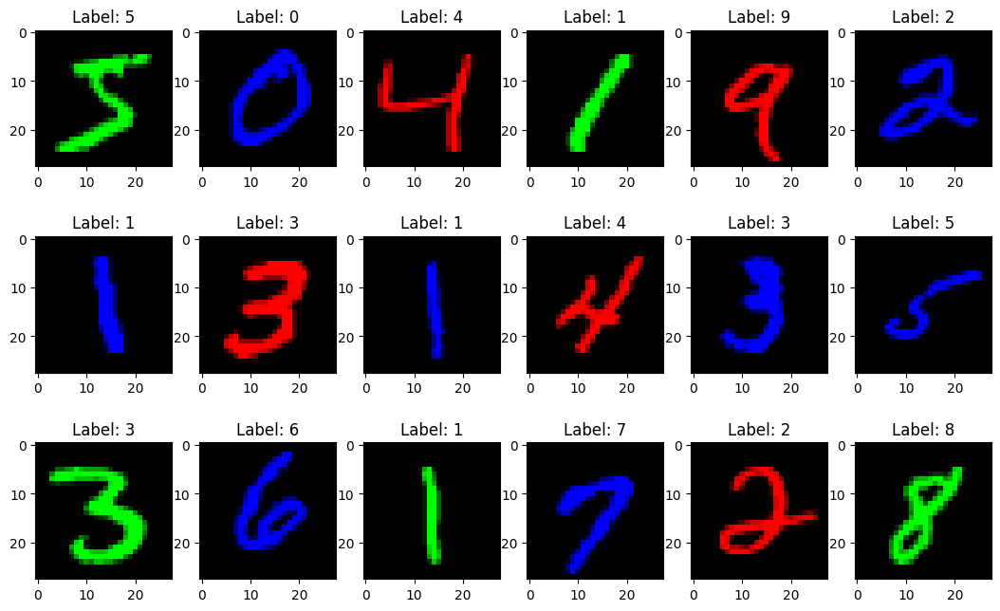

In [8]:
def plot_dataset_digits(dataset):
    fig = plt.figure(figsize=(13, 8))
    columns = 6
    rows = 3
    # ax enables access to manipulate each of subplots
    ax = []

    for i in range(columns * rows):
        img, label = dataset[i]
        # create subplot and append to ax
        ax.append(fig.add_subplot(rows, columns, i + 1))
        ax[-1].set_title("Label: " + str(label['number']))  # set title
        plt.imshow(img.transpose(2, 1, 0))

    plt.show()  # finally, render the plot

plot_dataset_digits(dataset)

In [9]:
train_dataset, validation_dataset, test_dataset = random_split(dataset, [0.8, 0.10, 0.10])
# train_dataset_c, validation_dataset_c, test_dataset_c = random_split(dataset_color, [0.8, 0.10, 0.10])

In [10]:
batch_size=64

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size)
valid_loader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size,shuffle=True)

# train_loader_c = torch.utils.data.DataLoader(train_dataset_c, batch_size=batch_size)
# valid_loader_c = torch.utils.data.DataLoader(validation_dataset_c, batch_size=batch_size)
# test_loader_c = torch.utils.data.DataLoader(test_dataset_c, batch_size=batch_size,shuffle=True)

<h1><center>Defining Networks</center></h1>


In [11]:
class Classifier(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        
        ### Convolutional section
        self.cnn = nn.Sequential(
            # First convolutional layer
            nn.Conv2d(3, 32, 3, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(True),

            nn.Conv2d(32, 64, 3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),

            nn.Conv2d(64, 64, 3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),

            nn.Conv2d(64, 128, 3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            
            nn.LeakyReLU(True),
            nn.Conv2d(128, 64, 3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),

        )
        
        
        ### Flatten layer
        self.flatten = nn.Flatten(start_dim=1)

        ### Linear section
        self.lin = nn.Sequential(

            nn.Linear(64, 128),
            nn.ReLU(True),

            nn.Linear(128, num_classes)
        )
        
    def forward(self, x):
        # Apply convolutions
        #print("cnn input dim:", x.shape)
        x = self.cnn(x)
#         print("cnn output dim", x.shape)
        # Flatten
        x = self.flatten(x)
#         print("flatten shape", x.shape)
        # # Apply linear layers
        x = self.lin(x)
        return x


In [12]:
class Encoder(nn.Module):
    
    def __init__(self, encoded_space_dim):
        super().__init__()
        
        ### Convolutional section
        self.encoder_cnn = nn.Sequential(
            nn.Conv2d(3, 8, 3, stride=2, padding=1),
            nn.ReLU(True),
            nn.Conv2d(8, 16, 3, stride=2, padding=1),
            nn.BatchNorm2d(16),
            nn.ReLU(True),
            nn.Conv2d(16, 32, 3, stride=2, padding=0),
            nn.ReLU(True)
        )
        
        ### Flatten layer
        self.flatten = nn.Flatten(start_dim=1)
### Linear section
        self.encoder_lin = nn.Sequential(
            nn.Linear(3 * 3 * 32, 128),
            nn.ReLU(True),
            nn.Linear(128, encoded_space_dim)
        )
        
    def forward(self, x):
        x = self.encoder_cnn(x)
        x = self.flatten(x)
        x = self.encoder_lin(x)
        return x
class Decoder(nn.Module):
    
    def __init__(self, encoded_space_dim):
        super().__init__()
        self.decoder_lin = nn.Sequential(
            nn.Linear(encoded_space_dim, 128),
            nn.ReLU(True),
            nn.Linear(128, 3 * 3 * 32),
            nn.ReLU(True)
        )

        self.unflatten = nn.Unflatten(dim=1, 
        unflattened_size=(32, 3, 3))

        self.decoder_conv = nn.Sequential(
            nn.ConvTranspose2d(32, 16, 3, 
            stride=2, output_padding=0),
            nn.BatchNorm2d(16),
            nn.ReLU(True),
            nn.ConvTranspose2d(16, 8, 3, stride=2, 
            padding=1, output_padding=1),
            nn.BatchNorm2d(8),
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 3, 3, stride=2, 
            padding=1, output_padding=1)
        )
        
    def forward(self, x):
        x = self.decoder_lin(x)
        x = self.unflatten(x)
        x = self.decoder_conv(x)
        x = torch.sigmoid(x)
        return x

------------------------------------------------

<h1><center>Classifier</center></h1>

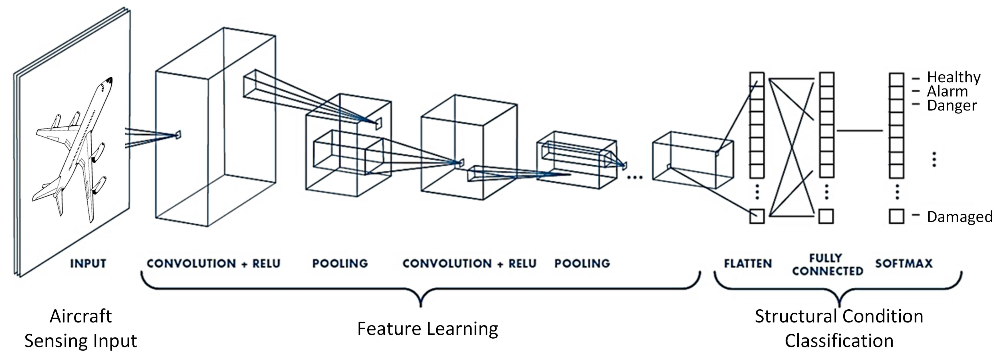

## Number Classifier

In [13]:
def train_epoch_classifer(classifier, device, dataloader, loss_fn_class, optimizer_class, label='number', encoder=None):

    classifier.train()
    train_loss = []
    count = 0

    for image_batch, labels in dataloader:
        labels = labels[label]
        image_batch = image_batch.to(device)
        if encoder is not None:
            image_batch = encoder(image_batch)
        labels = labels.to(device)

        predictions = classifier(image_batch)
        loss = loss_fn_class(predictions, labels)
        
        optimizer_class.zero_grad()
        loss.backward()
        optimizer_class.step()
        
        count = count + 1

        if count % 100 == 0: 
            print('\t partial train loss (single batch): %f' % (loss.data))
        train_loss.append(loss.detach().cpu().numpy())

    return np.mean(train_loss)

In [14]:
def test_epoch_classifier(classifier, device, dataloader, loss_fn_class, label='number', encoder=None):

    classifier.eval()
    with torch.no_grad(): 
        
        conc_out = []
        conc_label = []
        for image_batch, labels in dataloader:
            labels = labels[label]
            image_batch = image_batch.to(device)
            if encoder is not None:
                image_batch = encoder(image_batch)
            predictions = classifier(image_batch)
            
            conc_out.append(predictions.cpu())
            conc_label.append(labels)

        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label) 

        val_loss = loss_fn_class(conc_out, conc_label)
        val_accuracy = np.mean(conc_out.argmax(dim=1).numpy() == conc_label.numpy())
    return val_loss.data, val_accuracy

In [15]:
classifier_layout = Classifier(10)
loss_fn_class = torch.nn.CrossEntropyLoss()

lr_class = 0.0001

optim_class_layout = torch.optim.Adam(classifier_layout.parameters(), lr=lr_class, weight_decay=1e-05)

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

classifier_layout.to(device)


Selected device: cuda


Classifier(
  (cnn): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=True)
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=True)
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=True)
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=True)
    (12): Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (13): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_r

In [42]:
num_epochs = 5
history_layout={'class_loss':[],'val_loss':[]}


for epoch in range(num_epochs):
    train_loss = train_epoch_classifer(classifier_layout,device,train_loader,loss_fn_class, optim_class_layout)
    val_loss, val_accuracy = test_epoch_classifier(classifier_layout,device,valid_loader,loss_fn_class)
    
    print('\n EPOCH {}/{} \t train loss {:.3f} \t val loss {:.3f}  \t val acc {:.3f} '.format(epoch + 1, num_epochs,train_loss,val_loss,val_accuracy))
    history_layout['class_loss'].append(train_loss)
    history_layout['val_loss'].append(val_loss)


	 partial train loss (single batch): 1.322913
	 partial train loss (single batch): 1.007653
	 partial train loss (single batch): 0.719374
	 partial train loss (single batch): 0.566278
	 partial train loss (single batch): 0.398935
	 partial train loss (single batch): 0.508785
	 partial train loss (single batch): 0.493366

 EPOCH 1/5 	 train loss 0.764 	 val loss 0.383  	 val acc 0.902 
	 partial train loss (single batch): 0.482656
	 partial train loss (single batch): 0.427555
	 partial train loss (single batch): 0.374440
	 partial train loss (single batch): 0.323892
	 partial train loss (single batch): 0.272184
	 partial train loss (single batch): 0.397243
	 partial train loss (single batch): 0.350257

 EPOCH 2/5 	 train loss 0.335 	 val loss 0.299  	 val acc 0.915 
	 partial train loss (single batch): 0.398343
	 partial train loss (single batch): 0.352650
	 partial train loss (single batch): 0.309567
	 partial train loss (single batch): 0.254181
	 partial train loss (single batch): 0.2

## Color Classifier

In [16]:
classifier_color = Classifier(3)

loss_fn_class = torch.nn.CrossEntropyLoss()

lr_class = 0.0005

optim_class_shape = torch.optim.Adam(classifier_color.parameters(), lr=lr_class, weight_decay=1e-05)

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

classifier_color.to(device)


Selected device: cuda


Classifier(
  (cnn): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=True)
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=True)
    (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=True)
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=True)
    (12): Conv2d(128, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (13): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_r

In [45]:
num_epochs = 1
history_shape={'class_loss':[],'val_loss':[]}


for epoch in range(num_epochs):
    train_loss = train_epoch_classifer(classifier_color,device,train_loader,loss_fn_class,optim_class_shape, label='color')
    val_loss, val_accuracy = test_epoch_classifier(classifier_color,device,valid_loader,loss_fn_class, label='color')
    
    print('\n EPOCH {}/{} \t train loss {:.3f} \t val loss {:.3f}  \t val acc {:.3f} '.format(epoch + 1, num_epochs,train_loss,val_loss,val_accuracy))
    history_shape['class_loss'].append(train_loss)
    history_shape['val_loss'].append(val_loss)


	 partial train loss (single batch): 0.008827
	 partial train loss (single batch): 0.002897
	 partial train loss (single batch): 0.001168
	 partial train loss (single batch): 0.001830
	 partial train loss (single batch): 0.000207
	 partial train loss (single batch): 0.000334
	 partial train loss (single batch): 0.000159

 EPOCH 1/1 	 train loss 0.013 	 val loss 0.000  	 val acc 1.000 


In [ ]:
# classifier_layout = Classifier(10)
# classifier_color = Classifier(3)

# classifier_layout.load_state_dict(torch.load('outputs/classifiers/classifier_number.pt', map_location=torch.device('cpu')))
# classifier_layout.eval()

# classifier_color.load_state_dict(torch.load('outputs/classifiers/classifier_color.pt', map_location=torch.device('cpu')))
# classifier_color.eval()

In [46]:
torch.save(classifier_layout.state_dict(), 'outputs/classifiers/classifier_number.pt')
torch.save(classifier_color.state_dict(), 'outputs/classifiers/classifier_color.pt')

---------------------------------------

<h1><center>Autoencoder</center></h1>

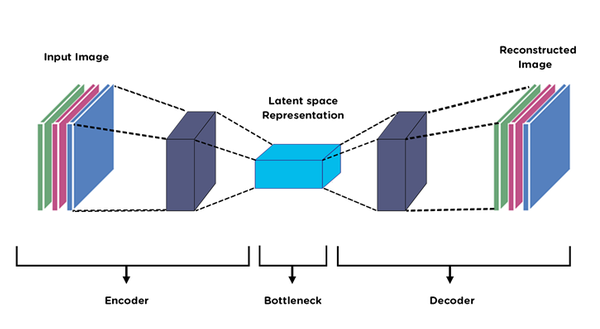

In [17]:
d = 4

encoder = Encoder(encoded_space_dim=d)
decoder = Decoder(encoded_space_dim=d)

img, _ = test_dataset[0]
img = torch.tensor(img).unsqueeze(0)
print('Original image shape:', img.shape)

img_enc = encoder(img)
print('Encoded image shape:', img_enc.shape)

dec_img = decoder(img_enc)
print('Decoded image shape:', dec_img.shape)

Original image shape: torch.Size([1, 3, 28, 28])
Encoded image shape: torch.Size([1, 4])
Decoded image shape: torch.Size([1, 3, 28, 28])


In [18]:
loss_fn = torch.nn.MSELoss()

lr= 0.001

params_to_optimize = [
    {'params': encoder.parameters()},
    {'params': decoder.parameters()},
#     {'params': classifier_layout.parameters()},
#     {'params': classifier_color.parameters()},
]

optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=1e-05)

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

encoder.to(device)
decoder.to(device)


Selected device: cuda


Decoder(
  (decoder_lin): Sequential(
    (0): Linear(in_features=4, out_features=128, bias=True)
    (1): ReLU(inplace=True)
    (2): Linear(in_features=128, out_features=288, bias=True)
    (3): ReLU(inplace=True)
  )
  (unflatten): Unflatten(dim=1, unflattened_size=(32, 3, 3))
  (decoder_conv): Sequential(
    (0): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(16, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (4): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(8, 3, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
  )
)

In [19]:
def train_epoch(encoder, decoder, device, dataloader, loss_fn, optimizer):

    encoder.train()
    decoder.train()
    train_loss = []
    count = 0

    for image_batch, labels in dataloader: 
        image_batch = image_batch.to(device)
        encoded_data = encoder(image_batch)
        decoded_data = decoder(encoded_data)
        loss = loss_fn(decoded_data, image_batch)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        count = count + 1
        
        if count % 100 == 0: 
            print('\t partial train loss (single batch): %f' % (loss.data))
        train_loss.append(loss.detach().cpu().numpy())

    return np.mean(train_loss)

In [20]:
def test_epoch(encoder, decoder, device, dataloader, loss_fn):
    encoder.eval()
    decoder.eval()
    
    with torch.no_grad(): 
        conc_out = []
        conc_label = []
        for image_batch, _ in dataloader:
            image_batch = image_batch.to(device)
            encoded_data = encoder(image_batch)
            decoded_data = decoder(encoded_data)

            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())

        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label) 

        val_loss = loss_fn(conc_out, conc_label)
    return val_loss.data

In [21]:
def plot_ae_outputs(encoder,decoder,n=5):
    plt.figure(figsize=(10,4.5))
    for i in range(n):
        ax = plt.subplot(2,n,i+1)
        img = torch.tensor(test_dataset[i][0]).unsqueeze(0).to(device)
        encoder.eval()
        decoder.eval()
        
        with torch.no_grad():
            rec_img  = decoder(encoder(img))
        plt.imshow(img.cpu().squeeze().numpy().transpose((2,1,0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        if i == n//2:
            ax.set_title('Original images')
            
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(rec_img.cpu().squeeze().numpy().transpose((2,1,0)))  
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        
        if i == n//2:
            ax.set_title('Reconstructed images')
    plt.show()   

	 partial train loss (single batch): 0.011094
	 partial train loss (single batch): 0.010693
	 partial train loss (single batch): 0.010975
	 partial train loss (single batch): 0.010716
	 partial train loss (single batch): 0.012470
	 partial train loss (single batch): 0.011151
	 partial train loss (single batch): 0.011345

 EPOCH 1/100 	 train loss 0.011 	 val loss 0.011


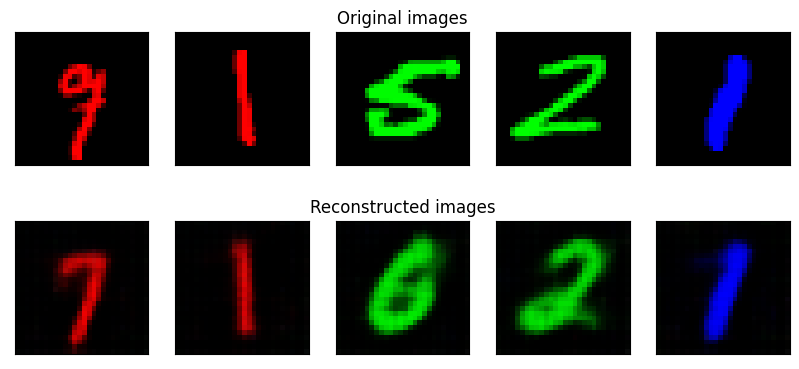

	 partial train loss (single batch): 0.010983
	 partial train loss (single batch): 0.010369
	 partial train loss (single batch): 0.010858
	 partial train loss (single batch): 0.010594
	 partial train loss (single batch): 0.012185
	 partial train loss (single batch): 0.011000
	 partial train loss (single batch): 0.011083

 EPOCH 2/100 	 train loss 0.011 	 val loss 0.011


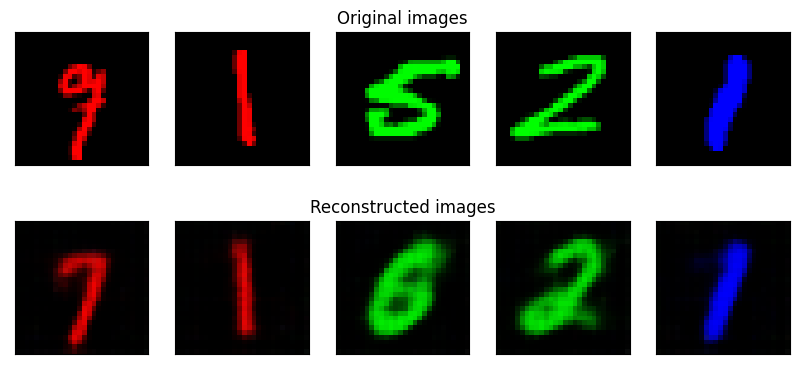

	 partial train loss (single batch): 0.010755
	 partial train loss (single batch): 0.010269
	 partial train loss (single batch): 0.010741
	 partial train loss (single batch): 0.010363
	 partial train loss (single batch): 0.012091
	 partial train loss (single batch): 0.010961
	 partial train loss (single batch): 0.010997

 EPOCH 3/100 	 train loss 0.011 	 val loss 0.011


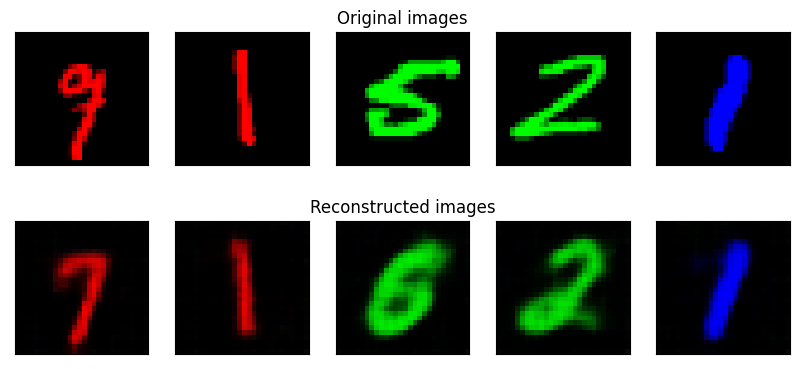

	 partial train loss (single batch): 0.010702
	 partial train loss (single batch): 0.010187
	 partial train loss (single batch): 0.010576
	 partial train loss (single batch): 0.010197
	 partial train loss (single batch): 0.012021
	 partial train loss (single batch): 0.010869
	 partial train loss (single batch): 0.010980

 EPOCH 4/100 	 train loss 0.010 	 val loss 0.011


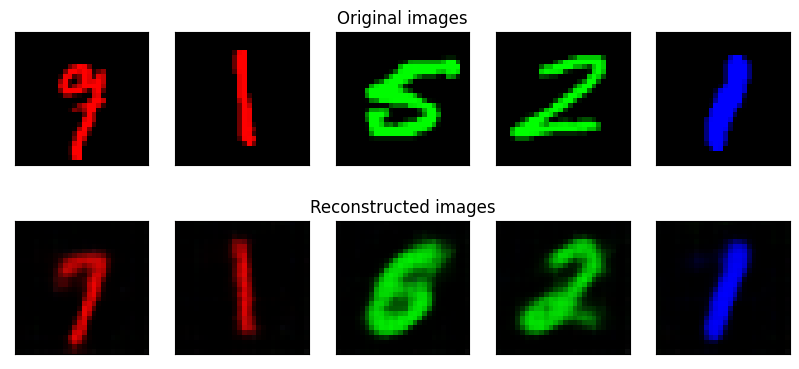

	 partial train loss (single batch): 0.010720
	 partial train loss (single batch): 0.010042
	 partial train loss (single batch): 0.010600
	 partial train loss (single batch): 0.010159
	 partial train loss (single batch): 0.011894
	 partial train loss (single batch): 0.010887
	 partial train loss (single batch): 0.010908

 EPOCH 5/100 	 train loss 0.010 	 val loss 0.010


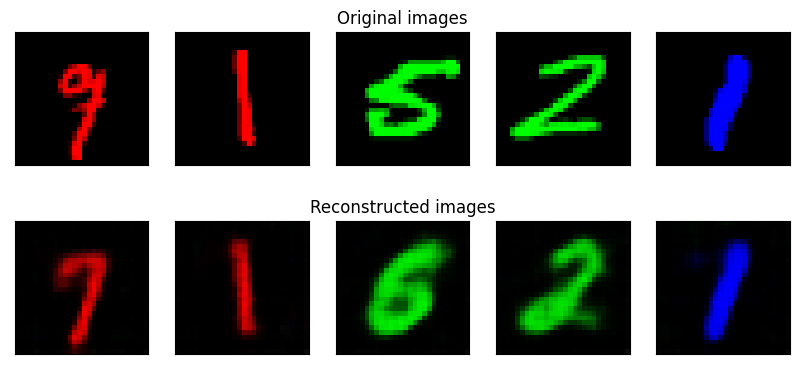

	 partial train loss (single batch): 0.010698
	 partial train loss (single batch): 0.009903
	 partial train loss (single batch): 0.010565
	 partial train loss (single batch): 0.009999
	 partial train loss (single batch): 0.011856
	 partial train loss (single batch): 0.010850
	 partial train loss (single batch): 0.010751

 EPOCH 6/100 	 train loss 0.010 	 val loss 0.010


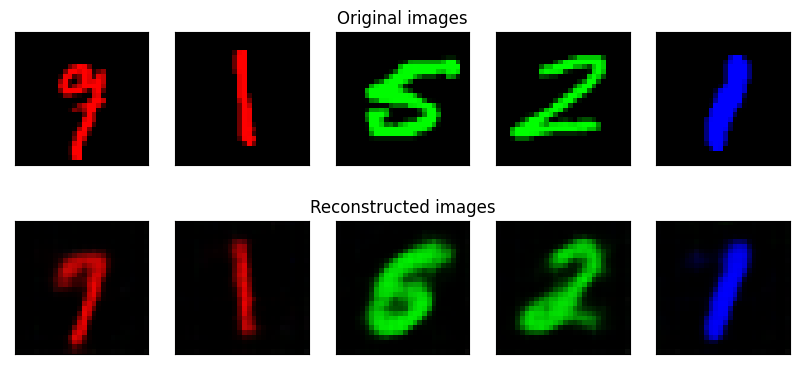

	 partial train loss (single batch): 0.010546
	 partial train loss (single batch): 0.009727
	 partial train loss (single batch): 0.010454
	 partial train loss (single batch): 0.010059
	 partial train loss (single batch): 0.011660
	 partial train loss (single batch): 0.010685
	 partial train loss (single batch): 0.010631

 EPOCH 7/100 	 train loss 0.010 	 val loss 0.010


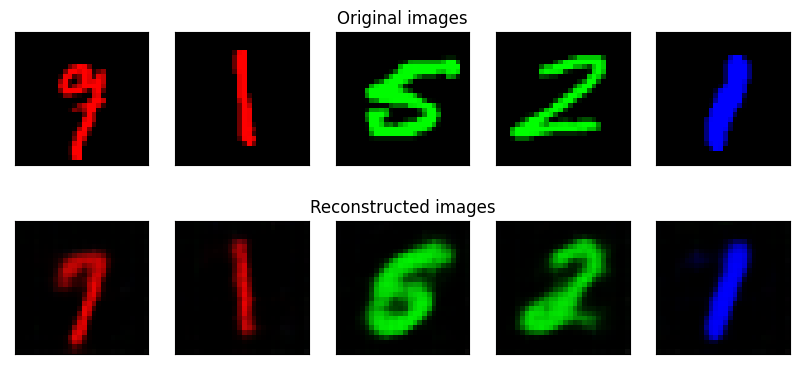

	 partial train loss (single batch): 0.010418
	 partial train loss (single batch): 0.009786
	 partial train loss (single batch): 0.010480
	 partial train loss (single batch): 0.009854
	 partial train loss (single batch): 0.011550
	 partial train loss (single batch): 0.010631
	 partial train loss (single batch): 0.010527

 EPOCH 8/100 	 train loss 0.010 	 val loss 0.010


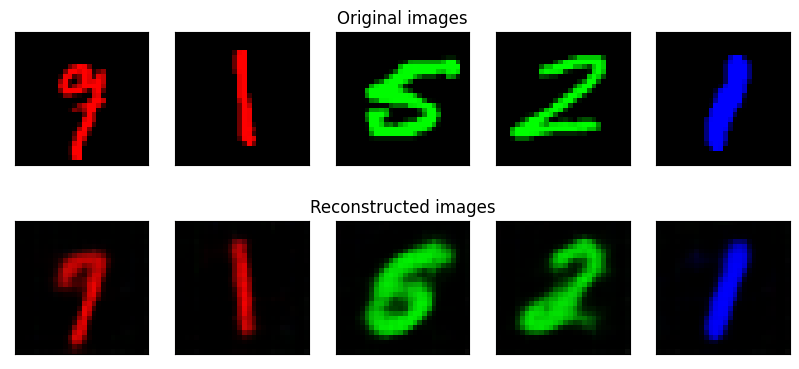

	 partial train loss (single batch): 0.010320
	 partial train loss (single batch): 0.009616
	 partial train loss (single batch): 0.010410
	 partial train loss (single batch): 0.009746
	 partial train loss (single batch): 0.011566
	 partial train loss (single batch): 0.010606
	 partial train loss (single batch): 0.010613

 EPOCH 9/100 	 train loss 0.010 	 val loss 0.010


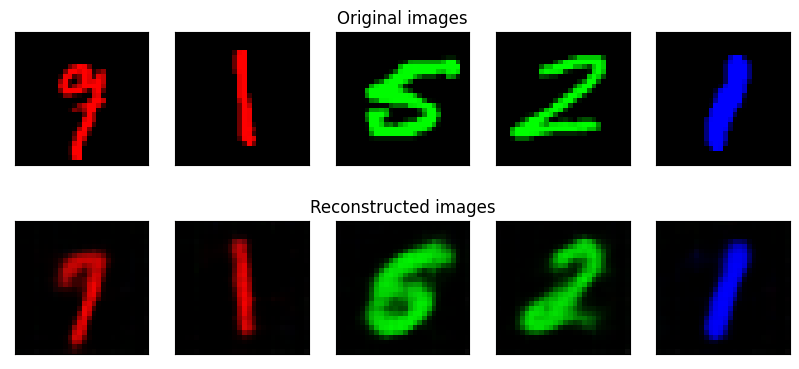

	 partial train loss (single batch): 0.010267
	 partial train loss (single batch): 0.009668
	 partial train loss (single batch): 0.010285
	 partial train loss (single batch): 0.009728
	 partial train loss (single batch): 0.011487
	 partial train loss (single batch): 0.010517
	 partial train loss (single batch): 0.010412

 EPOCH 10/100 	 train loss 0.010 	 val loss 0.010


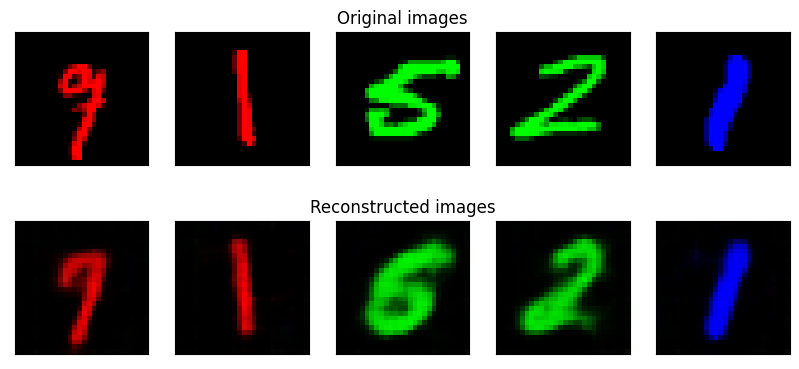

	 partial train loss (single batch): 0.010274
	 partial train loss (single batch): 0.009567
	 partial train loss (single batch): 0.010286
	 partial train loss (single batch): 0.009710
	 partial train loss (single batch): 0.011436
	 partial train loss (single batch): 0.010633
	 partial train loss (single batch): 0.010432

 EPOCH 11/100 	 train loss 0.010 	 val loss 0.010


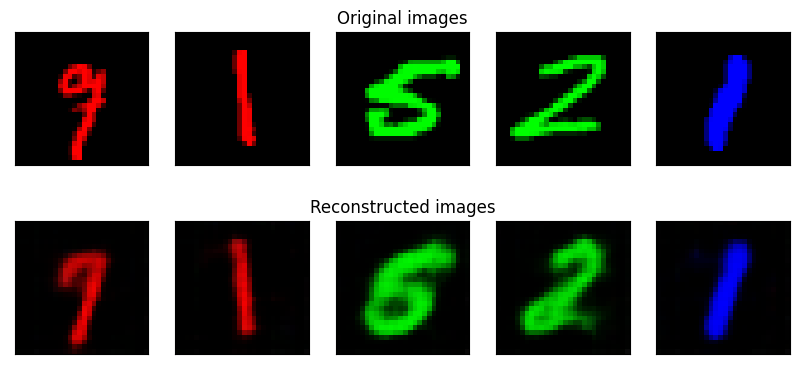

	 partial train loss (single batch): 0.010276
	 partial train loss (single batch): 0.009473
	 partial train loss (single batch): 0.010268
	 partial train loss (single batch): 0.009720
	 partial train loss (single batch): 0.011345
	 partial train loss (single batch): 0.010615
	 partial train loss (single batch): 0.010271

 EPOCH 12/100 	 train loss 0.010 	 val loss 0.010


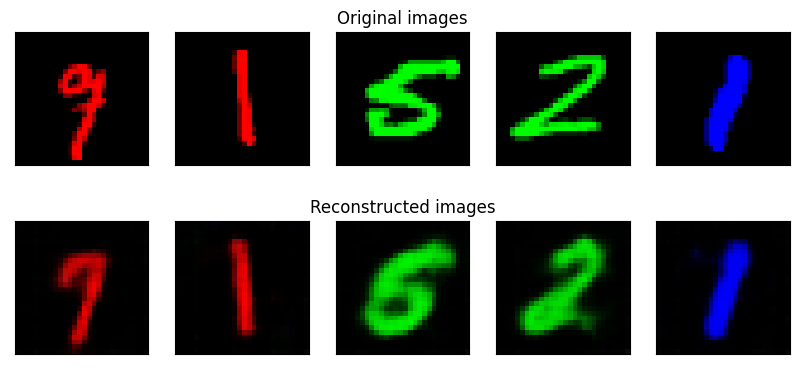

	 partial train loss (single batch): 0.010310
	 partial train loss (single batch): 0.009482
	 partial train loss (single batch): 0.010296
	 partial train loss (single batch): 0.009779
	 partial train loss (single batch): 0.011375
	 partial train loss (single batch): 0.010582
	 partial train loss (single batch): 0.010233

 EPOCH 13/100 	 train loss 0.010 	 val loss 0.010


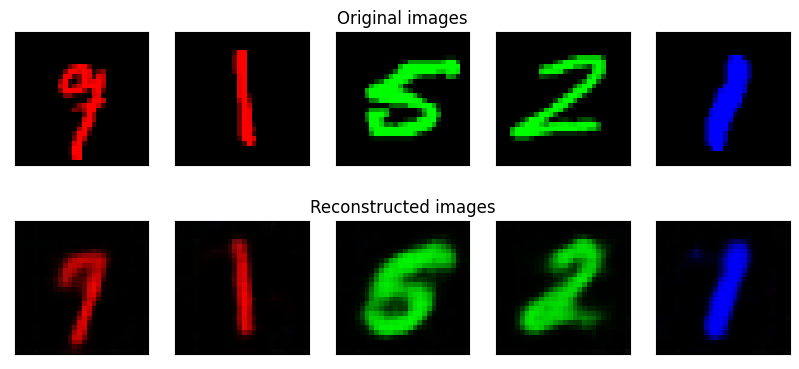

	 partial train loss (single batch): 0.010274
	 partial train loss (single batch): 0.009438
	 partial train loss (single batch): 0.010170
	 partial train loss (single batch): 0.009756
	 partial train loss (single batch): 0.011410
	 partial train loss (single batch): 0.010580
	 partial train loss (single batch): 0.010100

 EPOCH 14/100 	 train loss 0.010 	 val loss 0.010


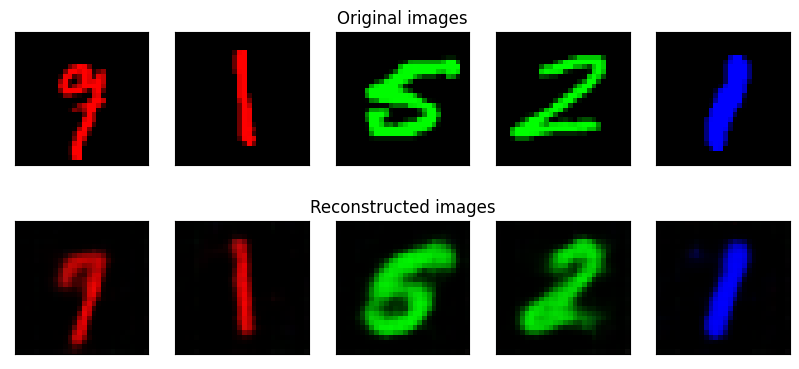

	 partial train loss (single batch): 0.010290
	 partial train loss (single batch): 0.009373
	 partial train loss (single batch): 0.010188
	 partial train loss (single batch): 0.009729
	 partial train loss (single batch): 0.011399
	 partial train loss (single batch): 0.010488
	 partial train loss (single batch): 0.010075

 EPOCH 15/100 	 train loss 0.010 	 val loss 0.010


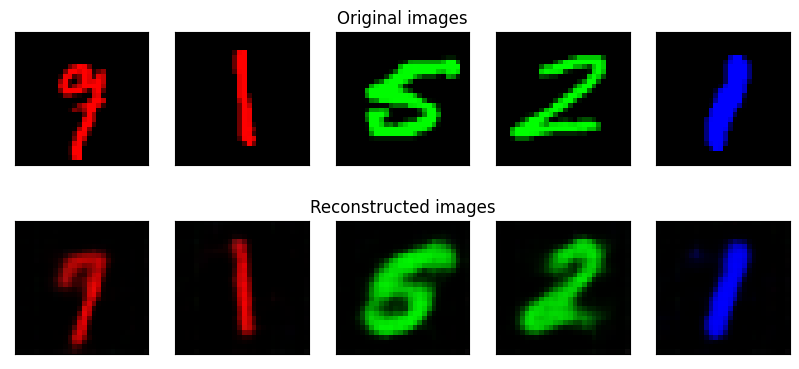

	 partial train loss (single batch): 0.010194
	 partial train loss (single batch): 0.009334
	 partial train loss (single batch): 0.010171
	 partial train loss (single batch): 0.009672
	 partial train loss (single batch): 0.011313
	 partial train loss (single batch): 0.010501
	 partial train loss (single batch): 0.010117

 EPOCH 16/100 	 train loss 0.010 	 val loss 0.010


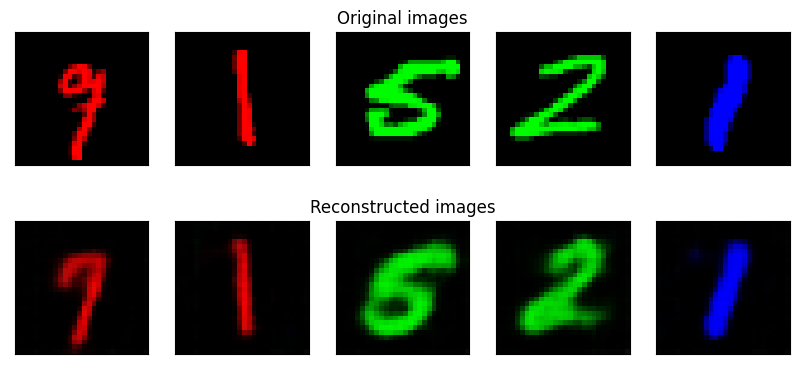

	 partial train loss (single batch): 0.010204
	 partial train loss (single batch): 0.009315
	 partial train loss (single batch): 0.010030
	 partial train loss (single batch): 0.009624
	 partial train loss (single batch): 0.011384
	 partial train loss (single batch): 0.010480
	 partial train loss (single batch): 0.009997

 EPOCH 17/100 	 train loss 0.010 	 val loss 0.010


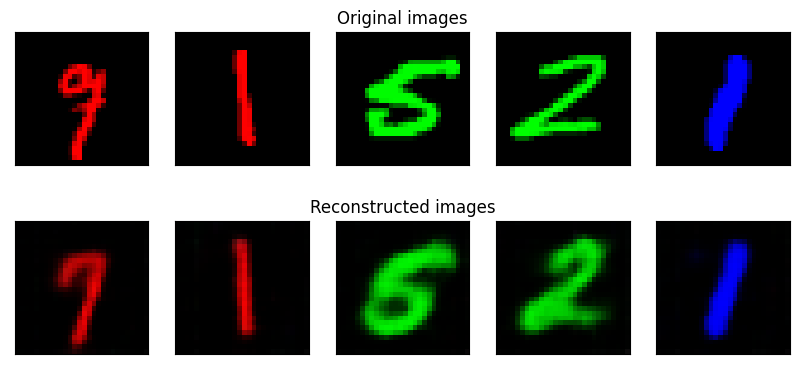

	 partial train loss (single batch): 0.010144
	 partial train loss (single batch): 0.009293
	 partial train loss (single batch): 0.010087
	 partial train loss (single batch): 0.009545
	 partial train loss (single batch): 0.011291
	 partial train loss (single batch): 0.010454
	 partial train loss (single batch): 0.009965

 EPOCH 18/100 	 train loss 0.010 	 val loss 0.010


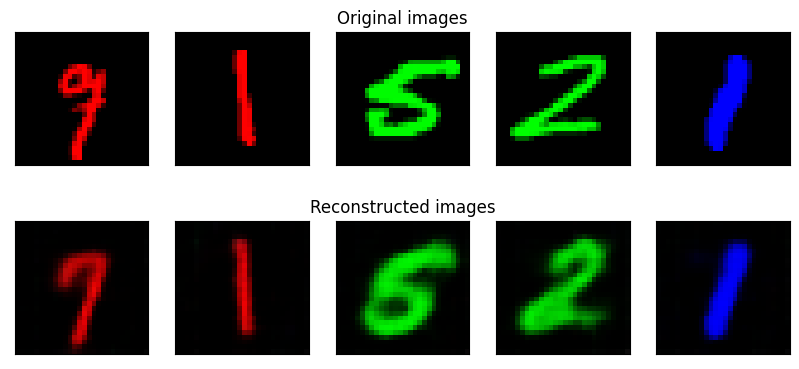

	 partial train loss (single batch): 0.010172
	 partial train loss (single batch): 0.009199
	 partial train loss (single batch): 0.009984
	 partial train loss (single batch): 0.009538
	 partial train loss (single batch): 0.011200
	 partial train loss (single batch): 0.010484
	 partial train loss (single batch): 0.009939

 EPOCH 19/100 	 train loss 0.010 	 val loss 0.010


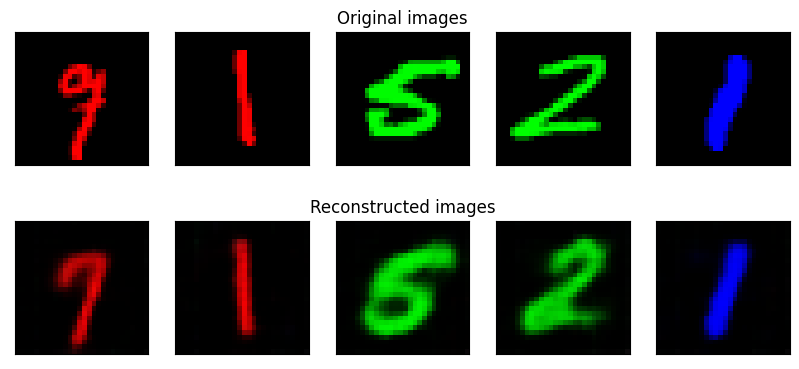

	 partial train loss (single batch): 0.010098
	 partial train loss (single batch): 0.009208
	 partial train loss (single batch): 0.010079
	 partial train loss (single batch): 0.009488
	 partial train loss (single batch): 0.011162
	 partial train loss (single batch): 0.010507
	 partial train loss (single batch): 0.009967

 EPOCH 20/100 	 train loss 0.010 	 val loss 0.010


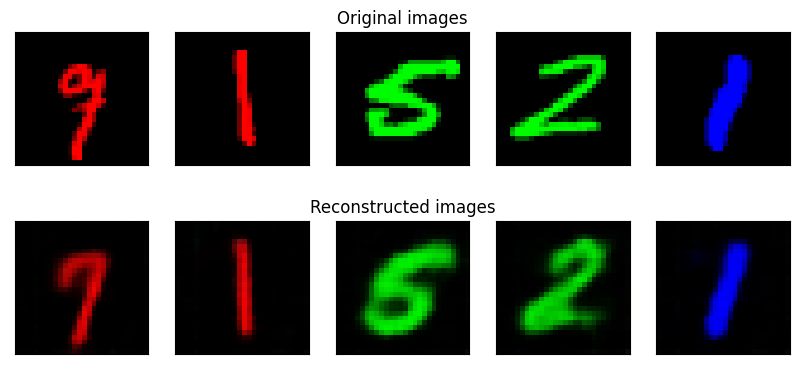

	 partial train loss (single batch): 0.009971
	 partial train loss (single batch): 0.009224
	 partial train loss (single batch): 0.010060
	 partial train loss (single batch): 0.009407
	 partial train loss (single batch): 0.011131
	 partial train loss (single batch): 0.010405
	 partial train loss (single batch): 0.009893

 EPOCH 21/100 	 train loss 0.010 	 val loss 0.010


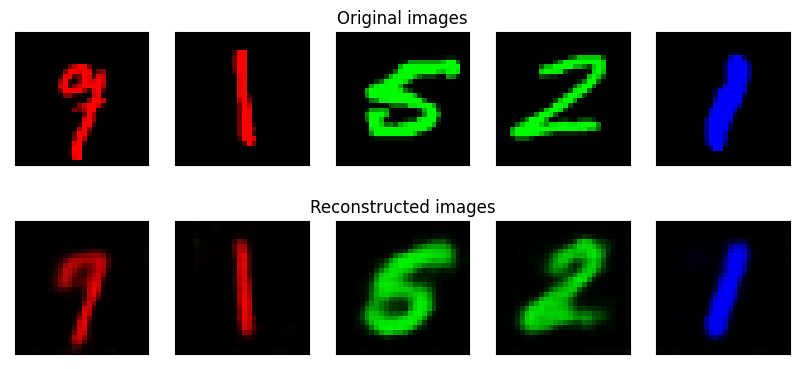

	 partial train loss (single batch): 0.010024
	 partial train loss (single batch): 0.009078
	 partial train loss (single batch): 0.010054
	 partial train loss (single batch): 0.009438
	 partial train loss (single batch): 0.011137
	 partial train loss (single batch): 0.010500
	 partial train loss (single batch): 0.009851

 EPOCH 22/100 	 train loss 0.010 	 val loss 0.010


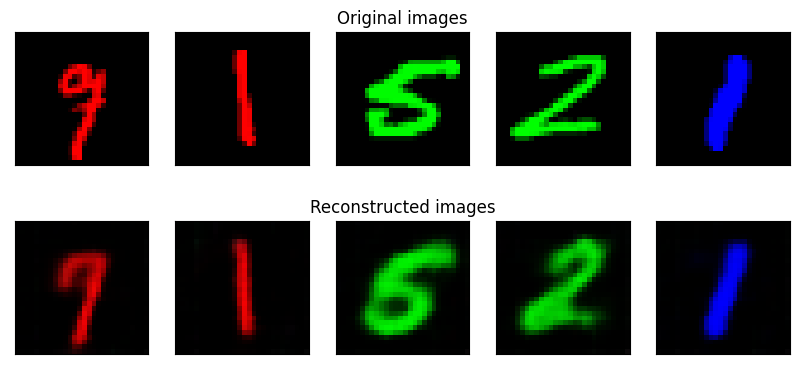

	 partial train loss (single batch): 0.009989
	 partial train loss (single batch): 0.009115
	 partial train loss (single batch): 0.010062
	 partial train loss (single batch): 0.009413
	 partial train loss (single batch): 0.010916
	 partial train loss (single batch): 0.010392
	 partial train loss (single batch): 0.009905

 EPOCH 23/100 	 train loss 0.010 	 val loss 0.010


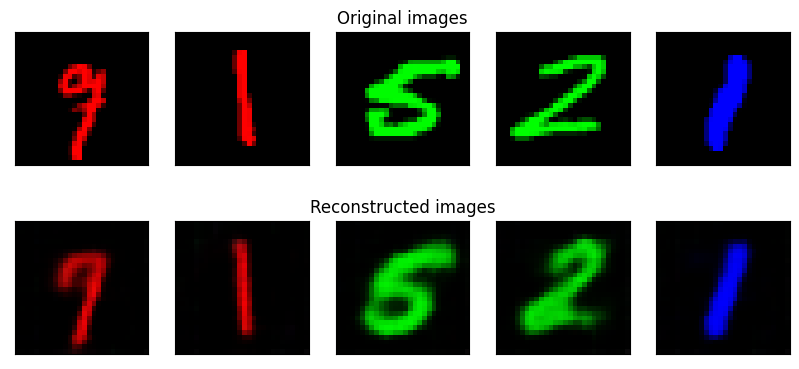

	 partial train loss (single batch): 0.010002
	 partial train loss (single batch): 0.009025
	 partial train loss (single batch): 0.010037
	 partial train loss (single batch): 0.009320
	 partial train loss (single batch): 0.010953
	 partial train loss (single batch): 0.010362
	 partial train loss (single batch): 0.010019

 EPOCH 24/100 	 train loss 0.010 	 val loss 0.010


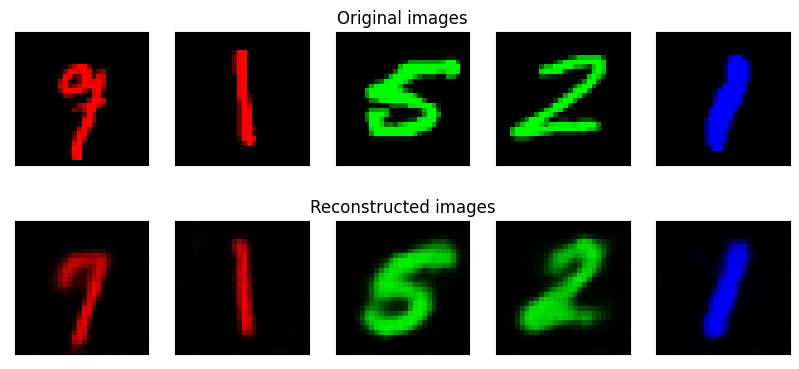

	 partial train loss (single batch): 0.010017
	 partial train loss (single batch): 0.009034
	 partial train loss (single batch): 0.010008
	 partial train loss (single batch): 0.009342
	 partial train loss (single batch): 0.011087
	 partial train loss (single batch): 0.010355
	 partial train loss (single batch): 0.009873

 EPOCH 25/100 	 train loss 0.010 	 val loss 0.010


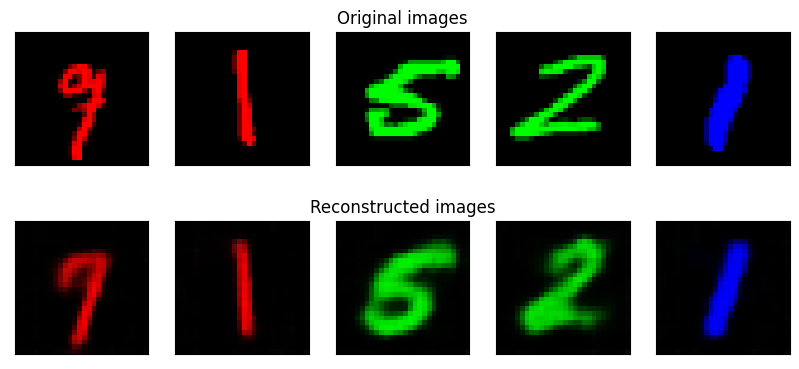

	 partial train loss (single batch): 0.009937
	 partial train loss (single batch): 0.009079
	 partial train loss (single batch): 0.009974
	 partial train loss (single batch): 0.009374
	 partial train loss (single batch): 0.011005
	 partial train loss (single batch): 0.010374
	 partial train loss (single batch): 0.009798

 EPOCH 26/100 	 train loss 0.010 	 val loss 0.010


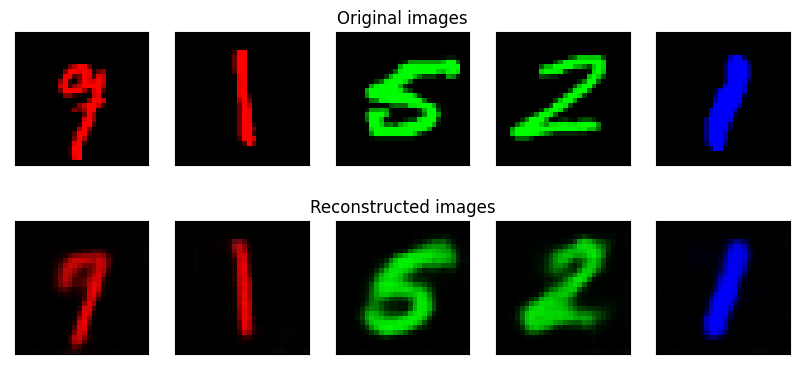

	 partial train loss (single batch): 0.009996
	 partial train loss (single batch): 0.009072
	 partial train loss (single batch): 0.010016
	 partial train loss (single batch): 0.009358
	 partial train loss (single batch): 0.010907
	 partial train loss (single batch): 0.010233
	 partial train loss (single batch): 0.009897

 EPOCH 27/100 	 train loss 0.010 	 val loss 0.010


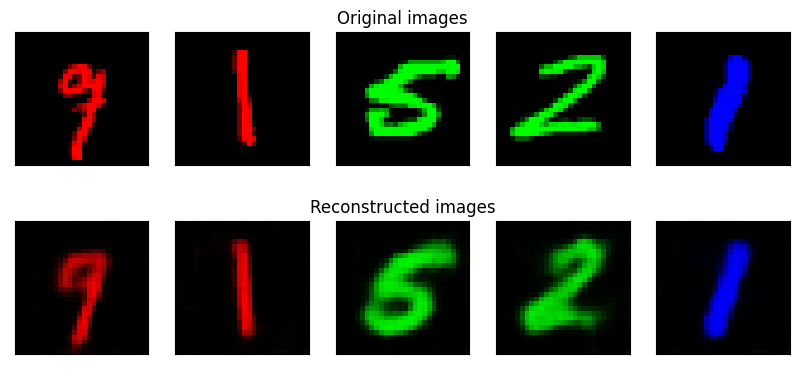

	 partial train loss (single batch): 0.010020
	 partial train loss (single batch): 0.009104
	 partial train loss (single batch): 0.010049
	 partial train loss (single batch): 0.009296
	 partial train loss (single batch): 0.010905
	 partial train loss (single batch): 0.010207
	 partial train loss (single batch): 0.009839

 EPOCH 28/100 	 train loss 0.010 	 val loss 0.010


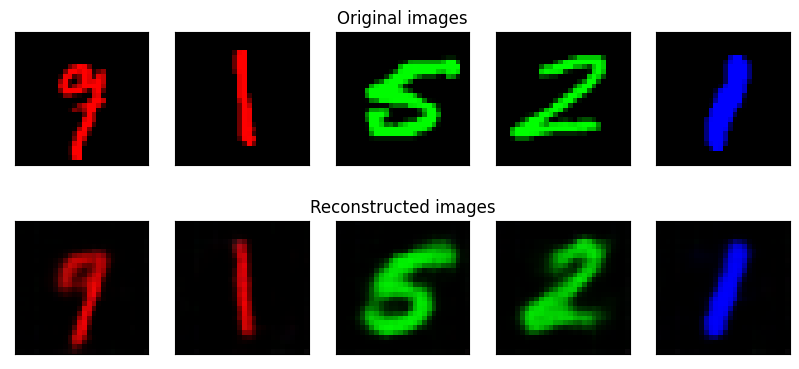

	 partial train loss (single batch): 0.009971
	 partial train loss (single batch): 0.009000
	 partial train loss (single batch): 0.009989
	 partial train loss (single batch): 0.009360
	 partial train loss (single batch): 0.010897
	 partial train loss (single batch): 0.010324
	 partial train loss (single batch): 0.009873

 EPOCH 29/100 	 train loss 0.010 	 val loss 0.010


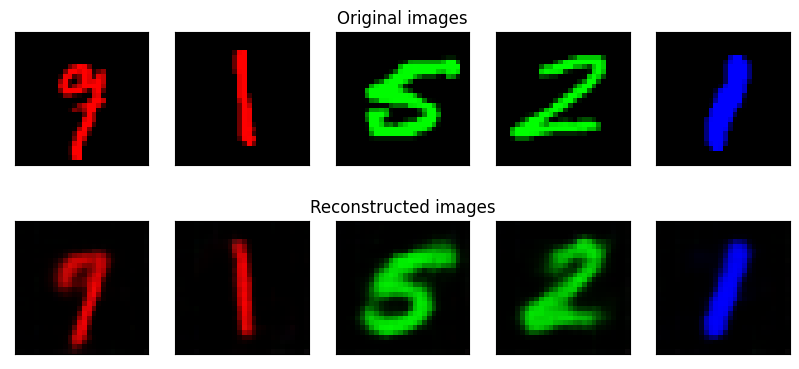

	 partial train loss (single batch): 0.009884
	 partial train loss (single batch): 0.009004
	 partial train loss (single batch): 0.009979
	 partial train loss (single batch): 0.009470
	 partial train loss (single batch): 0.010890
	 partial train loss (single batch): 0.010189
	 partial train loss (single batch): 0.009748

 EPOCH 30/100 	 train loss 0.010 	 val loss 0.010


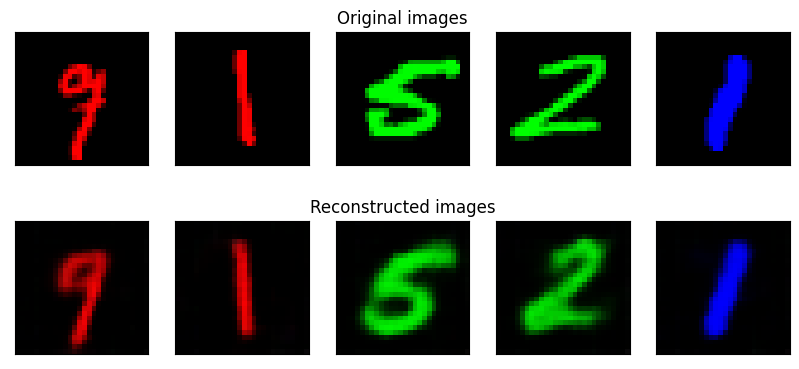

	 partial train loss (single batch): 0.009931
	 partial train loss (single batch): 0.008922
	 partial train loss (single batch): 0.009912
	 partial train loss (single batch): 0.009312
	 partial train loss (single batch): 0.010940
	 partial train loss (single batch): 0.010312
	 partial train loss (single batch): 0.009727

 EPOCH 31/100 	 train loss 0.009 	 val loss 0.010


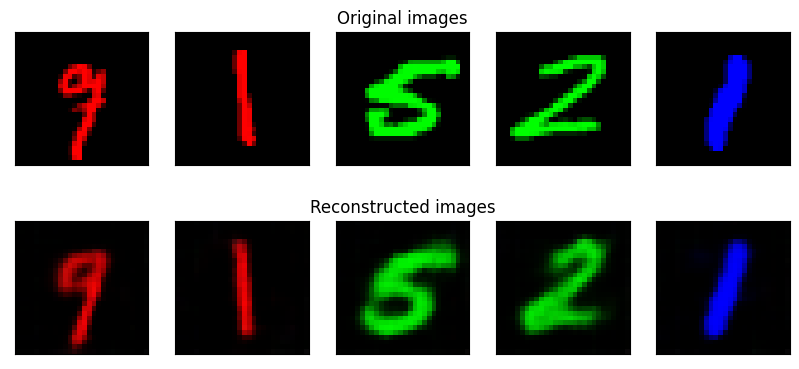

	 partial train loss (single batch): 0.009772
	 partial train loss (single batch): 0.008966
	 partial train loss (single batch): 0.010004
	 partial train loss (single batch): 0.009301
	 partial train loss (single batch): 0.010992
	 partial train loss (single batch): 0.010166
	 partial train loss (single batch): 0.009906

 EPOCH 32/100 	 train loss 0.009 	 val loss 0.010


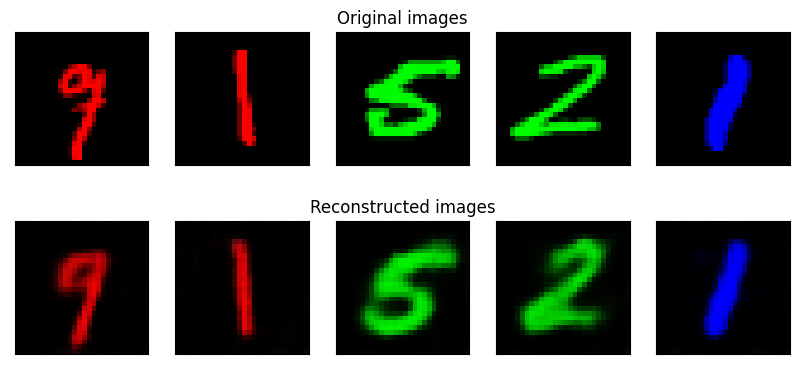

	 partial train loss (single batch): 0.009909
	 partial train loss (single batch): 0.008899
	 partial train loss (single batch): 0.009909
	 partial train loss (single batch): 0.009273
	 partial train loss (single batch): 0.010865
	 partial train loss (single batch): 0.010289
	 partial train loss (single batch): 0.009725

 EPOCH 33/100 	 train loss 0.009 	 val loss 0.010


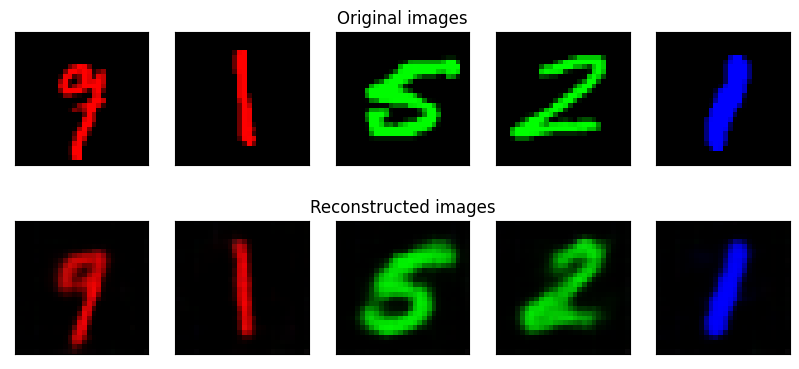

	 partial train loss (single batch): 0.009805
	 partial train loss (single batch): 0.008963
	 partial train loss (single batch): 0.009939
	 partial train loss (single batch): 0.009249
	 partial train loss (single batch): 0.010860
	 partial train loss (single batch): 0.010191
	 partial train loss (single batch): 0.009848

 EPOCH 34/100 	 train loss 0.009 	 val loss 0.010


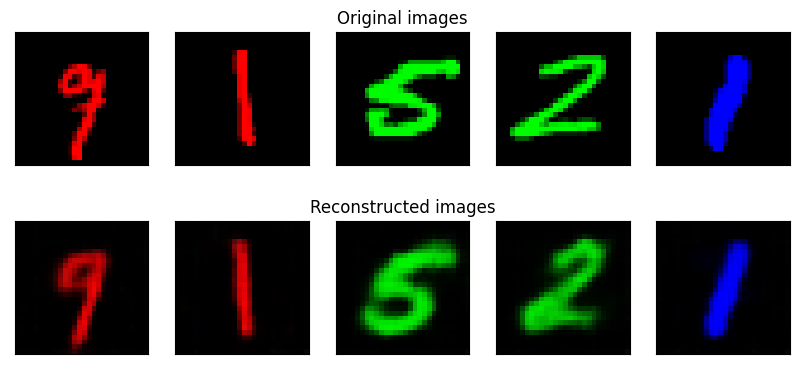

	 partial train loss (single batch): 0.009815
	 partial train loss (single batch): 0.008940
	 partial train loss (single batch): 0.009941
	 partial train loss (single batch): 0.009199
	 partial train loss (single batch): 0.010898
	 partial train loss (single batch): 0.010164
	 partial train loss (single batch): 0.009873

 EPOCH 35/100 	 train loss 0.009 	 val loss 0.010


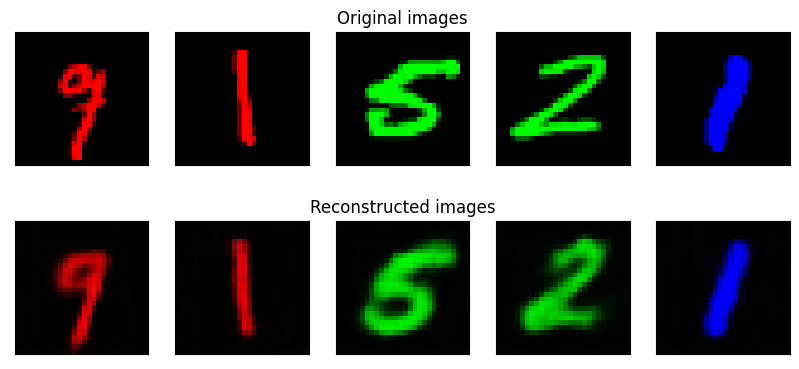

	 partial train loss (single batch): 0.009758
	 partial train loss (single batch): 0.008846
	 partial train loss (single batch): 0.009925
	 partial train loss (single batch): 0.009309
	 partial train loss (single batch): 0.010829
	 partial train loss (single batch): 0.010110
	 partial train loss (single batch): 0.009763

 EPOCH 36/100 	 train loss 0.009 	 val loss 0.010


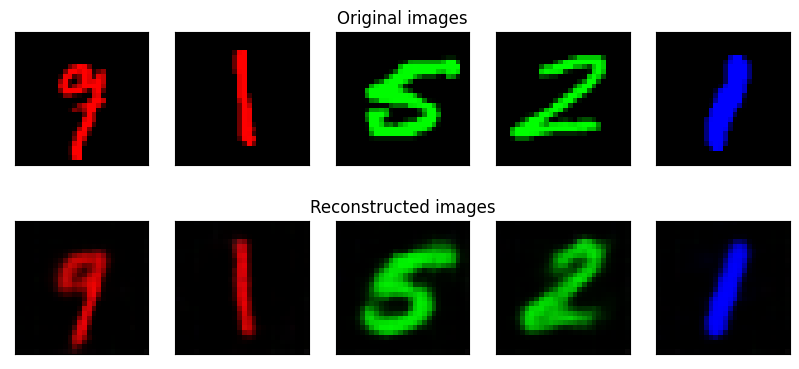

	 partial train loss (single batch): 0.009810
	 partial train loss (single batch): 0.008777
	 partial train loss (single batch): 0.009823
	 partial train loss (single batch): 0.009354
	 partial train loss (single batch): 0.010849
	 partial train loss (single batch): 0.010045
	 partial train loss (single batch): 0.009680

 EPOCH 37/100 	 train loss 0.009 	 val loss 0.010


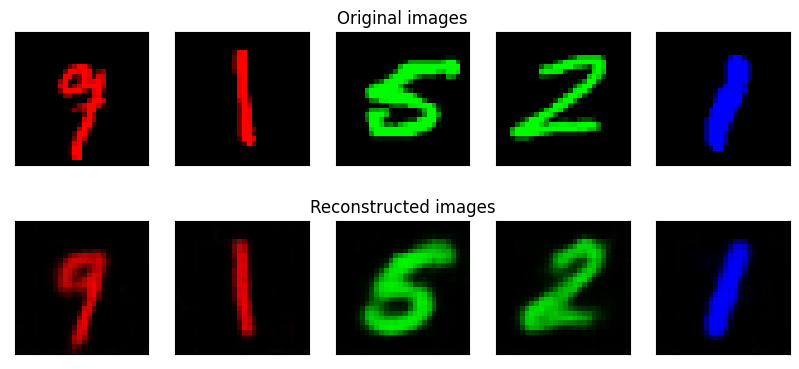

	 partial train loss (single batch): 0.009836
	 partial train loss (single batch): 0.008899
	 partial train loss (single batch): 0.009887
	 partial train loss (single batch): 0.009205
	 partial train loss (single batch): 0.010896
	 partial train loss (single batch): 0.010060
	 partial train loss (single batch): 0.009750

 EPOCH 38/100 	 train loss 0.009 	 val loss 0.010


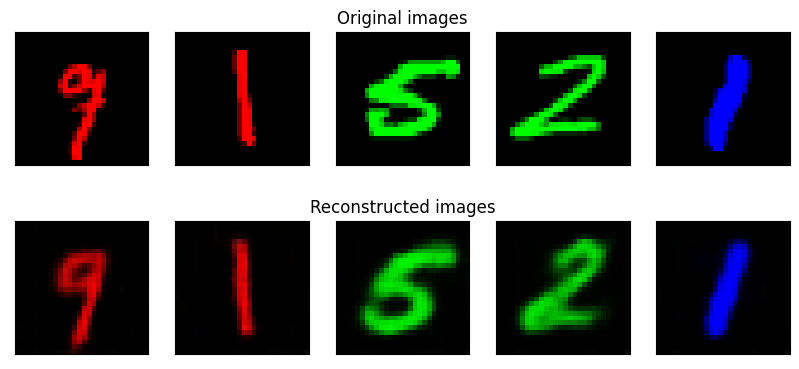

	 partial train loss (single batch): 0.009819
	 partial train loss (single batch): 0.008804
	 partial train loss (single batch): 0.009875
	 partial train loss (single batch): 0.009257
	 partial train loss (single batch): 0.010865
	 partial train loss (single batch): 0.010234
	 partial train loss (single batch): 0.009626

 EPOCH 39/100 	 train loss 0.009 	 val loss 0.010


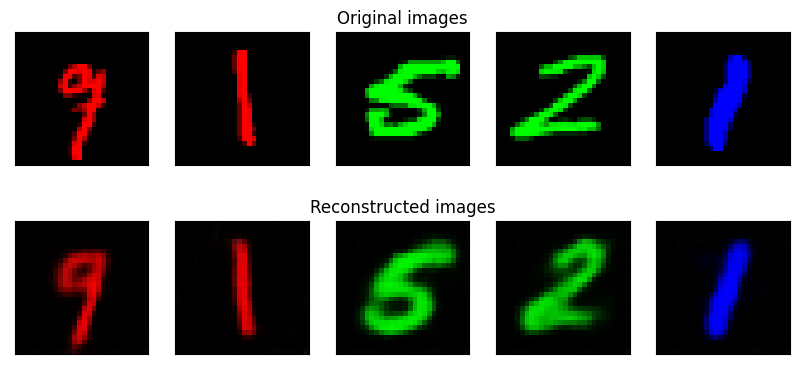

	 partial train loss (single batch): 0.009839
	 partial train loss (single batch): 0.008833
	 partial train loss (single batch): 0.009910
	 partial train loss (single batch): 0.009156
	 partial train loss (single batch): 0.010828
	 partial train loss (single batch): 0.010084
	 partial train loss (single batch): 0.009638

 EPOCH 40/100 	 train loss 0.009 	 val loss 0.010


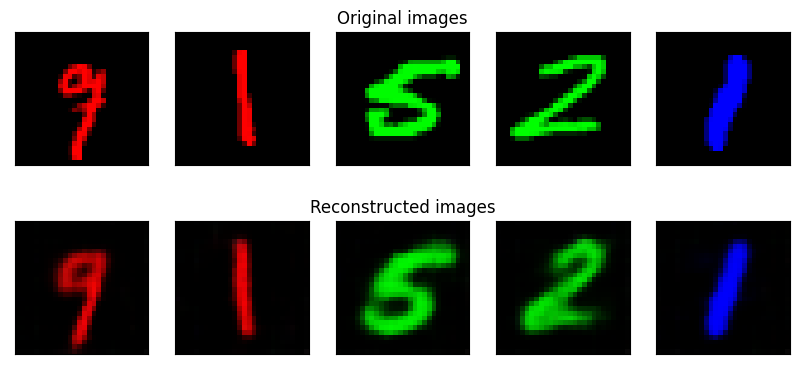

	 partial train loss (single batch): 0.009809
	 partial train loss (single batch): 0.008907
	 partial train loss (single batch): 0.009889
	 partial train loss (single batch): 0.009190
	 partial train loss (single batch): 0.010980
	 partial train loss (single batch): 0.010063
	 partial train loss (single batch): 0.009545

 EPOCH 41/100 	 train loss 0.009 	 val loss 0.010


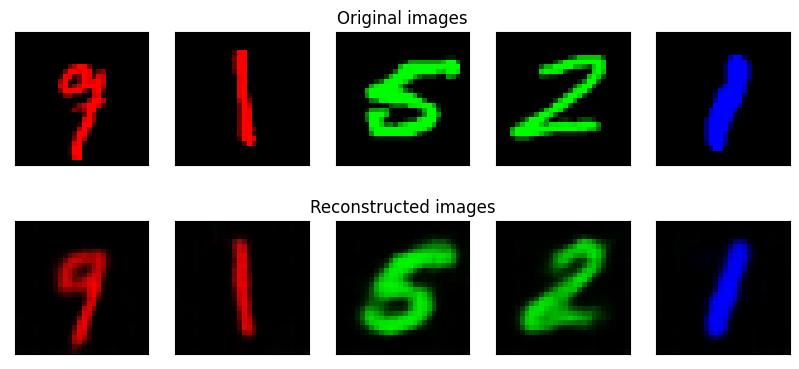

	 partial train loss (single batch): 0.009824
	 partial train loss (single batch): 0.008727
	 partial train loss (single batch): 0.009899
	 partial train loss (single batch): 0.009215
	 partial train loss (single batch): 0.010924
	 partial train loss (single batch): 0.010011
	 partial train loss (single batch): 0.009622

 EPOCH 42/100 	 train loss 0.009 	 val loss 0.009


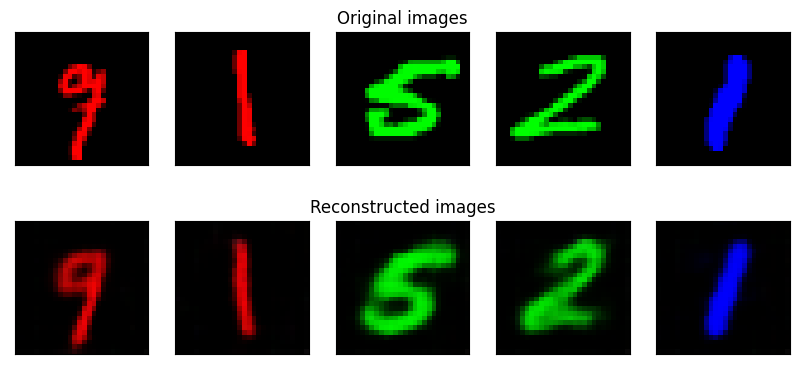

	 partial train loss (single batch): 0.009818
	 partial train loss (single batch): 0.008837
	 partial train loss (single batch): 0.010010
	 partial train loss (single batch): 0.009178
	 partial train loss (single batch): 0.010924
	 partial train loss (single batch): 0.010146
	 partial train loss (single batch): 0.009575

 EPOCH 43/100 	 train loss 0.009 	 val loss 0.009


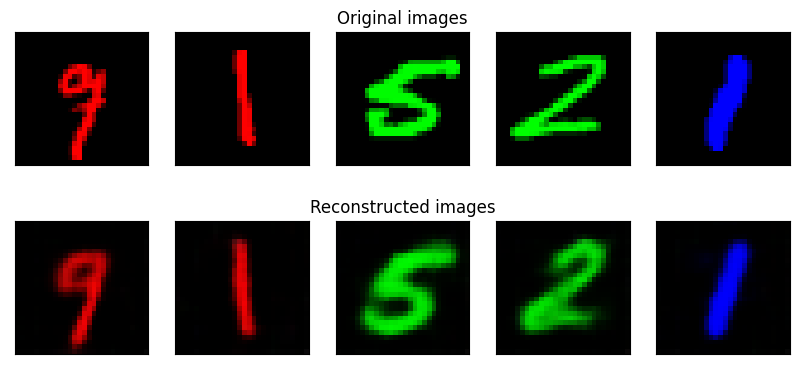

	 partial train loss (single batch): 0.009821
	 partial train loss (single batch): 0.008797
	 partial train loss (single batch): 0.009805
	 partial train loss (single batch): 0.009183
	 partial train loss (single batch): 0.010867
	 partial train loss (single batch): 0.010312
	 partial train loss (single batch): 0.009592

 EPOCH 44/100 	 train loss 0.009 	 val loss 0.009


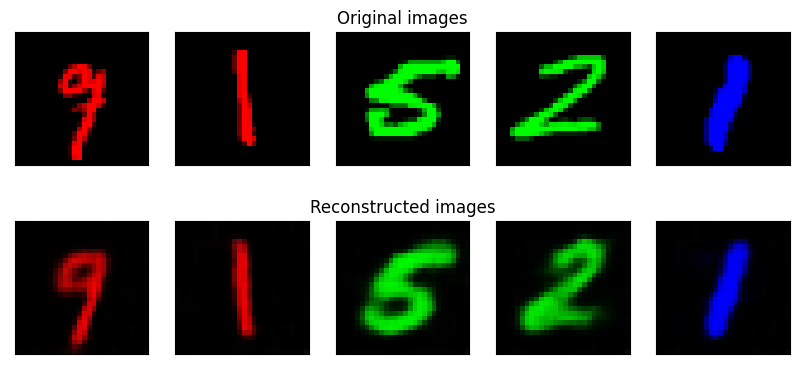

	 partial train loss (single batch): 0.009827
	 partial train loss (single batch): 0.008703
	 partial train loss (single batch): 0.009846
	 partial train loss (single batch): 0.009082
	 partial train loss (single batch): 0.010882
	 partial train loss (single batch): 0.010196
	 partial train loss (single batch): 0.009622

 EPOCH 45/100 	 train loss 0.009 	 val loss 0.009


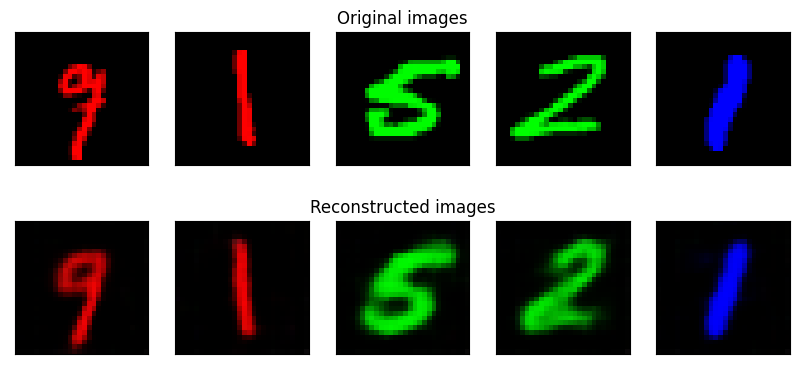

	 partial train loss (single batch): 0.009770
	 partial train loss (single batch): 0.008818
	 partial train loss (single batch): 0.009844
	 partial train loss (single batch): 0.009072
	 partial train loss (single batch): 0.010841
	 partial train loss (single batch): 0.010152
	 partial train loss (single batch): 0.009589

 EPOCH 46/100 	 train loss 0.009 	 val loss 0.009


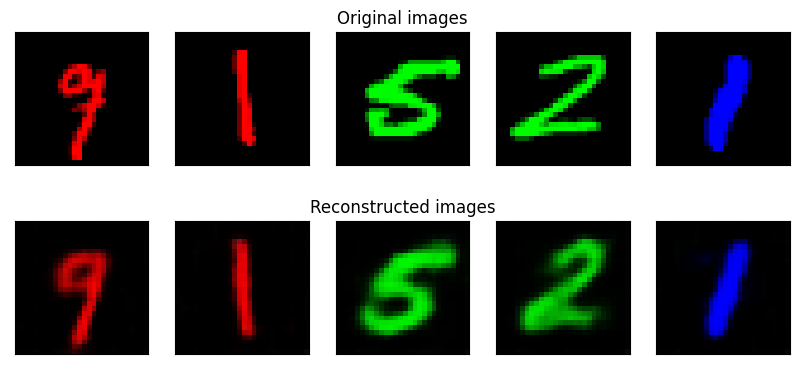

	 partial train loss (single batch): 0.009795
	 partial train loss (single batch): 0.008852
	 partial train loss (single batch): 0.009848
	 partial train loss (single batch): 0.009139
	 partial train loss (single batch): 0.010928
	 partial train loss (single batch): 0.010197
	 partial train loss (single batch): 0.009553

 EPOCH 47/100 	 train loss 0.009 	 val loss 0.009


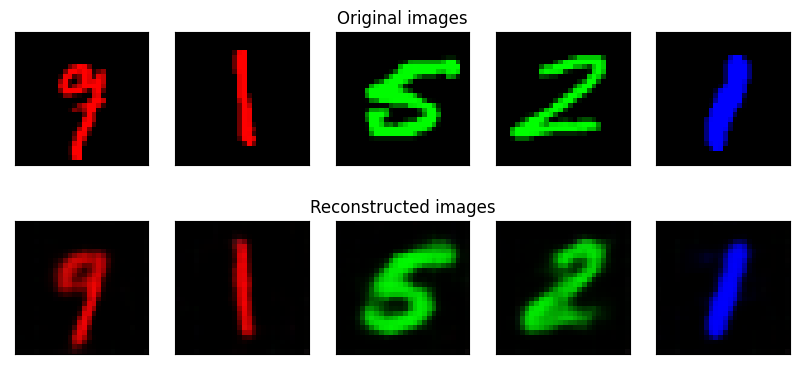

	 partial train loss (single batch): 0.009755
	 partial train loss (single batch): 0.008839
	 partial train loss (single batch): 0.009852
	 partial train loss (single batch): 0.009218
	 partial train loss (single batch): 0.010796
	 partial train loss (single batch): 0.010169
	 partial train loss (single batch): 0.009500

 EPOCH 48/100 	 train loss 0.009 	 val loss 0.009


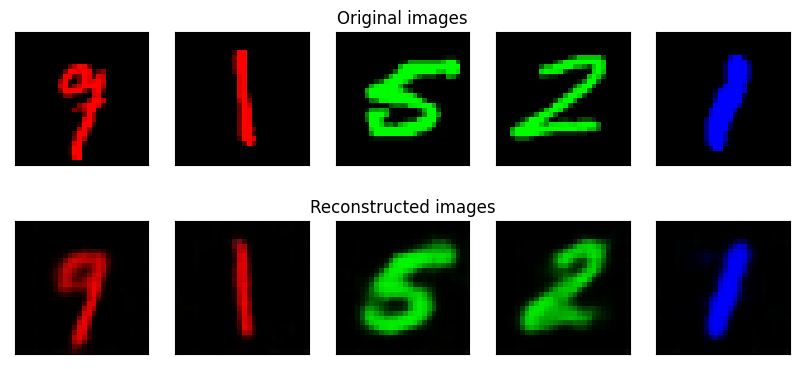

	 partial train loss (single batch): 0.009734
	 partial train loss (single batch): 0.008778
	 partial train loss (single batch): 0.009942
	 partial train loss (single batch): 0.009166
	 partial train loss (single batch): 0.010762
	 partial train loss (single batch): 0.010166
	 partial train loss (single batch): 0.009708

 EPOCH 49/100 	 train loss 0.009 	 val loss 0.010


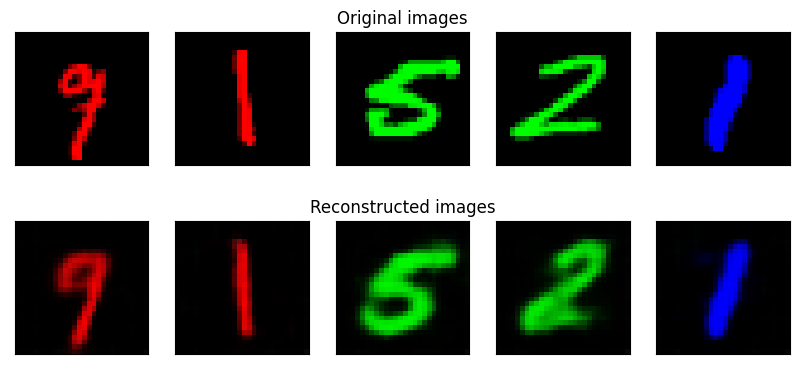

	 partial train loss (single batch): 0.009693
	 partial train loss (single batch): 0.008834
	 partial train loss (single batch): 0.009810
	 partial train loss (single batch): 0.009180
	 partial train loss (single batch): 0.010841
	 partial train loss (single batch): 0.010161
	 partial train loss (single batch): 0.009683

 EPOCH 50/100 	 train loss 0.009 	 val loss 0.009


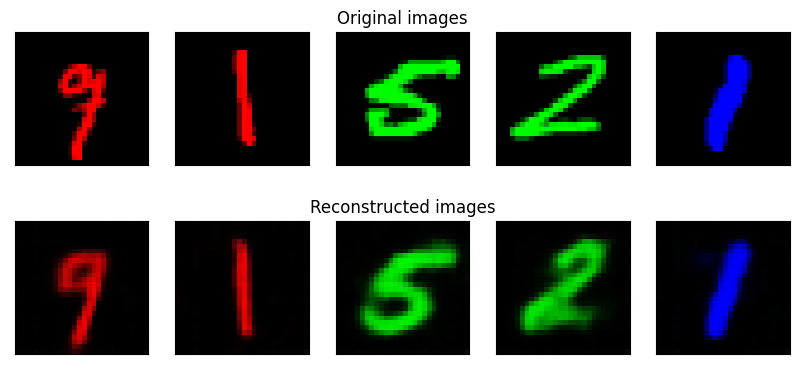

	 partial train loss (single batch): 0.009652
	 partial train loss (single batch): 0.008773
	 partial train loss (single batch): 0.009884
	 partial train loss (single batch): 0.009267
	 partial train loss (single batch): 0.010854
	 partial train loss (single batch): 0.010133
	 partial train loss (single batch): 0.009667

 EPOCH 51/100 	 train loss 0.009 	 val loss 0.010


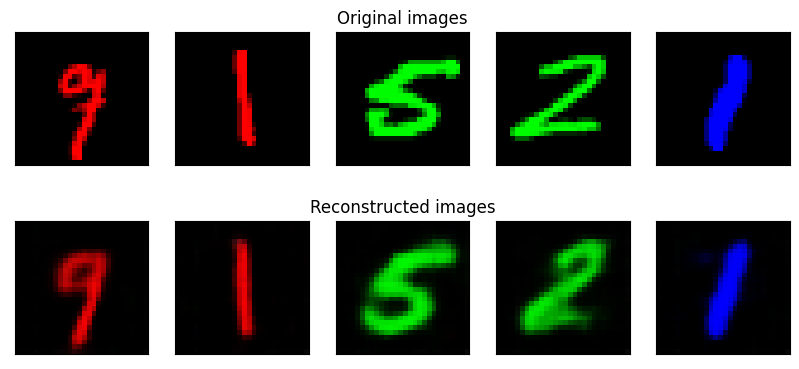

	 partial train loss (single batch): 0.009663
	 partial train loss (single batch): 0.008776
	 partial train loss (single batch): 0.009870
	 partial train loss (single batch): 0.009116
	 partial train loss (single batch): 0.011005
	 partial train loss (single batch): 0.010073
	 partial train loss (single batch): 0.009635

 EPOCH 52/100 	 train loss 0.009 	 val loss 0.009


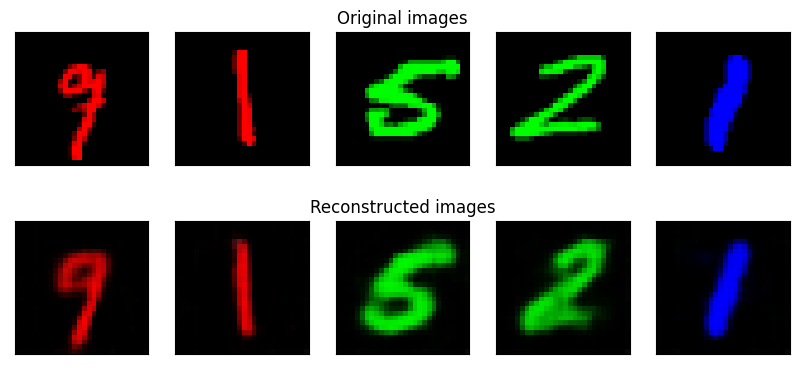

	 partial train loss (single batch): 0.009621
	 partial train loss (single batch): 0.008696
	 partial train loss (single batch): 0.009821
	 partial train loss (single batch): 0.009152
	 partial train loss (single batch): 0.010790
	 partial train loss (single batch): 0.010188
	 partial train loss (single batch): 0.009453

 EPOCH 53/100 	 train loss 0.009 	 val loss 0.009


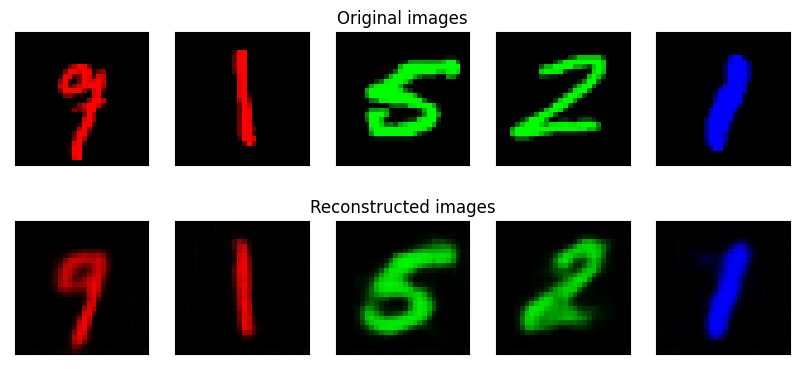

	 partial train loss (single batch): 0.009637
	 partial train loss (single batch): 0.008753
	 partial train loss (single batch): 0.009771
	 partial train loss (single batch): 0.009150
	 partial train loss (single batch): 0.010834
	 partial train loss (single batch): 0.010272
	 partial train loss (single batch): 0.009506

 EPOCH 54/100 	 train loss 0.009 	 val loss 0.009


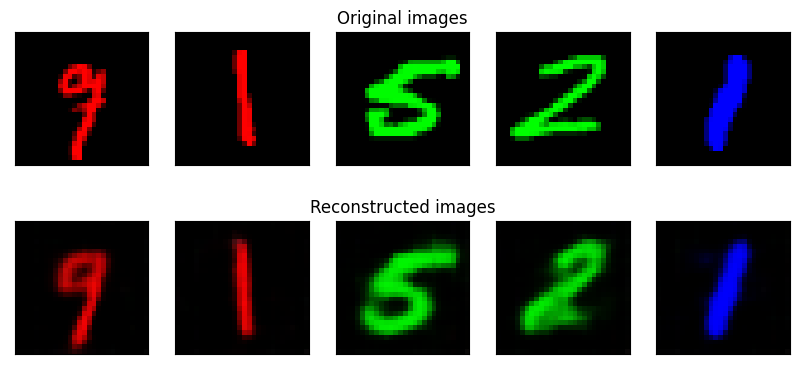

	 partial train loss (single batch): 0.009588
	 partial train loss (single batch): 0.008639
	 partial train loss (single batch): 0.009888
	 partial train loss (single batch): 0.009181
	 partial train loss (single batch): 0.010762
	 partial train loss (single batch): 0.010153
	 partial train loss (single batch): 0.009509

 EPOCH 55/100 	 train loss 0.009 	 val loss 0.009


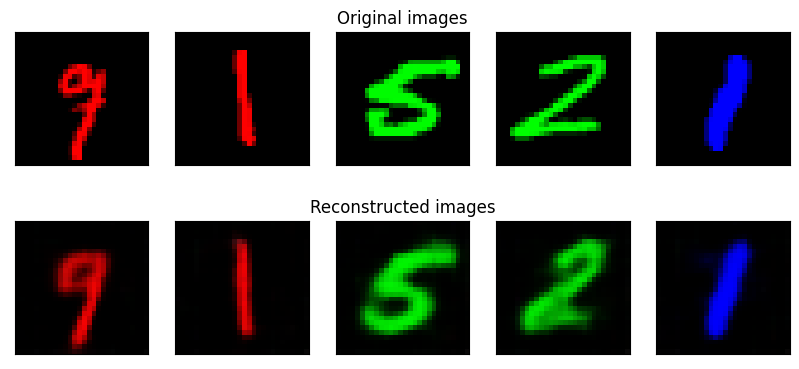

	 partial train loss (single batch): 0.009617
	 partial train loss (single batch): 0.008620
	 partial train loss (single batch): 0.009774
	 partial train loss (single batch): 0.009130
	 partial train loss (single batch): 0.010919
	 partial train loss (single batch): 0.010132
	 partial train loss (single batch): 0.009416

 EPOCH 56/100 	 train loss 0.009 	 val loss 0.009


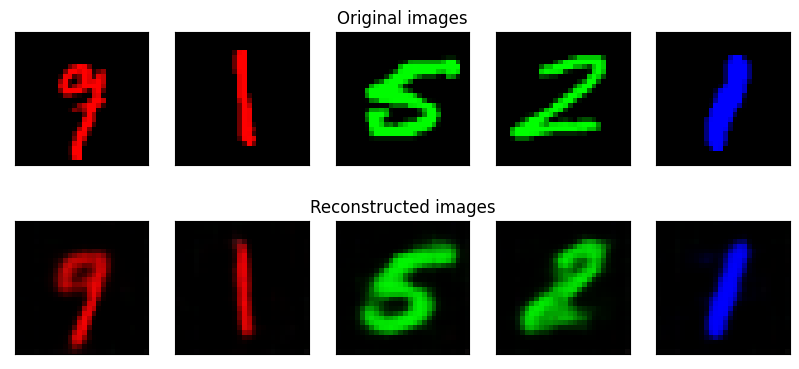

	 partial train loss (single batch): 0.009623
	 partial train loss (single batch): 0.008674
	 partial train loss (single batch): 0.009786
	 partial train loss (single batch): 0.009033
	 partial train loss (single batch): 0.010843
	 partial train loss (single batch): 0.010181
	 partial train loss (single batch): 0.009477

 EPOCH 57/100 	 train loss 0.009 	 val loss 0.009


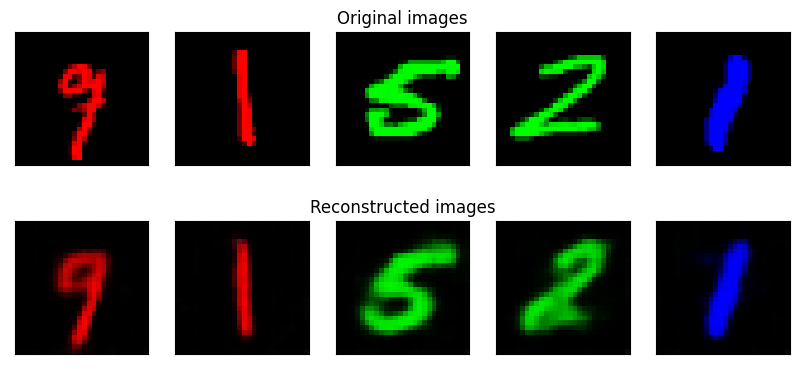

	 partial train loss (single batch): 0.009633
	 partial train loss (single batch): 0.008755
	 partial train loss (single batch): 0.009790
	 partial train loss (single batch): 0.009069
	 partial train loss (single batch): 0.010871
	 partial train loss (single batch): 0.010239
	 partial train loss (single batch): 0.009401

 EPOCH 58/100 	 train loss 0.009 	 val loss 0.009


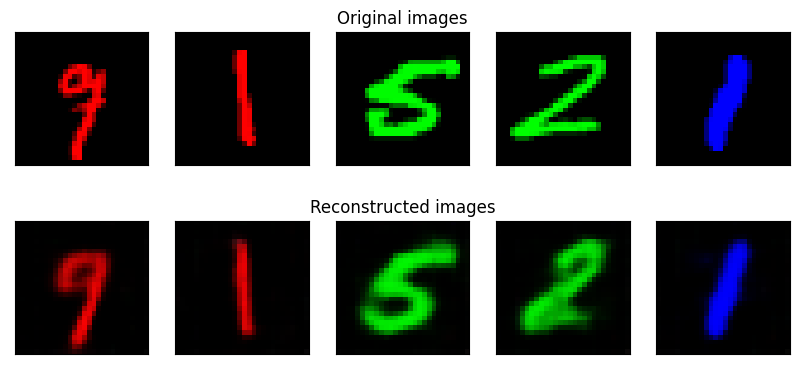

	 partial train loss (single batch): 0.009641
	 partial train loss (single batch): 0.008792
	 partial train loss (single batch): 0.009748
	 partial train loss (single batch): 0.008996
	 partial train loss (single batch): 0.010905
	 partial train loss (single batch): 0.010110
	 partial train loss (single batch): 0.009588

 EPOCH 59/100 	 train loss 0.009 	 val loss 0.009


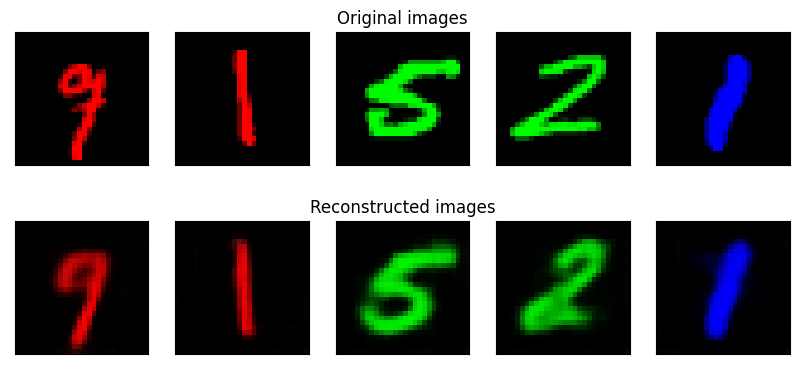

	 partial train loss (single batch): 0.009612
	 partial train loss (single batch): 0.008731
	 partial train loss (single batch): 0.009798
	 partial train loss (single batch): 0.008996
	 partial train loss (single batch): 0.010932
	 partial train loss (single batch): 0.010160
	 partial train loss (single batch): 0.009521

 EPOCH 60/100 	 train loss 0.009 	 val loss 0.009


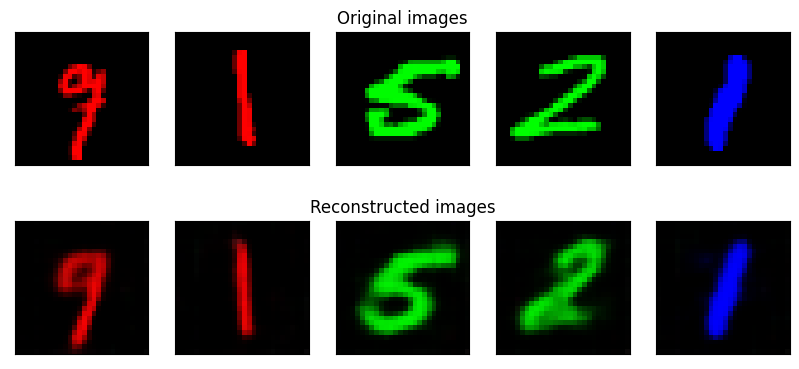

	 partial train loss (single batch): 0.009685
	 partial train loss (single batch): 0.008677
	 partial train loss (single batch): 0.009759
	 partial train loss (single batch): 0.009050
	 partial train loss (single batch): 0.010785
	 partial train loss (single batch): 0.010067
	 partial train loss (single batch): 0.009476

 EPOCH 61/100 	 train loss 0.009 	 val loss 0.009


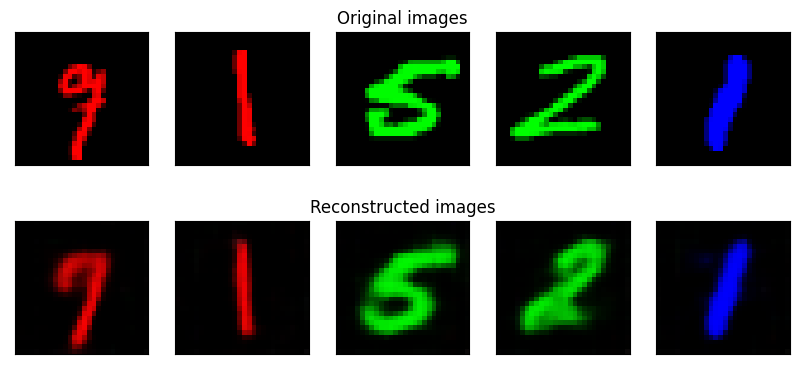

	 partial train loss (single batch): 0.009614
	 partial train loss (single batch): 0.008630
	 partial train loss (single batch): 0.009787
	 partial train loss (single batch): 0.009109
	 partial train loss (single batch): 0.010903
	 partial train loss (single batch): 0.010282
	 partial train loss (single batch): 0.009583

 EPOCH 62/100 	 train loss 0.009 	 val loss 0.009


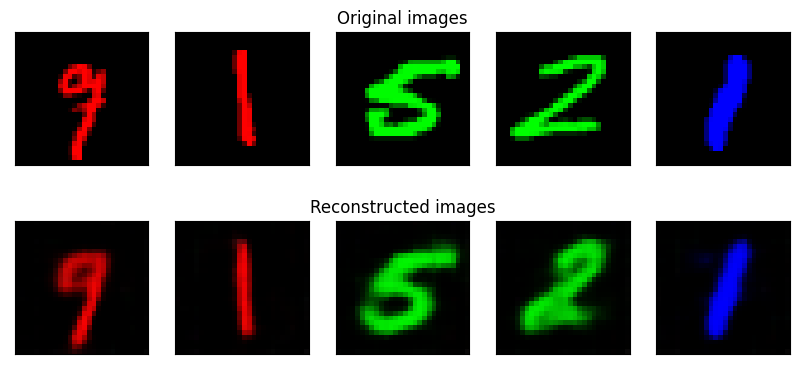

	 partial train loss (single batch): 0.009639
	 partial train loss (single batch): 0.008633
	 partial train loss (single batch): 0.009705
	 partial train loss (single batch): 0.009157
	 partial train loss (single batch): 0.010814
	 partial train loss (single batch): 0.010281
	 partial train loss (single batch): 0.009643

 EPOCH 63/100 	 train loss 0.009 	 val loss 0.009


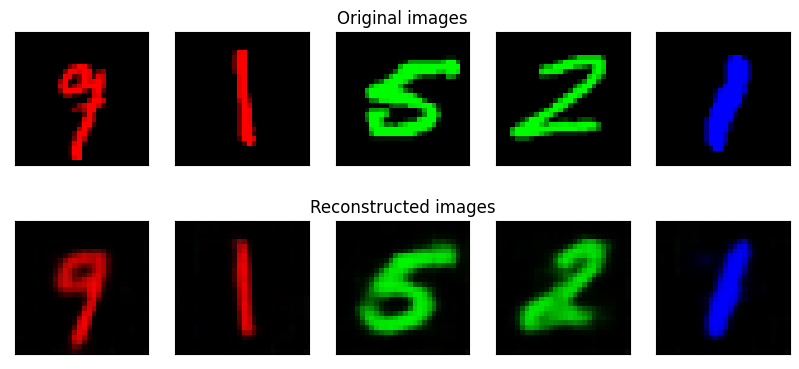

	 partial train loss (single batch): 0.009594
	 partial train loss (single batch): 0.008696
	 partial train loss (single batch): 0.009782
	 partial train loss (single batch): 0.009018
	 partial train loss (single batch): 0.010967
	 partial train loss (single batch): 0.010069
	 partial train loss (single batch): 0.009596

 EPOCH 64/100 	 train loss 0.009 	 val loss 0.009


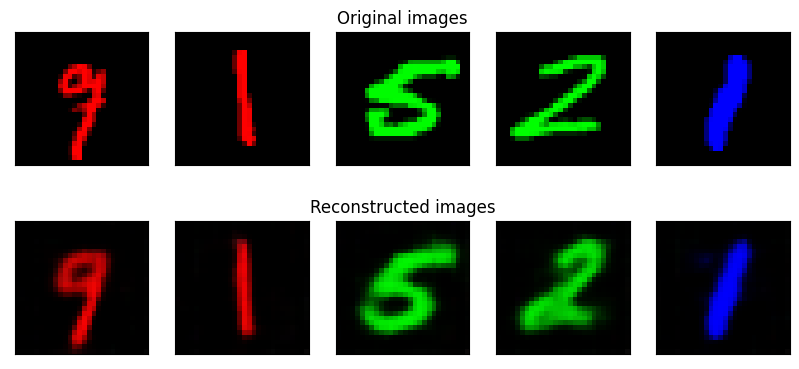

	 partial train loss (single batch): 0.009540
	 partial train loss (single batch): 0.008708
	 partial train loss (single batch): 0.009865
	 partial train loss (single batch): 0.009059
	 partial train loss (single batch): 0.010784
	 partial train loss (single batch): 0.010226
	 partial train loss (single batch): 0.009503

 EPOCH 65/100 	 train loss 0.009 	 val loss 0.009


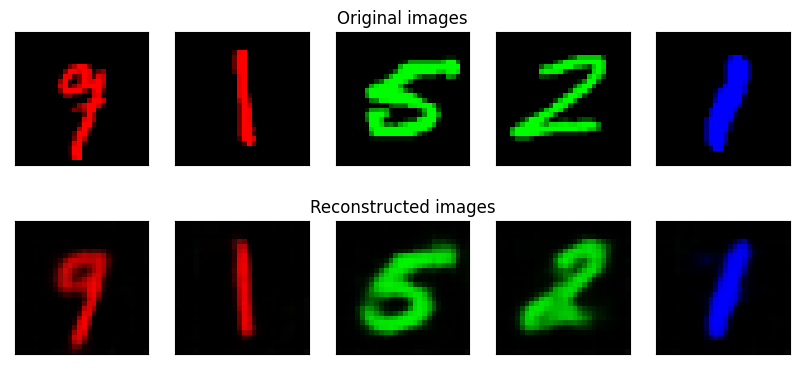

	 partial train loss (single batch): 0.009565
	 partial train loss (single batch): 0.008678
	 partial train loss (single batch): 0.009720
	 partial train loss (single batch): 0.008989
	 partial train loss (single batch): 0.010892
	 partial train loss (single batch): 0.010126
	 partial train loss (single batch): 0.009630

 EPOCH 66/100 	 train loss 0.009 	 val loss 0.009


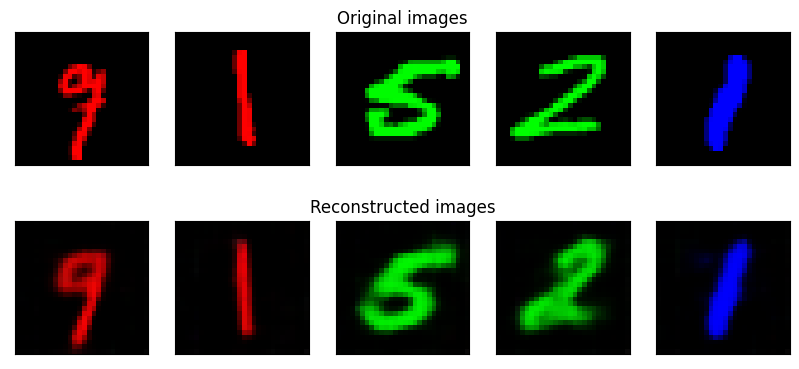

	 partial train loss (single batch): 0.009628
	 partial train loss (single batch): 0.008656
	 partial train loss (single batch): 0.009814
	 partial train loss (single batch): 0.009050
	 partial train loss (single batch): 0.010849
	 partial train loss (single batch): 0.010142
	 partial train loss (single batch): 0.009573

 EPOCH 67/100 	 train loss 0.009 	 val loss 0.009


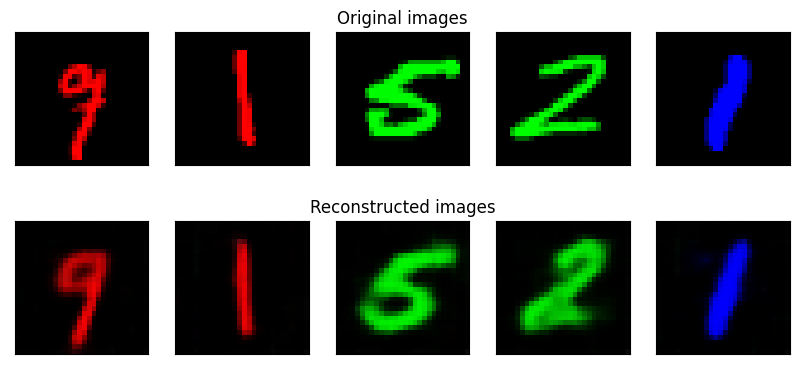

	 partial train loss (single batch): 0.009592
	 partial train loss (single batch): 0.008578
	 partial train loss (single batch): 0.009758
	 partial train loss (single batch): 0.009035
	 partial train loss (single batch): 0.010872
	 partial train loss (single batch): 0.010171
	 partial train loss (single batch): 0.009655

 EPOCH 68/100 	 train loss 0.009 	 val loss 0.009


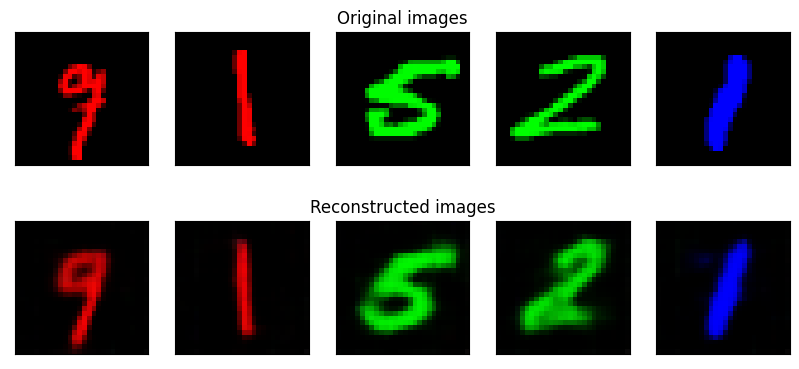

	 partial train loss (single batch): 0.009601
	 partial train loss (single batch): 0.008595
	 partial train loss (single batch): 0.009896
	 partial train loss (single batch): 0.009004
	 partial train loss (single batch): 0.010691
	 partial train loss (single batch): 0.010161
	 partial train loss (single batch): 0.009556

 EPOCH 69/100 	 train loss 0.009 	 val loss 0.009


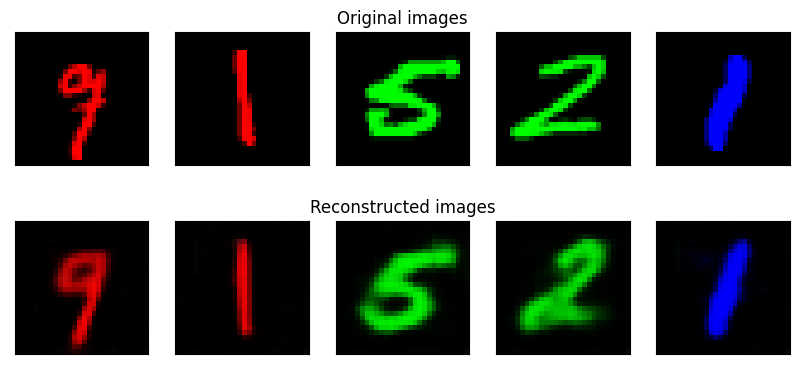

	 partial train loss (single batch): 0.009521
	 partial train loss (single batch): 0.008692
	 partial train loss (single batch): 0.009822
	 partial train loss (single batch): 0.009012
	 partial train loss (single batch): 0.010713
	 partial train loss (single batch): 0.010238
	 partial train loss (single batch): 0.009497

 EPOCH 70/100 	 train loss 0.009 	 val loss 0.009


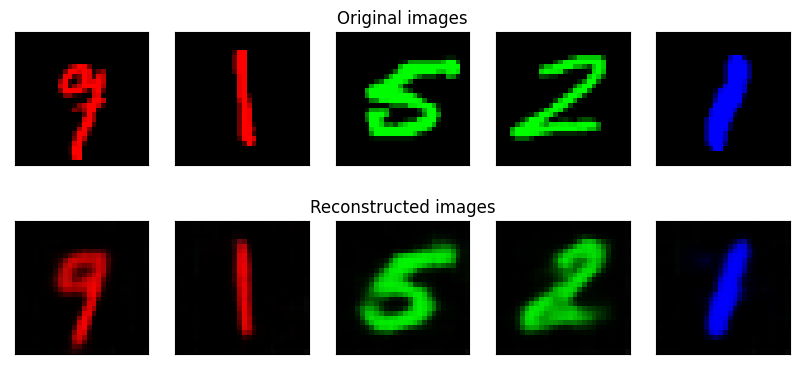

	 partial train loss (single batch): 0.009533
	 partial train loss (single batch): 0.008650
	 partial train loss (single batch): 0.009795
	 partial train loss (single batch): 0.009053
	 partial train loss (single batch): 0.010833
	 partial train loss (single batch): 0.010213
	 partial train loss (single batch): 0.009497

 EPOCH 71/100 	 train loss 0.009 	 val loss 0.009


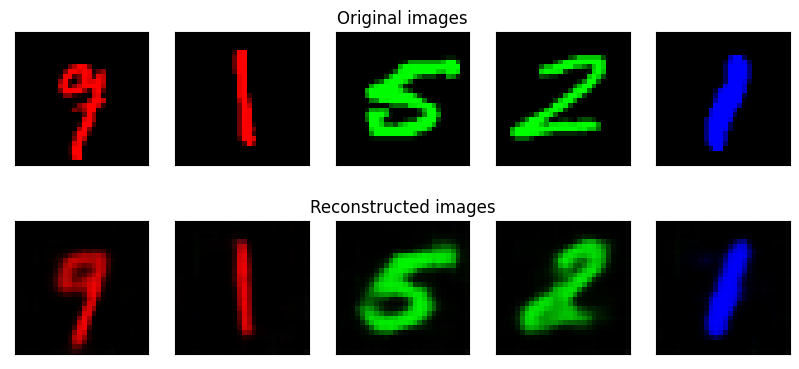

	 partial train loss (single batch): 0.009577
	 partial train loss (single batch): 0.008741
	 partial train loss (single batch): 0.009699
	 partial train loss (single batch): 0.008982
	 partial train loss (single batch): 0.010758
	 partial train loss (single batch): 0.010105
	 partial train loss (single batch): 0.009542

 EPOCH 72/100 	 train loss 0.009 	 val loss 0.009


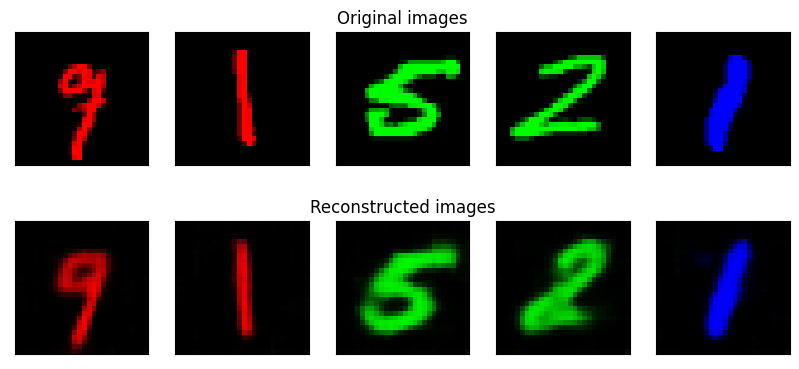

	 partial train loss (single batch): 0.009606
	 partial train loss (single batch): 0.008609
	 partial train loss (single batch): 0.009792
	 partial train loss (single batch): 0.008989
	 partial train loss (single batch): 0.010793
	 partial train loss (single batch): 0.010012
	 partial train loss (single batch): 0.009670

 EPOCH 73/100 	 train loss 0.009 	 val loss 0.009


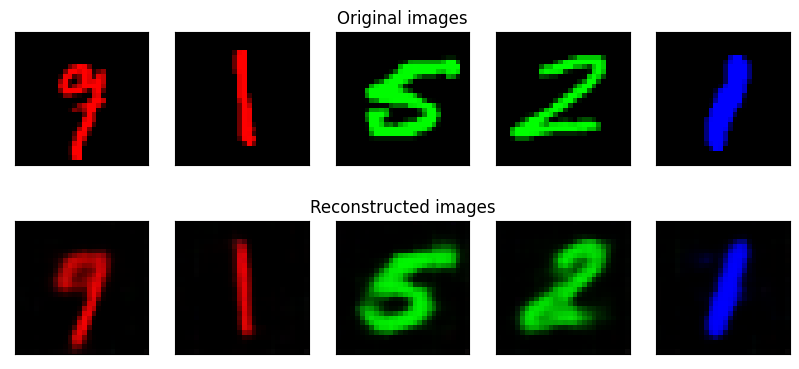

	 partial train loss (single batch): 0.009560
	 partial train loss (single batch): 0.008661
	 partial train loss (single batch): 0.009876
	 partial train loss (single batch): 0.009167
	 partial train loss (single batch): 0.010808
	 partial train loss (single batch): 0.010118
	 partial train loss (single batch): 0.009611

 EPOCH 74/100 	 train loss 0.009 	 val loss 0.009


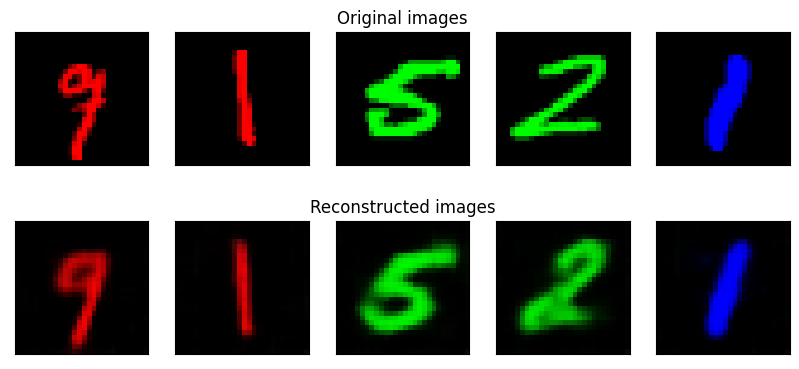

	 partial train loss (single batch): 0.009550
	 partial train loss (single batch): 0.008601
	 partial train loss (single batch): 0.009771
	 partial train loss (single batch): 0.009001
	 partial train loss (single batch): 0.010820
	 partial train loss (single batch): 0.010110
	 partial train loss (single batch): 0.009616

 EPOCH 75/100 	 train loss 0.009 	 val loss 0.009


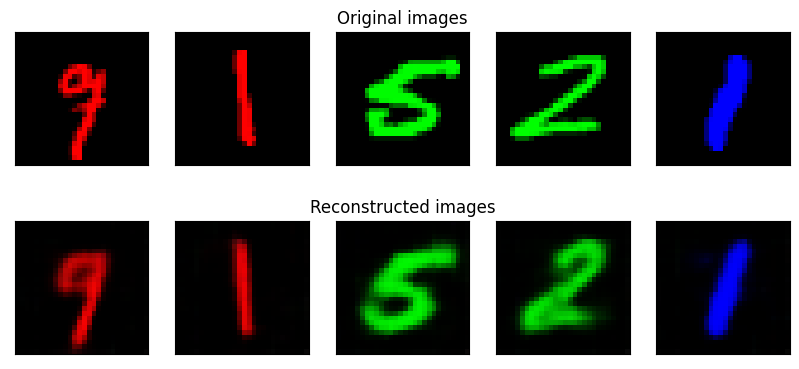

	 partial train loss (single batch): 0.009462
	 partial train loss (single batch): 0.008670
	 partial train loss (single batch): 0.009744
	 partial train loss (single batch): 0.009223
	 partial train loss (single batch): 0.010822
	 partial train loss (single batch): 0.010010
	 partial train loss (single batch): 0.009549

 EPOCH 76/100 	 train loss 0.009 	 val loss 0.009


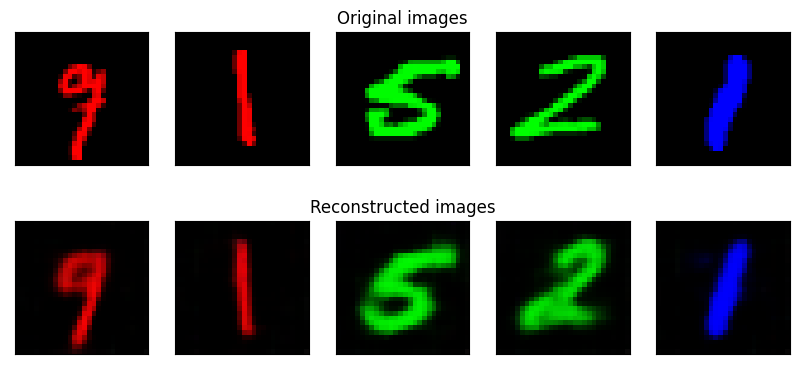

	 partial train loss (single batch): 0.009524
	 partial train loss (single batch): 0.008739
	 partial train loss (single batch): 0.009738
	 partial train loss (single batch): 0.009083
	 partial train loss (single batch): 0.010867
	 partial train loss (single batch): 0.010027
	 partial train loss (single batch): 0.009516

 EPOCH 77/100 	 train loss 0.009 	 val loss 0.009


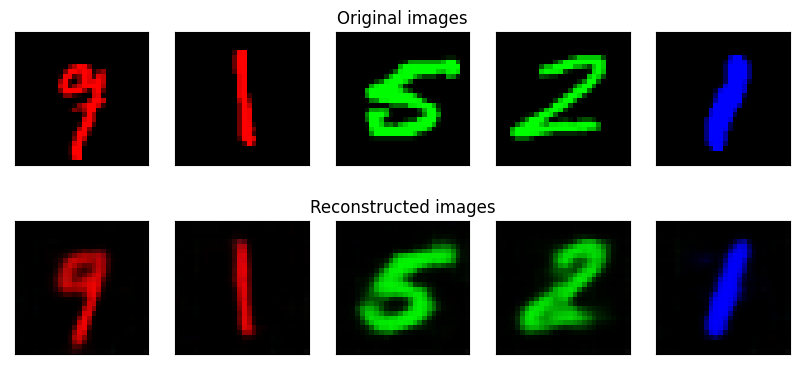

	 partial train loss (single batch): 0.009503
	 partial train loss (single batch): 0.008702
	 partial train loss (single batch): 0.009762
	 partial train loss (single batch): 0.009008
	 partial train loss (single batch): 0.010936
	 partial train loss (single batch): 0.009929
	 partial train loss (single batch): 0.009581

 EPOCH 78/100 	 train loss 0.009 	 val loss 0.009


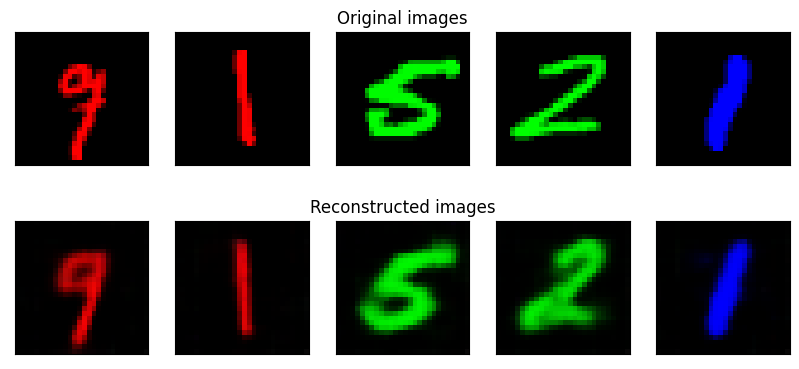

	 partial train loss (single batch): 0.009448
	 partial train loss (single batch): 0.008619
	 partial train loss (single batch): 0.009737
	 partial train loss (single batch): 0.009061
	 partial train loss (single batch): 0.010758
	 partial train loss (single batch): 0.010052
	 partial train loss (single batch): 0.009559

 EPOCH 79/100 	 train loss 0.009 	 val loss 0.009


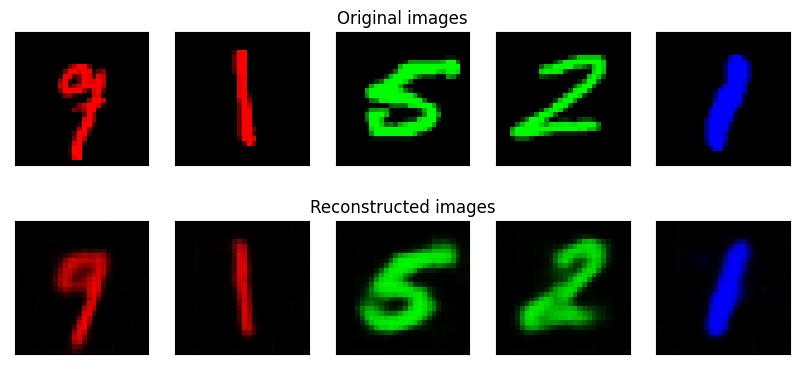

	 partial train loss (single batch): 0.009507
	 partial train loss (single batch): 0.008758
	 partial train loss (single batch): 0.009817
	 partial train loss (single batch): 0.009034
	 partial train loss (single batch): 0.010746
	 partial train loss (single batch): 0.009992
	 partial train loss (single batch): 0.009545

 EPOCH 80/100 	 train loss 0.009 	 val loss 0.009


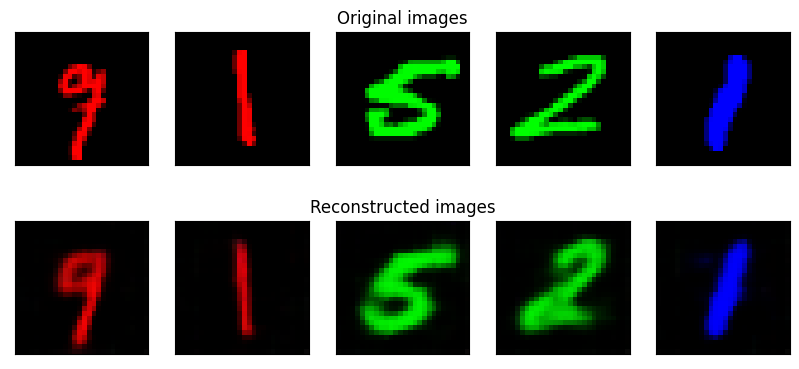

	 partial train loss (single batch): 0.009481
	 partial train loss (single batch): 0.008751
	 partial train loss (single batch): 0.009743
	 partial train loss (single batch): 0.009035
	 partial train loss (single batch): 0.010819
	 partial train loss (single batch): 0.009973
	 partial train loss (single batch): 0.009520

 EPOCH 81/100 	 train loss 0.009 	 val loss 0.009


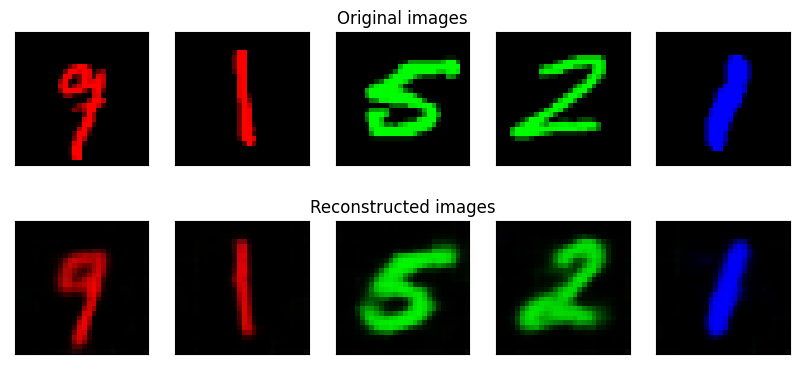

	 partial train loss (single batch): 0.009484
	 partial train loss (single batch): 0.008692
	 partial train loss (single batch): 0.009827
	 partial train loss (single batch): 0.008922
	 partial train loss (single batch): 0.010842
	 partial train loss (single batch): 0.009943
	 partial train loss (single batch): 0.009660

 EPOCH 82/100 	 train loss 0.009 	 val loss 0.009


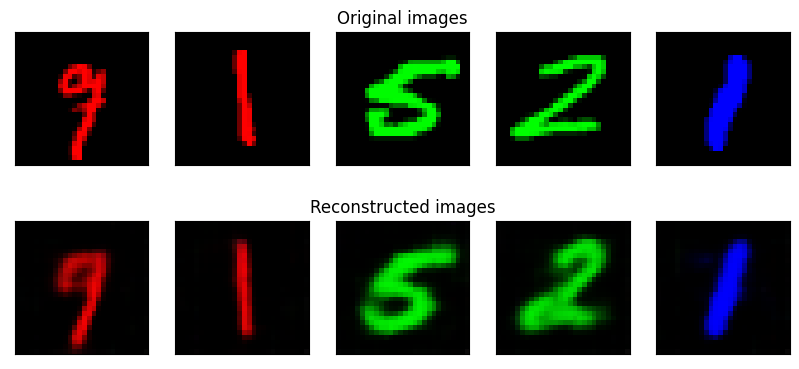

	 partial train loss (single batch): 0.009477
	 partial train loss (single batch): 0.008686
	 partial train loss (single batch): 0.009753
	 partial train loss (single batch): 0.009063
	 partial train loss (single batch): 0.010747
	 partial train loss (single batch): 0.009914
	 partial train loss (single batch): 0.009481

 EPOCH 83/100 	 train loss 0.009 	 val loss 0.009


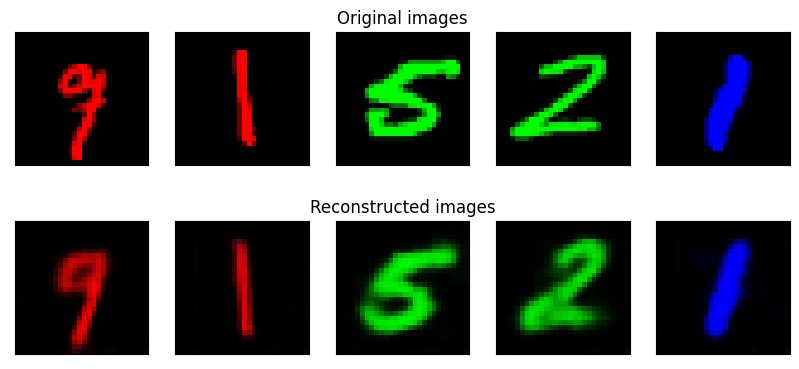

	 partial train loss (single batch): 0.009362
	 partial train loss (single batch): 0.008691
	 partial train loss (single batch): 0.009787
	 partial train loss (single batch): 0.009054
	 partial train loss (single batch): 0.010767
	 partial train loss (single batch): 0.009935
	 partial train loss (single batch): 0.009699

 EPOCH 84/100 	 train loss 0.009 	 val loss 0.009


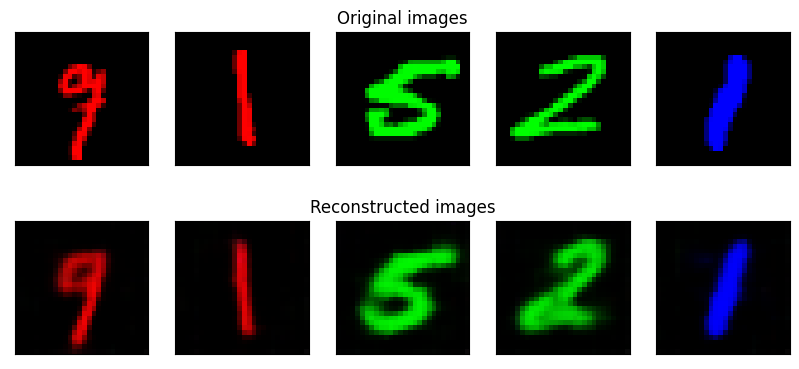

	 partial train loss (single batch): 0.009485
	 partial train loss (single batch): 0.008716
	 partial train loss (single batch): 0.009799
	 partial train loss (single batch): 0.009196
	 partial train loss (single batch): 0.010819
	 partial train loss (single batch): 0.009935
	 partial train loss (single batch): 0.009678

 EPOCH 85/100 	 train loss 0.009 	 val loss 0.009


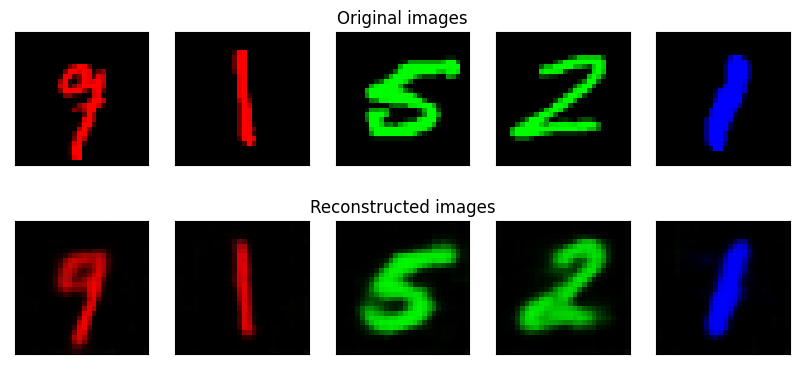

	 partial train loss (single batch): 0.009454
	 partial train loss (single batch): 0.008673
	 partial train loss (single batch): 0.009751
	 partial train loss (single batch): 0.009046
	 partial train loss (single batch): 0.010754
	 partial train loss (single batch): 0.009885
	 partial train loss (single batch): 0.009677

 EPOCH 86/100 	 train loss 0.009 	 val loss 0.009


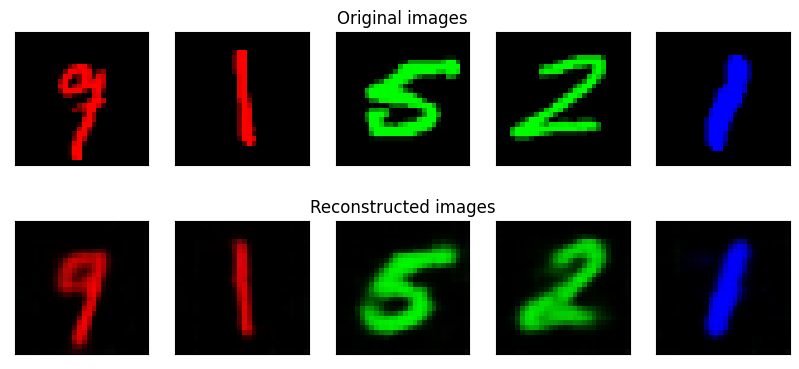

	 partial train loss (single batch): 0.009488
	 partial train loss (single batch): 0.008716
	 partial train loss (single batch): 0.009848
	 partial train loss (single batch): 0.009176
	 partial train loss (single batch): 0.010767
	 partial train loss (single batch): 0.009947
	 partial train loss (single batch): 0.009528

 EPOCH 87/100 	 train loss 0.009 	 val loss 0.009


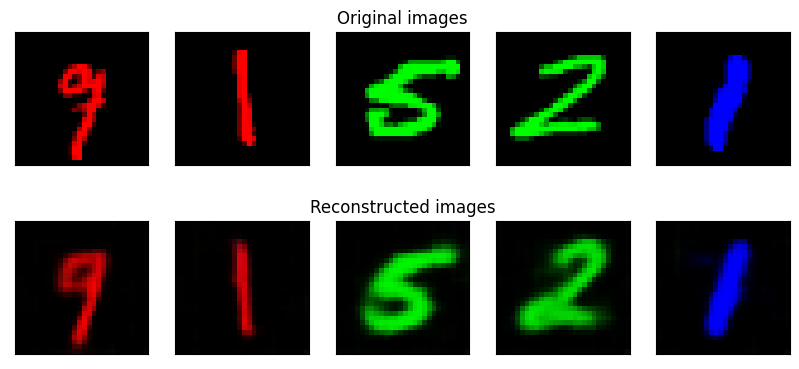

	 partial train loss (single batch): 0.009558
	 partial train loss (single batch): 0.008716
	 partial train loss (single batch): 0.009748
	 partial train loss (single batch): 0.009073
	 partial train loss (single batch): 0.010635
	 partial train loss (single batch): 0.009958
	 partial train loss (single batch): 0.009621

 EPOCH 88/100 	 train loss 0.009 	 val loss 0.009


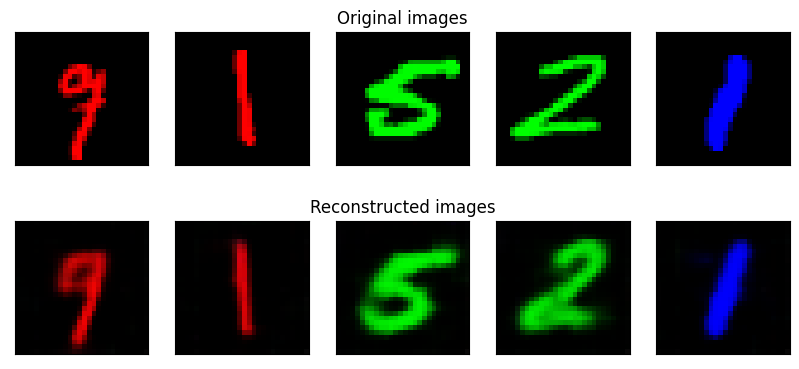

	 partial train loss (single batch): 0.009483
	 partial train loss (single batch): 0.008829
	 partial train loss (single batch): 0.009833
	 partial train loss (single batch): 0.009159
	 partial train loss (single batch): 0.010622
	 partial train loss (single batch): 0.009873
	 partial train loss (single batch): 0.009547

 EPOCH 89/100 	 train loss 0.009 	 val loss 0.009


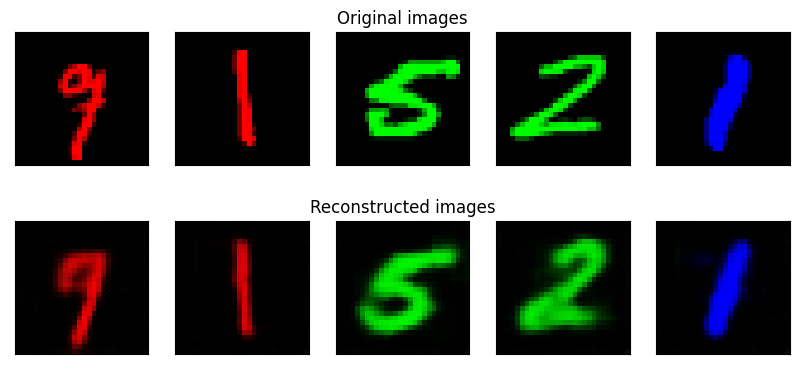

	 partial train loss (single batch): 0.009469
	 partial train loss (single batch): 0.008595
	 partial train loss (single batch): 0.009751
	 partial train loss (single batch): 0.009120
	 partial train loss (single batch): 0.010686
	 partial train loss (single batch): 0.009783
	 partial train loss (single batch): 0.009579

 EPOCH 90/100 	 train loss 0.009 	 val loss 0.009


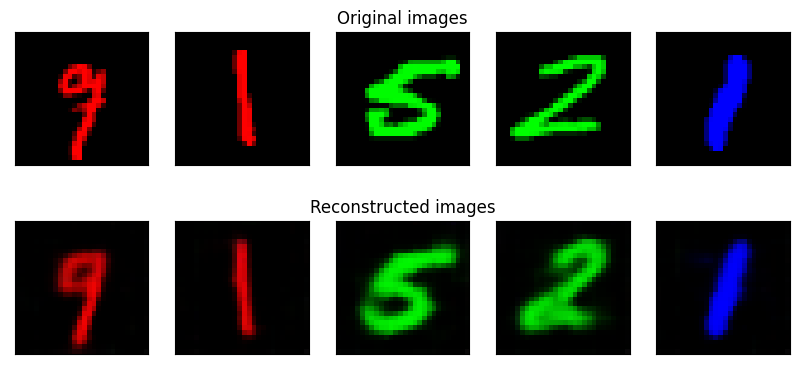

	 partial train loss (single batch): 0.009501
	 partial train loss (single batch): 0.008703
	 partial train loss (single batch): 0.010099
	 partial train loss (single batch): 0.009135
	 partial train loss (single batch): 0.010662
	 partial train loss (single batch): 0.009910
	 partial train loss (single batch): 0.009620

 EPOCH 91/100 	 train loss 0.009 	 val loss 0.009


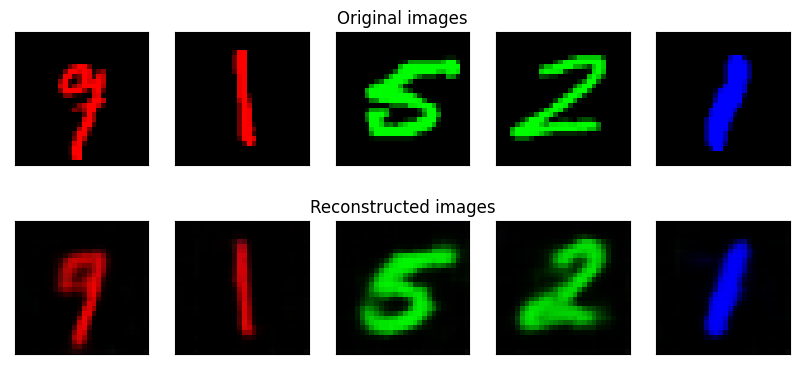

	 partial train loss (single batch): 0.009536
	 partial train loss (single batch): 0.008726
	 partial train loss (single batch): 0.009791
	 partial train loss (single batch): 0.009104
	 partial train loss (single batch): 0.010606
	 partial train loss (single batch): 0.009925
	 partial train loss (single batch): 0.009537

 EPOCH 92/100 	 train loss 0.009 	 val loss 0.009


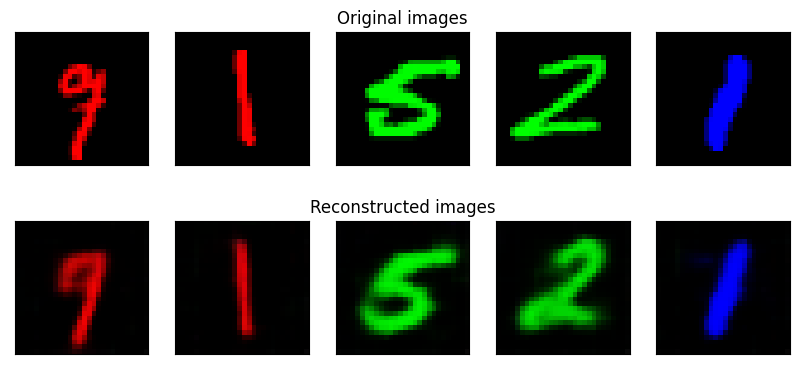

	 partial train loss (single batch): 0.009483
	 partial train loss (single batch): 0.008716
	 partial train loss (single batch): 0.009842
	 partial train loss (single batch): 0.009042
	 partial train loss (single batch): 0.010630
	 partial train loss (single batch): 0.009863
	 partial train loss (single batch): 0.009528

 EPOCH 93/100 	 train loss 0.009 	 val loss 0.009


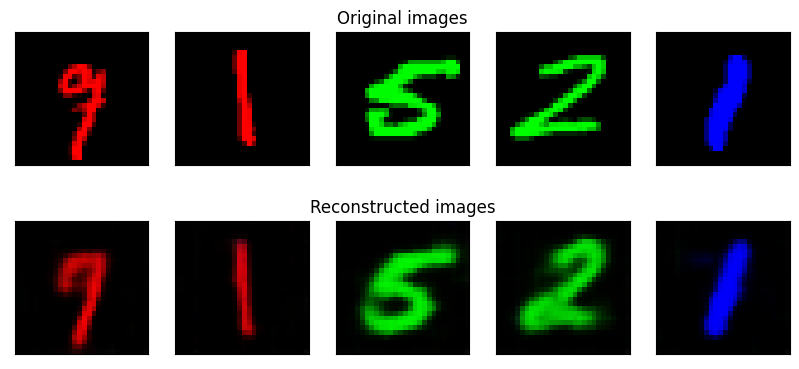

	 partial train loss (single batch): 0.009527
	 partial train loss (single batch): 0.008612
	 partial train loss (single batch): 0.009771
	 partial train loss (single batch): 0.008966
	 partial train loss (single batch): 0.010521
	 partial train loss (single batch): 0.009776
	 partial train loss (single batch): 0.009521

 EPOCH 94/100 	 train loss 0.009 	 val loss 0.009


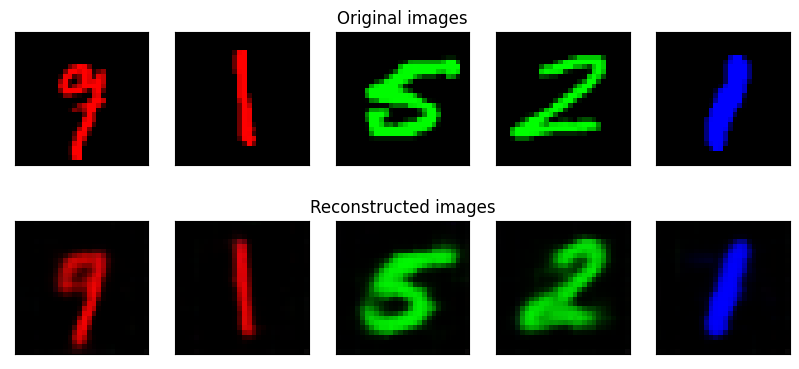

	 partial train loss (single batch): 0.009581
	 partial train loss (single batch): 0.008643
	 partial train loss (single batch): 0.009808
	 partial train loss (single batch): 0.009111
	 partial train loss (single batch): 0.010536
	 partial train loss (single batch): 0.009899
	 partial train loss (single batch): 0.009476

 EPOCH 95/100 	 train loss 0.009 	 val loss 0.009


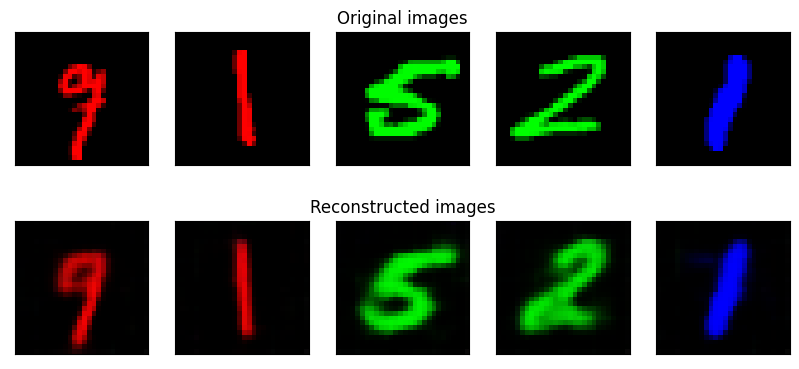

	 partial train loss (single batch): 0.009496
	 partial train loss (single batch): 0.008651
	 partial train loss (single batch): 0.009704
	 partial train loss (single batch): 0.009102
	 partial train loss (single batch): 0.010442
	 partial train loss (single batch): 0.009904
	 partial train loss (single batch): 0.009562

 EPOCH 96/100 	 train loss 0.009 	 val loss 0.009


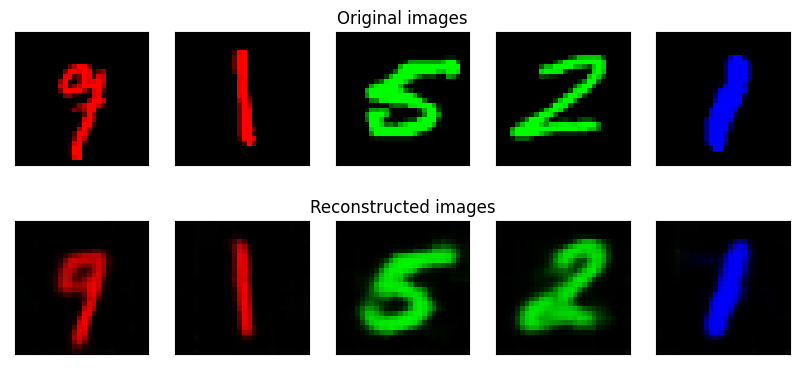

	 partial train loss (single batch): 0.009509
	 partial train loss (single batch): 0.008616
	 partial train loss (single batch): 0.009792
	 partial train loss (single batch): 0.009080
	 partial train loss (single batch): 0.010592
	 partial train loss (single batch): 0.009998
	 partial train loss (single batch): 0.009581

 EPOCH 97/100 	 train loss 0.009 	 val loss 0.009


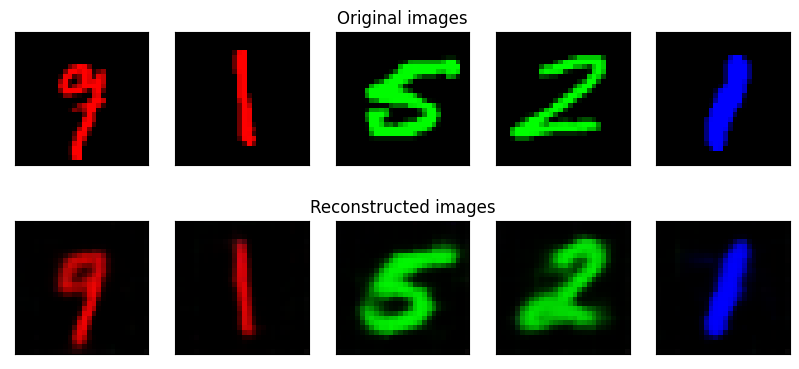

	 partial train loss (single batch): 0.009547
	 partial train loss (single batch): 0.008601
	 partial train loss (single batch): 0.009755
	 partial train loss (single batch): 0.009038
	 partial train loss (single batch): 0.010575
	 partial train loss (single batch): 0.010014
	 partial train loss (single batch): 0.009570

 EPOCH 98/100 	 train loss 0.009 	 val loss 0.009


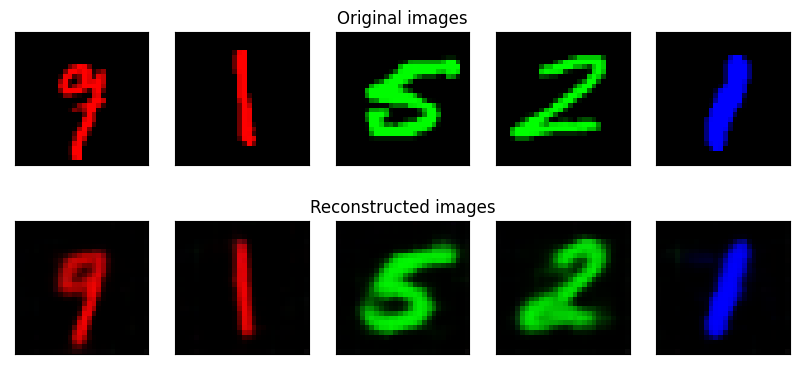

	 partial train loss (single batch): 0.009588
	 partial train loss (single batch): 0.008561
	 partial train loss (single batch): 0.009775
	 partial train loss (single batch): 0.009123
	 partial train loss (single batch): 0.010510
	 partial train loss (single batch): 0.010138
	 partial train loss (single batch): 0.009463

 EPOCH 99/100 	 train loss 0.009 	 val loss 0.009


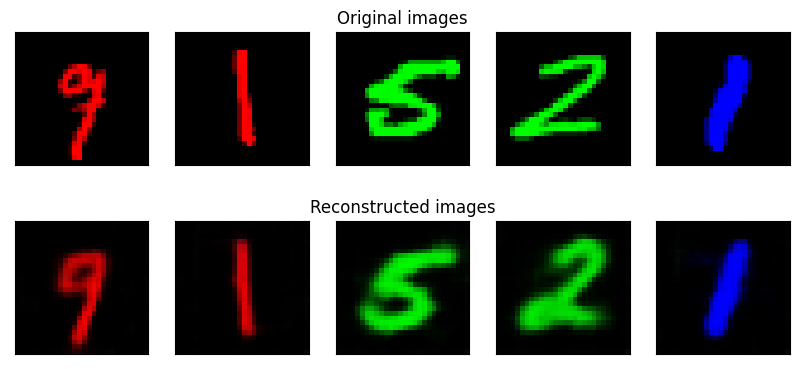

	 partial train loss (single batch): 0.009546
	 partial train loss (single batch): 0.008657
	 partial train loss (single batch): 0.009772
	 partial train loss (single batch): 0.009083
	 partial train loss (single batch): 0.010566
	 partial train loss (single batch): 0.009929
	 partial train loss (single batch): 0.009563

 EPOCH 100/100 	 train loss 0.009 	 val loss 0.009


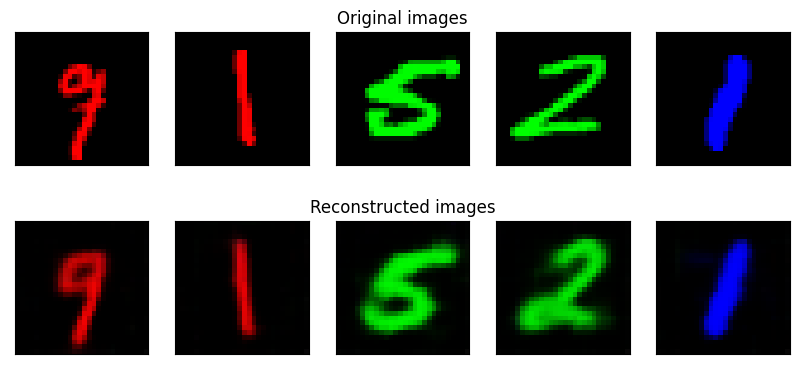

In [60]:
num_epochs = 100
history={'train_loss':[],'val_loss':[]}

## don't change the parameters in the classifiers, only use for loss function
for param in classifier_layout.parameters():
    param.requires_grad = False
for param in classifier_color.parameters():
    param.requires_grad = False

for epoch in range(num_epochs):
    train_loss = train_epoch(encoder,decoder,device,train_loader,loss_fn,optim)
    val_loss = test_epoch(encoder,decoder,device,valid_loader,loss_fn)
    print('\n EPOCH {}/{} \t train loss {:.3f} \t val loss {:.3f}'.format(epoch + 1, num_epochs,train_loss,val_loss))
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    plot_ae_outputs(encoder,decoder,n=5)

In [22]:
encoder.load_state_dict(torch.load(f'outputs/classifiers/encoder_d={d}.pt', map_location=torch.device('cpu')))
encoder.eval()

decoder.load_state_dict(torch.load(f'outputs/classifiers/decoder_d={d}.pt', map_location=torch.device('cpu')))
decoder.eval()

Decoder(
  (decoder_lin): Sequential(
    (0): Linear(in_features=4, out_features=128, bias=True)
    (1): ReLU(inplace=True)
    (2): Linear(in_features=128, out_features=288, bias=True)
    (3): ReLU(inplace=True)
  )
  (unflatten): Unflatten(dim=1, unflattened_size=(32, 3, 3))
  (decoder_conv): Sequential(
    (0): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(16, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (4): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(8, 3, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
  )
)

In [61]:
# torch.save(encoder.state_dict(), f'outputs/classifiers/encoder_d={d}.pt')
# torch.save(decoder.state_dict(), f'outputs/classifiers/decoder_d={d}.pt')

In [23]:
test_epoch(encoder,decoder,device,test_loader,loss_fn).item()

0.009173853322863579

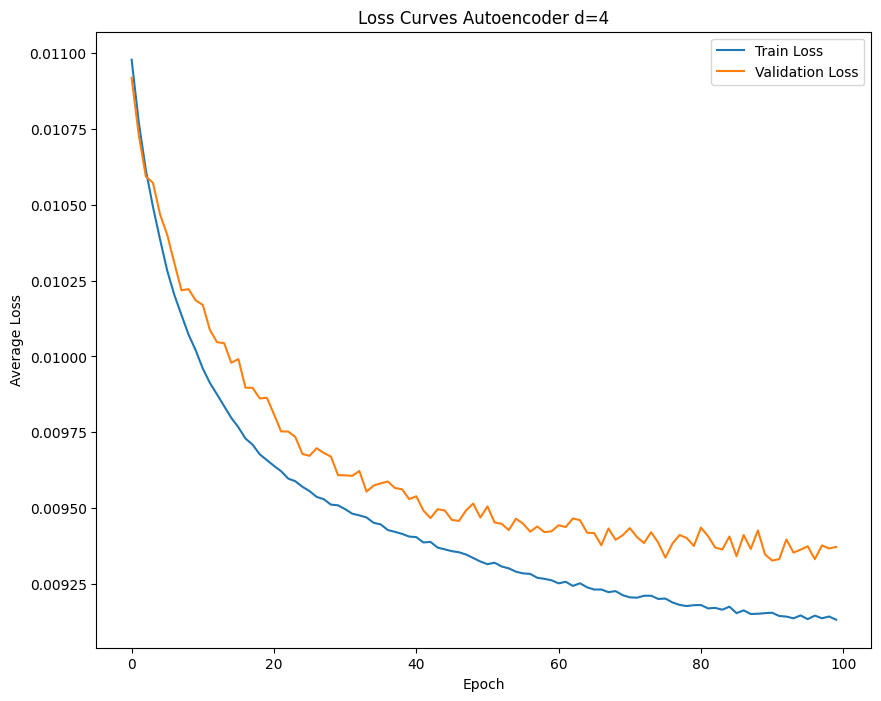

In [63]:
test_epoch(encoder,decoder,device,test_loader,loss_fn).item()# Plot losses
plt.figure(figsize=(10,8))
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Average Loss')
#plt.grid()
plt.legend()
plt.title(f'Loss Curves Autoencoder d={d}')
plt.show()

## 5. Generate new samples from the latent code

In [24]:
def linearly_interpolate(decoder, point1, point2, point3, point4, n=5):
    plt.figure(figsize=(8,8))
    
    def subprocess(a, b, idx_fun):
        difference = b - a
        jump_size = difference/(n+1)

        for i in range(0, n+2):
            plt.subplot(n+2, n+2, idx_fun(i, n))
            interpolate_coord = a + jump_size * i
            img = decoder(interpolate_coord.to(device))
            plt.imshow(img.detach().cpu().numpy().squeeze(0).transpose(2, 1, 0))
        
    subprocess(point1, point2, lambda i, n: (i)*(n+2) + 1)
    subprocess(point2, point3, lambda i, n: (n+2)*(n+1)+i+1)
    subprocess(point4, point3, lambda i, n: (i+1)*(n+2))
    subprocess(point1, point4, lambda i, n: i+1)
    
def linearly_interpolate_test_idxs(decoder, i1, i2, i3, i4, n=5):
    img1 = torch.from_numpy(test_dataset[i1][0]).unsqueeze(0).to(device)
    encoded1 = encoder(img1)
    img2 = torch.from_numpy(test_dataset[i2][0]).unsqueeze(0).to(device)
    encoded2 = encoder(img2)
    img3 = torch.from_numpy(test_dataset[i3][0]).unsqueeze(0).to(device)
    encoded3 = encoder(img3)
    img4 = torch.from_numpy(test_dataset[i4][0]).unsqueeze(0).to(device)
    encoded4 = encoder(img4)
    linearly_interpolate(decoder, encoded1, encoded2, encoded3, encoded4)


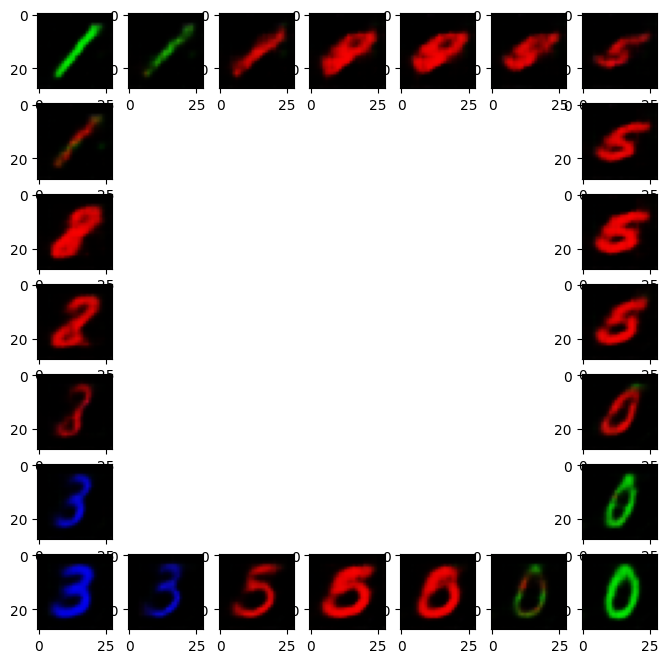

In [26]:
linearly_interpolate_test_idxs(decoder, 1, 15, 2, 14)

## 6. Visualize Latent Code 

In [73]:
encoded_samples = []
for sample in tqdm(test_dataset):
    img = torch.tensor(sample[0]).unsqueeze(0).to(device)
    label_number = sample[1]['number']
    label_color = sample[1]['color']
    # Encode image
    encoder.eval()
    with torch.no_grad():
        encoded_img  = encoder(img)
    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['color_label'] = label_color
    encoded_sample['number_label'] = label_number
    encoded_samples.append(encoded_sample)

100%|██████████████████████████████████████████████████████████████████████████████████████| 6000/6000 [00:02<00:00, 2010.12it/s]


In [74]:
encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples['distinct_label'] = encoded_samples.apply(lambda x: int(x['color_label'] * 10 + x['number_label']), axis=1)

In [75]:
encoded_samples

,Enc. Variable 0,Enc. Variable 1,Enc. Variable 2,Enc. Variable 3,color_label,number_label,distinct_label
0,-0.890961,0.287164,0.937215,-0.950234,0,0,0
1,0.117596,-0.190052,-0.867849,-0.064260,1,1,11
2,-0.578109,0.208155,0.017814,-1.020938,1,0,10
3,-0.213806,0.290778,-0.842374,-0.038924,1,9,19
4,0.345662,-0.090210,0.355664,-0.367916,0,3,3
...,...,...,...,...,...,...,...
5995,-0.992376,0.491000,-0.087805,-0.539391,1,6,16
5996,0.358568,-0.875269,0.358484,-0.208687,2,2,22
5997,-1.058421,0.002596,0.355492,0.884490,2,4,24
5998,-0.094407,0.507954,0.136038,0.068036,0,9,9


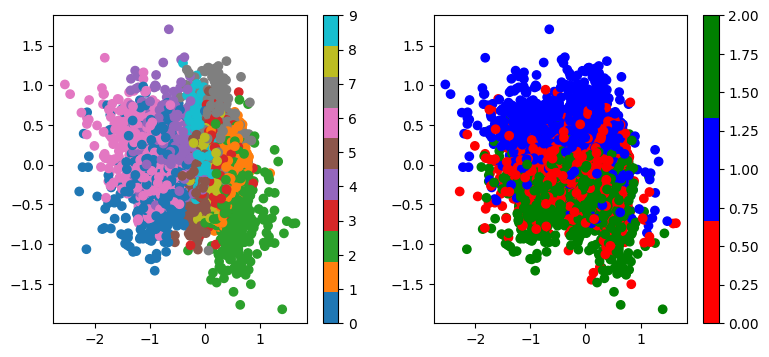

In [76]:
from matplotlib import colors

plt.figure(figsize=(9, 4))

plt.subplot(1, 2, 1)
plt.scatter(encoded_samples['Enc. Variable 0'], encoded_samples['Enc. Variable 1'], c=encoded_samples.number_label, cmap='tab10')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.scatter(encoded_samples['Enc. Variable 0'], encoded_samples['Enc. Variable 1'], c=encoded_samples.color_label, cmap=colors.ListedColormap(['red', 'blue', 'green']))
plt.colorbar()
plt.title('')
plt.show()

In [68]:
pca = PCA(n_components=2)
components = pca.fit_transform(encoded_samples.drop(['number_label', 'color_label', 'distinct_label'],axis=1))
total_var = pca.explained_variance_ratio_.sum() * 100
print(total_var)

68.30353736877441


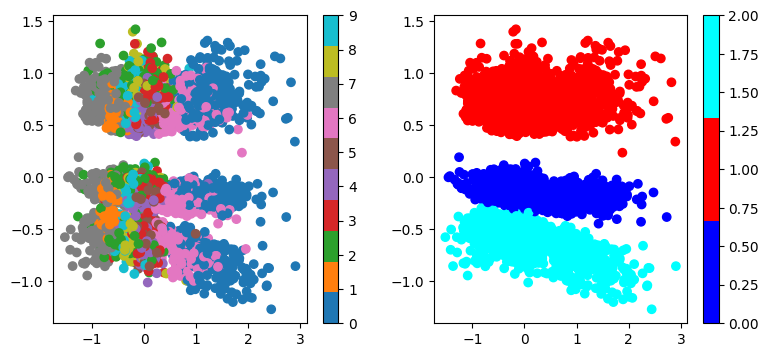

In [69]:
plt.figure(figsize=(9, 4))

plt.subplot(1, 2, 1)
plt.scatter(components[:,0], components[:,1], c=encoded_samples.number_label, cmap='tab10')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.scatter(components[:,0], components[:,1], c=encoded_samples.color_label, cmap=colors.ListedColormap(['blue', 'red', 'cyan']))
plt.colorbar()
plt.show()

In [27]:
class LogisticClassifier(nn.Module):
    def __init__(self, input_features, classes, lr=0.001):
        super().__init__()
        self.linear = nn.Linear(input_features, classes).to(device)

        self.optimizer = torch.optim.AdamW(self.linear.parameters(), lr=lr)
        self.loss_fn = torch.nn.CrossEntropyLoss()
    
    def forward(self, x):
        x = self.linear(x)
        return x

    def acc(self, y_pred, target):
        return torch.mean(torch.eq(y_pred, target).float()).item()

    def fit(self, dataloader, val_dataloader=None, encoder=None, label='number', epochs=50, evaluate_every=1):
        all_losses = []
        val_losses = []
        pbar = tqdm(range(int(epochs)), desc='Training Epochs')
        val_loss = np.nan
        val_acc = np.nan
        for i in pbar:
            for image_batch, labels in dataloader:
                image_batch = image_batch.to(device)
                if encoder is not None: 
                    image_batch = encoder(image_batch)
                    
                labels = labels[label]
                labels = labels.to(device)
                
                self.optimizer.zero_grad()
                y_pred = self.forward(image_batch)
                loss = self.loss_fn(y_pred, labels)
                loss.backward()
                self.optimizer.step()
                all_losses.append(loss.item())
                pbar.set_postfix(loss=loss.item(), val_loss=val_loss, val_acc=val_acc)
            if i % evaluate_every == 0 and val_dataloader is not None:
                acc_batches = []
                loss_batches = []
                for image_batch, labels in val_dataloader:
                    image_batch = image_batch.to(device)
                    if encoder is not None: 
                        image_batch = encoder(image_batch)

                    labels = labels[label]
                    labels = labels.to(device)
                    with torch.no_grad():
                        y_pred = self.forward(image_batch)
                        val_loss = self.loss_fn(y_pred, labels)
                        val_acc = self.acc(y_pred.argmax(dim=1), labels)
                    loss_batches.append(val_loss.item())
                    acc_batches.append(val_acc)
                val_loss = np.mean(loss_batches)
                val_acc = np.mean(acc_batches)
                
                val_losses.append(val_loss)
                pbar.set_postfix(loss=loss.item(), val_loss=val_loss, val_acc=val_acc)
                pbar.refresh(0.01)
        return all_losses, val_losses, val_acc

# WTMT Implementation


In [28]:
class CounterFactual:
    def __init__(self, classifier, device):
        self.classifier = classifier
        for param in self.classifier.parameters():
            param.requires_grad = False
        self.device = device
        
        self.prev = 1e9

        self.progress_patience = 0
        self.threshold_patience = 0
        self.patience = 50

        # I selected, 1e-2; saw the original paper used a higher value.
        self.loss_tolerance = 0.05

    def compute_counterfactual(self, latent_vector_batch, new_label_index_batch, max_steps=10_000):

        self.x_nudge = latent_vector_batch.clone().to(device)
        self.x_nudge.requires_grad_(True)

        self.optimizer = torch.optim.AdamW([self.x_nudge], lr=1e-3, eps=1e-4)
        self.target = new_label_index_batch.to(device)
        self.target.requires_grad_(False)

        prog_bar = trange(max_steps, desc=f'Epoch 0')

        for i in prog_bar:
            batch_at_step, done, loss_across_max, accuracy, gradnorm = self.step()
            prog_bar.set_postfix(loss_across_max=loss_across_max)
            prog_bar.set_description(f'Epoch {i}')

            if done:
                return self.x_nudge, "converged"

        return self.x_nudge, "timed-out"

    def step(self):
        
        self.optimizer.zero_grad()
        logits = self.classifier(self.x_nudge)
        
        loss_across = torch.nn.functional.cross_entropy(
            logits, self.target, reduction="none"
        )
        
        loss = loss_across.sum()
        loss.backward()
        
        accuracy = (logits.argmax(1) == self.target).float().mean().item()
        gradnorm = self.x_nudge.grad.detach().pow(2).sum().sqrt().cpu().item()
        
        self.optimizer.step()
        
        loss_across_max = loss_across.max().cpu().item()
        
        if loss_across_max >= self.prev:
            self.progress_patience += 1
        else:
            self.progress_patience = 0

        if (loss_across_max < self.loss_tolerance) or (self.progress_patience >= self.patience):
            done = True
        else:
            done = False

        self.prev = loss_across_max

        if np.isnan(loss_across_max):
            raise Exception("Loss is nan bruv.")

        return self.x_nudge.clone().detach(), done, loss_across_max, accuracy, gradnorm

In [29]:
lc_col = LogisticClassifier(d, 3, lr=0.001)
losses_col, val_losses_col, val_acc_col =lc_col.fit(train_loader, valid_loader, encoder, label='color', epochs=10)

Training Epochs: 100%|██████████████████████████████████████████████████████████████████████| 10/10 [00:40<00:00,  4.06s/it, loss=0.167, val_acc=1, val_loss=0.153]


In [30]:
lc_num = LogisticClassifier(d, 10, lr=0.001)
losses_num, val_losses_num, val_acc_num =lc_num.fit(train_loader, valid_loader, encoder, label='number', epochs=10)

Training Epochs: 100%|██████████████████████████████████████████████████████████████████| 10/10 [00:40<00:00,  4.03s/it, loss=0.788, val_acc=0.855, val_loss=0.826]


Current Label: 1
New Label: 2


Epoch 1777:  18%|███████████████▎                                                                      | 1777/10000 [00:05<00:25, 319.25it/s, loss_across_max=0.05]


Predicted New Label: 2


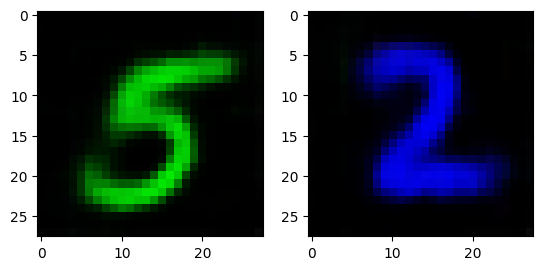

In [31]:
im = torch.tensor(dataset[0][0]).unsqueeze(0)
enc_im = encoder(im.to(device))
im_col = torch.tensor(2).unsqueeze(0)

curr_label = dataset[0][1]['color']
print(f'Current Label: {curr_label}')
print(f'New Label: 2')

cf_generator = CounterFactual(lc_col, device)
cf, how_fin = cf_generator.compute_counterfactual(enc_im.clone().detach(), im_col)

print(f'Predicted New Label: {torch.argmax(lc_col(cf), dim=1).item()}')

plt.subplot(1, 2, 1)
img = decoder(enc_im)
plt.imshow(img.detach().cpu().numpy().squeeze(0).transpose(2, 1, 0))

plt.subplot(1, 2, 2)
img = decoder(cf)
plt.imshow(img.detach().cpu().numpy().squeeze(0).transpose(2, 1, 0))

In [48]:
latent_data = []
latent_data_wtmt = []

labels_data = []
labels_data_wtmt = []

for batch, labels in tqdm(train_loader):
    enc_im = encoder(batch.to(device))
    new_im_col = torch.tensor(2).repeat(enc_im.shape[0])
    cf, how_fin = cf_generator.compute_counterfactual(enc_im.clone().detach(), new_im_col)
    
    latent_data.append(enc_im)
    latent_data_wtmt.append(cf)
    
    labels_data.append(labels)
    labels_data_wtmt.append(new_im_col)
    

Epoch 22:   0%|▏                                                                                         | 22/10000 [00:00<00:45, 218.63it/s, loss_across_max=21.2]


Epoch 46:   0%|▏                                                                                         | 22/10000 [00:00<00:45, 218.63it/s, loss_across_max=20.4]


Epoch 70:   0%|▍                                                                                         | 50/10000 [00:00<00:39, 254.00it/s, loss_across_max=19.7]


Epoch 94:   1%|▋                                                                                           | 76/10000 [00:00<00:40, 242.75it/s, loss_across_max=19]


Epoch 118:   1%|▉                                                                                       | 101/10000 [00:00<00:48, 203.79it/s, loss_across_max=18.3]


Epoch 933:   9%|███████▉                                                                               | 916/10000 [00:05<00:46, 197.42it/s, loss_across_max=0.658]


Epoch 957:   9%|████████▏                                                                              | 938/10000 [00:05<00:53, 168.25it/s, loss_across_max=0.587]


Epoch 980:  10%|████████▌                                                                              | 980/10000 [00:05<00:58, 155.33it/s, loss_across_max=0.526]


Epoch 1004:  10%|████████▌                                                                            | 1004/10000 [00:05<00:51, 174.38it/s, loss_across_max=0.473]


Epoch 1028:  10%|████████▋                                                                            | 1027/10000 [00:05<00:57, 156.47it/s, loss_across_max=0.427]


Epoch 1052:  11%|████████▉                                                                            | 1051/10000 [00:05<00:51, 174.70it/s, loss_across_max=0.388]


Epoch 1076:  11%|█████████                                                                            | 1072/10000 [00:06<00:48, 182.88it/s, loss_across_max=0.354]


Epoch 1100:  11%|█████████▎                                                                           | 1092/10000 [00:06<00:56, 156.56it/s, loss_across_max=0.324]


Epoch 1124:  11%|█████████▍                                                                           | 1115/10000 [00:06<00:51, 173.46it/s, loss_across_max=0.298]


Epoch 1148:  11%|█████████▋                                                                           | 1135/10000 [00:06<00:58, 150.53it/s, loss_across_max=0.275]


Epoch 1172:  12%|█████████▉                                                                           | 1162/10000 [00:06<00:50, 173.54it/s, loss_across_max=0.254]


Epoch 1196:  12%|██████████                                                                           | 1187/10000 [00:06<00:46, 191.49it/s, loss_across_max=0.236]


Epoch 1220:  12%|██████████▍                                                                           | 1208/10000 [00:06<00:54, 162.80it/s, loss_across_max=0.22]


Epoch 1244:  12%|██████████▍                                                                          | 1231/10000 [00:07<00:49, 175.71it/s, loss_across_max=0.206]


Epoch 1268:  13%|██████████▋                                                                          | 1251/10000 [00:07<00:55, 158.16it/s, loss_across_max=0.193]


Epoch 1292:  13%|██████████▊                                                                          | 1275/10000 [00:07<00:49, 176.40it/s, loss_across_max=0.181]


Epoch 1316:  13%|███████████▏                                                                          | 1298/10000 [00:07<00:57, 151.68it/s, loss_across_max=0.17]


Epoch 1340:  13%|███████████▎                                                                         | 1324/10000 [00:07<00:49, 175.58it/s, loss_across_max=0.161]


Epoch 1364:  13%|███████████▍                                                                         | 1349/10000 [00:07<00:46, 187.03it/s, loss_across_max=0.152]


Epoch 1388:  14%|███████████▋                                                                         | 1370/10000 [00:07<00:53, 160.51it/s, loss_across_max=0.144]


Epoch 1412:  14%|███████████▊                                                                         | 1395/10000 [00:08<00:47, 180.02it/s, loss_across_max=0.136]


Epoch 1436:  14%|████████████                                                                         | 1415/10000 [00:08<00:55, 155.73it/s, loss_across_max=0.129]


Epoch 1460:  14%|████████████▏                                                                        | 1439/10000 [00:08<00:48, 174.72it/s, loss_across_max=0.123]


Epoch 1484:  15%|████████████▍                                                                        | 1462/10000 [00:08<00:55, 153.87it/s, loss_across_max=0.117]


Epoch 1508:  15%|████████████▊                                                                        | 1509/10000 [00:08<00:45, 186.25it/s, loss_across_max=0.112]


Epoch 1532:  15%|█████████████                                                                        | 1530/10000 [00:08<00:52, 160.77it/s, loss_across_max=0.107]


Epoch 1556:  16%|█████████████▏                                                                       | 1554/10000 [00:08<00:48, 175.18it/s, loss_across_max=0.103]


Epoch 1580:  16%|█████████████▏                                                                      | 1573/10000 [00:09<00:55, 151.90it/s, loss_across_max=0.0982]


Epoch 1604:  16%|█████████████▍                                                                      | 1600/10000 [00:09<00:47, 175.05it/s, loss_across_max=0.0941]


Epoch 1628:  16%|█████████████▋                                                                      | 1624/10000 [00:09<00:43, 190.51it/s, loss_across_max=0.0903]


Epoch 1652:  16%|█████████████▊                                                                      | 1645/10000 [00:09<00:51, 161.05it/s, loss_across_max=0.0867]


Epoch 1676:  17%|██████████████                                                                      | 1669/10000 [00:09<00:46, 179.32it/s, loss_across_max=0.0834]


Epoch 1700:  17%|██████████████▏                                                                     | 1689/10000 [00:09<00:54, 153.43it/s, loss_across_max=0.0802]


Epoch 1724:  17%|██████████████▎                                                                     | 1711/10000 [00:09<00:49, 168.32it/s, loss_across_max=0.0773]


Epoch 1748:  17%|██████████████▌                                                                     | 1733/10000 [00:10<00:54, 152.68it/s, loss_across_max=0.0745]


Epoch 1772:  18%|██████████████▊                                                                     | 1756/10000 [00:10<00:48, 169.75it/s, loss_across_max=0.0718]


Epoch 1796:  18%|██████████████▉                                                                     | 1779/10000 [00:10<00:44, 184.37it/s, loss_across_max=0.0693]


Epoch 1819:  18%|███████████████▍                                                                     | 1820/10000 [00:10<00:47, 172.89it/s, loss_across_max=0.067]


Epoch 1843:  18%|███████████████▍                                                                    | 1842/10000 [00:10<00:51, 157.00it/s, loss_across_max=0.0647]


Epoch 1867:  19%|███████████████▋                                                                    | 1865/10000 [00:10<00:46, 173.92it/s, loss_across_max=0.0626]


Epoch 1891:  19%|███████████████▊                                                                    | 1889/10000 [00:10<00:42, 190.13it/s, loss_across_max=0.0606]


Epoch 1915:  19%|████████████████                                                                    | 1910/10000 [00:11<00:50, 161.58it/s, loss_across_max=0.0587]


Epoch 1939:  19%|████████████████▏                                                                   | 1934/10000 [00:11<00:44, 179.67it/s, loss_across_max=0.0568]


Epoch 1963:  20%|████████████████▍                                                                   | 1954/10000 [00:11<00:52, 153.23it/s, loss_across_max=0.0551]


Epoch 1987:  20%|████████████████▌                                                                   | 1978/10000 [00:11<00:46, 173.09it/s, loss_across_max=0.0534]


Epoch 2011:  20%|████████████████▊                                                                   | 2002/10000 [00:11<00:42, 189.14it/s, loss_across_max=0.0518]


Epoch 2035:  20%|████████████████▉                                                                   | 2023/10000 [00:11<00:49, 160.76it/s, loss_across_max=0.0503]


Epoch 15:   0%|▏                                                                                         | 16/10000 [00:00<01:32, 107.36it/s, loss_across_max=17.4]


Epoch 39:   0%|▎                                                                                         | 39/10000 [00:00<00:59, 166.21it/s, loss_across_max=16.6]


Epoch 64:   0%|▎                                                                                         | 39/10000 [00:00<00:59, 166.21it/s, loss_across_max=15.9]


Epoch 87:   1%|▊                                                                                         | 87/10000 [00:00<01:02, 159.55it/s, loss_across_max=15.2]


Epoch 111:   1%|▉                                                                                       | 111/10000 [00:00<00:54, 182.48it/s, loss_across_max=14.5]


Epoch 135:   1%|█▏                                                                                      | 131/10000 [00:00<01:04, 152.59it/s, loss_across_max=13.8]


Epoch 159:   2%|█▎                                                                                      | 154/10000 [00:00<00:57, 171.23it/s, loss_across_max=13.1]


Epoch 183:   2%|█▌                                                                                      | 178/10000 [00:01<00:51, 189.29it/s, loss_across_max=12.4]


Epoch 207:   2%|█▊                                                                                      | 199/10000 [00:01<01:01, 159.97it/s, loss_across_max=11.7]


Epoch 231:   2%|██                                                                                        | 224/10000 [00:01<00:54, 180.77it/s, loss_across_max=11]


Epoch 255:   2%|██▏                                                                                     | 244/10000 [00:01<01:03, 153.99it/s, loss_across_max=10.4]


Epoch 279:   3%|██▎                                                                                     | 268/10000 [00:01<00:57, 170.49it/s, loss_across_max=9.68]


Epoch 303:   3%|██▌                                                                                     | 287/10000 [00:01<01:05, 148.27it/s, loss_across_max=9.03]


Epoch 327:   3%|██▊                                                                                     | 314/10000 [00:01<00:56, 171.54it/s, loss_across_max=8.39]


Epoch 351:   3%|██▉                                                                                     | 340/10000 [00:02<00:50, 189.60it/s, loss_across_max=7.78]


Epoch 375:   4%|███▏                                                                                    | 361/10000 [00:02<00:58, 164.78it/s, loss_across_max=7.19]


Epoch 399:   4%|███▍                                                                                    | 386/10000 [00:02<00:53, 179.45it/s, loss_across_max=6.66]


Epoch 423:   4%|███▌                                                                                    | 406/10000 [00:02<01:00, 158.11it/s, loss_across_max=6.17]


Epoch 447:   4%|███▊                                                                                     | 428/10000 [00:02<00:55, 172.30it/s, loss_across_max=5.7]


Epoch 471:   5%|███▉                                                                                    | 451/10000 [00:02<01:02, 152.95it/s, loss_across_max=5.27]


Epoch 495:   5%|████▏                                                                                   | 474/10000 [00:02<00:57, 166.98it/s, loss_across_max=4.86]


Epoch 519:   5%|████▍                                                                                   | 501/10000 [00:03<00:50, 187.95it/s, loss_across_max=4.48]


Epoch 543:   5%|████▌                                                                                   | 522/10000 [00:03<00:58, 162.97it/s, loss_across_max=4.12]


Epoch 567:   6%|█████                                                                                    | 567/10000 [00:03<01:00, 156.45it/s, loss_across_max=3.8]


Epoch 591:   6%|█████▏                                                                                  | 592/10000 [00:03<00:54, 172.85it/s, loss_across_max=3.48]


Epoch 615:   6%|█████▍                                                                                  | 614/10000 [00:03<01:00, 153.91it/s, loss_across_max=3.17]


Epoch 639:   6%|█████▌                                                                                  | 637/10000 [00:03<00:54, 170.62it/s, loss_across_max=2.88]


Epoch 663:   7%|█████▊                                                                                  | 663/10000 [00:03<00:49, 189.23it/s, loss_across_max=2.61]


Epoch 687:   7%|██████                                                                                  | 684/10000 [00:04<00:58, 160.19it/s, loss_across_max=2.35]


Epoch 711:   7%|██████▎                                                                                  | 708/10000 [00:04<00:52, 178.26it/s, loss_across_max=2.1]


Epoch 735:   7%|██████▍                                                                                 | 728/10000 [00:04<00:59, 155.36it/s, loss_across_max=1.88]


Epoch 759:   8%|██████▋                                                                                 | 753/10000 [00:04<00:53, 173.52it/s, loss_across_max=1.67]


Epoch 783:   8%|██████▊                                                                                 | 777/10000 [00:04<00:58, 157.28it/s, loss_across_max=1.47]


Epoch 807:   8%|███████▏                                                                                 | 801/10000 [00:04<00:52, 175.18it/s, loss_across_max=1.3]


Epoch 831:   8%|███████▎                                                                                | 825/10000 [00:04<00:48, 189.95it/s, loss_across_max=1.15]


Epoch 855:   8%|███████▍                                                                                | 846/10000 [00:05<00:56, 161.39it/s, loss_across_max=1.01]


Epoch 879:   9%|███████▋                                                                                | 870/10000 [00:05<00:51, 178.73it/s, loss_across_max=0.89]


Epoch 903:   9%|███████▋                                                                               | 890/10000 [00:05<01:00, 150.58it/s, loss_across_max=0.786]


Epoch 927:   9%|███████▉                                                                               | 914/10000 [00:05<00:53, 170.43it/s, loss_across_max=0.697]


Epoch 951:   9%|████████▎                                                                               | 939/10000 [00:05<00:47, 188.84it/s, loss_across_max=0.62]


Epoch 975:  10%|████████▎                                                                              | 960/10000 [00:05<00:56, 160.16it/s, loss_across_max=0.554]


Epoch 999:  10%|████████▌                                                                              | 985/10000 [00:05<00:50, 179.95it/s, loss_across_max=0.497]


Epoch 1023:  10%|████████▌                                                                            | 1005/10000 [00:06<00:58, 155.01it/s, loss_across_max=0.448]


Epoch 1047:  10%|████████▋                                                                            | 1027/10000 [00:06<00:53, 168.11it/s, loss_across_max=0.406]


Epoch 1071:  10%|████████▉                                                                            | 1049/10000 [00:06<00:59, 151.42it/s, loss_across_max=0.369]


Epoch 1095:  11%|█████████                                                                            | 1073/10000 [00:06<00:52, 171.43it/s, loss_across_max=0.338]


Epoch 1662:  17%|█████████████▉                                                                      | 1652/10000 [00:09<00:45, 182.55it/s, loss_across_max=0.0997]


Epoch 1686:  17%|██████████████                                                                      | 1672/10000 [00:09<00:54, 153.88it/s, loss_across_max=0.0956]


Epoch 1710:  17%|██████████████▏                                                                     | 1696/10000 [00:09<00:47, 173.16it/s, loss_across_max=0.0917]


Epoch 1734:  17%|██████████████▍                                                                     | 1720/10000 [00:10<00:52, 157.14it/s, loss_across_max=0.0881]


Epoch 1758:  17%|██████████████▋                                                                     | 1744/10000 [00:10<00:48, 171.37it/s, loss_across_max=0.0847]


Epoch 1782:  18%|██████████████▊                                                                     | 1769/10000 [00:10<00:43, 189.08it/s, loss_across_max=0.0815]


Epoch 1806:  18%|███████████████                                                                     | 1790/10000 [00:10<00:50, 161.51it/s, loss_across_max=0.0785]


Epoch 1830:  18%|███████████████▏                                                                    | 1814/10000 [00:10<00:45, 179.11it/s, loss_across_max=0.0757]


Epoch 1854:  18%|███████████████▌                                                                     | 1834/10000 [00:10<00:53, 153.34it/s, loss_across_max=0.073]


Epoch 1878:  19%|███████████████▌                                                                    | 1859/10000 [00:10<00:46, 175.00it/s, loss_across_max=0.0705]


Epoch 1902:  19%|███████████████▊                                                                    | 1883/10000 [00:11<00:52, 154.63it/s, loss_across_max=0.0681]


Epoch 1926:  19%|████████████████                                                                    | 1908/10000 [00:11<00:46, 173.51it/s, loss_across_max=0.0658]


Epoch 1950:  19%|████████████████▏                                                                   | 1933/10000 [00:11<00:42, 189.10it/s, loss_across_max=0.0636]


Epoch 1974:  20%|████████████████▍                                                                   | 1954/10000 [00:11<00:49, 161.21it/s, loss_across_max=0.0616]


Epoch 1998:  20%|████████████████▊                                                                   | 1998/10000 [00:11<00:50, 158.44it/s, loss_across_max=0.0597]


Epoch 2022:  20%|████████████████▉                                                                   | 2021/10000 [00:11<00:45, 174.64it/s, loss_across_max=0.0579]


Epoch 2046:  20%|█████████████████▏                                                                  | 2046/10000 [00:11<00:51, 155.57it/s, loss_across_max=0.0561]


Epoch 2070:  21%|█████████████████▍                                                                  | 2070/10000 [00:12<00:46, 168.97it/s, loss_across_max=0.0544]


Epoch 2094:  21%|█████████████████▌                                                                  | 2094/10000 [00:12<00:42, 185.38it/s, loss_across_max=0.0528]


Epoch 2118:  21%|█████████████████▊                                                                  | 2114/10000 [00:12<00:49, 160.89it/s, loss_across_max=0.0513]


Epoch 1:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=17.1]


Epoch 3:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=17.1]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 221:   2%|█▊                                                                                      | 201/10000 [00:01<00:56, 174.27it/s, loss_across_max=10.8]


Epoch 245:   2%|██▏                                                                                     | 245/10000 [00:01<00:59, 162.65it/s, loss_across_max=10.1]


Epoch 269:   3%|██▍                                                                                     | 270/10000 [00:01<00:53, 182.44it/s, loss_across_max=9.51]


Epoch 293:   3%|██▌                                                                                     | 290/10000 [00:01<01:02, 154.67it/s, loss_across_max=8.91]


Epoch 317:   3%|██▊                                                                                     | 315/10000 [00:01<00:55, 175.82it/s, loss_across_max=8.33]


Epoch 341:   3%|██▉                                                                                     | 340/10000 [00:02<01:01, 157.33it/s, loss_across_max=7.78]


Epoch 365:   4%|███▏                                                                                    | 363/10000 [00:02<00:57, 168.64it/s, loss_across_max=7.26]


Epoch 389:   4%|███▏                                                                                    | 363/10000 [00:02<00:57, 168.64it/s, loss_across_max=6.76]


Epoch 413:   4%|███▋                                                                                    | 412/10000 [00:02<00:59, 160.76it/s, loss_across_max=6.32]


Epoch 437:   4%|███▊                                                                                    | 438/10000 [00:02<00:52, 182.37it/s, loss_across_max=5.89]


Epoch 461:   5%|████                                                                                    | 459/10000 [00:02<01:00, 157.44it/s, loss_across_max=5.49]


Epoch 485:   5%|████▎                                                                                   | 484/10000 [00:02<00:53, 177.47it/s, loss_across_max=5.11]


Epoch 509:   5%|████▍                                                                                   | 504/10000 [00:03<01:02, 152.84it/s, loss_across_max=4.76]


Epoch 533:   5%|████▋                                                                                   | 528/10000 [00:03<00:56, 169.04it/s, loss_across_max=4.42]


Epoch 557:   6%|████▉                                                                                   | 556/10000 [00:03<00:48, 194.67it/s, loss_across_max=4.09]


Epoch 581:   6%|█████                                                                                   | 578/10000 [00:03<00:57, 164.23it/s, loss_across_max=3.78]


Epoch 605:   6%|█████▎                                                                                  | 602/10000 [00:03<00:53, 176.34it/s, loss_across_max=3.48]


Epoch 629:   6%|█████▍                                                                                  | 622/10000 [00:03<00:59, 156.35it/s, loss_across_max=3.19]


Epoch 653:   6%|█████▋                                                                                  | 645/10000 [00:03<00:54, 172.82it/s, loss_across_max=2.91]


Epoch 677:   7%|█████▊                                                                                  | 666/10000 [00:04<01:02, 149.65it/s, loss_across_max=2.64]


Epoch 689:   7%|██████▏                                                                                  | 689/10000 [00:04<00:55, 166.57it/s, loss_across_max=2.5]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 874:   9%|███████▌                                                                               | 872/10000 [00:05<00:50, 179.85it/s, loss_across_max=0.996]


Epoch 898:   9%|███████▊                                                                               | 892/10000 [00:05<00:58, 156.45it/s, loss_across_max=0.876]


Epoch 922:   9%|███████▉                                                                               | 913/10000 [00:05<00:54, 168.09it/s, loss_across_max=0.772]


Epoch 946:   9%|████████▏                                                                              | 938/10000 [00:05<00:59, 151.66it/s, loss_across_max=0.683]


Epoch 970:  10%|████████▎                                                                              | 962/10000 [00:05<00:53, 170.30it/s, loss_across_max=0.606]


Epoch 994:  10%|████████▌                                                                              | 987/10000 [00:05<00:47, 188.38it/s, loss_across_max=0.541]


Epoch 1018:  10%|████████▌                                                                            | 1008/10000 [00:06<00:55, 161.18it/s, loss_across_max=0.484]


Epoch 1042:  10%|████████▊                                                                            | 1031/10000 [00:06<00:50, 176.86it/s, loss_across_max=0.436]


Epoch 1066:  11%|████████▉                                                                            | 1051/10000 [00:06<00:58, 153.58it/s, loss_across_max=0.394]


Epoch 1090:  11%|█████████▏                                                                           | 1076/10000 [00:06<00:51, 174.87it/s, loss_across_max=0.358]


Epoch 1114:  11%|█████████▎                                                                           | 1100/10000 [00:06<00:46, 190.17it/s, loss_across_max=0.327]


Epoch 1138:  11%|█████████▊                                                                             | 1121/10000 [00:06<00:54, 161.78it/s, loss_across_max=0.3]


Epoch 1162:  11%|█████████▋                                                                           | 1144/10000 [00:06<00:49, 177.63it/s, loss_across_max=0.276]


Epoch 1186:  12%|█████████▉                                                                           | 1164/10000 [00:07<00:57, 153.70it/s, loss_across_max=0.255]


Epoch 1209:  12%|██████████▎                                                                          | 1210/10000 [00:07<00:58, 151.10it/s, loss_across_max=0.236]


Epoch 1234:  12%|██████████▍                                                                           | 1210/10000 [00:07<00:58, 151.10it/s, loss_across_max=0.22]


Epoch 1258:  12%|██████████▍                                                                          | 1235/10000 [00:07<00:50, 173.25it/s, loss_across_max=0.205]


Epoch 1281:  13%|██████████▉                                                                          | 1281/10000 [00:07<00:54, 160.29it/s, loss_across_max=0.192]


Epoch 1305:  13%|███████████▏                                                                          | 1305/10000 [00:07<00:48, 178.36it/s, loss_across_max=0.18]


Epoch 1329:  13%|███████████▎                                                                         | 1325/10000 [00:07<00:56, 154.31it/s, loss_across_max=0.169]


Epoch 1353:  13%|███████████▍                                                                         | 1348/10000 [00:08<00:50, 171.32it/s, loss_across_max=0.159]


Epoch 1377:  14%|███████████▊                                                                          | 1372/10000 [00:08<00:46, 187.07it/s, loss_across_max=0.15]


Epoch 1401:  14%|███████████▊                                                                         | 1393/10000 [00:08<00:54, 158.83it/s, loss_across_max=0.142]


Epoch 1425:  14%|████████████                                                                         | 1417/10000 [00:08<00:48, 176.86it/s, loss_across_max=0.135]


Epoch 1449:  14%|████████████▏                                                                        | 1437/10000 [00:08<00:55, 154.45it/s, loss_across_max=0.128]


Epoch 1473:  15%|████████████▍                                                                        | 1461/10000 [00:08<00:49, 173.97it/s, loss_across_max=0.121]


Epoch 1497:  15%|████████████▌                                                                        | 1482/10000 [00:08<00:55, 153.40it/s, loss_across_max=0.116]


Epoch 1521:  15%|████████████▉                                                                         | 1504/10000 [00:09<00:50, 167.03it/s, loss_across_max=0.11]


Epoch 1545:  15%|█████████████                                                                        | 1531/10000 [00:09<00:45, 187.19it/s, loss_across_max=0.105]


Epoch 1569:  16%|█████████████▏                                                                       | 1551/10000 [00:09<00:52, 161.77it/s, loss_across_max=0.101]


Epoch 1593:  16%|█████████████▍                                                                      | 1594/10000 [00:09<00:53, 155.71it/s, loss_across_max=0.0965]


Epoch 1617:  16%|█████████████▌                                                                      | 1615/10000 [00:09<00:49, 167.72it/s, loss_across_max=0.0924]


Epoch 1641:  16%|█████████████▊                                                                      | 1641/10000 [00:09<00:44, 189.98it/s, loss_across_max=0.0887]


Epoch 1665:  17%|█████████████▉                                                                      | 1662/10000 [00:09<00:51, 161.68it/s, loss_across_max=0.0851]


Epoch 1670:  17%|█████████████▉                                                                      | 1662/10000 [00:09<00:51, 161.68it/s, loss_across_max=0.0844]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1869:  19%|███████████████▋                                                                    | 1866/10000 [00:11<00:52, 154.98it/s, loss_across_max=0.0622]


Epoch 1893:  19%|███████████████▊                                                                    | 1889/10000 [00:11<00:47, 171.66it/s, loss_across_max=0.0601]


Epoch 1917:  19%|████████████████                                                                    | 1914/10000 [00:11<00:42, 189.11it/s, loss_across_max=0.0582]


Epoch 1941:  19%|████████████████▎                                                                   | 1935/10000 [00:11<00:49, 162.92it/s, loss_across_max=0.0564]


Epoch 1965:  20%|████████████████▍                                                                   | 1960/10000 [00:11<00:45, 177.21it/s, loss_across_max=0.0546]


Epoch 1989:  20%|████████████████▌                                                                   | 1979/10000 [00:11<00:52, 153.97it/s, loss_across_max=0.0529]


Epoch 2013:  20%|████████████████▊                                                                   | 2005/10000 [00:11<00:44, 178.32it/s, loss_across_max=0.0513]


Epoch 0:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=16.9]


Epoch 24:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=16.2]


Epoch 48:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 245.73it/s, loss_across_max=15.5]


Epoch 72:   0%|▍                                                                                         | 50/10000 [00:00<01:03, 157.65it/s, loss_across_max=14.8]


Epoch 95:   1%|▊                                                                                         | 96/10000 [00:00<01:03, 155.76it/s, loss_across_max=14.1]


Epoch 119:   1%|█                                                                                       | 119/10000 [00:00<00:56, 175.38it/s, loss_across_max=13.4]


Epoch 143:   1%|█▎                                                                                      | 143/10000 [00:00<00:51, 192.82it/s, loss_across_max=12.7]


Epoch 167:   2%|█▍                                                                                        | 164/10000 [00:00<01:01, 160.63it/s, loss_across_max=12]


Epoch 191:   2%|█▋                                                                                      | 189/10000 [00:01<00:54, 181.48it/s, loss_across_max=11.3]


Epoch 215:   2%|█▊                                                                                      | 209/10000 [00:01<01:02, 157.25it/s, loss_across_max=10.6]


Epoch 239:   2%|██                                                                                      | 232/10000 [00:01<00:56, 173.68it/s, loss_across_max=9.98]


Epoch 263:   3%|██▏                                                                                     | 255/10000 [00:01<00:51, 187.64it/s, loss_across_max=9.32]


Epoch 287:   3%|██▍                                                                                     | 276/10000 [00:01<00:59, 162.84it/s, loss_across_max=8.69]


Epoch 303:   3%|██▋                                                                                     | 300/10000 [00:01<00:53, 180.71it/s, loss_across_max=8.31]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 496:   5%|████▎                                                                                   | 484/10000 [00:02<01:01, 155.57it/s, loss_across_max=4.37]


Epoch 520:   5%|████▍                                                                                   | 508/10000 [00:03<00:54, 174.80it/s, loss_across_max=4.01]


Epoch 544:   5%|████▋                                                                                   | 531/10000 [00:03<01:01, 153.92it/s, loss_across_max=3.67]


Epoch 568:   6%|████▉                                                                                   | 555/10000 [00:03<00:54, 172.69it/s, loss_across_max=3.35]


Epoch 592:   6%|█████                                                                                   | 579/10000 [00:03<00:49, 188.47it/s, loss_across_max=3.04]


Epoch 616:   6%|█████▎                                                                                  | 600/10000 [00:03<00:58, 159.40it/s, loss_across_max=2.76]


Epoch 640:   6%|█████▍                                                                                  | 624/10000 [00:03<00:53, 175.76it/s, loss_across_max=2.48]


Epoch 664:   6%|█████▋                                                                                  | 644/10000 [00:03<00:59, 156.47it/s, loss_across_max=2.23]


Epoch 688:   7%|█████▊                                                                                  | 667/10000 [00:04<00:54, 172.83it/s, loss_across_max=1.99]


Epoch 711:   7%|██████▎                                                                                 | 712/10000 [00:04<00:57, 162.44it/s, loss_across_max=1.77]


Epoch 736:   7%|██████▎                                                                                 | 712/10000 [00:04<00:57, 162.44it/s, loss_across_max=1.57]


Epoch 759:   8%|██████▋                                                                                 | 757/10000 [00:04<00:59, 154.14it/s, loss_across_max=1.38]


Epoch 783:   8%|██████▊                                                                                 | 781/10000 [00:04<00:53, 171.20it/s, loss_across_max=1.22]


Epoch 807:   8%|███████                                                                                 | 803/10000 [00:04<00:59, 154.98it/s, loss_across_max=1.07]


Epoch 831:   8%|███████▏                                                                               | 826/10000 [00:04<00:53, 171.21it/s, loss_across_max=0.944]


Epoch 855:   9%|███████▍                                                                               | 851/10000 [00:04<00:48, 189.86it/s, loss_across_max=0.832]


Epoch 879:   9%|███████▌                                                                               | 872/10000 [00:05<00:57, 159.07it/s, loss_across_max=0.736]


Epoch 903:   9%|███████▊                                                                               | 899/10000 [00:05<00:50, 178.58it/s, loss_across_max=0.653]


Epoch 927:   9%|███████▉                                                                               | 919/10000 [00:05<00:57, 157.05it/s, loss_across_max=0.582]


Epoch 951:   9%|████████▏                                                                              | 942/10000 [00:05<00:52, 173.25it/s, loss_across_max=0.521]


Epoch 975:  10%|████████▍                                                                              | 966/10000 [00:05<00:58, 154.31it/s, loss_across_max=0.469]


Epoch 978:  10%|████████▍                                                                              | 966/10000 [00:05<00:58, 154.31it/s, loss_across_max=0.465]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1181:  12%|█████████▉                                                                           | 1174/10000 [00:06<00:49, 177.86it/s, loss_across_max=0.225]


Epoch 1205:  12%|██████████▎                                                                           | 1194/10000 [00:07<00:57, 153.43it/s, loss_across_max=0.21]


Epoch 1229:  12%|██████████▎                                                                          | 1219/10000 [00:07<00:50, 172.61it/s, loss_across_max=0.196]


Epoch 1253:  12%|██████████▌                                                                          | 1238/10000 [00:07<00:58, 150.48it/s, loss_across_max=0.184]


Epoch 1277:  13%|██████████▋                                                                          | 1263/10000 [00:07<00:50, 172.44it/s, loss_across_max=0.173]


Epoch 1301:  13%|██████████▉                                                                          | 1286/10000 [00:07<00:46, 186.07it/s, loss_across_max=0.163]


Epoch 1325:  13%|███████████                                                                          | 1307/10000 [00:07<00:53, 161.07it/s, loss_across_max=0.154]


Epoch 1349:  13%|███████████▎                                                                         | 1331/10000 [00:08<00:48, 179.31it/s, loss_across_max=0.146]


Epoch 1373:  14%|███████████▍                                                                         | 1351/10000 [00:08<00:57, 151.16it/s, loss_across_max=0.138]


Epoch 1397:  14%|███████████▋                                                                         | 1376/10000 [00:08<00:50, 171.78it/s, loss_across_max=0.131]


Epoch 1421:  14%|███████████▉                                                                         | 1401/10000 [00:08<00:55, 153.84it/s, loss_across_max=0.125]


Epoch 1445:  14%|████████████                                                                         | 1425/10000 [00:08<00:49, 172.29it/s, loss_across_max=0.119]


Epoch 1469:  14%|████████████▎                                                                        | 1449/10000 [00:08<00:45, 188.26it/s, loss_across_max=0.113]


Epoch 1493:  15%|████████████▍                                                                        | 1470/10000 [00:08<00:53, 158.91it/s, loss_across_max=0.108]


Epoch 1517:  15%|████████████▋                                                                        | 1498/10000 [00:08<00:46, 181.58it/s, loss_across_max=0.103]


Epoch 1541:  15%|████████████▊                                                                       | 1518/10000 [00:09<00:53, 157.79it/s, loss_across_max=0.0988]


Epoch 1564:  16%|█████████████▏                                                                      | 1564/10000 [00:09<00:54, 154.58it/s, loss_across_max=0.0947]


Epoch 1588:  16%|█████████████▎                                                                      | 1588/10000 [00:09<00:48, 173.41it/s, loss_across_max=0.0908]


Epoch 1613:  16%|█████████████▎                                                                      | 1588/10000 [00:09<00:48, 173.41it/s, loss_across_max=0.0872]


Epoch 1636:  16%|█████████████▋                                                                      | 1635/10000 [00:09<00:50, 165.22it/s, loss_across_max=0.0838]


Epoch 1650:  16%|█████████████▉                                                                       | 1635/10000 [00:09<00:50, 165.22it/s, loss_across_max=0.082]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1948:  19%|████████████████▏                                                                   | 1929/10000 [00:11<00:41, 193.11it/s, loss_across_max=0.0874]


Epoch 1972:  20%|████████████████▍                                                                   | 1950/10000 [00:11<00:48, 164.70it/s, loss_across_max=0.0841]


Epoch 1995:  20%|████████████████▊                                                                   | 1995/10000 [00:11<00:50, 157.44it/s, loss_across_max=0.0811]


Epoch 2019:  20%|████████████████▉                                                                   | 2020/10000 [00:11<00:44, 178.11it/s, loss_across_max=0.0782]


Epoch 2043:  20%|█████████████████▏                                                                  | 2043/10000 [00:11<00:51, 155.00it/s, loss_across_max=0.0755]


Epoch 2067:  21%|█████████████████▎                                                                  | 2068/10000 [00:11<00:45, 176.11it/s, loss_across_max=0.0729]


Epoch 2091:  21%|█████████████████▌                                                                  | 2091/10000 [00:11<00:42, 187.69it/s, loss_across_max=0.0705]


Epoch 2115:  21%|█████████████████▋                                                                  | 2112/10000 [00:12<00:48, 164.17it/s, loss_across_max=0.0682]


Epoch 2139:  21%|██████████████████▏                                                                  | 2137/10000 [00:12<00:43, 179.25it/s, loss_across_max=0.066]


Epoch 2163:  22%|██████████████████                                                                  | 2157/10000 [00:12<00:49, 158.02it/s, loss_across_max=0.0639]


Epoch 2187:  22%|██████████████████▎                                                                 | 2181/10000 [00:12<00:44, 176.67it/s, loss_across_max=0.0619]


Epoch 2211:  22%|██████████████████▉                                                                   | 2204/10000 [00:12<00:41, 189.34it/s, loss_across_max=0.06]


Epoch 2235:  22%|██████████████████▋                                                                 | 2225/10000 [00:12<00:47, 164.52it/s, loss_across_max=0.0582]


Epoch 2259:  22%|██████████████████▉                                                                 | 2249/10000 [00:12<00:42, 182.24it/s, loss_across_max=0.0565]


Epoch 2283:  23%|███████████████████                                                                 | 2269/10000 [00:12<00:49, 157.01it/s, loss_across_max=0.0549]


Epoch 2307:  23%|███████████████████▎                                                                | 2295/10000 [00:13<00:42, 180.06it/s, loss_across_max=0.0533]


Epoch 2331:  23%|███████████████████▍                                                                | 2315/10000 [00:13<00:50, 152.95it/s, loss_across_max=0.0518]


Epoch 2355:  23%|███████████████████▋                                                                | 2342/10000 [00:13<00:42, 179.26it/s, loss_across_max=0.0503]


Epoch 15:   0%|                                                                                            | 5/10000 [00:00<04:04, 40.89it/s, loss_across_max=18.8]


Epoch 39:   0%|▎                                                                                           | 31/10000 [00:00<01:06, 150.99it/s, loss_across_max=18]


Epoch 63:   1%|▌                                                                                         | 58/10000 [00:00<00:51, 192.55it/s, loss_across_max=17.3]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Epoch 274:   3%|██▎                                                                                     | 262/10000 [00:01<00:53, 181.54it/s, loss_across_max=11.2]


Epoch 298:   3%|██▍                                                                                     | 282/10000 [00:01<01:01, 158.36it/s, loss_across_max=10.6]


Epoch 322:   3%|██▋                                                                                     | 307/10000 [00:01<00:55, 174.98it/s, loss_across_max=9.92]


Epoch 346:   3%|██▉                                                                                     | 332/10000 [00:02<01:01, 157.07it/s, loss_across_max=9.31]


Epoch 370:   4%|███                                                                                     | 354/10000 [00:02<00:56, 170.85it/s, loss_across_max=8.71]


Epoch 394:   4%|███▎                                                                                    | 379/10000 [00:02<00:50, 189.68it/s, loss_across_max=8.15]


Epoch 418:   4%|███▌                                                                                    | 400/10000 [00:02<00:58, 164.90it/s, loss_across_max=7.61]


Epoch 442:   4%|███▊                                                                                     | 424/10000 [00:02<00:52, 182.24it/s, loss_across_max=7.1]


Epoch 466:   5%|████                                                                                    | 467/10000 [00:02<00:54, 174.49it/s, loss_across_max=6.65]


Epoch 490:   5%|████                                                                                    | 467/10000 [00:02<00:54, 174.49it/s, loss_across_max=6.19]


Epoch 514:   5%|████▌                                                                                   | 514/10000 [00:03<00:58, 161.65it/s, loss_across_max=5.79]


Epoch 538:   5%|████▊                                                                                    | 539/10000 [00:03<00:51, 181.96it/s, loss_across_max=5.4]


Epoch 562:   6%|████▉                                                                                   | 559/10000 [00:03<00:58, 160.37it/s, loss_across_max=5.03]


Epoch 586:   6%|█████▏                                                                                  | 583/10000 [00:03<00:53, 175.66it/s, loss_across_max=4.68]


Epoch 610:   6%|█████▎                                                                                  | 603/10000 [00:03<01:00, 155.64it/s, loss_across_max=4.35]


Epoch 634:   6%|█████▌                                                                                  | 626/10000 [00:03<00:54, 172.13it/s, loss_across_max=4.03]


Epoch 658:   7%|█████▋                                                                                  | 652/10000 [00:03<00:48, 192.71it/s, loss_across_max=3.72]


Epoch 682:   7%|█████▉                                                                                  | 673/10000 [00:04<00:57, 161.66it/s, loss_across_max=3.43]


Epoch 706:   7%|██████▏                                                                                 | 699/10000 [00:04<00:50, 184.46it/s, loss_across_max=3.15]


Epoch 730:   7%|██████▎                                                                                 | 720/10000 [00:04<00:59, 156.72it/s, loss_across_max=2.87]


Epoch 754:   7%|██████▌                                                                                 | 746/10000 [00:04<00:51, 179.35it/s, loss_across_max=2.61]


Epoch 778:   8%|██████▋                                                                                 | 767/10000 [00:04<00:59, 154.86it/s, loss_across_max=2.36]


Epoch 802:   8%|██████▉                                                                                 | 792/10000 [00:04<00:52, 176.00it/s, loss_across_max=2.12]


Epoch 826:   8%|███████▎                                                                                 | 817/10000 [00:04<00:47, 192.95it/s, loss_across_max=1.9]


Epoch 850:   8%|███████▍                                                                                | 839/10000 [00:05<00:55, 165.39it/s, loss_across_max=1.69]


Epoch 874:   9%|███████▋                                                                                 | 864/10000 [00:05<00:49, 184.97it/s, loss_across_max=1.5]


Epoch 898:   9%|███████▊                                                                                | 885/10000 [00:05<00:58, 156.47it/s, loss_across_max=1.32]


Epoch 922:   9%|███████▉                                                                                | 909/10000 [00:05<00:52, 174.61it/s, loss_across_max=1.17]


Epoch 946:   9%|████████▏                                                                               | 930/10000 [00:05<00:59, 152.60it/s, loss_across_max=1.03]


Epoch 970:  10%|████████▎                                                                              | 958/10000 [00:05<00:50, 180.29it/s, loss_across_max=0.905]


Epoch 994:  10%|████████▌                                                                              | 980/10000 [00:05<00:47, 188.60it/s, loss_across_max=0.799]


Epoch 1018:  10%|████████▌                                                                            | 1001/10000 [00:05<00:54, 164.79it/s, loss_across_max=0.708]


Epoch 1042:  10%|████████▋                                                                            | 1026/10000 [00:06<00:49, 180.55it/s, loss_across_max=0.629]


Epoch 1066:  10%|████████▉                                                                            | 1046/10000 [00:06<00:55, 160.20it/s, loss_across_max=0.561]


Epoch 1090:  11%|█████████                                                                            | 1070/10000 [00:06<00:51, 174.59it/s, loss_across_max=0.503]


Epoch 1114:  11%|█████████▎                                                                           | 1093/10000 [00:06<00:56, 158.19it/s, loss_across_max=0.453]


Epoch 1114:  11%|█████████▎                                                                           | 1093/10000 [00:06<00:56, 158.19it/s, loss_across_max=0.452]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1325:  13%|███████████                                                                          | 1306/10000 [00:07<00:45, 189.12it/s, loss_across_max=0.216]


Epoch 1349:  13%|███████████▎                                                                         | 1327/10000 [00:07<00:53, 162.76it/s, loss_across_max=0.202]


Epoch 1373:  14%|███████████▊                                                                          | 1373/10000 [00:08<00:53, 160.77it/s, loss_across_max=0.19]


Epoch 1397:  14%|███████████▊                                                                         | 1397/10000 [00:08<00:48, 178.56it/s, loss_across_max=0.178]


Epoch 1421:  14%|████████████                                                                         | 1419/10000 [00:08<00:54, 157.17it/s, loss_across_max=0.168]


Epoch 1445:  14%|████████████▎                                                                        | 1444/10000 [00:08<00:49, 172.71it/s, loss_across_max=0.158]


Epoch 1469:  15%|████████████▋                                                                         | 1470/10000 [00:08<00:44, 193.53it/s, loss_across_max=0.15]


Epoch 1493:  15%|████████████▋                                                                        | 1491/10000 [00:08<00:51, 164.05it/s, loss_across_max=0.142]


Epoch 1517:  15%|████████████▉                                                                        | 1515/10000 [00:08<00:46, 181.32it/s, loss_across_max=0.134]


Epoch 1541:  15%|█████████████                                                                        | 1535/10000 [00:09<00:53, 158.52it/s, loss_across_max=0.128]


Epoch 1565:  16%|█████████████▎                                                                       | 1559/10000 [00:09<00:48, 173.77it/s, loss_across_max=0.122]


Epoch 1589:  16%|█████████████▍                                                                       | 1582/10000 [00:09<00:53, 157.04it/s, loss_across_max=0.116]


Epoch 1613:  16%|█████████████▋                                                                       | 1605/10000 [00:09<00:48, 173.25it/s, loss_across_max=0.111]


Epoch 1637:  16%|█████████████▊                                                                       | 1630/10000 [00:09<00:43, 191.76it/s, loss_across_max=0.106]


Epoch 1661:  17%|██████████████                                                                       | 1651/10000 [00:09<00:51, 161.72it/s, loss_across_max=0.101]


Epoch 1685:  17%|██████████████                                                                      | 1678/10000 [00:09<00:45, 182.07it/s, loss_across_max=0.0969]


Epoch 1709:  17%|██████████████▍                                                                      | 1698/10000 [00:10<00:52, 159.50it/s, loss_across_max=0.093]


Epoch 1733:  17%|██████████████▍                                                                     | 1723/10000 [00:10<00:47, 176.05it/s, loss_across_max=0.0892]


Epoch 1757:  17%|██████████████▋                                                                     | 1746/10000 [00:10<00:51, 160.12it/s, loss_across_max=0.0857]


Epoch 1781:  18%|██████████████▊                                                                     | 1770/10000 [00:10<00:46, 177.45it/s, loss_across_max=0.0825]


Epoch 1792:  18%|██████████████▊                                                                     | 1770/10000 [00:10<00:46, 177.45it/s, loss_across_max=0.0809]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1990:  20%|████████████████▌                                                                   | 1972/10000 [00:11<00:51, 156.14it/s, loss_across_max=0.0606]


Epoch 2014:  20%|████████████████▊                                                                   | 1995/10000 [00:11<00:46, 172.39it/s, loss_across_max=0.0587]


Epoch 2038:  20%|████████████████▉                                                                   | 2017/10000 [00:11<00:52, 153.45it/s, loss_across_max=0.0569]


Epoch 2062:  20%|█████████████████▏                                                                  | 2041/10000 [00:12<00:45, 173.10it/s, loss_across_max=0.0552]


Epoch 2085:  21%|█████████████████▌                                                                  | 2086/10000 [00:12<00:49, 159.17it/s, loss_across_max=0.0535]


Epoch 2110:  21%|█████████████████▌                                                                  | 2086/10000 [00:12<00:49, 159.17it/s, loss_across_max=0.0519]


Epoch 2133:  21%|█████████████████▉                                                                  | 2131/10000 [00:12<00:49, 157.56it/s, loss_across_max=0.0504]


Epoch 15:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=17.4]


Epoch 39:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 248.16it/s, loss_across_max=16.7]


Epoch 63:   0%|▍                                                                                           | 50/10000 [00:00<01:03, 157.51it/s, loss_across_max=16]


Epoch 87:   1%|▋                                                                                         | 76/10000 [00:00<00:51, 191.67it/s, loss_across_max=15.2]


Epoch 111:   1%|▊                                                                                        | 98/10000 [00:00<01:02, 157.30it/s, loss_across_max=14.5]


Epoch 135:   1%|█                                                                                       | 123/10000 [00:00<00:55, 176.99it/s, loss_across_max=13.8]


Epoch 159:   1%|█▎                                                                                      | 147/10000 [00:00<01:02, 158.17it/s, loss_across_max=13.1]


Epoch 183:   2%|█▍                                                                                      | 170/10000 [00:01<00:56, 174.62it/s, loss_across_max=12.4]


Epoch 207:   2%|█▋                                                                                      | 197/10000 [00:01<00:49, 198.26it/s, loss_across_max=11.8]


Epoch 231:   2%|█▉                                                                                      | 219/10000 [00:01<00:59, 164.11it/s, loss_across_max=11.1]


Epoch 255:   2%|██▏                                                                                     | 245/10000 [00:01<00:53, 182.59it/s, loss_across_max=10.4]


Epoch 279:   3%|██▎                                                                                     | 265/10000 [00:01<01:01, 158.52it/s, loss_across_max=9.75]


Epoch 303:   3%|██▌                                                                                     | 290/10000 [00:01<00:54, 179.17it/s, loss_across_max=9.12]


Epoch 325:   3%|██▋                                                                                     | 310/10000 [00:01<01:01, 157.40it/s, loss_across_max=8.55]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 516:   5%|████▍                                                                                   | 498/10000 [00:02<00:54, 175.56it/s, loss_across_max=4.66]


Epoch 540:   5%|████▌                                                                                   | 522/10000 [00:03<00:49, 190.49it/s, loss_across_max=4.29]


Epoch 564:   5%|████▊                                                                                   | 543/10000 [00:03<00:57, 165.75it/s, loss_across_max=3.95]


Epoch 587:   6%|█████▏                                                                                  | 585/10000 [00:03<01:00, 156.86it/s, loss_across_max=3.62]


Epoch 611:   6%|█████▎                                                                                  | 608/10000 [00:03<00:54, 173.43it/s, loss_across_max=3.32]


Epoch 635:   6%|█████▌                                                                                  | 633/10000 [00:03<00:48, 192.12it/s, loss_across_max=3.02]


Epoch 659:   7%|█████▊                                                                                  | 654/10000 [00:03<00:57, 163.16it/s, loss_across_max=2.74]


Epoch 683:   7%|█████▉                                                                                  | 680/10000 [00:03<00:50, 185.80it/s, loss_across_max=2.48]


Epoch 707:   7%|██████▏                                                                                 | 701/10000 [00:04<00:58, 157.98it/s, loss_across_max=2.23]


Epoch 731:   7%|██████▍                                                                                 | 725/10000 [00:04<00:52, 176.11it/s, loss_across_max=1.99]


Epoch 755:   7%|██████▌                                                                                 | 745/10000 [00:04<00:59, 154.69it/s, loss_across_max=1.77]


Epoch 779:   8%|██████▊                                                                                 | 769/10000 [00:04<00:53, 172.69it/s, loss_across_max=1.57]


Epoch 803:   8%|███████                                                                                 | 796/10000 [00:04<00:47, 195.49it/s, loss_across_max=1.39]


Epoch 827:   8%|███████▏                                                                                | 818/10000 [00:04<00:54, 167.16it/s, loss_across_max=1.22]


Epoch 851:   8%|███████▍                                                                                | 841/10000 [00:04<00:50, 180.91it/s, loss_across_max=1.08]


Epoch 875:   9%|███████▌                                                                                | 861/10000 [00:05<00:57, 159.54it/s, loss_across_max=0.95]


Epoch 899:   9%|███████▋                                                                               | 884/10000 [00:05<00:51, 175.87it/s, loss_across_max=0.838]


Epoch 923:   9%|███████▉                                                                               | 907/10000 [00:05<00:48, 188.21it/s, loss_across_max=0.742]


Epoch 947:   9%|████████                                                                               | 928/10000 [00:05<00:55, 164.25it/s, loss_across_max=0.658]


Epoch 971:  10%|████████▌                                                                               | 971/10000 [00:05<00:57, 155.97it/s, loss_across_max=0.59]


Epoch 995:  10%|████████▋                                                                              | 996/10000 [00:05<00:50, 177.60it/s, loss_across_max=0.528]


Epoch 1004:  10%|████████▌                                                                             | 996/10000 [00:05<00:50, 177.60it/s, loss_across_max=0.507]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1200:  12%|██████████                                                                           | 1180/10000 [00:06<00:56, 157.21it/s, loss_across_max=0.245]


Epoch 1224:  12%|██████████▎                                                                          | 1206/10000 [00:07<00:49, 178.59it/s, loss_across_max=0.228]


Epoch 1248:  12%|██████████▍                                                                          | 1231/10000 [00:07<00:46, 190.23it/s, loss_across_max=0.212]


Epoch 1272:  13%|██████████▋                                                                          | 1252/10000 [00:07<00:53, 164.60it/s, loss_across_max=0.199]


Epoch 1296:  13%|██████████▊                                                                          | 1277/10000 [00:07<00:47, 183.61it/s, loss_across_max=0.186]


Epoch 1320:  13%|███████████                                                                          | 1297/10000 [00:07<00:54, 159.12it/s, loss_across_max=0.175]


Epoch 1343:  13%|███████████▍                                                                         | 1343/10000 [00:07<00:56, 153.21it/s, loss_across_max=0.165]


Epoch 1368:  13%|███████████▍                                                                         | 1343/10000 [00:07<00:56, 153.21it/s, loss_across_max=0.156]


Epoch 1392:  14%|███████████▋                                                                         | 1369/10000 [00:08<00:48, 176.29it/s, loss_across_max=0.147]


Epoch 1415:  14%|████████████▏                                                                         | 1414/10000 [00:08<00:52, 162.95it/s, loss_across_max=0.14]


Epoch 1439:  14%|████████████▏                                                                        | 1440/10000 [00:08<00:47, 182.10it/s, loss_across_max=0.132]


Epoch 1463:  15%|████████████▍                                                                        | 1460/10000 [00:08<00:54, 155.88it/s, loss_across_max=0.126]


Epoch 1487:  15%|████████████▊                                                                         | 1484/10000 [00:08<00:48, 174.98it/s, loss_across_max=0.12]


Epoch 1511:  15%|████████████▊                                                                        | 1506/10000 [00:08<00:54, 156.98it/s, loss_across_max=0.114]


Epoch 1535:  15%|█████████████                                                                        | 1530/10000 [00:08<00:48, 175.90it/s, loss_across_max=0.109]


Epoch 1559:  16%|█████████████▏                                                                       | 1555/10000 [00:09<00:43, 193.94it/s, loss_across_max=0.104]


Epoch 1583:  16%|█████████████▏                                                                      | 1576/10000 [00:09<00:52, 161.87it/s, loss_across_max=0.0998]


Epoch 1607:  16%|█████████████▍                                                                      | 1601/10000 [00:09<00:46, 181.57it/s, loss_across_max=0.0957]


Epoch 1631:  16%|█████████████▌                                                                      | 1622/10000 [00:09<00:53, 155.48it/s, loss_across_max=0.0917]


Epoch 1655:  16%|█████████████▊                                                                      | 1646/10000 [00:09<00:48, 173.83it/s, loss_across_max=0.0881]


Epoch 1675:  17%|██████████████                                                                      | 1669/10000 [00:09<00:54, 153.42it/s, loss_across_max=0.0853]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1870:  19%|███████████████▌                                                                    | 1860/10000 [00:10<00:46, 175.67it/s, loss_across_max=0.0635]


Epoch 1894:  19%|███████████████▊                                                                    | 1885/10000 [00:11<00:41, 193.25it/s, loss_across_max=0.0615]


Epoch 1918:  19%|████████████████                                                                    | 1907/10000 [00:11<00:49, 164.22it/s, loss_across_max=0.0595]


Epoch 1942:  19%|████████████████▏                                                                   | 1930/10000 [00:11<00:45, 177.87it/s, loss_across_max=0.0576]


Epoch 1966:  20%|████████████████▍                                                                   | 1950/10000 [00:11<00:51, 156.42it/s, loss_across_max=0.0559]


Epoch 1990:  20%|████████████████▌                                                                   | 1974/10000 [00:11<00:45, 175.21it/s, loss_across_max=0.0542]


Epoch 2014:  20%|████████████████▊                                                                   | 1995/10000 [00:11<00:50, 157.91it/s, loss_across_max=0.0525]


Epoch 2038:  20%|█████████████████▏                                                                   | 2017/10000 [00:11<00:46, 171.43it/s, loss_across_max=0.051]


Epoch 6:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=15.9]


Epoch 30:   0%|▏                                                                                         | 26/10000 [00:00<00:40, 247.51it/s, loss_across_max=15.2]


Epoch 54:   1%|▍                                                                                         | 51/10000 [00:00<01:00, 164.56it/s, loss_across_max=14.5]


Epoch 78:   1%|▋                                                                                         | 74/10000 [00:00<00:53, 184.88it/s, loss_across_max=13.8]


Epoch 102:   1%|▉                                                                                       | 100/10000 [00:00<00:48, 205.97it/s, loss_across_max=13.1]


Epoch 126:   1%|█                                                                                       | 122/10000 [00:00<00:58, 167.74it/s, loss_across_max=12.4]


Epoch 150:   1%|█▎                                                                                      | 147/10000 [00:00<00:52, 188.97it/s, loss_across_max=11.7]


Epoch 174:   2%|█▌                                                                                        | 168/10000 [00:01<01:02, 156.99it/s, loss_across_max=11]


Epoch 198:   2%|█▋                                                                                      | 192/10000 [00:01<00:55, 176.25it/s, loss_across_max=10.3]


Epoch 222:   2%|█▊                                                                                      | 212/10000 [00:01<01:02, 155.41it/s, loss_across_max=9.63]


Epoch 246:   2%|██                                                                                      | 236/10000 [00:01<00:56, 174.34it/s, loss_across_max=8.98]


Epoch 270:   3%|██▎                                                                                     | 261/10000 [00:01<00:50, 192.38it/s, loss_across_max=8.34]


Epoch 294:   3%|██▍                                                                                     | 282/10000 [00:01<01:00, 161.28it/s, loss_across_max=7.73]


Epoch 300:   3%|██▍                                                                                     | 282/10000 [00:01<01:00, 161.28it/s, loss_across_max=7.55]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 509:   5%|████▎                                                                                   | 493/10000 [00:02<01:00, 158.26it/s, loss_across_max=3.49]


Epoch 533:   5%|████▌                                                                                   | 517/10000 [00:03<00:54, 174.13it/s, loss_across_max=3.16]


Epoch 557:   5%|████▋                                                                                   | 538/10000 [00:03<01:02, 152.43it/s, loss_across_max=2.85]


Epoch 581:   6%|████▉                                                                                   | 566/10000 [00:03<00:52, 179.06it/s, loss_across_max=2.56]


Epoch 605:   6%|█████▏                                                                                  | 592/10000 [00:03<00:47, 197.59it/s, loss_across_max=2.29]


Epoch 629:   6%|█████▍                                                                                  | 614/10000 [00:03<00:55, 168.13it/s, loss_across_max=2.04]


Epoch 653:   6%|█████▌                                                                                  | 639/10000 [00:03<00:51, 182.81it/s, loss_across_max=1.81]


Epoch 677:   7%|█████▊                                                                                   | 659/10000 [00:03<00:58, 158.82it/s, loss_across_max=1.6]


Epoch 701:   7%|██████                                                                                  | 683/10000 [00:04<00:52, 176.90it/s, loss_across_max=1.41]


Epoch 725:   7%|██████▏                                                                                 | 703/10000 [00:04<01:00, 153.20it/s, loss_across_max=1.24]


Epoch 749:   7%|██████▍                                                                                 | 729/10000 [00:04<00:52, 176.67it/s, loss_across_max=1.09]


Epoch 773:   8%|██████▌                                                                                | 755/10000 [00:04<00:48, 190.16it/s, loss_across_max=0.959]


Epoch 797:   8%|██████▊                                                                                | 776/10000 [00:04<00:56, 163.42it/s, loss_across_max=0.845]


Epoch 821:   8%|███████▏                                                                               | 820/10000 [00:04<00:58, 156.99it/s, loss_across_max=0.751]


Epoch 845:   8%|███████▎                                                                               | 845/10000 [00:04<00:51, 176.48it/s, loss_across_max=0.666]


Epoch 869:   9%|███████▌                                                                               | 865/10000 [00:05<00:58, 155.96it/s, loss_across_max=0.593]


Epoch 893:   9%|███████▊                                                                                | 887/10000 [00:05<00:53, 170.50it/s, loss_across_max=0.53]


Epoch 917:   9%|███████▉                                                                               | 914/10000 [00:05<00:46, 194.13it/s, loss_across_max=0.477]


Epoch 941:   9%|████████▏                                                                               | 935/10000 [00:05<00:54, 167.15it/s, loss_across_max=0.43]


Epoch 965:  10%|████████▍                                                                               | 959/10000 [00:05<00:49, 181.69it/s, loss_across_max=0.39]


Epoch 982:  10%|████████▌                                                                              | 979/10000 [00:05<00:56, 158.86it/s, loss_across_max=0.365]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1176:  12%|█████████▉                                                                           | 1166/10000 [00:06<00:50, 176.68it/s, loss_across_max=0.195]


Epoch 1200:  12%|██████████                                                                           | 1191/10000 [00:06<00:56, 156.20it/s, loss_across_max=0.183]


Epoch 1224:  12%|██████████▎                                                                          | 1217/10000 [00:07<00:49, 176.03it/s, loss_across_max=0.172]


Epoch 1248:  12%|██████████▌                                                                          | 1243/10000 [00:07<00:44, 195.22it/s, loss_across_max=0.162]


Epoch 1272:  13%|██████████▊                                                                          | 1265/10000 [00:07<00:53, 163.40it/s, loss_across_max=0.153]


Epoch 1296:  13%|██████████▉                                                                          | 1290/10000 [00:07<00:47, 182.33it/s, loss_across_max=0.145]


Epoch 1320:  13%|███████████▏                                                                         | 1311/10000 [00:07<00:55, 157.83it/s, loss_across_max=0.137]


Epoch 1344:  13%|███████████▍                                                                          | 1336/10000 [00:07<00:48, 178.06it/s, loss_across_max=0.13]


Epoch 1368:  14%|███████████▌                                                                         | 1356/10000 [00:07<00:56, 151.92it/s, loss_across_max=0.124]


Epoch 1392:  14%|███████████▋                                                                         | 1382/10000 [00:08<00:49, 173.05it/s, loss_across_max=0.118]


Epoch 1416:  14%|███████████▉                                                                         | 1408/10000 [00:08<00:54, 158.67it/s, loss_across_max=0.112]


Epoch 1440:  14%|████████████▏                                                                        | 1431/10000 [00:08<00:49, 174.00it/s, loss_across_max=0.107]


Epoch 1464:  15%|████████████▎                                                                        | 1455/10000 [00:08<00:45, 189.39it/s, loss_across_max=0.103]


Epoch 1488:  15%|████████████▍                                                                       | 1476/10000 [00:08<00:51, 166.60it/s, loss_across_max=0.0982]


Epoch 1512:  15%|████████████▌                                                                       | 1501/10000 [00:08<00:45, 186.13it/s, loss_across_max=0.0941]


Epoch 1536:  15%|████████████▊                                                                       | 1522/10000 [00:08<00:52, 160.70it/s, loss_across_max=0.0902]


Epoch 1560:  15%|████████████▉                                                                       | 1547/10000 [00:09<00:47, 178.86it/s, loss_across_max=0.0866]


Epoch 1584:  16%|█████████████▏                                                                      | 1571/10000 [00:09<00:43, 193.12it/s, loss_across_max=0.0832]


Epoch 1608:  16%|█████████████▎                                                                      | 1592/10000 [00:09<00:51, 161.94it/s, loss_across_max=0.0801]


Epoch 1632:  16%|█████████████▌                                                                      | 1617/10000 [00:09<00:46, 181.89it/s, loss_across_max=0.0771]


Epoch 1656:  16%|█████████████▊                                                                      | 1637/10000 [00:09<00:53, 157.40it/s, loss_across_max=0.0743]


Epoch 1680:  17%|██████████████                                                                      | 1681/10000 [00:09<00:54, 152.99it/s, loss_across_max=0.0717]


Epoch 1704:  17%|██████████████▎                                                                     | 1705/10000 [00:09<00:48, 171.35it/s, loss_across_max=0.0692]


Epoch 1728:  17%|██████████████▎                                                                     | 1705/10000 [00:10<00:48, 171.35it/s, loss_across_max=0.0667]


Epoch 1752:  17%|██████████████▌                                                                     | 1732/10000 [00:10<00:42, 194.30it/s, loss_across_max=0.0645]


Epoch 1776:  18%|██████████████▉                                                                     | 1776/10000 [00:10<00:46, 176.78it/s, loss_across_max=0.0624]


Epoch 1783:  18%|██████████████▉                                                                     | 1776/10000 [00:10<00:46, 176.78it/s, loss_across_max=0.0618]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 13:   0%|                                                                                            | 5/10000 [00:00<03:40, 45.25it/s, loss_across_max=21.3]


Epoch 37:   0%|▎                                                                                         | 31/10000 [00:00<01:00, 164.03it/s, loss_across_max=20.6]


Epoch 61:   1%|▌                                                                                         | 57/10000 [00:00<00:48, 204.99it/s, loss_across_max=19.9]


Epoch 85:   1%|▋                                                                                         | 78/10000 [00:00<01:03, 155.17it/s, loss_across_max=19.1]


Epoch 109:   1%|▉                                                                                       | 102/10000 [00:00<00:55, 178.31it/s, loss_across_max=18.4]


Epoch 133:   1%|█                                                                                       | 122/10000 [00:00<01:04, 153.67it/s, loss_across_max=17.7]


Epoch 157:   1%|█▎                                                                                        | 147/10000 [00:00<00:55, 177.38it/s, loss_across_max=17]


Epoch 181:   2%|█▍                                                                                      | 168/10000 [00:01<01:05, 150.08it/s, loss_across_max=16.3]


Epoch 205:   2%|█▋                                                                                      | 193/10000 [00:01<00:57, 171.63it/s, loss_across_max=15.6]


Epoch 229:   2%|█▉                                                                                      | 220/10000 [00:01<00:51, 190.34it/s, loss_across_max=14.9]


Epoch 253:   2%|██                                                                                      | 241/10000 [00:01<01:00, 161.38it/s, loss_across_max=14.2]


Epoch 277:   3%|██▎                                                                                     | 267/10000 [00:01<00:53, 182.51it/s, loss_across_max=13.5]


Epoch 301:   3%|██▌                                                                                     | 287/10000 [00:01<01:00, 159.69it/s, loss_across_max=12.8]


Epoch 325:   3%|██▋                                                                                     | 311/10000 [00:01<00:55, 174.25it/s, loss_across_max=12.1]


Epoch 349:   3%|██▉                                                                                     | 331/10000 [00:02<01:03, 152.61it/s, loss_across_max=11.4]


Epoch 373:   4%|███▏                                                                                    | 356/10000 [00:02<00:55, 174.31it/s, loss_across_max=10.8]


Epoch 397:   4%|███▎                                                                                    | 380/10000 [00:02<00:51, 188.25it/s, loss_across_max=10.1]


Epoch 421:   4%|███▌                                                                                     | 401/10000 [00:02<00:58, 163.29it/s, loss_across_max=9.5]


Epoch 445:   4%|███▋                                                                                    | 426/10000 [00:02<00:53, 180.19it/s, loss_across_max=8.89]


Epoch 469:   4%|███▉                                                                                     | 446/10000 [00:02<01:01, 155.81it/s, loss_across_max=8.3]


Epoch 487:   5%|████▏                                                                                   | 471/10000 [00:02<00:54, 176.46it/s, loss_across_max=7.88]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 679:   7%|█████▊                                                                                  | 658/10000 [00:04<01:00, 154.00it/s, loss_across_max=4.42]


Epoch 703:   7%|██████                                                                                  | 684/10000 [00:04<00:52, 177.26it/s, loss_across_max=4.09]


Epoch 727:   7%|██████▍                                                                                  | 728/10000 [00:04<00:56, 162.77it/s, loss_across_max=3.8]


Epoch 751:   8%|██████▋                                                                                  | 752/10000 [00:04<00:51, 179.63it/s, loss_across_max=3.5]


Epoch 775:   8%|██████▊                                                                                 | 772/10000 [00:04<00:59, 155.42it/s, loss_across_max=3.21]


Epoch 799:   8%|███████                                                                                 | 798/10000 [00:04<00:52, 175.89it/s, loss_across_max=2.94]


Epoch 823:   8%|███████▏                                                                                | 821/10000 [00:04<00:58, 156.55it/s, loss_across_max=2.67]


Epoch 847:   8%|███████▍                                                                                | 845/10000 [00:05<00:52, 174.65it/s, loss_across_max=2.42]


Epoch 871:   9%|███████▋                                                                                | 871/10000 [00:05<00:46, 195.26it/s, loss_across_max=2.18]


Epoch 895:   9%|███████▊                                                                                | 893/10000 [00:05<00:55, 164.50it/s, loss_across_max=1.96]


Epoch 919:   9%|████████                                                                                | 917/10000 [00:05<00:50, 181.44it/s, loss_across_max=1.75]


Epoch 943:   9%|████████▏                                                                               | 937/10000 [00:05<00:57, 157.59it/s, loss_across_max=1.55]


Epoch 967:  10%|████████▍                                                                               | 961/10000 [00:05<00:51, 176.05it/s, loss_across_max=1.38]


Epoch 991:  10%|████████▋                                                                               | 984/10000 [00:05<00:58, 155.27it/s, loss_across_max=1.22]


Epoch 1015:  10%|████████▋                                                                             | 1007/10000 [00:05<00:52, 171.45it/s, loss_across_max=1.08]


Epoch 1039:  10%|████████▊                                                                            | 1031/10000 [00:06<00:47, 187.31it/s, loss_across_max=0.951]


Epoch 1063:  11%|████████▉                                                                            | 1052/10000 [00:06<00:56, 159.09it/s, loss_across_max=0.841]


Epoch 1087:  11%|█████████▏                                                                           | 1078/10000 [00:06<00:48, 182.13it/s, loss_across_max=0.746]


Epoch 1111:  11%|█████████▎                                                                           | 1099/10000 [00:06<00:57, 154.07it/s, loss_across_max=0.664]


Epoch 1135:  11%|█████████▌                                                                           | 1124/10000 [00:06<00:50, 175.28it/s, loss_across_max=0.594]


Epoch 1159:  11%|█████████▋                                                                           | 1147/10000 [00:06<00:57, 154.07it/s, loss_across_max=0.533]


Epoch 1164:  11%|█████████▋                                                                           | 1147/10000 [00:06<00:57, 154.07it/s, loss_across_max=0.521]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1340:  13%|███████████▎                                                                         | 1336/10000 [00:07<00:49, 175.76it/s, loss_across_max=0.269]


Epoch 1364:  14%|███████████▌                                                                         | 1362/10000 [00:08<00:44, 195.70it/s, loss_across_max=0.249]


Epoch 1388:  14%|███████████▊                                                                         | 1384/10000 [00:08<00:52, 163.90it/s, loss_across_max=0.232]


Epoch 1412:  14%|███████████▉                                                                         | 1409/10000 [00:08<00:46, 183.39it/s, loss_across_max=0.217]


Epoch 1436:  14%|████████████▏                                                                        | 1430/10000 [00:08<00:54, 157.16it/s, loss_across_max=0.203]


Epoch 1460:  15%|████████████▍                                                                        | 1457/10000 [00:08<00:47, 179.27it/s, loss_across_max=0.191]


Epoch 1484:  15%|████████████▌                                                                        | 1477/10000 [00:08<00:54, 156.60it/s, loss_across_max=0.179]


Epoch 1508:  15%|████████████▊                                                                        | 1502/10000 [00:08<00:48, 176.73it/s, loss_across_max=0.169]


Epoch 1532:  15%|█████████████▏                                                                        | 1527/10000 [00:09<00:44, 191.01it/s, loss_across_max=0.16]


Epoch 1556:  15%|█████████████▏                                                                       | 1548/10000 [00:09<00:51, 164.61it/s, loss_across_max=0.151]


Epoch 1580:  16%|█████████████▎                                                                       | 1572/10000 [00:09<00:46, 180.62it/s, loss_across_max=0.143]


Epoch 1604:  16%|█████████████▌                                                                       | 1592/10000 [00:09<00:53, 157.80it/s, loss_across_max=0.136]


Epoch 1628:  16%|█████████████▉                                                                        | 1615/10000 [00:09<00:48, 173.03it/s, loss_across_max=0.13]


Epoch 1652:  16%|█████████████▉                                                                       | 1637/10000 [00:09<00:54, 153.61it/s, loss_across_max=0.123]


Epoch 1676:  17%|██████████████                                                                       | 1660/10000 [00:09<00:48, 170.92it/s, loss_across_max=0.118]


Epoch 1700:  17%|██████████████▎                                                                      | 1686/10000 [00:10<00:43, 192.19it/s, loss_across_max=0.113]


Epoch 1724:  17%|██████████████▌                                                                      | 1707/10000 [00:10<00:51, 161.32it/s, loss_across_max=0.108]


Epoch 1748:  17%|██████████████▋                                                                      | 1733/10000 [00:10<00:45, 183.43it/s, loss_across_max=0.103]


Epoch 1772:  18%|██████████████▋                                                                     | 1754/10000 [00:10<00:52, 155.68it/s, loss_across_max=0.0988]


Epoch 1796:  18%|██████████████▉                                                                     | 1779/10000 [00:10<00:46, 174.96it/s, loss_across_max=0.0948]


Epoch 1812:  18%|███████████████                                                                     | 1800/10000 [00:10<00:52, 154.82it/s, loss_across_max=0.0925]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1973:  20%|████████████████▋                                                                    | 1963/10000 [00:11<00:52, 154.46it/s, loss_across_max=0.072]


Epoch 1997:  20%|████████████████▋                                                                   | 1987/10000 [00:11<00:46, 170.86it/s, loss_across_max=0.0696]


Epoch 2021:  20%|████████████████▉                                                                   | 2014/10000 [00:11<00:41, 192.06it/s, loss_across_max=0.0673]


Epoch 2045:  20%|█████████████████                                                                   | 2035/10000 [00:12<00:48, 165.70it/s, loss_across_max=0.0651]


Epoch 2069:  21%|█████████████████▌                                                                   | 2060/10000 [00:12<00:42, 185.33it/s, loss_across_max=0.063]


Epoch 2093:  21%|█████████████████▋                                                                   | 2081/10000 [00:12<00:49, 158.53it/s, loss_across_max=0.061]


Epoch 2117:  21%|█████████████████▋                                                                  | 2106/10000 [00:12<00:44, 178.76it/s, loss_across_max=0.0591]


Epoch 2141:  21%|█████████████████▊                                                                  | 2126/10000 [00:12<00:51, 153.27it/s, loss_across_max=0.0573]


Epoch 2165:  22%|██████████████████                                                                  | 2150/10000 [00:12<00:45, 171.43it/s, loss_across_max=0.0556]


Epoch 2189:  22%|██████████████████▌                                                                  | 2178/10000 [00:12<00:39, 196.87it/s, loss_across_max=0.054]


Epoch 2213:  22%|██████████████████▍                                                                 | 2200/10000 [00:13<00:47, 164.07it/s, loss_across_max=0.0524]


Epoch 2237:  22%|██████████████████▋                                                                 | 2225/10000 [00:13<00:42, 183.10it/s, loss_across_max=0.0509]


Epoch 6:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=18.1]


Epoch 30:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 244.40it/s, loss_across_max=17.4]


Epoch 54:   0%|▍                                                                                         | 50/10000 [00:00<01:02, 160.23it/s, loss_across_max=16.7]


Epoch 78:   1%|▋                                                                                           | 75/10000 [00:00<00:52, 190.58it/s, loss_across_max=16]


Epoch 102:   1%|▊                                                                                        | 96/10000 [00:00<01:04, 153.73it/s, loss_across_max=15.3]


Epoch 126:   1%|█                                                                                       | 122/10000 [00:00<00:55, 177.87it/s, loss_across_max=14.6]


Epoch 150:   1%|█▎                                                                                      | 143/10000 [00:00<01:02, 157.79it/s, loss_across_max=13.9]


Epoch 174:   2%|█▍                                                                                      | 167/10000 [00:00<00:55, 177.59it/s, loss_across_max=13.2]


Epoch 198:   2%|█▋                                                                                      | 192/10000 [00:01<00:50, 195.97it/s, loss_across_max=12.5]


Epoch 200:   2%|█▋                                                                                      | 192/10000 [00:01<00:50, 195.97it/s, loss_across_max=12.4]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 405:   4%|███▍                                                                                    | 397/10000 [00:02<00:55, 174.40it/s, loss_across_max=7.03]


Epoch 429:   4%|███▋                                                                                    | 416/10000 [00:02<01:02, 153.30it/s, loss_across_max=6.52]


Epoch 453:   4%|███▉                                                                                    | 442/10000 [00:02<00:54, 176.86it/s, loss_across_max=6.04]


Epoch 477:   5%|████                                                                                    | 466/10000 [00:02<00:50, 188.66it/s, loss_across_max=5.59]


Epoch 501:   5%|████▎                                                                                   | 487/10000 [00:02<00:57, 164.92it/s, loss_across_max=5.16]


Epoch 525:   5%|████▌                                                                                   | 512/10000 [00:03<00:51, 184.85it/s, loss_across_max=4.77]


Epoch 549:   5%|████▋                                                                                    | 532/10000 [00:03<01:00, 155.90it/s, loss_across_max=4.4]


Epoch 573:   6%|████▉                                                                                   | 558/10000 [00:03<00:52, 178.92it/s, loss_across_max=4.05]


Epoch 597:   6%|█████                                                                                   | 578/10000 [00:03<01:01, 152.02it/s, loss_across_max=3.72]


Epoch 621:   6%|█████▎                                                                                  | 604/10000 [00:03<00:54, 173.59it/s, loss_across_max=3.41]


Epoch 645:   6%|█████▌                                                                                  | 629/10000 [00:03<00:49, 190.98it/s, loss_across_max=3.11]


Epoch 669:   6%|█████▋                                                                                  | 650/10000 [00:03<00:57, 162.31it/s, loss_across_max=2.82]


Epoch 693:   7%|█████▉                                                                                  | 676/10000 [00:04<00:50, 184.39it/s, loss_across_max=2.56]


Epoch 717:   7%|██████▏                                                                                  | 697/10000 [00:04<00:58, 158.18it/s, loss_across_max=2.3]


Epoch 741:   7%|██████▌                                                                                 | 742/10000 [00:04<01:00, 153.80it/s, loss_across_max=2.07]


Epoch 765:   7%|██████▌                                                                                 | 742/10000 [00:04<01:00, 153.80it/s, loss_across_max=1.84]


Epoch 789:   8%|██████▋                                                                                 | 767/10000 [00:04<00:53, 173.62it/s, loss_across_max=1.63]


Epoch 813:   8%|███████▏                                                                                | 812/10000 [00:04<00:57, 160.38it/s, loss_across_max=1.45]


Epoch 837:   8%|███████▏                                                                                | 812/10000 [00:04<00:57, 160.38it/s, loss_across_max=1.28]


Epoch 861:   9%|███████▌                                                                                | 860/10000 [00:05<00:56, 161.25it/s, loss_across_max=1.13]


Epoch 874:   9%|███████▌                                                                                | 860/10000 [00:05<00:56, 161.25it/s, loss_across_max=1.05]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1043:  10%|████████▊                                                                            | 1042/10000 [00:06<00:51, 174.55it/s, loss_across_max=0.464]


Epoch 1067:  11%|█████████▏                                                                            | 1067/10000 [00:06<00:46, 192.82it/s, loss_across_max=0.42]


Epoch 1091:  11%|█████████▏                                                                           | 1088/10000 [00:06<00:54, 163.09it/s, loss_across_max=0.382]


Epoch 1115:  11%|█████████▍                                                                           | 1113/10000 [00:06<00:48, 182.99it/s, loss_across_max=0.349]


Epoch 1139:  11%|█████████▋                                                                           | 1134/10000 [00:06<00:56, 155.85it/s, loss_across_max=0.319]


Epoch 1163:  12%|█████████▊                                                                           | 1158/10000 [00:06<00:50, 173.49it/s, loss_across_max=0.294]


Epoch 1187:  12%|██████████                                                                           | 1178/10000 [00:06<00:56, 155.46it/s, loss_across_max=0.271]


Epoch 1211:  12%|██████████▏                                                                          | 1202/10000 [00:07<00:50, 174.53it/s, loss_across_max=0.251]


Epoch 1235:  12%|██████████▍                                                                          | 1229/10000 [00:07<00:45, 194.64it/s, loss_across_max=0.234]


Epoch 1259:  12%|██████████▋                                                                          | 1250/10000 [00:07<00:52, 167.74it/s, loss_across_max=0.218]


Epoch 1283:  13%|██████████▊                                                                          | 1275/10000 [00:07<00:46, 187.17it/s, loss_across_max=0.204]


Epoch 1307:  13%|███████████                                                                          | 1296/10000 [00:07<00:53, 163.94it/s, loss_across_max=0.191]


Epoch 1331:  13%|███████████▏                                                                         | 1319/10000 [00:07<00:48, 179.37it/s, loss_across_max=0.179]


Epoch 1355:  13%|███████████▍                                                                         | 1340/10000 [00:07<00:53, 160.41it/s, loss_across_max=0.169]


Epoch 1379:  14%|███████████▌                                                                         | 1364/10000 [00:07<00:48, 179.01it/s, loss_across_max=0.159]


Epoch 1403:  14%|███████████▊                                                                         | 1388/10000 [00:08<00:44, 193.31it/s, loss_across_max=0.151]


Epoch 1427:  14%|███████████▉                                                                         | 1409/10000 [00:08<00:50, 168.89it/s, loss_across_max=0.143]


Epoch 1451:  14%|████████████▏                                                                        | 1435/10000 [00:08<00:45, 190.04it/s, loss_across_max=0.135]


Epoch 1475:  15%|████████████▍                                                                        | 1456/10000 [00:08<00:52, 163.36it/s, loss_across_max=0.129]


Epoch 1499:  15%|████████████▌                                                                        | 1480/10000 [00:08<00:47, 180.99it/s, loss_across_max=0.122]


Epoch 1523:  15%|████████████▊                                                                        | 1503/10000 [00:08<00:53, 159.06it/s, loss_across_max=0.117]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Epoch 1733:  17%|██████████████▍                                                                     | 1717/10000 [00:10<00:42, 195.37it/s, loss_across_max=0.0806]


Epoch 1757:  17%|██████████████▌                                                                     | 1738/10000 [00:10<00:48, 170.54it/s, loss_across_max=0.0777]


Epoch 1781:  18%|██████████████▊                                                                     | 1764/10000 [00:10<00:44, 185.55it/s, loss_across_max=0.0749]


Epoch 1805:  18%|██████████████▉                                                                     | 1784/10000 [00:10<00:50, 162.89it/s, loss_across_max=0.0722]


Epoch 1828:  18%|███████████████▎                                                                    | 1829/10000 [00:10<00:50, 163.35it/s, loss_across_max=0.0697]


Epoch 1852:  19%|███████████████▌                                                                    | 1853/10000 [00:10<00:44, 181.10it/s, loss_across_max=0.0673]


Epoch 1876:  19%|███████████████▊                                                                    | 1877/10000 [00:10<00:41, 195.94it/s, loss_across_max=0.0651]


Epoch 1900:  19%|███████████████▉                                                                    | 1898/10000 [00:10<00:48, 167.35it/s, loss_across_max=0.0629]


Epoch 1924:  19%|████████████████▏                                                                   | 1923/10000 [00:11<00:43, 186.97it/s, loss_across_max=0.0609]


Epoch 1948:  19%|████████████████▌                                                                    | 1944/10000 [00:11<00:49, 161.74it/s, loss_across_max=0.059]


Epoch 1972:  20%|████████████████▌                                                                   | 1969/10000 [00:11<00:45, 177.89it/s, loss_across_max=0.0571]


Epoch 1996:  20%|████████████████▋                                                                   | 1992/10000 [00:11<00:50, 158.74it/s, loss_across_max=0.0554]


Epoch 2020:  20%|████████████████▉                                                                   | 2019/10000 [00:11<00:44, 179.61it/s, loss_across_max=0.0537]


Epoch 2044:  20%|█████████████████▏                                                                  | 2043/10000 [00:11<00:41, 193.97it/s, loss_across_max=0.0521]


Epoch 2068:  21%|█████████████████▎                                                                  | 2064/10000 [00:11<00:47, 167.01it/s, loss_across_max=0.0506]


Epoch 12:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=17.4]


Epoch 36:   0%|▏                                                                                         | 20/10000 [00:00<01:20, 124.20it/s, loss_across_max=16.7]


Epoch 60:   0%|▍                                                                                           | 45/10000 [00:00<00:54, 181.53it/s, loss_across_max=16]


Epoch 84:   1%|▋                                                                                         | 71/10000 [00:00<00:47, 207.63it/s, loss_across_max=15.3]


Epoch 108:   1%|▊                                                                                        | 93/10000 [00:00<00:59, 167.39it/s, loss_across_max=14.6]


Epoch 118:   1%|▊                                                                                        | 93/10000 [00:00<00:59, 167.39it/s, loss_across_max=14.3]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 315:   3%|██▋                                                                                     | 303/10000 [00:01<00:58, 166.00it/s, loss_across_max=8.86]


Epoch 855:   8%|███████▎                                                                                | 837/10000 [00:04<00:58, 157.37it/s, loss_across_max=2.91]


Epoch 879:   9%|███████▌                                                                                | 861/10000 [00:05<00:52, 174.42it/s, loss_across_max=2.64]


Epoch 903:   9%|███████▊                                                                                | 887/10000 [00:05<00:48, 189.28it/s, loss_across_max=2.39]


Epoch 927:   9%|███████▉                                                                                | 908/10000 [00:05<00:55, 164.32it/s, loss_across_max=2.16]


Epoch 951:   9%|████████▏                                                                               | 933/10000 [00:05<00:49, 181.93it/s, loss_across_max=1.93]


Epoch 975:  10%|████████▍                                                                               | 953/10000 [00:05<00:56, 160.10it/s, loss_across_max=1.73]


Epoch 999:  10%|████████▋                                                                              | 1000/10000 [00:05<00:56, 159.48it/s, loss_across_max=1.54]


Epoch 1023:  10%|████████▊                                                                             | 1023/10000 [00:05<00:51, 174.98it/s, loss_across_max=1.37]


Epoch 1047:  10%|█████████                                                                             | 1048/10000 [00:06<00:46, 193.30it/s, loss_across_max=1.21]


Epoch 1071:  11%|█████████▏                                                                            | 1069/10000 [00:06<00:53, 165.61it/s, loss_across_max=1.07]


Epoch 1095:  11%|█████████▎                                                                           | 1093/10000 [00:06<00:48, 182.81it/s, loss_across_max=0.952]


Epoch 1119:  11%|█████████▍                                                                           | 1113/10000 [00:06<00:55, 160.15it/s, loss_across_max=0.844]


Epoch 1143:  11%|█████████▊                                                                            | 1137/10000 [00:06<00:49, 178.99it/s, loss_across_max=0.75]


Epoch 1167:  12%|█████████▊                                                                           | 1160/10000 [00:06<00:46, 191.74it/s, loss_across_max=0.669]


Epoch 1191:  12%|██████████                                                                           | 1181/10000 [00:06<00:53, 164.02it/s, loss_across_max=0.599]


Epoch 1215:  12%|██████████▏                                                                          | 1204/10000 [00:06<00:49, 179.41it/s, loss_across_max=0.538]


Epoch 1239:  12%|██████████▍                                                                          | 1224/10000 [00:07<00:55, 156.75it/s, loss_across_max=0.486]


Epoch 1263:  12%|██████████▌                                                                          | 1249/10000 [00:07<00:49, 177.80it/s, loss_across_max=0.441]


Epoch 1287:  13%|██████████▊                                                                          | 1272/10000 [00:07<00:55, 156.61it/s, loss_across_max=0.401]


Epoch 1307:  13%|███████████                                                                          | 1296/10000 [00:07<00:49, 174.51it/s, loss_across_max=0.371]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1469:  15%|████████████▎                                                                        | 1455/10000 [00:08<00:51, 165.04it/s, loss_across_max=0.221]


Epoch 1493:  15%|████████████▌                                                                        | 1479/10000 [00:08<00:46, 182.32it/s, loss_across_max=0.207]


Epoch 1517:  15%|████████████▋                                                                        | 1499/10000 [00:08<00:54, 156.27it/s, loss_across_max=0.195]


Epoch 1541:  15%|████████████▉                                                                        | 1524/10000 [00:08<00:48, 174.50it/s, loss_across_max=0.183]


Epoch 1565:  15%|█████████████                                                                        | 1544/10000 [00:09<00:53, 157.31it/s, loss_across_max=0.173]


Epoch 1589:  16%|█████████████▎                                                                       | 1567/10000 [00:09<00:48, 174.12it/s, loss_across_max=0.163]


Epoch 1613:  16%|█████████████▋                                                                       | 1613/10000 [00:09<00:51, 164.37it/s, loss_across_max=0.155]


Epoch 1637:  16%|█████████████▉                                                                       | 1638/10000 [00:09<00:45, 184.76it/s, loss_across_max=0.147]


Epoch 1661:  17%|██████████████▎                                                                       | 1659/10000 [00:09<00:52, 158.64it/s, loss_across_max=0.14]


Epoch 1685:  17%|██████████████▎                                                                      | 1685/10000 [00:09<00:46, 177.55it/s, loss_across_max=0.133]


Epoch 1709:  17%|██████████████▌                                                                      | 1707/10000 [00:09<00:51, 159.70it/s, loss_across_max=0.127]


Epoch 1733:  17%|██████████████▋                                                                      | 1731/10000 [00:10<00:46, 177.09it/s, loss_across_max=0.121]


Epoch 1757:  18%|██████████████▉                                                                      | 1756/10000 [00:10<00:42, 194.69it/s, loss_across_max=0.116]


Epoch 1781:  18%|███████████████                                                                      | 1777/10000 [00:10<00:50, 163.67it/s, loss_across_max=0.111]


Epoch 1805:  18%|███████████████▎                                                                     | 1801/10000 [00:10<00:45, 179.76it/s, loss_across_max=0.106]


Epoch 1829:  18%|███████████████▍                                                                     | 1821/10000 [00:10<00:50, 160.65it/s, loss_across_max=0.102]


Epoch 1853:  18%|███████████████▍                                                                    | 1845/10000 [00:10<00:46, 176.35it/s, loss_across_max=0.0975]


Epoch 1877:  19%|███████████████▋                                                                    | 1869/10000 [00:10<00:43, 187.51it/s, loss_across_max=0.0936]


Epoch 1901:  19%|███████████████▊                                                                    | 1889/10000 [00:11<00:49, 164.71it/s, loss_across_max=0.0901]


Epoch 1925:  19%|████████████████                                                                    | 1912/10000 [00:11<00:44, 180.32it/s, loss_across_max=0.0867]


Epoch 1949:  19%|████████████████▏                                                                   | 1932/10000 [00:11<00:51, 158.18it/s, loss_across_max=0.0835]


Epoch 1973:  20%|████████████████▍                                                                   | 1955/10000 [00:11<00:46, 174.40it/s, loss_across_max=0.0805]


Epoch 1997:  20%|████████████████▌                                                                   | 1979/10000 [00:11<00:51, 155.39it/s, loss_across_max=0.0777]


Epoch 2010:  20%|████████████████▊                                                                   | 2004/10000 [00:11<00:45, 176.04it/s, loss_across_max=0.0762]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 2205:  22%|██████████████████▍                                                                 | 2190/10000 [00:12<00:40, 191.34it/s, loss_across_max=0.0584]


Epoch 2229:  22%|██████████████████▌                                                                 | 2211/10000 [00:12<00:47, 164.73it/s, loss_across_max=0.0567]


Epoch 2253:  22%|██████████████████▉                                                                  | 2235/10000 [00:13<00:42, 182.35it/s, loss_across_max=0.055]


Epoch 2277:  23%|██████████████████▉                                                                 | 2255/10000 [00:13<00:48, 158.69it/s, loss_across_max=0.0534]


Epoch 2301:  23%|███████████████████▏                                                                | 2279/10000 [00:13<00:44, 172.92it/s, loss_across_max=0.0519]


Epoch 2325:  23%|███████████████████▌                                                                | 2325/10000 [00:13<00:46, 164.62it/s, loss_across_max=0.0505]


Epoch 12:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=19.2]


Epoch 36:   0%|▏                                                                                         | 23/10000 [00:00<01:18, 126.96it/s, loss_across_max=18.5]


Epoch 60:   0%|▍                                                                                         | 45/10000 [00:00<00:59, 167.97it/s, loss_across_max=17.8]


Epoch 84:   1%|▌                                                                                         | 69/10000 [00:00<00:51, 194.36it/s, loss_across_max=17.1]


Epoch 108:   1%|▊                                                                                        | 90/10000 [00:00<01:00, 164.05it/s, loss_across_max=16.3]


Epoch 132:   1%|█▏                                                                                      | 132/10000 [00:00<01:04, 154.00it/s, loss_across_max=15.7]


Epoch 156:   2%|█▍                                                                                        | 156/10000 [00:00<00:56, 175.18it/s, loss_across_max=15]


Epoch 180:   2%|█▌                                                                                      | 181/10000 [00:01<00:50, 193.91it/s, loss_across_max=14.3]


Epoch 204:   2%|█▊                                                                                      | 202/10000 [00:01<01:00, 161.89it/s, loss_across_max=13.6]


Epoch 228:   2%|██                                                                                      | 228/10000 [00:01<00:53, 183.90it/s, loss_across_max=12.9]


Epoch 252:   2%|██▏                                                                                     | 248/10000 [00:01<01:00, 161.57it/s, loss_across_max=12.2]


Epoch 276:   3%|██▍                                                                                     | 272/10000 [00:01<00:54, 179.66it/s, loss_across_max=11.5]


Epoch 300:   3%|██▌                                                                                     | 294/10000 [00:01<01:01, 157.67it/s, loss_across_max=10.8]


Epoch 324:   3%|██▊                                                                                     | 318/10000 [00:01<00:55, 175.67it/s, loss_across_max=10.2]


Epoch 348:   3%|███                                                                                     | 343/10000 [00:02<00:50, 193.07it/s, loss_across_max=9.55]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 528:   5%|████▋                                                                                   | 529/10000 [00:03<00:57, 164.02it/s, loss_across_max=5.63]


Epoch 553:   5%|████▋                                                                                   | 529/10000 [00:03<00:57, 164.02it/s, loss_across_max=5.23]


Epoch 576:   6%|█████                                                                                   | 576/10000 [00:03<00:58, 159.81it/s, loss_across_max=4.86]


Epoch 600:   6%|█████▎                                                                                  | 600/10000 [00:03<00:53, 177.32it/s, loss_across_max=4.51]


Epoch 624:   6%|█████▍                                                                                  | 621/10000 [00:03<00:58, 159.62it/s, loss_across_max=4.17]


Epoch 648:   6%|█████▋                                                                                  | 644/10000 [00:03<00:54, 172.03it/s, loss_across_max=3.85]


Epoch 672:   7%|█████▉                                                                                  | 670/10000 [00:03<00:49, 190.03it/s, loss_across_max=3.55]


Epoch 696:   7%|██████                                                                                  | 691/10000 [00:04<00:56, 164.29it/s, loss_across_max=3.26]


Epoch 720:   7%|██████▎                                                                                 | 716/10000 [00:04<00:50, 183.99it/s, loss_across_max=2.98]


Epoch 744:   7%|██████▍                                                                                 | 736/10000 [00:04<00:58, 157.36it/s, loss_across_max=2.71]


Epoch 768:   8%|██████▋                                                                                 | 760/10000 [00:04<00:52, 174.99it/s, loss_across_max=2.45]


Epoch 792:   8%|██████▉                                                                                 | 784/10000 [00:04<00:58, 157.31it/s, loss_across_max=2.21]


Epoch 816:   8%|███████▏                                                                                | 811/10000 [00:04<00:50, 182.09it/s, loss_across_max=1.98]


Epoch 840:   8%|███████▎                                                                                | 834/10000 [00:04<00:47, 191.78it/s, loss_across_max=1.77]


Epoch 864:   9%|███████▌                                                                                | 855/10000 [00:05<00:54, 166.30it/s, loss_across_max=1.57]


Epoch 888:   9%|███████▋                                                                                | 879/10000 [00:05<00:49, 183.57it/s, loss_across_max=1.39]


Epoch 912:   9%|███████▉                                                                                | 899/10000 [00:05<00:58, 156.70it/s, loss_across_max=1.22]


Epoch 936:   9%|████████▏                                                                               | 924/10000 [00:05<00:51, 176.80it/s, loss_across_max=1.08]


Epoch 960:   9%|████████▏                                                                              | 947/10000 [00:05<00:56, 160.32it/s, loss_across_max=0.952]


Epoch 984:  10%|████████▍                                                                              | 968/10000 [00:05<00:52, 171.29it/s, loss_across_max=0.841]


Epoch 994:  10%|████████▋                                                                              | 995/10000 [00:05<00:46, 195.09it/s, loss_across_max=0.803]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1166:  12%|█████████▊                                                                           | 1154/10000 [00:06<00:48, 182.08it/s, loss_across_max=0.371]


Epoch 1190:  12%|█████████▉                                                                           | 1174/10000 [00:06<00:56, 155.28it/s, loss_across_max=0.339]


Epoch 1214:  12%|██████████▏                                                                          | 1202/10000 [00:07<00:48, 179.99it/s, loss_across_max=0.311]


Epoch 1238:  12%|██████████▍                                                                          | 1222/10000 [00:07<00:54, 159.94it/s, loss_across_max=0.287]


Epoch 1262:  12%|██████████▌                                                                          | 1245/10000 [00:07<00:49, 175.89it/s, loss_across_max=0.265]


Epoch 1286:  13%|██████████▊                                                                          | 1270/10000 [00:07<00:45, 193.21it/s, loss_across_max=0.246]


Epoch 1310:  13%|██████████▉                                                                          | 1291/10000 [00:07<00:52, 164.96it/s, loss_across_max=0.229]


Epoch 1334:  13%|███████████▏                                                                         | 1315/10000 [00:07<00:47, 182.76it/s, loss_across_max=0.214]


Epoch 1358:  13%|███████████▌                                                                           | 1335/10000 [00:07<00:55, 154.99it/s, loss_across_max=0.2]


Epoch 1381:  14%|███████████▋                                                                         | 1382/10000 [00:08<00:55, 156.14it/s, loss_across_max=0.188]


Epoch 1405:  14%|███████████▉                                                                         | 1406/10000 [00:08<00:49, 173.92it/s, loss_across_max=0.176]


Epoch 1430:  14%|███████████▉                                                                         | 1406/10000 [00:08<00:49, 173.92it/s, loss_across_max=0.166]


Epoch 1454:  14%|████████████▏                                                                        | 1433/10000 [00:08<00:43, 196.09it/s, loss_across_max=0.157]


Epoch 1478:  15%|████████████▎                                                                        | 1455/10000 [00:08<00:51, 166.24it/s, loss_across_max=0.149]


Epoch 1501:  15%|████████████▊                                                                        | 1502/10000 [00:08<00:53, 160.27it/s, loss_across_max=0.141]


Epoch 1526:  15%|████████████▊                                                                        | 1502/10000 [00:08<00:53, 160.27it/s, loss_across_max=0.134]


Epoch 1549:  15%|█████████████▏                                                                       | 1547/10000 [00:09<00:54, 156.44it/s, loss_across_max=0.127]


Epoch 1573:  16%|█████████████▎                                                                       | 1572/10000 [00:09<00:47, 177.07it/s, loss_across_max=0.121]


Epoch 1597:  16%|█████████████▌                                                                       | 1596/10000 [00:09<00:43, 192.21it/s, loss_across_max=0.115]


Epoch 1621:  16%|█████████████▉                                                                        | 1617/10000 [00:09<00:50, 166.33it/s, loss_across_max=0.11]


Epoch 1642:  16%|█████████████▉                                                                       | 1643/10000 [00:09<00:45, 182.18it/s, loss_across_max=0.106]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1828:  18%|███████████████▎                                                                    | 1823/10000 [00:10<00:51, 159.58it/s, loss_across_max=0.0776]


Epoch 1852:  18%|███████████████▌                                                                    | 1847/10000 [00:10<00:45, 177.84it/s, loss_across_max=0.0748]


Epoch 1876:  19%|███████████████▋                                                                    | 1871/10000 [00:10<00:42, 192.74it/s, loss_across_max=0.0722]


Epoch 1900:  19%|███████████████▉                                                                    | 1892/10000 [00:11<00:49, 163.61it/s, loss_across_max=0.0697]


Epoch 1924:  19%|████████████████                                                                    | 1917/10000 [00:11<00:44, 183.19it/s, loss_across_max=0.0674]


Epoch 1948:  19%|████████████████▎                                                                   | 1937/10000 [00:11<00:51, 157.89it/s, loss_across_max=0.0651]


Epoch 1972:  20%|████████████████▋                                                                    | 1961/10000 [00:11<00:45, 175.84it/s, loss_across_max=0.063]


Epoch 1996:  20%|████████████████▊                                                                    | 1981/10000 [00:11<00:51, 156.06it/s, loss_across_max=0.061]


Epoch 2020:  20%|████████████████▊                                                                   | 2005/10000 [00:11<00:45, 175.18it/s, loss_across_max=0.0591]


Epoch 2044:  20%|█████████████████                                                                   | 2031/10000 [00:11<00:41, 190.79it/s, loss_across_max=0.0572]


Epoch 2068:  21%|█████████████████▏                                                                  | 2052/10000 [00:11<00:47, 167.10it/s, loss_across_max=0.0555]


Epoch 2092:  21%|█████████████████▍                                                                  | 2077/10000 [00:12<00:43, 181.79it/s, loss_across_max=0.0538]


Epoch 2116:  21%|█████████████████▌                                                                  | 2097/10000 [00:12<00:49, 159.66it/s, loss_across_max=0.0522]


Epoch 2140:  21%|█████████████████▊                                                                  | 2120/10000 [00:12<00:44, 175.23it/s, loss_across_max=0.0507]


Epoch 10:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=20.8]


Epoch 34:   0%|▏                                                                                         | 24/10000 [00:00<00:42, 235.11it/s, loss_across_max=20.1]


Epoch 58:   0%|▍                                                                                         | 48/10000 [00:00<01:01, 160.53it/s, loss_across_max=19.4]


Epoch 82:   1%|▋                                                                                         | 73/10000 [00:00<00:51, 192.29it/s, loss_across_max=18.7]


Epoch 106:   1%|▉                                                                                          | 97/10000 [00:00<00:48, 204.73it/s, loss_across_max=18]


Epoch 130:   1%|█                                                                                       | 119/10000 [00:00<00:58, 169.86it/s, loss_across_max=17.3]


Epoch 154:   1%|█▏                                                                                      | 142/10000 [00:00<00:52, 186.18it/s, loss_across_max=16.6]


Epoch 161:   2%|█▍                                                                                      | 162/10000 [00:00<01:01, 160.51it/s, loss_across_max=16.4]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 333:   3%|██▊                                                                                     | 322/10000 [00:01<01:01, 157.01it/s, loss_across_max=11.4]


Epoch 357:   3%|███                                                                                     | 346/10000 [00:02<00:54, 175.78it/s, loss_across_max=10.7]


Epoch 381:   4%|███▎                                                                                      | 370/10000 [00:02<01:00, 157.95it/s, loss_across_max=10]


Epoch 405:   4%|███▍                                                                                    | 393/10000 [00:02<00:55, 174.29it/s, loss_across_max=9.38]


Epoch 429:   4%|███▋                                                                                    | 419/10000 [00:02<00:49, 192.68it/s, loss_across_max=8.75]


Epoch 453:   4%|███▊                                                                                    | 440/10000 [00:02<00:56, 168.29it/s, loss_across_max=8.14]


Epoch 477:   5%|████                                                                                    | 465/10000 [00:02<00:52, 182.96it/s, loss_across_max=7.56]


Epoch 501:   5%|████▎                                                                                   | 485/10000 [00:02<00:59, 160.80it/s, loss_across_max=7.01]


Epoch 525:   5%|████▍                                                                                   | 508/10000 [00:02<00:53, 176.56it/s, loss_across_max=6.49]


Epoch 549:   5%|████▊                                                                                      | 533/10000 [00:03<00:59, 158.90it/s, loss_across_max=6]


Epoch 573:   6%|████▉                                                                                   | 559/10000 [00:03<00:52, 181.41it/s, loss_across_max=5.55]


Epoch 597:   6%|█████                                                                                   | 581/10000 [00:03<00:49, 190.28it/s, loss_across_max=5.12]


Epoch 621:   6%|█████▎                                                                                  | 602/10000 [00:03<00:57, 164.41it/s, loss_across_max=4.72]


Epoch 645:   6%|█████▌                                                                                  | 628/10000 [00:03<00:50, 186.69it/s, loss_across_max=4.35]


Epoch 669:   6%|█████▉                                                                                     | 649/10000 [00:03<00:57, 161.74it/s, loss_across_max=4]


Epoch 693:   7%|█████▉                                                                                  | 673/10000 [00:03<00:51, 179.57it/s, loss_across_max=3.67]


Epoch 716:   7%|██████▎                                                                                 | 717/10000 [00:04<00:53, 173.43it/s, loss_across_max=3.35]


Epoch 741:   7%|██████▎                                                                                 | 717/10000 [00:04<00:53, 173.43it/s, loss_across_max=3.06]


Epoch 764:   8%|██████▋                                                                                 | 764/10000 [00:04<00:55, 167.63it/s, loss_across_max=2.78]


Epoch 788:   8%|██████▉                                                                                 | 789/10000 [00:04<00:49, 186.28it/s, loss_across_max=2.51]


Epoch 807:   8%|██████▉                                                                                 | 789/10000 [00:04<00:49, 186.28it/s, loss_across_max=2.32]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 998:  10%|████████▋                                                                              | 993/10000 [00:05<00:50, 178.29it/s, loss_across_max=0.905]


Epoch 1022:  10%|████████▋                                                                            | 1019/10000 [00:05<00:45, 197.57it/s, loss_across_max=0.802]


Epoch 1046:  10%|████████▊                                                                            | 1041/10000 [00:06<00:52, 169.65it/s, loss_across_max=0.713]


Epoch 1070:  11%|█████████                                                                            | 1065/10000 [00:06<00:49, 181.59it/s, loss_across_max=0.636]


Epoch 1094:  11%|█████████▎                                                                            | 1085/10000 [00:06<00:55, 159.80it/s, loss_across_max=0.57]


Epoch 1118:  11%|█████████▍                                                                           | 1109/10000 [00:06<00:50, 175.07it/s, loss_across_max=0.513]


Epoch 1142:  11%|█████████▌                                                                           | 1131/10000 [00:06<00:55, 161.03it/s, loss_across_max=0.463]


Epoch 1166:  12%|█████████▉                                                                            | 1155/10000 [00:06<00:49, 179.38it/s, loss_across_max=0.42]


Epoch 1190:  12%|██████████                                                                           | 1180/10000 [00:06<00:45, 195.90it/s, loss_across_max=0.383]


Epoch 1214:  12%|██████████▏                                                                          | 1201/10000 [00:06<00:53, 165.30it/s, loss_across_max=0.351]


Epoch 1238:  12%|██████████▍                                                                          | 1226/10000 [00:07<00:47, 184.63it/s, loss_across_max=0.322]


Epoch 1262:  12%|██████████▌                                                                          | 1247/10000 [00:07<00:54, 160.84it/s, loss_across_max=0.297]


Epoch 1286:  13%|██████████▊                                                                          | 1272/10000 [00:07<00:48, 179.83it/s, loss_across_max=0.275]


Epoch 1310:  13%|███████████                                                                          | 1295/10000 [00:07<00:54, 160.11it/s, loss_across_max=0.255]


Epoch 1334:  13%|███████████▏                                                                         | 1320/10000 [00:07<00:48, 179.29it/s, loss_across_max=0.237]


Epoch 1358:  13%|███████████▍                                                                         | 1347/10000 [00:07<00:42, 201.25it/s, loss_across_max=0.222]


Epoch 1382:  14%|███████████▋                                                                         | 1369/10000 [00:07<00:51, 167.09it/s, loss_across_max=0.208]


Epoch 1406:  14%|███████████▊                                                                         | 1393/10000 [00:08<00:47, 181.83it/s, loss_across_max=0.195]


Epoch 1430:  14%|████████████                                                                         | 1413/10000 [00:08<00:52, 163.95it/s, loss_across_max=0.183]


Epoch 1454:  14%|████████████▏                                                                        | 1438/10000 [00:08<00:46, 183.46it/s, loss_across_max=0.173]


Epoch 1478:  15%|████████████▍                                                                        | 1458/10000 [00:08<00:54, 157.90it/s, loss_across_max=0.163]


Epoch 1482:  15%|████████████▌                                                                        | 1483/10000 [00:08<00:47, 178.51it/s, loss_across_max=0.161]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1687:  17%|██████████████▏                                                                      | 1670/10000 [00:09<00:43, 192.01it/s, loss_across_max=0.106]


Epoch 1711:  17%|██████████████▎                                                                      | 1691/10000 [00:09<00:50, 164.86it/s, loss_across_max=0.102]


Epoch 1735:  17%|██████████████▌                                                                     | 1736/10000 [00:09<00:51, 161.29it/s, loss_across_max=0.0978]


Epoch 1759:  17%|██████████████▌                                                                     | 1736/10000 [00:10<00:51, 161.29it/s, loss_across_max=0.0937]


Epoch 1783:  18%|██████████████▉                                                                     | 1784/10000 [00:10<00:51, 161.05it/s, loss_across_max=0.0902]


Epoch 1807:  18%|███████████████▏                                                                    | 1808/10000 [00:10<00:45, 178.85it/s, loss_across_max=0.0868]


Epoch 1831:  18%|███████████████▏                                                                    | 1808/10000 [00:10<00:45, 178.85it/s, loss_across_max=0.0834]


Epoch 1855:  19%|███████████████▌                                                                    | 1855/10000 [00:10<00:48, 168.30it/s, loss_across_max=0.0805]


Epoch 1879:  19%|███████████████▊                                                                    | 1880/10000 [00:10<00:43, 186.53it/s, loss_across_max=0.0776]


Epoch 1903:  19%|███████████████▉                                                                    | 1900/10000 [00:10<00:50, 161.65it/s, loss_across_max=0.0749]


Epoch 1927:  19%|████████████████▏                                                                   | 1925/10000 [00:11<00:44, 182.06it/s, loss_across_max=0.0723]


Epoch 1951:  19%|████████████████▎                                                                   | 1947/10000 [00:11<00:50, 160.17it/s, loss_across_max=0.0699]


Epoch 1975:  20%|████████████████▌                                                                   | 1971/10000 [00:11<00:46, 173.97it/s, loss_across_max=0.0676]


Epoch 1999:  20%|████████████████▊                                                                   | 1999/10000 [00:11<00:41, 193.94it/s, loss_across_max=0.0654]


Epoch 2023:  20%|████████████████▉                                                                   | 2020/10000 [00:11<00:47, 167.05it/s, loss_across_max=0.0633]


Epoch 2047:  20%|█████████████████▏                                                                  | 2045/10000 [00:11<00:42, 185.76it/s, loss_across_max=0.0613]


Epoch 2071:  21%|█████████████████▎                                                                  | 2066/10000 [00:11<00:49, 160.67it/s, loss_across_max=0.0594]


Epoch 2095:  21%|█████████████████▌                                                                  | 2090/10000 [00:11<00:44, 178.88it/s, loss_across_max=0.0576]


Epoch 2119:  21%|█████████████████▋                                                                  | 2110/10000 [00:12<00:49, 160.60it/s, loss_across_max=0.0559]


Epoch 2143:  21%|█████████████████▉                                                                  | 2134/10000 [00:12<00:44, 178.68it/s, loss_across_max=0.0543]


Epoch 2158:  22%|██████████████████▏                                                                 | 2159/10000 [00:12<00:40, 192.66it/s, loss_across_max=0.0532]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 110:   1%|▉                                                                                       | 104/10000 [00:00<00:53, 186.14it/s, loss_across_max=15.1]


Epoch 134:   1%|█                                                                                       | 124/10000 [00:00<01:03, 155.81it/s, loss_across_max=14.4]


Epoch 158:   1%|█▎                                                                                      | 149/10000 [00:00<00:55, 178.61it/s, loss_across_max=13.7]


Epoch 182:   2%|█▌                                                                                        | 169/10000 [00:01<01:03, 155.49it/s, loss_across_max=13]


Epoch 206:   2%|█▋                                                                                      | 196/10000 [00:01<00:53, 182.98it/s, loss_across_max=12.3]


Epoch 230:   2%|█▉                                                                                      | 221/10000 [00:01<00:49, 199.33it/s, loss_across_max=11.7]


Epoch 254:   2%|██▏                                                                                       | 243/10000 [00:01<00:57, 170.01it/s, loss_across_max=11]


Epoch 278:   3%|██▎                                                                                     | 267/10000 [00:01<00:53, 182.98it/s, loss_across_max=10.3]


Epoch 302:   3%|██▌                                                                                     | 287/10000 [00:01<01:00, 160.09it/s, loss_across_max=9.67]


Epoch 326:   3%|██▋                                                                                     | 310/10000 [00:01<00:54, 176.44it/s, loss_across_max=9.04]


Epoch 350:   3%|██▉                                                                                     | 332/10000 [00:02<01:01, 157.64it/s, loss_across_max=8.43]


Epoch 374:   4%|███▏                                                                                    | 356/10000 [00:02<00:54, 176.62it/s, loss_across_max=7.84]


Epoch 398:   4%|███▎                                                                                    | 380/10000 [00:02<00:50, 192.31it/s, loss_across_max=7.28]


Epoch 422:   4%|███▌                                                                                    | 401/10000 [00:02<00:57, 167.68it/s, loss_across_max=6.76]


Epoch 446:   4%|███▉                                                                                    | 446/10000 [00:02<00:59, 161.22it/s, loss_across_max=6.28]


Epoch 470:   5%|████▏                                                                                   | 470/10000 [00:02<00:53, 179.52it/s, loss_across_max=5.82]


Epoch 494:   5%|████▎                                                                                   | 492/10000 [00:02<00:50, 189.27it/s, loss_across_max=5.39]


Epoch 518:   5%|████▌                                                                                   | 513/10000 [00:03<00:56, 166.86it/s, loss_across_max=4.98]


Epoch 542:   5%|████▊                                                                                    | 538/10000 [00:03<00:50, 186.79it/s, loss_across_max=4.6]


Epoch 566:   6%|████▉                                                                                   | 558/10000 [00:03<00:58, 160.71it/s, loss_across_max=4.24]


Epoch 590:   6%|█████▏                                                                                   | 581/10000 [00:03<00:53, 176.62it/s, loss_across_max=3.9]


Epoch 592:   6%|█████                                                                                   | 581/10000 [00:03<00:53, 176.62it/s, loss_across_max=3.86]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 804:   8%|██████▉                                                                                 | 792/10000 [00:04<00:52, 174.93it/s, loss_across_max=1.56]


Epoch 828:   8%|███████▏                                                                                | 816/10000 [00:04<00:48, 189.44it/s, loss_across_max=1.38]


Epoch 852:   8%|███████▎                                                                                | 837/10000 [00:04<00:54, 167.34it/s, loss_across_max=1.22]


Epoch 876:   9%|███████▌                                                                                | 862/10000 [00:05<00:49, 186.23it/s, loss_across_max=1.07]


Epoch 900:   9%|███████▋                                                                               | 882/10000 [00:05<00:57, 158.73it/s, loss_across_max=0.947]


Epoch 924:   9%|███████▊                                                                               | 905/10000 [00:05<00:51, 175.07it/s, loss_across_max=0.836]


Epoch 948:   9%|████████▎                                                                              | 949/10000 [00:05<00:54, 166.13it/s, loss_across_max=0.744]


Epoch 972:  10%|████████▍                                                                              | 973/10000 [00:05<00:50, 180.29it/s, loss_across_max=0.661]


Epoch 996:  10%|████████▋                                                                               | 993/10000 [00:05<00:56, 158.62it/s, loss_across_max=0.59]


Epoch 1020:  10%|████████▋                                                                            | 1020/10000 [00:05<00:50, 178.62it/s, loss_across_max=0.528]


Epoch 1044:  10%|████████▊                                                                            | 1039/10000 [00:06<00:56, 157.96it/s, loss_across_max=0.475]


Epoch 1068:  11%|█████████▏                                                                            | 1064/10000 [00:06<00:51, 174.37it/s, loss_across_max=0.43]


Epoch 1092:  11%|█████████▍                                                                            | 1091/10000 [00:06<00:45, 195.06it/s, loss_across_max=0.39]


Epoch 1116:  11%|█████████▍                                                                           | 1112/10000 [00:06<00:53, 166.13it/s, loss_across_max=0.356]


Epoch 1140:  11%|█████████▋                                                                           | 1139/10000 [00:06<00:47, 186.04it/s, loss_across_max=0.326]


Epoch 1164:  12%|█████████▊                                                                           | 1159/10000 [00:06<00:54, 162.38it/s, loss_across_max=0.299]


Epoch 1188:  12%|██████████                                                                           | 1183/10000 [00:06<00:48, 180.12it/s, loss_across_max=0.276]


Epoch 1212:  12%|██████████▏                                                                          | 1203/10000 [00:07<00:55, 158.00it/s, loss_across_max=0.256]


Epoch 1236:  12%|██████████▍                                                                          | 1229/10000 [00:07<00:48, 181.12it/s, loss_across_max=0.238]


Epoch 1260:  13%|██████████▋                                                                          | 1253/10000 [00:07<00:44, 195.24it/s, loss_across_max=0.221]


Epoch 1273:  13%|██████████▊                                                                          | 1274/10000 [00:07<00:52, 166.22it/s, loss_across_max=0.213]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1436:  14%|████████████▏                                                                        | 1437/10000 [00:08<00:51, 167.18it/s, loss_across_max=0.142]


Epoch 1460:  15%|████████████▍                                                                        | 1460/10000 [00:08<00:47, 181.18it/s, loss_across_max=0.134]


Epoch 1484:  15%|████████████▌                                                                        | 1480/10000 [00:08<00:52, 161.95it/s, loss_across_max=0.128]


Epoch 1508:  15%|████████████▊                                                                        | 1505/10000 [00:08<00:46, 182.05it/s, loss_across_max=0.122]


Epoch 1532:  15%|████████████▉                                                                        | 1528/10000 [00:08<00:44, 192.11it/s, loss_across_max=0.116]


Epoch 1556:  15%|█████████████▏                                                                       | 1549/10000 [00:08<00:51, 165.08it/s, loss_across_max=0.111]


Epoch 1580:  16%|█████████████▎                                                                       | 1573/10000 [00:09<00:46, 180.86it/s, loss_across_max=0.106]


Epoch 1604:  16%|█████████████▌                                                                       | 1593/10000 [00:09<00:53, 158.50it/s, loss_across_max=0.101]


Epoch 1628:  16%|█████████████▊                                                                       | 1618/10000 [00:09<00:46, 179.85it/s, loss_across_max=0.097]


Epoch 1652:  16%|█████████████▉                                                                       | 1638/10000 [00:09<00:53, 156.47it/s, loss_across_max=0.093]


Epoch 1676:  17%|█████████████▉                                                                      | 1664/10000 [00:09<00:47, 176.02it/s, loss_across_max=0.0893]


Epoch 1700:  17%|██████████████▏                                                                     | 1692/10000 [00:09<00:50, 164.02it/s, loss_across_max=0.0858]


Epoch 1724:  17%|██████████████▍                                                                     | 1717/10000 [00:09<00:45, 182.31it/s, loss_across_max=0.0825]


Epoch 1748:  17%|██████████████▌                                                                     | 1741/10000 [00:10<00:42, 195.10it/s, loss_across_max=0.0794]


Epoch 1772:  18%|██████████████▊                                                                     | 1762/10000 [00:10<00:49, 167.11it/s, loss_across_max=0.0765]


Epoch 1796:  18%|███████████████                                                                     | 1786/10000 [00:10<00:44, 183.72it/s, loss_across_max=0.0738]


Epoch 1820:  18%|███████████████▏                                                                    | 1806/10000 [00:10<00:50, 163.22it/s, loss_across_max=0.0712]


Epoch 1844:  18%|███████████████▎                                                                    | 1828/10000 [00:10<00:46, 175.86it/s, loss_across_max=0.0687]


Epoch 1868:  19%|███████████████▌                                                                    | 1854/10000 [00:10<00:41, 195.71it/s, loss_across_max=0.0664]


Epoch 1892:  19%|███████████████▊                                                                    | 1875/10000 [00:10<00:47, 170.57it/s, loss_across_max=0.0642]


Epoch 1916:  19%|███████████████▉                                                                    | 1899/10000 [00:11<00:44, 183.36it/s, loss_across_max=0.0621]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Epoch 8:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=20.5]


Epoch 32:   0%|▎                                                                                         | 28/10000 [00:00<00:37, 265.18it/s, loss_across_max=19.8]


Epoch 56:   1%|▍                                                                                         | 55/10000 [00:00<00:58, 168.91it/s, loss_across_max=19.1]


Epoch 80:   1%|▋                                                                                         | 80/10000 [00:00<00:51, 194.30it/s, loss_across_max=18.4]


Epoch 104:   1%|▉                                                                                       | 102/10000 [00:00<01:01, 161.02it/s, loss_across_max=17.7]


Epoch 128:   1%|█▏                                                                                        | 128/10000 [00:00<00:53, 185.27it/s, loss_across_max=17]


Epoch 152:   1%|█▎                                                                                      | 149/10000 [00:00<01:01, 159.75it/s, loss_across_max=16.3]


Epoch 176:   2%|█▌                                                                                      | 175/10000 [00:00<00:54, 181.11it/s, loss_across_max=15.6]


Epoch 200:   2%|█▊                                                                                      | 200/10000 [00:01<00:49, 197.96it/s, loss_across_max=14.9]


Epoch 224:   2%|█▉                                                                                      | 222/10000 [00:01<00:57, 169.01it/s, loss_across_max=14.2]


Epoch 248:   2%|██▏                                                                                     | 246/10000 [00:01<00:52, 184.88it/s, loss_across_max=13.5]


Epoch 272:   3%|██▎                                                                                     | 266/10000 [00:01<00:59, 163.00it/s, loss_across_max=12.8]


Epoch 296:   3%|██▌                                                                                     | 291/10000 [00:01<00:53, 180.83it/s, loss_across_max=12.1]


Epoch 320:   3%|██▋                                                                                     | 311/10000 [00:01<01:00, 158.94it/s, loss_across_max=11.4]


Epoch 344:   3%|██▉                                                                                     | 333/10000 [00:01<00:55, 173.17it/s, loss_across_max=10.8]


Epoch 368:   4%|███▏                                                                                    | 360/10000 [00:02<00:48, 196.98it/s, loss_across_max=10.1]


Epoch 392:   4%|███▍                                                                                     | 382/10000 [00:02<00:56, 168.98it/s, loss_across_max=9.5]


Epoch 416:   4%|███▌                                                                                     | 406/10000 [00:02<00:51, 184.81it/s, loss_across_max=8.9]


Epoch 440:   4%|███▋                                                                                    | 426/10000 [00:02<00:59, 160.60it/s, loss_across_max=8.33]


Epoch 464:   4%|███▉                                                                                    | 450/10000 [00:02<00:53, 178.83it/s, loss_across_max=7.79]


Epoch 488:   5%|████▏                                                                                   | 474/10000 [00:02<00:58, 162.28it/s, loss_across_max=7.28]


Epoch 512:   5%|████▍                                                                                    | 496/10000 [00:02<00:54, 174.94it/s, loss_across_max=6.8]


Epoch 536:   5%|████▌                                                                                   | 523/10000 [00:03<00:49, 193.32it/s, loss_across_max=6.35]


Epoch 560:   5%|████▊                                                                                   | 544/10000 [00:03<00:56, 166.85it/s, loss_across_max=5.93]


Epoch 584:   6%|████▉                                                                                   | 568/10000 [00:03<00:51, 181.56it/s, loss_across_max=5.53]


Epoch 608:   6%|█████▏                                                                                  | 588/10000 [00:03<00:57, 162.55it/s, loss_across_max=5.16]


Epoch 632:   6%|█████▎                                                                                  | 610/10000 [00:03<00:53, 175.59it/s, loss_across_max=4.81]


Epoch 641:   6%|█████▌                                                                                  | 636/10000 [00:03<00:47, 195.53it/s, loss_across_max=4.69]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 842:   8%|███████▏                                                                                | 821/10000 [00:04<00:54, 168.85it/s, loss_across_max=2.29]


Epoch 866:   9%|███████▌                                                                                | 865/10000 [00:04<00:56, 162.57it/s, loss_across_max=2.07]


Epoch 890:   9%|███████▊                                                                                | 889/10000 [00:05<00:50, 179.77it/s, loss_across_max=1.85]


Epoch 914:   9%|███████▉                                                                                | 909/10000 [00:05<00:57, 157.36it/s, loss_across_max=1.65]


Epoch 938:   9%|████████▏                                                                               | 933/10000 [00:05<00:52, 174.07it/s, loss_across_max=1.46]


Epoch 962:  10%|████████▍                                                                               | 960/10000 [00:05<00:46, 194.32it/s, loss_across_max=1.29]


Epoch 986:  10%|████████▋                                                                               | 981/10000 [00:05<00:53, 168.45it/s, loss_across_max=1.14]


Epoch 1010:  10%|████████▉                                                                                | 1007/10000 [00:05<00:48, 185.47it/s, loss_across_max=1]


Epoch 1034:  10%|████████▋                                                                            | 1027/10000 [00:05<00:55, 160.87it/s, loss_across_max=0.886]


Epoch 1058:  11%|████████▉                                                                            | 1052/10000 [00:06<00:49, 180.86it/s, loss_across_max=0.784]


Epoch 1082:  11%|█████████                                                                            | 1072/10000 [00:06<00:56, 158.58it/s, loss_across_max=0.696]


Epoch 1106:  11%|█████████▎                                                                           | 1097/10000 [00:06<00:50, 175.68it/s, loss_across_max=0.619]


Epoch 1130:  11%|█████████▌                                                                           | 1122/10000 [00:06<00:45, 193.90it/s, loss_across_max=0.554]


Epoch 1154:  11%|█████████▋                                                                           | 1143/10000 [00:06<00:53, 165.89it/s, loss_across_max=0.498]


Epoch 1178:  12%|█████████▉                                                                           | 1169/10000 [00:06<00:47, 187.09it/s, loss_across_max=0.449]


Epoch 1202:  12%|██████████                                                                           | 1190/10000 [00:06<00:54, 162.79it/s, loss_across_max=0.407]


Epoch 1226:  12%|██████████▎                                                                          | 1214/10000 [00:06<00:48, 180.09it/s, loss_across_max=0.371]


Epoch 1250:  12%|██████████▍                                                                          | 1235/10000 [00:07<00:54, 160.96it/s, loss_across_max=0.339]


Epoch 1274:  13%|██████████▋                                                                          | 1259/10000 [00:07<00:48, 178.44it/s, loss_across_max=0.311]


Epoch 1298:  13%|██████████▉                                                                          | 1283/10000 [00:07<00:45, 193.50it/s, loss_across_max=0.287]


Epoch 1318:  13%|███████████                                                                          | 1304/10000 [00:07<00:52, 166.13it/s, loss_across_max=0.269]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1477:  15%|████████████▍                                                                        | 1466/10000 [00:08<00:51, 167.04it/s, loss_across_max=0.172]


Epoch 1501:  15%|████████████▋                                                                        | 1492/10000 [00:08<00:45, 188.67it/s, loss_across_max=0.162]


Epoch 1525:  15%|████████████▊                                                                        | 1513/10000 [00:08<00:52, 160.37it/s, loss_across_max=0.153]


Epoch 1549:  15%|█████████████                                                                        | 1538/10000 [00:08<00:46, 180.56it/s, loss_across_max=0.145]


Epoch 1573:  16%|█████████████▎                                                                       | 1562/10000 [00:09<00:52, 161.65it/s, loss_across_max=0.138]


Epoch 1597:  16%|█████████████▍                                                                       | 1587/10000 [00:09<00:47, 178.77it/s, loss_across_max=0.131]


Epoch 1621:  16%|█████████████▋                                                                       | 1613/10000 [00:09<00:42, 198.19it/s, loss_across_max=0.125]


Epoch 1645:  16%|█████████████▉                                                                       | 1635/10000 [00:09<00:49, 168.67it/s, loss_across_max=0.119]


Epoch 1669:  17%|██████████████                                                                       | 1659/10000 [00:09<00:45, 183.66it/s, loss_across_max=0.113]


Epoch 1693:  17%|██████████████▎                                                                      | 1679/10000 [00:09<00:51, 161.84it/s, loss_across_max=0.108]


Epoch 1717:  17%|██████████████▍                                                                      | 1703/10000 [00:09<00:46, 180.05it/s, loss_across_max=0.104]


Epoch 1741:  17%|██████████████▍                                                                     | 1725/10000 [00:09<00:51, 160.99it/s, loss_across_max=0.0993]


Epoch 1765:  18%|██████████████▋                                                                     | 1750/10000 [00:10<00:46, 177.57it/s, loss_across_max=0.0952]


Epoch 1789:  18%|██████████████▉                                                                     | 1775/10000 [00:10<00:42, 194.74it/s, loss_across_max=0.0914]


Epoch 1813:  18%|███████████████                                                                     | 1796/10000 [00:10<00:49, 165.55it/s, loss_across_max=0.0878]


Epoch 1837:  18%|███████████████▎                                                                    | 1821/10000 [00:10<00:44, 181.99it/s, loss_across_max=0.0845]


Epoch 1861:  18%|███████████████▍                                                                    | 1841/10000 [00:10<00:49, 165.14it/s, loss_across_max=0.0813]


Epoch 1885:  19%|███████████████▋                                                                    | 1865/10000 [00:10<00:45, 178.08it/s, loss_across_max=0.0783]


Epoch 1909:  19%|███████████████▊                                                                    | 1888/10000 [00:10<00:50, 159.50it/s, loss_across_max=0.0755]


Epoch 1933:  19%|████████████████                                                                    | 1913/10000 [00:11<00:45, 179.37it/s, loss_across_max=0.0729]


Epoch 1957:  19%|████████████████▎                                                                   | 1939/10000 [00:11<00:40, 198.94it/s, loss_across_max=0.0704]


Epoch 1963:  20%|████████████████▍                                                                   | 1961/10000 [00:11<00:48, 165.12it/s, loss_across_max=0.0696]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 2135:  21%|█████████████████▊                                                                  | 2123/10000 [00:12<00:47, 166.88it/s, loss_across_max=0.0552]


Epoch 2159:  21%|██████████████████                                                                  | 2148/10000 [00:12<00:42, 185.33it/s, loss_across_max=0.0536]


Epoch 2183:  22%|██████████████████▍                                                                  | 2169/10000 [00:12<00:48, 162.96it/s, loss_across_max=0.052]


Epoch 2207:  22%|██████████████████▍                                                                 | 2191/10000 [00:12<00:44, 175.72it/s, loss_across_max=0.0505]


Epoch 12:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=19.2]


Epoch 36:   0%|▏                                                                                         | 22/10000 [00:00<00:47, 209.68it/s, loss_across_max=18.5]


Epoch 60:   0%|▍                                                                                         | 47/10000 [00:00<00:42, 232.34it/s, loss_across_max=17.8]


Epoch 84:   1%|▋                                                                                         | 71/10000 [00:00<00:58, 171.10it/s, loss_across_max=17.1]


Epoch 108:   1%|▊                                                                                        | 95/10000 [00:00<00:53, 184.64it/s, loss_across_max=16.4]


Epoch 132:   1%|█                                                                                       | 115/10000 [00:00<01:02, 157.05it/s, loss_across_max=15.7]


Epoch 156:   1%|█▏                                                                                        | 137/10000 [00:00<00:57, 170.09it/s, loss_across_max=15]


Epoch 180:   2%|█▌                                                                                      | 181/10000 [00:01<00:57, 171.36it/s, loss_across_max=14.3]


Epoch 204:   2%|█▊                                                                                      | 205/10000 [00:01<00:53, 182.88it/s, loss_across_max=13.6]


Epoch 228:   2%|█▉                                                                                      | 225/10000 [00:01<01:01, 158.25it/s, loss_across_max=12.9]


Epoch 252:   2%|██▏                                                                                     | 248/10000 [00:01<00:55, 175.33it/s, loss_across_max=12.2]


Epoch 276:   3%|██▎                                                                                     | 267/10000 [00:01<01:03, 153.78it/s, loss_across_max=11.5]


Epoch 300:   3%|██▌                                                                                     | 289/10000 [00:01<00:57, 169.45it/s, loss_across_max=10.9]


Epoch 324:   3%|██▋                                                                                     | 311/10000 [00:01<00:53, 181.41it/s, loss_across_max=10.2]


Epoch 348:   3%|██▉                                                                                     | 331/10000 [00:02<01:02, 153.59it/s, loss_across_max=9.62]


Epoch 372:   4%|███▏                                                                                    | 356/10000 [00:02<00:56, 171.07it/s, loss_across_max=9.02]


Epoch 389:   4%|███▎                                                                                    | 376/10000 [00:02<01:02, 155.02it/s, loss_across_max=8.58]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 575:   6%|████▉                                                                                   | 556/10000 [00:03<00:57, 164.13it/s, loss_across_max=5.09]


Epoch 599:   6%|█████▎                                                                                  | 599/10000 [00:03<01:00, 155.67it/s, loss_across_max=4.75]


Epoch 623:   6%|█████▍                                                                                  | 624/10000 [00:03<00:52, 177.54it/s, loss_across_max=4.43]


Epoch 647:   6%|█████▋                                                                                  | 647/10000 [00:03<00:59, 158.05it/s, loss_across_max=4.11]


Epoch 671:   7%|█████▉                                                                                  | 670/10000 [00:03<00:54, 170.87it/s, loss_across_max=3.81]


Epoch 695:   7%|██████                                                                                  | 694/10000 [00:04<00:49, 187.14it/s, loss_across_max=3.51]


Epoch 719:   7%|██████▎                                                                                 | 715/10000 [00:04<00:55, 166.13it/s, loss_across_max=3.23]


Epoch 743:   7%|██████▌                                                                                 | 739/10000 [00:04<00:50, 182.75it/s, loss_across_max=2.96]


Epoch 767:   8%|██████▋                                                                                 | 759/10000 [00:04<00:57, 160.05it/s, loss_across_max=2.69]


Epoch 791:   8%|██████▊                                                                                 | 781/10000 [00:04<00:52, 174.01it/s, loss_across_max=2.44]


Epoch 815:   8%|███████▏                                                                                 | 806/10000 [00:04<00:47, 192.39it/s, loss_across_max=2.2]


Epoch 839:   8%|███████▎                                                                                | 827/10000 [00:04<00:55, 165.93it/s, loss_across_max=1.97]


Epoch 863:   9%|███████▍                                                                                | 851/10000 [00:05<00:49, 183.70it/s, loss_across_max=1.76]


Epoch 887:   9%|███████▋                                                                                | 871/10000 [00:05<00:58, 157.11it/s, loss_across_max=1.56]


Epoch 911:   9%|███████▉                                                                                | 897/10000 [00:05<00:51, 176.20it/s, loss_across_max=1.38]


Epoch 935:   9%|████████                                                                                | 919/10000 [00:05<00:58, 155.73it/s, loss_across_max=1.21]


Epoch 959:   9%|████████▎                                                                               | 943/10000 [00:05<00:51, 174.41it/s, loss_across_max=1.07]


Epoch 983:  10%|████████▍                                                                              | 970/10000 [00:05<00:45, 196.42it/s, loss_across_max=0.942]


Epoch 1007:  10%|████████▌                                                                             | 992/10000 [00:05<00:54, 166.25it/s, loss_across_max=0.831]


Epoch 1031:  10%|████████▋                                                                            | 1018/10000 [00:06<00:49, 182.10it/s, loss_across_max=0.735]


Epoch 1055:  10%|████████▊                                                                            | 1038/10000 [00:06<00:55, 161.63it/s, loss_across_max=0.653]


Epoch 1059:  10%|████████▊                                                                            | 1038/10000 [00:06<00:55, 161.63it/s, loss_across_max=0.637]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1235:  12%|██████████▎                                                                          | 1218/10000 [00:07<00:50, 173.49it/s, loss_across_max=0.306]


Epoch 1259:  12%|██████████▌                                                                          | 1244/10000 [00:07<00:44, 195.22it/s, loss_across_max=0.282]


Epoch 1283:  13%|██████████▊                                                                          | 1265/10000 [00:07<00:52, 165.53it/s, loss_across_max=0.261]


Epoch 1307:  13%|███████████                                                                          | 1308/10000 [00:07<00:55, 156.90it/s, loss_across_max=0.243]


Epoch 1331:  13%|███████████                                                                          | 1308/10000 [00:07<00:55, 156.90it/s, loss_across_max=0.225]


Epoch 1355:  14%|███████████▌                                                                         | 1354/10000 [00:07<00:54, 157.23it/s, loss_across_max=0.211]


Epoch 1379:  14%|███████████▋                                                                         | 1378/10000 [00:08<00:49, 175.34it/s, loss_across_max=0.197]


Epoch 1403:  14%|███████████▉                                                                         | 1403/10000 [00:08<00:44, 193.82it/s, loss_across_max=0.185]


Epoch 1427:  14%|████████████                                                                         | 1424/10000 [00:08<00:52, 163.92it/s, loss_across_max=0.174]


Epoch 1451:  14%|████████████▎                                                                        | 1448/10000 [00:08<00:47, 180.82it/s, loss_across_max=0.164]


Epoch 1475:  15%|████████████▍                                                                        | 1468/10000 [00:08<00:53, 160.00it/s, loss_across_max=0.155]


Epoch 1499:  15%|████████████▋                                                                        | 1492/10000 [00:08<00:47, 178.86it/s, loss_across_max=0.146]


Epoch 1523:  15%|████████████▉                                                                        | 1515/10000 [00:08<00:44, 191.52it/s, loss_across_max=0.139]


Epoch 1547:  15%|█████████████                                                                        | 1536/10000 [00:09<00:51, 163.34it/s, loss_across_max=0.132]


Epoch 1571:  16%|█████████████▏                                                                       | 1558/10000 [00:09<00:48, 175.15it/s, loss_across_max=0.125]


Epoch 1595:  16%|█████████████▍                                                                       | 1577/10000 [00:09<00:54, 155.63it/s, loss_across_max=0.119]


Epoch 1619:  16%|█████████████▌                                                                       | 1602/10000 [00:09<00:47, 177.90it/s, loss_across_max=0.114]


Epoch 1643:  16%|█████████████▊                                                                       | 1626/10000 [00:09<00:52, 158.68it/s, loss_across_max=0.109]


Epoch 1667:  16%|██████████████                                                                       | 1650/10000 [00:09<00:47, 176.37it/s, loss_across_max=0.104]


Epoch 1691:  17%|██████████████                                                                      | 1674/10000 [00:09<00:43, 191.06it/s, loss_across_max=0.0995]


Epoch 1706:  17%|██████████████▏                                                                     | 1695/10000 [00:09<00:50, 164.87it/s, loss_across_max=0.0969]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1899:  19%|███████████████▊                                                                    | 1882/10000 [00:11<00:45, 180.23it/s, loss_across_max=0.0709]


Epoch 1923:  19%|███████████████▉                                                                    | 1902/10000 [00:11<00:51, 157.99it/s, loss_across_max=0.0685]


Epoch 1947:  19%|████████████████▏                                                                   | 1927/10000 [00:11<00:45, 179.30it/s, loss_across_max=0.0662]


Epoch 1971:  20%|████████████████▌                                                                   | 1971/10000 [00:11<00:48, 164.39it/s, loss_across_max=0.0641]


Epoch 1995:  20%|████████████████▉                                                                    | 1995/10000 [00:11<00:43, 182.13it/s, loss_across_max=0.062]


Epoch 2019:  20%|█████████████████▎                                                                    | 2015/10000 [00:11<00:49, 161.84it/s, loss_across_max=0.06]


Epoch 2043:  20%|█████████████████                                                                   | 2036/10000 [00:11<00:46, 173.04it/s, loss_across_max=0.0581]


Epoch 2067:  21%|█████████████████▎                                                                  | 2061/10000 [00:12<00:49, 159.35it/s, loss_across_max=0.0563]


Epoch 2091:  21%|█████████████████▌                                                                  | 2084/10000 [00:12<00:45, 175.15it/s, loss_across_max=0.0546]


Epoch 2115:  21%|█████████████████▉                                                                   | 2108/10000 [00:12<00:41, 190.60it/s, loss_across_max=0.053]


Epoch 2139:  21%|█████████████████▉                                                                  | 2129/10000 [00:12<00:48, 163.24it/s, loss_across_max=0.0514]


Epoch 0:   0%|                                                                                                                           | 0/10000 [00:00<?, ?it/s]


Epoch 23:   0%|                                                                                            | 5/10000 [00:00<03:37, 45.92it/s, loss_across_max=16.3]


Epoch 47:   0%|▎                                                                                         | 29/10000 [00:00<01:04, 155.66it/s, loss_across_max=15.6]


Epoch 71:   1%|▍                                                                                         | 54/10000 [00:00<00:50, 196.39it/s, loss_across_max=14.9]


Epoch 95:   1%|▋                                                                                         | 74/10000 [00:00<01:03, 155.42it/s, loss_across_max=14.2]


Epoch 118:   1%|█                                                                                       | 119/10000 [00:00<01:03, 155.57it/s, loss_across_max=13.5]


Epoch 143:   1%|█                                                                                       | 119/10000 [00:00<01:03, 155.57it/s, loss_across_max=12.8]


Epoch 167:   1%|█▎                                                                                      | 144/10000 [00:00<00:55, 176.23it/s, loss_across_max=12.1]


Epoch 191:   2%|█▍                                                                                      | 169/10000 [00:01<01:02, 157.68it/s, loss_across_max=11.4]


Epoch 215:   2%|█▋                                                                                      | 194/10000 [00:01<00:54, 179.33it/s, loss_across_max=10.7]


Epoch 217:   2%|█▋                                                                                      | 194/10000 [00:01<00:54, 179.33it/s, loss_across_max=10.7]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 399:   4%|███▍                                                                                     | 380/10000 [00:02<00:49, 192.58it/s, loss_across_max=6.5]


Epoch 423:   4%|███▌                                                                                    | 401/10000 [00:02<00:58, 163.14it/s, loss_across_max=6.08]


Epoch 447:   4%|███▊                                                                                    | 428/10000 [00:02<00:52, 183.36it/s, loss_across_max=5.68]


Epoch 471:   4%|███▉                                                                                     | 448/10000 [00:02<00:59, 161.43it/s, loss_across_max=5.3]


Epoch 494:   5%|████▎                                                                                   | 495/10000 [00:02<00:59, 159.50it/s, loss_across_max=4.94]


Epoch 518:   5%|████▌                                                                                    | 517/10000 [00:03<00:55, 172.04it/s, loss_across_max=4.6]


Epoch 542:   5%|████▊                                                                                   | 541/10000 [00:03<00:50, 188.23it/s, loss_across_max=4.27]


Epoch 566:   6%|████▉                                                                                   | 562/10000 [00:03<00:58, 160.92it/s, loss_across_max=3.96]


Epoch 590:   6%|█████▏                                                                                  | 590/10000 [00:03<00:50, 187.72it/s, loss_across_max=3.66]


Epoch 614:   6%|█████▍                                                                                  | 611/10000 [00:03<00:57, 162.46it/s, loss_across_max=3.36]


Epoch 638:   6%|█████▌                                                                                  | 636/10000 [00:03<00:53, 174.75it/s, loss_across_max=3.08]


Epoch 662:   7%|█████▊                                                                                  | 658/10000 [00:03<00:58, 160.46it/s, loss_across_max=2.81]


Epoch 686:   7%|██████                                                                                  | 683/10000 [00:04<00:51, 180.78it/s, loss_across_max=2.54]


Epoch 710:   7%|██████▏                                                                                 | 707/10000 [00:04<00:47, 194.94it/s, loss_across_max=2.29]


Epoch 734:   7%|██████▍                                                                                 | 728/10000 [00:04<00:56, 164.72it/s, loss_across_max=2.05]


Epoch 758:   8%|██████▋                                                                                 | 754/10000 [00:04<00:50, 181.88it/s, loss_across_max=1.83]


Epoch 782:   8%|██████▊                                                                                 | 774/10000 [00:04<00:57, 160.33it/s, loss_across_max=1.62]


Epoch 806:   8%|███████                                                                                 | 798/10000 [00:04<00:51, 178.63it/s, loss_across_max=1.43]


Epoch 830:   8%|███████▏                                                                                | 821/10000 [00:04<00:58, 158.21it/s, loss_across_max=1.26]


Epoch 854:   8%|███████▌                                                                                 | 845/10000 [00:04<00:52, 174.99it/s, loss_across_max=1.1]


Epoch 867:   8%|███████▍                                                                                | 845/10000 [00:05<00:52, 174.99it/s, loss_across_max=1.03]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1032:  10%|████████▋                                                                             | 1010/10000 [00:05<00:51, 175.37it/s, loss_across_max=0.45]


Epoch 1056:  10%|████████▊                                                                            | 1036/10000 [00:06<00:45, 195.74it/s, loss_across_max=0.406]


Epoch 1080:  11%|████████▉                                                                            | 1058/10000 [00:06<00:54, 164.37it/s, loss_across_max=0.368]


Epoch 1104:  11%|█████████▍                                                                           | 1104/10000 [00:06<00:54, 161.85it/s, loss_across_max=0.337]


Epoch 1128:  11%|█████████▌                                                                           | 1128/10000 [00:06<00:50, 176.64it/s, loss_across_max=0.308]


Epoch 1152:  11%|█████████▊                                                                           | 1148/10000 [00:06<00:57, 154.22it/s, loss_across_max=0.283]


Epoch 1176:  12%|█████████▉                                                                           | 1174/10000 [00:06<00:50, 175.51it/s, loss_across_max=0.261]


Epoch 1200:  12%|██████████▏                                                                          | 1201/10000 [00:06<00:44, 197.25it/s, loss_across_max=0.241]


Epoch 1224:  12%|██████████▍                                                                          | 1223/10000 [00:07<00:51, 169.70it/s, loss_across_max=0.224]


Epoch 1248:  12%|██████████▌                                                                          | 1247/10000 [00:07<00:47, 185.32it/s, loss_across_max=0.209]


Epoch 1272:  13%|██████████▊                                                                          | 1268/10000 [00:07<00:55, 158.34it/s, loss_across_max=0.195]


Epoch 1296:  13%|██████████▉                                                                          | 1293/10000 [00:07<00:48, 178.52it/s, loss_across_max=0.183]


Epoch 1320:  13%|███████████▏                                                                         | 1313/10000 [00:07<00:55, 155.68it/s, loss_across_max=0.172]


Epoch 1344:  13%|███████████▍                                                                         | 1339/10000 [00:07<00:49, 176.47it/s, loss_across_max=0.161]


Epoch 1368:  14%|███████████▌                                                                         | 1362/10000 [00:07<00:45, 189.09it/s, loss_across_max=0.152]


Epoch 1392:  14%|███████████▊                                                                         | 1383/10000 [00:08<00:51, 166.60it/s, loss_across_max=0.144]


Epoch 1416:  14%|███████████▉                                                                         | 1407/10000 [00:08<00:46, 183.11it/s, loss_across_max=0.136]


Epoch 1440:  14%|████████████▏                                                                        | 1427/10000 [00:08<00:54, 158.31it/s, loss_across_max=0.129]


Epoch 1464:  15%|████████████▎                                                                        | 1451/10000 [00:08<00:48, 177.15it/s, loss_across_max=0.123]


Epoch 1488:  15%|████████████▌                                                                        | 1474/10000 [00:08<00:54, 156.87it/s, loss_across_max=0.117]


Epoch 1511:  15%|████████████▋                                                                        | 1498/10000 [00:08<00:48, 174.50it/s, loss_across_max=0.111]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 1721:  17%|██████████████▎                                                                     | 1700/10000 [00:09<00:51, 160.82it/s, loss_across_max=0.0767]


Epoch 1745:  17%|██████████████▊                                                                      | 1746/10000 [00:10<00:52, 156.19it/s, loss_across_max=0.074]


Epoch 1769:  18%|██████████████▊                                                                     | 1770/10000 [00:10<00:46, 175.37it/s, loss_across_max=0.0713]


Epoch 1793:  18%|███████████████                                                                     | 1793/10000 [00:10<00:43, 188.44it/s, loss_across_max=0.0688]


Epoch 1817:  18%|███████████████▏                                                                    | 1814/10000 [00:10<00:49, 166.33it/s, loss_across_max=0.0664]


Epoch 1841:  18%|███████████████▍                                                                    | 1839/10000 [00:10<00:44, 185.42it/s, loss_across_max=0.0641]


Epoch 1865:  19%|███████████████▌                                                                    | 1859/10000 [00:10<00:50, 160.86it/s, loss_across_max=0.0619]


Epoch 1889:  19%|███████████████▊                                                                    | 1882/10000 [00:10<00:46, 175.56it/s, loss_across_max=0.0599]


Epoch 1913:  19%|████████████████▏                                                                    | 1908/10000 [00:11<00:41, 196.27it/s, loss_across_max=0.058]


Epoch 1937:  19%|████████████████▏                                                                   | 1929/10000 [00:11<00:48, 167.15it/s, loss_across_max=0.0561]


Epoch 1961:  20%|████████████████▍                                                                   | 1953/10000 [00:11<00:43, 184.24it/s, loss_across_max=0.0544]


Epoch 1985:  20%|████████████████▌                                                                   | 1973/10000 [00:11<00:50, 158.91it/s, loss_across_max=0.0527]


Epoch 2009:  20%|████████████████▊                                                                   | 1996/10000 [00:11<00:45, 174.75it/s, loss_across_max=0.0511]


Epoch 4:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=19.7]


Epoch 28:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 248.45it/s, loss_across_max=18.9]


Epoch 52:   0%|▍                                                                                         | 50/10000 [00:00<01:03, 157.90it/s, loss_across_max=18.2]


Epoch 76:   1%|▋                                                                                         | 77/10000 [00:00<00:50, 196.28it/s, loss_across_max=17.5]


Epoch 100:   1%|▉                                                                                        | 99/10000 [00:00<01:02, 158.83it/s, loss_across_max=16.8]


Epoch 124:   1%|█                                                                                       | 125/10000 [00:00<00:53, 185.22it/s, loss_across_max=16.1]


Epoch 148:   1%|█                                                                                       | 125/10000 [00:00<00:53, 185.22it/s, loss_across_max=15.4]


Epoch 158:   2%|█▎                                                                                      | 151/10000 [00:00<00:49, 198.89it/s, loss_across_max=15.1]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 333:   3%|██▉                                                                                     | 332/10000 [00:01<00:59, 161.26it/s, loss_across_max=10.2]


Epoch 357:   4%|███▏                                                                                    | 357/10000 [00:02<00:53, 181.37it/s, loss_across_max=9.54]


Epoch 381:   4%|███▎                                                                                    | 377/10000 [00:02<01:01, 157.24it/s, loss_across_max=8.94]


Epoch 405:   4%|███▌                                                                                    | 402/10000 [00:02<00:54, 176.05it/s, loss_across_max=8.37]


Epoch 429:   4%|███▋                                                                                    | 424/10000 [00:02<01:00, 157.68it/s, loss_across_max=7.82]


Epoch 453:   4%|███▉                                                                                    | 449/10000 [00:02<00:54, 176.40it/s, loss_across_max=7.31]


Epoch 477:   5%|████▏                                                                                   | 474/10000 [00:02<00:49, 193.19it/s, loss_across_max=6.83]


Epoch 501:   5%|████▎                                                                                   | 495/10000 [00:02<00:56, 167.02it/s, loss_across_max=6.38]


Epoch 525:   5%|████▌                                                                                   | 520/10000 [00:02<00:52, 181.71it/s, loss_across_max=5.96]


Epoch 549:   5%|████▊                                                                                   | 540/10000 [00:03<00:59, 158.57it/s, loss_across_max=5.57]


Epoch 573:   6%|████▉                                                                                   | 563/10000 [00:03<00:54, 172.79it/s, loss_across_max=5.19]


Epoch 597:   6%|█████▏                                                                                  | 587/10000 [00:03<00:58, 161.14it/s, loss_across_max=4.84]


Epoch 621:   6%|█████▍                                                                                  | 611/10000 [00:03<00:53, 175.14it/s, loss_across_max=4.51]


Epoch 645:   6%|█████▌                                                                                  | 635/10000 [00:03<00:49, 190.67it/s, loss_across_max=4.19]


Epoch 669:   7%|█████▊                                                                                  | 656/10000 [00:03<00:56, 164.38it/s, loss_across_max=3.88]


Epoch 693:   7%|█████▉                                                                                  | 680/10000 [00:03<00:51, 182.04it/s, loss_across_max=3.58]


Epoch 717:   7%|██████▏                                                                                 | 700/10000 [00:04<00:58, 157.65it/s, loss_across_max=3.29]


Epoch 741:   7%|██████▎                                                                                 | 724/10000 [00:04<00:52, 175.89it/s, loss_across_max=3.02]


Epoch 765:   8%|██████▌                                                                                 | 750/10000 [00:04<00:56, 162.33it/s, loss_across_max=2.75]


Epoch 789:   8%|██████▉                                                                                  | 773/10000 [00:04<00:52, 177.26it/s, loss_across_max=2.5]


Epoch 810:   8%|███████                                                                                 | 798/10000 [00:04<00:47, 194.51it/s, loss_across_max=2.28]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 997:  10%|████████▌                                                                              | 980/10000 [00:05<00:54, 166.23it/s, loss_across_max=0.894]


Epoch 1021:  10%|████████▋                                                                             | 1005/10000 [00:05<00:49, 180.93it/s, loss_across_max=0.79]


Epoch 1045:  10%|████████▉                                                                              | 1025/10000 [00:06<00:57, 156.54it/s, loss_across_max=0.7]


Epoch 1069:  11%|████████▉                                                                            | 1052/10000 [00:06<00:50, 178.79it/s, loss_across_max=0.623]


Epoch 1093:  11%|█████████▏                                                                           | 1076/10000 [00:06<00:46, 193.70it/s, loss_across_max=0.556]


Epoch 1117:  11%|█████████▎                                                                           | 1097/10000 [00:06<00:54, 163.70it/s, loss_across_max=0.499]


Epoch 1141:  11%|█████████▋                                                                            | 1122/10000 [00:06<00:48, 183.19it/s, loss_across_max=0.45]


Epoch 1165:  11%|█████████▋                                                                           | 1142/10000 [00:06<00:54, 161.54it/s, loss_across_max=0.407]


Epoch 1188:  12%|██████████                                                                           | 1188/10000 [00:06<00:55, 160.02it/s, loss_across_max=0.371]


Epoch 1212:  12%|██████████▎                                                                          | 1212/10000 [00:06<00:49, 178.10it/s, loss_across_max=0.339]


Epoch 1236:  12%|██████████▌                                                                          | 1236/10000 [00:07<00:45, 190.69it/s, loss_across_max=0.311]


Epoch 1260:  13%|██████████▋                                                                          | 1257/10000 [00:07<00:53, 162.14it/s, loss_across_max=0.286]


Epoch 1284:  13%|██████████▉                                                                          | 1282/10000 [00:07<00:47, 181.91it/s, loss_across_max=0.264]


Epoch 1308:  13%|███████████                                                                          | 1302/10000 [00:07<00:54, 160.97it/s, loss_across_max=0.245]


Epoch 1332:  13%|███████████▎                                                                         | 1326/10000 [00:07<00:48, 178.83it/s, loss_across_max=0.228]


Epoch 1356:  13%|███████████▍                                                                         | 1348/10000 [00:07<00:54, 157.63it/s, loss_across_max=0.213]


Epoch 1380:  14%|███████████▋                                                                         | 1371/10000 [00:07<00:50, 171.88it/s, loss_across_max=0.199]


Epoch 1404:  14%|███████████▊                                                                         | 1397/10000 [00:08<00:45, 189.80it/s, loss_across_max=0.187]


Epoch 1428:  14%|████████████                                                                         | 1418/10000 [00:08<00:53, 161.92it/s, loss_across_max=0.175]


Epoch 1452:  14%|████████████▎                                                                        | 1446/10000 [00:08<00:46, 185.02it/s, loss_across_max=0.165]


Epoch 1476:  15%|████████████▍                                                                        | 1466/10000 [00:08<00:52, 161.50it/s, loss_across_max=0.156]


Epoch 1484:  15%|████████████▍                                                                        | 1466/10000 [00:08<00:52, 161.50it/s, loss_across_max=0.153]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1686:  17%|██████████████▏                                                                      | 1675/10000 [00:09<00:52, 157.31it/s, loss_across_max=0.101]


Epoch 1710:  17%|██████████████▎                                                                     | 1698/10000 [00:09<00:47, 173.77it/s, loss_across_max=0.0971]


Epoch 1734:  17%|██████████████▍                                                                     | 1722/10000 [00:10<00:43, 189.15it/s, loss_across_max=0.0932]


Epoch 1758:  17%|██████████████▋                                                                     | 1743/10000 [00:10<00:49, 166.13it/s, loss_across_max=0.0894]


Epoch 1782:  18%|███████████████                                                                      | 1768/10000 [00:10<00:45, 181.45it/s, loss_across_max=0.086]


Epoch 1806:  18%|███████████████                                                                     | 1788/10000 [00:10<00:51, 158.52it/s, loss_across_max=0.0827]


Epoch 1830:  18%|███████████████▏                                                                    | 1812/10000 [00:10<00:46, 174.58it/s, loss_across_max=0.0796]


Epoch 1854:  18%|███████████████▍                                                                    | 1837/10000 [00:10<00:42, 192.80it/s, loss_across_max=0.0767]


Epoch 1878:  19%|███████████████▌                                                                    | 1858/10000 [00:10<00:48, 168.82it/s, loss_across_max=0.0739]


Epoch 1902:  19%|███████████████▉                                                                    | 1901/10000 [00:11<00:50, 160.84it/s, loss_across_max=0.0714]


Epoch 1926:  19%|████████████████▎                                                                    | 1925/10000 [00:11<00:45, 178.72it/s, loss_across_max=0.069]


Epoch 1950:  19%|████████████████▎                                                                   | 1946/10000 [00:11<00:51, 157.27it/s, loss_across_max=0.0667]


Epoch 1974:  20%|████████████████▌                                                                   | 1970/10000 [00:11<00:45, 176.51it/s, loss_across_max=0.0644]


Epoch 1998:  20%|████████████████▋                                                                   | 1993/10000 [00:11<00:42, 188.79it/s, loss_across_max=0.0624]


Epoch 2022:  20%|████████████████▉                                                                   | 2014/10000 [00:11<00:48, 163.41it/s, loss_across_max=0.0604]


Epoch 2046:  20%|█████████████████                                                                   | 2037/10000 [00:11<00:44, 177.07it/s, loss_across_max=0.0585]


Epoch 2070:  21%|█████████████████▎                                                                  | 2056/10000 [00:11<00:51, 154.48it/s, loss_across_max=0.0567]


Epoch 2094:  21%|█████████████████▍                                                                  | 2081/10000 [00:12<00:45, 175.12it/s, loss_across_max=0.0549]


Epoch 2118:  21%|█████████████████▋                                                                  | 2106/10000 [00:12<00:40, 193.84it/s, loss_across_max=0.0533]


Epoch 2142:  21%|█████████████████▊                                                                  | 2127/10000 [00:12<00:47, 164.04it/s, loss_across_max=0.0517]


Epoch 2160:  22%|██████████████████                                                                  | 2152/10000 [00:12<00:42, 183.48it/s, loss_across_max=0.0505]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 151:   1%|█▏                                                                                      | 142/10000 [00:00<00:53, 182.89it/s, loss_across_max=13.4]


Epoch 175:   2%|█▍                                                                                      | 162/10000 [00:01<01:01, 160.96it/s, loss_across_max=12.7]


Epoch 199:   2%|█▋                                                                                        | 187/10000 [00:01<00:53, 182.25it/s, loss_across_max=12]


Epoch 223:   2%|█▊                                                                                      | 210/10000 [00:01<01:02, 157.81it/s, loss_across_max=11.3]


Epoch 247:   2%|██                                                                                      | 234/10000 [00:01<00:55, 176.11it/s, loss_across_max=10.6]


Epoch 271:   3%|██▎                                                                                     | 260/10000 [00:01<00:49, 196.80it/s, loss_across_max=9.98]


Epoch 295:   3%|██▍                                                                                     | 282/10000 [00:01<00:59, 164.24it/s, loss_across_max=9.33]


Epoch 319:   3%|██▋                                                                                     | 307/10000 [00:01<00:53, 182.14it/s, loss_across_max=8.69]


Epoch 343:   3%|██▉                                                                                     | 327/10000 [00:01<01:01, 157.36it/s, loss_across_max=8.08]


Epoch 367:   4%|███                                                                                     | 353/10000 [00:02<00:53, 180.66it/s, loss_across_max=7.49]


Epoch 391:   4%|███▎                                                                                    | 373/10000 [00:02<01:01, 155.49it/s, loss_across_max=6.93]


Epoch 415:   4%|███▌                                                                                     | 399/10000 [00:02<00:53, 178.48it/s, loss_across_max=6.4]


Epoch 439:   4%|███▋                                                                                    | 424/10000 [00:02<00:50, 190.16it/s, loss_across_max=5.91]


Epoch 463:   4%|███▉                                                                                    | 445/10000 [00:02<00:57, 166.62it/s, loss_across_max=5.44]


Epoch 487:   5%|████▏                                                                                   | 469/10000 [00:02<00:51, 183.50it/s, loss_across_max=5.01]


Epoch 511:   5%|████▎                                                                                    | 489/10000 [00:02<01:00, 157.70it/s, loss_across_max=4.6]


Epoch 535:   5%|████▋                                                                                   | 536/10000 [00:03<01:01, 154.39it/s, loss_across_max=4.24]


Epoch 559:   5%|████▋                                                                                   | 536/10000 [00:03<01:01, 154.39it/s, loss_across_max=3.87]


Epoch 583:   6%|████▉                                                                                   | 561/10000 [00:03<00:54, 173.51it/s, loss_across_max=3.53]


Epoch 607:   6%|█████▏                                                                                  | 587/10000 [00:03<00:48, 194.00it/s, loss_across_max=3.22]


Epoch 631:   6%|█████▎                                                                                  | 609/10000 [00:03<00:56, 167.44it/s, loss_across_max=2.92]


Epoch 636:   6%|█████▌                                                                                  | 634/10000 [00:03<00:51, 180.45it/s, loss_across_max=2.86]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 840:   8%|███████▎                                                                                | 835/10000 [00:04<00:52, 174.33it/s, loss_across_max=1.06]


Epoch 864:   9%|███████▍                                                                               | 862/10000 [00:05<00:56, 161.49it/s, loss_across_max=0.936]


Epoch 888:   9%|███████▋                                                                               | 886/10000 [00:05<00:50, 179.04it/s, loss_across_max=0.827]


Epoch 912:   9%|███████▉                                                                               | 910/10000 [00:05<00:46, 193.79it/s, loss_across_max=0.732]


Epoch 936:   9%|████████▏                                                                               | 931/10000 [00:05<00:55, 163.58it/s, loss_across_max=0.65]


Epoch 960:  10%|████████▍                                                                               | 955/10000 [00:05<00:49, 181.37it/s, loss_across_max=0.58]


Epoch 984:  10%|████████▌                                                                               | 975/10000 [00:05<00:57, 156.88it/s, loss_across_max=0.52]


Epoch 1008:  10%|████████▌                                                                             | 999/10000 [00:05<00:51, 176.08it/s, loss_across_max=0.469]


Epoch 1032:  10%|████████▋                                                                            | 1023/10000 [00:06<00:46, 191.12it/s, loss_across_max=0.424]


Epoch 1056:  10%|████████▊                                                                            | 1044/10000 [00:06<00:54, 165.14it/s, loss_across_max=0.385]


Epoch 1080:  11%|█████████                                                                            | 1068/10000 [00:06<00:49, 181.80it/s, loss_across_max=0.352]


Epoch 1104:  11%|█████████▏                                                                           | 1088/10000 [00:06<00:56, 157.90it/s, loss_across_max=0.322]


Epoch 1128:  11%|█████████▍                                                                           | 1111/10000 [00:06<00:50, 174.64it/s, loss_across_max=0.296]


Epoch 1152:  11%|█████████▋                                                                           | 1134/10000 [00:06<00:56, 157.56it/s, loss_across_max=0.274]


Epoch 1176:  12%|█████████▊                                                                           | 1158/10000 [00:06<00:50, 176.05it/s, loss_across_max=0.254]


Epoch 1200:  12%|██████████                                                                           | 1184/10000 [00:06<00:44, 196.13it/s, loss_across_max=0.236]


Epoch 1224:  12%|██████████▎                                                                           | 1206/10000 [00:07<00:52, 168.26it/s, loss_across_max=0.22]


Epoch 1248:  12%|██████████▍                                                                          | 1231/10000 [00:07<00:48, 182.36it/s, loss_across_max=0.205]


Epoch 1272:  13%|██████████▋                                                                          | 1251/10000 [00:07<00:54, 161.80it/s, loss_across_max=0.192]


Epoch 1296:  13%|███████████                                                                          | 1297/10000 [00:07<00:54, 158.47it/s, loss_across_max=0.181]


Epoch 1320:  13%|███████████▏                                                                         | 1320/10000 [00:07<00:50, 171.79it/s, loss_across_max=0.171]


Epoch 1344:  13%|███████████▍                                                                         | 1345/10000 [00:07<00:45, 190.27it/s, loss_across_max=0.161]


Epoch 1368:  14%|███████████▌                                                                         | 1366/10000 [00:07<00:52, 164.81it/s, loss_across_max=0.152]


Epoch 1376:  14%|███████████▌                                                                         | 1366/10000 [00:07<00:52, 164.81it/s, loss_across_max=0.149]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1549:  15%|█████████████▏                                                                       | 1546/10000 [00:08<00:48, 175.50it/s, loss_across_max=0.105]


Epoch 1573:  16%|█████████████▋                                                                         | 1569/10000 [00:09<00:53, 157.31it/s, loss_across_max=0.1]


Epoch 1597:  16%|█████████████▌                                                                       | 1592/10000 [00:09<00:48, 173.88it/s, loss_across_max=0.096]


Epoch 1621:  16%|█████████████▌                                                                      | 1617/10000 [00:09<00:43, 192.53it/s, loss_across_max=0.0921]


Epoch 1645:  16%|█████████████▊                                                                      | 1638/10000 [00:09<00:50, 165.37it/s, loss_across_max=0.0884]


Epoch 1669:  17%|██████████████▏                                                                      | 1663/10000 [00:09<00:45, 185.06it/s, loss_across_max=0.085]


Epoch 1693:  17%|██████████████▏                                                                     | 1684/10000 [00:09<00:51, 160.25it/s, loss_across_max=0.0818]


Epoch 1717:  17%|██████████████▎                                                                     | 1707/10000 [00:09<00:47, 176.29it/s, loss_across_max=0.0787]


Epoch 1741:  17%|██████████████▌                                                                     | 1732/10000 [00:10<00:51, 161.79it/s, loss_across_max=0.0758]


Epoch 1765:  18%|██████████████▋                                                                     | 1755/10000 [00:10<00:46, 176.64it/s, loss_across_max=0.0731]


Epoch 1789:  18%|██████████████▉                                                                     | 1780/10000 [00:10<00:42, 193.51it/s, loss_across_max=0.0706]


Epoch 1813:  18%|███████████████▏                                                                    | 1801/10000 [00:10<00:49, 164.42it/s, loss_across_max=0.0682]


Epoch 1837:  18%|███████████████▎                                                                    | 1827/10000 [00:10<00:44, 182.08it/s, loss_across_max=0.0659]


Epoch 1861:  18%|███████████████▌                                                                    | 1847/10000 [00:10<00:50, 161.73it/s, loss_across_max=0.0637]


Epoch 1885:  19%|███████████████▋                                                                    | 1870/10000 [00:10<00:45, 176.80it/s, loss_across_max=0.0616]


Epoch 1909:  19%|███████████████▉                                                                    | 1895/10000 [00:11<00:41, 193.99it/s, loss_across_max=0.0597]


Epoch 1933:  19%|████████████████                                                                    | 1916/10000 [00:11<00:48, 166.79it/s, loss_across_max=0.0578]


Epoch 1957:  19%|████████████████▍                                                                    | 1941/10000 [00:11<00:44, 180.45it/s, loss_across_max=0.056]


Epoch 1981:  20%|████████████████▍                                                                   | 1961/10000 [00:11<00:49, 161.14it/s, loss_across_max=0.0543]


Epoch 2005:  20%|████████████████▊                                                                   | 2005/10000 [00:11<00:51, 156.24it/s, loss_across_max=0.0528]


Epoch 2024:  20%|████████████████▊                                                                   | 2005/10000 [00:11<00:51, 156.24it/s, loss_across_max=0.0515]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 129:   1%|█                                                                                       | 121/10000 [00:00<01:05, 151.55it/s, loss_across_max=13.3]


Epoch 153:   1%|█▎                                                                                      | 145/10000 [00:00<00:56, 174.22it/s, loss_across_max=12.6]


Epoch 177:   2%|█▍                                                                                      | 169/10000 [00:01<00:51, 191.49it/s, loss_across_max=11.9]


Epoch 201:   2%|█▋                                                                                      | 190/10000 [00:01<00:59, 165.51it/s, loss_across_max=11.2]


Epoch 225:   2%|█▊                                                                                      | 212/10000 [00:01<00:54, 178.84it/s, loss_across_max=10.6]


Epoch 249:   2%|██                                                                                      | 232/10000 [00:01<01:02, 155.07it/s, loss_across_max=9.92]


Epoch 273:   3%|██▎                                                                                     | 256/10000 [00:01<00:55, 175.35it/s, loss_across_max=9.29]


Epoch 297:   3%|██▍                                                                                     | 279/10000 [00:01<01:01, 157.97it/s, loss_across_max=8.68]


Epoch 321:   3%|██▋                                                                                      | 304/10000 [00:01<00:55, 174.79it/s, loss_across_max=8.1]


Epoch 345:   3%|██▉                                                                                     | 329/10000 [00:02<00:51, 188.36it/s, loss_across_max=7.54]


Epoch 369:   3%|███                                                                                     | 349/10000 [00:02<00:58, 164.09it/s, loss_across_max=7.02]


Epoch 392:   4%|███▍                                                                                    | 393/10000 [00:02<01:00, 159.16it/s, loss_across_max=6.53]


Epoch 417:   4%|███▍                                                                                    | 393/10000 [00:02<01:00, 159.16it/s, loss_across_max=6.07]


Epoch 440:   4%|███▊                                                                                    | 440/10000 [00:02<00:50, 189.61it/s, loss_across_max=5.64]


Epoch 464:   5%|████                                                                                    | 461/10000 [00:02<00:57, 164.81it/s, loss_across_max=5.24]


Epoch 488:   5%|████▎                                                                                   | 487/10000 [00:02<00:52, 181.47it/s, loss_across_max=4.86]


Epoch 512:   5%|████▌                                                                                    | 507/10000 [00:03<00:59, 158.74it/s, loss_across_max=4.5]


Epoch 536:   5%|████▋                                                                                   | 531/10000 [00:03<00:53, 177.59it/s, loss_across_max=4.16]


Epoch 560:   6%|████▊                                                                                   | 551/10000 [00:03<00:59, 157.54it/s, loss_across_max=3.84]


Epoch 584:   6%|█████                                                                                   | 574/10000 [00:03<00:54, 174.02it/s, loss_across_max=3.53]


Epoch 608:   6%|█████▎                                                                                  | 598/10000 [00:03<00:49, 190.07it/s, loss_across_max=3.23]


Epoch 614:   6%|█████▎                                                                                  | 598/10000 [00:03<00:49, 190.07it/s, loss_across_max=3.16]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 812:   8%|███████                                                                                 | 804/10000 [00:04<00:51, 180.03it/s, loss_across_max=1.26]


Epoch 836:   8%|███████▎                                                                                | 824/10000 [00:04<00:58, 157.26it/s, loss_across_max=1.11]


Epoch 860:   8%|███████▍                                                                               | 849/10000 [00:05<00:52, 174.85it/s, loss_across_max=0.975]


Epoch 884:   9%|███████▋                                                                               | 877/10000 [00:05<00:45, 199.21it/s, loss_across_max=0.858]


Epoch 908:   9%|███████▊                                                                               | 899/10000 [00:05<00:54, 166.76it/s, loss_across_max=0.757]


Epoch 932:   9%|████████                                                                               | 924/10000 [00:05<00:49, 184.78it/s, loss_across_max=0.671]


Epoch 956:   9%|████████▏                                                                              | 945/10000 [00:05<00:57, 158.74it/s, loss_across_max=0.596]


Epoch 980:  10%|████████▍                                                                              | 970/10000 [00:05<00:50, 179.21it/s, loss_across_max=0.532]


Epoch 1004:  10%|████████▌                                                                             | 990/10000 [00:05<00:58, 155.17it/s, loss_across_max=0.478]


Epoch 1028:  10%|████████▌                                                                            | 1014/10000 [00:05<00:51, 173.63it/s, loss_across_max=0.431]


Epoch 1052:  10%|████████▉                                                                             | 1040/10000 [00:06<00:46, 192.07it/s, loss_across_max=0.39]


Epoch 1076:  11%|█████████                                                                            | 1061/10000 [00:06<00:53, 166.37it/s, loss_across_max=0.355]


Epoch 1100:  11%|█████████▏                                                                           | 1086/10000 [00:06<00:48, 185.19it/s, loss_across_max=0.324]


Epoch 1124:  11%|█████████▍                                                                           | 1107/10000 [00:06<00:55, 161.27it/s, loss_across_max=0.298]


Epoch 1148:  11%|█████████▊                                                                           | 1149/10000 [00:06<00:58, 152.08it/s, loss_across_max=0.275]


Epoch 1172:  12%|█████████▉                                                                           | 1173/10000 [00:06<00:51, 172.24it/s, loss_across_max=0.254]


Epoch 1196:  12%|█████████▉                                                                           | 1173/10000 [00:06<00:51, 172.24it/s, loss_across_max=0.235]


Epoch 1220:  12%|██████████▎                                                                          | 1220/10000 [00:07<00:52, 166.35it/s, loss_across_max=0.219]


Epoch 1244:  12%|██████████▌                                                                          | 1244/10000 [00:07<00:47, 183.59it/s, loss_across_max=0.205]


Epoch 1268:  13%|██████████▋                                                                          | 1264/10000 [00:07<00:55, 158.20it/s, loss_across_max=0.191]


Epoch 1285:  13%|██████████▋                                                                          | 1264/10000 [00:07<00:55, 158.20it/s, loss_across_max=0.183]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1448:  14%|████████████                                                                         | 1426/10000 [00:08<00:54, 158.25it/s, loss_across_max=0.124]


Epoch 1472:  14%|████████████▎                                                                        | 1450/10000 [00:08<00:48, 176.36it/s, loss_across_max=0.118]


Epoch 1496:  15%|████████████▋                                                                        | 1496/10000 [00:08<00:51, 164.76it/s, loss_across_max=0.113]


Epoch 1520:  15%|████████████▉                                                                        | 1520/10000 [00:08<00:46, 181.95it/s, loss_across_max=0.108]


Epoch 1544:  15%|█████████████                                                                        | 1540/10000 [00:08<00:53, 157.94it/s, loss_across_max=0.103]


Epoch 1568:  16%|█████████████▏                                                                      | 1564/10000 [00:09<00:47, 176.89it/s, loss_across_max=0.0986]


Epoch 1592:  16%|█████████████▎                                                                      | 1584/10000 [00:09<00:53, 155.96it/s, loss_across_max=0.0945]


Epoch 1616:  16%|█████████████▌                                                                      | 1608/10000 [00:09<00:48, 174.55it/s, loss_across_max=0.0906]


Epoch 1640:  16%|█████████████▋                                                                      | 1632/10000 [00:09<00:44, 189.89it/s, loss_across_max=0.0869]


Epoch 1664:  17%|█████████████▉                                                                      | 1653/10000 [00:09<00:51, 162.45it/s, loss_across_max=0.0835]


Epoch 1688:  17%|██████████████                                                                      | 1678/10000 [00:09<00:45, 182.79it/s, loss_across_max=0.0803]


Epoch 1712:  17%|██████████████▎                                                                     | 1698/10000 [00:09<00:53, 156.32it/s, loss_across_max=0.0773]


Epoch 1736:  17%|██████████████▍                                                                     | 1722/10000 [00:10<00:47, 175.66it/s, loss_across_max=0.0744]


Epoch 1760:  17%|██████████████▋                                                                     | 1747/10000 [00:10<00:51, 160.24it/s, loss_across_max=0.0717]


Epoch 1784:  18%|██████████████▊                                                                     | 1768/10000 [00:10<00:48, 171.07it/s, loss_across_max=0.0692]


Epoch 1808:  18%|███████████████                                                                     | 1795/10000 [00:10<00:42, 191.43it/s, loss_across_max=0.0668]


Epoch 1832:  18%|███████████████▎                                                                    | 1816/10000 [00:10<00:48, 167.67it/s, loss_across_max=0.0645]


Epoch 1856:  18%|███████████████▍                                                                    | 1840/10000 [00:10<00:45, 179.51it/s, loss_across_max=0.0624]


Epoch 1880:  19%|███████████████▌                                                                    | 1860/10000 [00:10<00:51, 157.54it/s, loss_across_max=0.0603]


Epoch 1904:  19%|███████████████▊                                                                    | 1885/10000 [00:11<00:46, 174.62it/s, loss_across_max=0.0584]


Epoch 1928:  19%|████████████████                                                                    | 1911/10000 [00:11<00:50, 160.65it/s, loss_across_max=0.0566]


Epoch 1931:  19%|████████████████                                                                    | 1911/10000 [00:11<00:50, 160.65it/s, loss_across_max=0.0563]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 106:   1%|▊                                                                                        | 97/10000 [00:00<00:48, 205.05it/s, loss_across_max=13.2]


Epoch 130:   1%|█                                                                                       | 119/10000 [00:00<00:59, 166.01it/s, loss_across_max=12.5]


Epoch 154:   1%|█▎                                                                                      | 144/10000 [00:00<00:52, 187.28it/s, loss_across_max=11.8]


Epoch 178:   2%|█▍                                                                                      | 165/10000 [00:01<01:01, 160.24it/s, loss_across_max=11.2]


Epoch 202:   2%|█▋                                                                                      | 188/10000 [00:01<00:55, 176.03it/s, loss_across_max=10.5]


Epoch 226:   2%|█▊                                                                                      | 210/10000 [00:01<01:02, 155.76it/s, loss_across_max=9.82]


Epoch 250:   2%|██                                                                                      | 232/10000 [00:01<00:57, 169.96it/s, loss_across_max=9.17]


Epoch 274:   3%|██▎                                                                                     | 258/10000 [00:01<00:51, 189.03it/s, loss_across_max=8.54]


Epoch 298:   3%|██▍                                                                                     | 279/10000 [00:01<01:00, 161.48it/s, loss_across_max=7.94]


Epoch 322:   3%|██▋                                                                                     | 305/10000 [00:01<00:53, 182.50it/s, loss_across_max=7.37]


Epoch 346:   3%|██▊                                                                                     | 325/10000 [00:01<01:00, 160.29it/s, loss_across_max=6.82]


Epoch 370:   4%|███                                                                                     | 350/10000 [00:02<00:54, 176.93it/s, loss_across_max=6.31]


Epoch 394:   4%|███▎                                                                                    | 374/10000 [00:02<01:00, 159.03it/s, loss_across_max=5.82]


Epoch 418:   4%|███▌                                                                                    | 400/10000 [00:02<00:53, 180.83it/s, loss_across_max=5.37]


Epoch 442:   4%|███▋                                                                                    | 424/10000 [00:02<00:49, 194.46it/s, loss_across_max=4.95]


Epoch 466:   4%|███▉                                                                                    | 445/10000 [00:02<00:56, 167.81it/s, loss_across_max=4.56]


Epoch 489:   5%|████▎                                                                                   | 489/10000 [00:02<00:59, 160.50it/s, loss_across_max=4.19]


Epoch 513:   5%|████▌                                                                                   | 512/10000 [00:02<00:53, 176.79it/s, loss_across_max=3.84]


Epoch 537:   5%|████▋                                                                                   | 537/10000 [00:03<01:00, 157.42it/s, loss_across_max=3.51]


Epoch 562:   5%|████▋                                                                                   | 537/10000 [00:03<01:00, 157.42it/s, loss_across_max=3.19]


Epoch 576:   6%|████▉                                                                                   | 563/10000 [00:03<00:53, 176.82it/s, loss_across_max=3.02]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 771:   8%|██████▊                                                                                 | 772/10000 [00:04<00:55, 165.97it/s, loss_across_max=1.18]


Epoch 796:   8%|██████▊                                                                                 | 772/10000 [00:04<00:55, 165.97it/s, loss_across_max=1.03]


Epoch 819:   8%|███████▏                                                                                | 818/10000 [00:04<00:57, 159.90it/s, loss_across_max=0.91]


Epoch 843:   8%|███████▎                                                                               | 842/10000 [00:04<00:51, 177.63it/s, loss_across_max=0.802]


Epoch 867:   9%|███████▌                                                                                | 863/10000 [00:05<00:57, 158.02it/s, loss_across_max=0.71]


Epoch 891:   9%|███████▊                                                                                | 888/10000 [00:05<00:52, 174.71it/s, loss_across_max=0.63]


Epoch 915:   9%|███████▉                                                                               | 912/10000 [00:05<00:47, 189.70it/s, loss_across_max=0.562]


Epoch 939:   9%|████████                                                                               | 933/10000 [00:05<00:54, 167.07it/s, loss_across_max=0.503]


Epoch 963:  10%|████████▎                                                                              | 958/10000 [00:05<00:48, 186.31it/s, loss_across_max=0.453]


Epoch 987:  10%|████████▌                                                                               | 978/10000 [00:05<00:56, 159.13it/s, loss_across_max=0.41]


Epoch 1011:  10%|████████▌                                                                            | 1003/10000 [00:05<00:49, 180.05it/s, loss_across_max=0.372]


Epoch 1035:  10%|████████▋                                                                            | 1025/10000 [00:06<00:47, 189.99it/s, loss_across_max=0.339]


Epoch 1059:  10%|████████▉                                                                            | 1046/10000 [00:06<00:54, 163.33it/s, loss_across_max=0.311]


Epoch 1083:  11%|█████████                                                                            | 1071/10000 [00:06<00:49, 182.20it/s, loss_across_max=0.286]


Epoch 1107:  11%|█████████▎                                                                           | 1091/10000 [00:06<00:56, 157.18it/s, loss_across_max=0.264]


Epoch 1131:  11%|█████████▍                                                                           | 1117/10000 [00:06<00:50, 177.07it/s, loss_across_max=0.245]


Epoch 1155:  11%|█████████▋                                                                           | 1137/10000 [00:06<00:57, 155.27it/s, loss_across_max=0.227]


Epoch 1179:  12%|█████████▊                                                                           | 1161/10000 [00:06<00:51, 172.73it/s, loss_across_max=0.212]


Epoch 1203:  12%|██████████                                                                           | 1188/10000 [00:06<00:46, 191.06it/s, loss_across_max=0.198]


Epoch 1227:  12%|██████████▎                                                                          | 1209/10000 [00:07<00:52, 167.30it/s, loss_across_max=0.185]


Epoch 1251:  12%|██████████▍                                                                          | 1233/10000 [00:07<00:47, 183.68it/s, loss_across_max=0.174]


Epoch 1252:  13%|██████████▋                                                                          | 1253/10000 [00:07<00:54, 159.51it/s, loss_across_max=0.174]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1431:  14%|███████████▉                                                                         | 1411/10000 [00:08<00:54, 158.98it/s, loss_across_max=0.116]


Epoch 1455:  14%|████████████▏                                                                        | 1436/10000 [00:08<00:47, 179.51it/s, loss_across_max=0.111]


Epoch 1479:  15%|████████████▌                                                                        | 1480/10000 [00:08<00:51, 164.20it/s, loss_across_max=0.106]


Epoch 1503:  15%|████████████▊                                                                        | 1503/10000 [00:08<00:47, 178.74it/s, loss_across_max=0.101]


Epoch 1527:  15%|████████████▊                                                                       | 1523/10000 [00:08<00:53, 158.65it/s, loss_across_max=0.0968]


Epoch 1551:  15%|████████████▉                                                                       | 1546/10000 [00:08<00:48, 174.02it/s, loss_across_max=0.0928]


Epoch 1575:  16%|█████████████▎                                                                       | 1570/10000 [00:09<00:53, 156.29it/s, loss_across_max=0.089]


Epoch 1599:  16%|█████████████▍                                                                      | 1596/10000 [00:09<00:46, 179.28it/s, loss_across_max=0.0854]


Epoch 1623:  16%|█████████████▌                                                                      | 1621/10000 [00:09<00:43, 191.13it/s, loss_across_max=0.0821]


Epoch 1647:  16%|█████████████▉                                                                       | 1642/10000 [00:09<00:50, 165.74it/s, loss_across_max=0.079]


Epoch 1671:  17%|██████████████▏                                                                      | 1666/10000 [00:09<00:45, 182.26it/s, loss_across_max=0.076]


Epoch 1695:  17%|██████████████▏                                                                     | 1686/10000 [00:09<00:52, 157.65it/s, loss_across_max=0.0733]


Epoch 1719:  17%|██████████████▎                                                                     | 1710/10000 [00:09<00:46, 176.52it/s, loss_across_max=0.0707]


Epoch 1743:  17%|██████████████▌                                                                     | 1733/10000 [00:10<00:53, 155.80it/s, loss_across_max=0.0682]


Epoch 1767:  18%|██████████████▊                                                                     | 1758/10000 [00:10<00:47, 173.12it/s, loss_across_max=0.0658]


Epoch 1791:  18%|██████████████▉                                                                     | 1783/10000 [00:10<00:43, 189.63it/s, loss_across_max=0.0636]


Epoch 1815:  18%|███████████████▏                                                                    | 1804/10000 [00:10<00:49, 167.04it/s, loss_across_max=0.0615]


Epoch 1839:  18%|███████████████▎                                                                    | 1828/10000 [00:10<00:44, 183.16it/s, loss_across_max=0.0595]


Epoch 1863:  18%|███████████████▌                                                                    | 1848/10000 [00:10<00:51, 158.10it/s, loss_across_max=0.0576]


Epoch 1887:  19%|███████████████▋                                                                    | 1870/10000 [00:10<00:47, 172.05it/s, loss_across_max=0.0558]


Epoch 1898:  19%|███████████████▉                                                                    | 1896/10000 [00:11<00:51, 157.64it/s, loss_across_max=0.0549]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 123:   1%|▉                                                                                       | 102/10000 [00:00<01:02, 159.16it/s, loss_across_max=15.6]


Epoch 147:   1%|█▏                                                                                      | 128/10000 [00:00<00:53, 183.07it/s, loss_across_max=14.9]


Epoch 171:   1%|█▎                                                                                      | 149/10000 [00:00<01:02, 158.65it/s, loss_across_max=14.2]


Epoch 195:   2%|█▌                                                                                      | 175/10000 [00:01<00:53, 182.35it/s, loss_across_max=13.5]


Epoch 219:   2%|█▋                                                                                      | 196/10000 [00:01<01:01, 158.15it/s, loss_across_max=12.8]


Epoch 243:   2%|█▉                                                                                      | 220/10000 [00:01<00:56, 174.01it/s, loss_across_max=12.1]


Epoch 266:   3%|██▎                                                                                     | 267/10000 [00:01<00:58, 165.51it/s, loss_across_max=11.4]


Epoch 291:   3%|██▎                                                                                     | 267/10000 [00:01<00:58, 165.51it/s, loss_across_max=10.7]


Epoch 314:   3%|██▋                                                                                     | 312/10000 [00:01<01:00, 160.36it/s, loss_across_max=10.1]


Epoch 338:   3%|██▉                                                                                     | 337/10000 [00:01<00:54, 177.44it/s, loss_across_max=9.43]


Epoch 362:   4%|███▏                                                                                    | 357/10000 [00:02<01:00, 158.48it/s, loss_across_max=8.82]


Epoch 386:   4%|███▎                                                                                    | 381/10000 [00:02<00:55, 174.54it/s, loss_across_max=8.23]


Epoch 410:   4%|███▌                                                                                    | 407/10000 [00:02<00:49, 193.85it/s, loss_across_max=7.67]


Epoch 434:   4%|███▊                                                                                    | 428/10000 [00:02<00:56, 168.84it/s, loss_across_max=7.14]


Epoch 458:   5%|███▉                                                                                    | 453/10000 [00:02<00:50, 187.52it/s, loss_across_max=6.64]


Epoch 482:   5%|████▏                                                                                   | 474/10000 [00:02<00:59, 160.81it/s, loss_across_max=6.17]


Epoch 506:   5%|████▍                                                                                   | 498/10000 [00:02<00:53, 178.24it/s, loss_across_max=5.73]


Epoch 530:   5%|████▌                                                                                   | 520/10000 [00:03<00:59, 158.80it/s, loss_across_max=5.32]


Epoch 554:   5%|████▊                                                                                   | 541/10000 [00:03<00:55, 170.38it/s, loss_across_max=4.93]


Epoch 578:   6%|████▉                                                                                   | 566/10000 [00:03<00:49, 189.34it/s, loss_across_max=4.57]


Epoch 601:   6%|█████▏                                                                                  | 587/10000 [00:03<00:56, 166.94it/s, loss_across_max=4.26]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 762:   8%|██████▋                                                                                 | 755/10000 [00:04<00:53, 171.87it/s, loss_across_max=2.32]


Epoch 786:   8%|██████▊                                                                                 | 778/10000 [00:04<00:50, 183.81it/s, loss_across_max=2.09]


Epoch 810:   8%|███████                                                                                 | 798/10000 [00:04<00:56, 162.78it/s, loss_across_max=1.86]


Epoch 834:   8%|███████▏                                                                                | 822/10000 [00:04<00:50, 180.24it/s, loss_across_max=1.66]


Epoch 858:   8%|███████▍                                                                                | 846/10000 [00:04<00:58, 156.26it/s, loss_across_max=1.47]


Epoch 882:   9%|███████▊                                                                                 | 874/10000 [00:05<00:50, 180.35it/s, loss_across_max=1.3]


Epoch 906:   9%|███████▉                                                                                | 899/10000 [00:05<00:46, 196.07it/s, loss_across_max=1.14]


Epoch 930:   9%|████████                                                                                | 921/10000 [00:05<00:53, 170.88it/s, loss_across_max=1.01]


Epoch 954:   9%|████████▎                                                                               | 946/10000 [00:05<00:47, 188.85it/s, loss_across_max=0.89]


Epoch 978:  10%|████████▍                                                                              | 967/10000 [00:05<00:56, 160.81it/s, loss_across_max=0.787]


Epoch 1002:  10%|████████▌                                                                             | 993/10000 [00:05<00:49, 180.86it/s, loss_across_max=0.698]


Epoch 1026:  10%|████████▌                                                                            | 1013/10000 [00:05<00:55, 160.50it/s, loss_across_max=0.622]


Epoch 1050:  10%|████████▊                                                                            | 1038/10000 [00:06<00:49, 180.53it/s, loss_across_max=0.556]


Epoch 1074:  11%|█████████                                                                            | 1062/10000 [00:06<00:45, 194.67it/s, loss_across_max=0.499]


Epoch 1098:  11%|█████████▎                                                                            | 1083/10000 [00:06<00:53, 166.28it/s, loss_across_max=0.45]


Epoch 1122:  11%|█████████▍                                                                           | 1109/10000 [00:06<00:47, 188.23it/s, loss_across_max=0.408]


Epoch 1146:  11%|█████████▌                                                                           | 1130/10000 [00:06<00:54, 164.01it/s, loss_across_max=0.371]


Epoch 1170:  12%|█████████▊                                                                           | 1154/10000 [00:06<00:48, 181.02it/s, loss_across_max=0.339]


Epoch 1194:  12%|█████████▉                                                                           | 1174/10000 [00:06<00:56, 156.12it/s, loss_across_max=0.311]


Epoch 1218:  12%|██████████▏                                                                          | 1199/10000 [00:06<00:49, 176.33it/s, loss_across_max=0.287]


Epoch 1242:  12%|██████████▍                                                                          | 1225/10000 [00:07<00:45, 193.17it/s, loss_across_max=0.265]


Epoch 1251:  12%|██████████▌                                                                          | 1246/10000 [00:07<00:51, 168.43it/s, loss_across_max=0.258]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1420:  14%|███████████▉                                                                         | 1404/10000 [00:08<00:51, 166.53it/s, loss_across_max=0.162]


Epoch 1444:  14%|████████████▏                                                                        | 1428/10000 [00:08<00:47, 180.45it/s, loss_across_max=0.153]


Epoch 1468:  14%|████████████▎                                                                        | 1448/10000 [00:08<00:53, 159.90it/s, loss_across_max=0.145]


Epoch 1492:  15%|████████████▌                                                                        | 1472/10000 [00:08<00:47, 178.59it/s, loss_across_max=0.137]


Epoch 1516:  15%|████████████▊                                                                         | 1497/10000 [00:08<00:43, 195.95it/s, loss_across_max=0.13]


Epoch 1540:  15%|████████████▉                                                                        | 1518/10000 [00:08<00:50, 169.28it/s, loss_across_max=0.124]


Epoch 1564:  16%|█████████████▎                                                                       | 1562/10000 [00:08<00:51, 163.45it/s, loss_across_max=0.119]


Epoch 1588:  16%|█████████████▍                                                                       | 1586/10000 [00:09<00:46, 181.42it/s, loss_across_max=0.113]


Epoch 1612:  16%|█████████████▋                                                                       | 1607/10000 [00:09<00:53, 156.64it/s, loss_across_max=0.108]


Epoch 1636:  16%|█████████████▊                                                                       | 1632/10000 [00:09<00:47, 177.68it/s, loss_across_max=0.103]


Epoch 1660:  17%|██████████████                                                                       | 1658/10000 [00:09<00:42, 198.00it/s, loss_across_max=0.099]


Epoch 1684:  17%|██████████████                                                                      | 1680/10000 [00:09<00:49, 168.40it/s, loss_across_max=0.0949]


Epoch 1708:  17%|██████████████▎                                                                     | 1706/10000 [00:09<00:43, 189.80it/s, loss_across_max=0.0911]


Epoch 1732:  17%|██████████████▌                                                                     | 1727/10000 [00:09<00:51, 161.42it/s, loss_across_max=0.0875]


Epoch 1756:  18%|██████████████▋                                                                     | 1752/10000 [00:10<00:45, 181.64it/s, loss_across_max=0.0841]


Epoch 1780:  18%|███████████████                                                                      | 1773/10000 [00:10<00:51, 161.11it/s, loss_across_max=0.081]


Epoch 1804:  18%|███████████████▎                                                                     | 1795/10000 [00:10<00:47, 174.53it/s, loss_across_max=0.078]


Epoch 1828:  18%|███████████████▎                                                                    | 1822/10000 [00:10<00:41, 197.19it/s, loss_across_max=0.0752]


Epoch 1852:  18%|███████████████▍                                                                    | 1844/10000 [00:10<00:48, 169.71it/s, loss_across_max=0.0725]


Epoch 1876:  19%|████████████████                                                                      | 1867/10000 [00:10<00:44, 182.30it/s, loss_across_max=0.07]


Epoch 1896:  19%|████████████████                                                                     | 1887/10000 [00:10<00:50, 160.57it/s, loss_across_max=0.068]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 2081:  21%|█████████████████▍                                                                  | 2072/10000 [00:11<00:44, 176.67it/s, loss_across_max=0.0531]


Epoch 2105:  21%|█████████████████▌                                                                  | 2097/10000 [00:12<00:48, 162.95it/s, loss_across_max=0.0516]


Epoch 2129:  21%|█████████████████▊                                                                  | 2120/10000 [00:12<00:44, 177.43it/s, loss_across_max=0.0501]


Epoch 20:   0%|▏                                                                                         | 18/10000 [00:00<01:34, 106.10it/s, loss_across_max=19.3]


Epoch 44:   0%|▍                                                                                         | 42/10000 [00:00<00:59, 167.13it/s, loss_across_max=18.6]


Epoch 68:   0%|▍                                                                                         | 42/10000 [00:00<00:59, 167.13it/s, loss_across_max=17.8]


Epoch 92:   1%|▊                                                                                         | 93/10000 [00:00<00:59, 165.83it/s, loss_across_max=17.1]


Epoch 116:   1%|▊                                                                                        | 93/10000 [00:00<00:59, 165.83it/s, loss_across_max=16.4]


Epoch 140:   1%|█▏                                                                                      | 140/10000 [00:00<01:01, 160.09it/s, loss_across_max=15.7]


Epoch 164:   2%|█▍                                                                                        | 165/10000 [00:00<00:54, 181.86it/s, loss_across_max=15]


Epoch 188:   2%|█▋                                                                                      | 185/10000 [00:01<01:02, 158.08it/s, loss_across_max=14.3]


Epoch 212:   2%|█▊                                                                                      | 209/10000 [00:01<00:55, 176.87it/s, loss_across_max=13.6]


Epoch 236:   2%|██                                                                                      | 236/10000 [00:01<01:01, 159.54it/s, loss_across_max=12.9]


Epoch 260:   3%|██▎                                                                                     | 261/10000 [00:01<00:54, 179.08it/s, loss_across_max=12.2]


Epoch 284:   3%|██▎                                                                                     | 261/10000 [00:01<00:54, 179.08it/s, loss_across_max=11.5]


Epoch 308:   3%|██▋                                                                                     | 308/10000 [00:01<00:57, 167.51it/s, loss_across_max=10.9]


Epoch 332:   3%|██▉                                                                                     | 333/10000 [00:01<00:52, 185.58it/s, loss_across_max=10.3]


Epoch 356:   4%|███                                                                                     | 354/10000 [00:02<00:58, 164.96it/s, loss_across_max=9.63]


Epoch 380:   4%|███▎                                                                                    | 378/10000 [00:02<00:53, 179.40it/s, loss_across_max=9.02]


Epoch 404:   4%|███▌                                                                                    | 399/10000 [00:02<01:00, 158.57it/s, loss_across_max=8.44]


Epoch 428:   4%|███▋                                                                                    | 424/10000 [00:02<00:53, 177.94it/s, loss_across_max=7.89]


Epoch 435:   4%|███▋                                                                                    | 424/10000 [00:02<00:53, 177.94it/s, loss_across_max=7.73]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 607:   6%|█████▏                                                                                  | 590/10000 [00:03<00:51, 181.05it/s, loss_across_max=4.69]


Epoch 631:   6%|█████▍                                                                                  | 615/10000 [00:03<00:48, 192.47it/s, loss_across_max=4.36]


Epoch 655:   6%|█████▌                                                                                  | 636/10000 [00:03<00:56, 166.13it/s, loss_across_max=4.04]


Epoch 679:   7%|█████▊                                                                                  | 660/10000 [00:03<00:50, 183.51it/s, loss_across_max=3.73]


Epoch 703:   7%|█████▉                                                                                  | 680/10000 [00:04<00:58, 160.14it/s, loss_across_max=3.44]


Epoch 726:   7%|██████▍                                                                                 | 725/10000 [00:04<00:58, 158.51it/s, loss_across_max=3.16]


Epoch 750:   8%|██████▌                                                                                 | 751/10000 [00:04<00:50, 181.57it/s, loss_across_max=2.89]


Epoch 774:   8%|██████▊                                                                                 | 775/10000 [00:04<00:47, 195.24it/s, loss_across_max=2.62]


Epoch 798:   8%|███████                                                                                 | 796/10000 [00:04<00:55, 166.41it/s, loss_across_max=2.37]


Epoch 822:   8%|███████▏                                                                                | 820/10000 [00:04<00:49, 183.84it/s, loss_across_max=2.14]


Epoch 846:   8%|███████▍                                                                                | 840/10000 [00:04<00:57, 158.34it/s, loss_across_max=1.91]


Epoch 870:   9%|███████▋                                                                                 | 865/10000 [00:04<00:50, 179.14it/s, loss_across_max=1.7]


Epoch 894:   9%|███████▊                                                                                | 889/10000 [00:05<00:55, 163.08it/s, loss_across_max=1.51]


Epoch 918:   9%|████████                                                                                | 913/10000 [00:05<00:50, 179.80it/s, loss_across_max=1.33]


Epoch 942:   9%|████████▎                                                                               | 938/10000 [00:05<00:46, 196.91it/s, loss_across_max=1.18]


Epoch 966:  10%|████████▍                                                                               | 960/10000 [00:05<00:54, 165.87it/s, loss_across_max=1.04]


Epoch 990:  10%|████████▌                                                                              | 986/10000 [00:05<00:48, 186.76it/s, loss_across_max=0.915]


Epoch 1014:  10%|████████▌                                                                            | 1007/10000 [00:05<00:56, 159.41it/s, loss_across_max=0.809]


Epoch 1038:  10%|████████▊                                                                            | 1034/10000 [00:05<00:48, 184.41it/s, loss_across_max=0.716]


Epoch 1062:  11%|████████▉                                                                            | 1055/10000 [00:06<00:56, 159.41it/s, loss_across_max=0.637]


Epoch 1080:  11%|█████████▏                                                                           | 1079/10000 [00:06<00:50, 176.72it/s, loss_across_max=0.588]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1266:  13%|██████████▉                                                                           | 1266/10000 [00:07<00:45, 191.10it/s, loss_across_max=0.28]


Epoch 1290:  13%|██████████▉                                                                          | 1287/10000 [00:07<00:52, 164.66it/s, loss_across_max=0.259]


Epoch 1314:  13%|███████████▎                                                                          | 1312/10000 [00:07<00:47, 184.65it/s, loss_across_max=0.24]


Epoch 1338:  13%|███████████▎                                                                         | 1333/10000 [00:07<00:53, 163.39it/s, loss_across_max=0.224]


Epoch 1362:  14%|███████████▌                                                                         | 1358/10000 [00:07<00:47, 180.10it/s, loss_across_max=0.209]


Epoch 1386:  14%|███████████▋                                                                         | 1378/10000 [00:07<00:54, 159.40it/s, loss_across_max=0.196]


Epoch 1410:  14%|███████████▉                                                                         | 1403/10000 [00:08<00:47, 180.26it/s, loss_across_max=0.184]


Epoch 1434:  14%|████████████▏                                                                        | 1427/10000 [00:08<00:43, 194.92it/s, loss_across_max=0.173]


Epoch 1458:  14%|████████████▎                                                                        | 1448/10000 [00:08<00:51, 165.93it/s, loss_across_max=0.163]


Epoch 1482:  15%|████████████▌                                                                        | 1474/10000 [00:08<00:45, 187.38it/s, loss_across_max=0.154]


Epoch 1506:  15%|████████████▋                                                                        | 1495/10000 [00:08<00:52, 162.56it/s, loss_across_max=0.146]


Epoch 1530:  15%|████████████▉                                                                        | 1517/10000 [00:08<00:48, 175.50it/s, loss_across_max=0.138]


Epoch 1554:  15%|█████████████                                                                        | 1541/10000 [00:08<00:53, 157.51it/s, loss_across_max=0.131]


Epoch 1578:  16%|█████████████▎                                                                       | 1567/10000 [00:09<00:47, 177.14it/s, loss_across_max=0.125]


Epoch 1602:  16%|█████████████▌                                                                       | 1593/10000 [00:09<00:42, 196.76it/s, loss_across_max=0.119]


Epoch 1626:  16%|█████████████▋                                                                       | 1615/10000 [00:09<00:49, 167.76it/s, loss_across_max=0.114]


Epoch 1650:  16%|█████████████▉                                                                       | 1640/10000 [00:09<00:44, 186.00it/s, loss_across_max=0.108]


Epoch 1674:  17%|██████████████                                                                       | 1661/10000 [00:09<00:51, 162.18it/s, loss_across_max=0.104]


Epoch 1698:  17%|██████████████▏                                                                     | 1685/10000 [00:09<00:46, 179.85it/s, loss_across_max=0.0994]


Epoch 1722:  17%|██████████████▎                                                                     | 1705/10000 [00:09<00:52, 156.52it/s, loss_across_max=0.0953]


Epoch 1746:  17%|██████████████▌                                                                     | 1731/10000 [00:10<00:46, 179.47it/s, loss_across_max=0.0914]


Epoch 1751:  17%|██████████████▌                                                                     | 1731/10000 [00:10<00:46, 179.47it/s, loss_across_max=0.0908]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1916:  19%|████████████████                                                                    | 1912/10000 [00:10<00:44, 181.37it/s, loss_across_max=0.0701]


Epoch 1940:  19%|████████████████▏                                                                   | 1932/10000 [00:11<00:50, 158.24it/s, loss_across_max=0.0677]


Epoch 1964:  20%|████████████████▍                                                                   | 1956/10000 [00:11<00:45, 176.86it/s, loss_across_max=0.0655]


Epoch 1988:  20%|████████████████▌                                                                   | 1976/10000 [00:11<00:51, 156.06it/s, loss_across_max=0.0633]


Epoch 2012:  20%|████████████████▊                                                                   | 2000/10000 [00:11<00:45, 175.25it/s, loss_across_max=0.0613]


Epoch 2036:  20%|█████████████████                                                                   | 2025/10000 [00:11<00:42, 187.88it/s, loss_across_max=0.0594]


Epoch 2060:  20%|█████████████████▏                                                                  | 2045/10000 [00:11<00:48, 162.38it/s, loss_across_max=0.0575]


Epoch 2084:  21%|█████████████████▎                                                                  | 2068/10000 [00:12<00:44, 177.36it/s, loss_across_max=0.0558]


Epoch 2108:  21%|█████████████████▌                                                                  | 2087/10000 [00:12<00:50, 156.27it/s, loss_across_max=0.0541]


Epoch 2132:  21%|█████████████████▋                                                                  | 2112/10000 [00:12<00:44, 177.98it/s, loss_across_max=0.0525]


Epoch 2155:  22%|██████████████████▎                                                                  | 2156/10000 [00:12<00:47, 163.96it/s, loss_across_max=0.051]


Epoch 6:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=18.6]


Epoch 30:   0%|▏                                                                                         | 20/10000 [00:00<01:22, 121.59it/s, loss_across_max=17.9]


Epoch 54:   0%|▍                                                                                         | 43/10000 [00:00<00:58, 171.34it/s, loss_across_max=17.2]


Epoch 78:   1%|▌                                                                                         | 68/10000 [00:00<00:49, 201.22it/s, loss_across_max=16.5]


Epoch 102:   1%|▊                                                                                        | 90/10000 [00:00<01:01, 161.56it/s, loss_across_max=15.8]


Epoch 126:   1%|█                                                                                       | 114/10000 [00:00<00:53, 183.95it/s, loss_across_max=15.1]


Epoch 150:   1%|█▏                                                                                      | 134/10000 [00:00<01:01, 159.70it/s, loss_across_max=14.4]


Epoch 174:   2%|█▎                                                                                      | 156/10000 [00:00<00:56, 175.32it/s, loss_across_max=13.7]


Epoch 198:   2%|█▋                                                                                        | 181/10000 [00:01<00:50, 194.54it/s, loss_across_max=13]


Epoch 213:   2%|█▊                                                                                      | 202/10000 [00:01<00:59, 163.46it/s, loss_across_max=12.5]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 378:   4%|███▏                                                                                    | 364/10000 [00:02<00:57, 166.52it/s, loss_across_max=8.24]


Epoch 402:   4%|███▍                                                                                    | 387/10000 [00:02<00:52, 181.48it/s, loss_across_max=7.72]


Epoch 426:   4%|███▌                                                                                    | 407/10000 [00:02<01:01, 155.34it/s, loss_across_max=7.22]


Epoch 450:   4%|███▊                                                                                    | 435/10000 [00:02<00:53, 178.23it/s, loss_across_max=6.76]


Epoch 474:   5%|████                                                                                    | 455/10000 [00:02<00:59, 161.01it/s, loss_across_max=6.32]


Epoch 498:   5%|████▏                                                                                   | 478/10000 [00:02<00:53, 176.90it/s, loss_across_max=5.92]


Epoch 522:   5%|████▍                                                                                   | 503/10000 [00:03<00:48, 194.71it/s, loss_across_max=5.53]


Epoch 546:   5%|████▌                                                                                   | 524/10000 [00:03<00:57, 163.84it/s, loss_across_max=5.17]


Epoch 569:   6%|████▉                                                                                   | 568/10000 [00:03<00:59, 159.60it/s, loss_across_max=4.83]


Epoch 593:   6%|█████▎                                                                                   | 591/10000 [00:03<00:53, 175.76it/s, loss_across_max=4.5]


Epoch 617:   6%|█████▍                                                                                  | 616/10000 [00:03<00:49, 190.23it/s, loss_across_max=4.18]


Epoch 641:   6%|█████▌                                                                                  | 637/10000 [00:03<00:56, 166.40it/s, loss_across_max=3.88]


Epoch 665:   7%|█████▊                                                                                  | 661/10000 [00:03<00:50, 183.76it/s, loss_across_max=3.58]


Epoch 689:   7%|█████▉                                                                                  | 681/10000 [00:04<01:00, 154.94it/s, loss_across_max=3.29]


Epoch 713:   7%|██████▏                                                                                 | 708/10000 [00:04<00:52, 177.82it/s, loss_across_max=3.02]


Epoch 737:   7%|██████▍                                                                                 | 728/10000 [00:04<00:59, 154.92it/s, loss_across_max=2.75]


Epoch 761:   8%|██████▋                                                                                 | 753/10000 [00:04<00:52, 176.20it/s, loss_across_max=2.49]


Epoch 785:   8%|██████▊                                                                                 | 778/10000 [00:04<00:47, 193.95it/s, loss_across_max=2.25]


Epoch 809:   8%|███████                                                                                 | 799/10000 [00:04<00:55, 166.78it/s, loss_across_max=2.02]


Epoch 833:   8%|███████▎                                                                                 | 822/10000 [00:04<00:50, 181.15it/s, loss_across_max=1.8]


Epoch 857:   8%|███████▍                                                                                | 842/10000 [00:04<00:57, 159.05it/s, loss_across_max=1.59]


Epoch 860:   8%|███████▍                                                                                | 842/10000 [00:05<00:57, 159.05it/s, loss_across_max=1.58]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1067:  11%|████████▉                                                                            | 1053/10000 [00:06<00:56, 159.19it/s, loss_across_max=0.542]


Epoch 1091:  11%|█████████▏                                                                           | 1075/10000 [00:06<00:51, 172.97it/s, loss_across_max=0.486]


Epoch 1115:  11%|█████████▎                                                                           | 1100/10000 [00:06<00:46, 191.01it/s, loss_across_max=0.438]


Epoch 1139:  11%|█████████▌                                                                           | 1121/10000 [00:06<00:54, 164.04it/s, loss_across_max=0.396]


Epoch 1163:  11%|█████████▊                                                                            | 1146/10000 [00:06<00:48, 183.81it/s, loss_across_max=0.36]


Epoch 1187:  12%|█████████▉                                                                           | 1166/10000 [00:06<00:55, 158.09it/s, loss_across_max=0.329]


Epoch 1211:  12%|██████████                                                                           | 1191/10000 [00:06<00:49, 178.51it/s, loss_across_max=0.302]


Epoch 1235:  12%|██████████▎                                                                          | 1216/10000 [00:07<00:53, 162.68it/s, loss_across_max=0.278]


Epoch 1259:  12%|██████████▌                                                                          | 1240/10000 [00:07<00:50, 173.96it/s, loss_across_max=0.257]


Epoch 1283:  13%|██████████▊                                                                          | 1268/10000 [00:07<00:45, 192.70it/s, loss_across_max=0.238]


Epoch 1307:  13%|██████████▉                                                                          | 1289/10000 [00:07<00:52, 166.19it/s, loss_across_max=0.222]


Epoch 1331:  13%|███████████▏                                                                         | 1314/10000 [00:07<00:47, 183.23it/s, loss_across_max=0.207]


Epoch 1355:  13%|███████████▎                                                                         | 1334/10000 [00:07<00:54, 159.38it/s, loss_across_max=0.194]


Epoch 1379:  14%|███████████▌                                                                         | 1361/10000 [00:08<00:48, 179.71it/s, loss_across_max=0.182]


Epoch 1403:  14%|███████████▋                                                                         | 1381/10000 [00:08<00:54, 157.80it/s, loss_across_max=0.171]


Epoch 1427:  14%|███████████▉                                                                         | 1405/10000 [00:08<00:49, 174.97it/s, loss_across_max=0.161]


Epoch 1451:  14%|████████████▏                                                                        | 1433/10000 [00:08<00:44, 194.59it/s, loss_across_max=0.152]


Epoch 1475:  15%|████████████▎                                                                        | 1454/10000 [00:08<00:50, 169.72it/s, loss_across_max=0.144]


Epoch 1499:  15%|████████████▋                                                                        | 1497/10000 [00:08<00:53, 157.99it/s, loss_across_max=0.137]


Epoch 1523:  15%|█████████████                                                                         | 1522/10000 [00:08<00:47, 178.41it/s, loss_across_max=0.13]


Epoch 1536:  15%|████████████▉                                                                        | 1522/10000 [00:08<00:47, 178.41it/s, loss_across_max=0.126]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1697:  17%|██████████████                                                                      | 1679/10000 [00:09<00:46, 177.79it/s, loss_across_max=0.0927]


Epoch 1721:  17%|██████████████▎                                                                     | 1702/10000 [00:09<00:43, 190.03it/s, loss_across_max=0.0889]


Epoch 1745:  17%|██████████████▍                                                                     | 1723/10000 [00:10<00:50, 164.27it/s, loss_across_max=0.0854]


Epoch 1769:  18%|██████████████▊                                                                     | 1768/10000 [00:10<00:52, 156.27it/s, loss_across_max=0.0822]


Epoch 1793:  18%|███████████████                                                                     | 1793/10000 [00:10<00:47, 174.22it/s, loss_across_max=0.0791]


Epoch 1817:  18%|███████████████▏                                                                    | 1814/10000 [00:10<00:51, 158.47it/s, loss_across_max=0.0762]


Epoch 1841:  18%|███████████████▍                                                                    | 1836/10000 [00:10<00:47, 170.61it/s, loss_across_max=0.0735]


Epoch 1865:  19%|███████████████▋                                                                    | 1862/10000 [00:10<00:43, 186.61it/s, loss_across_max=0.0709]


Epoch 1889:  19%|███████████████▊                                                                    | 1882/10000 [00:10<00:49, 164.74it/s, loss_across_max=0.0684]


Epoch 1913:  19%|███████████████▉                                                                    | 1904/10000 [00:11<00:45, 177.87it/s, loss_across_max=0.0661]


Epoch 1937:  19%|████████████████▏                                                                   | 1923/10000 [00:11<00:51, 158.37it/s, loss_across_max=0.0639]


Epoch 1961:  19%|████████████████▎                                                                   | 1946/10000 [00:11<00:46, 174.89it/s, loss_across_max=0.0618]


Epoch 1985:  20%|████████████████▌                                                                   | 1971/10000 [00:11<00:41, 193.08it/s, loss_across_max=0.0598]


Epoch 2009:  20%|████████████████▋                                                                   | 1992/10000 [00:11<00:48, 164.11it/s, loss_across_max=0.0579]


Epoch 2033:  20%|████████████████▉                                                                   | 2015/10000 [00:11<00:45, 176.43it/s, loss_across_max=0.0561]


Epoch 2057:  20%|█████████████████                                                                   | 2034/10000 [00:11<00:51, 154.35it/s, loss_across_max=0.0544]


Epoch 2081:  21%|█████████████████▎                                                                  | 2059/10000 [00:12<00:44, 176.68it/s, loss_across_max=0.0527]


Epoch 2104:  21%|█████████████████▋                                                                  | 2105/10000 [00:12<00:47, 166.21it/s, loss_across_max=0.0512]


Epoch 3:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=20.9]


Epoch 27:   0%|▏                                                                                         | 15/10000 [00:00<01:36, 103.05it/s, loss_across_max=20.2]


Epoch 51:   0%|▎                                                                                         | 39/10000 [00:00<00:58, 170.79it/s, loss_across_max=19.4]


Epoch 75:   1%|▌                                                                                         | 63/10000 [00:00<00:49, 199.02it/s, loss_across_max=18.7]


Epoch 99:   1%|▊                                                                                           | 84/10000 [00:00<01:01, 160.97it/s, loss_across_max=18]


Epoch 123:   1%|▉                                                                                       | 108/10000 [00:00<00:53, 184.04it/s, loss_across_max=17.3]


Epoch 147:   1%|█▏                                                                                      | 128/10000 [00:00<01:04, 152.92it/s, loss_across_max=16.6]


Epoch 171:   2%|█▎                                                                                      | 153/10000 [00:00<00:56, 174.36it/s, loss_across_max=15.9]


Epoch 195:   2%|█▌                                                                                      | 178/10000 [00:01<01:01, 160.17it/s, loss_across_max=15.2]


Epoch 219:   2%|█▊                                                                                      | 202/10000 [00:01<00:54, 178.74it/s, loss_across_max=14.5]


Epoch 243:   2%|█▉                                                                                      | 226/10000 [00:01<00:50, 193.76it/s, loss_across_max=13.8]


Epoch 267:   2%|██▏                                                                                     | 247/10000 [00:01<00:59, 165.13it/s, loss_across_max=13.1]


Epoch 290:   3%|██▌                                                                                     | 291/10000 [00:01<01:02, 155.06it/s, loss_across_max=12.4]


Epoch 315:   3%|██▌                                                                                     | 291/10000 [00:01<01:02, 155.06it/s, loss_across_max=11.7]


Epoch 339:   3%|██▊                                                                                       | 316/10000 [00:01<00:55, 175.67it/s, loss_across_max=11]


Epoch 363:   3%|███                                                                                     | 341/10000 [00:02<01:00, 160.28it/s, loss_across_max=10.4]


Epoch 376:   4%|███▎                                                                                      | 365/10000 [00:02<00:54, 177.74it/s, loss_across_max=10]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 544:   5%|████▋                                                                                   | 529/10000 [00:03<00:53, 176.79it/s, loss_across_max=6.16]


Epoch 568:   6%|████▉                                                                                   | 554/10000 [00:03<00:49, 191.15it/s, loss_across_max=5.72]


Epoch 592:   6%|█████                                                                                   | 575/10000 [00:03<00:55, 169.17it/s, loss_across_max=5.32]


Epoch 616:   6%|█████▍                                                                                  | 617/10000 [00:03<00:59, 157.82it/s, loss_across_max=4.96]


Epoch 640:   6%|█████▍                                                                                  | 617/10000 [00:03<00:59, 157.82it/s, loss_across_max=4.58]


Epoch 664:   6%|█████▋                                                                                  | 643/10000 [00:03<00:51, 181.12it/s, loss_across_max=4.24]


Epoch 688:   7%|█████▊                                                                                  | 667/10000 [00:04<00:58, 159.01it/s, loss_across_max=3.92]


Epoch 712:   7%|██████                                                                                  | 691/10000 [00:04<00:52, 176.30it/s, loss_across_max=3.62]


Epoch 736:   7%|██████▍                                                                                 | 736/10000 [00:04<00:55, 165.86it/s, loss_across_max=3.33]


Epoch 760:   8%|██████▋                                                                                 | 761/10000 [00:04<00:49, 185.67it/s, loss_across_max=3.05]


Epoch 784:   8%|██████▉                                                                                 | 782/10000 [00:04<00:58, 158.72it/s, loss_across_max=2.78]


Epoch 808:   8%|███████                                                                                 | 807/10000 [00:04<00:51, 178.83it/s, loss_across_max=2.52]


Epoch 832:   8%|███████▎                                                                                | 830/10000 [00:04<00:58, 158.08it/s, loss_across_max=2.28]


Epoch 856:   9%|███████▌                                                                                | 853/10000 [00:04<00:52, 173.47it/s, loss_across_max=2.05]


Epoch 880:   9%|███████▋                                                                                | 878/10000 [00:05<00:47, 191.62it/s, loss_across_max=1.83]


Epoch 904:   9%|███████▉                                                                                | 899/10000 [00:05<00:54, 167.05it/s, loss_across_max=1.63]


Epoch 928:   9%|████████                                                                                | 923/10000 [00:05<00:50, 179.95it/s, loss_across_max=1.44]


Epoch 952:   9%|████████▎                                                                               | 943/10000 [00:05<00:56, 160.44it/s, loss_across_max=1.28]


Epoch 976:  10%|████████▌                                                                               | 966/10000 [00:05<00:51, 176.00it/s, loss_across_max=1.13]


Epoch 1000:  10%|████████▌                                                                             | 990/10000 [00:05<00:47, 191.32it/s, loss_across_max=0.996]


Epoch 1024:  10%|████████▋                                                                             | 1011/10000 [00:05<00:54, 163.57it/s, loss_across_max=0.88]


Epoch 1024:  10%|████████▌                                                                            | 1011/10000 [00:05<00:54, 163.57it/s, loss_across_max=0.876]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1231:  12%|██████████▎                                                                          | 1216/10000 [00:07<00:55, 158.51it/s, loss_across_max=0.352]


Epoch 1255:  12%|██████████▌                                                                          | 1240/10000 [00:07<00:49, 176.19it/s, loss_across_max=0.323]


Epoch 1279:  13%|██████████▋                                                                          | 1264/10000 [00:07<00:45, 191.71it/s, loss_across_max=0.297]


Epoch 1303:  13%|██████████▉                                                                          | 1285/10000 [00:07<00:52, 167.40it/s, loss_across_max=0.275]


Epoch 1327:  13%|███████████▏                                                                         | 1309/10000 [00:07<00:47, 184.02it/s, loss_across_max=0.255]


Epoch 1351:  13%|███████████▎                                                                         | 1329/10000 [00:07<00:54, 159.94it/s, loss_across_max=0.237]


Epoch 1374:  14%|███████████▋                                                                         | 1374/10000 [00:08<00:55, 154.11it/s, loss_across_max=0.221]


Epoch 1398:  14%|███████████▉                                                                         | 1398/10000 [00:08<00:49, 173.81it/s, loss_across_max=0.207]


Epoch 1423:  14%|███████████▉                                                                         | 1398/10000 [00:08<00:49, 173.81it/s, loss_across_max=0.194]


Epoch 1446:  14%|████████████▎                                                                        | 1446/10000 [00:08<00:51, 165.32it/s, loss_across_max=0.182]


Epoch 1470:  15%|████████████▍                                                                        | 1470/10000 [00:08<00:47, 179.82it/s, loss_across_max=0.172]


Epoch 1494:  15%|████████████▋                                                                        | 1490/10000 [00:08<00:52, 160.77it/s, loss_across_max=0.162]


Epoch 1518:  15%|████████████▊                                                                        | 1512/10000 [00:08<00:48, 173.98it/s, loss_across_max=0.153]


Epoch 1542:  15%|█████████████                                                                        | 1537/10000 [00:08<00:54, 155.98it/s, loss_across_max=0.145]


Epoch 1566:  16%|█████████████▎                                                                       | 1565/10000 [00:09<00:46, 182.79it/s, loss_across_max=0.138]


Epoch 1590:  16%|█████████████▍                                                                       | 1587/10000 [00:09<00:43, 191.49it/s, loss_across_max=0.131]


Epoch 1614:  16%|█████████████▋                                                                       | 1608/10000 [00:09<00:50, 166.01it/s, loss_across_max=0.125]


Epoch 1638:  16%|█████████████▊                                                                       | 1632/10000 [00:09<00:46, 180.10it/s, loss_across_max=0.119]


Epoch 1662:  17%|██████████████                                                                       | 1652/10000 [00:09<00:52, 160.14it/s, loss_across_max=0.114]


Epoch 1686:  17%|██████████████▏                                                                      | 1675/10000 [00:09<00:47, 173.49it/s, loss_across_max=0.109]


Epoch 1698:  17%|██████████████▏                                                                      | 1675/10000 [00:09<00:47, 173.49it/s, loss_across_max=0.106]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1867:  19%|███████████████▋                                                                    | 1862/10000 [00:10<00:42, 192.68it/s, loss_across_max=0.0802]


Epoch 1891:  19%|███████████████▊                                                                    | 1883/10000 [00:10<00:49, 165.43it/s, loss_across_max=0.0773]


Epoch 1915:  19%|████████████████                                                                    | 1908/10000 [00:11<00:44, 181.50it/s, loss_across_max=0.0746]


Epoch 1939:  19%|████████████████▍                                                                    | 1928/10000 [00:11<00:50, 160.64it/s, loss_across_max=0.072]


Epoch 1963:  20%|████████████████▍                                                                   | 1952/10000 [00:11<00:44, 179.16it/s, loss_across_max=0.0695]


Epoch 1987:  20%|████████████████▌                                                                   | 1972/10000 [00:11<00:52, 153.88it/s, loss_across_max=0.0672]


Epoch 2011:  20%|████████████████▉                                                                    | 1995/10000 [00:11<00:46, 171.26it/s, loss_across_max=0.065]


Epoch 2035:  20%|████████████████▉                                                                   | 2022/10000 [00:11<00:40, 195.37it/s, loss_across_max=0.0629]


Epoch 2059:  20%|█████████████████▏                                                                  | 2044/10000 [00:11<00:48, 164.06it/s, loss_across_max=0.0609]


Epoch 2083:  21%|█████████████████▍                                                                  | 2069/10000 [00:12<00:43, 184.00it/s, loss_across_max=0.0591]


Epoch 2107:  21%|█████████████████▌                                                                  | 2090/10000 [00:12<00:49, 159.75it/s, loss_across_max=0.0573]


Epoch 2131:  21%|█████████████████▋                                                                  | 2113/10000 [00:12<00:44, 175.39it/s, loss_across_max=0.0555]


Epoch 2155:  21%|█████████████████▉                                                                  | 2135/10000 [00:12<00:50, 157.04it/s, loss_across_max=0.0539]


Epoch 2179:  22%|██████████████████▏                                                                 | 2159/10000 [00:12<00:44, 175.04it/s, loss_across_max=0.0523]


Epoch 2203:  22%|██████████████████▎                                                                 | 2183/10000 [00:12<00:41, 187.80it/s, loss_across_max=0.0508]


Epoch 8:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=20.2]


Epoch 32:   0%|▏                                                                                         | 25/10000 [00:00<01:12, 137.46it/s, loss_across_max=19.5]


Epoch 56:   0%|▍                                                                                         | 49/10000 [00:00<00:54, 182.23it/s, loss_across_max=18.8]


Epoch 80:   1%|▋                                                                                         | 71/10000 [00:00<00:50, 195.52it/s, loss_across_max=18.1]


Epoch 104:   1%|▊                                                                                        | 92/10000 [00:00<01:01, 160.81it/s, loss_across_max=17.4]


Epoch 126:   1%|█                                                                                       | 117/10000 [00:00<00:53, 185.49it/s, loss_across_max=16.7]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 279:   3%|██▍                                                                                     | 277/10000 [00:01<00:56, 172.27it/s, loss_across_max=12.2]


Epoch 303:   3%|██▌                                                                                     | 297/10000 [00:01<01:02, 154.47it/s, loss_across_max=11.5]


Epoch 327:   3%|██▊                                                                                     | 321/10000 [00:01<00:55, 174.05it/s, loss_across_max=10.9]


Epoch 351:   3%|███                                                                                     | 346/10000 [00:02<00:50, 192.32it/s, loss_across_max=10.2]


Epoch 375:   4%|███▏                                                                                    | 367/10000 [00:02<00:58, 163.90it/s, loss_across_max=9.52]


Epoch 399:   4%|███▍                                                                                    | 391/10000 [00:02<00:53, 180.05it/s, loss_across_max=8.88]


Epoch 423:   4%|███▌                                                                                    | 411/10000 [00:02<01:00, 157.34it/s, loss_across_max=8.26]


Epoch 447:   4%|███▊                                                                                    | 435/10000 [00:02<00:54, 174.86it/s, loss_across_max=7.66]


Epoch 471:   5%|████                                                                                    | 460/10000 [00:02<00:59, 159.99it/s, loss_across_max=7.09]


Epoch 495:   5%|████▎                                                                                   | 484/10000 [00:02<00:53, 177.99it/s, loss_across_max=6.55]


Epoch 519:   5%|████▍                                                                                   | 508/10000 [00:03<00:49, 191.78it/s, loss_across_max=6.04]


Epoch 543:   5%|████▋                                                                                   | 529/10000 [00:03<00:56, 166.57it/s, loss_across_max=5.57]


Epoch 567:   6%|████▊                                                                                   | 553/10000 [00:03<00:51, 183.01it/s, loss_across_max=5.12]


Epoch 591:   6%|█████                                                                                   | 573/10000 [00:03<00:58, 160.53it/s, loss_across_max=4.71]


Epoch 615:   6%|█████▏                                                                                  | 596/10000 [00:03<00:54, 173.77it/s, loss_across_max=4.32]


Epoch 639:   6%|█████▍                                                                                  | 623/10000 [00:03<00:59, 158.70it/s, loss_across_max=3.95]


Epoch 663:   6%|█████▋                                                                                  | 647/10000 [00:03<00:53, 176.42it/s, loss_across_max=3.61]


Epoch 687:   7%|█████▉                                                                                  | 672/10000 [00:04<00:48, 193.58it/s, loss_across_max=3.29]


Epoch 711:   7%|██████                                                                                  | 693/10000 [00:04<00:55, 168.23it/s, loss_across_max=2.99]


Epoch 735:   7%|██████▍                                                                                 | 735/10000 [00:04<00:58, 158.70it/s, loss_across_max=2.72]


Epoch 759:   8%|██████▋                                                                                 | 759/10000 [00:04<00:52, 177.69it/s, loss_across_max=2.45]


Epoch 768:   8%|██████▋                                                                                 | 759/10000 [00:04<00:52, 177.69it/s, loss_across_max=2.35]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 957:   9%|████████▏                                                                              | 944/10000 [00:05<00:47, 192.06it/s, loss_across_max=0.917]


Epoch 981:  10%|████████▍                                                                              | 965/10000 [00:05<00:54, 164.78it/s, loss_across_max=0.812]


Epoch 1005:  10%|████████▌                                                                             | 989/10000 [00:05<00:49, 181.97it/s, loss_across_max=0.722]


Epoch 1029:  10%|████████▌                                                                            | 1009/10000 [00:05<00:56, 158.90it/s, loss_across_max=0.644]


Epoch 1053:  10%|████████▊                                                                            | 1031/10000 [00:06<00:52, 172.42it/s, loss_across_max=0.576]


Epoch 1077:  11%|████████▉                                                                            | 1058/10000 [00:06<00:56, 159.27it/s, loss_across_max=0.518]


Epoch 1101:  11%|█████████▏                                                                           | 1084/10000 [00:06<00:49, 181.03it/s, loss_across_max=0.468]


Epoch 1125:  11%|█████████▍                                                                           | 1109/10000 [00:06<00:45, 197.37it/s, loss_across_max=0.425]


Epoch 1149:  11%|█████████▌                                                                           | 1131/10000 [00:06<00:52, 168.04it/s, loss_across_max=0.387]


Epoch 1173:  12%|█████████▊                                                                           | 1155/10000 [00:06<00:48, 181.74it/s, loss_across_max=0.354]


Epoch 1197:  12%|█████████▉                                                                           | 1175/10000 [00:06<00:55, 159.40it/s, loss_across_max=0.325]


Epoch 1221:  12%|██████████▌                                                                            | 1221/10000 [00:07<00:55, 157.63it/s, loss_across_max=0.3]


Epoch 1245:  12%|██████████▌                                                                          | 1245/10000 [00:07<00:49, 176.06it/s, loss_across_max=0.278]


Epoch 1269:  13%|██████████▊                                                                          | 1266/10000 [00:07<00:47, 184.36it/s, loss_across_max=0.258]


Epoch 1293:  13%|███████████                                                                           | 1286/10000 [00:07<00:54, 161.13it/s, loss_across_max=0.24]


Epoch 1317:  13%|███████████▏                                                                         | 1310/10000 [00:07<00:48, 179.22it/s, loss_across_max=0.224]


Epoch 1341:  13%|███████████▍                                                                          | 1330/10000 [00:07<00:55, 156.71it/s, loss_across_max=0.21]


Epoch 1365:  14%|███████████▌                                                                         | 1356/10000 [00:07<00:49, 175.74it/s, loss_across_max=0.197]


Epoch 1389:  14%|███████████▋                                                                         | 1382/10000 [00:08<00:43, 196.17it/s, loss_across_max=0.185]


Epoch 1413:  14%|███████████▉                                                                         | 1403/10000 [00:08<00:51, 166.91it/s, loss_across_max=0.174]


Epoch 1433:  14%|████████████▏                                                                        | 1429/10000 [00:08<00:45, 188.61it/s, loss_across_max=0.166]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1591:  16%|█████████████▌                                                                       | 1591/10000 [00:09<00:46, 181.40it/s, loss_across_max=0.118]


Epoch 1615:  16%|█████████████▋                                                                       | 1611/10000 [00:09<00:52, 159.68it/s, loss_across_max=0.113]


Epoch 1639:  16%|█████████████▉                                                                       | 1635/10000 [00:09<00:47, 177.32it/s, loss_across_max=0.108]


Epoch 1663:  17%|██████████████                                                                       | 1656/10000 [00:09<00:54, 153.55it/s, loss_across_max=0.104]


Epoch 1687:  17%|██████████████▏                                                                     | 1682/10000 [00:09<00:47, 176.66it/s, loss_across_max=0.0993]


Epoch 1711:  17%|██████████████▎                                                                     | 1707/10000 [00:09<00:42, 193.31it/s, loss_across_max=0.0953]


Epoch 1735:  17%|██████████████▌                                                                     | 1728/10000 [00:10<00:51, 162.06it/s, loss_across_max=0.0916]


Epoch 1759:  18%|██████████████▋                                                                     | 1753/10000 [00:10<00:45, 182.28it/s, loss_across_max=0.0881]


Epoch 1783:  18%|██████████████▉                                                                     | 1774/10000 [00:10<00:51, 160.23it/s, loss_across_max=0.0847]


Epoch 1807:  18%|███████████████                                                                     | 1796/10000 [00:10<00:47, 173.72it/s, loss_across_max=0.0816]


Epoch 1831:  18%|███████████████▎                                                                    | 1820/10000 [00:10<00:51, 157.38it/s, loss_across_max=0.0787]


Epoch 1855:  18%|███████████████▍                                                                    | 1843/10000 [00:10<00:46, 173.74it/s, loss_across_max=0.0759]


Epoch 1879:  19%|███████████████▋                                                                    | 1868/10000 [00:10<00:42, 190.33it/s, loss_across_max=0.0733]


Epoch 1903:  19%|███████████████▊                                                                    | 1889/10000 [00:11<00:48, 165.73it/s, loss_across_max=0.0708]


Epoch 1927:  19%|████████████████                                                                    | 1913/10000 [00:11<00:44, 182.79it/s, loss_across_max=0.0684]


Epoch 1951:  19%|████████████████▏                                                                   | 1933/10000 [00:11<00:51, 155.97it/s, loss_across_max=0.0662]


Epoch 1975:  20%|████████████████▋                                                                    | 1957/10000 [00:11<00:46, 174.42it/s, loss_across_max=0.064]


Epoch 1999:  20%|████████████████▊                                                                    | 1983/10000 [00:11<00:49, 161.41it/s, loss_across_max=0.062]


Epoch 2023:  20%|████████████████▊                                                                   | 2006/10000 [00:11<00:45, 176.27it/s, loss_across_max=0.0601]


Epoch 2047:  20%|█████████████████                                                                   | 2031/10000 [00:11<00:41, 192.95it/s, loss_across_max=0.0582]


Epoch 2071:  21%|█████████████████▏                                                                  | 2052/10000 [00:12<00:47, 166.76it/s, loss_across_max=0.0565]


Epoch 2078:  21%|█████████████████▍                                                                  | 2076/10000 [00:12<00:43, 183.73it/s, loss_across_max=0.0561]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 101:   1%|▊                                                                                        | 93/10000 [00:00<01:01, 160.13it/s, loss_across_max=15.2]


Epoch 125:   1%|█                                                                                       | 117/10000 [00:00<00:54, 182.82it/s, loss_across_max=14.5]


Epoch 149:   1%|█▏                                                                                      | 137/10000 [00:00<01:02, 156.96it/s, loss_across_max=13.8]


Epoch 173:   2%|█▍                                                                                      | 161/10000 [00:00<00:56, 173.86it/s, loss_across_max=13.1]


Epoch 197:   2%|█▌                                                                                      | 184/10000 [00:01<00:52, 187.96it/s, loss_across_max=12.4]


Epoch 221:   2%|█▊                                                                                      | 204/10000 [00:01<00:59, 165.32it/s, loss_across_max=11.7]


Epoch 245:   2%|██                                                                                      | 228/10000 [00:01<00:53, 182.98it/s, loss_across_max=11.1]


Epoch 269:   2%|██▏                                                                                     | 248/10000 [00:01<01:01, 157.71it/s, loss_across_max=10.4]


Epoch 293:   3%|██▍                                                                                     | 272/10000 [00:01<00:54, 176.93it/s, loss_across_max=9.77]


Epoch 317:   3%|██▊                                                                                     | 316/10000 [00:01<00:58, 164.52it/s, loss_across_max=9.17]


Epoch 341:   3%|██▉                                                                                     | 339/10000 [00:01<00:53, 179.35it/s, loss_across_max=8.57]


Epoch 365:   4%|███▎                                                                                       | 359/10000 [00:02<01:01, 157.12it/s, loss_across_max=8]


Epoch 389:   4%|███▎                                                                                    | 383/10000 [00:02<00:54, 176.09it/s, loss_across_max=7.47]


Epoch 413:   4%|███▌                                                                                    | 407/10000 [00:02<01:00, 158.58it/s, loss_across_max=6.96]


Epoch 437:   4%|███▊                                                                                    | 431/10000 [00:02<00:54, 176.65it/s, loss_across_max=6.48]


Epoch 461:   5%|████                                                                                    | 455/10000 [00:02<00:51, 186.34it/s, loss_across_max=6.04]


Epoch 485:   5%|████▏                                                                                   | 475/10000 [00:02<00:58, 164.03it/s, loss_across_max=5.62]


Epoch 509:   5%|████▍                                                                                   | 500/10000 [00:02<00:52, 180.48it/s, loss_across_max=5.23]


Epoch 533:   5%|████▌                                                                                   | 520/10000 [00:03<00:59, 159.18it/s, loss_across_max=4.86]


Epoch 557:   5%|████▊                                                                                   | 543/10000 [00:03<00:54, 174.98it/s, loss_across_max=4.51]


Epoch 574:   6%|████▉                                                                                   | 568/10000 [00:03<00:49, 192.45it/s, loss_across_max=4.25]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 763:   7%|██████▌                                                                                 | 748/10000 [00:04<00:56, 164.10it/s, loss_across_max=2.07]


Epoch 787:   8%|██████▊                                                                                 | 769/10000 [00:04<00:53, 173.38it/s, loss_across_max=1.84]


Epoch 811:   8%|██████▉                                                                                 | 788/10000 [00:04<01:00, 152.92it/s, loss_across_max=1.64]


Epoch 835:   8%|███████▏                                                                                | 814/10000 [00:04<00:52, 175.86it/s, loss_across_max=1.45]


Epoch 858:   9%|███████▌                                                                                | 858/10000 [00:05<00:55, 164.57it/s, loss_across_max=1.28]


Epoch 882:   9%|███████▊                                                                                | 881/10000 [00:05<00:50, 179.17it/s, loss_across_max=1.13]


Epoch 906:   9%|███████▊                                                                               | 901/10000 [00:05<00:57, 158.31it/s, loss_across_max=0.991]


Epoch 930:   9%|████████                                                                               | 924/10000 [00:05<00:51, 175.31it/s, loss_across_max=0.873]


Epoch 954:   9%|████████▎                                                                              | 949/10000 [00:05<00:46, 193.23it/s, loss_across_max=0.771]


Epoch 978:  10%|████████▍                                                                              | 970/10000 [00:05<00:54, 165.41it/s, loss_across_max=0.683]


Epoch 1002:  10%|████████▌                                                                             | 994/10000 [00:05<00:49, 181.05it/s, loss_across_max=0.607]


Epoch 1026:  10%|████████▌                                                                            | 1014/10000 [00:05<00:56, 159.87it/s, loss_across_max=0.543]


Epoch 1050:  10%|████████▊                                                                            | 1038/10000 [00:06<00:50, 178.45it/s, loss_across_max=0.487]


Epoch 1074:  11%|█████████                                                                            | 1059/10000 [00:06<00:57, 156.22it/s, loss_across_max=0.439]


Epoch 1098:  11%|█████████▏                                                                           | 1084/10000 [00:06<00:50, 177.56it/s, loss_across_max=0.398]


Epoch 1122:  11%|█████████▍                                                                           | 1108/10000 [00:06<00:46, 192.66it/s, loss_across_max=0.362]


Epoch 1146:  11%|█████████▌                                                                           | 1129/10000 [00:06<00:53, 164.83it/s, loss_across_max=0.331]


Epoch 1170:  12%|█████████▊                                                                           | 1154/10000 [00:06<00:49, 179.14it/s, loss_across_max=0.303]


Epoch 1194:  12%|█████████▉                                                                           | 1174/10000 [00:06<00:55, 158.98it/s, loss_across_max=0.279]


Epoch 1218:  12%|██████████▏                                                                          | 1198/10000 [00:07<00:49, 177.07it/s, loss_across_max=0.258]


Epoch 1242:  12%|██████████▌                                                                           | 1222/10000 [00:07<00:55, 159.20it/s, loss_across_max=0.24]


Epoch 1246:  12%|██████████▌                                                                          | 1244/10000 [00:07<00:50, 172.70it/s, loss_across_max=0.237]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1420:  14%|███████████▉                                                                         | 1409/10000 [00:08<00:48, 175.52it/s, loss_across_max=0.149]


Epoch 1444:  14%|████████████▏                                                                        | 1433/10000 [00:08<00:44, 190.66it/s, loss_across_max=0.141]


Epoch 1468:  15%|████████████▎                                                                        | 1454/10000 [00:08<00:50, 168.08it/s, loss_across_max=0.134]


Epoch 1492:  15%|████████████▌                                                                        | 1475/10000 [00:08<00:47, 177.83it/s, loss_across_max=0.127]


Epoch 1516:  15%|████████████▋                                                                        | 1494/10000 [00:08<00:54, 156.44it/s, loss_across_max=0.121]


Epoch 1540:  15%|████████████▉                                                                        | 1519/10000 [00:08<00:47, 176.94it/s, loss_across_max=0.115]


Epoch 1564:  16%|█████████████▍                                                                        | 1565/10000 [00:09<00:50, 167.62it/s, loss_across_max=0.11]


Epoch 1588:  16%|█████████████▍                                                                       | 1588/10000 [00:09<00:46, 182.58it/s, loss_across_max=0.105]


Epoch 1612:  16%|█████████████▋                                                                       | 1608/10000 [00:09<00:52, 159.34it/s, loss_across_max=0.101]


Epoch 1636:  16%|█████████████▋                                                                      | 1631/10000 [00:09<00:47, 174.62it/s, loss_across_max=0.0966]


Epoch 1660:  17%|█████████████▉                                                                      | 1656/10000 [00:09<00:43, 192.52it/s, loss_across_max=0.0926]


Epoch 1684:  17%|██████████████                                                                      | 1677/10000 [00:09<00:49, 167.41it/s, loss_across_max=0.0889]


Epoch 1708:  17%|██████████████▎                                                                     | 1698/10000 [00:09<00:47, 176.54it/s, loss_across_max=0.0854]


Epoch 1732:  17%|██████████████▍                                                                     | 1717/10000 [00:10<00:52, 157.98it/s, loss_across_max=0.0821]


Epoch 1756:  17%|██████████████▊                                                                      | 1741/10000 [00:10<00:48, 171.96it/s, loss_across_max=0.079]


Epoch 1780:  18%|██████████████▊                                                                     | 1765/10000 [00:10<00:43, 188.54it/s, loss_across_max=0.0761]


Epoch 1804:  18%|██████████████▉                                                                     | 1785/10000 [00:10<00:50, 161.23it/s, loss_across_max=0.0734]


Epoch 1827:  18%|███████████████▎                                                                    | 1827/10000 [00:10<00:52, 156.95it/s, loss_across_max=0.0708]


Epoch 1851:  18%|███████████████▌                                                                    | 1849/10000 [00:10<00:47, 171.10it/s, loss_across_max=0.0683]


Epoch 1875:  19%|███████████████▉                                                                     | 1874/10000 [00:10<00:50, 159.69it/s, loss_across_max=0.066]


Epoch 1891:  19%|███████████████▋                                                                    | 1874/10000 [00:10<00:50, 159.69it/s, loss_across_max=0.0646]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 2081:  21%|█████████████████▎                                                                  | 2061/10000 [00:12<00:44, 176.98it/s, loss_across_max=0.0502]


Epoch 17:   0%|                                                                                            | 3/10000 [00:00<05:38, 29.50it/s, loss_across_max=18.2]


Epoch 41:   0%|▏                                                                                         | 27/10000 [00:00<01:06, 149.43it/s, loss_across_max=17.5]


Epoch 65:   1%|▍                                                                                         | 51/10000 [00:00<00:53, 186.34it/s, loss_across_max=16.8]


Epoch 89:   1%|▋                                                                                         | 70/10000 [00:00<01:05, 151.68it/s, loss_across_max=16.1]


Epoch 112:   1%|▉                                                                                       | 112/10000 [00:00<01:04, 152.68it/s, loss_across_max=15.4]


Epoch 136:   1%|█▏                                                                                      | 137/10000 [00:00<00:55, 178.24it/s, loss_across_max=14.7]


Epoch 160:   2%|█▍                                                                                        | 160/10000 [00:00<00:51, 191.84it/s, loss_across_max=14]


Epoch 184:   2%|█▌                                                                                      | 181/10000 [00:01<01:00, 162.71it/s, loss_across_max=13.3]


Epoch 208:   2%|█▊                                                                                      | 204/10000 [00:01<00:54, 179.49it/s, loss_across_max=12.6]


Epoch 232:   2%|█▉                                                                                      | 224/10000 [00:01<01:02, 155.95it/s, loss_across_max=11.9]


Epoch 256:   2%|██▏                                                                                     | 250/10000 [00:01<00:55, 176.10it/s, loss_across_max=11.2]


Epoch 280:   3%|██▍                                                                                     | 275/10000 [00:01<01:00, 160.30it/s, loss_across_max=10.5]


Epoch 304:   3%|██▋                                                                                     | 299/10000 [00:01<00:54, 177.46it/s, loss_across_max=9.88]


Epoch 328:   3%|██▊                                                                                     | 323/10000 [00:01<00:50, 191.60it/s, loss_across_max=9.24]


Epoch 352:   3%|███                                                                                     | 344/10000 [00:02<00:59, 161.33it/s, loss_across_max=8.61]


Epoch 376:   4%|███▎                                                                                    | 371/10000 [00:02<00:51, 186.40it/s, loss_across_max=8.01]


Epoch 400:   4%|███▍                                                                                    | 392/10000 [00:02<00:59, 161.62it/s, loss_across_max=7.43]


Epoch 424:   4%|███▋                                                                                    | 417/10000 [00:02<00:52, 181.37it/s, loss_across_max=6.88]


Epoch 448:   4%|███▊                                                                                    | 438/10000 [00:02<01:00, 158.21it/s, loss_across_max=6.37]


Epoch 472:   5%|████                                                                                    | 462/10000 [00:02<00:54, 175.77it/s, loss_across_max=5.88]


Epoch 474:   5%|████                                                                                    | 462/10000 [00:02<00:54, 175.77it/s, loss_across_max=5.84]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 650:   6%|█████▌                                                                                  | 628/10000 [00:03<00:53, 175.71it/s, loss_across_max=3.14]


Epoch 674:   7%|█████▊                                                                                  | 654/10000 [00:03<00:48, 193.68it/s, loss_across_max=2.85]


Epoch 697:   7%|██████▏                                                                                 | 697/10000 [00:04<00:51, 179.06it/s, loss_across_max=2.58]


Epoch 721:   7%|██████▎                                                                                 | 717/10000 [00:04<00:57, 160.62it/s, loss_across_max=2.32]


Epoch 745:   7%|██████▌                                                                                 | 740/10000 [00:04<00:52, 176.95it/s, loss_across_max=2.08]


Epoch 769:   8%|██████▋                                                                                 | 765/10000 [00:04<00:57, 159.50it/s, loss_across_max=1.85]


Epoch 793:   8%|██████▉                                                                                 | 789/10000 [00:04<00:52, 176.65it/s, loss_across_max=1.65]


Epoch 817:   8%|███████▏                                                                                | 814/10000 [00:04<00:47, 193.81it/s, loss_across_max=1.46]


Epoch 841:   8%|███████▎                                                                                | 835/10000 [00:04<00:54, 167.96it/s, loss_across_max=1.29]


Epoch 865:   9%|███████▌                                                                                | 859/10000 [00:05<00:49, 184.72it/s, loss_across_max=1.13]


Epoch 889:   9%|███████▉                                                                                   | 879/10000 [00:05<00:57, 158.81it/s, loss_across_max=1]


Epoch 913:   9%|███████▊                                                                               | 904/10000 [00:05<00:50, 179.22it/s, loss_across_max=0.884]


Epoch 937:   9%|████████                                                                               | 928/10000 [00:05<00:57, 156.76it/s, loss_across_max=0.782]


Epoch 961:  10%|████████▎                                                                              | 953/10000 [00:05<00:51, 175.10it/s, loss_across_max=0.694]


Epoch 985:  10%|████████▌                                                                              | 980/10000 [00:05<00:45, 197.18it/s, loss_across_max=0.619]


Epoch 1009:  10%|████████▌                                                                            | 1002/10000 [00:05<00:53, 169.00it/s, loss_across_max=0.554]


Epoch 1033:  10%|████████▋                                                                            | 1024/10000 [00:05<00:50, 178.19it/s, loss_across_max=0.498]


Epoch 1057:  10%|████████▊                                                                            | 1044/10000 [00:06<00:55, 160.05it/s, loss_across_max=0.449]


Epoch 1081:  11%|█████████                                                                            | 1070/10000 [00:06<00:49, 178.80it/s, loss_across_max=0.408]


Epoch 1105:  11%|█████████▎                                                                           | 1091/10000 [00:06<00:56, 157.63it/s, loss_across_max=0.371]


Epoch 1118:  11%|█████████▍                                                                           | 1115/10000 [00:06<00:50, 176.12it/s, loss_across_max=0.355]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1301:  13%|███████████                                                                          | 1302/10000 [00:07<00:45, 191.37it/s, loss_across_max=0.199]


Epoch 1325:  13%|███████████▏                                                                         | 1323/10000 [00:07<00:51, 167.20it/s, loss_across_max=0.187]


Epoch 1349:  13%|███████████▍                                                                         | 1348/10000 [00:07<00:47, 181.82it/s, loss_across_max=0.176]


Epoch 1373:  14%|███████████▋                                                                         | 1368/10000 [00:08<00:53, 160.22it/s, loss_across_max=0.166]


Epoch 1397:  14%|███████████▊                                                                         | 1393/10000 [00:08<00:47, 181.28it/s, loss_across_max=0.157]


Epoch 1421:  14%|████████████                                                                         | 1417/10000 [00:08<00:54, 156.60it/s, loss_across_max=0.148]


Epoch 1445:  14%|████████████▍                                                                         | 1443/10000 [00:08<00:48, 177.73it/s, loss_across_max=0.14]


Epoch 1469:  15%|████████████▍                                                                        | 1468/10000 [00:08<00:44, 192.09it/s, loss_across_max=0.133]


Epoch 1493:  15%|████████████▋                                                                        | 1489/10000 [00:08<00:50, 167.44it/s, loss_across_max=0.127]


Epoch 1517:  15%|████████████▊                                                                        | 1512/10000 [00:08<00:46, 181.29it/s, loss_across_max=0.121]


Epoch 1541:  15%|█████████████                                                                        | 1532/10000 [00:08<00:53, 158.31it/s, loss_across_max=0.115]


Epoch 1565:  16%|█████████████▍                                                                        | 1557/10000 [00:09<00:47, 178.84it/s, loss_across_max=0.11]


Epoch 1589:  16%|█████████████▍                                                                       | 1581/10000 [00:09<00:52, 160.93it/s, loss_across_max=0.105]


Epoch 1613:  16%|█████████████▋                                                                       | 1605/10000 [00:09<00:46, 178.63it/s, loss_across_max=0.101]


Epoch 1637:  16%|█████████████▋                                                                      | 1629/10000 [00:09<00:43, 191.88it/s, loss_across_max=0.0966]


Epoch 1661:  16%|█████████████▊                                                                      | 1650/10000 [00:09<00:50, 164.70it/s, loss_across_max=0.0927]


Epoch 1685:  17%|██████████████                                                                      | 1673/10000 [00:09<00:46, 179.08it/s, loss_across_max=0.0891]


Epoch 1709:  17%|██████████████▏                                                                     | 1693/10000 [00:09<00:52, 157.41it/s, loss_across_max=0.0856]


Epoch 1733:  17%|██████████████▍                                                                     | 1718/10000 [00:10<00:46, 178.12it/s, loss_across_max=0.0824]


Epoch 1757:  17%|██████████████▋                                                                     | 1742/10000 [00:10<00:42, 192.75it/s, loss_across_max=0.0793]


Epoch 1780:  18%|██████████████▊                                                                     | 1763/10000 [00:10<00:50, 163.11it/s, loss_across_max=0.0764]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 1987:  20%|████████████████▍                                                                   | 1964/10000 [00:11<00:51, 156.61it/s, loss_across_max=0.0572]


Epoch 2011:  20%|████████████████▋                                                                   | 1991/10000 [00:11<00:43, 183.36it/s, loss_across_max=0.0554]


Epoch 2035:  20%|█████████████████                                                                   | 2036/10000 [00:11<00:47, 168.07it/s, loss_across_max=0.0538]


Epoch 2059:  21%|█████████████████▎                                                                  | 2060/10000 [00:11<00:43, 184.51it/s, loss_across_max=0.0523]


Epoch 2083:  21%|█████████████████▍                                                                  | 2080/10000 [00:12<00:48, 161.79it/s, loss_across_max=0.0507]


Epoch 9:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=16.4]


Epoch 33:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 245.30it/s, loss_across_max=15.7]


Epoch 57:   0%|▍                                                                                           | 50/10000 [00:00<01:02, 159.60it/s, loss_across_max=15]


Epoch 81:   1%|▋                                                                                         | 74/10000 [00:00<00:53, 186.35it/s, loss_across_max=14.3]


Epoch 105:   1%|▊                                                                                        | 95/10000 [00:00<01:02, 158.90it/s, loss_across_max=13.6]


Epoch 129:   1%|█                                                                                       | 118/10000 [00:00<00:55, 177.88it/s, loss_across_max=12.9]


Epoch 153:   1%|█▏                                                                                      | 138/10000 [00:00<01:03, 155.29it/s, loss_across_max=12.2]


Epoch 177:   2%|█▍                                                                                      | 162/10000 [00:01<00:55, 175.91it/s, loss_across_max=11.5]


Epoch 201:   2%|█▋                                                                                      | 187/10000 [00:01<00:50, 194.38it/s, loss_across_max=10.8]


Epoch 225:   2%|█▊                                                                                      | 208/10000 [00:01<01:00, 161.47it/s, loss_across_max=10.2]


Epoch 249:   2%|██                                                                                      | 234/10000 [00:01<00:53, 182.71it/s, loss_across_max=9.52]


Epoch 273:   3%|██▎                                                                                      | 254/10000 [00:01<01:00, 160.31it/s, loss_across_max=8.9]


Epoch 297:   3%|██▌                                                                                     | 298/10000 [00:01<01:02, 155.25it/s, loss_across_max=8.32]


Epoch 321:   3%|██▊                                                                                     | 322/10000 [00:01<00:55, 174.80it/s, loss_across_max=7.75]


Epoch 345:   3%|███                                                                                     | 346/10000 [00:01<00:50, 190.11it/s, loss_across_max=7.21]


Epoch 355:   3%|███                                                                                     | 346/10000 [00:02<00:50, 190.11it/s, loss_across_max=6.98]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 518:   5%|████▌                                                                                   | 514/10000 [00:03<00:48, 195.03it/s, loss_across_max=4.18]


Epoch 542:   5%|████▋                                                                                   | 535/10000 [00:03<00:55, 170.33it/s, loss_across_max=3.85]


Epoch 566:   6%|████▉                                                                                   | 560/10000 [00:03<00:50, 188.59it/s, loss_across_max=3.54]


Epoch 590:   6%|█████                                                                                   | 581/10000 [00:03<00:58, 161.37it/s, loss_across_max=3.24]


Epoch 614:   6%|█████▎                                                                                  | 607/10000 [00:03<00:51, 181.73it/s, loss_across_max=2.95]


Epoch 638:   6%|█████▌                                                                                  | 627/10000 [00:03<00:58, 158.96it/s, loss_across_max=2.67]


Epoch 662:   7%|█████▊                                                                                  | 654/10000 [00:03<00:52, 178.47it/s, loss_across_max=2.41]


Epoch 686:   7%|█████▉                                                                                  | 679/10000 [00:03<00:56, 164.98it/s, loss_across_max=2.17]


Epoch 710:   7%|██████▏                                                                                 | 702/10000 [00:04<00:52, 177.35it/s, loss_across_max=1.93]


Epoch 734:   7%|██████▍                                                                                 | 727/10000 [00:04<00:47, 194.59it/s, loss_across_max=1.72]


Epoch 758:   7%|██████▌                                                                                 | 748/10000 [00:04<00:54, 168.61it/s, loss_across_max=1.52]


Epoch 782:   8%|██████▊                                                                                 | 774/10000 [00:04<00:48, 190.22it/s, loss_across_max=1.34]


Epoch 806:   8%|██████▉                                                                                 | 795/10000 [00:04<00:55, 165.59it/s, loss_across_max=1.18]


Epoch 830:   8%|███████▏                                                                                | 820/10000 [00:04<00:49, 185.21it/s, loss_across_max=1.04]


Epoch 854:   8%|███████▎                                                                               | 842/10000 [00:04<00:57, 160.18it/s, loss_across_max=0.911]


Epoch 878:   9%|███████▌                                                                               | 867/10000 [00:05<00:50, 180.54it/s, loss_across_max=0.802]


Epoch 902:   9%|███████▊                                                                               | 893/10000 [00:05<00:45, 198.87it/s, loss_across_max=0.709]


Epoch 926:   9%|███████▉                                                                               | 915/10000 [00:05<00:54, 167.79it/s, loss_across_max=0.629]


Epoch 950:   9%|████████▏                                                                              | 941/10000 [00:05<00:49, 184.22it/s, loss_across_max=0.561]


Epoch 974:  10%|████████▎                                                                              | 962/10000 [00:05<00:56, 160.54it/s, loss_across_max=0.502]


Epoch 995:  10%|████████▌                                                                              | 987/10000 [00:05<00:50, 180.09it/s, loss_across_max=0.457]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1179:  12%|█████████▉                                                                           | 1169/10000 [00:06<00:56, 156.76it/s, loss_across_max=0.233]


Epoch 1203:  12%|██████████▏                                                                          | 1195/10000 [00:06<00:48, 180.11it/s, loss_across_max=0.217]


Epoch 1227:  12%|██████████▎                                                                          | 1220/10000 [00:07<00:44, 197.03it/s, loss_across_max=0.203]


Epoch 1251:  12%|██████████▋                                                                           | 1242/10000 [00:07<00:51, 170.17it/s, loss_across_max=0.19]


Epoch 1275:  13%|██████████▊                                                                          | 1267/10000 [00:07<00:46, 188.80it/s, loss_across_max=0.178]


Epoch 1299:  13%|██████████▉                                                                          | 1288/10000 [00:07<00:53, 162.00it/s, loss_across_max=0.167]


Epoch 1323:  13%|███████████▏                                                                         | 1313/10000 [00:07<00:47, 182.22it/s, loss_across_max=0.158]


Epoch 1347:  13%|███████████▎                                                                         | 1333/10000 [00:07<00:53, 160.85it/s, loss_across_max=0.149]


Epoch 1371:  14%|███████████▌                                                                         | 1357/10000 [00:07<00:49, 175.41it/s, loss_across_max=0.141]


Epoch 1395:  14%|███████████▋                                                                         | 1382/10000 [00:08<00:44, 193.45it/s, loss_across_max=0.134]


Epoch 1419:  14%|███████████▉                                                                         | 1403/10000 [00:08<00:50, 168.97it/s, loss_across_max=0.127]


Epoch 1443:  14%|████████████                                                                         | 1425/10000 [00:08<00:47, 179.56it/s, loss_across_max=0.121]


Epoch 1467:  14%|████████████▎                                                                        | 1445/10000 [00:08<00:52, 161.77it/s, loss_across_max=0.115]


Epoch 1491:  15%|████████████▍                                                                        | 1469/10000 [00:08<00:47, 180.61it/s, loss_across_max=0.109]


Epoch 1514:  15%|████████████▊                                                                        | 1514/10000 [00:08<00:50, 167.15it/s, loss_across_max=0.105]


Epoch 1538:  15%|█████████████▍                                                                         | 1539/10000 [00:08<00:45, 186.93it/s, loss_across_max=0.1]


Epoch 1562:  16%|█████████████                                                                       | 1560/10000 [00:08<00:52, 161.07it/s, loss_across_max=0.0957]


Epoch 1586:  16%|█████████████▎                                                                      | 1584/10000 [00:09<00:47, 179.02it/s, loss_across_max=0.0917]


Epoch 1610:  16%|█████████████▋                                                                       | 1604/10000 [00:09<00:53, 157.66it/s, loss_across_max=0.088]


Epoch 1634:  16%|█████████████▋                                                                      | 1630/10000 [00:09<00:46, 180.95it/s, loss_across_max=0.0845]


Epoch 1658:  17%|█████████████▉                                                                      | 1655/10000 [00:09<00:42, 197.37it/s, loss_across_max=0.0812]


Epoch 1666:  17%|█████████████▉                                                                      | 1655/10000 [00:09<00:42, 197.37it/s, loss_across_max=0.0801]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1833:  18%|███████████████▎                                                                    | 1821/10000 [00:10<00:50, 163.23it/s, loss_across_max=0.0623]


Epoch 1857:  18%|███████████████▌                                                                    | 1846/10000 [00:10<00:44, 181.92it/s, loss_across_max=0.0603]


Epoch 1881:  19%|███████████████▋                                                                    | 1872/10000 [00:10<00:40, 199.77it/s, loss_across_max=0.0583]


Epoch 1905:  19%|███████████████▉                                                                    | 1894/10000 [00:10<00:47, 170.20it/s, loss_across_max=0.0565]


Epoch 1929:  19%|████████████████                                                                    | 1917/10000 [00:11<00:43, 183.93it/s, loss_across_max=0.0547]


Epoch 1953:  19%|████████████████▍                                                                    | 1937/10000 [00:11<00:49, 162.91it/s, loss_across_max=0.053]


Epoch 1977:  20%|████████████████▍                                                                   | 1962/10000 [00:11<00:44, 182.37it/s, loss_across_max=0.0514]


  6%|███████                                                                                                                    | 43/750 [08:48<2:21:56, 12.05s/it]


Epoch 23:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=18.9]


Epoch 47:   0%|▎                                                                                         | 28/10000 [00:00<00:36, 273.47it/s, loss_across_max=18.1]


Epoch 71:   1%|▌                                                                                         | 56/10000 [00:00<00:58, 170.98it/s, loss_across_max=17.4]


Epoch 95:   1%|▋                                                                                         | 83/10000 [00:00<00:48, 203.46it/s, loss_across_max=16.7]


Epoch 119:   1%|▉                                                                                         | 106/10000 [00:00<00:59, 166.98it/s, loss_across_max=16]


Epoch 143:   1%|█▏                                                                                      | 130/10000 [00:00<00:54, 182.64it/s, loss_across_max=15.3]


Epoch 167:   2%|█▎                                                                                      | 150/10000 [00:00<01:01, 161.07it/s, loss_across_max=14.6]


Epoch 191:   2%|█▌                                                                                      | 173/10000 [00:01<00:55, 177.19it/s, loss_across_max=13.9]


Epoch 215:   2%|█▊                                                                                      | 199/10000 [00:01<00:49, 197.71it/s, loss_across_max=13.2]


Epoch 239:   2%|█▉                                                                                      | 221/10000 [00:01<00:57, 168.76it/s, loss_across_max=12.5]


Epoch 263:   2%|██▏                                                                                     | 247/10000 [00:01<00:53, 182.44it/s, loss_across_max=11.8]


Epoch 287:   3%|██▎                                                                                     | 267/10000 [00:01<00:59, 164.63it/s, loss_across_max=11.1]


Epoch 306:   3%|██▌                                                                                     | 291/10000 [00:01<00:53, 182.39it/s, loss_across_max=10.6]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 464:   5%|███▉                                                                                    | 453/10000 [00:02<00:52, 182.94it/s, loss_across_max=6.62]


Epoch 488:   5%|████▏                                                                                   | 473/10000 [00:02<01:00, 158.72it/s, loss_across_max=6.12]


Epoch 512:   5%|████▍                                                                                   | 498/10000 [00:02<00:52, 179.49it/s, loss_across_max=5.65]


Epoch 536:   5%|████▌                                                                                   | 524/10000 [00:03<00:47, 198.88it/s, loss_across_max=5.21]


Epoch 560:   5%|████▊                                                                                    | 546/10000 [00:03<00:55, 169.51it/s, loss_across_max=4.8]


Epoch 584:   6%|█████                                                                                   | 572/10000 [00:03<00:51, 182.15it/s, loss_across_max=4.42]


Epoch 608:   6%|█████▏                                                                                  | 592/10000 [00:03<00:57, 163.68it/s, loss_across_max=4.06]


Epoch 632:   6%|█████▍                                                                                  | 616/10000 [00:03<00:51, 181.20it/s, loss_across_max=3.72]


Epoch 656:   6%|█████▋                                                                                   | 636/10000 [00:03<00:59, 158.38it/s, loss_across_max=3.4]


Epoch 680:   7%|█████▉                                                                                   | 661/10000 [00:03<00:52, 177.27it/s, loss_across_max=3.1]


Epoch 704:   7%|██████                                                                                  | 688/10000 [00:04<00:46, 199.73it/s, loss_across_max=2.81]


Epoch 728:   7%|██████▏                                                                                 | 710/10000 [00:04<00:54, 170.76it/s, loss_across_max=2.54]


Epoch 752:   7%|██████▍                                                                                 | 735/10000 [00:04<00:48, 189.44it/s, loss_across_max=2.29]


Epoch 776:   8%|██████▋                                                                                 | 756/10000 [00:04<00:56, 163.81it/s, loss_across_max=2.05]


Epoch 800:   8%|██████▊                                                                                 | 781/10000 [00:04<00:50, 182.79it/s, loss_across_max=1.83]


Epoch 824:   8%|███████                                                                                 | 801/10000 [00:04<00:58, 157.81it/s, loss_across_max=1.62]


Epoch 848:   8%|███████▎                                                                                | 826/10000 [00:04<00:51, 178.71it/s, loss_across_max=1.44]


Epoch 872:   9%|███████▍                                                                                | 851/10000 [00:04<00:46, 196.03it/s, loss_across_max=1.27]


Epoch 896:   9%|███████▋                                                                                | 873/10000 [00:05<00:54, 166.96it/s, loss_across_max=1.12]


Epoch 919:   9%|███████▉                                                                               | 917/10000 [00:05<00:55, 162.26it/s, loss_across_max=0.989]


Epoch 943:   9%|████████▏                                                                              | 942/10000 [00:05<00:50, 178.45it/s, loss_across_max=0.874]


Epoch 949:   9%|████████▏                                                                              | 942/10000 [00:05<00:50, 178.45it/s, loss_across_max=0.848]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1149:  12%|█████████▊                                                                           | 1150/10000 [00:06<00:49, 177.84it/s, loss_across_max=0.353]


Epoch 1173:  12%|█████████▊                                                                           | 1150/10000 [00:06<00:49, 177.84it/s, loss_across_max=0.323]


Epoch 1197:  12%|██████████▏                                                                          | 1198/10000 [00:06<00:52, 167.53it/s, loss_across_max=0.298]


Epoch 1221:  12%|██████████▍                                                                          | 1222/10000 [00:06<00:47, 183.27it/s, loss_across_max=0.275]


Epoch 1245:  12%|██████████▌                                                                          | 1242/10000 [00:07<00:54, 159.90it/s, loss_across_max=0.255]


Epoch 1269:  13%|██████████▊                                                                          | 1268/10000 [00:07<00:47, 182.28it/s, loss_across_max=0.238]


Epoch 1293:  13%|██████████▉                                                                          | 1288/10000 [00:07<00:54, 158.92it/s, loss_across_max=0.222]


Epoch 1317:  13%|███████████▏                                                                         | 1313/10000 [00:07<00:48, 177.59it/s, loss_across_max=0.207]


Epoch 1341:  13%|███████████▎                                                                         | 1338/10000 [00:07<00:44, 194.79it/s, loss_across_max=0.194]


Epoch 1365:  14%|███████████▌                                                                         | 1359/10000 [00:07<00:51, 168.79it/s, loss_across_max=0.183]


Epoch 1389:  14%|███████████▊                                                                         | 1384/10000 [00:07<00:46, 187.15it/s, loss_across_max=0.172]


Epoch 1413:  14%|███████████▉                                                                         | 1405/10000 [00:08<00:53, 161.81it/s, loss_across_max=0.162]


Epoch 1437:  14%|████████████▏                                                                        | 1429/10000 [00:08<00:47, 179.96it/s, loss_across_max=0.154]


Epoch 1461:  15%|████████████▎                                                                        | 1451/10000 [00:08<00:52, 161.44it/s, loss_across_max=0.146]


Epoch 1485:  15%|████████████▌                                                                        | 1475/10000 [00:08<00:47, 179.14it/s, loss_across_max=0.138]


Epoch 1509:  15%|████████████▊                                                                        | 1500/10000 [00:08<00:43, 196.58it/s, loss_across_max=0.131]


Epoch 1533:  15%|████████████▉                                                                        | 1522/10000 [00:08<00:50, 167.76it/s, loss_across_max=0.125]


Epoch 1557:  15%|█████████████▏                                                                       | 1548/10000 [00:08<00:44, 188.48it/s, loss_across_max=0.119]


Epoch 1581:  16%|█████████████▎                                                                       | 1569/10000 [00:09<00:51, 163.63it/s, loss_across_max=0.114]


Epoch 1605:  16%|█████████████▌                                                                       | 1595/10000 [00:09<00:46, 179.80it/s, loss_across_max=0.109]


Epoch 1621:  16%|█████████████▋                                                                       | 1615/10000 [00:09<00:51, 162.18it/s, loss_across_max=0.105]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1779:  18%|██████████████▉                                                                     | 1777/10000 [00:10<00:51, 160.21it/s, loss_across_max=0.0808]


Epoch 1803:  18%|███████████████▏                                                                    | 1802/10000 [00:10<00:45, 180.11it/s, loss_across_max=0.0779]


Epoch 1827:  18%|███████████████▎                                                                    | 1826/10000 [00:10<00:42, 191.14it/s, loss_across_max=0.0751]


Epoch 1851:  18%|███████████████▌                                                                    | 1847/10000 [00:10<00:49, 166.03it/s, loss_across_max=0.0725]


Epoch 1875:  19%|████████████████                                                                      | 1871/10000 [00:10<00:44, 182.91it/s, loss_across_max=0.07]


Epoch 1899:  19%|███████████████▉                                                                    | 1891/10000 [00:10<00:50, 162.01it/s, loss_across_max=0.0677]


Epoch 1923:  19%|████████████████                                                                    | 1915/10000 [00:10<00:44, 180.34it/s, loss_across_max=0.0654]


Epoch 1947:  19%|████████████████▎                                                                   | 1940/10000 [00:11<00:49, 161.93it/s, loss_across_max=0.0633]


Epoch 1971:  20%|████████████████▌                                                                   | 1965/10000 [00:11<00:44, 181.87it/s, loss_across_max=0.0613]


Epoch 1995:  20%|████████████████▋                                                                   | 1990/10000 [00:11<00:41, 194.53it/s, loss_across_max=0.0594]


Epoch 2019:  20%|████████████████▉                                                                   | 2011/10000 [00:11<00:46, 170.88it/s, loss_across_max=0.0576]


Epoch 2043:  20%|█████████████████                                                                   | 2034/10000 [00:11<00:43, 183.93it/s, loss_across_max=0.0558]


Epoch 2067:  21%|█████████████████▎                                                                  | 2054/10000 [00:11<00:49, 159.30it/s, loss_across_max=0.0542]


Epoch 2091:  21%|█████████████████▍                                                                  | 2081/10000 [00:11<00:42, 184.96it/s, loss_across_max=0.0526]


Epoch 2115:  21%|█████████████████▋                                                                  | 2103/10000 [00:12<00:49, 160.35it/s, loss_across_max=0.0511]


Epoch 3:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=19.2]


Epoch 27:   0%|▏                                                                                         | 22/10000 [00:00<01:18, 126.49it/s, loss_across_max=18.4]


Epoch 51:   0%|▍                                                                                         | 48/10000 [00:00<00:53, 185.14it/s, loss_across_max=17.7]


Epoch 75:   1%|▋                                                                                           | 71/10000 [00:00<00:49, 202.45it/s, loss_across_max=17]


Epoch 99:   1%|▊                                                                                         | 93/10000 [00:00<01:01, 162.39it/s, loss_across_max=16.3]


Epoch 123:   1%|█                                                                                       | 118/10000 [00:00<00:52, 186.55it/s, loss_across_max=15.6]


Epoch 127:   1%|█                                                                                       | 118/10000 [00:00<00:52, 186.55it/s, loss_across_max=15.5]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 336:   3%|██▊                                                                                     | 324/10000 [00:01<00:54, 178.78it/s, loss_across_max=9.49]


Epoch 360:   3%|███                                                                                     | 348/10000 [00:02<01:01, 158.02it/s, loss_across_max=8.84]


Epoch 384:   4%|███▎                                                                                    | 373/10000 [00:02<00:54, 177.21it/s, loss_across_max=8.21]


Epoch 408:   4%|███▌                                                                                     | 397/10000 [00:02<00:50, 191.76it/s, loss_across_max=7.6]


Epoch 432:   4%|███▋                                                                                    | 418/10000 [00:02<00:57, 167.04it/s, loss_across_max=7.02]


Epoch 456:   4%|███▉                                                                                    | 442/10000 [00:02<00:52, 183.46it/s, loss_across_max=6.47]


Epoch 480:   5%|████                                                                                    | 462/10000 [00:02<00:59, 160.05it/s, loss_across_max=5.95]


Epoch 504:   5%|████▎                                                                                   | 486/10000 [00:02<00:54, 175.62it/s, loss_across_max=5.46]


Epoch 528:   5%|████▋                                                                                      | 511/10000 [00:03<00:58, 160.93it/s, loss_across_max=5]


Epoch 552:   5%|████▋                                                                                   | 536/10000 [00:03<00:53, 177.25it/s, loss_across_max=4.58]


Epoch 576:   6%|████▉                                                                                   | 559/10000 [00:03<00:50, 188.37it/s, loss_across_max=4.18]


Epoch 600:   6%|█████                                                                                   | 579/10000 [00:03<00:57, 163.37it/s, loss_across_max=3.81]


Epoch 623:   6%|█████▍                                                                                  | 624/10000 [00:03<00:58, 161.24it/s, loss_across_max=3.46]


Epoch 648:   6%|█████▍                                                                                  | 624/10000 [00:03<00:58, 161.24it/s, loss_across_max=3.14]


Epoch 672:   6%|█████▋                                                                                  | 649/10000 [00:03<00:51, 181.53it/s, loss_across_max=2.84]


Epoch 695:   7%|██████                                                                                  | 694/10000 [00:04<00:56, 164.52it/s, loss_across_max=2.55]


Epoch 719:   7%|██████▎                                                                                 | 718/10000 [00:04<00:51, 181.34it/s, loss_across_max=2.29]


Epoch 743:   7%|██████▍                                                                                 | 738/10000 [00:04<00:58, 159.37it/s, loss_across_max=2.05]


Epoch 767:   8%|██████▋                                                                                 | 762/10000 [00:04<00:51, 177.67it/s, loss_across_max=1.82]


Epoch 791:   8%|██████▉                                                                                 | 783/10000 [00:04<00:58, 157.03it/s, loss_across_max=1.61]


Epoch 806:   8%|███████▏                                                                                 | 805/10000 [00:04<00:53, 171.60it/s, loss_across_max=1.5]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1003:  10%|████████▌                                                                             | 989/10000 [00:05<00:50, 178.77it/s, loss_across_max=0.557]


Epoch 1027:  10%|████████▌                                                                            | 1008/10000 [00:05<00:57, 156.70it/s, loss_across_max=0.501]


Epoch 1051:  10%|████████▊                                                                            | 1033/10000 [00:06<00:50, 178.52it/s, loss_across_max=0.453]


Epoch 1075:  11%|████████▉                                                                            | 1055/10000 [00:06<00:57, 156.66it/s, loss_across_max=0.411]


Epoch 1099:  11%|█████████▏                                                                           | 1079/10000 [00:06<00:50, 175.69it/s, loss_across_max=0.375]


Epoch 1123:  11%|█████████▍                                                                           | 1104/10000 [00:06<00:45, 193.98it/s, loss_across_max=0.343]


Epoch 1147:  11%|█████████▌                                                                           | 1125/10000 [00:06<00:54, 162.15it/s, loss_across_max=0.316]


Epoch 1171:  12%|█████████▉                                                                           | 1169/10000 [00:06<00:55, 159.41it/s, loss_across_max=0.292]


Epoch 1195:  12%|██████████▎                                                                           | 1192/10000 [00:06<00:50, 175.03it/s, loss_across_max=0.27]


Epoch 1219:  12%|██████████▎                                                                          | 1217/10000 [00:07<00:45, 193.51it/s, loss_across_max=0.251]


Epoch 1243:  12%|██████████▌                                                                          | 1238/10000 [00:07<00:52, 165.64it/s, loss_across_max=0.234]


Epoch 1267:  13%|██████████▋                                                                          | 1262/10000 [00:07<00:47, 182.76it/s, loss_across_max=0.218]


Epoch 1291:  13%|██████████▉                                                                          | 1282/10000 [00:07<00:55, 157.94it/s, loss_across_max=0.204]


Epoch 1315:  13%|███████████                                                                          | 1307/10000 [00:07<00:48, 179.15it/s, loss_across_max=0.192]


Epoch 1339:  13%|███████████▎                                                                         | 1327/10000 [00:07<00:56, 154.58it/s, loss_across_max=0.181]


Epoch 1363:  14%|███████████▋                                                                          | 1354/10000 [00:07<00:47, 180.13it/s, loss_across_max=0.17]


Epoch 1387:  14%|███████████▋                                                                         | 1379/10000 [00:08<00:43, 196.53it/s, loss_across_max=0.161]


Epoch 1411:  14%|███████████▉                                                                         | 1401/10000 [00:08<00:51, 167.15it/s, loss_across_max=0.152]


Epoch 1435:  14%|████████████                                                                         | 1426/10000 [00:08<00:46, 185.62it/s, loss_across_max=0.144]


Epoch 1459:  14%|████████████▎                                                                        | 1447/10000 [00:08<00:54, 158.07it/s, loss_across_max=0.137]


Epoch 1483:  15%|████████████▋                                                                         | 1471/10000 [00:08<00:48, 176.09it/s, loss_across_max=0.13]


Epoch 1484:  15%|████████████▋                                                                         | 1471/10000 [00:08<00:48, 176.09it/s, loss_across_max=0.13]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1660:  17%|█████████████▉                                                                      | 1655/10000 [00:09<00:53, 156.27it/s, loss_across_max=0.0938]


Epoch 1684:  17%|██████████████                                                                      | 1681/10000 [00:09<00:47, 174.53it/s, loss_across_max=0.0901]


Epoch 1708:  17%|██████████████▎                                                                     | 1707/10000 [00:09<00:51, 161.30it/s, loss_across_max=0.0867]


Epoch 1732:  17%|██████████████▌                                                                     | 1730/10000 [00:10<00:46, 175.97it/s, loss_across_max=0.0834]


Epoch 1756:  18%|██████████████▊                                                                     | 1757/10000 [00:10<00:42, 193.65it/s, loss_across_max=0.0803]


Epoch 1780:  18%|██████████████▉                                                                     | 1778/10000 [00:10<00:48, 168.55it/s, loss_across_max=0.0774]


Epoch 1804:  18%|███████████████▏                                                                    | 1803/10000 [00:10<00:44, 183.21it/s, loss_across_max=0.0747]


Epoch 1828:  18%|███████████████▎                                                                    | 1823/10000 [00:10<00:50, 161.62it/s, loss_across_max=0.0721]


Epoch 1852:  18%|███████████████▍                                                                    | 1845/10000 [00:10<00:46, 174.13it/s, loss_across_max=0.0697]


Epoch 1876:  19%|███████████████▋                                                                    | 1870/10000 [00:10<00:42, 192.96it/s, loss_across_max=0.0674]


Epoch 1900:  19%|███████████████▉                                                                    | 1891/10000 [00:11<00:49, 162.63it/s, loss_across_max=0.0652]


Epoch 1924:  19%|████████████████                                                                    | 1916/10000 [00:11<00:44, 182.58it/s, loss_across_max=0.0631]


Epoch 1948:  19%|████████████████▎                                                                   | 1936/10000 [00:11<00:50, 159.97it/s, loss_across_max=0.0611]


Epoch 1972:  20%|████████████████▍                                                                   | 1959/10000 [00:11<00:45, 176.34it/s, loss_across_max=0.0592]


Epoch 1996:  20%|████████████████▌                                                                   | 1979/10000 [00:11<00:51, 156.97it/s, loss_across_max=0.0574]


Epoch 2020:  20%|████████████████▊                                                                   | 2004/10000 [00:11<00:44, 177.79it/s, loss_across_max=0.0556]


Epoch 2044:  20%|█████████████████▏                                                                   | 2028/10000 [00:11<00:41, 192.40it/s, loss_across_max=0.054]


Epoch 2068:  20%|█████████████████▏                                                                  | 2049/10000 [00:11<00:49, 161.75it/s, loss_across_max=0.0524]


Epoch 2092:  21%|█████████████████▍                                                                  | 2076/10000 [00:12<00:43, 181.97it/s, loss_across_max=0.0509]


Epoch 6:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=17.2]


Epoch 30:   0%|▏                                                                                         | 24/10000 [00:00<00:42, 234.28it/s, loss_across_max=16.4]


Epoch 54:   0%|▍                                                                                         | 48/10000 [00:00<01:00, 163.26it/s, loss_across_max=15.7]


Epoch 78:   1%|▋                                                                                           | 72/10000 [00:00<00:52, 190.49it/s, loss_across_max=15]


Epoch 82:   1%|▋                                                                                         | 72/10000 [00:00<00:52, 190.49it/s, loss_across_max=14.9]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 293:   3%|██▍                                                                                     | 278/10000 [00:01<00:56, 173.16it/s, loss_across_max=8.98]


Epoch 317:   3%|██▋                                                                                     | 303/10000 [00:01<00:50, 191.42it/s, loss_across_max=8.38]


Epoch 341:   3%|██▉                                                                                      | 324/10000 [00:01<00:59, 163.64it/s, loss_across_max=7.8]


Epoch 365:   4%|███                                                                                     | 350/10000 [00:02<00:51, 186.06it/s, loss_across_max=7.26]


Epoch 389:   4%|███▎                                                                                    | 371/10000 [00:02<00:59, 160.50it/s, loss_across_max=6.75]


Epoch 413:   4%|███▍                                                                                    | 395/10000 [00:02<00:53, 178.38it/s, loss_across_max=6.27]


Epoch 437:   4%|███▋                                                                                    | 415/10000 [00:02<01:01, 155.10it/s, loss_across_max=5.81]


Epoch 461:   4%|███▉                                                                                    | 441/10000 [00:02<00:53, 178.68it/s, loss_across_max=5.39]


Epoch 485:   5%|████▏                                                                                      | 465/10000 [00:02<00:49, 192.62it/s, loss_across_max=5]


Epoch 509:   5%|████▎                                                                                   | 486/10000 [00:02<00:57, 166.82it/s, loss_across_max=4.63]


Epoch 532:   5%|████▋                                                                                   | 532/10000 [00:03<00:59, 158.68it/s, loss_across_max=4.27]


Epoch 556:   6%|████▉                                                                                   | 557/10000 [00:03<00:53, 177.79it/s, loss_across_max=3.94]


Epoch 580:   6%|█████                                                                                   | 577/10000 [00:03<00:59, 158.45it/s, loss_across_max=3.62]


Epoch 604:   6%|█████▎                                                                                  | 602/10000 [00:03<00:52, 178.77it/s, loss_across_max=3.32]


Epoch 628:   6%|█████▌                                                                                  | 625/10000 [00:03<00:49, 189.77it/s, loss_across_max=3.04]


Epoch 652:   6%|█████▋                                                                                  | 646/10000 [00:03<00:57, 164.10it/s, loss_across_max=2.76]


Epoch 676:   7%|█████▉                                                                                   | 671/10000 [00:03<00:51, 181.55it/s, loss_across_max=2.5]


Epoch 700:   7%|██████                                                                                  | 691/10000 [00:04<00:58, 160.29it/s, loss_across_max=2.25]


Epoch 724:   7%|██████▎                                                                                 | 715/10000 [00:04<00:51, 178.88it/s, loss_across_max=2.01]


Epoch 748:   7%|██████▌                                                                                 | 739/10000 [00:04<00:47, 193.44it/s, loss_across_max=1.79]


Epoch 763:   8%|██████▋                                                                                 | 760/10000 [00:04<00:55, 165.13it/s, loss_across_max=1.67]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 922:   9%|███████▉                                                                               | 919/10000 [00:05<00:55, 164.78it/s, loss_across_max=0.719]


Epoch 946:   9%|████████▏                                                                              | 943/10000 [00:05<00:49, 182.24it/s, loss_across_max=0.638]


Epoch 970:  10%|████████▍                                                                              | 963/10000 [00:05<00:56, 159.94it/s, loss_across_max=0.569]


Epoch 994:  10%|████████▌                                                                              | 987/10000 [00:05<00:50, 177.80it/s, loss_across_max=0.509]


Epoch 1018:  10%|████████▌                                                                            | 1011/10000 [00:05<00:57, 157.44it/s, loss_across_max=0.458]


Epoch 1042:  10%|████████▊                                                                            | 1035/10000 [00:06<00:51, 175.75it/s, loss_across_max=0.414]


Epoch 1066:  11%|█████████                                                                            | 1061/10000 [00:06<00:45, 194.41it/s, loss_across_max=0.376]


Epoch 1090:  11%|█████████▏                                                                           | 1082/10000 [00:06<00:52, 168.95it/s, loss_across_max=0.343]


Epoch 1114:  11%|█████████▍                                                                           | 1105/10000 [00:06<00:49, 180.54it/s, loss_across_max=0.314]


Epoch 1138:  11%|█████████▌                                                                           | 1125/10000 [00:06<00:56, 158.32it/s, loss_across_max=0.289]


Epoch 1162:  12%|█████████▊                                                                           | 1150/10000 [00:06<00:49, 179.32it/s, loss_across_max=0.266]


Epoch 1186:  12%|█████████▉                                                                           | 1174/10000 [00:06<00:54, 161.33it/s, loss_across_max=0.247]


Epoch 1210:  12%|██████████▏                                                                          | 1195/10000 [00:06<00:51, 171.93it/s, loss_across_max=0.229]


Epoch 1234:  12%|██████████▎                                                                          | 1219/10000 [00:07<00:46, 187.32it/s, loss_across_max=0.214]


Epoch 1258:  12%|██████████▊                                                                            | 1239/10000 [00:07<00:53, 162.50it/s, loss_across_max=0.2]


Epoch 1282:  13%|██████████▉                                                                          | 1283/10000 [00:07<00:56, 155.31it/s, loss_across_max=0.187]


Epoch 1306:  13%|██████████▉                                                                          | 1283/10000 [00:07<00:56, 155.31it/s, loss_across_max=0.176]


Epoch 1330:  13%|███████████▏                                                                         | 1309/10000 [00:07<00:49, 175.48it/s, loss_across_max=0.165]


Epoch 1354:  13%|███████████▎                                                                         | 1336/10000 [00:07<00:43, 197.80it/s, loss_across_max=0.156]


Epoch 1378:  14%|███████████▌                                                                         | 1358/10000 [00:07<00:51, 168.09it/s, loss_across_max=0.147]


Epoch 1402:  14%|████████████                                                                          | 1403/10000 [00:08<00:53, 161.55it/s, loss_across_max=0.14]


Epoch 1403:  14%|███████████▉                                                                         | 1403/10000 [00:08<00:53, 161.55it/s, loss_across_max=0.139]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1578:  16%|█████████████                                                                       | 1559/10000 [00:09<00:52, 159.34it/s, loss_across_max=0.0983]


Epoch 1602:  16%|█████████████▎                                                                      | 1583/10000 [00:09<00:48, 173.15it/s, loss_across_max=0.0942]


Epoch 1626:  16%|█████████████▌                                                                      | 1608/10000 [00:09<00:43, 191.21it/s, loss_across_max=0.0903]


Epoch 1650:  16%|█████████████▋                                                                      | 1629/10000 [00:09<00:50, 167.10it/s, loss_across_max=0.0867]


Epoch 1673:  17%|██████████████                                                                      | 1674/10000 [00:09<00:52, 158.42it/s, loss_across_max=0.0833]


Epoch 1698:  17%|██████████████                                                                      | 1674/10000 [00:09<00:52, 158.42it/s, loss_across_max=0.0801]


Epoch 1721:  17%|██████████████▍                                                                     | 1720/10000 [00:09<00:53, 155.91it/s, loss_across_max=0.0771]


Epoch 1745:  17%|██████████████▋                                                                     | 1744/10000 [00:10<00:47, 173.39it/s, loss_across_max=0.0743]


Epoch 1769:  18%|██████████████▊                                                                     | 1769/10000 [00:10<00:42, 192.05it/s, loss_across_max=0.0716]


Epoch 1793:  18%|███████████████                                                                     | 1790/10000 [00:10<00:49, 166.73it/s, loss_across_max=0.0691]


Epoch 1817:  18%|███████████████▏                                                                    | 1815/10000 [00:10<00:45, 179.54it/s, loss_across_max=0.0667]


Epoch 1841:  18%|███████████████▍                                                                    | 1835/10000 [00:10<00:50, 162.50it/s, loss_across_max=0.0645]


Epoch 1865:  19%|███████████████▌                                                                    | 1858/10000 [00:10<00:46, 176.49it/s, loss_across_max=0.0624]


Epoch 1889:  19%|███████████████▊                                                                    | 1881/10000 [00:10<00:51, 158.97it/s, loss_across_max=0.0603]


Epoch 1913:  19%|████████████████                                                                    | 1906/10000 [00:11<00:45, 179.23it/s, loss_across_max=0.0584]


Epoch 1937:  19%|████████████████▏                                                                   | 1930/10000 [00:11<00:41, 193.21it/s, loss_across_max=0.0566]


Epoch 1961:  20%|████████████████▍                                                                   | 1951/10000 [00:11<00:49, 163.38it/s, loss_across_max=0.0548]


Epoch 1985:  20%|████████████████▌                                                                   | 1977/10000 [00:11<00:43, 185.55it/s, loss_across_max=0.0531]


Epoch 2009:  20%|████████████████▊                                                                   | 1998/10000 [00:11<00:50, 159.37it/s, loss_across_max=0.0515]


Epoch 2033:  20%|█████████████████▍                                                                    | 2022/10000 [00:11<00:45, 176.32it/s, loss_across_max=0.05]


Epoch 8:   0%|                                                                                               | 7/10000 [00:00<02:40, 62.29it/s, loss_across_max=19]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 202:   2%|█▋                                                                                      | 187/10000 [00:01<01:00, 162.86it/s, loss_across_max=13.3]


Epoch 226:   2%|█▉                                                                                      | 214/10000 [00:01<00:53, 183.73it/s, loss_across_max=12.6]


Epoch 250:   2%|██                                                                                      | 234/10000 [00:01<01:00, 160.14it/s, loss_across_max=11.9]


Epoch 274:   3%|██▎                                                                                     | 259/10000 [00:01<00:55, 175.38it/s, loss_across_max=11.2]


Epoch 298:   3%|██▍                                                                                     | 279/10000 [00:01<01:02, 156.79it/s, loss_across_max=10.6]


Epoch 322:   3%|██▋                                                                                      | 304/10000 [00:01<00:54, 177.52it/s, loss_across_max=9.9]


Epoch 346:   3%|██▉                                                                                     | 330/10000 [00:02<00:49, 194.67it/s, loss_across_max=9.26]


Epoch 370:   4%|███                                                                                     | 351/10000 [00:02<00:57, 167.06it/s, loss_across_max=8.65]


Epoch 394:   4%|███▎                                                                                    | 377/10000 [00:02<00:50, 188.77it/s, loss_across_max=8.07]


Epoch 418:   4%|███▌                                                                                    | 398/10000 [00:02<00:59, 161.66it/s, loss_across_max=7.51]


Epoch 441:   4%|███▉                                                                                    | 442/10000 [00:02<01:00, 158.92it/s, loss_across_max=6.98]


Epoch 465:   5%|████                                                                                    | 466/10000 [00:02<00:55, 171.71it/s, loss_across_max=6.48]


Epoch 490:   5%|████                                                                                    | 466/10000 [00:02<00:55, 171.71it/s, loss_across_max=6.02]


Epoch 513:   5%|████▌                                                                                   | 514/10000 [00:03<00:56, 169.29it/s, loss_across_max=5.58]


Epoch 537:   5%|████▋                                                                                   | 538/10000 [00:03<00:50, 185.78it/s, loss_across_max=5.18]


Epoch 561:   6%|████▉                                                                                    | 558/10000 [00:03<00:58, 161.51it/s, loss_across_max=4.8]


Epoch 585:   6%|█████                                                                                   | 581/10000 [00:03<00:53, 177.59it/s, loss_across_max=4.44]


Epoch 609:   6%|█████▍                                                                                   | 605/10000 [00:03<00:59, 157.68it/s, loss_across_max=4.1]


Epoch 633:   6%|█████▌                                                                                  | 631/10000 [00:03<00:51, 180.66it/s, loss_across_max=3.77]


Epoch 657:   7%|█████▊                                                                                  | 655/10000 [00:03<00:48, 194.43it/s, loss_across_max=3.47]


Epoch 680:   7%|█████▉                                                                                  | 676/10000 [00:03<00:56, 164.10it/s, loss_across_max=3.18]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 856:   8%|███████▍                                                                                | 842/10000 [00:04<00:54, 169.37it/s, loss_across_max=1.46]


Epoch 880:   9%|███████▌                                                                                | 864/10000 [00:05<00:50, 179.86it/s, loss_across_max=1.29]


Epoch 904:   9%|███████▊                                                                                | 884/10000 [00:05<00:57, 159.59it/s, loss_across_max=1.13]


Epoch 928:   9%|████████▎                                                                                  | 909/10000 [00:05<00:50, 180.45it/s, loss_across_max=1]


Epoch 952:   9%|████████                                                                               | 932/10000 [00:05<00:56, 159.60it/s, loss_across_max=0.883]


Epoch 976:  10%|████████▎                                                                              | 955/10000 [00:05<00:51, 175.09it/s, loss_across_max=0.781]


Epoch 1000:  10%|████████▍                                                                             | 982/10000 [00:05<00:47, 191.29it/s, loss_across_max=0.693]


Epoch 1024:  10%|████████▌                                                                            | 1003/10000 [00:05<00:54, 165.00it/s, loss_across_max=0.618]


Epoch 1047:  10%|████████▉                                                                            | 1048/10000 [00:06<00:55, 160.24it/s, loss_across_max=0.552]


Epoch 1072:  10%|████████▉                                                                            | 1048/10000 [00:06<00:55, 160.24it/s, loss_across_max=0.496]


Epoch 1095:  11%|█████████▎                                                                           | 1095/10000 [00:06<00:56, 157.69it/s, loss_across_max=0.448]


Epoch 1119:  11%|█████████▌                                                                           | 1118/10000 [00:06<00:51, 172.33it/s, loss_across_max=0.406]


Epoch 1144:  11%|█████████▌                                                                            | 1118/10000 [00:06<00:51, 172.33it/s, loss_across_max=0.37]


Epoch 1167:  12%|█████████▉                                                                           | 1166/10000 [00:06<00:52, 166.75it/s, loss_across_max=0.338]


Epoch 1191:  12%|██████████▏                                                                           | 1190/10000 [00:06<00:48, 182.98it/s, loss_across_max=0.31]


Epoch 1215:  12%|██████████▎                                                                          | 1210/10000 [00:07<00:54, 160.70it/s, loss_across_max=0.286]


Epoch 1239:  12%|██████████▍                                                                          | 1235/10000 [00:07<00:49, 177.53it/s, loss_across_max=0.265]


Epoch 1263:  13%|██████████▋                                                                          | 1258/10000 [00:07<00:54, 159.79it/s, loss_across_max=0.245]


Epoch 1287:  13%|██████████▉                                                                          | 1283/10000 [00:07<00:48, 180.25it/s, loss_across_max=0.228]


Epoch 1311:  13%|███████████                                                                          | 1306/10000 [00:07<00:45, 191.31it/s, loss_across_max=0.213]


Epoch 1321:  13%|███████████                                                                          | 1306/10000 [00:07<00:45, 191.31it/s, loss_across_max=0.207]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1516:  15%|████████████▉                                                                         | 1508/10000 [00:08<00:46, 181.14it/s, loss_across_max=0.13]


Epoch 1540:  15%|█████████████                                                                        | 1530/10000 [00:08<00:54, 155.30it/s, loss_across_max=0.124]


Epoch 1564:  16%|█████████████▏                                                                       | 1555/10000 [00:09<00:47, 176.02it/s, loss_across_max=0.118]


Epoch 1588:  16%|█████████████▍                                                                       | 1579/10000 [00:09<00:44, 187.96it/s, loss_across_max=0.112]


Epoch 1612:  16%|█████████████▌                                                                       | 1600/10000 [00:09<00:50, 167.51it/s, loss_across_max=0.107]


Epoch 1636:  16%|█████████████▊                                                                       | 1624/10000 [00:09<00:45, 184.15it/s, loss_across_max=0.103]


Epoch 1660:  16%|█████████████▊                                                                      | 1644/10000 [00:09<00:53, 157.00it/s, loss_across_max=0.0985]


Epoch 1684:  17%|██████████████                                                                      | 1671/10000 [00:09<00:46, 178.76it/s, loss_across_max=0.0945]


Epoch 1708:  17%|██████████████▏                                                                     | 1693/10000 [00:09<00:52, 158.36it/s, loss_across_max=0.0907]


Epoch 1732:  17%|██████████████▍                                                                     | 1718/10000 [00:10<00:46, 178.75it/s, loss_across_max=0.0871]


Epoch 1756:  17%|██████████████▋                                                                     | 1743/10000 [00:10<00:42, 195.06it/s, loss_across_max=0.0838]


Epoch 1780:  18%|██████████████▊                                                                     | 1764/10000 [00:10<00:50, 164.13it/s, loss_across_max=0.0806]


Epoch 1804:  18%|███████████████                                                                     | 1790/10000 [00:10<00:44, 185.45it/s, loss_across_max=0.0777]


Epoch 1828:  18%|███████████████▏                                                                    | 1811/10000 [00:10<00:51, 159.45it/s, loss_across_max=0.0749]


Epoch 1852:  18%|███████████████▍                                                                    | 1835/10000 [00:10<00:46, 177.28it/s, loss_across_max=0.0723]


Epoch 1876:  19%|███████████████▌                                                                    | 1856/10000 [00:10<00:53, 153.18it/s, loss_across_max=0.0698]


Epoch 1900:  19%|███████████████▊                                                                    | 1881/10000 [00:10<00:46, 172.98it/s, loss_across_max=0.0674]


Epoch 1924:  19%|████████████████                                                                    | 1907/10000 [00:11<00:42, 188.53it/s, loss_across_max=0.0652]


Epoch 1948:  19%|████████████████▍                                                                    | 1928/10000 [00:11<00:48, 167.79it/s, loss_across_max=0.063]


Epoch 1972:  20%|████████████████▌                                                                   | 1970/10000 [00:11<00:49, 161.00it/s, loss_across_max=0.0611]


Epoch 1993:  20%|████████████████▌                                                                   | 1970/10000 [00:11<00:49, 161.00it/s, loss_across_max=0.0594]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 53:   1%|▍                                                                                         | 52/10000 [00:00<01:01, 162.26it/s, loss_across_max=16.2]


Epoch 77:   1%|▋                                                                                         | 78/10000 [00:00<00:50, 195.04it/s, loss_across_max=15.5]


Epoch 101:   1%|▋                                                                                        | 78/10000 [00:00<00:50, 195.04it/s, loss_across_max=14.7]


Epoch 125:   1%|█                                                                                       | 126/10000 [00:00<00:59, 165.79it/s, loss_across_max=14.1]


Epoch 149:   1%|█                                                                                       | 126/10000 [00:00<00:59, 165.79it/s, loss_across_max=13.3]


Epoch 173:   2%|█▎                                                                                      | 153/10000 [00:00<00:51, 191.99it/s, loss_across_max=12.6]


Epoch 197:   2%|█▌                                                                                        | 175/10000 [00:01<01:00, 163.10it/s, loss_across_max=12]


Epoch 221:   2%|█▉                                                                                      | 221/10000 [00:01<01:01, 159.34it/s, loss_across_max=11.3]


Epoch 245:   2%|██▏                                                                                     | 245/10000 [00:01<00:55, 176.96it/s, loss_across_max=10.7]


Epoch 269:   3%|██▍                                                                                       | 269/10000 [00:01<01:00, 161.24it/s, loss_across_max=10]


Epoch 293:   3%|██▌                                                                                     | 293/10000 [00:01<00:54, 178.73it/s, loss_across_max=9.41]


Epoch 317:   3%|██▊                                                                                     | 316/10000 [00:01<00:50, 191.09it/s, loss_across_max=8.82]


Epoch 341:   3%|██▉                                                                                     | 337/10000 [00:01<01:00, 159.41it/s, loss_across_max=8.26]


Epoch 365:   4%|███▏                                                                                    | 365/10000 [00:02<00:51, 186.92it/s, loss_across_max=7.72]


Epoch 389:   4%|███▍                                                                                    | 386/10000 [00:02<01:00, 159.86it/s, loss_across_max=7.22]


Epoch 413:   4%|███▌                                                                                    | 410/10000 [00:02<00:54, 177.04it/s, loss_across_max=6.75]


Epoch 437:   4%|███▊                                                                                    | 432/10000 [00:02<01:01, 156.35it/s, loss_across_max=6.31]


Epoch 461:   5%|████                                                                                     | 459/10000 [00:02<00:53, 176.79it/s, loss_across_max=5.9]


Epoch 485:   5%|████▎                                                                                   | 483/10000 [00:02<00:49, 191.08it/s, loss_across_max=5.51]


Epoch 509:   5%|████▍                                                                                   | 504/10000 [00:02<00:56, 167.21it/s, loss_across_max=5.14]


Epoch 533:   5%|████▋                                                                                   | 528/10000 [00:03<00:51, 182.27it/s, loss_across_max=4.79]


Epoch 540:   5%|████▋                                                                                   | 528/10000 [00:03<00:51, 182.27it/s, loss_across_max=4.68]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 708:   7%|██████▏                                                                                 | 707/10000 [00:04<00:58, 159.45it/s, loss_across_max=2.63]


Epoch 732:   7%|██████▍                                                                                 | 732/10000 [00:04<00:51, 180.07it/s, loss_across_max=2.37]


Epoch 756:   8%|██████▋                                                                                 | 756/10000 [00:04<00:47, 195.19it/s, loss_across_max=2.13]


Epoch 780:   8%|██████▉                                                                                  | 777/10000 [00:04<00:55, 164.71it/s, loss_across_max=1.9]


Epoch 804:   8%|███████                                                                                 | 800/10000 [00:04<00:51, 179.66it/s, loss_across_max=1.69]


Epoch 828:   8%|███████▏                                                                                | 820/10000 [00:04<00:58, 157.53it/s, loss_across_max=1.49]


Epoch 852:   8%|███████▍                                                                                | 845/10000 [00:04<00:52, 174.68it/s, loss_across_max=1.32]


Epoch 876:   9%|███████▋                                                                                | 867/10000 [00:05<00:57, 159.23it/s, loss_across_max=1.16]


Epoch 900:   9%|███████▊                                                                                | 890/10000 [00:05<00:51, 175.50it/s, loss_across_max=1.02]


Epoch 924:   9%|███████▉                                                                               | 914/10000 [00:05<00:47, 191.54it/s, loss_across_max=0.895]


Epoch 948:   9%|████████▏                                                                              | 935/10000 [00:05<00:54, 165.93it/s, loss_across_max=0.788]


Epoch 972:  10%|████████▎                                                                              | 957/10000 [00:05<00:50, 178.54it/s, loss_across_max=0.697]


Epoch 996:  10%|████████▍                                                                              | 977/10000 [00:05<00:56, 159.32it/s, loss_across_max=0.618]


Epoch 1020:  10%|████████▌                                                                            | 1002/10000 [00:05<00:51, 173.77it/s, loss_across_max=0.551]


Epoch 1044:  10%|████████▊                                                                            | 1030/10000 [00:06<00:55, 162.42it/s, loss_across_max=0.493]


Epoch 1068:  11%|████████▉                                                                            | 1053/10000 [00:06<00:50, 176.65it/s, loss_across_max=0.444]


Epoch 1092:  11%|█████████▏                                                                           | 1078/10000 [00:06<00:46, 193.61it/s, loss_across_max=0.401]


Epoch 1116:  11%|█████████▎                                                                           | 1099/10000 [00:06<00:53, 167.31it/s, loss_across_max=0.364]


Epoch 1140:  11%|█████████▌                                                                           | 1123/10000 [00:06<00:48, 183.63it/s, loss_across_max=0.332]


Epoch 1164:  11%|█████████▋                                                                           | 1143/10000 [00:06<00:55, 159.47it/s, loss_across_max=0.304]


Epoch 1182:  12%|█████████▉                                                                           | 1168/10000 [00:06<00:49, 179.90it/s, loss_across_max=0.286]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1371:  14%|███████████▋                                                                         | 1371/10000 [00:07<00:51, 167.48it/s, loss_across_max=0.164]


Epoch 1395:  14%|███████████▊                                                                         | 1394/10000 [00:08<00:47, 182.48it/s, loss_across_max=0.155]


Epoch 1419:  14%|████████████                                                                         | 1414/10000 [00:08<00:55, 155.94it/s, loss_across_max=0.146]


Epoch 1443:  14%|████████████▏                                                                        | 1439/10000 [00:08<00:48, 177.64it/s, loss_across_max=0.139]


Epoch 1467:  15%|████████████▍                                                                        | 1463/10000 [00:08<00:44, 192.25it/s, loss_across_max=0.131]


Epoch 1491:  15%|████████████▌                                                                        | 1484/10000 [00:08<00:51, 164.95it/s, loss_across_max=0.125]


Epoch 1515:  15%|████████████▊                                                                        | 1509/10000 [00:08<00:46, 184.22it/s, loss_across_max=0.119]


Epoch 1539:  15%|████████████▉                                                                        | 1529/10000 [00:08<00:54, 154.77it/s, loss_across_max=0.113]


Epoch 1563:  16%|█████████████▏                                                                       | 1554/10000 [00:08<00:47, 176.45it/s, loss_across_max=0.108]


Epoch 1587:  16%|█████████████▍                                                                       | 1574/10000 [00:09<00:54, 155.26it/s, loss_across_max=0.103]


Epoch 1611:  16%|█████████████▍                                                                      | 1598/10000 [00:09<00:48, 174.40it/s, loss_across_max=0.0987]


Epoch 1635:  16%|█████████████▋                                                                      | 1623/10000 [00:09<00:43, 192.20it/s, loss_across_max=0.0945]


Epoch 1659:  16%|█████████████▊                                                                      | 1644/10000 [00:09<00:51, 163.32it/s, loss_across_max=0.0906]


Epoch 1683:  17%|██████████████▏                                                                      | 1670/10000 [00:09<00:45, 184.98it/s, loss_across_max=0.087]


Epoch 1707:  17%|██████████████▏                                                                     | 1691/10000 [00:09<00:51, 159.98it/s, loss_across_max=0.0835]


Epoch 1731:  17%|██████████████▍                                                                     | 1714/10000 [00:09<00:47, 175.71it/s, loss_across_max=0.0803]


Epoch 1755:  17%|██████████████▌                                                                     | 1737/10000 [00:10<00:51, 159.44it/s, loss_across_max=0.0773]


Epoch 1779:  18%|██████████████▊                                                                     | 1759/10000 [00:10<00:48, 171.14it/s, loss_across_max=0.0744]


Epoch 1803:  18%|███████████████                                                                     | 1786/10000 [00:10<00:42, 195.29it/s, loss_across_max=0.0718]


Epoch 1827:  18%|███████████████▏                                                                    | 1807/10000 [00:10<00:49, 164.92it/s, loss_across_max=0.0692]


Epoch 1851:  18%|███████████████▍                                                                    | 1832/10000 [00:10<00:44, 184.79it/s, loss_across_max=0.0668]


Epoch 1856:  19%|███████████████▌                                                                    | 1853/10000 [00:10<00:50, 162.01it/s, loss_across_max=0.0664]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1974:  20%|████████████████▌                                                                   | 1969/10000 [00:11<00:48, 166.07it/s, loss_across_max=0.0563]


Epoch 1998:  20%|████████████████▋                                                                   | 1993/10000 [00:11<00:43, 183.64it/s, loss_across_max=0.0546]


Epoch 2022:  20%|████████████████▉                                                                   | 2013/10000 [00:11<00:50, 157.02it/s, loss_across_max=0.0529]


Epoch 2046:  20%|█████████████████                                                                   | 2037/10000 [00:11<00:45, 175.52it/s, loss_across_max=0.0514]


Epoch 0:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=19.8]


Epoch 24:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=19.1]


Epoch 48:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 247.99it/s, loss_across_max=18.4]


Epoch 72:   0%|▍                                                                                         | 50/10000 [00:00<01:02, 160.30it/s, loss_across_max=17.7]


Epoch 96:   1%|▋                                                                                           | 74/10000 [00:00<00:53, 185.65it/s, loss_across_max=17]


Epoch 120:   1%|▉                                                                                       | 101/10000 [00:00<01:01, 161.32it/s, loss_across_max=16.3]


Epoch 144:   1%|█                                                                                       | 125/10000 [00:00<00:54, 181.87it/s, loss_across_max=15.6]


Epoch 168:   2%|█▎                                                                                      | 151/10000 [00:00<00:49, 199.16it/s, loss_across_max=14.8]


Epoch 192:   2%|█▌                                                                                      | 173/10000 [00:01<00:58, 167.10it/s, loss_across_max=14.1]


Epoch 216:   2%|█▋                                                                                      | 197/10000 [00:01<00:53, 184.47it/s, loss_across_max=13.4]


Epoch 240:   2%|█▉                                                                                      | 218/10000 [00:01<01:00, 162.73it/s, loss_across_max=12.8]


Epoch 263:   3%|██▎                                                                                     | 264/10000 [00:01<01:02, 156.51it/s, loss_across_max=12.1]


Epoch 288:   3%|██▎                                                                                     | 264/10000 [00:01<01:02, 156.51it/s, loss_across_max=11.4]


Epoch 312:   3%|██▌                                                                                     | 290/10000 [00:01<00:54, 179.24it/s, loss_across_max=10.7]


Epoch 335:   3%|██▉                                                                                     | 335/10000 [00:01<00:58, 166.22it/s, loss_across_max=10.1]


Epoch 359:   4%|███▏                                                                                    | 360/10000 [00:02<00:53, 181.88it/s, loss_across_max=9.43]


Epoch 383:   4%|███▎                                                                                    | 380/10000 [00:02<01:01, 156.55it/s, loss_across_max=8.81]


Epoch 407:   4%|███▌                                                                                    | 406/10000 [00:02<00:53, 179.25it/s, loss_across_max=8.22]


Epoch 431:   4%|███▊                                                                                    | 427/10000 [00:02<01:01, 155.62it/s, loss_across_max=7.65]


Epoch 455:   5%|███▉                                                                                    | 452/10000 [00:02<00:54, 175.95it/s, loss_across_max=7.12]


Epoch 479:   5%|████▏                                                                                   | 478/10000 [00:02<00:48, 195.98it/s, loss_across_max=6.62]


Epoch 503:   5%|████▍                                                                                   | 500/10000 [00:02<00:56, 167.66it/s, loss_across_max=6.15]


Epoch 527:   5%|████▌                                                                                   | 524/10000 [00:02<00:51, 183.58it/s, loss_across_max=5.71]


Epoch 551:   5%|████▊                                                                                    | 545/10000 [00:03<00:58, 163.01it/s, loss_across_max=5.3]


Epoch 575:   6%|████▉                                                                                   | 568/10000 [00:03<00:52, 178.55it/s, loss_across_max=4.91]


Epoch 599:   6%|█████▏                                                                                  | 591/10000 [00:03<00:59, 159.47it/s, loss_across_max=4.55]


Epoch 623:   6%|█████▍                                                                                   | 615/10000 [00:03<00:52, 177.69it/s, loss_across_max=4.2]


Epoch 647:   6%|█████▋                                                                                  | 640/10000 [00:03<00:48, 194.69it/s, loss_across_max=3.88]


Epoch 671:   7%|█████▊                                                                                  | 661/10000 [00:03<00:56, 164.61it/s, loss_across_max=3.57]


Epoch 695:   7%|██████                                                                                  | 684/10000 [00:03<00:51, 179.80it/s, loss_across_max=3.27]


Epoch 719:   7%|██████▏                                                                                 | 704/10000 [00:04<00:57, 160.88it/s, loss_across_max=2.99]


Epoch 743:   7%|██████▍                                                                                 | 727/10000 [00:04<00:52, 175.61it/s, loss_across_max=2.72]


Epoch 767:   8%|██████▌                                                                                 | 752/10000 [00:04<00:47, 193.83it/s, loss_across_max=2.46]


Epoch 791:   8%|██████▊                                                                                 | 773/10000 [00:04<00:55, 165.90it/s, loss_across_max=2.21]


Epoch 815:   8%|███████                                                                                 | 797/10000 [00:04<00:50, 181.37it/s, loss_across_max=1.98]


Epoch 839:   8%|███████▍                                                                                | 840/10000 [00:04<00:52, 174.68it/s, loss_across_max=1.78]


Epoch 863:   9%|███████▌                                                                                | 862/10000 [00:05<00:58, 155.61it/s, loss_across_max=1.58]


Epoch 887:   9%|███████▉                                                                                 | 886/10000 [00:05<00:52, 174.87it/s, loss_across_max=1.4]


Epoch 911:   9%|████████                                                                                | 912/10000 [00:05<00:47, 193.10it/s, loss_across_max=1.24]


Epoch 935:   9%|████████▏                                                                               | 933/10000 [00:05<00:54, 166.77it/s, loss_across_max=1.09]


Epoch 959:  10%|████████▎                                                                              | 958/10000 [00:05<00:49, 183.56it/s, loss_across_max=0.962]


Epoch 983:  10%|████████▌                                                                               | 978/10000 [00:05<00:55, 161.96it/s, loss_across_max=0.85]


Epoch 1007:  10%|████████▌                                                                            | 1002/10000 [00:05<00:50, 179.61it/s, loss_across_max=0.753]


Epoch 1031:  10%|████████▋                                                                            | 1026/10000 [00:05<00:56, 159.71it/s, loss_across_max=0.669]


Epoch 1055:  10%|████████▉                                                                            | 1049/10000 [00:06<00:51, 174.54it/s, loss_across_max=0.597]


Epoch 1079:  11%|█████████▏                                                                           | 1076/10000 [00:06<00:47, 188.90it/s, loss_across_max=0.535]


Epoch 1103:  11%|█████████▎                                                                           | 1096/10000 [00:06<00:53, 166.07it/s, loss_across_max=0.482]


Epoch 1127:  11%|█████████▌                                                                           | 1121/10000 [00:06<00:48, 184.28it/s, loss_across_max=0.435]


Epoch 1151:  11%|█████████▋                                                                           | 1141/10000 [00:06<00:55, 160.32it/s, loss_across_max=0.395]


Epoch 1175:  12%|█████████▉                                                                           | 1165/10000 [00:06<00:49, 178.67it/s, loss_across_max=0.361]


Epoch 1199:  12%|██████████▏                                                                           | 1189/10000 [00:06<00:54, 161.72it/s, loss_across_max=0.33]


Epoch 1223:  12%|██████████▎                                                                          | 1213/10000 [00:07<00:48, 179.48it/s, loss_across_max=0.304]


Epoch 1247:  12%|██████████▋                                                                           | 1237/10000 [00:07<00:45, 193.60it/s, loss_across_max=0.28]


Epoch 1271:  13%|██████████▋                                                                          | 1258/10000 [00:07<00:52, 167.39it/s, loss_across_max=0.259]


Epoch 1295:  13%|██████████▉                                                                          | 1280/10000 [00:07<00:48, 179.35it/s, loss_across_max=0.241]


Epoch 1319:  13%|███████████                                                                          | 1300/10000 [00:07<00:55, 156.06it/s, loss_across_max=0.225]


Epoch 1343:  13%|███████████▍                                                                          | 1325/10000 [00:07<00:49, 176.17it/s, loss_across_max=0.21]


Epoch 1367:  14%|███████████▍                                                                         | 1350/10000 [00:07<00:44, 193.68it/s, loss_across_max=0.197]


Epoch 1391:  14%|███████████▋                                                                         | 1371/10000 [00:07<00:52, 165.77it/s, loss_across_max=0.185]


Epoch 1414:  14%|████████████                                                                         | 1415/10000 [00:08<00:53, 159.35it/s, loss_across_max=0.174]


Epoch 1439:  14%|████████████                                                                         | 1415/10000 [00:08<00:53, 159.35it/s, loss_across_max=0.164]


Epoch 1462:  15%|████████████▍                                                                        | 1460/10000 [00:08<00:55, 154.81it/s, loss_across_max=0.155]


Epoch 1486:  15%|████████████▋                                                                        | 1486/10000 [00:08<00:48, 177.04it/s, loss_across_max=0.147]


Epoch 1511:  15%|████████████▋                                                                        | 1486/10000 [00:08<00:48, 177.04it/s, loss_across_max=0.139]


Epoch 1534:  15%|█████████████                                                                        | 1534/10000 [00:08<00:50, 168.30it/s, loss_across_max=0.132]


Epoch 1558:  16%|█████████████▎                                                                       | 1559/10000 [00:08<00:45, 187.30it/s, loss_across_max=0.126]


Epoch 1582:  16%|█████████████▌                                                                        | 1580/10000 [00:09<00:52, 160.86it/s, loss_across_max=0.12]


Epoch 1606:  16%|█████████████▋                                                                       | 1604/10000 [00:09<00:47, 177.88it/s, loss_across_max=0.114]


Epoch 1630:  16%|█████████████▊                                                                       | 1624/10000 [00:09<00:53, 156.32it/s, loss_across_max=0.109]


Epoch 1654:  16%|██████████████                                                                       | 1649/10000 [00:09<00:47, 176.88it/s, loss_across_max=0.105]


Epoch 1678:  17%|██████████████▌                                                                        | 1673/10000 [00:09<00:43, 191.68it/s, loss_across_max=0.1]


Epoch 1702:  17%|██████████████▍                                                                      | 1694/10000 [00:09<00:50, 163.29it/s, loss_across_max=0.096]


Epoch 1726:  17%|██████████████▍                                                                     | 1719/10000 [00:09<00:45, 182.78it/s, loss_across_max=0.0921]


Epoch 1750:  17%|██████████████▌                                                                     | 1739/10000 [00:10<00:50, 162.03it/s, loss_across_max=0.0885]


Epoch 1774:  18%|██████████████▊                                                                     | 1761/10000 [00:10<00:47, 174.33it/s, loss_across_max=0.0851]


Epoch 1798:  18%|███████████████                                                                     | 1786/10000 [00:10<00:42, 192.21it/s, loss_across_max=0.0819]


Epoch 1822:  18%|███████████████▏                                                                    | 1807/10000 [00:10<00:49, 164.55it/s, loss_across_max=0.0789]


Epoch 1846:  18%|███████████████▌                                                                     | 1833/10000 [00:10<00:44, 181.52it/s, loss_across_max=0.076]


Epoch 1870:  19%|███████████████▌                                                                    | 1853/10000 [00:10<00:50, 160.12it/s, loss_across_max=0.0734]


Epoch 1894:  19%|███████████████▉                                                                    | 1895/10000 [00:10<00:51, 155.87it/s, loss_across_max=0.0709]


Epoch 1918:  19%|███████████████▉                                                                    | 1895/10000 [00:11<00:51, 155.87it/s, loss_across_max=0.0684]


Epoch 1942:  19%|████████████████▏                                                                   | 1920/10000 [00:11<00:45, 177.23it/s, loss_across_max=0.0661]


Epoch 1966:  20%|████████████████▌                                                                   | 1965/10000 [00:11<00:48, 164.02it/s, loss_across_max=0.0641]


Epoch 1990:  20%|████████████████▉                                                                    | 1989/10000 [00:11<00:44, 181.89it/s, loss_across_max=0.062]


Epoch 2014:  20%|█████████████████▎                                                                    | 2009/10000 [00:11<00:49, 159.90it/s, loss_across_max=0.06]


Epoch 2038:  20%|█████████████████                                                                   | 2034/10000 [00:11<00:44, 180.19it/s, loss_across_max=0.0582]


Epoch 2062:  21%|█████████████████▎                                                                  | 2056/10000 [00:11<00:41, 189.35it/s, loss_across_max=0.0564]


Epoch 2086:  21%|█████████████████▍                                                                  | 2077/10000 [00:12<00:48, 163.14it/s, loss_across_max=0.0547]


Epoch 2110:  21%|█████████████████▋                                                                  | 2101/10000 [00:12<00:43, 180.97it/s, loss_across_max=0.0531]


Epoch 2134:  21%|█████████████████▊                                                                  | 2121/10000 [00:12<00:49, 159.87it/s, loss_across_max=0.0515]


Epoch 2158:  21%|██████████████████                                                                  | 2145/10000 [00:12<00:44, 175.92it/s, loss_across_max=0.0501]


Epoch 21:   0%|                                                                                            | 6/10000 [00:00<03:01, 54.99it/s, loss_across_max=18.8]


Epoch 45:   0%|▎                                                                                         | 30/10000 [00:00<01:06, 149.13it/s, loss_across_max=18.1]


Epoch 69:   1%|▌                                                                                         | 57/10000 [00:00<00:52, 187.93it/s, loss_across_max=17.4]


Epoch 93:   1%|▋                                                                                         | 76/10000 [00:00<01:03, 155.54it/s, loss_across_max=16.7]


Epoch 117:   1%|▉                                                                                         | 101/10000 [00:00<00:54, 183.10it/s, loss_across_max=16]


Epoch 141:   1%|█                                                                                       | 121/10000 [00:00<01:04, 154.22it/s, loss_across_max=15.2]


Epoch 165:   1%|█▎                                                                                      | 146/10000 [00:00<00:55, 176.89it/s, loss_across_max=14.5]


Epoch 189:   2%|█▍                                                                                      | 169/10000 [00:01<01:03, 155.80it/s, loss_across_max=13.8]


Epoch 213:   2%|█▋                                                                                      | 195/10000 [00:01<00:55, 176.61it/s, loss_across_max=13.1]


Epoch 237:   2%|█▉                                                                                      | 219/10000 [00:01<00:51, 191.35it/s, loss_across_max=12.4]


Epoch 261:   2%|██                                                                                      | 240/10000 [00:01<00:58, 168.21it/s, loss_across_max=11.8]


Epoch 284:   3%|██▍                                                                                     | 284/10000 [00:01<01:02, 156.49it/s, loss_across_max=11.1]


Epoch 308:   3%|██▋                                                                                     | 308/10000 [00:01<00:55, 175.04it/s, loss_across_max=10.4]


Epoch 332:   3%|██▉                                                                                     | 332/10000 [00:02<01:00, 160.86it/s, loss_across_max=9.75]


Epoch 356:   4%|███                                                                                     | 355/10000 [00:02<00:54, 176.25it/s, loss_across_max=9.11]


Epoch 380:   4%|███▍                                                                                     | 380/10000 [00:02<00:49, 193.49it/s, loss_across_max=8.5]


Epoch 404:   4%|███▌                                                                                     | 401/10000 [00:02<00:58, 163.33it/s, loss_across_max=7.9]


Epoch 428:   4%|███▋                                                                                    | 425/10000 [00:02<00:52, 180.75it/s, loss_across_max=7.34]


Epoch 452:   4%|███▉                                                                                     | 445/10000 [00:02<01:00, 157.95it/s, loss_across_max=6.8]


Epoch 476:   5%|████▏                                                                                    | 469/10000 [00:02<00:54, 176.04it/s, loss_across_max=6.3]


Epoch 500:   5%|████▎                                                                                   | 495/10000 [00:02<00:48, 194.47it/s, loss_across_max=5.82]


Epoch 524:   5%|████▌                                                                                   | 516/10000 [00:03<00:56, 168.46it/s, loss_across_max=5.38]


Epoch 548:   5%|████▊                                                                                   | 541/10000 [00:03<00:50, 187.20it/s, loss_across_max=4.97]


Epoch 572:   6%|████▉                                                                                   | 562/10000 [00:03<00:58, 161.79it/s, loss_across_max=4.58]


Epoch 596:   6%|█████▏                                                                                  | 584/10000 [00:03<00:53, 175.12it/s, loss_across_max=4.22]


Epoch 620:   6%|█████▎                                                                                  | 604/10000 [00:03<01:01, 153.05it/s, loss_across_max=3.88]


Epoch 644:   6%|█████▌                                                                                  | 632/10000 [00:03<00:53, 174.36it/s, loss_across_max=3.55]


Epoch 668:   7%|█████▊                                                                                  | 659/10000 [00:03<00:57, 163.79it/s, loss_across_max=3.25]


Epoch 692:   7%|██████                                                                                  | 683/10000 [00:04<00:51, 179.75it/s, loss_across_max=2.96]


Epoch 716:   7%|██████▏                                                                                 | 708/10000 [00:04<00:47, 195.69it/s, loss_across_max=2.68]


Epoch 740:   7%|██████▍                                                                                 | 729/10000 [00:04<00:55, 167.55it/s, loss_across_max=2.42]


Epoch 764:   8%|██████▋                                                                                 | 753/10000 [00:04<00:50, 182.66it/s, loss_across_max=2.17]


Epoch 788:   8%|██████▊                                                                                 | 773/10000 [00:04<00:58, 158.31it/s, loss_across_max=1.94]


Epoch 812:   8%|███████                                                                                 | 797/10000 [00:04<00:52, 176.32it/s, loss_across_max=1.73]


Epoch 836:   8%|███████▏                                                                                | 820/10000 [00:04<00:49, 186.92it/s, loss_across_max=1.54]


Epoch 860:   8%|███████▍                                                                                | 840/10000 [00:05<00:57, 158.36it/s, loss_across_max=1.36]


Epoch 884:   9%|███████▊                                                                                | 884/10000 [00:05<00:58, 155.01it/s, loss_across_max=1.21]


Epoch 908:   9%|███████▉                                                                                | 905/10000 [00:05<00:54, 167.05it/s, loss_across_max=1.06]


Epoch 932:   9%|████████▏                                                                               | 931/10000 [00:05<00:57, 156.93it/s, loss_across_max=0.94]


Epoch 956:  10%|████████▎                                                                              | 956/10000 [00:05<00:51, 177.20it/s, loss_across_max=0.831]


Epoch 980:  10%|████████▎                                                                              | 956/10000 [00:05<00:51, 177.20it/s, loss_across_max=0.733]


Epoch 1004:  10%|████████▌                                                                            | 1004/10000 [00:05<00:53, 169.62it/s, loss_across_max=0.656]


Epoch 1028:  10%|████████▋                                                                            | 1027/10000 [00:05<00:49, 182.95it/s, loss_across_max=0.586]


Epoch 1052:  10%|████████▉                                                                            | 1047/10000 [00:06<00:55, 159.91it/s, loss_across_max=0.525]


Epoch 1076:  11%|█████████                                                                            | 1072/10000 [00:06<00:49, 180.52it/s, loss_across_max=0.474]


Epoch 1100:  11%|█████████▎                                                                           | 1094/10000 [00:06<00:55, 160.33it/s, loss_across_max=0.429]


Epoch 1124:  11%|█████████▌                                                                            | 1116/10000 [00:06<00:51, 174.04it/s, loss_across_max=0.39]


Epoch 1148:  11%|█████████▋                                                                           | 1142/10000 [00:06<00:45, 194.13it/s, loss_across_max=0.356]


Epoch 1172:  12%|█████████▉                                                                           | 1163/10000 [00:06<00:53, 165.09it/s, loss_across_max=0.326]


Epoch 1196:  12%|██████████▎                                                                            | 1189/10000 [00:06<00:48, 182.63it/s, loss_across_max=0.3]


Epoch 1220:  12%|██████████▎                                                                          | 1209/10000 [00:07<00:53, 165.73it/s, loss_across_max=0.277]


Epoch 1244:  12%|██████████▍                                                                          | 1234/10000 [00:07<00:48, 179.55it/s, loss_across_max=0.257]


Epoch 1268:  13%|██████████▋                                                                          | 1257/10000 [00:07<00:53, 162.79it/s, loss_across_max=0.239]


Epoch 1292:  13%|██████████▉                                                                          | 1281/10000 [00:07<00:48, 180.05it/s, loss_across_max=0.223]


Epoch 1316:  13%|███████████                                                                          | 1307/10000 [00:07<00:44, 195.43it/s, loss_across_max=0.208]


Epoch 1340:  13%|███████████▎                                                                         | 1328/10000 [00:07<00:52, 166.68it/s, loss_across_max=0.195]


Epoch 1364:  14%|███████████▌                                                                         | 1354/10000 [00:07<00:45, 188.05it/s, loss_across_max=0.183]


Epoch 1388:  14%|███████████▋                                                                         | 1375/10000 [00:08<00:52, 163.70it/s, loss_across_max=0.173]


Epoch 1412:  14%|███████████▉                                                                         | 1399/10000 [00:08<00:48, 179.11it/s, loss_across_max=0.163]


Epoch 1436:  14%|████████████                                                                         | 1420/10000 [00:08<00:53, 159.05it/s, loss_across_max=0.154]


Epoch 1460:  14%|████████████▎                                                                        | 1444/10000 [00:08<00:48, 176.80it/s, loss_across_max=0.146]


Epoch 1484:  15%|████████████▍                                                                        | 1470/10000 [00:08<00:43, 195.99it/s, loss_across_max=0.138]


Epoch 1508:  15%|████████████▋                                                                        | 1491/10000 [00:08<00:50, 167.40it/s, loss_across_max=0.132]


Epoch 1532:  15%|████████████▉                                                                        | 1515/10000 [00:08<00:46, 184.27it/s, loss_across_max=0.125]


Epoch 1556:  15%|█████████████                                                                        | 1535/10000 [00:09<00:51, 164.01it/s, loss_across_max=0.119]


Epoch 1580:  16%|█████████████▎                                                                       | 1561/10000 [00:09<00:46, 180.50it/s, loss_across_max=0.114]


Epoch 1604:  16%|█████████████▍                                                                       | 1583/10000 [00:09<00:52, 159.20it/s, loss_across_max=0.109]


Epoch 1628:  16%|█████████████▋                                                                       | 1610/10000 [00:09<00:46, 181.62it/s, loss_across_max=0.104]


Epoch 1652:  16%|█████████████▋                                                                      | 1635/10000 [00:09<00:42, 196.95it/s, loss_across_max=0.0998]


Epoch 1676:  17%|█████████████▉                                                                      | 1656/10000 [00:09<00:48, 171.79it/s, loss_across_max=0.0957]


Epoch 1700:  17%|██████████████                                                                      | 1680/10000 [00:09<00:44, 187.08it/s, loss_across_max=0.0919]


Epoch 1723:  17%|██████████████▍                                                                     | 1724/10000 [00:09<00:46, 178.79it/s, loss_across_max=0.0883]


Epoch 1747:  17%|██████████████▋                                                                     | 1746/10000 [00:10<00:51, 160.44it/s, loss_across_max=0.0849]


Epoch 1771:  18%|██████████████▉                                                                     | 1771/10000 [00:10<00:45, 180.76it/s, loss_across_max=0.0817]


Epoch 1795:  18%|███████████████                                                                     | 1794/10000 [00:10<00:42, 192.87it/s, loss_across_max=0.0787]


Epoch 1819:  18%|███████████████▏                                                                    | 1815/10000 [00:10<00:49, 164.01it/s, loss_across_max=0.0759]


Epoch 1843:  18%|███████████████▍                                                                    | 1840/10000 [00:10<00:44, 183.43it/s, loss_across_max=0.0732]


Epoch 1867:  19%|███████████████▌                                                                    | 1860/10000 [00:10<00:50, 159.90it/s, loss_across_max=0.0707]


Epoch 1891:  19%|███████████████▊                                                                    | 1884/10000 [00:10<00:46, 176.10it/s, loss_across_max=0.0683]


Epoch 1915:  19%|████████████████▏                                                                    | 1909/10000 [00:11<00:41, 194.12it/s, loss_across_max=0.066]


Epoch 1939:  19%|████████████████▏                                                                   | 1930/10000 [00:11<00:48, 166.60it/s, loss_across_max=0.0639]


Epoch 1963:  20%|████████████████▍                                                                   | 1954/10000 [00:11<00:43, 183.92it/s, loss_across_max=0.0618]


Epoch 1987:  20%|████████████████▌                                                                   | 1974/10000 [00:11<00:49, 162.48it/s, loss_across_max=0.0599]


Epoch 2011:  20%|████████████████▉                                                                    | 1999/10000 [00:11<00:44, 181.69it/s, loss_across_max=0.058]


Epoch 2035:  20%|████████████████▉                                                                   | 2019/10000 [00:11<00:49, 159.66it/s, loss_across_max=0.0562]


Epoch 2059:  20%|█████████████████▏                                                                  | 2043/10000 [00:11<00:44, 178.05it/s, loss_across_max=0.0546]


Epoch 2083:  21%|█████████████████▎                                                                  | 2067/10000 [00:12<00:41, 193.26it/s, loss_across_max=0.0529]


Epoch 2107:  21%|█████████████████▌                                                                  | 2088/10000 [00:12<00:47, 166.75it/s, loss_across_max=0.0514]


  7%|████████▏                                                                                                                  | 50/750 [10:13<2:22:36, 12.22s/it]


Epoch 23:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=20.7]


Epoch 47:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 246.23it/s, loss_across_max=19.9]


Epoch 71:   0%|▍                                                                                         | 50/10000 [00:00<01:01, 161.32it/s, loss_across_max=19.2]


Epoch 95:   1%|▋                                                                                         | 77/10000 [00:00<00:51, 190.97it/s, loss_across_max=18.5]


Epoch 119:   1%|▉                                                                                       | 102/10000 [00:00<00:47, 209.91it/s, loss_across_max=17.8]


Epoch 143:   1%|█                                                                                       | 125/10000 [00:00<00:57, 172.67it/s, loss_across_max=17.1]


Epoch 167:   2%|█▎                                                                                      | 150/10000 [00:00<00:51, 189.77it/s, loss_across_max=16.4]


Epoch 191:   2%|█▌                                                                                      | 171/10000 [00:01<00:59, 165.51it/s, loss_across_max=15.7]


Epoch 215:   2%|█▊                                                                                        | 196/10000 [00:01<00:52, 185.77it/s, loss_across_max=15]


Epoch 239:   2%|█▉                                                                                      | 217/10000 [00:01<01:02, 157.45it/s, loss_across_max=14.3]


Epoch 263:   2%|██▏                                                                                     | 242/10000 [00:01<00:54, 178.62it/s, loss_across_max=13.6]


Epoch 286:   3%|██▌                                                                                     | 287/10000 [00:01<00:56, 170.50it/s, loss_across_max=12.9]


Epoch 310:   3%|██▋                                                                                     | 311/10000 [00:01<00:53, 182.42it/s, loss_across_max=12.2]


Epoch 334:   3%|██▉                                                                                     | 331/10000 [00:01<01:00, 159.55it/s, loss_across_max=11.5]


Epoch 358:   4%|███▏                                                                                    | 356/10000 [00:01<00:53, 180.63it/s, loss_across_max=10.9]


Epoch 382:   4%|███▎                                                                                    | 376/10000 [00:02<01:00, 158.26it/s, loss_across_max=10.2]


Epoch 406:   4%|███▌                                                                                     | 401/10000 [00:02<00:53, 179.34it/s, loss_across_max=9.6]


Epoch 430:   4%|███▋                                                                                    | 425/10000 [00:02<00:50, 191.24it/s, loss_across_max=8.99]


Epoch 454:   4%|███▉                                                                                    | 446/10000 [00:02<00:56, 168.75it/s, loss_across_max=8.41]


Epoch 478:   5%|████▏                                                                                   | 470/10000 [00:02<00:51, 185.28it/s, loss_across_max=7.86]


Epoch 502:   5%|████▎                                                                                   | 490/10000 [00:02<00:58, 162.28it/s, loss_across_max=7.34]


Epoch 526:   5%|████▌                                                                                   | 516/10000 [00:02<00:52, 180.90it/s, loss_across_max=6.86]


Epoch 550:   5%|████▊                                                                                    | 538/10000 [00:03<00:59, 159.40it/s, loss_across_max=6.4]


Epoch 574:   6%|████▉                                                                                   | 563/10000 [00:03<00:52, 178.28it/s, loss_across_max=5.97]


Epoch 598:   6%|█████▏                                                                                  | 589/10000 [00:03<00:47, 197.49it/s, loss_across_max=5.57]


Epoch 622:   6%|█████▍                                                                                   | 611/10000 [00:03<00:54, 171.69it/s, loss_across_max=5.2]


Epoch 646:   6%|█████▌                                                                                  | 633/10000 [00:03<00:51, 182.39it/s, loss_across_max=4.84]


Epoch 670:   7%|█████▊                                                                                   | 653/10000 [00:03<00:58, 160.07it/s, loss_across_max=4.5]


Epoch 694:   7%|█████▉                                                                                  | 679/10000 [00:03<00:51, 182.75it/s, loss_across_max=4.18]


Epoch 718:   7%|██████▏                                                                                 | 701/10000 [00:04<00:56, 163.89it/s, loss_across_max=3.87]


Epoch 742:   7%|██████▎                                                                                 | 724/10000 [00:04<00:51, 178.87it/s, loss_across_max=3.58]


Epoch 766:   7%|██████▌                                                                                 | 748/10000 [00:04<00:47, 193.59it/s, loss_across_max=3.29]


Epoch 790:   8%|██████▊                                                                                 | 769/10000 [00:04<00:55, 167.28it/s, loss_across_max=3.01]


Epoch 814:   8%|███████▏                                                                                | 814/10000 [00:04<00:57, 160.74it/s, loss_across_max=2.76]


Epoch 838:   8%|███████▎                                                                                | 838/10000 [00:04<00:51, 178.62it/s, loss_across_max=2.51]


Epoch 862:   8%|███████▎                                                                                | 838/10000 [00:04<00:51, 178.62it/s, loss_across_max=2.25]


Epoch 886:   9%|███████▊                                                                                | 886/10000 [00:05<00:54, 168.56it/s, loss_across_max=2.03]


Epoch 910:   9%|████████                                                                                | 911/10000 [00:05<00:48, 187.85it/s, loss_across_max=1.82]


Epoch 934:   9%|████████▏                                                                               | 932/10000 [00:05<00:55, 164.81it/s, loss_across_max=1.62]


Epoch 958:  10%|████████▍                                                                               | 955/10000 [00:05<00:50, 179.43it/s, loss_across_max=1.44]


Epoch 982:  10%|████████▌                                                                               | 975/10000 [00:05<00:56, 159.51it/s, loss_across_max=1.27]


Epoch 1006:  10%|████████▋                                                                              | 997/10000 [00:05<00:51, 173.52it/s, loss_across_max=1.12]


Epoch 1030:  10%|████████▋                                                                            | 1023/10000 [00:05<00:46, 194.84it/s, loss_across_max=0.989]


Epoch 1054:  10%|████████▊                                                                            | 1044/10000 [00:05<00:53, 166.55it/s, loss_across_max=0.874]


Epoch 1078:  11%|█████████                                                                            | 1068/10000 [00:06<00:48, 183.90it/s, loss_across_max=0.774]


Epoch 1102:  11%|█████████▏                                                                           | 1088/10000 [00:06<00:56, 157.94it/s, loss_across_max=0.688]


Epoch 1126:  11%|█████████▍                                                                           | 1114/10000 [00:06<00:49, 181.34it/s, loss_across_max=0.613]


Epoch 1150:  11%|█████████▋                                                                           | 1136/10000 [00:06<00:55, 161.12it/s, loss_across_max=0.549]


Epoch 1174:  12%|█████████▊                                                                           | 1161/10000 [00:06<00:50, 176.65it/s, loss_across_max=0.494]


Epoch 1198:  12%|██████████                                                                           | 1184/10000 [00:06<00:46, 188.63it/s, loss_across_max=0.446]


Epoch 1222:  12%|██████████▏                                                                          | 1205/10000 [00:06<00:52, 166.75it/s, loss_across_max=0.405]


Epoch 1246:  12%|██████████▍                                                                          | 1230/10000 [00:07<00:47, 186.15it/s, loss_across_max=0.369]


Epoch 1270:  12%|██████████▋                                                                          | 1250/10000 [00:07<00:55, 158.39it/s, loss_across_max=0.337]


Epoch 1294:  13%|██████████▉                                                                           | 1277/10000 [00:07<00:48, 180.29it/s, loss_across_max=0.31]


Epoch 1318:  13%|███████████                                                                          | 1300/10000 [00:07<00:53, 162.74it/s, loss_across_max=0.286]


Epoch 1342:  13%|███████████▎                                                                         | 1324/10000 [00:07<00:48, 179.97it/s, loss_across_max=0.265]


Epoch 1366:  13%|███████████▍                                                                         | 1349/10000 [00:07<00:44, 195.24it/s, loss_across_max=0.246]


Epoch 1390:  14%|███████████▋                                                                         | 1370/10000 [00:07<00:51, 167.49it/s, loss_across_max=0.229]


Epoch 1414:  14%|███████████▊                                                                         | 1396/10000 [00:08<00:45, 189.18it/s, loss_across_max=0.214]


Epoch 1438:  14%|████████████▎                                                                          | 1417/10000 [00:08<00:52, 162.06it/s, loss_across_max=0.2]


Epoch 1462:  14%|████████████▎                                                                        | 1443/10000 [00:08<00:46, 184.18it/s, loss_across_max=0.188]


Epoch 1486:  15%|████████████▍                                                                        | 1464/10000 [00:08<00:53, 160.92it/s, loss_across_max=0.177]


Epoch 1510:  15%|████████████▋                                                                        | 1487/10000 [00:08<00:48, 176.37it/s, loss_across_max=0.167]


Epoch 1533:  15%|█████████████                                                                        | 1533/10000 [00:08<00:50, 166.14it/s, loss_across_max=0.157]


Epoch 1557:  16%|█████████████▏                                                                       | 1558/10000 [00:08<00:45, 184.90it/s, loss_across_max=0.149]


Epoch 1581:  16%|█████████████▍                                                                       | 1579/10000 [00:09<00:51, 162.94it/s, loss_across_max=0.141]


Epoch 1605:  16%|█████████████▌                                                                       | 1601/10000 [00:09<00:47, 176.27it/s, loss_across_max=0.134]


Epoch 1629:  16%|█████████████▊                                                                       | 1626/10000 [00:09<00:51, 161.54it/s, loss_across_max=0.128]


Epoch 1653:  17%|██████████████                                                                       | 1651/10000 [00:09<00:45, 181.80it/s, loss_across_max=0.122]


Epoch 1677:  17%|██████████████▏                                                                      | 1676/10000 [00:09<00:42, 198.12it/s, loss_across_max=0.116]


Epoch 1701:  17%|██████████████▍                                                                      | 1698/10000 [00:09<00:49, 168.91it/s, loss_across_max=0.111]


Epoch 1725:  17%|██████████████▋                                                                      | 1723/10000 [00:09<00:44, 187.74it/s, loss_across_max=0.106]


Epoch 1749:  17%|██████████████▊                                                                      | 1744/10000 [00:09<00:50, 164.70it/s, loss_across_max=0.102]


Epoch 1773:  18%|██████████████▊                                                                     | 1769/10000 [00:10<00:45, 179.75it/s, loss_across_max=0.0974]


Epoch 1797:  18%|███████████████                                                                     | 1789/10000 [00:10<00:52, 156.94it/s, loss_across_max=0.0935]


Epoch 1821:  18%|███████████████▏                                                                    | 1815/10000 [00:10<00:45, 179.98it/s, loss_across_max=0.0898]


Epoch 1845:  18%|███████████████▍                                                                    | 1839/10000 [00:10<00:42, 193.84it/s, loss_across_max=0.0864]


Epoch 1869:  19%|███████████████▌                                                                    | 1860/10000 [00:10<00:48, 166.75it/s, loss_across_max=0.0831]


Epoch 1893:  19%|███████████████▊                                                                    | 1886/10000 [00:10<00:43, 188.08it/s, loss_across_max=0.0801]


Epoch 1917:  19%|████████████████                                                                    | 1907/10000 [00:10<00:49, 164.81it/s, loss_across_max=0.0772]


Epoch 1941:  19%|████████████████▏                                                                   | 1929/10000 [00:11<00:45, 177.71it/s, loss_across_max=0.0744]


Epoch 1965:  20%|████████████████▍                                                                   | 1952/10000 [00:11<00:50, 160.59it/s, loss_across_max=0.0719]


Epoch 1989:  20%|████████████████▌                                                                   | 1976/10000 [00:11<00:44, 178.89it/s, loss_across_max=0.0694]


Epoch 2013:  20%|████████████████▊                                                                   | 2002/10000 [00:11<00:40, 197.93it/s, loss_across_max=0.0671]


Epoch 2037:  20%|█████████████████                                                                   | 2024/10000 [00:11<00:47, 167.71it/s, loss_across_max=0.0649]


Epoch 2061:  20%|█████████████████▏                                                                  | 2050/10000 [00:11<00:42, 188.28it/s, loss_across_max=0.0628]


Epoch 2085:  21%|█████████████████▍                                                                  | 2071/10000 [00:11<00:48, 164.29it/s, loss_across_max=0.0608]


Epoch 2109:  21%|█████████████████▊                                                                   | 2095/10000 [00:11<00:43, 181.56it/s, loss_across_max=0.059]


Epoch 2133:  21%|█████████████████▊                                                                  | 2115/10000 [00:12<00:48, 161.15it/s, loss_across_max=0.0572]


Epoch 2157:  21%|█████████████████▉                                                                  | 2139/10000 [00:12<00:43, 178.77it/s, loss_across_max=0.0554]


Epoch 2181:  22%|██████████████████▏                                                                 | 2165/10000 [00:12<00:39, 197.88it/s, loss_across_max=0.0538]


Epoch 2205:  22%|██████████████████▎                                                                 | 2187/10000 [00:12<00:47, 166.19it/s, loss_across_max=0.0522]


Epoch 2229:  22%|██████████████████▌                                                                 | 2213/10000 [00:12<00:41, 185.62it/s, loss_across_max=0.0507]


Epoch 8:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=15.6]


Epoch 32:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 247.38it/s, loss_across_max=14.9]


Epoch 56:   0%|▍                                                                                         | 50/10000 [00:00<00:59, 166.29it/s, loss_across_max=14.2]


Epoch 80:   1%|▋                                                                                         | 74/10000 [00:00<00:52, 188.43it/s, loss_across_max=13.5]


Epoch 104:   1%|▊                                                                                        | 95/10000 [00:00<01:02, 158.32it/s, loss_across_max=12.8]


Epoch 128:   1%|█                                                                                       | 119/10000 [00:00<00:54, 181.04it/s, loss_across_max=12.1]


Epoch 152:   1%|█▎                                                                                      | 143/10000 [00:00<01:00, 162.67it/s, loss_across_max=11.4]


Epoch 176:   2%|█▍                                                                                      | 167/10000 [00:00<00:54, 181.17it/s, loss_across_max=10.7]


Epoch 200:   2%|█▋                                                                                      | 193/10000 [00:01<00:49, 197.22it/s, loss_across_max=10.1]


Epoch 224:   2%|█▉                                                                                      | 214/10000 [00:01<00:59, 165.67it/s, loss_across_max=9.41]


Epoch 248:   2%|██                                                                                      | 240/10000 [00:01<00:52, 185.36it/s, loss_across_max=8.77]


Epoch 272:   3%|██▎                                                                                     | 260/10000 [00:01<00:58, 165.21it/s, loss_across_max=8.16]


Epoch 296:   3%|██▍                                                                                     | 282/10000 [00:01<00:54, 178.28it/s, loss_across_max=7.58]


Epoch 320:   3%|██▋                                                                                     | 306/10000 [00:01<01:00, 159.29it/s, loss_across_max=7.03]


Epoch 344:   3%|██▉                                                                                      | 332/10000 [00:01<00:53, 181.40it/s, loss_across_max=6.5]


Epoch 368:   4%|███▏                                                                                    | 359/10000 [00:02<00:48, 199.01it/s, loss_across_max=6.01]


Epoch 392:   4%|███▎                                                                                    | 381/10000 [00:02<00:56, 170.53it/s, loss_across_max=5.55]


Epoch 416:   4%|███▌                                                                                    | 407/10000 [00:02<00:51, 187.72it/s, loss_across_max=5.12]


Epoch 440:   4%|███▊                                                                                    | 428/10000 [00:02<00:59, 160.92it/s, loss_across_max=4.72]


Epoch 464:   5%|████                                                                                    | 456/10000 [00:02<00:52, 182.90it/s, loss_across_max=4.34]


Epoch 488:   5%|████▏                                                                                   | 476/10000 [00:02<00:58, 162.65it/s, loss_across_max=3.98]


Epoch 512:   5%|████▍                                                                                   | 500/10000 [00:02<00:52, 180.12it/s, loss_across_max=3.65]


Epoch 536:   5%|████▌                                                                                   | 524/10000 [00:03<00:58, 163.01it/s, loss_across_max=3.33]


Epoch 560:   5%|████▊                                                                                   | 548/10000 [00:03<00:53, 176.94it/s, loss_across_max=3.03]


Epoch 584:   6%|█████                                                                                   | 571/10000 [00:03<00:49, 189.33it/s, loss_across_max=2.74]


Epoch 608:   6%|█████▏                                                                                  | 592/10000 [00:03<00:55, 168.33it/s, loss_across_max=2.47]


Epoch 632:   6%|█████▍                                                                                  | 617/10000 [00:03<00:50, 186.97it/s, loss_across_max=2.21]


Epoch 656:   6%|█████▌                                                                                  | 637/10000 [00:03<00:59, 157.91it/s, loss_across_max=1.98]


Epoch 680:   7%|█████▊                                                                                  | 662/10000 [00:03<00:52, 178.66it/s, loss_across_max=1.75]


Epoch 704:   7%|██████                                                                                  | 686/10000 [00:04<00:48, 193.41it/s, loss_across_max=1.55]


Epoch 728:   7%|██████▏                                                                                 | 707/10000 [00:04<00:55, 166.71it/s, loss_across_max=1.37]


Epoch 752:   8%|██████▌                                                                                 | 751/10000 [00:04<00:58, 158.89it/s, loss_across_max=1.21]


Epoch 776:   8%|██████▊                                                                                 | 776/10000 [00:04<00:51, 179.53it/s, loss_across_max=1.06]


Epoch 800:   8%|██████▉                                                                                | 796/10000 [00:04<00:58, 157.45it/s, loss_across_max=0.933]


Epoch 824:   8%|███████▏                                                                               | 819/10000 [00:04<00:52, 174.28it/s, loss_across_max=0.822]


Epoch 848:   8%|███████▎                                                                               | 846/10000 [00:04<00:47, 192.55it/s, loss_across_max=0.726]


Epoch 872:   9%|███████▌                                                                               | 867/10000 [00:04<00:54, 166.78it/s, loss_across_max=0.643]


Epoch 896:   9%|███████▋                                                                               | 890/10000 [00:05<00:51, 178.48it/s, loss_across_max=0.573]


Epoch 920:   9%|███████▉                                                                               | 910/10000 [00:05<00:57, 157.66it/s, loss_across_max=0.512]


Epoch 944:   9%|████████▏                                                                               | 934/10000 [00:05<00:51, 175.99it/s, loss_across_max=0.46]


Epoch 968:  10%|████████▎                                                                              | 958/10000 [00:05<00:57, 158.35it/s, loss_across_max=0.416]


Epoch 992:  10%|████████▌                                                                              | 981/10000 [00:05<00:51, 174.08it/s, loss_across_max=0.377]


Epoch 1016:  10%|████████▌                                                                            | 1005/10000 [00:05<00:47, 189.38it/s, loss_across_max=0.343]


Epoch 1040:  10%|████████▋                                                                            | 1026/10000 [00:05<00:54, 165.31it/s, loss_across_max=0.314]


Epoch 1064:  10%|████████▉                                                                            | 1050/10000 [00:06<00:48, 182.68it/s, loss_across_max=0.289]


Epoch 1088:  11%|█████████                                                                            | 1070/10000 [00:06<00:56, 158.09it/s, loss_across_max=0.266]


Epoch 1112:  11%|█████████▎                                                                           | 1095/10000 [00:06<00:49, 178.56it/s, loss_across_max=0.246]


Epoch 1136:  11%|█████████▌                                                                           | 1121/10000 [00:06<00:46, 191.62it/s, loss_across_max=0.229]


Epoch 1160:  11%|█████████▋                                                                           | 1142/10000 [00:06<00:52, 169.59it/s, loss_across_max=0.213]


Epoch 1184:  12%|█████████▉                                                                           | 1166/10000 [00:06<00:47, 185.47it/s, loss_across_max=0.199]


Epoch 1208:  12%|██████████                                                                           | 1186/10000 [00:06<00:55, 157.45it/s, loss_across_max=0.186]


Epoch 1231:  12%|██████████▍                                                                          | 1231/10000 [00:07<00:55, 156.77it/s, loss_across_max=0.175]


Epoch 1255:  13%|██████████▋                                                                          | 1255/10000 [00:07<00:50, 174.00it/s, loss_across_max=0.164]


Epoch 1280:  13%|██████████▋                                                                          | 1255/10000 [00:07<00:50, 174.00it/s, loss_across_max=0.155]


Epoch 1303:  13%|███████████                                                                          | 1302/10000 [00:07<00:52, 164.38it/s, loss_across_max=0.147]


Epoch 1327:  13%|███████████▎                                                                         | 1327/10000 [00:07<00:47, 182.78it/s, loss_across_max=0.139]


Epoch 1351:  13%|███████████▍                                                                         | 1347/10000 [00:07<00:53, 162.04it/s, loss_across_max=0.132]


Epoch 1375:  14%|███████████▋                                                                         | 1369/10000 [00:07<00:49, 175.54it/s, loss_across_max=0.125]


Epoch 1399:  14%|███████████▊                                                                         | 1393/10000 [00:08<00:54, 159.35it/s, loss_across_max=0.119]


Epoch 1423:  14%|████████████                                                                         | 1416/10000 [00:08<00:49, 175.13it/s, loss_across_max=0.113]


Epoch 1447:  14%|████████████▏                                                                        | 1441/10000 [00:08<00:44, 192.59it/s, loss_across_max=0.108]


Epoch 1471:  15%|████████████▍                                                                        | 1462/10000 [00:08<00:52, 163.29it/s, loss_across_max=0.103]


Epoch 1495:  15%|████████████▍                                                                       | 1485/10000 [00:08<00:47, 178.18it/s, loss_across_max=0.0986]


Epoch 1519:  15%|████████████▋                                                                       | 1505/10000 [00:08<00:53, 158.19it/s, loss_across_max=0.0944]


Epoch 1543:  15%|████████████▊                                                                       | 1529/10000 [00:08<00:48, 174.31it/s, loss_across_max=0.0905]


Epoch 1567:  16%|█████████████                                                                       | 1555/10000 [00:09<00:43, 192.38it/s, loss_across_max=0.0868]


Epoch 1591:  16%|█████████████▏                                                                      | 1576/10000 [00:09<00:50, 167.04it/s, loss_across_max=0.0834]


Epoch 1615:  16%|█████████████▍                                                                      | 1600/10000 [00:09<00:45, 184.21it/s, loss_across_max=0.0802]


Epoch 1639:  16%|█████████████▌                                                                      | 1620/10000 [00:09<00:53, 157.78it/s, loss_across_max=0.0771]


Epoch 1663:  16%|█████████████▊                                                                      | 1644/10000 [00:09<00:47, 175.94it/s, loss_across_max=0.0743]


Epoch 1687:  17%|█████████████▉                                                                      | 1665/10000 [00:09<00:54, 154.16it/s, loss_across_max=0.0716]


Epoch 1711:  17%|██████████████▍                                                                      | 1692/10000 [00:09<00:46, 177.95it/s, loss_across_max=0.069]


Epoch 1735:  17%|██████████████▍                                                                     | 1717/10000 [00:10<00:42, 192.77it/s, loss_across_max=0.0666]


Epoch 1759:  17%|██████████████▌                                                                     | 1738/10000 [00:10<00:48, 168.67it/s, loss_across_max=0.0643]


Epoch 1783:  18%|██████████████▉                                                                     | 1783/10000 [00:10<00:50, 162.59it/s, loss_across_max=0.0623]


Epoch 1807:  18%|███████████████▏                                                                    | 1807/10000 [00:10<00:45, 180.46it/s, loss_across_max=0.0602]


Epoch 1831:  18%|███████████████▎                                                                    | 1828/10000 [00:10<00:52, 156.31it/s, loss_across_max=0.0583]


Epoch 1855:  19%|███████████████▌                                                                    | 1852/10000 [00:10<00:46, 175.26it/s, loss_across_max=0.0564]


Epoch 1879:  19%|███████████████▊                                                                    | 1878/10000 [00:10<00:41, 196.17it/s, loss_across_max=0.0546]


Epoch 1903:  19%|████████████████▏                                                                    | 1900/10000 [00:10<00:48, 167.34it/s, loss_across_max=0.053]


Epoch 1927:  19%|████████████████▏                                                                   | 1923/10000 [00:11<00:44, 179.79it/s, loss_across_max=0.0514]


Epoch 0:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=17.9]


Epoch 24:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 247.20it/s, loss_across_max=17.2]


Epoch 48:   0%|▏                                                                                         | 25/10000 [00:00<00:40, 247.20it/s, loss_across_max=16.4]


Epoch 72:   0%|▍                                                                                         | 50/10000 [00:00<01:02, 159.99it/s, loss_across_max=15.7]


Epoch 96:   1%|▋                                                                                           | 76/10000 [00:00<00:51, 194.01it/s, loss_across_max=15]


Epoch 120:   1%|█                                                                                       | 120/10000 [00:00<00:55, 178.17it/s, loss_across_max=14.3]


Epoch 144:   1%|█▎                                                                                      | 145/10000 [00:00<00:49, 197.69it/s, loss_across_max=13.6]


Epoch 168:   2%|█▍                                                                                      | 167/10000 [00:00<01:00, 163.38it/s, loss_across_max=12.9]


Epoch 192:   2%|█▍                                                                                      | 167/10000 [00:01<01:00, 163.38it/s, loss_across_max=12.2]


Epoch 216:   2%|█▉                                                                                      | 214/10000 [00:01<01:01, 158.35it/s, loss_across_max=11.5]


Epoch 240:   2%|██                                                                                      | 239/10000 [00:01<00:54, 177.69it/s, loss_across_max=10.9]


Epoch 264:   3%|██▎                                                                                     | 259/10000 [00:01<01:01, 159.39it/s, loss_across_max=10.2]


Epoch 288:   3%|██▍                                                                                     | 283/10000 [00:01<00:55, 175.32it/s, loss_across_max=9.55]


Epoch 312:   3%|██▋                                                                                     | 308/10000 [00:01<00:50, 191.65it/s, loss_across_max=8.91]


Epoch 336:   3%|██▉                                                                                      | 329/10000 [00:01<00:58, 164.38it/s, loss_across_max=8.3]


Epoch 360:   4%|███                                                                                     | 355/10000 [00:02<00:52, 184.62it/s, loss_across_max=7.71]


Epoch 384:   4%|███▎                                                                                    | 375/10000 [00:02<00:59, 161.92it/s, loss_across_max=7.15]


Epoch 408:   4%|███▌                                                                                    | 398/10000 [00:02<00:55, 174.28it/s, loss_across_max=6.62]


Epoch 432:   4%|███▋                                                                                    | 421/10000 [00:02<00:59, 160.90it/s, loss_across_max=6.13]


Epoch 456:   4%|███▉                                                                                    | 444/10000 [00:02<00:54, 173.81it/s, loss_across_max=5.66]


Epoch 480:   5%|████▏                                                                                   | 469/10000 [00:02<00:49, 192.00it/s, loss_across_max=5.23]


Epoch 504:   5%|████▎                                                                                   | 490/10000 [00:02<00:58, 162.93it/s, loss_across_max=4.82]


Epoch 528:   5%|████▌                                                                                   | 518/10000 [00:02<00:49, 189.78it/s, loss_across_max=4.44]


Epoch 552:   5%|████▋                                                                                   | 539/10000 [00:03<00:58, 161.20it/s, loss_across_max=4.08]


Epoch 576:   6%|████▉                                                                                   | 566/10000 [00:03<00:51, 181.85it/s, loss_across_max=3.74]


Epoch 600:   6%|█████▏                                                                                  | 586/10000 [00:03<00:58, 159.83it/s, loss_across_max=3.42]


Epoch 624:   6%|█████▎                                                                                  | 610/10000 [00:03<00:52, 177.68it/s, loss_across_max=3.12]


Epoch 648:   6%|█████▌                                                                                  | 636/10000 [00:03<00:47, 197.55it/s, loss_across_max=2.83]


Epoch 672:   7%|█████▊                                                                                  | 658/10000 [00:03<00:55, 168.58it/s, loss_across_max=2.56]


Epoch 696:   7%|██████                                                                                   | 682/10000 [00:04<00:50, 184.29it/s, loss_across_max=2.3]


Epoch 720:   7%|██████▏                                                                                 | 703/10000 [00:04<00:57, 160.84it/s, loss_across_max=2.06]


Epoch 744:   7%|██████▍                                                                                 | 727/10000 [00:04<00:51, 179.15it/s, loss_across_max=1.84]


Epoch 768:   7%|██████▌                                                                                 | 748/10000 [00:04<00:59, 156.03it/s, loss_across_max=1.63]


Epoch 792:   8%|██████▊                                                                                 | 774/10000 [00:04<00:51, 178.76it/s, loss_across_max=1.44]


Epoch 816:   8%|███████                                                                                 | 799/10000 [00:04<00:47, 195.20it/s, loss_across_max=1.27]


Epoch 840:   8%|███████▏                                                                                | 821/10000 [00:04<00:54, 167.09it/s, loss_across_max=1.12]


Epoch 864:   8%|███████▎                                                                               | 845/10000 [00:04<00:49, 183.25it/s, loss_across_max=0.987]


Epoch 888:   9%|███████▌                                                                               | 865/10000 [00:05<00:56, 160.28it/s, loss_across_max=0.871]


Epoch 911:   9%|████████                                                                                | 911/10000 [00:05<00:57, 158.37it/s, loss_across_max=0.77]


Epoch 935:   9%|████████▏                                                                              | 935/10000 [00:05<00:51, 176.46it/s, loss_across_max=0.683]


Epoch 959:  10%|████████▎                                                                              | 959/10000 [00:05<00:47, 191.19it/s, loss_across_max=0.609]


Epoch 983:  10%|████████▌                                                                              | 980/10000 [00:05<00:54, 166.75it/s, loss_across_max=0.544]


Epoch 1007:  10%|████████▌                                                                            | 1003/10000 [00:05<00:49, 180.95it/s, loss_across_max=0.489]


Epoch 1031:  10%|████████▋                                                                            | 1023/10000 [00:05<00:56, 159.35it/s, loss_across_max=0.441]


Epoch 1055:  10%|█████████                                                                              | 1048/10000 [00:06<00:49, 180.27it/s, loss_across_max=0.4]


Epoch 1079:  11%|█████████                                                                            | 1072/10000 [00:06<00:45, 194.23it/s, loss_across_max=0.365]


Epoch 1103:  11%|█████████▎                                                                           | 1093/10000 [00:06<00:53, 165.28it/s, loss_across_max=0.333]


Epoch 1127:  11%|█████████▌                                                                           | 1118/10000 [00:06<00:49, 180.41it/s, loss_across_max=0.306]


Epoch 1151:  11%|█████████▋                                                                           | 1138/10000 [00:06<00:55, 158.48it/s, loss_across_max=0.282]


Epoch 1175:  12%|█████████▊                                                                           | 1161/10000 [00:06<00:50, 174.51it/s, loss_across_max=0.261]


Epoch 1199:  12%|██████████                                                                           | 1183/10000 [00:06<00:56, 156.21it/s, loss_across_max=0.242]


Epoch 1223:  12%|██████████▎                                                                          | 1207/10000 [00:07<00:50, 173.43it/s, loss_across_max=0.225]


Epoch 1247:  12%|██████████▌                                                                           | 1233/10000 [00:07<00:45, 191.35it/s, loss_across_max=0.21]


Epoch 1271:  13%|██████████▋                                                                          | 1254/10000 [00:07<00:53, 164.91it/s, loss_across_max=0.197]


Epoch 1295:  13%|██████████▊                                                                          | 1279/10000 [00:07<00:47, 183.08it/s, loss_across_max=0.185]


Epoch 1319:  13%|███████████                                                                          | 1299/10000 [00:07<00:54, 158.86it/s, loss_across_max=0.174]


Epoch 1343:  13%|███████████▏                                                                         | 1321/10000 [00:07<00:50, 172.57it/s, loss_across_max=0.164]


Epoch 1367:  13%|███████████▍                                                                         | 1346/10000 [00:07<00:54, 157.92it/s, loss_across_max=0.155]


Epoch 1391:  14%|███████████▋                                                                         | 1372/10000 [00:07<00:48, 177.93it/s, loss_across_max=0.146]


Epoch 1415:  14%|███████████▊                                                                         | 1397/10000 [00:08<00:44, 194.02it/s, loss_across_max=0.139]


Epoch 1439:  14%|████████████                                                                         | 1418/10000 [00:08<00:52, 163.78it/s, loss_across_max=0.132]


Epoch 1463:  14%|████████████▎                                                                        | 1447/10000 [00:08<00:45, 186.40it/s, loss_across_max=0.125]


Epoch 1487:  15%|████████████▍                                                                        | 1468/10000 [00:08<00:51, 164.55it/s, loss_across_max=0.119]


Epoch 1511:  15%|████████████▊                                                                        | 1512/10000 [00:08<00:52, 160.32it/s, loss_across_max=0.114]


Epoch 1535:  15%|█████████████                                                                        | 1536/10000 [00:08<00:48, 174.90it/s, loss_across_max=0.109]


Epoch 1559:  16%|█████████████▎                                                                       | 1559/10000 [00:08<00:44, 188.06it/s, loss_across_max=0.104]


Epoch 1583:  16%|█████████████▎                                                                      | 1579/10000 [00:09<00:50, 165.67it/s, loss_across_max=0.0997]


Epoch 1607:  16%|█████████████▍                                                                      | 1603/10000 [00:09<00:46, 181.96it/s, loss_across_max=0.0955]


Epoch 1631:  16%|█████████████▋                                                                      | 1623/10000 [00:09<00:53, 156.82it/s, loss_across_max=0.0916]


Epoch 1655:  16%|██████████████                                                                       | 1650/10000 [00:09<00:46, 178.25it/s, loss_across_max=0.088]


Epoch 1679:  17%|██████████████                                                                      | 1672/10000 [00:09<00:52, 157.99it/s, loss_across_max=0.0846]


Epoch 1703:  17%|██████████████▎                                                                     | 1697/10000 [00:09<00:46, 178.77it/s, loss_across_max=0.0813]


Epoch 1727:  17%|██████████████▍                                                                     | 1721/10000 [00:09<00:42, 193.33it/s, loss_across_max=0.0783]


Epoch 1751:  17%|██████████████▋                                                                     | 1742/10000 [00:10<00:49, 166.33it/s, loss_across_max=0.0755]


Epoch 1775:  18%|██████████████▊                                                                     | 1765/10000 [00:10<00:46, 178.29it/s, loss_across_max=0.0728]


Epoch 1799:  18%|██████████████▉                                                                     | 1785/10000 [00:10<00:51, 158.75it/s, loss_across_max=0.0702]


Epoch 1823:  18%|███████████████▏                                                                    | 1811/10000 [00:10<00:46, 177.63it/s, loss_across_max=0.0678]


Epoch 1847:  18%|███████████████▍                                                                    | 1835/10000 [00:10<00:49, 163.45it/s, loss_across_max=0.0655]


Epoch 1871:  19%|███████████████▌                                                                    | 1859/10000 [00:10<00:46, 174.93it/s, loss_across_max=0.0634]


Epoch 1895:  19%|███████████████▊                                                                    | 1886/10000 [00:10<00:41, 197.75it/s, loss_across_max=0.0613]


Epoch 1919:  19%|████████████████                                                                    | 1907/10000 [00:11<00:48, 167.73it/s, loss_across_max=0.0594]


Epoch 1943:  19%|████████████████▏                                                                   | 1932/10000 [00:11<00:43, 185.88it/s, loss_across_max=0.0575]


Epoch 1967:  20%|████████████████▍                                                                   | 1953/10000 [00:11<00:51, 156.61it/s, loss_across_max=0.0557]


Epoch 1991:  20%|████████████████▊                                                                    | 1979/10000 [00:11<00:44, 179.32it/s, loss_across_max=0.054]


Epoch 2015:  20%|████████████████▊                                                                   | 1999/10000 [00:11<00:51, 156.58it/s, loss_across_max=0.0524]


Epoch 2039:  20%|█████████████████                                                                   | 2024/10000 [00:11<00:45, 177.15it/s, loss_across_max=0.0509]


Epoch 7:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=18.9]


Epoch 31:   0%|▏                                                                                         | 26/10000 [00:00<00:44, 225.56it/s, loss_across_max=18.2]


Epoch 55:   1%|▍                                                                                         | 52/10000 [00:00<00:59, 168.55it/s, loss_across_max=17.5]


Epoch 79:   1%|▋                                                                                         | 76/10000 [00:00<00:51, 192.04it/s, loss_across_max=16.7]


Epoch 103:   1%|▉                                                                                         | 101/10000 [00:00<00:46, 211.25it/s, loss_across_max=16]


Epoch 127:   1%|█                                                                                       | 124/10000 [00:00<00:58, 167.71it/s, loss_across_max=15.3]


Epoch 151:   2%|█▎                                                                                      | 150/10000 [00:00<00:52, 187.44it/s, loss_across_max=14.6]


Epoch 175:   2%|█▌                                                                                      | 171/10000 [00:00<01:00, 162.62it/s, loss_across_max=13.9]


Epoch 199:   2%|█▋                                                                                      | 196/10000 [00:01<00:53, 182.80it/s, loss_across_max=13.2]


Epoch 223:   2%|█▉                                                                                      | 216/10000 [00:01<01:01, 159.78it/s, loss_across_max=12.5]


Epoch 247:   2%|██                                                                                      | 241/10000 [00:01<00:56, 173.72it/s, loss_across_max=11.8]


Epoch 271:   3%|██▎                                                                                     | 268/10000 [00:01<00:49, 196.20it/s, loss_across_max=11.1]


Epoch 295:   3%|██▌                                                                                     | 289/10000 [00:01<00:57, 168.81it/s, loss_across_max=10.5]


Epoch 319:   3%|██▊                                                                                     | 313/10000 [00:01<00:52, 183.79it/s, loss_across_max=9.79]


Epoch 343:   3%|██▉                                                                                     | 333/10000 [00:01<00:59, 161.28it/s, loss_across_max=9.13]


Epoch 367:   4%|███▏                                                                                     | 355/10000 [00:02<00:55, 173.02it/s, loss_across_max=8.5]


Epoch 391:   4%|███▎                                                                                    | 378/10000 [00:02<01:00, 158.44it/s, loss_across_max=7.89]


Epoch 415:   4%|███▌                                                                                     | 402/10000 [00:02<00:54, 177.30it/s, loss_across_max=7.3]


Epoch 439:   4%|███▋                                                                                    | 426/10000 [00:02<00:49, 192.75it/s, loss_across_max=6.74]


Epoch 463:   4%|███▉                                                                                    | 447/10000 [00:02<00:58, 164.24it/s, loss_across_max=6.21]


Epoch 486:   5%|████▎                                                                                   | 487/10000 [00:02<01:01, 155.35it/s, loss_across_max=5.72]


Epoch 510:   5%|████▍                                                                                   | 510/10000 [00:02<00:54, 173.19it/s, loss_across_max=5.25]


Epoch 534:   5%|████▋                                                                                   | 535/10000 [00:03<00:49, 191.41it/s, loss_across_max=4.82]


Epoch 558:   6%|████▉                                                                                   | 556/10000 [00:03<00:57, 164.82it/s, loss_across_max=4.41]


Epoch 582:   6%|█████                                                                                   | 580/10000 [00:03<00:51, 182.48it/s, loss_across_max=4.04]


Epoch 606:   6%|█████▎                                                                                  | 600/10000 [00:03<00:59, 157.05it/s, loss_across_max=3.68]


Epoch 630:   6%|█████▌                                                                                  | 625/10000 [00:03<00:52, 177.83it/s, loss_across_max=3.35]


Epoch 654:   6%|█████▋                                                                                  | 650/10000 [00:03<00:57, 162.45it/s, loss_across_max=3.04]


Epoch 678:   7%|█████▉                                                                                  | 671/10000 [00:03<00:53, 173.30it/s, loss_across_max=2.75]


Epoch 702:   7%|██████▏                                                                                 | 697/10000 [00:03<00:48, 193.66it/s, loss_across_max=2.47]


Epoch 726:   7%|██████▎                                                                                 | 718/10000 [00:04<00:56, 165.48it/s, loss_across_max=2.22]


Epoch 750:   7%|██████▌                                                                                 | 742/10000 [00:04<00:51, 181.39it/s, loss_across_max=1.98]


Epoch 774:   8%|██████▋                                                                                 | 762/10000 [00:04<00:57, 159.95it/s, loss_across_max=1.76]


Epoch 798:   8%|██████▉                                                                                 | 788/10000 [00:04<00:51, 178.58it/s, loss_across_max=1.56]


Epoch 822:   8%|███████▏                                                                                | 813/10000 [00:04<00:56, 161.18it/s, loss_across_max=1.38]


Epoch 846:   8%|███████▎                                                                                | 837/10000 [00:04<00:51, 178.72it/s, loss_across_max=1.22]


Epoch 870:   9%|███████▌                                                                                | 864/10000 [00:05<00:46, 194.75it/s, loss_across_max=1.07]


Epoch 894:   9%|███████▋                                                                               | 885/10000 [00:05<00:54, 166.56it/s, loss_across_max=0.949]


Epoch 918:   9%|███████▉                                                                               | 911/10000 [00:05<00:48, 187.27it/s, loss_across_max=0.839]


Epoch 942:   9%|████████                                                                               | 932/10000 [00:05<00:56, 161.35it/s, loss_across_max=0.744]


Epoch 966:  10%|████████▎                                                                              | 956/10000 [00:05<00:50, 179.10it/s, loss_across_max=0.662]


Epoch 990:  10%|████████▍                                                                              | 976/10000 [00:05<00:56, 160.70it/s, loss_across_max=0.592]


Epoch 1014:  10%|████████▌                                                                             | 999/10000 [00:05<00:51, 175.90it/s, loss_across_max=0.531]


Epoch 1038:  10%|████████▋                                                                            | 1024/10000 [00:05<00:47, 188.84it/s, loss_across_max=0.479]


Epoch 1062:  10%|████████▊                                                                            | 1044/10000 [00:06<00:53, 165.94it/s, loss_across_max=0.433]


Epoch 1086:  11%|█████████▏                                                                           | 1087/10000 [00:06<00:56, 158.18it/s, loss_across_max=0.396]


Epoch 1110:  11%|█████████▎                                                                            | 1087/10000 [00:06<00:56, 158.18it/s, loss_across_max=0.36]


Epoch 1134:  11%|█████████▌                                                                            | 1112/10000 [00:06<00:50, 176.06it/s, loss_across_max=0.33]


Epoch 1158:  12%|█████████▊                                                                           | 1159/10000 [00:06<00:52, 167.94it/s, loss_across_max=0.305]


Epoch 1182:  12%|█████████▉                                                                            | 1159/10000 [00:06<00:52, 167.94it/s, loss_across_max=0.28]


Epoch 1206:  12%|██████████▏                                                                          | 1205/10000 [00:06<00:55, 159.22it/s, loss_across_max=0.261]


Epoch 1230:  12%|██████████▍                                                                          | 1229/10000 [00:07<00:49, 177.07it/s, loss_across_max=0.242]


Epoch 1254:  12%|██████████▌                                                                          | 1249/10000 [00:07<00:54, 159.66it/s, loss_across_max=0.226]


Epoch 1278:  13%|██████████▊                                                                          | 1271/10000 [00:07<00:50, 173.77it/s, loss_across_max=0.211]


Epoch 1302:  13%|███████████                                                                          | 1296/10000 [00:07<00:45, 192.25it/s, loss_across_max=0.198]


Epoch 1326:  13%|███████████▏                                                                         | 1317/10000 [00:07<00:52, 164.95it/s, loss_across_max=0.186]


Epoch 1350:  13%|███████████▍                                                                         | 1342/10000 [00:07<00:46, 185.10it/s, loss_across_max=0.175]


Epoch 1374:  14%|███████████▌                                                                         | 1363/10000 [00:07<00:53, 161.62it/s, loss_across_max=0.165]


Epoch 1398:  14%|███████████▊                                                                         | 1387/10000 [00:08<00:47, 179.93it/s, loss_across_max=0.156]


Epoch 1422:  14%|███████████▉                                                                         | 1411/10000 [00:08<00:54, 157.52it/s, loss_across_max=0.148]


Epoch 1446:  14%|████████████▎                                                                         | 1436/10000 [00:08<00:48, 175.47it/s, loss_across_max=0.14]


Epoch 1470:  15%|████████████▍                                                                        | 1462/10000 [00:08<00:44, 193.55it/s, loss_across_max=0.133]


Epoch 1494:  15%|████████████▌                                                                        | 1483/10000 [00:08<00:50, 169.44it/s, loss_across_max=0.127]


Epoch 1518:  15%|████████████▊                                                                        | 1505/10000 [00:08<00:46, 181.36it/s, loss_across_max=0.121]


Epoch 1542:  15%|████████████▉                                                                        | 1525/10000 [00:08<00:53, 159.45it/s, loss_across_max=0.115]


Epoch 1566:  15%|█████████████▎                                                                        | 1548/10000 [00:08<00:48, 175.53it/s, loss_across_max=0.11]


Epoch 1590:  16%|█████████████▎                                                                       | 1573/10000 [00:09<00:43, 193.91it/s, loss_across_max=0.106]


Epoch 1614:  16%|█████████████▌                                                                       | 1594/10000 [00:09<00:51, 164.40it/s, loss_across_max=0.101]


Epoch 1638:  16%|█████████████▌                                                                      | 1619/10000 [00:09<00:45, 184.27it/s, loss_across_max=0.0969]


Epoch 1662:  16%|█████████████▉                                                                       | 1640/10000 [00:09<00:52, 159.85it/s, loss_across_max=0.093]


Epoch 1685:  17%|██████████████▏                                                                     | 1684/10000 [00:09<00:52, 159.08it/s, loss_across_max=0.0894]


Epoch 1709:  17%|██████████████▎                                                                     | 1709/10000 [00:09<00:46, 179.95it/s, loss_across_max=0.0859]


Epoch 1733:  17%|██████████████▌                                                                     | 1732/10000 [00:09<00:42, 192.42it/s, loss_across_max=0.0827]


Epoch 1757:  18%|██████████████▋                                                                     | 1753/10000 [00:10<00:50, 161.92it/s, loss_across_max=0.0797]


Epoch 1781:  18%|██████████████▉                                                                     | 1779/10000 [00:10<00:44, 184.50it/s, loss_across_max=0.0768]


Epoch 1805:  18%|███████████████                                                                     | 1800/10000 [00:10<00:50, 160.81it/s, loss_across_max=0.0741]


Epoch 1829:  18%|███████████████▎                                                                    | 1824/10000 [00:10<00:45, 178.17it/s, loss_across_max=0.0715]


Epoch 1853:  18%|███████████████▌                                                                    | 1846/10000 [00:10<00:51, 157.29it/s, loss_across_max=0.0691]


Epoch 1877:  19%|███████████████▋                                                                    | 1871/10000 [00:10<00:45, 178.19it/s, loss_across_max=0.0668]


Epoch 1901:  19%|███████████████▉                                                                    | 1895/10000 [00:10<00:41, 193.05it/s, loss_across_max=0.0646]


Epoch 1925:  19%|████████████████                                                                    | 1916/10000 [00:11<00:48, 166.42it/s, loss_across_max=0.0625]


Epoch 1949:  19%|████████████████▎                                                                   | 1938/10000 [00:11<00:45, 177.98it/s, loss_across_max=0.0606]


Epoch 1973:  20%|████████████████▍                                                                   | 1958/10000 [00:11<00:50, 159.42it/s, loss_across_max=0.0587]


Epoch 1997:  20%|████████████████▋                                                                   | 1983/10000 [00:11<00:44, 179.94it/s, loss_across_max=0.0569]


Epoch 2021:  20%|████████████████▊                                                                   | 2007/10000 [00:11<00:41, 194.73it/s, loss_across_max=0.0552]


Epoch 2045:  20%|█████████████████                                                                   | 2028/10000 [00:11<00:47, 166.11it/s, loss_across_max=0.0535]


Epoch 2069:  21%|█████████████████▍                                                                   | 2053/10000 [00:11<00:42, 185.12it/s, loss_across_max=0.052]


Epoch 2093:  21%|█████████████████▍                                                                  | 2073/10000 [00:12<00:50, 157.54it/s, loss_across_max=0.0505]


Epoch 12:   0%|                                                                                           | 13/10000 [00:00<01:49, 91.54it/s, loss_across_max=19.5]


Epoch 36:   0%|                                                                                           | 13/10000 [00:00<01:49, 91.54it/s, loss_across_max=18.8]


Epoch 60:   0%|▎                                                                                         | 41/10000 [00:00<00:55, 177.99it/s, loss_across_max=18.1]


Epoch 84:   1%|▌                                                                                         | 67/10000 [00:00<01:04, 153.56it/s, loss_across_max=17.3]


Epoch 108:   1%|▊                                                                                        | 94/10000 [00:00<00:54, 181.04it/s, loss_across_max=16.6]


Epoch 132:   1%|█                                                                                       | 120/10000 [00:00<00:49, 200.83it/s, loss_across_max=15.9]


Epoch 156:   1%|█▏                                                                                      | 142/10000 [00:00<00:57, 170.60it/s, loss_across_max=15.2]


Epoch 180:   2%|█▍                                                                                      | 168/10000 [00:01<00:52, 187.97it/s, loss_across_max=14.5]


Epoch 204:   2%|█▋                                                                                      | 189/10000 [00:01<01:00, 163.30it/s, loss_across_max=13.8]


Epoch 228:   2%|█▊                                                                                      | 213/10000 [00:01<00:54, 181.03it/s, loss_across_max=13.1]


Epoch 252:   2%|██                                                                                      | 233/10000 [00:01<01:00, 160.48it/s, loss_across_max=12.4]


Epoch 276:   3%|██▎                                                                                     | 258/10000 [00:01<00:55, 176.96it/s, loss_across_max=11.7]


Epoch 300:   3%|██▍                                                                                     | 283/10000 [00:01<00:50, 193.65it/s, loss_across_max=11.1]


Epoch 324:   3%|██▋                                                                                     | 304/10000 [00:01<00:58, 165.28it/s, loss_across_max=10.4]


Epoch 348:   3%|██▉                                                                                     | 331/10000 [00:02<00:52, 183.83it/s, loss_across_max=9.73]


Epoch 372:   4%|███                                                                                     | 351/10000 [00:02<00:59, 162.56it/s, loss_across_max=9.09]


Epoch 396:   4%|███▍                                                                                     | 393/10000 [00:02<01:01, 157.21it/s, loss_across_max=8.5]


Epoch 420:   4%|███▋                                                                                    | 417/10000 [00:02<00:54, 176.77it/s, loss_across_max=7.91]


Epoch 444:   4%|███▉                                                                                    | 442/10000 [00:02<00:49, 194.80it/s, loss_across_max=7.34]


Epoch 468:   5%|████                                                                                    | 463/10000 [00:02<00:58, 163.61it/s, loss_across_max=6.81]


Epoch 492:   5%|████▎                                                                                    | 488/10000 [00:02<00:52, 180.20it/s, loss_across_max=6.3]


Epoch 516:   5%|████▍                                                                                   | 508/10000 [00:02<00:58, 161.12it/s, loss_across_max=5.83]


Epoch 540:   5%|████▋                                                                                   | 533/10000 [00:03<00:52, 181.48it/s, loss_across_max=5.39]


Epoch 564:   6%|████▉                                                                                   | 556/10000 [00:03<00:49, 190.44it/s, loss_across_max=4.98]


Epoch 588:   6%|█████                                                                                   | 577/10000 [00:03<00:56, 167.94it/s, loss_across_max=4.59]


Epoch 612:   6%|█████▎                                                                                  | 601/10000 [00:03<00:50, 185.14it/s, loss_across_max=4.23]


Epoch 636:   6%|█████▍                                                                                  | 621/10000 [00:03<00:59, 158.46it/s, loss_across_max=3.89]


Epoch 660:   6%|█████▋                                                                                  | 645/10000 [00:03<00:52, 176.77it/s, loss_across_max=3.56]


Epoch 684:   7%|█████▊                                                                                  | 665/10000 [00:03<00:59, 157.89it/s, loss_across_max=3.26]


Epoch 708:   7%|██████                                                                                  | 690/10000 [00:04<00:52, 178.57it/s, loss_across_max=2.97]


Epoch 732:   7%|██████▎                                                                                 | 712/10000 [00:04<00:49, 188.38it/s, loss_across_max=2.69]


Epoch 756:   7%|██████▍                                                                                 | 733/10000 [00:04<00:56, 164.36it/s, loss_across_max=2.43]


Epoch 779:   8%|██████▊                                                                                 | 778/10000 [00:04<00:58, 157.25it/s, loss_across_max=2.19]


Epoch 803:   8%|███████                                                                                 | 802/10000 [00:04<00:52, 175.79it/s, loss_across_max=1.96]


Epoch 827:   8%|███████▎                                                                                | 826/10000 [00:04<00:47, 191.38it/s, loss_across_max=1.74]


Epoch 851:   8%|███████▍                                                                                | 847/10000 [00:04<00:55, 165.34it/s, loss_across_max=1.55]


Epoch 875:   9%|███████▋                                                                                | 873/10000 [00:05<00:48, 187.24it/s, loss_across_max=1.37]


Epoch 899:   9%|███████▊                                                                                | 894/10000 [00:05<00:55, 162.89it/s, loss_across_max=1.21]


Epoch 923:   9%|████████                                                                                | 918/10000 [00:05<00:50, 180.97it/s, loss_across_max=1.07]


Epoch 947:   9%|████████▏                                                                              | 938/10000 [00:05<00:58, 154.99it/s, loss_across_max=0.943]


Epoch 971:  10%|████████▍                                                                              | 963/10000 [00:05<00:51, 175.98it/s, loss_across_max=0.834]


Epoch 995:  10%|████████▋                                                                               | 989/10000 [00:05<00:46, 195.55it/s, loss_across_max=0.74]


Epoch 1019:  10%|████████▌                                                                            | 1011/10000 [00:05<00:53, 168.05it/s, loss_across_max=0.659]


Epoch 1043:  10%|████████▊                                                                            | 1034/10000 [00:05<00:49, 182.45it/s, loss_across_max=0.589]


Epoch 1067:  11%|████████▉                                                                            | 1054/10000 [00:06<00:55, 161.39it/s, loss_across_max=0.528]


Epoch 1091:  11%|█████████▏                                                                           | 1078/10000 [00:06<00:49, 179.61it/s, loss_across_max=0.476]


Epoch 1115:  11%|█████████▎                                                                           | 1100/10000 [00:06<00:56, 158.58it/s, loss_across_max=0.431]


Epoch 1139:  11%|█████████▌                                                                           | 1126/10000 [00:06<00:50, 177.29it/s, loss_across_max=0.392]


Epoch 1163:  12%|█████████▊                                                                           | 1153/10000 [00:06<00:44, 198.76it/s, loss_across_max=0.358]


Epoch 1187:  12%|█████████▉                                                                           | 1175/10000 [00:06<00:52, 168.78it/s, loss_across_max=0.328]


Epoch 1211:  12%|██████████▏                                                                          | 1199/10000 [00:07<00:47, 184.51it/s, loss_across_max=0.302]


Epoch 1235:  12%|██████████▎                                                                          | 1220/10000 [00:07<00:54, 162.43it/s, loss_across_max=0.279]


Epoch 1259:  12%|██████████▌                                                                          | 1244/10000 [00:07<00:48, 180.14it/s, loss_across_max=0.258]


Epoch 1283:  13%|██████████▊                                                                           | 1264/10000 [00:07<00:55, 156.01it/s, loss_across_max=0.24]


Epoch 1307:  13%|██████████▉                                                                          | 1287/10000 [00:07<00:50, 172.78it/s, loss_across_max=0.224]


Epoch 1331:  13%|███████████▍                                                                          | 1331/10000 [00:07<00:54, 158.81it/s, loss_across_max=0.21]


Epoch 1355:  14%|███████████▌                                                                         | 1356/10000 [00:07<00:48, 179.73it/s, loss_across_max=0.197]


Epoch 1379:  14%|███████████▋                                                                         | 1376/10000 [00:07<00:55, 155.63it/s, loss_across_max=0.185]


Epoch 1403:  14%|███████████▉                                                                         | 1403/10000 [00:08<00:48, 176.65it/s, loss_across_max=0.174]


Epoch 1427:  14%|████████████▏                                                                        | 1427/10000 [00:08<00:53, 160.63it/s, loss_across_max=0.164]


Epoch 1451:  14%|████████████▏                                                                        | 1427/10000 [00:08<00:53, 160.63it/s, loss_across_max=0.155]


Epoch 1475:  15%|████████████▎                                                                        | 1453/10000 [00:08<00:46, 182.40it/s, loss_across_max=0.147]


Epoch 1499:  15%|████████████▉                                                                         | 1500/10000 [00:08<00:49, 172.38it/s, loss_across_max=0.14]


Epoch 1523:  15%|████████████▉                                                                        | 1524/10000 [00:08<00:44, 188.36it/s, loss_across_max=0.133]


Epoch 1547:  15%|█████████████▏                                                                       | 1545/10000 [00:08<00:51, 163.14it/s, loss_across_max=0.126]


Epoch 1571:  16%|█████████████▌                                                                        | 1571/10000 [00:09<00:46, 181.43it/s, loss_across_max=0.12]


Epoch 1595:  16%|█████████████▌                                                                       | 1591/10000 [00:09<00:52, 158.68it/s, loss_across_max=0.115]


Epoch 1619:  16%|█████████████▉                                                                        | 1617/10000 [00:09<00:46, 181.31it/s, loss_across_max=0.11]


Epoch 1643:  16%|█████████████▉                                                                       | 1643/10000 [00:09<00:41, 200.13it/s, loss_across_max=0.105]


Epoch 1667:  17%|██████████████▏                                                                      | 1665/10000 [00:09<00:48, 170.70it/s, loss_across_max=0.101]


Epoch 1691:  17%|██████████████▏                                                                     | 1688/10000 [00:09<00:45, 183.11it/s, loss_across_max=0.0965]


Epoch 1715:  17%|██████████████▎                                                                     | 1708/10000 [00:09<00:51, 161.83it/s, loss_across_max=0.0926]


Epoch 1739:  17%|██████████████▋                                                                      | 1734/10000 [00:09<00:44, 183.88it/s, loss_across_max=0.089]


Epoch 1763:  18%|██████████████▋                                                                     | 1754/10000 [00:10<00:51, 159.48it/s, loss_across_max=0.0856]


Epoch 1787:  18%|██████████████▉                                                                     | 1778/10000 [00:10<00:46, 177.76it/s, loss_across_max=0.0824]


Epoch 1811:  18%|███████████████▏                                                                    | 1804/10000 [00:10<00:41, 197.87it/s, loss_across_max=0.0794]


Epoch 1835:  18%|███████████████▎                                                                    | 1826/10000 [00:10<00:48, 168.86it/s, loss_across_max=0.0765]


Epoch 1859:  19%|███████████████▌                                                                    | 1851/10000 [00:10<00:43, 186.82it/s, loss_across_max=0.0738]


Epoch 1883:  19%|███████████████▋                                                                    | 1872/10000 [00:10<00:48, 166.39it/s, loss_across_max=0.0713]


Epoch 1907:  19%|███████████████▉                                                                    | 1895/10000 [00:10<00:45, 178.95it/s, loss_across_max=0.0688]


Epoch 1931:  19%|████████████████                                                                    | 1916/10000 [00:11<00:51, 156.52it/s, loss_across_max=0.0666]


Epoch 1955:  19%|████████████████▎                                                                   | 1944/10000 [00:11<00:44, 181.81it/s, loss_across_max=0.0644]


Epoch 1979:  20%|████████████████▌                                                                   | 1970/10000 [00:11<00:40, 199.99it/s, loss_across_max=0.0623]


Epoch 2003:  20%|████████████████▋                                                                   | 1992/10000 [00:11<00:46, 171.21it/s, loss_across_max=0.0604]


Epoch 2027:  20%|████████████████▉                                                                   | 2018/10000 [00:11<00:41, 190.95it/s, loss_across_max=0.0585]


Epoch 2051:  20%|█████████████████▏                                                                  | 2039/10000 [00:11<00:48, 164.83it/s, loss_across_max=0.0567]


Epoch 2075:  21%|█████████████████▌                                                                   | 2065/10000 [00:11<00:42, 186.57it/s, loss_across_max=0.055]


Epoch 2099:  21%|█████████████████▌                                                                  | 2086/10000 [00:12<00:48, 162.13it/s, loss_across_max=0.0534]


Epoch 2123:  21%|█████████████████▋                                                                  | 2111/10000 [00:12<00:43, 182.04it/s, loss_across_max=0.0518]


Epoch 2147:  21%|█████████████████▉                                                                  | 2134/10000 [00:12<00:48, 162.39it/s, loss_across_max=0.0503]


Epoch 16:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=14.7]


Epoch 40:   0%|▏                                                                                           | 25/10000 [00:00<00:40, 249.24it/s, loss_across_max=14]


Epoch 64:   0%|▍                                                                                         | 50/10000 [00:00<01:00, 164.73it/s, loss_across_max=13.3]


Epoch 88:   1%|▋                                                                                         | 76/10000 [00:00<00:51, 192.69it/s, loss_across_max=12.6]


Epoch 112:   1%|▊                                                                                        | 97/10000 [00:00<00:59, 165.32it/s, loss_across_max=11.9]


Epoch 136:   1%|█                                                                                       | 121/10000 [00:00<00:53, 186.19it/s, loss_across_max=11.2]


Epoch 160:   1%|█▏                                                                                      | 142/10000 [00:00<01:02, 158.80it/s, loss_across_max=10.5]


Epoch 184:   2%|█▍                                                                                      | 165/10000 [00:01<00:55, 176.58it/s, loss_across_max=9.81]


Epoch 208:   2%|█▋                                                                                      | 191/10000 [00:01<00:50, 196.04it/s, loss_across_max=9.16]


Epoch 232:   2%|█▊                                                                                      | 212/10000 [00:01<00:58, 166.40it/s, loss_across_max=8.51]


Epoch 256:   2%|██                                                                                      | 237/10000 [00:01<00:52, 186.62it/s, loss_across_max=7.89]


Epoch 280:   3%|██▎                                                                                     | 258/10000 [00:01<00:59, 165.01it/s, loss_across_max=7.33]


Epoch 304:   3%|██▌                                                                                      | 282/10000 [00:01<00:53, 182.55it/s, loss_across_max=6.8]


Epoch 328:   3%|██▋                                                                                     | 306/10000 [00:01<00:59, 163.90it/s, loss_across_max=6.31]


Epoch 352:   3%|██▉                                                                                     | 330/10000 [00:01<00:54, 177.93it/s, loss_across_max=5.84]


Epoch 376:   4%|███▏                                                                                    | 357/10000 [00:02<00:48, 200.07it/s, loss_across_max=5.41]


Epoch 400:   4%|███▎                                                                                    | 379/10000 [00:02<00:56, 170.41it/s, loss_across_max=5.01]


Epoch 424:   4%|███▋                                                                                    | 424/10000 [00:02<00:58, 163.09it/s, loss_across_max=4.64]


Epoch 448:   4%|███▉                                                                                     | 449/10000 [00:02<00:52, 183.09it/s, loss_across_max=4.3]


Epoch 472:   5%|████▏                                                                                   | 469/10000 [00:02<01:00, 158.22it/s, loss_across_max=3.97]


Epoch 496:   5%|████▎                                                                                   | 495/10000 [00:02<00:52, 180.08it/s, loss_across_max=3.65]


Epoch 520:   5%|████▌                                                                                   | 521/10000 [00:02<00:47, 197.53it/s, loss_across_max=3.35]


Epoch 544:   5%|████▊                                                                                   | 543/10000 [00:03<00:55, 170.69it/s, loss_across_max=3.06]


Epoch 568:   6%|████▉                                                                                   | 567/10000 [00:03<00:50, 186.72it/s, loss_across_max=2.78]


Epoch 592:   6%|█████▏                                                                                  | 588/10000 [00:03<00:57, 164.50it/s, loss_across_max=2.51]


Epoch 616:   6%|█████▍                                                                                  | 613/10000 [00:03<00:51, 184.00it/s, loss_across_max=2.25]


Epoch 640:   6%|█████▌                                                                                  | 633/10000 [00:03<00:59, 157.32it/s, loss_across_max=2.01]


Epoch 664:   7%|█████▊                                                                                  | 661/10000 [00:03<00:51, 180.71it/s, loss_across_max=1.78]


Epoch 688:   7%|██████                                                                                  | 686/10000 [00:03<00:57, 162.49it/s, loss_across_max=1.57]


Epoch 712:   7%|██████▎                                                                                 | 712/10000 [00:04<00:51, 180.25it/s, loss_across_max=1.38]


Epoch 736:   7%|██████▎                                                                                  | 712/10000 [00:04<00:51, 180.25it/s, loss_across_max=1.2]


Epoch 760:   8%|██████▋                                                                                 | 761/10000 [00:04<00:53, 171.98it/s, loss_across_max=1.06]


Epoch 784:   8%|██████▌                                                                                | 761/10000 [00:04<00:53, 171.98it/s, loss_across_max=0.922]


Epoch 808:   8%|███████                                                                                | 807/10000 [00:04<00:55, 165.53it/s, loss_across_max=0.812]


Epoch 832:   8%|███████▏                                                                               | 831/10000 [00:04<00:50, 182.47it/s, loss_across_max=0.714]


Epoch 856:   9%|███████▍                                                                               | 851/10000 [00:04<00:57, 159.98it/s, loss_across_max=0.631]


Epoch 880:   9%|███████▌                                                                               | 876/10000 [00:04<00:50, 180.71it/s, loss_across_max=0.559]


Epoch 904:   9%|███████▊                                                                               | 901/10000 [00:05<00:46, 197.58it/s, loss_across_max=0.498]


Epoch 928:   9%|████████                                                                               | 923/10000 [00:05<00:53, 168.19it/s, loss_across_max=0.446]


Epoch 952:   9%|████████▏                                                                              | 948/10000 [00:05<00:48, 186.38it/s, loss_across_max=0.403]


Epoch 976:  10%|████████▍                                                                              | 969/10000 [00:05<00:54, 164.61it/s, loss_across_max=0.365]


Epoch 1000:  10%|████████▌                                                                             | 994/10000 [00:05<00:49, 181.62it/s, loss_across_max=0.333]


Epoch 1024:  10%|████████▌                                                                            | 1014/10000 [00:05<00:56, 159.56it/s, loss_across_max=0.304]


Epoch 1048:  10%|████████▊                                                                            | 1041/10000 [00:05<00:48, 184.28it/s, loss_across_max=0.279]


Epoch 1072:  11%|█████████                                                                            | 1066/10000 [00:06<00:44, 199.52it/s, loss_across_max=0.258]


Epoch 1096:  11%|█████████▏                                                                           | 1088/10000 [00:06<00:52, 170.50it/s, loss_across_max=0.238]


Epoch 1120:  11%|█████████▍                                                                           | 1113/10000 [00:06<00:47, 188.70it/s, loss_across_max=0.221]


Epoch 1144:  11%|█████████▋                                                                           | 1134/10000 [00:06<00:53, 164.70it/s, loss_across_max=0.206]


Epoch 1168:  12%|█████████▊                                                                           | 1158/10000 [00:06<00:48, 182.24it/s, loss_across_max=0.192]


Epoch 1192:  12%|██████████▏                                                                           | 1178/10000 [00:06<00:54, 161.95it/s, loss_across_max=0.18]


Epoch 1216:  12%|██████████▏                                                                          | 1202/10000 [00:06<00:48, 180.03it/s, loss_across_max=0.169]


Epoch 1240:  12%|██████████▍                                                                          | 1227/10000 [00:07<00:44, 197.36it/s, loss_across_max=0.159]


Epoch 1264:  12%|██████████▋                                                                           | 1249/10000 [00:07<00:51, 169.15it/s, loss_across_max=0.15]


Epoch 1288:  13%|██████████▊                                                                          | 1273/10000 [00:07<00:47, 184.60it/s, loss_across_max=0.142]


Epoch 1312:  13%|██████████▉                                                                          | 1293/10000 [00:07<00:53, 162.11it/s, loss_across_max=0.134]


Epoch 1336:  13%|███████████▏                                                                         | 1318/10000 [00:07<00:47, 182.50it/s, loss_across_max=0.127]


Epoch 1360:  13%|███████████▍                                                                         | 1339/10000 [00:07<00:54, 160.30it/s, loss_across_max=0.121]


Epoch 1384:  14%|███████████▌                                                                         | 1363/10000 [00:07<00:48, 178.92it/s, loss_across_max=0.115]


Epoch 1407:  14%|███████████▉                                                                         | 1408/10000 [00:07<00:50, 169.16it/s, loss_across_max=0.109]


Epoch 1432:  14%|███████████▉                                                                         | 1408/10000 [00:08<00:50, 169.16it/s, loss_across_max=0.104]


Epoch 1455:  15%|████████████▏                                                                       | 1453/10000 [00:08<00:53, 160.77it/s, loss_across_max=0.0998]


Epoch 1479:  15%|████████████▍                                                                       | 1478/10000 [00:08<00:47, 181.06it/s, loss_across_max=0.0954]


Epoch 1503:  15%|████████████▌                                                                       | 1502/10000 [00:08<00:52, 162.60it/s, loss_across_max=0.0914]


Epoch 1527:  15%|████████████▊                                                                       | 1527/10000 [00:08<00:46, 181.71it/s, loss_across_max=0.0876]


Epoch 1551:  16%|█████████████▏                                                                       | 1551/10000 [00:08<00:43, 195.44it/s, loss_across_max=0.084]


Epoch 1575:  16%|█████████████▏                                                                      | 1572/10000 [00:08<00:50, 166.91it/s, loss_across_max=0.0807]


Epoch 1599:  16%|█████████████▍                                                                      | 1598/10000 [00:09<00:45, 186.28it/s, loss_across_max=0.0776]


Epoch 1623:  16%|█████████████▌                                                                      | 1619/10000 [00:09<00:50, 165.22it/s, loss_across_max=0.0746]


Epoch 1647:  16%|█████████████▊                                                                      | 1643/10000 [00:09<00:45, 182.29it/s, loss_across_max=0.0719]


Epoch 1671:  17%|█████████████▉                                                                      | 1665/10000 [00:09<00:50, 163.63it/s, loss_across_max=0.0693]


Epoch 1695:  17%|██████████████▏                                                                     | 1689/10000 [00:09<00:45, 181.28it/s, loss_across_max=0.0668]


Epoch 1719:  17%|██████████████▍                                                                     | 1714/10000 [00:09<00:41, 197.46it/s, loss_across_max=0.0645]


Epoch 1743:  17%|██████████████▌                                                                     | 1736/10000 [00:09<00:49, 167.03it/s, loss_across_max=0.0623]


Epoch 1767:  18%|██████████████▊                                                                     | 1762/10000 [00:09<00:43, 188.71it/s, loss_across_max=0.0602]


Epoch 1791:  18%|██████████████▉                                                                     | 1783/10000 [00:10<00:50, 163.19it/s, loss_across_max=0.0582]


Epoch 1815:  18%|███████████████▏                                                                    | 1811/10000 [00:10<00:43, 189.41it/s, loss_across_max=0.0563]


Epoch 1839:  18%|███████████████▍                                                                    | 1832/10000 [00:10<00:49, 164.56it/s, loss_across_max=0.0545]


Epoch 1863:  19%|███████████████▌                                                                    | 1857/10000 [00:10<00:44, 184.06it/s, loss_across_max=0.0528]


Epoch 1887:  19%|███████████████▊                                                                    | 1883/10000 [00:10<00:47, 170.02it/s, loss_across_max=0.0512]


Epoch 2:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=19.7]


Epoch 2057:  20%|█████████████████▏                                                                  | 2046/10000 [00:11<00:41, 192.43it/s, loss_across_max=0.0637]


Epoch 2081:  21%|█████████████████▎                                                                  | 2067/10000 [00:11<00:48, 165.18it/s, loss_across_max=0.0617]


Epoch 2105:  21%|█████████████████▌                                                                  | 2091/10000 [00:11<00:43, 181.80it/s, loss_across_max=0.0598]


Epoch 2129:  21%|█████████████████▉                                                                   | 2112/10000 [00:11<00:48, 161.49it/s, loss_across_max=0.058]


Epoch 2153:  21%|█████████████████▉                                                                  | 2137/10000 [00:11<00:43, 181.70it/s, loss_across_max=0.0563]


Epoch 2177:  22%|██████████████████▏                                                                 | 2162/10000 [00:12<00:40, 193.51it/s, loss_across_max=0.0546]


Epoch 2201:  22%|██████████████████▎                                                                 | 2183/10000 [00:12<00:47, 164.31it/s, loss_across_max=0.0531]


Epoch 2225:  22%|██████████████████▌                                                                 | 2211/10000 [00:12<00:40, 190.40it/s, loss_across_max=0.0515]


Epoch 2249:  22%|██████████████████▋                                                                 | 2232/10000 [00:12<00:47, 164.08it/s, loss_across_max=0.0501]


Epoch 20:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=16.8]


Epoch 44:   0%|▏                                                                                         | 23/10000 [00:00<01:22, 120.98it/s, loss_across_max=16.1]


Epoch 68:   0%|▍                                                                                         | 50/10000 [00:00<00:54, 181.37it/s, loss_across_max=15.4]


Epoch 92:   1%|▋                                                                                         | 74/10000 [00:00<00:49, 202.16it/s, loss_across_max=14.7]


Epoch 116:   1%|▊                                                                                        | 96/10000 [00:00<00:59, 167.42it/s, loss_across_max=13.9]


Epoch 140:   1%|█                                                                                       | 121/10000 [00:00<00:51, 190.70it/s, loss_across_max=13.2]


Epoch 164:   1%|█▏                                                                                      | 142/10000 [00:00<01:01, 160.12it/s, loss_across_max=12.6]


Epoch 188:   2%|█▋                                                                                      | 188/10000 [00:01<01:01, 158.61it/s, loss_across_max=11.9]


Epoch 212:   2%|█▊                                                                                      | 212/10000 [00:01<00:54, 178.03it/s, loss_across_max=11.2]


Epoch 236:   2%|█▊                                                                                      | 212/10000 [00:01<00:54, 178.03it/s, loss_across_max=10.5]


Epoch 260:   3%|██▎                                                                                     | 261/10000 [00:01<00:57, 169.72it/s, loss_across_max=9.89]


Epoch 284:   3%|██▎                                                                                     | 261/10000 [00:01<00:57, 169.72it/s, loss_across_max=9.22]


Epoch 308:   3%|██▋                                                                                     | 308/10000 [00:01<00:59, 164.14it/s, loss_across_max=8.63]


Epoch 332:   3%|██▉                                                                                     | 333/10000 [00:01<00:52, 184.09it/s, loss_across_max=8.04]


Epoch 356:   4%|███                                                                                     | 354/10000 [00:02<00:59, 161.51it/s, loss_across_max=7.47]


Epoch 380:   4%|███▎                                                                                    | 379/10000 [00:02<00:53, 178.41it/s, loss_across_max=6.94]


Epoch 404:   4%|███▌                                                                                    | 404/10000 [00:02<00:59, 162.60it/s, loss_across_max=6.44]


Epoch 428:   4%|███▌                                                                                    | 404/10000 [00:02<00:59, 162.60it/s, loss_across_max=5.95]


Epoch 452:   4%|███▊                                                                                    | 430/10000 [00:02<00:53, 179.30it/s, loss_across_max=5.51]


Epoch 476:   5%|████                                                                                     | 457/10000 [00:02<00:47, 200.50it/s, loss_across_max=5.1]


Epoch 500:   5%|████▏                                                                                   | 479/10000 [00:02<00:55, 170.22it/s, loss_across_max=4.71]


Epoch 524:   5%|████▌                                                                                   | 524/10000 [00:03<00:58, 162.66it/s, loss_across_max=4.36]


Epoch 548:   5%|████▌                                                                                   | 524/10000 [00:03<00:58, 162.66it/s, loss_across_max=4.01]


Epoch 572:   6%|█████                                                                                   | 571/10000 [00:03<00:57, 162.95it/s, loss_across_max=3.69]


Epoch 596:   6%|█████▏                                                                                  | 596/10000 [00:03<00:52, 178.70it/s, loss_across_max=3.38]


Epoch 620:   6%|█████▍                                                                                  | 621/10000 [00:03<00:56, 164.93it/s, loss_across_max=3.09]


Epoch 644:   6%|█████▋                                                                                  | 644/10000 [00:03<00:52, 178.96it/s, loss_across_max=2.81]


Epoch 668:   7%|█████▉                                                                                  | 669/10000 [00:03<00:47, 196.18it/s, loss_across_max=2.54]


Epoch 692:   7%|██████                                                                                  | 690/10000 [00:03<00:55, 168.02it/s, loss_across_max=2.28]


Epoch 716:   7%|██████▎                                                                                 | 714/10000 [00:04<00:50, 184.26it/s, loss_across_max=2.04]


Epoch 740:   7%|██████▍                                                                                 | 734/10000 [00:04<00:57, 161.57it/s, loss_across_max=1.82]


Epoch 764:   8%|██████▋                                                                                 | 759/10000 [00:04<00:51, 179.05it/s, loss_across_max=1.62]


Epoch 788:   8%|██████▉                                                                                 | 785/10000 [00:04<00:56, 162.24it/s, loss_across_max=1.43]


Epoch 812:   8%|███████▏                                                                                | 810/10000 [00:04<00:51, 178.20it/s, loss_across_max=1.26]


Epoch 836:   8%|███████▏                                                                                 | 810/10000 [00:04<00:51, 178.20it/s, loss_across_max=1.1]


Epoch 860:   9%|███████▍                                                                               | 860/10000 [00:04<00:53, 170.91it/s, loss_across_max=0.975]


Epoch 884:   9%|███████▊                                                                                | 885/10000 [00:05<00:48, 189.02it/s, loss_across_max=0.86]


Epoch 908:   9%|███████▉                                                                                | 906/10000 [00:05<00:55, 164.79it/s, loss_across_max=0.76]


Epoch 932:   9%|████████                                                                               | 932/10000 [00:05<00:48, 186.06it/s, loss_across_max=0.673]


Epoch 956:  10%|████████▎                                                                              | 953/10000 [00:05<00:56, 161.49it/s, loss_across_max=0.599]


Epoch 980:  10%|████████▌                                                                              | 978/10000 [00:05<00:49, 180.93it/s, loss_across_max=0.536]


Epoch 1004:  10%|████████▌                                                                            | 1002/10000 [00:05<00:56, 159.00it/s, loss_across_max=0.481]


Epoch 1028:  10%|████████▋                                                                            | 1029/10000 [00:05<00:50, 179.01it/s, loss_across_max=0.434]


Epoch 1052:  10%|████████▋                                                                            | 1029/10000 [00:05<00:50, 179.01it/s, loss_across_max=0.392]


Epoch 1076:  11%|█████████▏                                                                           | 1075/10000 [00:06<00:52, 169.15it/s, loss_across_max=0.358]


Epoch 1100:  11%|█████████▎                                                                           | 1100/10000 [00:06<00:47, 188.08it/s, loss_across_max=0.328]


Epoch 1124:  11%|█████████▌                                                                           | 1121/10000 [00:06<00:53, 164.65it/s, loss_across_max=0.301]


Epoch 1148:  11%|█████████▋                                                                           | 1146/10000 [00:06<00:48, 184.11it/s, loss_across_max=0.277]


Epoch 1172:  12%|█████████▉                                                                           | 1167/10000 [00:06<00:54, 160.91it/s, loss_across_max=0.256]


Epoch 1196:  12%|██████████▏                                                                          | 1192/10000 [00:06<00:48, 180.93it/s, loss_across_max=0.238]


Epoch 1220:  12%|██████████▎                                                                          | 1217/10000 [00:06<00:44, 197.82it/s, loss_across_max=0.221]


Epoch 1244:  12%|██████████▌                                                                          | 1239/10000 [00:07<00:51, 169.58it/s, loss_across_max=0.207]


Epoch 1268:  13%|██████████▋                                                                          | 1263/10000 [00:07<00:47, 184.31it/s, loss_across_max=0.193]


Epoch 1292:  13%|██████████▉                                                                          | 1283/10000 [00:07<00:53, 161.95it/s, loss_across_max=0.181]


Epoch 1316:  13%|███████████                                                                          | 1306/10000 [00:07<00:48, 177.44it/s, loss_across_max=0.171]


Epoch 1340:  13%|███████████▎                                                                         | 1329/10000 [00:07<00:54, 159.15it/s, loss_across_max=0.161]


Epoch 1364:  14%|███████████▌                                                                         | 1353/10000 [00:07<00:48, 177.44it/s, loss_across_max=0.152]


Epoch 1388:  14%|███████████▋                                                                         | 1381/10000 [00:07<00:42, 202.76it/s, loss_across_max=0.144]


Epoch 1412:  14%|███████████▉                                                                         | 1403/10000 [00:08<00:50, 171.38it/s, loss_across_max=0.136]


Epoch 1436:  14%|████████████▏                                                                        | 1428/10000 [00:08<00:45, 188.88it/s, loss_across_max=0.129]


Epoch 1460:  14%|████████████▎                                                                        | 1449/10000 [00:08<00:52, 162.19it/s, loss_across_max=0.123]


Epoch 1484:  15%|████████████▌                                                                        | 1474/10000 [00:08<00:46, 182.17it/s, loss_across_max=0.117]


Epoch 1508:  15%|████████████▋                                                                        | 1495/10000 [00:08<00:52, 160.83it/s, loss_across_max=0.112]


Epoch 1532:  15%|████████████▉                                                                        | 1518/10000 [00:08<00:48, 176.48it/s, loss_across_max=0.107]


Epoch 1556:  15%|█████████████                                                                        | 1544/10000 [00:08<00:43, 195.73it/s, loss_across_max=0.102]


Epoch 1580:  16%|█████████████▏                                                                      | 1566/10000 [00:08<00:50, 166.01it/s, loss_across_max=0.0977]


Epoch 1604:  16%|█████████████▎                                                                      | 1591/10000 [00:09<00:45, 185.49it/s, loss_across_max=0.0936]


Epoch 1628:  16%|█████████████▌                                                                      | 1612/10000 [00:09<00:51, 161.85it/s, loss_across_max=0.0898]


Epoch 1652:  16%|█████████████▊                                                                      | 1637/10000 [00:09<00:45, 181.90it/s, loss_across_max=0.0862]


Epoch 1676:  17%|█████████████▉                                                                      | 1657/10000 [00:09<00:52, 158.57it/s, loss_across_max=0.0829]


Epoch 1700:  17%|██████████████▏                                                                     | 1683/10000 [00:09<00:47, 176.65it/s, loss_across_max=0.0797]


Epoch 1724:  17%|██████████████▎                                                                     | 1710/10000 [00:09<00:50, 165.02it/s, loss_across_max=0.0768]


Epoch 1748:  17%|██████████████▋                                                                      | 1734/10000 [00:09<00:45, 181.58it/s, loss_across_max=0.074]


Epoch 1772:  18%|██████████████▊                                                                     | 1758/10000 [00:10<00:42, 195.66it/s, loss_across_max=0.0713]


Epoch 1796:  18%|██████████████▉                                                                     | 1779/10000 [00:10<00:48, 169.70it/s, loss_across_max=0.0689]


Epoch 1820:  18%|███████████████▏                                                                    | 1804/10000 [00:10<00:43, 188.06it/s, loss_across_max=0.0665]


Epoch 1844:  18%|███████████████▎                                                                    | 1825/10000 [00:10<00:50, 163.31it/s, loss_across_max=0.0643]


Epoch 1868:  18%|███████████████▌                                                                    | 1849/10000 [00:10<00:45, 180.76it/s, loss_across_max=0.0621]


Epoch 1892:  19%|███████████████▋                                                                    | 1873/10000 [00:10<00:50, 160.17it/s, loss_across_max=0.0601]


Epoch 1916:  19%|███████████████▉                                                                    | 1898/10000 [00:10<00:44, 180.07it/s, loss_across_max=0.0582]


Epoch 1940:  19%|████████████████▏                                                                   | 1924/10000 [00:11<00:41, 196.25it/s, loss_across_max=0.0564]


Epoch 1964:  19%|████████████████▎                                                                   | 1946/10000 [00:11<00:46, 171.42it/s, loss_across_max=0.0547]


Epoch 1988:  20%|████████████████▊                                                                    | 1971/10000 [00:11<00:42, 189.86it/s, loss_across_max=0.053]


Epoch 2012:  20%|████████████████▋                                                                   | 1992/10000 [00:11<00:49, 163.28it/s, loss_across_max=0.0514]


Epoch 0:   0%|                                                                                                                           | 0/10000 [00:00<?, ?it/s]


Epoch 23:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=15.7]


Epoch 47:   0%|▏                                                                                           | 26/10000 [00:00<00:39, 253.23it/s, loss_across_max=15]


Epoch 71:   1%|▍                                                                                         | 52/10000 [00:00<00:41, 241.64it/s, loss_across_max=14.3]


Epoch 95:   1%|▋                                                                                         | 77/10000 [00:00<00:57, 173.34it/s, loss_across_max=13.6]


Epoch 119:   1%|▉                                                                                       | 102/10000 [00:00<00:50, 195.60it/s, loss_across_max=12.9]


Epoch 143:   1%|█                                                                                       | 124/10000 [00:00<01:00, 163.75it/s, loss_across_max=12.2]


Epoch 167:   2%|█▎                                                                                      | 152/10000 [00:00<00:52, 188.61it/s, loss_across_max=11.5]


Epoch 191:   2%|█▌                                                                                      | 173/10000 [00:01<01:00, 161.49it/s, loss_across_max=10.8]


Epoch 215:   2%|█▊                                                                                      | 199/10000 [00:01<00:53, 184.56it/s, loss_across_max=10.2]


Epoch 239:   2%|█▉                                                                                       | 220/10000 [00:01<01:00, 160.92it/s, loss_across_max=9.5]


Epoch 263:   2%|██▏                                                                                     | 245/10000 [00:01<00:53, 181.42it/s, loss_across_max=8.87]


Epoch 287:   3%|██▍                                                                                     | 270/10000 [00:01<00:49, 198.05it/s, loss_across_max=8.26]


Epoch 311:   3%|██▌                                                                                     | 292/10000 [00:01<00:57, 168.61it/s, loss_across_max=7.67]


Epoch 335:   3%|██▉                                                                                     | 335/10000 [00:01<01:00, 159.16it/s, loss_across_max=7.14]


Epoch 359:   4%|███▏                                                                                    | 360/10000 [00:02<00:53, 180.01it/s, loss_across_max=6.61]


Epoch 383:   4%|███▎                                                                                    | 380/10000 [00:02<01:01, 157.34it/s, loss_across_max=6.12]


Epoch 407:   4%|███▌                                                                                    | 406/10000 [00:02<00:53, 180.63it/s, loss_across_max=5.65]


Epoch 431:   4%|███▊                                                                                    | 430/10000 [00:02<00:49, 194.22it/s, loss_across_max=5.22]


Epoch 455:   5%|███▉                                                                                    | 451/10000 [00:02<00:56, 168.36it/s, loss_across_max=4.81]


Epoch 479:   5%|████▏                                                                                   | 476/10000 [00:02<00:50, 187.38it/s, loss_across_max=4.43]


Epoch 503:   5%|████▎                                                                                   | 497/10000 [00:02<00:58, 161.51it/s, loss_across_max=4.07]


Epoch 527:   5%|████▌                                                                                   | 523/10000 [00:02<00:51, 184.25it/s, loss_across_max=3.74]


Epoch 551:   5%|████▊                                                                                   | 544/10000 [00:03<00:59, 158.19it/s, loss_across_max=3.42]


Epoch 575:   6%|████▉                                                                                   | 568/10000 [00:03<00:53, 176.51it/s, loss_across_max=3.11]


Epoch 599:   6%|█████▏                                                                                  | 593/10000 [00:03<00:49, 191.35it/s, loss_across_max=2.82]


Epoch 623:   6%|█████▍                                                                                  | 614/10000 [00:03<00:56, 167.03it/s, loss_across_max=2.55]


Epoch 647:   6%|█████▌                                                                                  | 639/10000 [00:03<00:50, 185.22it/s, loss_across_max=2.29]


Epoch 671:   7%|█████▊                                                                                  | 659/10000 [00:03<00:57, 162.12it/s, loss_across_max=2.05]


Epoch 695:   7%|██████                                                                                  | 685/10000 [00:03<00:50, 184.71it/s, loss_across_max=1.82]


Epoch 719:   7%|██████▏                                                                                 | 707/10000 [00:04<00:57, 161.11it/s, loss_across_max=1.61]


Epoch 743:   7%|██████▍                                                                                 | 729/10000 [00:04<00:53, 173.57it/s, loss_across_max=1.42]


Epoch 767:   8%|██████▋                                                                                 | 758/10000 [00:04<00:45, 201.33it/s, loss_across_max=1.25]


Epoch 791:   8%|██████▉                                                                                  | 780/10000 [00:04<00:53, 171.32it/s, loss_across_max=1.1]


Epoch 815:   8%|███████                                                                                 | 804/10000 [00:04<00:49, 186.64it/s, loss_across_max=0.97]


Epoch 839:   8%|███████▏                                                                               | 825/10000 [00:04<00:56, 162.97it/s, loss_across_max=0.854]


Epoch 863:   8%|███████▍                                                                               | 850/10000 [00:04<00:50, 182.77it/s, loss_across_max=0.754]


Epoch 887:   9%|███████▌                                                                               | 870/10000 [00:05<00:56, 162.01it/s, loss_across_max=0.668]


Epoch 911:   9%|███████▊                                                                               | 894/10000 [00:05<00:50, 179.92it/s, loss_across_max=0.595]


Epoch 935:   9%|███████▉                                                                               | 918/10000 [00:05<00:47, 192.18it/s, loss_across_max=0.531]


Epoch 959:   9%|████████▏                                                                              | 939/10000 [00:05<00:54, 164.79it/s, loss_across_max=0.477]


Epoch 983:  10%|████████▌                                                                               | 967/10000 [00:05<00:48, 187.10it/s, loss_across_max=0.43]


Epoch 1007:  10%|████████▌                                                                              | 988/10000 [00:05<00:55, 162.30it/s, loss_across_max=0.39]


Epoch 1031:  10%|████████▋                                                                            | 1015/10000 [00:05<00:49, 182.11it/s, loss_across_max=0.355]


Epoch 1055:  10%|████████▊                                                                            | 1035/10000 [00:05<00:54, 163.05it/s, loss_across_max=0.324]


Epoch 1079:  11%|█████████                                                                            | 1060/10000 [00:06<00:48, 182.51it/s, loss_across_max=0.298]


Epoch 1103:  11%|█████████▏                                                                           | 1083/10000 [00:06<00:46, 193.33it/s, loss_across_max=0.274]


Epoch 1127:  11%|█████████▍                                                                           | 1104/10000 [00:06<00:53, 167.76it/s, loss_across_max=0.254]


Epoch 1150:  12%|█████████▊                                                                           | 1151/10000 [00:06<00:53, 164.18it/s, loss_across_max=0.235]


Epoch 1174:  12%|█████████▉                                                                           | 1175/10000 [00:06<00:49, 179.53it/s, loss_across_max=0.219]


Epoch 1198:  12%|██████████▏                                                                          | 1196/10000 [00:06<00:54, 160.73it/s, loss_across_max=0.204]


Epoch 1222:  12%|██████████▎                                                                          | 1219/10000 [00:06<00:50, 174.95it/s, loss_across_max=0.191]


Epoch 1246:  12%|██████████▌                                                                          | 1243/10000 [00:07<00:46, 189.56it/s, loss_across_max=0.179]


Epoch 1270:  13%|██████████▋                                                                          | 1264/10000 [00:07<00:53, 163.84it/s, loss_across_max=0.169]


Epoch 1294:  13%|██████████▉                                                                          | 1292/10000 [00:07<00:45, 190.61it/s, loss_across_max=0.159]


Epoch 1318:  13%|███████████▎                                                                          | 1313/10000 [00:07<00:53, 163.22it/s, loss_across_max=0.15]


Epoch 1342:  13%|███████████▎                                                                         | 1338/10000 [00:07<00:47, 182.76it/s, loss_across_max=0.142]


Epoch 1366:  14%|███████████▌                                                                         | 1359/10000 [00:07<00:53, 160.78it/s, loss_across_max=0.135]


Epoch 1390:  14%|███████████▊                                                                         | 1383/10000 [00:07<00:48, 178.48it/s, loss_across_max=0.128]


Epoch 1414:  14%|███████████▉                                                                         | 1408/10000 [00:08<00:43, 195.77it/s, loss_across_max=0.122]


Epoch 1438:  14%|████████████▏                                                                        | 1430/10000 [00:08<00:51, 167.18it/s, loss_across_max=0.116]


Epoch 1462:  15%|████████████▌                                                                         | 1455/10000 [00:08<00:45, 186.32it/s, loss_across_max=0.11]


Epoch 1486:  15%|████████████▌                                                                        | 1476/10000 [00:08<00:51, 164.47it/s, loss_across_max=0.105]


Epoch 1510:  15%|████████████▊                                                                        | 1501/10000 [00:08<00:46, 183.90it/s, loss_across_max=0.101]


Epoch 1534:  15%|████████████▊                                                                       | 1522/10000 [00:08<00:53, 159.64it/s, loss_across_max=0.0965]


Epoch 1558:  15%|████████████▉                                                                       | 1545/10000 [00:08<00:48, 175.66it/s, loss_across_max=0.0924]


Epoch 1582:  16%|█████████████▏                                                                      | 1570/10000 [00:09<00:43, 193.18it/s, loss_across_max=0.0887]


Epoch 1606:  16%|█████████████▎                                                                      | 1591/10000 [00:09<00:50, 165.45it/s, loss_across_max=0.0851]


Epoch 1630:  16%|█████████████▌                                                                      | 1617/10000 [00:09<00:44, 187.26it/s, loss_across_max=0.0818]


Epoch 1654:  16%|█████████████▊                                                                      | 1638/10000 [00:09<00:51, 161.29it/s, loss_across_max=0.0787]


Epoch 1678:  17%|█████████████▉                                                                      | 1662/10000 [00:09<00:46, 177.90it/s, loss_across_max=0.0758]


Epoch 1702:  17%|██████████████▎                                                                      | 1686/10000 [00:09<00:51, 160.80it/s, loss_across_max=0.073]


Epoch 1726:  17%|██████████████▎                                                                     | 1711/10000 [00:09<00:46, 179.86it/s, loss_across_max=0.0704]


Epoch 1750:  17%|██████████████▌                                                                     | 1737/10000 [00:09<00:41, 198.13it/s, loss_across_max=0.0679]


Epoch 1774:  18%|██████████████▊                                                                     | 1759/10000 [00:10<00:47, 171.91it/s, loss_across_max=0.0656]


Epoch 1798:  18%|██████████████▉                                                                     | 1783/10000 [00:10<00:43, 187.95it/s, loss_across_max=0.0634]


Epoch 1822:  18%|███████████████▏                                                                    | 1804/10000 [00:10<00:50, 163.18it/s, loss_across_max=0.0613]


Epoch 1846:  18%|███████████████▎                                                                    | 1829/10000 [00:10<00:44, 182.95it/s, loss_across_max=0.0593]


Epoch 1870:  18%|███████████████▌                                                                    | 1849/10000 [00:10<00:50, 161.39it/s, loss_across_max=0.0574]


Epoch 1894:  19%|███████████████▋                                                                    | 1872/10000 [00:10<00:46, 176.46it/s, loss_across_max=0.0556]


Epoch 1918:  19%|████████████████▎                                                                    | 1917/10000 [00:10<00:48, 167.18it/s, loss_across_max=0.054]


Epoch 1942:  19%|████████████████▎                                                                   | 1941/10000 [00:11<00:43, 184.57it/s, loss_across_max=0.0523]


Epoch 1966:  20%|████████████████▍                                                                   | 1961/10000 [00:11<00:50, 160.47it/s, loss_across_max=0.0508]


Epoch 9:   0%|                                                                                                       | 0/10000 [00:00<?, ?it/s, loss_across_max=19]


Epoch 33:   0%|▏                                                                                         | 24/10000 [00:00<00:41, 239.00it/s, loss_across_max=18.3]


Epoch 57:   0%|▍                                                                                         | 48/10000 [00:00<00:59, 166.14it/s, loss_across_max=17.5]


Epoch 81:   1%|▋                                                                                         | 72/10000 [00:00<00:51, 192.87it/s, loss_across_max=16.8]


Epoch 105:   1%|▊                                                                                        | 93/10000 [00:00<01:03, 155.48it/s, loss_across_max=16.1]


Epoch 129:   1%|█                                                                                       | 119/10000 [00:00<00:53, 183.38it/s, loss_across_max=15.4]


Epoch 153:   1%|█▏                                                                                      | 140/10000 [00:00<01:01, 159.41it/s, loss_across_max=14.7]


Epoch 177:   2%|█▍                                                                                        | 163/10000 [00:00<00:55, 176.25it/s, loss_across_max=14]


Epoch 201:   2%|█▋                                                                                      | 188/10000 [00:01<00:50, 194.92it/s, loss_across_max=13.3]


Epoch 225:   2%|█▊                                                                                      | 209/10000 [00:01<00:57, 168.83it/s, loss_across_max=12.6]


Epoch 249:   2%|██                                                                                        | 235/10000 [00:01<00:52, 186.53it/s, loss_across_max=12]


Epoch 273:   3%|██▏                                                                                     | 255/10000 [00:01<00:59, 162.98it/s, loss_across_max=11.3]


Epoch 297:   3%|██▍                                                                                     | 280/10000 [00:01<00:53, 183.03it/s, loss_across_max=10.6]


Epoch 321:   3%|██▋                                                                                     | 303/10000 [00:01<01:01, 158.69it/s, loss_across_max=9.98]


Epoch 345:   3%|██▉                                                                                     | 328/10000 [00:01<00:54, 178.63it/s, loss_across_max=9.36]


Epoch 369:   4%|███                                                                                     | 353/10000 [00:02<00:49, 195.93it/s, loss_across_max=8.76]


Epoch 393:   4%|███▎                                                                                    | 375/10000 [00:02<00:57, 168.45it/s, loss_across_max=8.19]


Epoch 417:   4%|███▌                                                                                    | 399/10000 [00:02<00:51, 184.73it/s, loss_across_max=7.65]


Epoch 441:   4%|███▋                                                                                    | 420/10000 [00:02<00:58, 163.76it/s, loss_across_max=7.14]


Epoch 465:   5%|████                                                                                    | 466/10000 [00:02<01:00, 156.70it/s, loss_across_max=6.68]


Epoch 489:   5%|████                                                                                    | 466/10000 [00:02<01:00, 156.70it/s, loss_across_max=6.21]


Epoch 513:   5%|████▎                                                                                   | 494/10000 [00:02<00:52, 180.50it/s, loss_across_max=5.79]


Epoch 537:   5%|████▋                                                                                    | 520/10000 [00:03<00:47, 197.84it/s, loss_across_max=5.4]


Epoch 561:   5%|████▊                                                                                   | 542/10000 [00:03<00:55, 171.87it/s, loss_across_max=5.03]


Epoch 585:   6%|█████▏                                                                                  | 585/10000 [00:03<00:58, 161.53it/s, loss_across_max=4.69]


Epoch 609:   6%|█████▏                                                                                  | 585/10000 [00:03<00:58, 161.53it/s, loss_across_max=4.34]


Epoch 633:   6%|█████▌                                                                                  | 631/10000 [00:03<00:58, 158.90it/s, loss_across_max=4.04]


Epoch 657:   7%|█████▊                                                                                  | 656/10000 [00:03<00:52, 178.77it/s, loss_across_max=3.73]


Epoch 681:   7%|█████▉                                                                                  | 681/10000 [00:03<00:47, 195.59it/s, loss_across_max=3.43]


Epoch 705:   7%|██████▏                                                                                 | 702/10000 [00:04<00:55, 167.50it/s, loss_across_max=3.15]


Epoch 729:   7%|██████▍                                                                                 | 730/10000 [00:04<00:48, 189.53it/s, loss_across_max=2.88]


Epoch 753:   8%|██████▌                                                                                 | 751/10000 [00:04<00:56, 164.82it/s, loss_across_max=2.61]


Epoch 777:   8%|██████▊                                                                                 | 774/10000 [00:04<00:51, 177.90it/s, loss_across_max=2.36]


Epoch 801:   8%|██████▉                                                                                 | 794/10000 [00:04<00:57, 159.17it/s, loss_across_max=2.12]


Epoch 825:   8%|███████▎                                                                                 | 819/10000 [00:04<00:51, 179.82it/s, loss_across_max=1.9]


Epoch 849:   8%|███████▍                                                                                | 845/10000 [00:04<00:45, 199.08it/s, loss_across_max=1.69]


Epoch 873:   9%|███████▋                                                                                 | 867/10000 [00:04<00:53, 169.37it/s, loss_across_max=1.5]


Epoch 897:   9%|███████▊                                                                                | 891/10000 [00:05<00:48, 186.07it/s, loss_across_max=1.32]


Epoch 921:   9%|████████                                                                                | 912/10000 [00:05<00:55, 164.18it/s, loss_across_max=1.17]


Epoch 945:   9%|████████▏                                                                               | 936/10000 [00:05<00:49, 182.03it/s, loss_across_max=1.03]


Epoch 969:  10%|████████▎                                                                              | 956/10000 [00:05<00:56, 160.53it/s, loss_across_max=0.906]


Epoch 993:  10%|████████▋                                                                                | 981/10000 [00:05<00:49, 181.58it/s, loss_across_max=0.8]


Epoch 1017:  10%|████████▌                                                                            | 1006/10000 [00:05<00:45, 197.66it/s, loss_across_max=0.709]


Epoch 1041:  10%|████████▊                                                                             | 1028/10000 [00:05<00:53, 167.73it/s, loss_across_max=0.63]


Epoch 1065:  11%|████████▉                                                                            | 1054/10000 [00:06<00:47, 188.49it/s, loss_across_max=0.563]


Epoch 1089:  11%|█████████▏                                                                           | 1075/10000 [00:06<00:54, 162.71it/s, loss_across_max=0.505]


Epoch 1113:  11%|█████████▎                                                                           | 1099/10000 [00:06<00:49, 179.63it/s, loss_across_max=0.455]


Epoch 1137:  11%|█████████▌                                                                           | 1119/10000 [00:06<00:55, 161.39it/s, loss_across_max=0.411]


Epoch 1161:  11%|█████████▋                                                                           | 1144/10000 [00:06<00:48, 181.40it/s, loss_across_max=0.374]


Epoch 1185:  12%|█████████▉                                                                           | 1167/10000 [00:06<00:46, 191.25it/s, loss_across_max=0.341]


Epoch 1209:  12%|██████████                                                                           | 1188/10000 [00:06<00:52, 167.41it/s, loss_across_max=0.313]


Epoch 1233:  12%|██████████▎                                                                          | 1213/10000 [00:07<00:46, 187.09it/s, loss_across_max=0.288]


Epoch 1257:  12%|██████████▍                                                                          | 1234/10000 [00:07<00:54, 161.06it/s, loss_across_max=0.266]


Epoch 1281:  13%|██████████▋                                                                          | 1258/10000 [00:07<00:48, 179.35it/s, loss_across_max=0.247]


Epoch 1305:  13%|██████████▉                                                                          | 1282/10000 [00:07<00:53, 163.10it/s, loss_across_max=0.229]


Epoch 1329:  13%|███████████                                                                          | 1306/10000 [00:07<00:48, 177.63it/s, loss_across_max=0.214]


Epoch 1352:  14%|███████████▊                                                                           | 1352/10000 [00:07<00:51, 168.75it/s, loss_across_max=0.2]


Epoch 1376:  14%|███████████▋                                                                         | 1377/10000 [00:07<00:46, 184.14it/s, loss_across_max=0.188]


Epoch 1400:  14%|███████████▊                                                                         | 1397/10000 [00:07<00:52, 163.10it/s, loss_across_max=0.176]


Epoch 1424:  14%|████████████                                                                         | 1422/10000 [00:08<00:47, 178.77it/s, loss_across_max=0.166]


Epoch 1448:  14%|████████████▎                                                                        | 1445/10000 [00:08<00:53, 159.65it/s, loss_across_max=0.157]


Epoch 1472:  15%|████████████▍                                                                        | 1469/10000 [00:08<00:48, 177.31it/s, loss_across_max=0.148]


Epoch 1496:  15%|████████████▊                                                                         | 1494/10000 [00:08<00:43, 194.95it/s, loss_across_max=0.14]


Epoch 1520:  15%|████████████▉                                                                        | 1515/10000 [00:08<00:51, 165.12it/s, loss_across_max=0.133]


Epoch 1544:  15%|█████████████                                                                        | 1540/10000 [00:08<00:46, 182.35it/s, loss_across_max=0.127]


Epoch 1568:  16%|█████████████▎                                                                       | 1560/10000 [00:08<00:52, 160.75it/s, loss_across_max=0.121]


Epoch 1592:  16%|█████████████▍                                                                       | 1584/10000 [00:09<00:47, 178.95it/s, loss_across_max=0.115]


Epoch 1616:  16%|█████████████▊                                                                        | 1608/10000 [00:09<00:53, 158.17it/s, loss_across_max=0.11]


Epoch 1640:  16%|█████████████▊                                                                       | 1631/10000 [00:09<00:48, 173.23it/s, loss_across_max=0.105]


Epoch 1664:  17%|██████████████                                                                       | 1656/10000 [00:09<00:43, 191.26it/s, loss_across_max=0.101]


Epoch 1688:  17%|██████████████                                                                      | 1677/10000 [00:09<00:50, 164.41it/s, loss_across_max=0.0963]


Epoch 1712:  17%|██████████████▎                                                                     | 1702/10000 [00:09<00:45, 183.56it/s, loss_across_max=0.0924]


Epoch 1736:  17%|██████████████▍                                                                     | 1722/10000 [00:09<00:50, 162.45it/s, loss_across_max=0.0887]


Epoch 1760:  17%|██████████████▋                                                                     | 1745/10000 [00:10<00:47, 174.92it/s, loss_across_max=0.0852]


Epoch 1784:  18%|███████████████                                                                      | 1772/10000 [00:10<00:51, 160.81it/s, loss_across_max=0.082]


Epoch 1808:  18%|███████████████                                                                     | 1796/10000 [00:10<00:46, 177.38it/s, loss_across_max=0.0789]


Epoch 1832:  18%|███████████████▍                                                                     | 1821/10000 [00:10<00:42, 194.08it/s, loss_across_max=0.076]


Epoch 1856:  18%|███████████████▍                                                                    | 1842/10000 [00:10<00:48, 166.62it/s, loss_across_max=0.0733]


Epoch 1880:  19%|███████████████▋                                                                    | 1867/10000 [00:10<00:43, 185.73it/s, loss_across_max=0.0708]


Epoch 1904:  19%|███████████████▊                                                                    | 1888/10000 [00:10<00:50, 161.24it/s, loss_across_max=0.0683]


Epoch 1928:  19%|████████████████▏                                                                    | 1911/10000 [00:10<00:45, 176.87it/s, loss_across_max=0.066]


Epoch 1952:  19%|████████████████▎                                                                   | 1935/10000 [00:11<00:50, 160.67it/s, loss_across_max=0.0638]


Epoch 1976:  20%|████████████████▍                                                                   | 1957/10000 [00:11<00:46, 173.56it/s, loss_across_max=0.0618]


Epoch 2000:  20%|████████████████▋                                                                   | 1984/10000 [00:11<00:40, 196.57it/s, loss_across_max=0.0598]


Epoch 2024:  20%|████████████████▊                                                                   | 2006/10000 [00:11<00:47, 167.06it/s, loss_across_max=0.0579]


Epoch 2048:  20%|█████████████████                                                                   | 2030/10000 [00:11<00:43, 181.40it/s, loss_across_max=0.0561]


Epoch 2072:  20%|█████████████████▏                                                                  | 2050/10000 [00:11<00:49, 159.07it/s, loss_across_max=0.0544]


Epoch 2096:  21%|█████████████████▍                                                                  | 2074/10000 [00:11<00:44, 177.42it/s, loss_across_max=0.0528]


Epoch 2120:  21%|█████████████████▌                                                                  | 2098/10000 [00:12<00:49, 158.53it/s, loss_across_max=0.0513]


Epoch 0:   0%|                                                                                                     | 0/10000 [00:00<?, ?it/s, loss_across_max=17.8]


Epoch 24:   0%|                                                                                            | 8/10000 [00:00<02:32, 65.55it/s, loss_across_max=17.1]


Epoch 48:   0%|▎                                                                                         | 34/10000 [00:00<00:58, 169.34it/s, loss_across_max=16.4]


Epoch 1339:  13%|███████████▎                                                                         | 1337/10000 [00:07<00:42, 204.49it/s, loss_across_max=0.168]


Epoch 1363:  14%|███████████▌                                                                         | 1359/10000 [00:07<00:49, 176.08it/s, loss_across_max=0.159]


Epoch 1387:  14%|███████████▉                                                                          | 1385/10000 [00:07<00:44, 194.60it/s, loss_across_max=0.15]


Epoch 1411:  14%|███████████▉                                                                         | 1407/10000 [00:07<00:51, 166.59it/s, loss_across_max=0.142]


Epoch 1435:  14%|████████████▏                                                                        | 1432/10000 [00:07<00:46, 185.17it/s, loss_across_max=0.135]


Epoch 1459:  15%|████████████▎                                                                        | 1453/10000 [00:08<00:52, 164.23it/s, loss_across_max=0.128]


Epoch 1483:  15%|████████████▌                                                                        | 1476/10000 [00:08<00:47, 179.43it/s, loss_across_max=0.122]


Epoch 1507:  15%|████████████▊                                                                        | 1501/10000 [00:08<00:43, 196.57it/s, loss_across_max=0.117]


Epoch 1531:  15%|████████████▉                                                                        | 1523/10000 [00:08<00:50, 169.43it/s, loss_across_max=0.111]


Epoch 1555:  15%|█████████████▏                                                                       | 1548/10000 [00:08<00:44, 188.56it/s, loss_across_max=0.106]


Epoch 1579:  16%|█████████████▎                                                                       | 1569/10000 [00:08<00:51, 164.10it/s, loss_across_max=0.102]


Epoch 1603:  16%|█████████████▍                                                                      | 1594/10000 [00:08<00:46, 180.39it/s, loss_across_max=0.0975]


Epoch 1627:  16%|█████████████▌                                                                      | 1614/10000 [00:09<00:52, 160.88it/s, loss_across_max=0.0935]


Epoch 1651:  16%|█████████████▊                                                                      | 1638/10000 [00:09<00:46, 178.93it/s, loss_across_max=0.0898]


Epoch 1675:  17%|█████████████▉                                                                      | 1663/10000 [00:09<00:42, 195.46it/s, loss_across_max=0.0863]


Epoch 1699:  17%|██████████████▎                                                                      | 1684/10000 [00:09<00:49, 167.44it/s, loss_across_max=0.083]


Epoch 1723:  17%|██████████████▎                                                                     | 1709/10000 [00:09<00:44, 186.06it/s, loss_across_max=0.0799]


Epoch 1747:  17%|██████████████▋                                                                      | 1730/10000 [00:09<00:50, 163.65it/s, loss_across_max=0.077]


Epoch 1771:  18%|██████████████▊                                                                     | 1756/10000 [00:09<00:44, 185.37it/s, loss_across_max=0.0742]


Epoch 1795:  18%|██████████████▉                                                                     | 1777/10000 [00:09<00:51, 160.44it/s, loss_across_max=0.0716]


Epoch 1819:  18%|███████████████▏                                                                    | 1801/10000 [00:10<00:45, 178.25it/s, loss_across_max=0.0691]


Epoch 1843:  18%|███████████████▎                                                                    | 1826/10000 [00:10<00:41, 195.90it/s, loss_across_max=0.0668]


Epoch 1867:  18%|███████████████▌                                                                    | 1848/10000 [00:10<00:49, 165.64it/s, loss_across_max=0.0646]


Epoch 1891:  19%|███████████████▋                                                                    | 1873/10000 [00:10<00:44, 183.93it/s, loss_across_max=0.0625]


Epoch 1915:  19%|███████████████▉                                                                    | 1894/10000 [00:10<00:50, 161.93it/s, loss_across_max=0.0605]


Epoch 1939:  19%|████████████████▎                                                                   | 1939/10000 [00:10<00:50, 160.14it/s, loss_across_max=0.0587]


Epoch 1963:  20%|████████████████▍                                                                   | 1964/10000 [00:10<00:44, 179.16it/s, loss_across_max=0.0568]


Epoch 1987:  20%|████████████████▋                                                                    | 1964/10000 [00:10<00:44, 179.16it/s, loss_across_max=0.055]


Epoch 2011:  20%|████████████████▉                                                                   | 2012/10000 [00:11<00:46, 171.84it/s, loss_across_max=0.0535]


Epoch 2035:  20%|████████████████▉                                                                   | 2012/10000 [00:11<00:46, 171.84it/s, loss_across_max=0.0518]


Epoch 2059:  21%|█████████████████▎                                                                  | 2058/10000 [00:11<00:48, 163.10it/s, loss_across_max=0.0504]


Epoch 15:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=20.8]


Epoch 39:   0%|▏                                                                                         | 26/10000 [00:00<00:38, 259.13it/s, loss_across_max=20.1]


Epoch 63:   1%|▍                                                                                         | 52/10000 [00:00<01:01, 161.18it/s, loss_across_max=19.4]


Epoch 87:   1%|▋                                                                                         | 79/10000 [00:00<00:50, 195.32it/s, loss_across_max=18.7]


Epoch 111:   1%|▉                                                                                         | 101/10000 [00:00<01:00, 163.99it/s, loss_across_max=18]


Epoch 135:   1%|█                                                                                       | 127/10000 [00:00<00:53, 185.88it/s, loss_across_max=17.2]


Epoch 159:   1%|█▎                                                                                      | 148/10000 [00:00<01:00, 163.56it/s, loss_across_max=16.5]


Epoch 183:   2%|█▌                                                                                      | 172/10000 [00:01<00:54, 180.40it/s, loss_across_max=15.8]


Epoch 207:   2%|█▋                                                                                      | 196/10000 [00:01<01:01, 159.79it/s, loss_across_max=15.1]


Epoch 231:   2%|█▉                                                                                      | 222/10000 [00:01<00:53, 182.29it/s, loss_across_max=14.4]


Epoch 255:   2%|██▏                                                                                     | 249/10000 [00:01<00:49, 198.22it/s, loss_across_max=13.7]


Epoch 279:   3%|██▍                                                                                       | 271/10000 [00:01<00:56, 171.97it/s, loss_across_max=13]


Epoch 303:   3%|██▌                                                                                     | 295/10000 [00:01<00:51, 187.48it/s, loss_across_max=12.3]


Epoch 327:   3%|██▊                                                                                     | 316/10000 [00:01<00:59, 163.93it/s, loss_across_max=11.6]


Epoch 351:   3%|███                                                                                       | 340/10000 [00:01<00:53, 180.77it/s, loss_across_max=11]


Epoch 375:   4%|███▏                                                                                    | 360/10000 [00:02<01:00, 158.05it/s, loss_across_max=10.3]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Epoch 711:   7%|██████                                                                                  | 689/10000 [00:04<00:57, 160.93it/s, loss_across_max=3.54]


Epoch 735:   7%|██████▎                                                                                 | 715/10000 [00:04<00:50, 183.73it/s, loss_across_max=3.23]


Epoch 759:   8%|██████▋                                                                                 | 759/10000 [00:04<00:55, 166.79it/s, loss_across_max=2.96]


Epoch 783:   8%|██████▉                                                                                 | 784/10000 [00:04<00:49, 186.07it/s, loss_across_max=2.69]


Epoch 807:   8%|███████                                                                                 | 805/10000 [00:04<00:57, 160.33it/s, loss_across_max=2.43]


Epoch 831:   8%|███████▎                                                                                | 830/10000 [00:04<00:50, 181.04it/s, loss_across_max=2.18]


Epoch 838:   8%|███████▎                                                                                | 830/10000 [00:04<00:50, 181.04it/s, loss_across_max=2.12]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1001:  10%|████████▋                                                                              | 994/10000 [00:05<00:49, 183.03it/s, loss_across_max=0.94]


Epoch 1025:  10%|████████▌                                                                            | 1014/10000 [00:05<00:56, 159.46it/s, loss_across_max=0.833]


Epoch 1049:  10%|████████▉                                                                             | 1039/10000 [00:05<00:49, 179.82it/s, loss_across_max=0.74]


Epoch 1073:  11%|█████████                                                                            | 1062/10000 [00:06<00:46, 191.18it/s, loss_across_max=0.659]


Epoch 1097:  11%|█████████▎                                                                            | 1083/10000 [00:06<00:53, 166.80it/s, loss_across_max=0.59]


Epoch 1121:  11%|█████████▌                                                                            | 1110/10000 [00:06<00:46, 191.31it/s, loss_across_max=0.53]


Epoch 1145:  11%|█████████▌                                                                           | 1131/10000 [00:06<00:54, 163.39it/s, loss_across_max=0.478]


Epoch 1169:  12%|█████████▊                                                                           | 1156/10000 [00:06<00:48, 182.84it/s, loss_across_max=0.433]


Epoch 1193:  12%|█████████▉                                                                           | 1176/10000 [00:06<00:54, 161.55it/s, loss_across_max=0.394]


Epoch 1217:  12%|██████████▎                                                                           | 1200/10000 [00:06<00:48, 179.85it/s, loss_across_max=0.36]


Epoch 1241:  12%|██████████▌                                                                           | 1225/10000 [00:07<00:45, 192.42it/s, loss_across_max=0.33]


Epoch 1265:  12%|██████████▌                                                                          | 1246/10000 [00:07<00:52, 167.53it/s, loss_across_max=0.304]


Epoch 1289:  13%|██████████▊                                                                          | 1270/10000 [00:07<00:47, 184.85it/s, loss_across_max=0.281]


Epoch 1313:  13%|██████████▉                                                                          | 1290/10000 [00:07<00:54, 159.61it/s, loss_across_max=0.261]


Epoch 1323:  13%|███████████▏                                                                         | 1317/10000 [00:07<00:46, 184.82it/s, loss_across_max=0.252]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1648:  16%|█████████████▉                                                                       | 1647/10000 [00:09<00:45, 185.07it/s, loss_across_max=0.116]


Epoch 1672:  17%|██████████████▏                                                                      | 1667/10000 [00:09<00:52, 157.59it/s, loss_across_max=0.111]


Epoch 1696:  17%|██████████████▍                                                                      | 1692/10000 [00:09<00:46, 178.34it/s, loss_across_max=0.106]


Epoch 1720:  17%|██████████████▌                                                                      | 1717/10000 [00:09<00:42, 195.68it/s, loss_across_max=0.102]


Epoch 1744:  17%|██████████████▌                                                                     | 1739/10000 [00:09<00:49, 168.32it/s, loss_across_max=0.0977]


Epoch 1768:  18%|██████████████▊                                                                     | 1764/10000 [00:09<00:43, 187.64it/s, loss_across_max=0.0938]


Epoch 1787:  18%|██████████████▉                                                                     | 1785/10000 [00:10<00:50, 162.14it/s, loss_across_max=0.0911]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1925:  19%|███████████████▉                                                                    | 1904/10000 [00:10<00:45, 176.17it/s, loss_across_max=0.0735]


Epoch 1949:  19%|████████████████▍                                                                    | 1929/10000 [00:11<00:41, 194.19it/s, loss_across_max=0.071]


Epoch 1973:  20%|████████████████▍                                                                   | 1950/10000 [00:11<00:47, 169.62it/s, loss_across_max=0.0687]


Epoch 1996:  20%|████████████████▊                                                                   | 1996/10000 [00:11<00:49, 161.94it/s, loss_across_max=0.0664]


Epoch 2021:  20%|████████████████▊                                                                   | 1996/10000 [00:11<00:49, 161.94it/s, loss_across_max=0.0643]


Epoch 2044:  20%|█████████████████▏                                                                  | 2045/10000 [00:11<00:48, 163.59it/s, loss_across_max=0.0622]


Epoch 2068:  21%|█████████████████▍                                                                  | 2069/10000 [00:11<00:43, 180.40it/s, loss_across_max=0.0603]


Epoch 2093:  21%|█████████████████▍                                                                  | 2069/10000 [00:11<00:43, 180.40it/s, loss_across_max=0.0585]


Epoch 2116:  21%|█████████████████▊                                                                  | 2115/10000 [00:12<00:46, 167.84it/s, loss_across_max=0.0567]


Epoch 2140:  21%|██████████████████▏                                                                  | 2140/10000 [00:12<00:41, 187.16it/s, loss_across_max=0.055]


Epoch 2164:  22%|██████████████████▏                                                                 | 2161/10000 [00:12<00:47, 165.77it/s, loss_across_max=0.0534]


Epoch 2188:  22%|██████████████████▎                                                                 | 2186/10000 [00:12<00:43, 179.76it/s, loss_across_max=0.0519]


Epoch 2212:  22%|██████████████████▌                                                                 | 2208/10000 [00:12<00:47, 162.63it/s, loss_across_max=0.0504]


Epoch 14:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=15.8]


Epoch 36:   0%|▏                                                                                         | 24/10000 [00:00<00:42, 236.72it/s, loss_across_max=15.1]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 364:   4%|███▏                                                                                    | 361/10000 [00:02<00:49, 195.98it/s, loss_across_max=6.33]


Epoch 388:   4%|███▎                                                                                    | 382/10000 [00:02<00:56, 169.47it/s, loss_across_max=5.85]


Epoch 412:   4%|███▌                                                                                     | 406/10000 [00:02<00:51, 186.13it/s, loss_across_max=5.4]


Epoch 436:   4%|███▊                                                                                    | 427/10000 [00:02<00:58, 163.87it/s, loss_across_max=4.98]


Epoch 460:   5%|███▉                                                                                    | 453/10000 [00:02<00:52, 183.40it/s, loss_across_max=4.59]


Epoch 484:   5%|████▏                                                                                   | 475/10000 [00:02<00:59, 159.63it/s, loss_across_max=4.22]


Epoch 508:   5%|████▍                                                                                   | 502/10000 [00:02<00:51, 183.14it/s, loss_across_max=3.87]


Epoch 515:   5%|████▍                                                                                   | 502/10000 [00:02<00:51, 183.14it/s, loss_across_max=3.79]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 665:   7%|█████▊                                                                                  | 666/10000 [00:03<00:51, 181.34it/s, loss_across_max=2.02]


Epoch 689:   7%|█████▊                                                                                  | 666/10000 [00:03<00:51, 181.34it/s, loss_across_max=1.79]


Epoch 713:   7%|██████▎                                                                                 | 713/10000 [00:04<00:54, 170.61it/s, loss_across_max=1.59]


Epoch 737:   7%|██████▌                                                                                  | 738/10000 [00:04<00:48, 189.41it/s, loss_across_max=1.4]


Epoch 761:   8%|██████▋                                                                                 | 759/10000 [00:04<00:56, 163.19it/s, loss_across_max=1.23]


Epoch 785:   8%|██████▉                                                                                 | 783/10000 [00:04<00:50, 180.96it/s, loss_across_max=1.08]


Epoch 809:   8%|██████▉                                                                                | 803/10000 [00:04<00:57, 159.58it/s, loss_across_max=0.954]


Epoch 833:   8%|███████▎                                                                                | 827/10000 [00:04<00:51, 177.40it/s, loss_across_max=0.84]


Epoch 857:   9%|███████▍                                                                               | 854/10000 [00:04<00:46, 196.83it/s, loss_across_max=0.742]


Epoch 881:   9%|███████▌                                                                               | 875/10000 [00:04<00:54, 168.04it/s, loss_across_max=0.657]


Epoch 905:   9%|███████▊                                                                               | 901/10000 [00:05<00:47, 189.70it/s, loss_across_max=0.585]


Epoch 929:   9%|████████                                                                               | 922/10000 [00:05<00:55, 164.73it/s, loss_across_max=0.523]


Epoch 953:   9%|████████▎                                                                               | 947/10000 [00:05<00:49, 184.44it/s, loss_across_max=0.47]


Epoch 977:  10%|████████▍                                                                              | 968/10000 [00:05<00:56, 159.66it/s, loss_across_max=0.424]


Epoch 987:  10%|████████▍                                                                              | 968/10000 [00:05<00:56, 159.66it/s, loss_across_max=0.407]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1326:  13%|███████████                                                                          | 1303/10000 [00:07<00:53, 162.72it/s, loss_across_max=0.144]


Epoch 1349:  13%|███████████▍                                                                         | 1347/10000 [00:07<00:54, 158.29it/s, loss_across_max=0.137]


Epoch 1373:  14%|███████████▊                                                                          | 1371/10000 [00:07<00:49, 173.35it/s, loss_across_max=0.13]


Epoch 1397:  14%|███████████▉                                                                         | 1398/10000 [00:07<00:44, 192.21it/s, loss_across_max=0.123]


Epoch 1421:  14%|████████████                                                                         | 1419/10000 [00:08<00:50, 169.64it/s, loss_across_max=0.117]


Epoch 1445:  14%|████████████▎                                                                        | 1443/10000 [00:08<00:45, 186.16it/s, loss_across_max=0.112]


Epoch 1463:  15%|████████████▍                                                                        | 1463/10000 [00:08<00:53, 160.10it/s, loss_across_max=0.108]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1587:  16%|█████████████▎                                                                      | 1582/10000 [00:09<00:49, 170.27it/s, loss_across_max=0.0865]


Epoch 1611:  16%|█████████████▍                                                                      | 1607/10000 [00:09<00:44, 188.82it/s, loss_across_max=0.0831]


Epoch 1635:  16%|█████████████▋                                                                      | 1628/10000 [00:09<00:51, 164.14it/s, loss_across_max=0.0799]


Epoch 1659:  17%|█████████████▊                                                                      | 1651/10000 [00:09<00:46, 178.08it/s, loss_across_max=0.0769]


Epoch 1683:  17%|██████████████                                                                      | 1672/10000 [00:09<00:52, 159.94it/s, loss_across_max=0.0741]


Epoch 1707:  17%|██████████████▏                                                                     | 1696/10000 [00:09<00:46, 178.17it/s, loss_across_max=0.0714]


Epoch 1731:  17%|██████████████▍                                                                     | 1719/10000 [00:09<00:43, 191.11it/s, loss_across_max=0.0689]


Epoch 1755:  17%|██████████████▌                                                                     | 1740/10000 [00:09<00:49, 165.44it/s, loss_across_max=0.0665]


Epoch 1779:  18%|██████████████▊                                                                     | 1765/10000 [00:10<00:44, 185.67it/s, loss_across_max=0.0642]


Epoch 1803:  18%|███████████████                                                                     | 1786/10000 [00:10<00:50, 162.97it/s, loss_across_max=0.0621]


Epoch 1827:  18%|███████████████▌                                                                      | 1810/10000 [00:10<00:45, 179.96it/s, loss_across_max=0.06]


Epoch 1851:  18%|███████████████▍                                                                    | 1835/10000 [00:10<00:49, 164.27it/s, loss_across_max=0.0581]


Epoch 1875:  19%|███████████████▌                                                                    | 1857/10000 [00:10<00:46, 176.65it/s, loss_across_max=0.0563]


Epoch 1899:  19%|███████████████▊                                                                    | 1884/10000 [00:10<00:41, 196.13it/s, loss_across_max=0.0545]


Epoch 1921:  19%|████████████████▏                                                                    | 1905/10000 [00:10<00:47, 168.88it/s, loss_across_max=0.053]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 293:   3%|██▌                                                                                     | 289/10000 [00:01<00:52, 185.56it/s, loss_across_max=13.9]


Epoch 317:   3%|██▋                                                                                     | 310/10000 [00:01<00:58, 164.53it/s, loss_across_max=13.2]


Epoch 341:   3%|██▉                                                                                     | 336/10000 [00:01<00:51, 186.20it/s, loss_across_max=12.5]


Epoch 365:   4%|███▏                                                                                    | 357/10000 [00:02<01:00, 158.73it/s, loss_across_max=11.9]


Epoch 389:   4%|███▍                                                                                    | 384/10000 [00:02<00:53, 179.81it/s, loss_across_max=11.2]


Epoch 413:   4%|███▌                                                                                    | 410/10000 [00:02<00:48, 198.50it/s, loss_across_max=10.5]


Epoch 437:   4%|███▊                                                                                    | 432/10000 [00:02<00:56, 169.62it/s, loss_across_max=9.88]


Epoch 443:   4%|███▊                                                                                     | 432/10000 [00:02<00:56, 169.62it/s, loss_across_max=9.7]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 582:   6%|█████                                                                                   | 573/10000 [00:03<00:48, 194.91it/s, loss_across_max=6.53]


Epoch 606:   6%|█████▏                                                                                  | 594/10000 [00:03<00:55, 170.59it/s, loss_across_max=6.08]


Epoch 630:   6%|█████▍                                                                                  | 619/10000 [00:03<00:49, 188.60it/s, loss_across_max=5.66]


Epoch 654:   6%|█████▋                                                                                  | 640/10000 [00:03<00:57, 162.06it/s, loss_across_max=5.26]


Epoch 678:   7%|█████▊                                                                                  | 666/10000 [00:03<00:50, 184.74it/s, loss_across_max=4.89]


Epoch 702:   7%|██████                                                                                  | 687/10000 [00:03<00:58, 160.31it/s, loss_across_max=4.54]


Epoch 726:   7%|██████▎                                                                                 | 713/10000 [00:04<00:51, 179.13it/s, loss_across_max=4.21]


Epoch 750:   7%|██████▌                                                                                  | 737/10000 [00:04<00:56, 162.83it/s, loss_across_max=3.9]


Epoch 774:   8%|██████▋                                                                                 | 761/10000 [00:04<00:51, 179.83it/s, loss_across_max=3.59]


Epoch 798:   8%|███████                                                                                  | 787/10000 [00:04<00:47, 195.59it/s, loss_across_max=3.3]


Epoch 822:   8%|███████                                                                                 | 808/10000 [00:04<00:54, 170.06it/s, loss_across_max=3.03]


Epoch 846:   8%|███████▎                                                                                | 833/10000 [00:04<00:48, 188.61it/s, loss_across_max=2.76]


Epoch 870:   9%|███████▌                                                                                | 854/10000 [00:04<00:57, 160.26it/s, loss_across_max=2.51]


Epoch 894:   9%|███████▋                                                                                | 880/10000 [00:05<00:50, 180.30it/s, loss_across_max=2.26]


Epoch 903:   9%|███████▉                                                                                | 900/10000 [00:05<00:57, 157.41it/s, loss_across_max=2.17]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1268:  13%|██████████▊                                                                           | 1263/10000 [00:07<00:47, 183.87it/s, loss_across_max=0.39]


Epoch 1292:  13%|██████████▉                                                                          | 1284/10000 [00:07<00:54, 159.97it/s, loss_across_max=0.356]


Epoch 1316:  13%|███████████▏                                                                         | 1310/10000 [00:07<00:47, 182.20it/s, loss_across_max=0.327]


Epoch 1340:  13%|███████████▎                                                                         | 1335/10000 [00:07<00:43, 198.20it/s, loss_across_max=0.301]


Epoch 1364:  14%|███████████▌                                                                         | 1357/10000 [00:07<00:51, 168.61it/s, loss_across_max=0.279]


Epoch 1388:  14%|███████████▋                                                                         | 1381/10000 [00:07<00:46, 184.92it/s, loss_across_max=0.258]


Epoch 1412:  14%|████████████                                                                          | 1402/10000 [00:08<00:53, 159.25it/s, loss_across_max=0.24]


Epoch 1436:  14%|████████████▏                                                                        | 1429/10000 [00:08<00:46, 183.63it/s, loss_across_max=0.224]


Epoch 1460:  14%|████████████▍                                                                         | 1450/10000 [00:08<00:52, 162.83it/s, loss_across_max=0.21]


Epoch 1484:  15%|████████████▌                                                                        | 1473/10000 [00:08<00:47, 178.33it/s, loss_across_max=0.197]


Epoch 1508:  15%|████████████▋                                                                        | 1498/10000 [00:08<00:43, 195.14it/s, loss_across_max=0.185]


Epoch 1532:  15%|████████████▉                                                                        | 1519/10000 [00:08<00:50, 166.34it/s, loss_across_max=0.174]


Epoch 1556:  15%|█████████████                                                                        | 1544/10000 [00:08<00:45, 185.93it/s, loss_across_max=0.165]


Epoch 1580:  16%|█████████████▎                                                                       | 1565/10000 [00:08<00:52, 161.87it/s, loss_across_max=0.156]


Epoch 1604:  16%|█████████████▌                                                                       | 1591/10000 [00:09<00:45, 183.71it/s, loss_across_max=0.148]


Epoch 1628:  16%|█████████████▊                                                                        | 1612/10000 [00:09<00:51, 161.94it/s, loss_across_max=0.14]


Epoch 1652:  16%|█████████████▉                                                                       | 1637/10000 [00:09<00:45, 182.13it/s, loss_across_max=0.133]


Epoch 1676:  17%|██████████████                                                                       | 1660/10000 [00:09<00:43, 192.65it/s, loss_across_max=0.127]


Epoch 1700:  17%|██████████████▎                                                                      | 1681/10000 [00:09<00:50, 164.66it/s, loss_across_max=0.121]


Epoch 1724:  17%|██████████████▌                                                                      | 1707/10000 [00:09<00:44, 186.38it/s, loss_across_max=0.116]


Epoch 1744:  17%|██████████████▋                                                                      | 1728/10000 [00:09<00:50, 164.31it/s, loss_across_max=0.111]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 870:   9%|███████▍                                                                                | 851/10000 [00:04<00:47, 191.10it/s, loss_across_max=1.25]


Epoch 894:   9%|███████▊                                                                                 | 872/10000 [00:05<00:54, 168.62it/s, loss_across_max=1.1]


Epoch 918:   9%|███████▉                                                                               | 917/10000 [00:05<00:55, 162.35it/s, loss_across_max=0.979]


Epoch 942:   9%|████████▏                                                                              | 941/10000 [00:05<00:50, 180.03it/s, loss_across_max=0.865]


Epoch 966:  10%|████████▍                                                                              | 965/10000 [00:05<00:46, 194.11it/s, loss_across_max=0.767]


Epoch 990:  10%|████████▌                                                                              | 986/10000 [00:05<00:55, 163.45it/s, loss_across_max=0.682]


Epoch 1014:  10%|████████▌                                                                            | 1013/10000 [00:05<00:48, 184.53it/s, loss_across_max=0.609]


Epoch 1038:  10%|████████▊                                                                            | 1033/10000 [00:05<00:55, 162.75it/s, loss_across_max=0.545]


Epoch 1062:  11%|████████▉                                                                            | 1057/10000 [00:06<00:49, 180.25it/s, loss_across_max=0.491]


Epoch 1086:  11%|█████████▏                                                                           | 1077/10000 [00:06<00:57, 155.41it/s, loss_across_max=0.444]


Epoch 1110:  11%|█████████▎                                                                           | 1102/10000 [00:06<00:50, 176.84it/s, loss_across_max=0.403]


Epoch 1134:  11%|█████████▌                                                                           | 1128/10000 [00:06<00:45, 196.73it/s, loss_across_max=0.368]


Epoch 1158:  12%|█████████▊                                                                           | 1150/10000 [00:06<00:52, 168.22it/s, loss_across_max=0.337]


Epoch 1182:  12%|██████████                                                                            | 1174/10000 [00:06<00:47, 185.06it/s, loss_across_max=0.31]


Epoch 1206:  12%|██████████▏                                                                          | 1195/10000 [00:06<00:54, 162.77it/s, loss_across_max=0.286]


Epoch 1230:  12%|██████████▎                                                                          | 1219/10000 [00:06<00:49, 177.25it/s, loss_across_max=0.264]


Epoch 1254:  12%|██████████▌                                                                          | 1239/10000 [00:07<00:56, 155.93it/s, loss_across_max=0.246]


Epoch 1278:  13%|██████████▋                                                                          | 1264/10000 [00:07<00:49, 177.20it/s, loss_across_max=0.229]


Epoch 1302:  13%|██████████▉                                                                          | 1289/10000 [00:07<00:44, 195.16it/s, loss_across_max=0.214]


Epoch 1326:  13%|███████████▍                                                                           | 1310/10000 [00:07<00:52, 166.83it/s, loss_across_max=0.2]


Epoch 1350:  13%|███████████▎                                                                         | 1335/10000 [00:07<00:46, 186.38it/s, loss_across_max=0.188]


Epoch 1357:  14%|███████████▌                                                                         | 1356/10000 [00:07<00:53, 161.67it/s, loss_across_max=0.185]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 1833:  18%|███████████████▎                                                                    | 1823/10000 [00:10<00:43, 189.28it/s, loss_across_max=0.0742]


Epoch 1857:  18%|███████████████▍                                                                    | 1844/10000 [00:10<00:50, 161.82it/s, loss_across_max=0.0716]


Epoch 1881:  19%|███████████████▋                                                                    | 1869/10000 [00:10<00:44, 181.84it/s, loss_across_max=0.0692]


Epoch 1905:  19%|███████████████▉                                                                    | 1890/10000 [00:10<00:50, 161.71it/s, loss_across_max=0.0669]


Epoch 1929:  19%|████████████████                                                                    | 1913/10000 [00:10<00:45, 177.17it/s, loss_across_max=0.0647]


Epoch 1953:  19%|████████████████▎                                                                   | 1939/10000 [00:11<00:41, 196.56it/s, loss_across_max=0.0626]


Epoch 1977:  20%|████████████████▍                                                                   | 1961/10000 [00:11<00:47, 169.15it/s, loss_across_max=0.0606]


Epoch 2001:  20%|████████████████▋                                                                   | 1986/10000 [00:11<00:42, 188.03it/s, loss_across_max=0.0587]


Epoch 2025:  20%|█████████████████                                                                    | 2007/10000 [00:11<00:49, 161.36it/s, loss_across_max=0.057]


Epoch 2049:  20%|█████████████████                                                                   | 2033/10000 [00:11<00:43, 183.21it/s, loss_across_max=0.0552]


Epoch 2073:  21%|█████████████████▎                                                                  | 2054/10000 [00:11<00:49, 161.45it/s, loss_across_max=0.0536]


Epoch 2097:  21%|█████████████████▋                                                                   | 2080/10000 [00:11<00:43, 180.28it/s, loss_across_max=0.052]


Epoch 2121:  21%|█████████████████▋                                                                  | 2106/10000 [00:12<00:40, 197.24it/s, loss_across_max=0.0506]


Epoch 12:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=18.1]


Epoch 36:   0%|▏                                                                                         | 24/10000 [00:00<00:42, 235.34it/s, loss_across_max=17.4]


Epoch 60:   0%|▍                                                                                         | 48/10000 [00:00<01:02, 159.57it/s, loss_across_max=16.7]


Epoch 84:   1%|▋                                                                                           | 73/10000 [00:00<00:51, 191.41it/s, loss_across_max=16]


Epoch 108:   1%|▊                                                                                        | 94/10000 [00:00<01:01, 161.29it/s, loss_across_max=15.3]


Epoch 132:   1%|█                                                                                       | 118/10000 [00:00<00:53, 183.24it/s, loss_across_max=14.6]


Epoch 156:   1%|█▏                                                                                      | 138/10000 [00:00<01:02, 157.52it/s, loss_across_max=13.9]


Epoch 174:   2%|█▍                                                                                      | 163/10000 [00:00<00:54, 180.65it/s, loss_across_max=13.4]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 625:   6%|█████▎                                                                                  | 607/10000 [00:03<00:52, 179.41it/s, loss_across_max=3.45]


Epoch 649:   6%|█████▌                                                                                  | 628/10000 [00:03<00:58, 159.32it/s, loss_across_max=3.15]


Epoch 673:   7%|█████▋                                                                                  | 652/10000 [00:03<00:52, 177.67it/s, loss_across_max=2.87]


Epoch 697:   7%|██████                                                                                   | 678/10000 [00:03<00:47, 197.82it/s, loss_across_max=2.6]


Epoch 721:   7%|██████▏                                                                                 | 700/10000 [00:04<00:55, 167.96it/s, loss_across_max=2.34]


Epoch 745:   7%|██████▌                                                                                 | 746/10000 [00:04<00:55, 165.78it/s, loss_across_max=2.11]


Epoch 769:   8%|██████▋                                                                                 | 767/10000 [00:04<00:52, 176.15it/s, loss_across_max=1.88]


Epoch 793:   8%|██████▉                                                                                 | 791/10000 [00:04<00:57, 159.99it/s, loss_across_max=1.67]


Epoch 817:   8%|███████▏                                                                                | 816/10000 [00:04<00:51, 179.51it/s, loss_across_max=1.48]


Epoch 841:   8%|███████▍                                                                                | 841/10000 [00:04<00:46, 196.59it/s, loss_across_max=1.31]


Epoch 865:   9%|███████▌                                                                                | 863/10000 [00:04<00:53, 170.26it/s, loss_across_max=1.15]


Epoch 889:   9%|███████▊                                                                                | 888/10000 [00:05<00:48, 188.29it/s, loss_across_max=1.02]


Epoch 913:   9%|███████▉                                                                               | 909/10000 [00:05<00:55, 162.77it/s, loss_across_max=0.898]


Epoch 937:   9%|████████                                                                               | 933/10000 [00:05<00:50, 180.10it/s, loss_across_max=0.794]


Epoch 961:  10%|████████▎                                                                              | 954/10000 [00:05<00:57, 158.26it/s, loss_across_max=0.704]


Epoch 985:  10%|████████▌                                                                              | 979/10000 [00:05<00:50, 178.92it/s, loss_across_max=0.626]


Epoch 1009:  10%|████████▋                                                                             | 1005/10000 [00:05<00:45, 195.60it/s, loss_across_max=0.56]


Epoch 1033:  10%|████████▋                                                                            | 1026/10000 [00:05<00:52, 171.32it/s, loss_across_max=0.502]


Epoch 1057:  10%|████████▉                                                                            | 1048/10000 [00:05<00:49, 181.86it/s, loss_across_max=0.453]


Epoch 1081:  11%|█████████▏                                                                            | 1068/10000 [00:06<00:55, 162.19it/s, loss_across_max=0.41]


Epoch 1105:  11%|█████████▎                                                                           | 1092/10000 [00:06<00:49, 180.55it/s, loss_across_max=0.373]


Epoch 1110:  11%|█████████▎                                                                           | 1092/10000 [00:06<00:49, 180.55it/s, loss_across_max=0.366]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1589:  16%|█████████████▍                                                                       | 1579/10000 [00:09<00:45, 184.50it/s, loss_across_max=0.104]


Epoch 1613:  16%|█████████████▉                                                                         | 1603/10000 [00:09<00:42, 197.25it/s, loss_across_max=0.1]


Epoch 1637:  16%|█████████████▋                                                                      | 1625/10000 [00:09<00:49, 169.49it/s, loss_across_max=0.0959]


Epoch 1661:  16%|██████████████                                                                       | 1650/10000 [00:09<00:44, 187.57it/s, loss_across_max=0.092]


Epoch 1685:  17%|██████████████                                                                      | 1671/10000 [00:09<00:51, 162.77it/s, loss_across_max=0.0883]


Epoch 1709:  17%|██████████████▏                                                                     | 1696/10000 [00:09<00:45, 182.23it/s, loss_across_max=0.0849]


Epoch 1733:  17%|██████████████▍                                                                     | 1716/10000 [00:09<00:51, 160.71it/s, loss_across_max=0.0817]


Epoch 1757:  17%|██████████████▋                                                                     | 1742/10000 [00:09<00:45, 183.16it/s, loss_across_max=0.0786]


Epoch 1781:  18%|██████████████▊                                                                     | 1766/10000 [00:10<00:41, 196.28it/s, loss_across_max=0.0758]


Epoch 1805:  18%|███████████████                                                                     | 1788/10000 [00:10<00:48, 168.66it/s, loss_across_max=0.0731]


Epoch 1829:  18%|███████████████▏                                                                    | 1812/10000 [00:10<00:44, 184.94it/s, loss_across_max=0.0705]


Epoch 1853:  18%|███████████████▍                                                                    | 1833/10000 [00:10<00:50, 161.41it/s, loss_across_max=0.0681]


Epoch 1877:  19%|███████████████▊                                                                    | 1878/10000 [00:10<00:51, 159.24it/s, loss_across_max=0.0659]


Epoch 1901:  19%|███████████████▉                                                                    | 1902/10000 [00:10<00:45, 177.54it/s, loss_across_max=0.0637]


Epoch 1925:  19%|███████████████▉                                                                    | 1902/10000 [00:10<00:45, 177.54it/s, loss_across_max=0.0616]


Epoch 1949:  19%|████████████████▎                                                                   | 1949/10000 [00:11<00:48, 167.26it/s, loss_across_max=0.0597]


Epoch 1973:  19%|████████████████▎                                                                   | 1949/10000 [00:11<00:48, 167.26it/s, loss_across_max=0.0578]


Epoch 1997:  20%|████████████████▊                                                                   | 1997/10000 [00:11<00:49, 162.98it/s, loss_across_max=0.0561]


Epoch 2021:  20%|████████████████▊                                                                   | 1997/10000 [00:11<00:49, 162.98it/s, loss_across_max=0.0543]


Epoch 2045:  20%|█████████████████▏                                                                  | 2044/10000 [00:11<00:49, 161.01it/s, loss_across_max=0.0527]


Epoch 2061:  20%|█████████████████▏                                                                  | 2044/10000 [00:11<00:49, 161.01it/s, loss_across_max=0.0517]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 438:   4%|███▊                                                                                    | 434/10000 [00:02<00:49, 194.45it/s, loss_across_max=6.79]


Epoch 462:   5%|████                                                                                    | 455/10000 [00:02<00:56, 168.95it/s, loss_across_max=6.27]


Epoch 486:   5%|████▏                                                                                   | 480/10000 [00:02<00:50, 187.83it/s, loss_across_max=5.78]


Epoch 510:   5%|████▍                                                                                   | 501/10000 [00:02<00:58, 163.22it/s, loss_across_max=5.33]


Epoch 534:   5%|████▋                                                                                    | 526/10000 [00:03<00:51, 182.92it/s, loss_across_max=4.9]


Epoch 558:   5%|████▉                                                                                    | 549/10000 [00:03<00:58, 161.29it/s, loss_across_max=4.5]


Epoch 582:   6%|█████                                                                                   | 574/10000 [00:03<00:52, 180.75it/s, loss_across_max=4.13]


Epoch 606:   6%|█████▎                                                                                  | 597/10000 [00:03<00:48, 192.61it/s, loss_across_max=3.78]


Epoch 630:   6%|█████▍                                                                                  | 618/10000 [00:03<00:56, 167.37it/s, loss_across_max=3.45]


Epoch 654:   6%|█████▋                                                                                  | 643/10000 [00:03<00:50, 187.04it/s, loss_across_max=3.14]


Epoch 678:   7%|█████▊                                                                                  | 664/10000 [00:03<00:56, 164.76it/s, loss_across_max=2.85]


Epoch 702:   7%|██████                                                                                  | 687/10000 [00:04<00:51, 179.88it/s, loss_across_max=2.58]


Epoch 726:   7%|██████▎                                                                                 | 711/10000 [00:04<00:47, 194.08it/s, loss_across_max=2.32]


Epoch 750:   7%|██████▍                                                                                 | 732/10000 [00:04<00:55, 165.93it/s, loss_across_max=2.07]


Epoch 774:   8%|██████▋                                                                                 | 758/10000 [00:04<00:49, 187.50it/s, loss_across_max=1.85]


Epoch 798:   8%|██████▊                                                                                 | 779/10000 [00:04<00:56, 161.94it/s, loss_across_max=1.64]


Epoch 822:   8%|███████                                                                                 | 806/10000 [00:04<00:49, 186.48it/s, loss_across_max=1.45]


Epoch 846:   8%|███████▎                                                                                | 827/10000 [00:04<00:56, 163.45it/s, loss_across_max=1.28]


Epoch 870:   9%|███████▍                                                                                | 852/10000 [00:04<00:49, 183.36it/s, loss_across_max=1.13]


Epoch 894:   9%|███████▉                                                                                   | 875/10000 [00:05<00:56, 161.55it/s, loss_across_max=1]


Epoch 918:   9%|███████▊                                                                               | 899/10000 [00:05<00:50, 178.73it/s, loss_across_max=0.883]


Epoch 920:   9%|███████▉                                                                                | 899/10000 [00:05<00:50, 178.73it/s, loss_across_max=0.87]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1401:  14%|███████████▊                                                                         | 1389/10000 [00:07<00:48, 179.05it/s, loss_across_max=0.157]


Epoch 1425:  14%|████████████                                                                         | 1414/10000 [00:08<00:43, 195.37it/s, loss_across_max=0.149]


Epoch 1449:  14%|████████████▏                                                                        | 1435/10000 [00:08<00:51, 166.84it/s, loss_across_max=0.141]


Epoch 1473:  15%|████████████▍                                                                        | 1461/10000 [00:08<00:45, 186.36it/s, loss_across_max=0.134]


Epoch 1497:  15%|████████████▌                                                                        | 1482/10000 [00:08<00:52, 163.43it/s, loss_across_max=0.128]


Epoch 1521:  15%|████████████▊                                                                        | 1506/10000 [00:08<00:46, 180.78it/s, loss_across_max=0.122]


Epoch 1545:  15%|████████████▉                                                                        | 1528/10000 [00:08<00:52, 160.36it/s, loss_across_max=0.116]


Epoch 1569:  16%|█████████████▏                                                                       | 1554/10000 [00:08<00:46, 180.63it/s, loss_across_max=0.111]


Epoch 1593:  16%|█████████████▍                                                                       | 1581/10000 [00:09<00:42, 197.81it/s, loss_across_max=0.106]


Epoch 1617:  16%|█████████████▋                                                                       | 1603/10000 [00:09<00:48, 172.14it/s, loss_across_max=0.101]


Epoch 1641:  16%|█████████████▋                                                                      | 1628/10000 [00:09<00:44, 190.06it/s, loss_across_max=0.0972]


Epoch 1665:  16%|█████████████▊                                                                      | 1649/10000 [00:09<00:51, 162.64it/s, loss_across_max=0.0933]


Epoch 1689:  17%|██████████████                                                                      | 1674/10000 [00:09<00:45, 182.02it/s, loss_across_max=0.0896]


Epoch 1713:  17%|██████████████▏                                                                     | 1694/10000 [00:09<00:52, 159.55it/s, loss_across_max=0.0862]


Epoch 1737:  17%|██████████████▍                                                                     | 1718/10000 [00:09<00:46, 178.04it/s, loss_across_max=0.0829]


Epoch 1761:  17%|██████████████▋                                                                     | 1743/10000 [00:10<00:42, 195.32it/s, loss_across_max=0.0798]


Epoch 1785:  18%|██████████████▊                                                                     | 1764/10000 [00:10<00:49, 167.84it/s, loss_across_max=0.0769]


Epoch 1809:  18%|███████████████▏                                                                    | 1810/10000 [00:10<00:50, 161.77it/s, loss_across_max=0.0743]


Epoch 1833:  18%|███████████████▏                                                                    | 1810/10000 [00:10<00:50, 161.77it/s, loss_across_max=0.0716]


Epoch 1857:  19%|███████████████▌                                                                    | 1858/10000 [00:10<00:51, 159.52it/s, loss_across_max=0.0693]


Epoch 1870:  19%|███████████████▌                                                                    | 1858/10000 [00:10<00:51, 159.52it/s, loss_across_max=0.0679]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 234:   2%|█▉                                                                                      | 226/10000 [00:01<00:52, 186.77it/s, loss_across_max=11.9]


Epoch 258:   2%|██▏                                                                                     | 246/10000 [00:01<01:01, 159.89it/s, loss_across_max=11.3]


Epoch 282:   3%|██▍                                                                                     | 273/10000 [00:01<00:52, 186.05it/s, loss_across_max=10.6]


Epoch 306:   3%|██▌                                                                                     | 294/10000 [00:01<01:00, 160.93it/s, loss_across_max=9.96]


Epoch 330:   3%|██▊                                                                                     | 319/10000 [00:01<00:53, 181.58it/s, loss_across_max=9.34]


Epoch 354:   3%|███                                                                                     | 344/10000 [00:02<00:58, 165.05it/s, loss_across_max=8.74]


Epoch 378:   4%|███▎                                                                                    | 371/10000 [00:02<00:51, 188.20it/s, loss_across_max=8.17]


Epoch 1478:  15%|████████████▎                                                                        | 1455/10000 [00:08<00:52, 163.08it/s, loss_across_max=0.106]


Epoch 1502:  15%|████████████▊                                                                        | 1501/10000 [00:08<00:52, 161.03it/s, loss_across_max=0.102]


Epoch 1526:  15%|████████████▊                                                                       | 1525/10000 [00:08<00:47, 179.45it/s, loss_across_max=0.0973]


Epoch 1550:  16%|█████████████                                                                       | 1550/10000 [00:08<00:44, 190.72it/s, loss_across_max=0.0933]


Epoch 1574:  16%|█████████████▏                                                                      | 1571/10000 [00:08<00:50, 166.65it/s, loss_across_max=0.0895]


Epoch 1598:  16%|█████████████▍                                                                      | 1595/10000 [00:08<00:46, 182.14it/s, loss_across_max=0.0859]


Epoch 1622:  16%|█████████████▌                                                                      | 1615/10000 [00:09<00:51, 161.35it/s, loss_across_max=0.0826]


Epoch 1646:  16%|█████████████▊                                                                      | 1639/10000 [00:09<00:46, 179.85it/s, loss_across_max=0.0795]


Epoch 1670:  17%|█████████████▉                                                                      | 1663/10000 [00:09<00:43, 190.97it/s, loss_across_max=0.0765]


Epoch 1694:  17%|██████████████▏                                                                     | 1684/10000 [00:09<00:50, 166.07it/s, loss_across_max=0.0737]


Epoch 1718:  17%|██████████████▎                                                                     | 1709/10000 [00:09<00:44, 185.50it/s, loss_across_max=0.0711]


Epoch 1742:  17%|██████████████▌                                                                     | 1729/10000 [00:09<00:52, 158.63it/s, loss_across_max=0.0686]


Epoch 1766:  18%|██████████████▋                                                                     | 1754/10000 [00:09<00:45, 179.60it/s, loss_across_max=0.0662]


Epoch 1790:  18%|███████████████                                                                      | 1774/10000 [00:10<00:52, 157.72it/s, loss_across_max=0.064]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 294:   3%|██▌                                                                                     | 291/10000 [00:01<00:59, 162.43it/s, loss_across_max=14.2]


Epoch 318:   3%|██▊                                                                                     | 313/10000 [00:01<00:55, 175.06it/s, loss_across_max=13.5]


Epoch 342:   3%|██▉                                                                                     | 337/10000 [00:02<01:00, 160.10it/s, loss_across_max=12.8]


Epoch 366:   4%|███▏                                                                                    | 362/10000 [00:02<00:53, 179.73it/s, loss_across_max=12.1]


Epoch 390:   4%|███▍                                                                                    | 385/10000 [00:02<00:50, 191.91it/s, loss_across_max=11.5]


Epoch 414:   4%|███▌                                                                                    | 406/10000 [00:02<00:58, 164.33it/s, loss_across_max=10.8]


Epoch 438:   4%|███▊                                                                                    | 430/10000 [00:02<00:52, 181.94it/s, loss_across_max=10.2]


Epoch 462:   4%|███▉                                                                                    | 450/10000 [00:02<00:59, 160.77it/s, loss_across_max=9.55]


Epoch 486:   5%|████▏                                                                                   | 473/10000 [00:02<00:53, 176.66it/s, loss_across_max=8.96]


Epoch 510:   5%|████▍                                                                                   | 499/10000 [00:02<00:48, 197.17it/s, loss_across_max=8.38]


Epoch 534:   5%|████▌                                                                                   | 521/10000 [00:03<00:56, 166.71it/s, loss_across_max=7.84]


Epoch 558:   5%|████▊                                                                                   | 544/10000 [00:03<00:52, 179.36it/s, loss_across_max=7.33]


Epoch 582:   6%|████▉                                                                                   | 564/10000 [00:03<00:59, 157.35it/s, loss_across_max=6.86]


Epoch 606:   6%|█████▏                                                                                  | 590/10000 [00:03<00:52, 179.29it/s, loss_across_max=6.41]


Epoch 630:   6%|█████▎                                                                                  | 610/10000 [00:03<00:59, 158.84it/s, loss_across_max=5.99]


Epoch 654:   6%|█████▋                                                                                   | 634/10000 [00:03<00:52, 177.28it/s, loss_across_max=5.6]


Epoch 678:   7%|█████▊                                                                                  | 659/10000 [00:03<00:47, 194.85it/s, loss_across_max=5.23]


Epoch 702:   7%|█████▉                                                                                  | 680/10000 [00:04<00:57, 161.60it/s, loss_across_max=4.88]


Epoch 726:   7%|██████▏                                                                                 | 707/10000 [00:04<00:50, 182.55it/s, loss_across_max=4.54]


Epoch 749:   8%|██████▌                                                                                 | 750/10000 [00:04<00:52, 176.48it/s, loss_across_max=4.22]


Epoch 759:   8%|██████▋                                                                                  | 750/10000 [00:04<00:52, 176.48it/s, loss_across_max=4.1]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Epoch 1244:  12%|██████████▋                                                                           | 1244/10000 [00:07<00:48, 178.71it/s, loss_across_max=0.48]


Epoch 1268:  13%|██████████▋                                                                          | 1264/10000 [00:07<00:54, 159.30it/s, loss_across_max=0.434]


Epoch 1292:  13%|██████████▉                                                                          | 1288/10000 [00:07<00:49, 177.30it/s, loss_across_max=0.395]


Epoch 1316:  13%|███████████▏                                                                         | 1313/10000 [00:07<00:44, 194.42it/s, loss_across_max=0.361]


Epoch 1340:  13%|███████████▎                                                                         | 1334/10000 [00:07<00:51, 168.32it/s, loss_across_max=0.331]


Epoch 1364:  14%|███████████▌                                                                         | 1358/10000 [00:07<00:46, 185.31it/s, loss_across_max=0.304]


Epoch 1388:  14%|███████████▋                                                                         | 1378/10000 [00:08<00:53, 161.33it/s, loss_across_max=0.281]


Epoch 1412:  14%|████████████                                                                          | 1403/10000 [00:08<00:48, 177.85it/s, loss_across_max=0.26]


Epoch 1436:  14%|████████████                                                                         | 1425/10000 [00:08<00:54, 158.44it/s, loss_across_max=0.242]


Epoch 1460:  14%|████████████▎                                                                        | 1448/10000 [00:08<00:49, 174.05it/s, loss_across_max=0.226]


Epoch 1484:  15%|████████████▌                                                                        | 1473/10000 [00:08<00:44, 191.26it/s, loss_across_max=0.211]


Epoch 1508:  15%|████████████▋                                                                        | 1494/10000 [00:08<00:51, 164.71it/s, loss_across_max=0.198]


Epoch 1532:  15%|████████████▉                                                                        | 1519/10000 [00:08<00:45, 184.82it/s, loss_across_max=0.186]


Epoch 1556:  15%|█████████████                                                                        | 1540/10000 [00:08<00:52, 162.08it/s, loss_across_max=0.175]


Epoch 1580:  16%|█████████████▎                                                                       | 1564/10000 [00:09<00:46, 179.74it/s, loss_across_max=0.165]


Epoch 1604:  16%|█████████████▍                                                                       | 1588/10000 [00:09<00:52, 159.31it/s, loss_across_max=0.156]


Epoch 1628:  16%|█████████████▋                                                                       | 1613/10000 [00:09<00:47, 177.76it/s, loss_across_max=0.148]


Epoch 1652:  16%|█████████████▉                                                                       | 1638/10000 [00:09<00:43, 192.69it/s, loss_across_max=0.141]


Epoch 1676:  17%|██████████████                                                                       | 1659/10000 [00:09<00:49, 169.02it/s, loss_across_max=0.134]


Epoch 1700:  17%|██████████████▎                                                                      | 1684/10000 [00:09<00:44, 187.62it/s, loss_across_max=0.127]


Epoch 1720:  17%|██████████████▍                                                                      | 1705/10000 [00:09<00:51, 162.19it/s, loss_across_max=0.122]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 2169:  21%|██████████████████                                                                  | 2147/10000 [00:12<00:47, 166.96it/s, loss_across_max=0.0601]


Epoch 2192:  22%|██████████████████▍                                                                 | 2190/10000 [00:12<00:48, 160.28it/s, loss_across_max=0.0582]


Epoch 2216:  22%|██████████████████▌                                                                 | 2215/10000 [00:12<00:44, 175.40it/s, loss_across_max=0.0565]


Epoch 2240:  22%|██████████████████▊                                                                 | 2241/10000 [00:12<00:48, 159.94it/s, loss_across_max=0.0548]


Epoch 2264:  23%|███████████████████                                                                 | 2265/10000 [00:13<00:43, 177.67it/s, loss_across_max=0.0532]


Epoch 2289:  23%|███████████████████                                                                 | 2265/10000 [00:13<00:43, 177.67it/s, loss_across_max=0.0517]


Epoch 2312:  23%|███████████████████▍                                                                | 2312/10000 [00:13<00:45, 167.42it/s, loss_across_max=0.0503]


Epoch 17:   0%|                                                                                                    | 0/10000 [00:00<?, ?it/s, loss_across_max=17.6]


Epoch 41:   0%|▎                                                                                         | 29/10000 [00:00<00:35, 283.63it/s, loss_across_max=16.9]


Epoch 65:   1%|▌                                                                                         | 58/10000 [00:00<00:56, 175.41it/s, loss_across_max=16.2]


Epoch 89:   1%|▋                                                                                         | 82/10000 [00:00<00:50, 197.06it/s, loss_across_max=15.5]


Epoch 113:   1%|▉                                                                                       | 104/10000 [00:00<01:01, 160.38it/s, loss_across_max=14.8]


Epoch 137:   1%|█▏                                                                                      | 130/10000 [00:00<00:53, 183.90it/s, loss_across_max=14.1]


Epoch 161:   2%|█▎                                                                                      | 151/10000 [00:00<01:02, 158.69it/s, loss_across_max=13.4]


Epoch 185:   2%|█▌                                                                                      | 175/10000 [00:01<00:55, 176.97it/s, loss_across_max=12.7]


Epoch 209:   2%|█▊                                                                                        | 195/10000 [00:01<01:01, 158.42it/s, loss_across_max=12]


Epoch 233:   2%|█▉                                                                                      | 219/10000 [00:01<00:55, 177.76it/s, loss_across_max=11.4]


Epoch 257:   2%|██▏                                                                                     | 246/10000 [00:01<00:49, 196.49it/s, loss_across_max=10.7]


Epoch 281:   3%|██▍                                                                                       | 267/10000 [00:01<00:57, 168.79it/s, loss_across_max=10]


Epoch 305:   3%|██▌                                                                                      | 292/10000 [00:01<00:51, 188.00it/s, loss_across_max=9.4]


Epoch 329:   3%|██▊                                                                                     | 313/10000 [00:01<00:59, 161.84it/s, loss_across_max=8.78]


Epoch 336:   3%|██▊                                                                                     | 313/10000 [00:01<00:59, 161.84it/s, loss_across_max=8.59]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


Epoch 814:   8%|███████▏                                                                                | 813/10000 [00:04<00:53, 171.23it/s, loss_across_max=1.51]


Epoch 838:   8%|███████▍                                                                                | 839/10000 [00:04<00:47, 191.30it/s, loss_across_max=1.34]


Epoch 862:   9%|███████▌                                                                                | 860/10000 [00:04<00:55, 163.23it/s, loss_across_max=1.18]


Epoch 886:   9%|███████▊                                                                                | 885/10000 [00:05<00:50, 179.68it/s, loss_across_max=1.04]


Epoch 910:   9%|███████▊                                                                               | 905/10000 [00:05<00:58, 156.76it/s, loss_across_max=0.914]


Epoch 934:   9%|████████                                                                               | 931/10000 [00:05<00:50, 179.96it/s, loss_across_max=0.807]


Epoch 958:  10%|████████▎                                                                              | 955/10000 [00:05<00:56, 160.81it/s, loss_across_max=0.714]


Epoch 982:  10%|████████▌                                                                              | 981/10000 [00:05<00:49, 182.71it/s, loss_across_max=0.635]


Epoch 1006:  10%|████████▌                                                                            | 1006/10000 [00:05<00:45, 198.35it/s, loss_across_max=0.566]


Epoch 1030:  10%|████████▋                                                                            | 1028/10000 [00:05<00:52, 171.19it/s, loss_across_max=0.508]


Epoch 1054:  11%|████████▉                                                                            | 1054/10000 [00:05<00:48, 185.75it/s, loss_across_max=0.457]


Epoch 1078:  11%|█████████▏                                                                           | 1074/10000 [00:06<00:55, 162.17it/s, loss_across_max=0.413]


Epoch 1102:  11%|█████████▎                                                                           | 1100/10000 [00:06<00:48, 181.69it/s, loss_across_max=0.376]


Epoch 1126:  11%|█████████▌                                                                           | 1120/10000 [00:06<00:55, 160.57it/s, loss_across_max=0.343]


Epoch 1150:  11%|█████████▋                                                                           | 1144/10000 [00:06<00:49, 178.98it/s, loss_across_max=0.314]


Epoch 1174:  12%|█████████▉                                                                           | 1169/10000 [00:06<00:44, 196.39it/s, loss_across_max=0.289]


Epoch 1198:  12%|██████████                                                                           | 1190/10000 [00:06<00:53, 166.17it/s, loss_across_max=0.267]


Epoch 1222:  12%|██████████▎                                                                          | 1216/10000 [00:06<00:46, 188.22it/s, loss_across_max=0.247]


Epoch 1246:  12%|██████████▋                                                                           | 1237/10000 [00:07<00:54, 159.94it/s, loss_across_max=0.23]


 14%|█████████████████▍                                                                                                        | 107/750 [21:29<2:09:10, 12.05s/it]


KeyboardInterrupt: 

In [56]:
latent_data = torch.concat(latent_data)
latent_data_wtmt = torch.concat(latent_data_wtmt)

labels_data = [x['color'] for x in labels_data]
labels_data = torch.concat(labels_data)

labels_data_wtmt = torch.concat(labels_data_wtmt)

In [60]:
rlace_output = rlace(latent_data.detach().to(device), labels_data.to(device), latent_data.shape[0], rank=1)
P = rlace_output.best_P

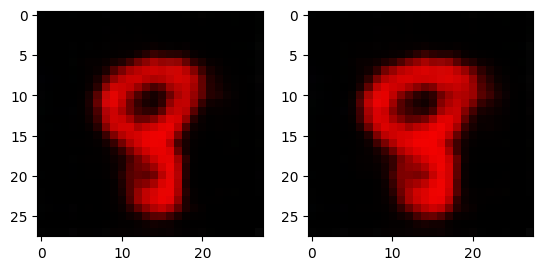

In [106]:
idx = 543

plt.subplot(1, 2, 1)
img = decoder(latent_data[idx].unsqueeze(0))
plt.imshow(img.detach().cpu().numpy().squeeze(0).transpose(2, 1, 0))

plt.subplot(1, 2, 2)
I = torch.eye(P.shape[0]).to(device)
img = decoder((latent_data[idx]@(I-P)).unsqueeze(0))
plt.imshow(img.detach().cpu().numpy().squeeze(0).transpose(2, 1, 0))

## RLACE = always red

In [ ]:
print('Total Distance', torch.norm(latent_data - latent_data_wtmt, 'fro')/latent_data.shape[0])

In [ ]:
print('Total Distance', torch.norm(latent_data@P - latent_data_wtmt@P, 'fro')/latent_data.shape[0])

# RLACE Implementation

In [32]:
def plot_ae_outputs(encoder,decoder,p1, p2, d, n=5):
    plt.figure(figsize=(10,4.5))
    for i in range(n):
        ax = plt.subplot(2,n,i+1)
        img = torch.tensor(test_dataset[i][0]).unsqueeze(0).to(device)
        encoder.eval()
        decoder.eval()
        
        I = torch.eye(int(d/2)).to(device)
        with torch.no_grad():
            encoded_data = encoder(img)
            latent_space_1 = encoded_data[:,:int(d/2)]
            latent_space_2 = encoded_data[:,int(d/2):]

            projected_1 = latent_space_1 @ (I - p1)
            projected_2 = latent_space_2 @ (I - p2)
            
            projected_latent_space = torch.cat((projected_1, projected_2), dim=1)
            
            rec_img  = decoder(projected_latent_space)
        plt.imshow(img.cpu().squeeze().numpy().transpose((2,1,0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        if i == n//2:
            ax.set_title('Original images')
            
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(rec_img.cpu().squeeze().numpy().transpose((2,1,0)))  
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        
        if i == n//2:
            ax.set_title('Reconstructed images')
    plt.show()   

In [50]:
from dataclasses import dataclass
from interventions.classifier import Classifier
from scipy.optimize import brentq
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression
from torch import Tensor
import numpy as np
import torch
import torch.nn.functional as F

@dataclass
class RlaceResult:
    """The result of applying R-LACE."""
    P: Tensor
    """The orthogonal projection matrix."""
    P_relaxed: Tensor
    """The relaxed projection matrix."""
    best_P: Tensor
    """The best P"""
    subspace: Tensor
    """The subspace erased by the projection matrix."""
    clf: Classifier
    """The best-response classifier."""
    clf_loss: float
    """The loss of the best-response classifier."""

def to_one_hot(labels: Tensor, n_classes: int) -> Tensor:
    """
    Convert a tensor of class labels to a one-hot representation.

    Args:
        labels (Tensor): A tensor of class labels of shape (N,).
        n_classes (int): The total number of unique classes.

    Returns:
        Tensor: A one-hot representation tensor of shape (N, n_classes).
    """
    one_hot_labels = labels.new_zeros(*labels.shape, n_classes)
    return one_hot_labels.scatter_(-1, labels.unsqueeze(-1).long(), 1)

@torch.no_grad()
def fantope_project(A: Tensor, d: int = 1) -> Tensor:
    """Project `A` to the Fantope."""
    L, Q = torch.linalg.eigh((A + A.T) / 2)

    # Solve the eigenvalue constraint on the CPU
    L_cpu = L.cpu()
    L -= brentq(
        lambda theta: torch.clamp(L_cpu - theta, 0, 1).sum() - d,
        a=L_cpu.max(), b=L_cpu.min() - 1
    )
    return Q @ L.clamp(0, 1).diag() @ Q.T


def sal(
    X: torch.Tensor,
    y: torch.Tensor,
    num_classes: int,
    n: int,
    rank: int = 1,
):
    """Spectral Attribute Removal <https://arxiv.org/abs/2203.07893>."""
    # Compute the direction of highest covariance with the labels
    # and use this to initialize the projection matrix. This usually
    # gets us most of the way to the optimal solution.
    y_one_hot = to_one_hot(y, num_classes).float() if num_classes > 2 else y
    cross_cov = (X - X.mean(0)).T @ (y_one_hot - y_one_hot.mean(0)) / n
    if num_classes > 2:
        u, _, _ = torch.svd_lowrank(cross_cov, q=rank)
    else:
        # We can skip the SVD entirely for binary classification
        u = F.normalize(cross_cov, dim=0).unsqueeze(1)

    return u @ u.T


def rlace(
    X: torch.Tensor,
    y: torch.Tensor,
    n: int, 
    rank: int = 1,
    *,
    max_iter: int = 100,
    lr: float = 1e-2,
    tolerance_grad: float = 1e-2,
    tolerance_loss: float = 1e-2,
) -> RlaceResult:
    """
    Apply Relaxed Linear Adversarial Concept Erasure (R-LACE) to `X` and `y`.

    R-LACE locates a rank k projection matrix P which maximizes the loss of the
    optimal classifier on the projected data. Method from Ravfogel et al. (2022)
    <https://arxiv.org/abs/2201.12091>.

    Args:
        X: The data matrix (n x d)
        y: The labels (n)
        rank: The rank of the projection matrix
        max_iter: The maximum number of iterations
        lr: The learning rate for the projection matrix
        tolerance_loss: How close the classifier loss must be to the random baseline
            before we break.
        tolerance_grad: The tolerance for the squared gradient norm
    """
    if X.ndim != 2:
        raise ValueError("X must be a 2D tensor.")
    if y.ndim != 1:
        raise ValueError("y must be a 1D tensor.")

    n, d = X.shape
    if n < d:
        raise ValueError("Must have n >= d.")
    if n != len(y):
        raise ValueError("Number of labels must match number of rows in X.")

    class_sizes = torch.bincount(y.long())
    num_classes = len(class_sizes)
    if num_classes == 1:
        raise ValueError("Must have at least two classes.")
    elif num_classes == 2:
        loss_fn = F.binary_cross_entropy_with_logits
        y = y.float()
    else:
        loss_fn = F.cross_entropy
        y = y.long()
    
    # Compute entropy of the labels
    fracs = class_sizes / n
    eps = torch.finfo(fracs.dtype).eps
    H = -torch.sum(fracs * fracs.add(eps).log())

    # Initialize with Spectral Attribute Removal
    P = sal(X, y, num_classes, n, rank)
    P.requires_grad = True

    # We use a small learning rate for the projection matrix instead of strong Wolfe
    # line search because the projection matrix is usually quite close to the optimal
    # solution at initialization, and line search seems to end up overshooting and
    # causing divergence.
    adv_opt = torch.optim.LBFGS([P], lr=lr, tolerance_grad=1e-4)
    clf = Classifier(d, num_classes=num_classes, device=X.device)

    def adv_closure():
        adv_opt.zero_grad()
        P.data = fantope_project(P, rank)

        I = torch.eye(d, device=X.device)
        loss_P = -loss_fn(clf(X @ (I - P)).squeeze(), y)
        loss_P.backward()
        return float(loss_P)

    # "best" here means HIGHEST classifier loss; we're trying to maximize the loss of
    # the best-response classifier. We want to ensure that even if we start diverging
    # for some reason, we can still recover the best solution we've seen.
    best_loss: float = -torch.inf
    best_P = P.detach().clone()

    for _ in range(max_iter):
        # Alternate between optimizing the projection matrix and the classifier
        clf.requires_grad_(True)
        clf_loss = clf.fit(
            X @ (torch.eye(d, device=X.device) - P.detach()), y,
            l2_penalty=0.0
        )
        if clf_loss > best_loss:
            best_loss = clf_loss
            best_P.copy_(P.detach())

            # Check if we've reached the random baseline
            if H - clf_loss < tolerance_loss:
                break

        clf.requires_grad_(False)
        adv_opt.step(adv_closure)

        # Check if we're very close to a saddle point
        grads = [p.grad for p in clf.parameters()] + [P.grad]
        grad_norm_sq = torch.cat([g.view(-1) for g in grads if g is not None]).square().sum()
        if grad_norm_sq < tolerance_grad:
            break

    # Make P an actual orthogonal projection matrix
    _, U = torch.linalg.eigh(best_P)
    U = U.T
    W = U[-rank:]
    P_final = torch.eye(d, device=W.device) - W.T @ W

    return RlaceResult(
        P=P_final.detach(),
        P_relaxed=torch.eye(d, device=U.device) - best_P,
        best_P = best_P,
        subspace=W.detach(),
        clf=clf,
        clf_loss=best_loss,
    )


def get_majority_acc(y):
    """Get the majority accuracy of a set of labels."""
    from collections import Counter

    c = Counter(y)
    fracts = [v / sum(c.values()) for v in c.values()]
    maj = max(fracts)
    return maj

In [34]:
def train_epoch_with_projection(encoder, decoder, p1, p2, device, dataloader, loss_fn, optimizer, d):
    p1.requires_grad = False
    p2.requires_grad = False
    
    encoder.train()
    decoder.train()
    train_loss = []
    count = 0
    I = torch.eye(int(d/2)).to(device)
    for image_batch, _ in dataloader: 
        image_batch = image_batch.to(device)
        encoded_data = encoder(image_batch)
        
        # should be a batch x 4 matrix. We want two batch x 2 matrices
        latent_space_1 = encoded_data[:,:int(d/2)]
        latent_space_2 = encoded_data[:,int(d/2):]
        
        projected_1 = latent_space_1 @ (I - p1)
        projected_2 = latent_space_2 @ (I - p2)
#         else:
#             projected_1 = latent_space_1 @ (p1)
#             projected_2 = latent_space_2 @ (p2)
        
        projected_latent_space = torch.cat((projected_1, projected_2), dim=1)
        
        decoded_data = decoder(projected_latent_space)
        loss = loss_fn(decoded_data, image_batch)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        count = count + 1
        
        if count % 100 == 0: 
            print('\t partial train loss (single batch): %f' % (loss.data))
        train_loss.append(loss.detach().cpu().numpy())

    return np.mean(train_loss)

In [35]:
class RLACE_AE:
    def __init__(self, rank=1, device="cpu", out_iters=75000, in_iters_adv=1, in_iters_clf=1, epsilon=0.0015, batch_size=128, 
                 evaluate_every=1000, labels_1=3, labels_2=10, d=4):
        """
        :param X: The input (np array)
        :param Y: the lables (np array)
        :param X_dev: Dev set (np array)
        :param Y_dev: Dev labels (np array)
        :param rank: Number of dimensions to neutralize from the input.
        :param device:
        :param out_iters: Number of batches to run
        :param in_iters_adv: number of iterations for adversary's optimization
        :param in_iters_clf: number of iterations from the predictor's optimization
        :param epsilon: stopping criterion .Stops if abs(acc - majority) < epsilon.
        :param batch_size:
        :param evalaute_every: After how many batches to evaluate the current adversary.
        :return:
        """
        
        assert (d%2 == 0)
        
        self.rank = rank
        self.device = device
        self.out_iters = out_iters
        self.in_iters_adv = in_iters_adv
        self.in_iters_clf = in_iters_clf
        self.epsilon = epsilon
        self.batch_size = batch_size
        self.evaluate_every = evaluate_every
        
        self.optimizer_class = torch.optim.AdamW
        self.optimizer_params = {'lr':0.005, 'weight_decay':1e-4}
        
        self.encoder = Encoder(encoded_space_dim=d).to(device)
        self.decoder = Decoder(encoded_space_dim=d).to(device)
        
        self.params_to_optimize = [
            {'params': self.encoder.parameters()},
            {'params': self.decoder.parameters()},
        ]
        
        

    def solve_adv_game(self, d, dataloader, valid_loader=valid_loader, o_epochs=100, a_epochs=10, evaluate_every=1):
        
        self.P1 = 1e-1*torch.randn(int(d/2), int(d/2)).to(self.device)
        self.P2 = 1e-1*torch.randn(int(d/2), int(d/2)).to(self.device)
        
        
        
        optimizer_autoencoder = self.optimizer_class(self.params_to_optimize, **self.optimizer_params)

        self.train_ae_losses = []
        
        n = 20000
        dataloader_rlace = DataLoader(train_dataset, batch_size=n, shuffle=True)
        
        for o_step in tqdm(range(o_epochs)):
            self.P1.requires_grad = True
            self.P2.requires_grad = True
            # train autoencoder for n steps
            
            for a_step in tqdm(range(a_epochs)):
                train_ae_loss = train_epoch_with_projection(self.encoder, self.decoder, self.P1, self.P2, self.device, 
                                                            dataloader, torch.nn.MSELoss(), optimizer_autoencoder, d=d, )
               
                self.train_ae_losses.append(train_ae_loss)
                plot_ae_outputs(self.encoder,self.decoder, self.P1, self.P2, d=d, n=5)
            
            
            subset = next(iter(dataloader_rlace))
            
            print("RLACE")
            X = self.encoder(subset[0].to(device)).detach()
            X1 = X[:,:int(d/2)]
            X2 = X[:,int(d/2):]
            Y1 = subset[1]['color'].to(device)
            Y2 = subset[1]['number'].to(device)
            
            rlace_output1 = rlace(X1, Y1, n, rank=1)
            rlace_output2 = rlace(X2, Y2, n, rank=1)
            
            
            self.P1 = rlace_output1.best_P
            self.P2 = rlace_output2.best_P
            
            plot_ae_outputs(self.encoder,self.decoder, self.P1, self.P2, d=d, n=5)
            
        return self.prepare_output() 

    def prepare_output(self):
        return {'P1':self.P1, 'P2':self.P2, 'encoder':self.encoder, 'decoder':self.decoder, 'train_losses_ae': self.train_ae_losses}
    
    

In [36]:
def encoder_with_projection(batch, dim):
    encoded_data = output['encoder'](batch)
    
    I = torch.eye(int(dim/2)).to(device)
    latent_space_1 = encoded_data[:,:int(dim/2)]
    latent_space_2 = encoded_data[:,int(dim/2):]
        
    projected_1 = latent_space_1 @ (I - output['P1'])
    projected_2 = latent_space_2 @ (I - output['P2'])

    projected_latent_space = torch.cat((projected_1, projected_2), dim=1)
    return projected_latent_space

In [37]:
def encoder_proj1(batch, dim):
    encoded_data = output['encoder'](batch)
    I = torch.eye(int(dim/2)).to(device)
    latent_space_1 = encoded_data[:,:int(dim/2)]    
    projected_1 = latent_space_1 @ (I - output['P1'])

    return projected_1

def encoder_proj2(batch, dim):
    encoded_data = output['encoder'](batch)
    I = torch.eye(int(dim/2)).to(device)
    latent_space_2 = encoded_data[:,int(dim/2):]
    projected_2 = latent_space_2 @ (I - output['P2'])

    return projected_2

In [38]:
val_acc = {}
outputs = {}

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.035384
	 partial train loss (single batch): 0.030952
	 partial train loss (single batch): 0.032692
	 partial train loss (single batch): 0.032969
	 partial train loss (single batch): 0.031710
	 partial train loss (single batch): 0.029432
	 partial train loss (single batch): 0.031379


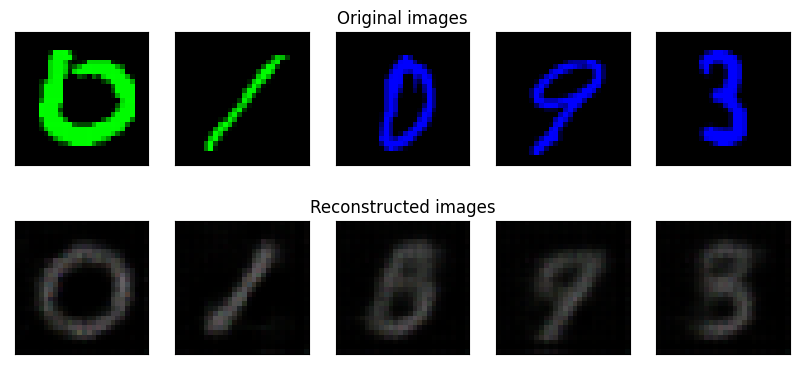


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.46s/it]

	 partial train loss (single batch): 0.030848
	 partial train loss (single batch): 0.029563
	 partial train loss (single batch): 0.031602
	 partial train loss (single batch): 0.032246
	 partial train loss (single batch): 0.031058
	 partial train loss (single batch): 0.029102
	 partial train loss (single batch): 0.031085


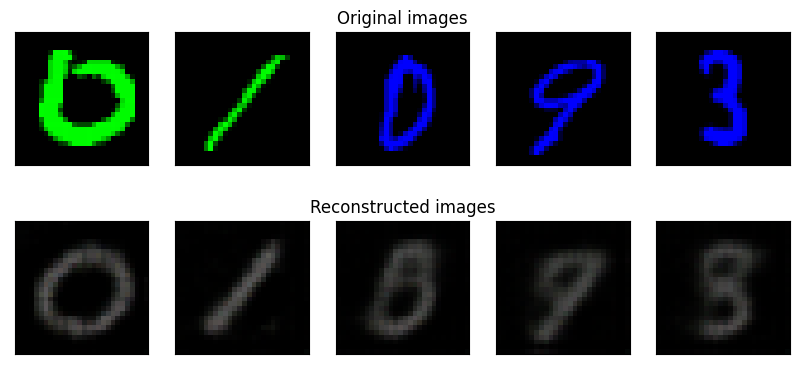


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.43s/it]

	 partial train loss (single batch): 0.030629
	 partial train loss (single batch): 0.029462
	 partial train loss (single batch): 0.031398
	 partial train loss (single batch): 0.032004
	 partial train loss (single batch): 0.030991
	 partial train loss (single batch): 0.028928
	 partial train loss (single batch): 0.030820


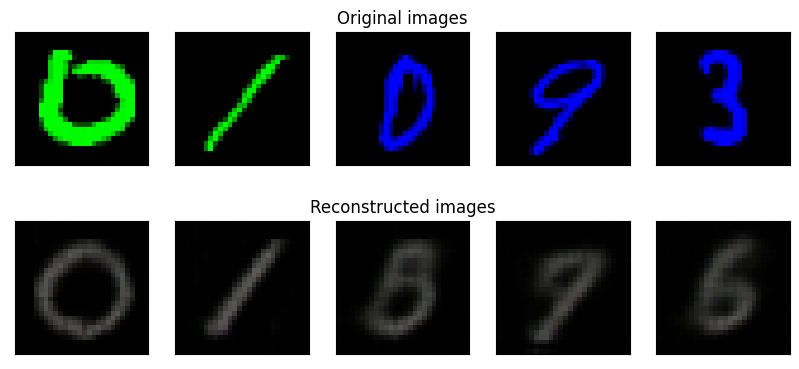


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.42s/it]

	 partial train loss (single batch): 0.030446
	 partial train loss (single batch): 0.029312
	 partial train loss (single batch): 0.031249
	 partial train loss (single batch): 0.031852
	 partial train loss (single batch): 0.030693
	 partial train loss (single batch): 0.028763
	 partial train loss (single batch): 0.030969


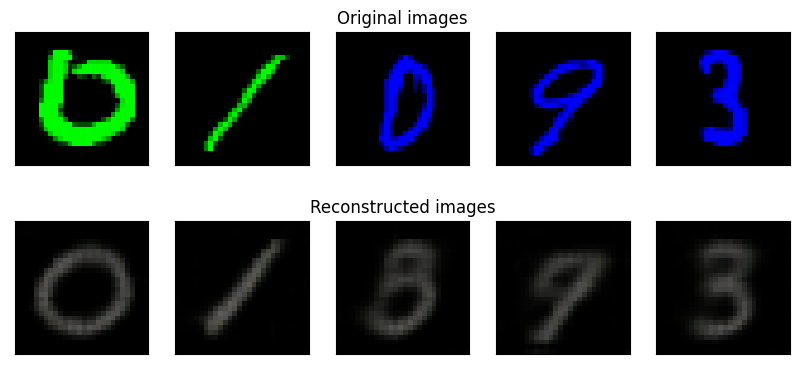


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.45s/it]

	 partial train loss (single batch): 0.030491
	 partial train loss (single batch): 0.029190
	 partial train loss (single batch): 0.031173
	 partial train loss (single batch): 0.031859
	 partial train loss (single batch): 0.030571
	 partial train loss (single batch): 0.028802
	 partial train loss (single batch): 0.030791


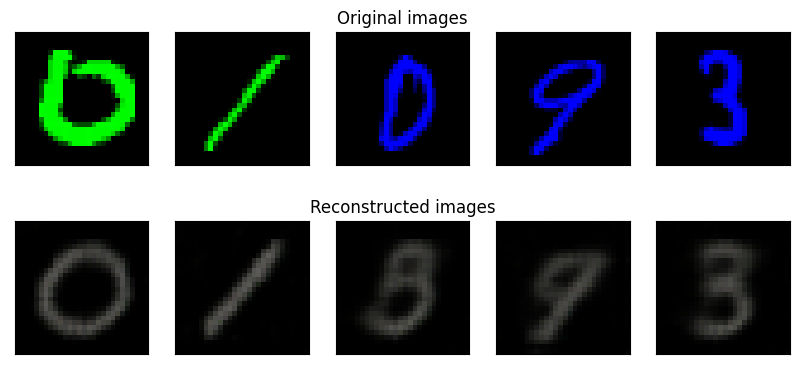


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.45s/it]


RLACE


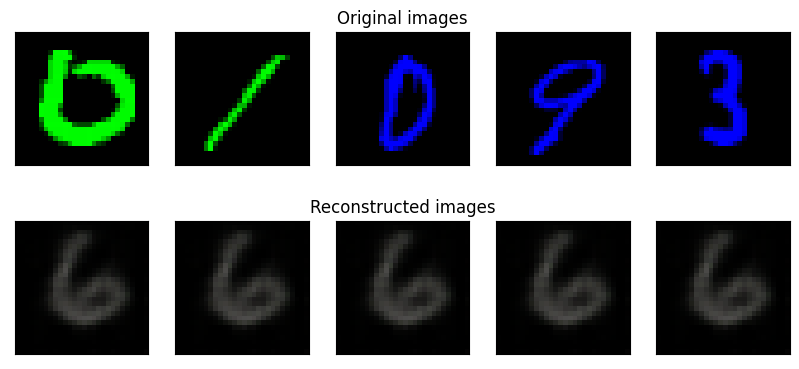

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033316
	 partial train loss (single batch): 0.031894
	 partial train loss (single batch): 0.034428
	 partial train loss (single batch): 0.034697
	 partial train loss (single batch): 0.034287
	 partial train loss (single batch): 0.031445
	 partial train loss (single batch): 0.033623


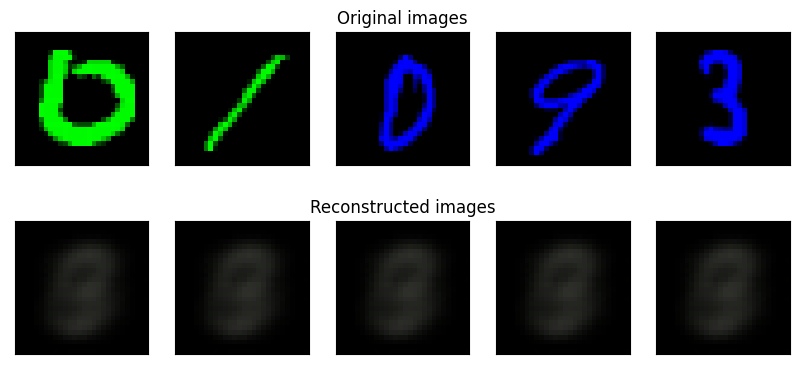


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.43s/it]

	 partial train loss (single batch): 0.033291
	 partial train loss (single batch): 0.031884
	 partial train loss (single batch): 0.034427
	 partial train loss (single batch): 0.034700
	 partial train loss (single batch): 0.034287
	 partial train loss (single batch): 0.031456
	 partial train loss (single batch): 0.033623


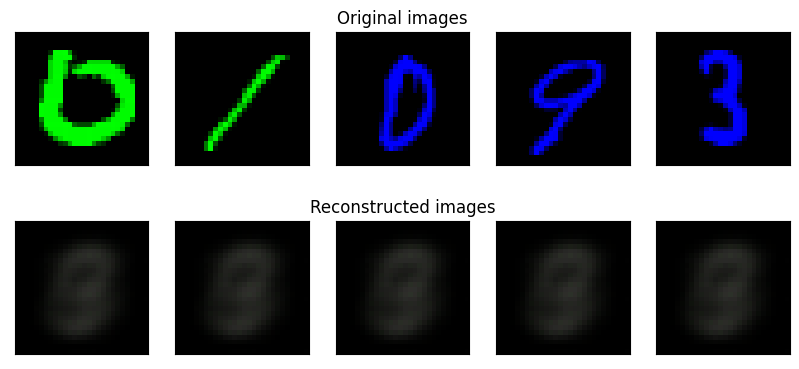


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.45s/it]

	 partial train loss (single batch): 0.033289
	 partial train loss (single batch): 0.031883
	 partial train loss (single batch): 0.034426
	 partial train loss (single batch): 0.034701
	 partial train loss (single batch): 0.034288
	 partial train loss (single batch): 0.031463
	 partial train loss (single batch): 0.033621


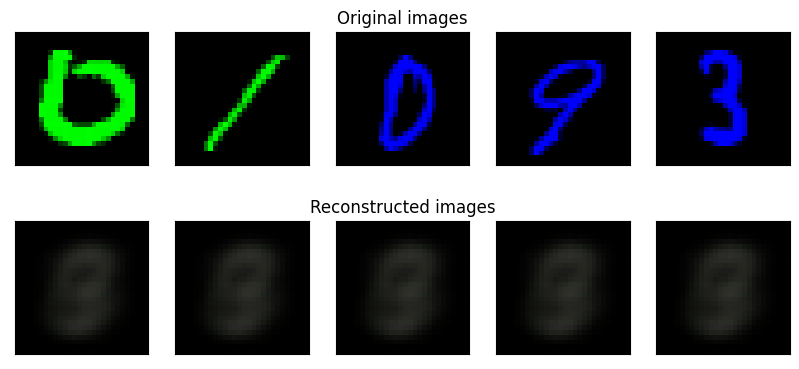


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.50s/it]

	 partial train loss (single batch): 0.033288
	 partial train loss (single batch): 0.031884
	 partial train loss (single batch): 0.034427
	 partial train loss (single batch): 0.034702
	 partial train loss (single batch): 0.034286
	 partial train loss (single batch): 0.031467
	 partial train loss (single batch): 0.033623


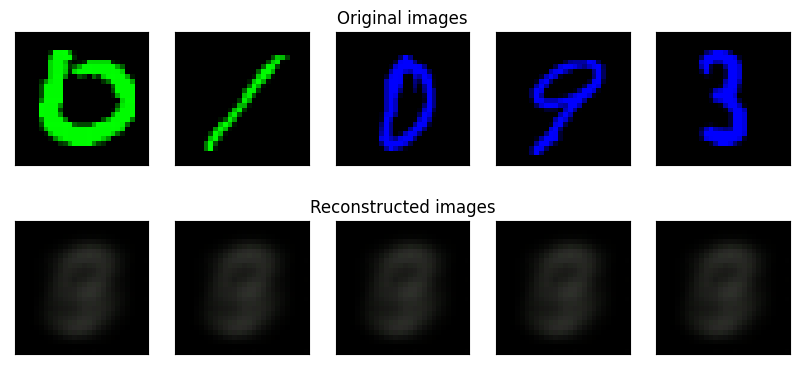


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.49s/it]

	 partial train loss (single batch): 0.033289
	 partial train loss (single batch): 0.031885
	 partial train loss (single batch): 0.034427
	 partial train loss (single batch): 0.034701
	 partial train loss (single batch): 0.034284
	 partial train loss (single batch): 0.031465
	 partial train loss (single batch): 0.033624


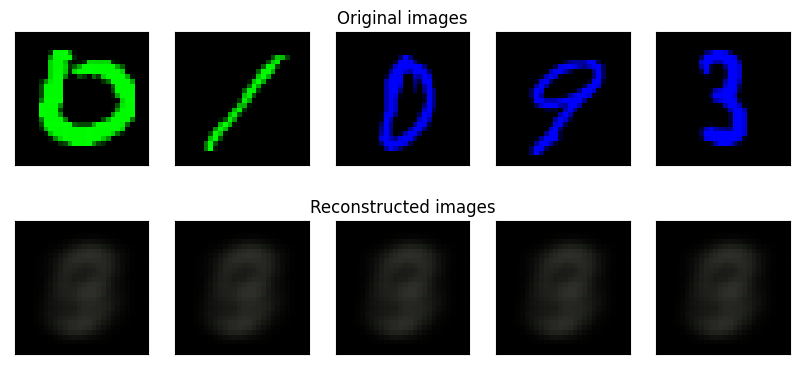


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.48s/it]


RLACE


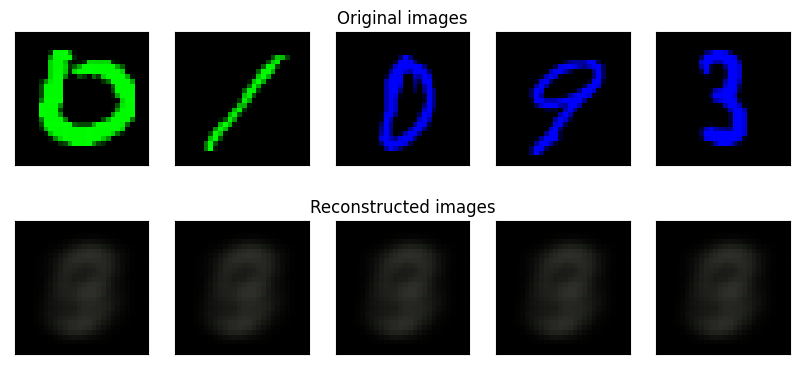

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033288
	 partial train loss (single batch): 0.031884
	 partial train loss (single batch): 0.034428
	 partial train loss (single batch): 0.034698
	 partial train loss (single batch): 0.034283
	 partial train loss (single batch): 0.031461
	 partial train loss (single batch): 0.033624


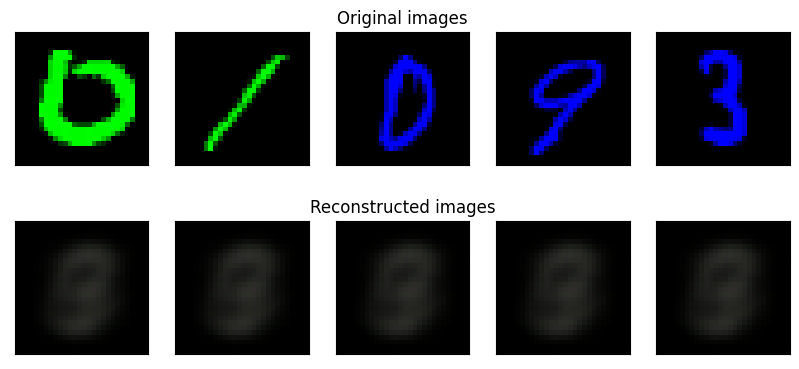


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.48s/it]

	 partial train loss (single batch): 0.033289
	 partial train loss (single batch): 0.031887
	 partial train loss (single batch): 0.034429
	 partial train loss (single batch): 0.034698
	 partial train loss (single batch): 0.034288
	 partial train loss (single batch): 0.031456
	 partial train loss (single batch): 0.033624


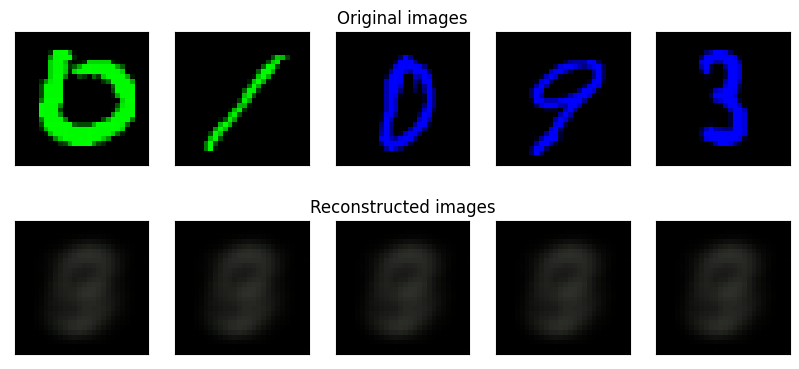


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.48s/it]

	 partial train loss (single batch): 0.033289
	 partial train loss (single batch): 0.031885
	 partial train loss (single batch): 0.034427
	 partial train loss (single batch): 0.034695
	 partial train loss (single batch): 0.034278
	 partial train loss (single batch): 0.031453
	 partial train loss (single batch): 0.033626


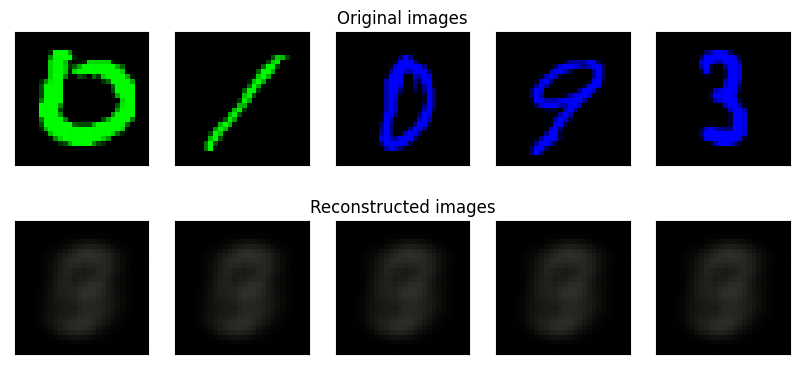


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.54s/it]

	 partial train loss (single batch): 0.033290
	 partial train loss (single batch): 0.031886
	 partial train loss (single batch): 0.034429
	 partial train loss (single batch): 0.034692
	 partial train loss (single batch): 0.034282
	 partial train loss (single batch): 0.031449
	 partial train loss (single batch): 0.033626


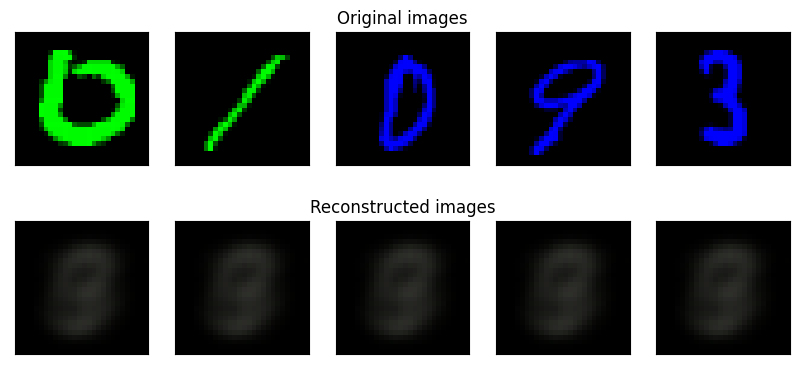


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.51s/it]

	 partial train loss (single batch): 0.033290
	 partial train loss (single batch): 0.031886
	 partial train loss (single batch): 0.034428
	 partial train loss (single batch): 0.034688
	 partial train loss (single batch): 0.034281
	 partial train loss (single batch): 0.031445
	 partial train loss (single batch): 0.033626


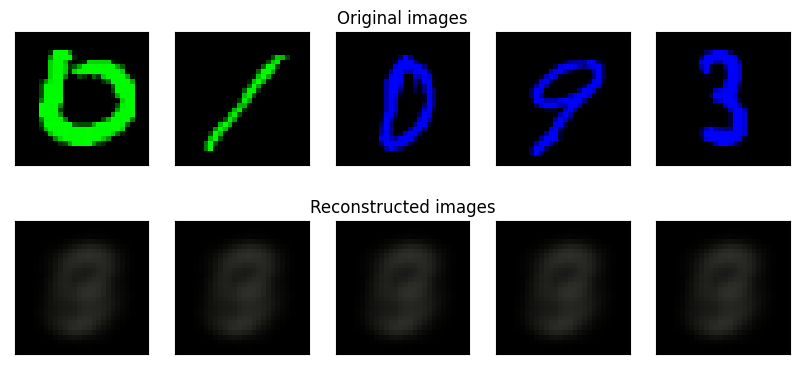


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.49s/it]


RLACE


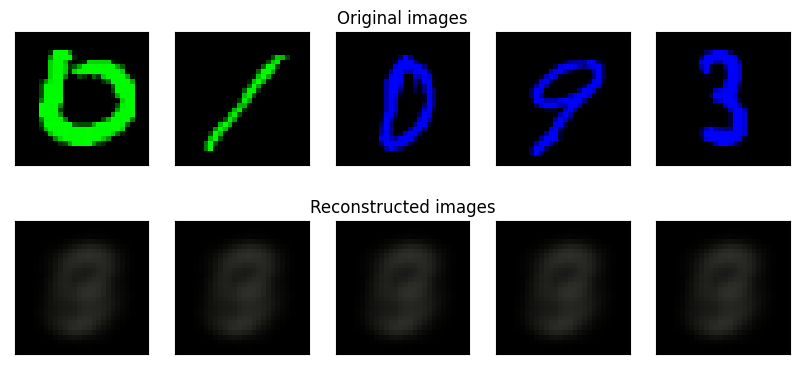

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033291
	 partial train loss (single batch): 0.031884
	 partial train loss (single batch): 0.034426
	 partial train loss (single batch): 0.034686
	 partial train loss (single batch): 0.034277
	 partial train loss (single batch): 0.031442
	 partial train loss (single batch): 0.033625


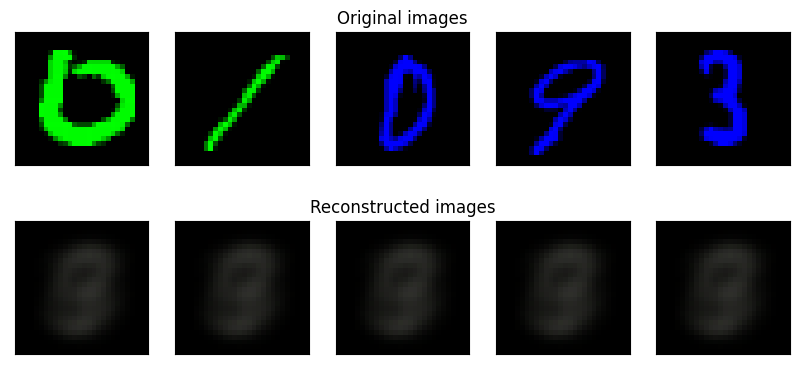


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.45s/it]

	 partial train loss (single batch): 0.033291
	 partial train loss (single batch): 0.031885
	 partial train loss (single batch): 0.034425
	 partial train loss (single batch): 0.034684
	 partial train loss (single batch): 0.034277
	 partial train loss (single batch): 0.031439
	 partial train loss (single batch): 0.033627


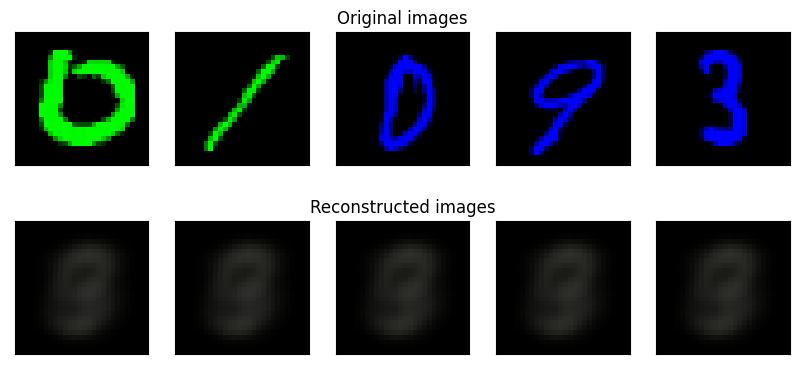


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.45s/it]

	 partial train loss (single batch): 0.033291
	 partial train loss (single batch): 0.031883
	 partial train loss (single batch): 0.034424
	 partial train loss (single batch): 0.034683
	 partial train loss (single batch): 0.034275
	 partial train loss (single batch): 0.031433
	 partial train loss (single batch): 0.033626


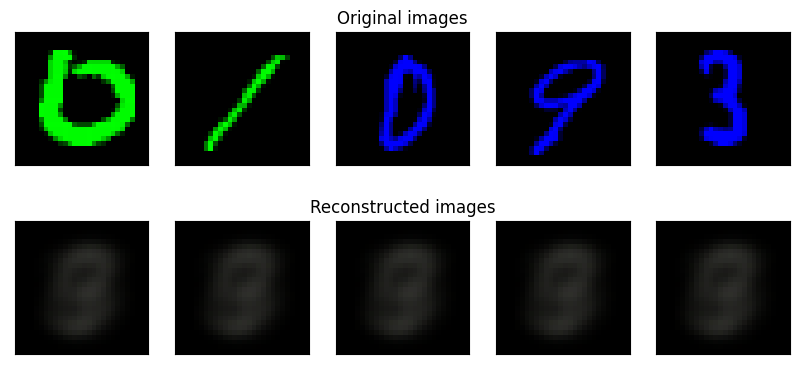


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.51s/it]

	 partial train loss (single batch): 0.033292
	 partial train loss (single batch): 0.031884
	 partial train loss (single batch): 0.034425
	 partial train loss (single batch): 0.034681
	 partial train loss (single batch): 0.034275
	 partial train loss (single batch): 0.031430
	 partial train loss (single batch): 0.033627


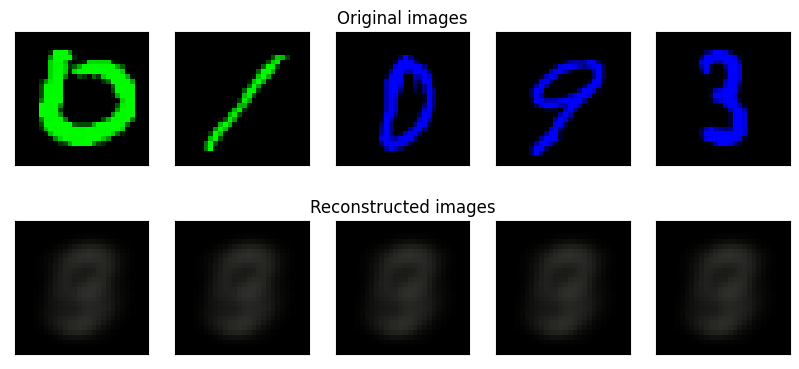


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.49s/it]

	 partial train loss (single batch): 0.033292
	 partial train loss (single batch): 0.031883
	 partial train loss (single batch): 0.034422
	 partial train loss (single batch): 0.034681
	 partial train loss (single batch): 0.034273
	 partial train loss (single batch): 0.031428
	 partial train loss (single batch): 0.033626


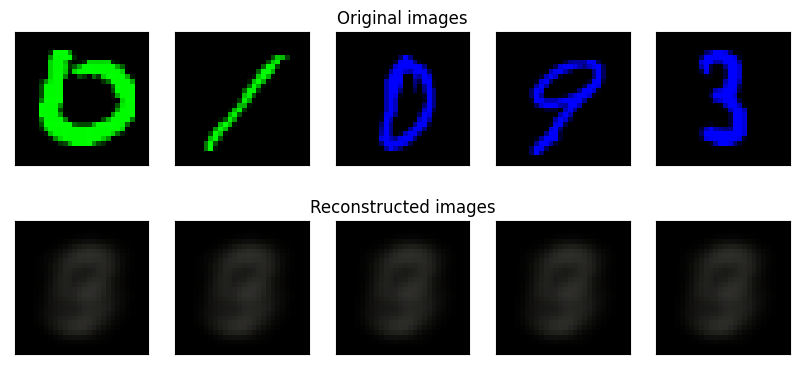


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.48s/it]


RLACE


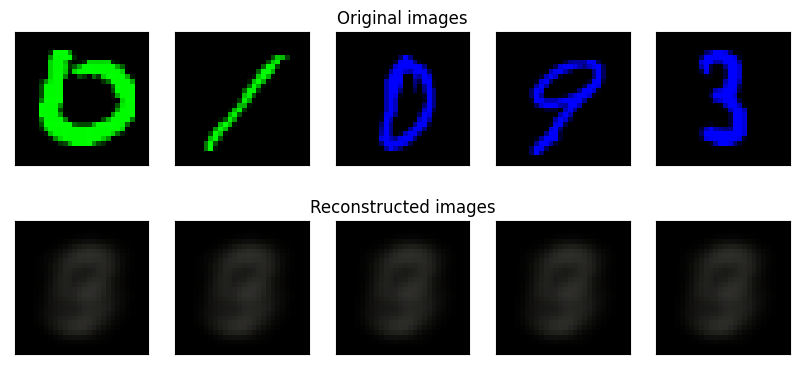

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033292
	 partial train loss (single batch): 0.031884
	 partial train loss (single batch): 0.034423
	 partial train loss (single batch): 0.034678
	 partial train loss (single batch): 0.034271
	 partial train loss (single batch): 0.031425
	 partial train loss (single batch): 0.033626


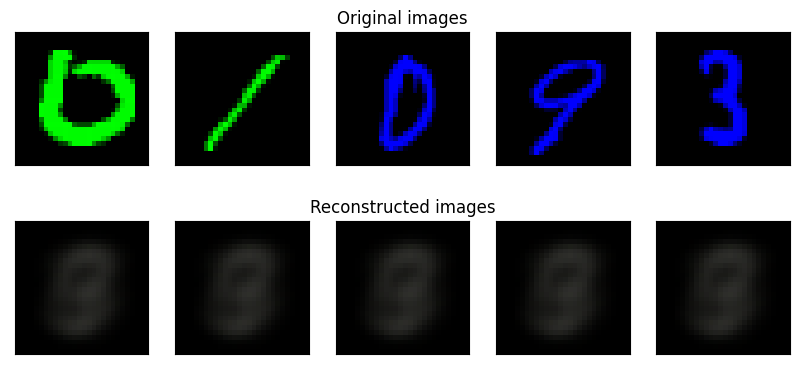


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.45s/it]

	 partial train loss (single batch): 0.033293
	 partial train loss (single batch): 0.031882
	 partial train loss (single batch): 0.034421
	 partial train loss (single batch): 0.034678
	 partial train loss (single batch): 0.034270
	 partial train loss (single batch): 0.031422
	 partial train loss (single batch): 0.033626


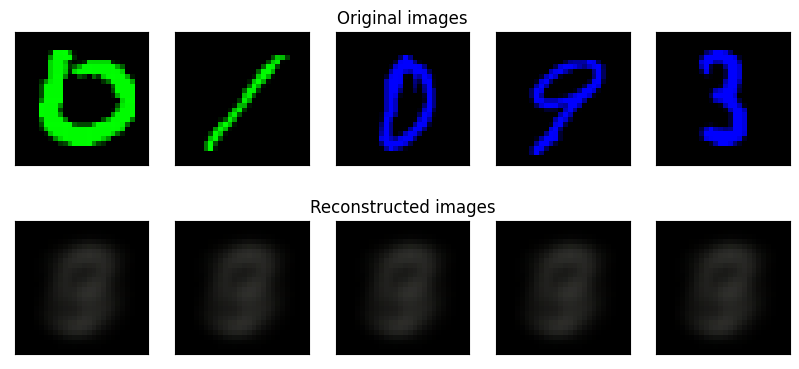


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.52s/it]

	 partial train loss (single batch): 0.033294
	 partial train loss (single batch): 0.031881
	 partial train loss (single batch): 0.034420
	 partial train loss (single batch): 0.034678
	 partial train loss (single batch): 0.034268
	 partial train loss (single batch): 0.031421
	 partial train loss (single batch): 0.033626


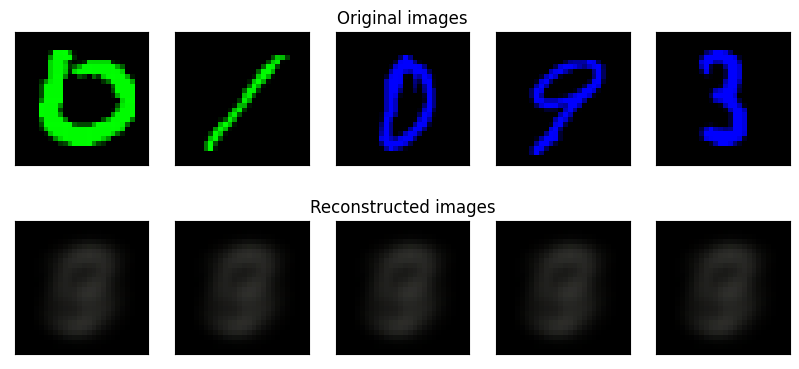


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.49s/it]

	 partial train loss (single batch): 0.033293
	 partial train loss (single batch): 0.031881
	 partial train loss (single batch): 0.034420
	 partial train loss (single batch): 0.034676
	 partial train loss (single batch): 0.034263
	 partial train loss (single batch): 0.031419
	 partial train loss (single batch): 0.033625


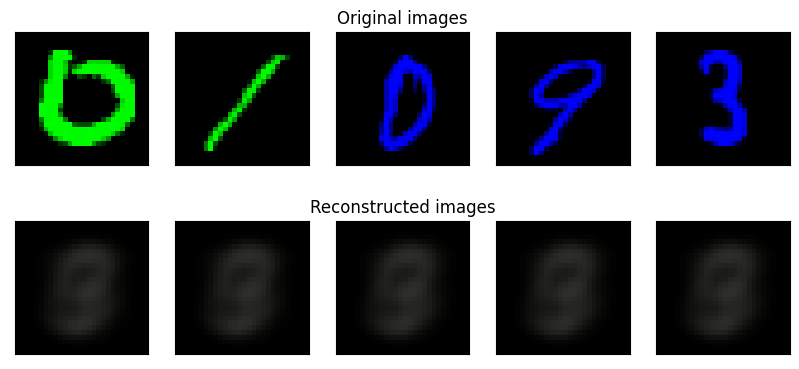


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.48s/it]

	 partial train loss (single batch): 0.033293
	 partial train loss (single batch): 0.031881
	 partial train loss (single batch): 0.034419
	 partial train loss (single batch): 0.034677
	 partial train loss (single batch): 0.034264
	 partial train loss (single batch): 0.031417
	 partial train loss (single batch): 0.033625


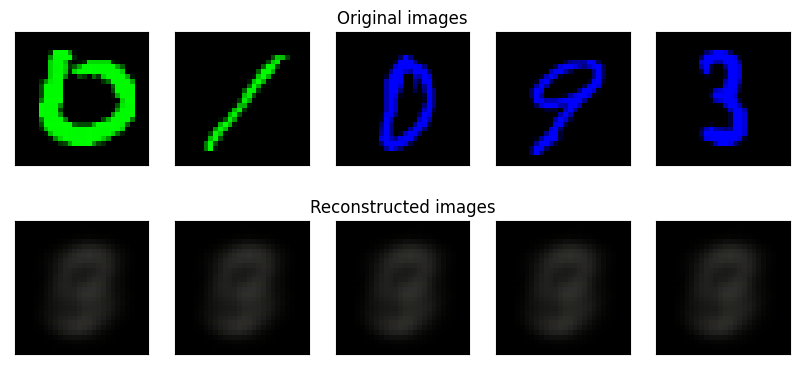


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.51s/it]


RLACE


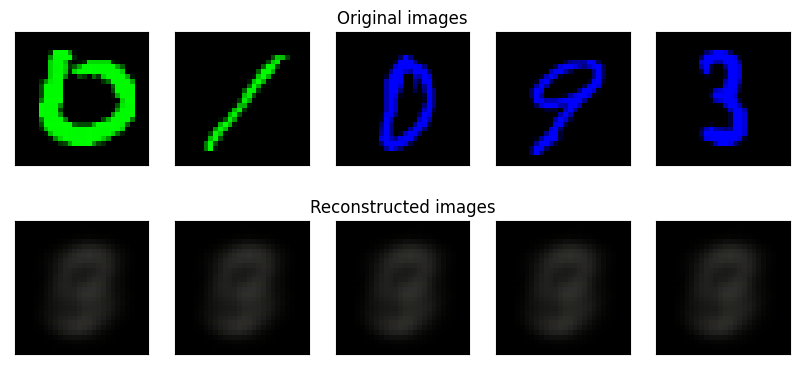

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033294
	 partial train loss (single batch): 0.031880
	 partial train loss (single batch): 0.034418
	 partial train loss (single batch): 0.034675
	 partial train loss (single batch): 0.034260
	 partial train loss (single batch): 0.031415
	 partial train loss (single batch): 0.033625


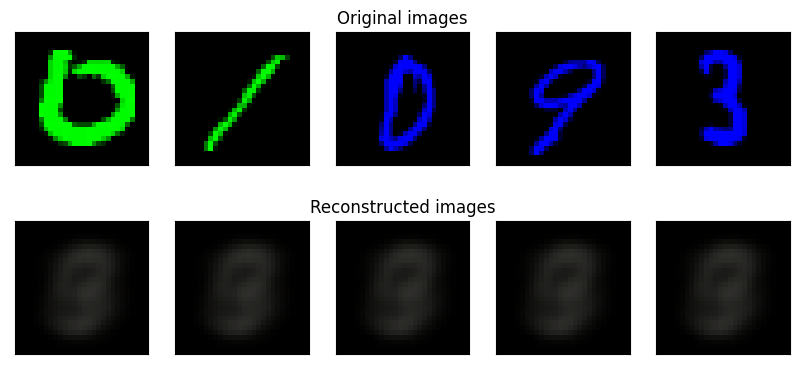


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.61s/it]

	 partial train loss (single batch): 0.033293
	 partial train loss (single batch): 0.031880
	 partial train loss (single batch): 0.034418
	 partial train loss (single batch): 0.034675
	 partial train loss (single batch): 0.034259
	 partial train loss (single batch): 0.031413
	 partial train loss (single batch): 0.033626


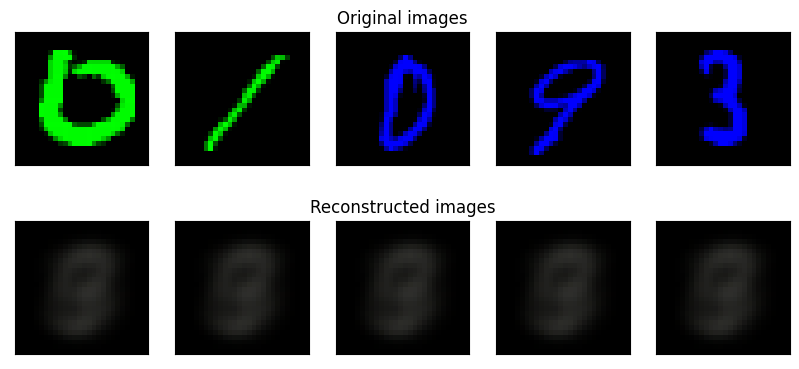


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.55s/it]

	 partial train loss (single batch): 0.033293
	 partial train loss (single batch): 0.031879
	 partial train loss (single batch): 0.034417
	 partial train loss (single batch): 0.034675
	 partial train loss (single batch): 0.034258
	 partial train loss (single batch): 0.031412
	 partial train loss (single batch): 0.033626


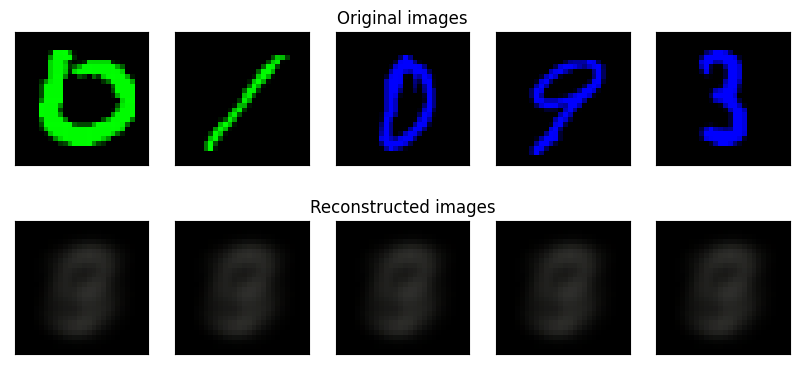


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.57s/it]

	 partial train loss (single batch): 0.033294
	 partial train loss (single batch): 0.031878
	 partial train loss (single batch): 0.034418
	 partial train loss (single batch): 0.034674
	 partial train loss (single batch): 0.034257
	 partial train loss (single batch): 0.031411
	 partial train loss (single batch): 0.033626


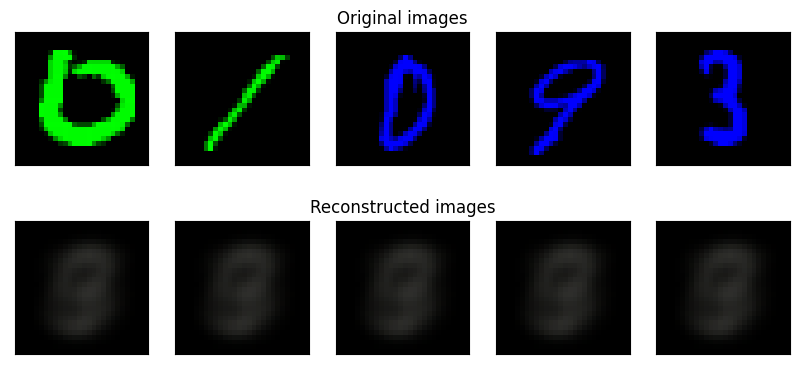


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.59s/it]

	 partial train loss (single batch): 0.033293
	 partial train loss (single batch): 0.031876
	 partial train loss (single batch): 0.034417
	 partial train loss (single batch): 0.034673
	 partial train loss (single batch): 0.034259
	 partial train loss (single batch): 0.031410
	 partial train loss (single batch): 0.033626


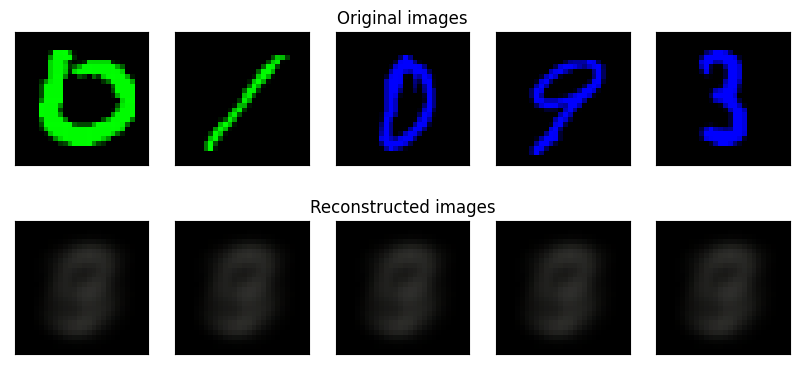


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.57s/it]


RLACE


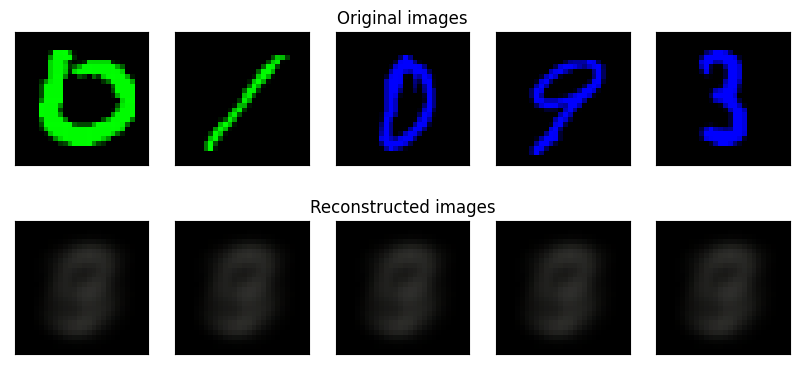

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033294
	 partial train loss (single batch): 0.031878
	 partial train loss (single batch): 0.034417
	 partial train loss (single batch): 0.034672
	 partial train loss (single batch): 0.034255
	 partial train loss (single batch): 0.031409
	 partial train loss (single batch): 0.033626


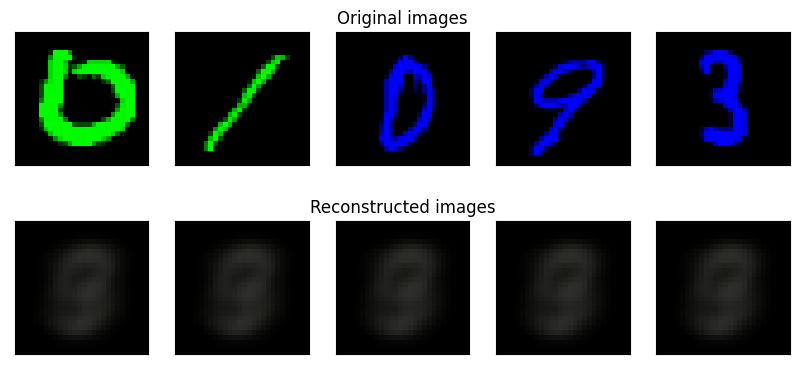


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.50s/it]

	 partial train loss (single batch): 0.033294
	 partial train loss (single batch): 0.031876
	 partial train loss (single batch): 0.034415
	 partial train loss (single batch): 0.034672
	 partial train loss (single batch): 0.034253
	 partial train loss (single batch): 0.031407
	 partial train loss (single batch): 0.033625


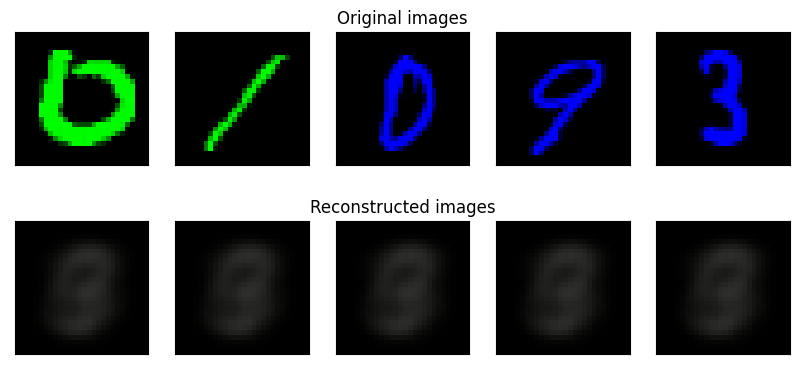


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.57s/it]

	 partial train loss (single batch): 0.033294
	 partial train loss (single batch): 0.031876
	 partial train loss (single batch): 0.034415
	 partial train loss (single batch): 0.034672
	 partial train loss (single batch): 0.034253
	 partial train loss (single batch): 0.031407
	 partial train loss (single batch): 0.033625


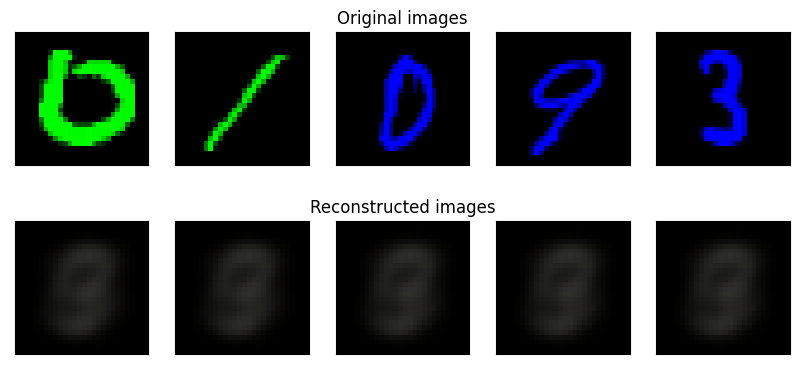


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.51s/it]

	 partial train loss (single batch): 0.033294
	 partial train loss (single batch): 0.031876
	 partial train loss (single batch): 0.034415
	 partial train loss (single batch): 0.034672
	 partial train loss (single batch): 0.034253
	 partial train loss (single batch): 0.031405
	 partial train loss (single batch): 0.033625


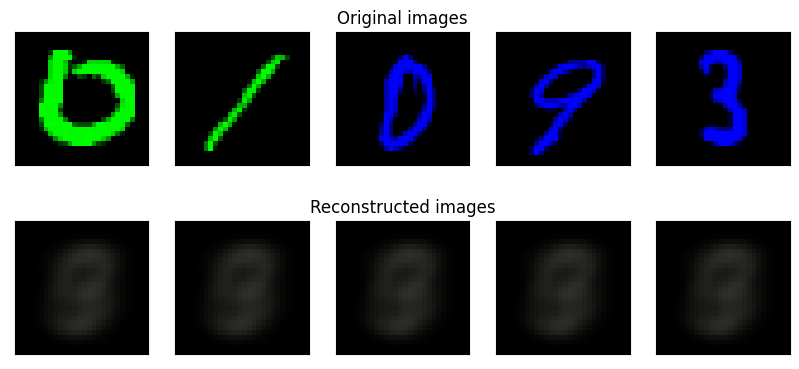


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.44s/it]

	 partial train loss (single batch): 0.033295
	 partial train loss (single batch): 0.031875
	 partial train loss (single batch): 0.034414
	 partial train loss (single batch): 0.034672
	 partial train loss (single batch): 0.034252
	 partial train loss (single batch): 0.031405
	 partial train loss (single batch): 0.033625


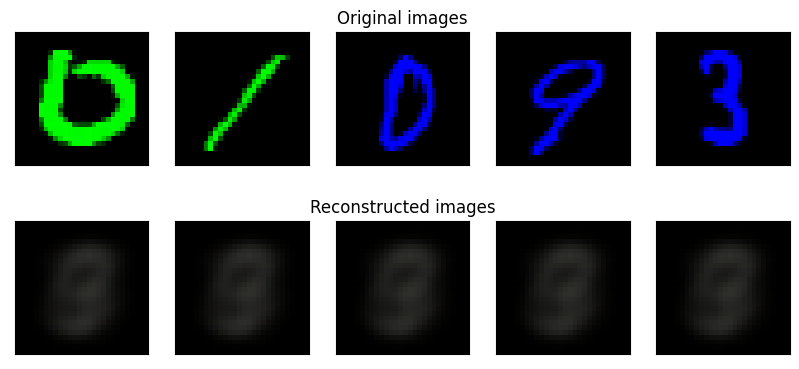


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.42s/it]


RLACE


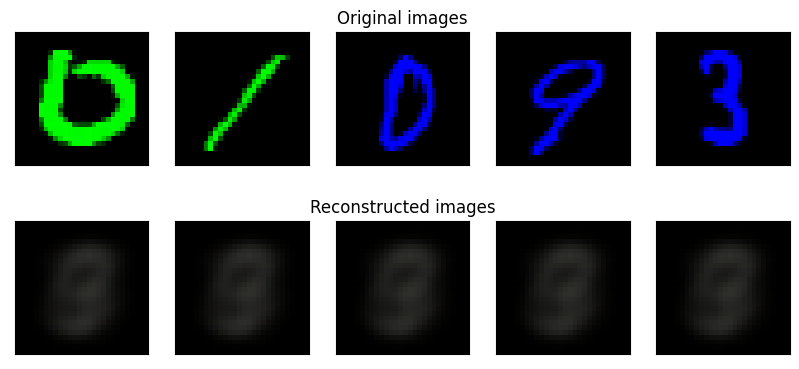

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033295
	 partial train loss (single batch): 0.031875
	 partial train loss (single batch): 0.034414
	 partial train loss (single batch): 0.034672
	 partial train loss (single batch): 0.034253
	 partial train loss (single batch): 0.031403
	 partial train loss (single batch): 0.033625


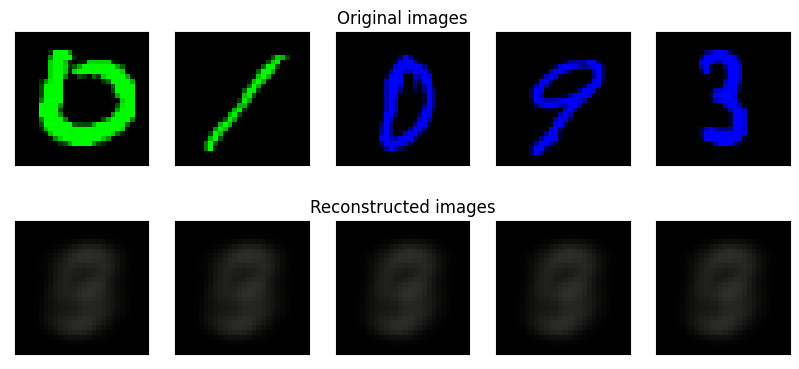


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:20,  5.23s/it]

	 partial train loss (single batch): 0.033295
	 partial train loss (single batch): 0.031874
	 partial train loss (single batch): 0.034414
	 partial train loss (single batch): 0.034664
	 partial train loss (single batch): 0.034252
	 partial train loss (single batch): 0.031403
	 partial train loss (single batch): 0.033625


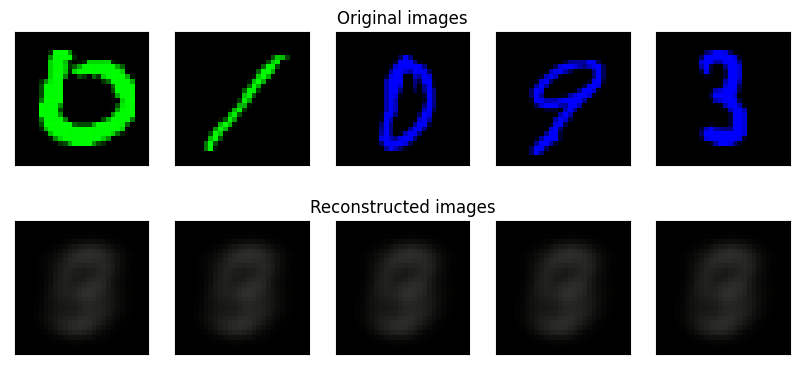


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:15,  5.22s/it]

	 partial train loss (single batch): 0.033295
	 partial train loss (single batch): 0.031874
	 partial train loss (single batch): 0.034413
	 partial train loss (single batch): 0.034670
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031402
	 partial train loss (single batch): 0.033625


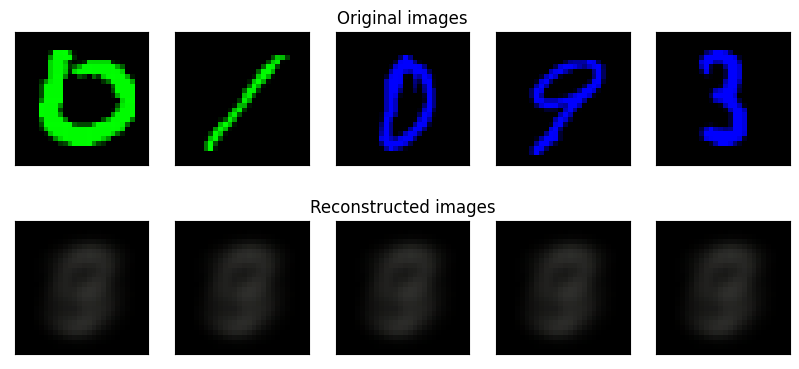


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:15<00:10,  5.28s/it]

	 partial train loss (single batch): 0.033295
	 partial train loss (single batch): 0.031874
	 partial train loss (single batch): 0.034414
	 partial train loss (single batch): 0.034669
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031401
	 partial train loss (single batch): 0.033625


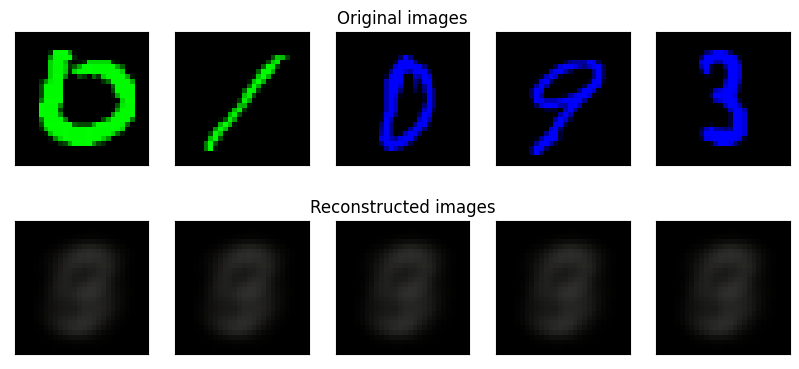


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.28s/it]

	 partial train loss (single batch): 0.033295
	 partial train loss (single batch): 0.031873
	 partial train loss (single batch): 0.034413
	 partial train loss (single batch): 0.034668
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031401
	 partial train loss (single batch): 0.033625


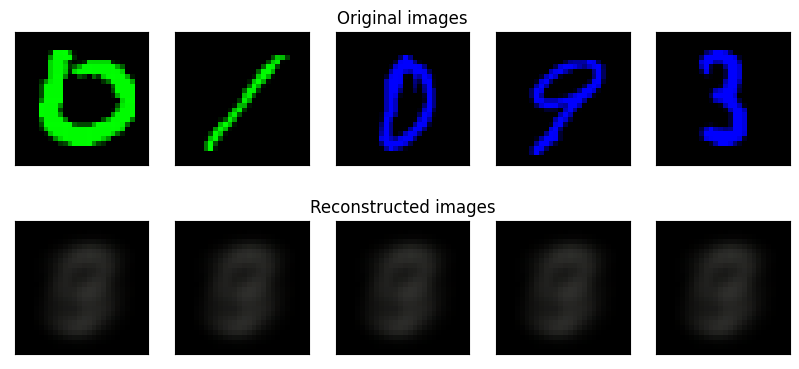


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:26<00:00,  5.26s/it]


RLACE


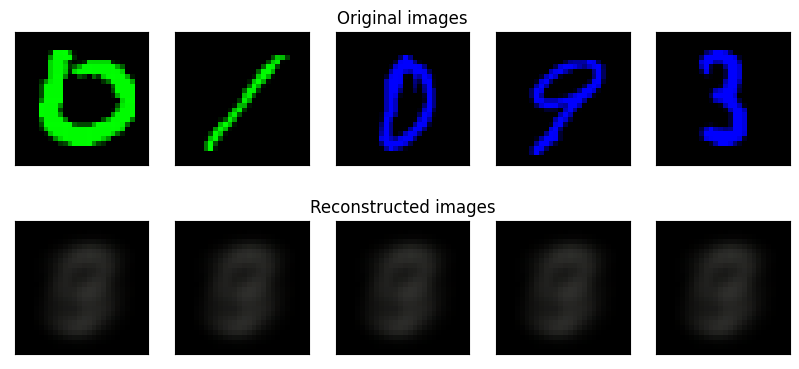

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031873
	 partial train loss (single batch): 0.034413
	 partial train loss (single batch): 0.034666
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031400
	 partial train loss (single batch): 0.033625


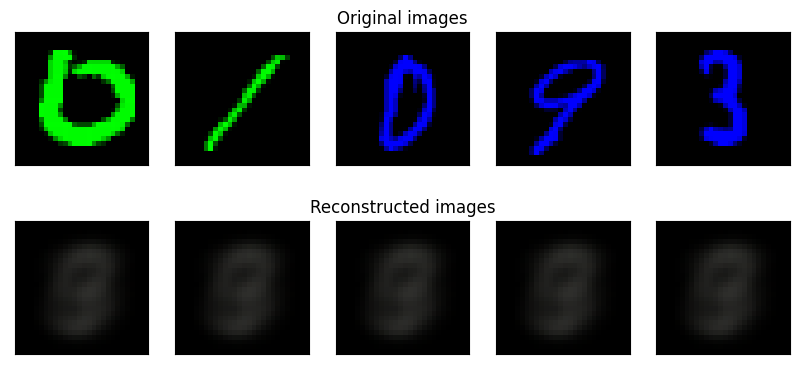


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:20,  5.21s/it]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031872
	 partial train loss (single batch): 0.034413
	 partial train loss (single batch): 0.034667
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031399
	 partial train loss (single batch): 0.033624


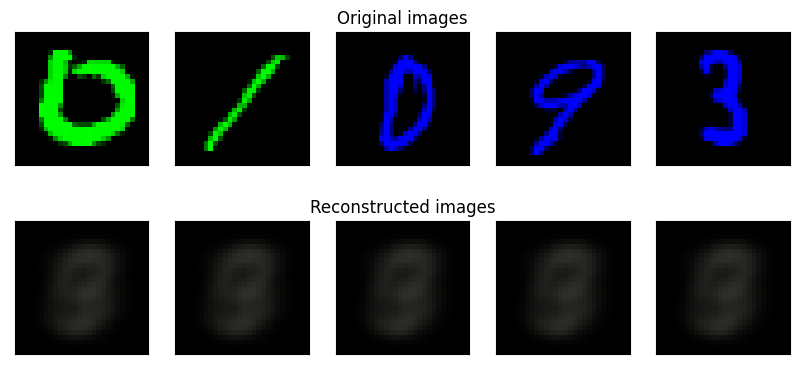


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:15,  5.25s/it]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031871
	 partial train loss (single batch): 0.034413
	 partial train loss (single batch): 0.034666
	 partial train loss (single batch): 0.034250
	 partial train loss (single batch): 0.031399
	 partial train loss (single batch): 0.033625


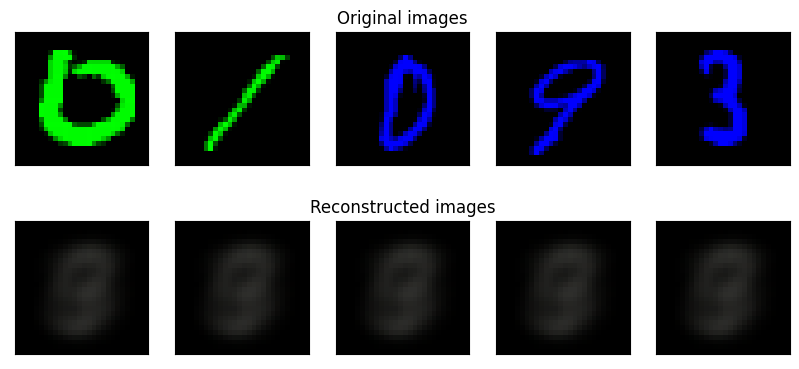


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:15<00:10,  5.36s/it]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031871
	 partial train loss (single batch): 0.034412
	 partial train loss (single batch): 0.034667
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031399
	 partial train loss (single batch): 0.033626


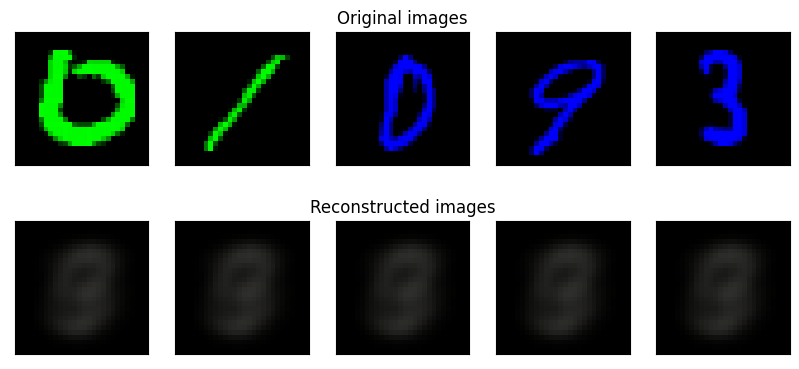


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.31s/it]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031871
	 partial train loss (single batch): 0.034413
	 partial train loss (single batch): 0.034665
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031398
	 partial train loss (single batch): 0.033626


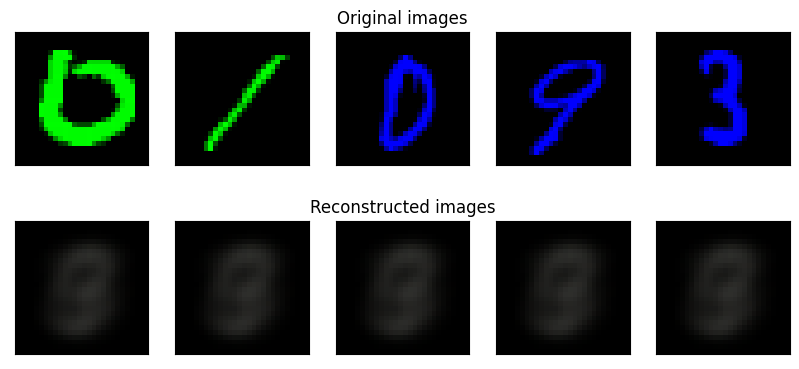


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:26<00:00,  5.29s/it]


RLACE


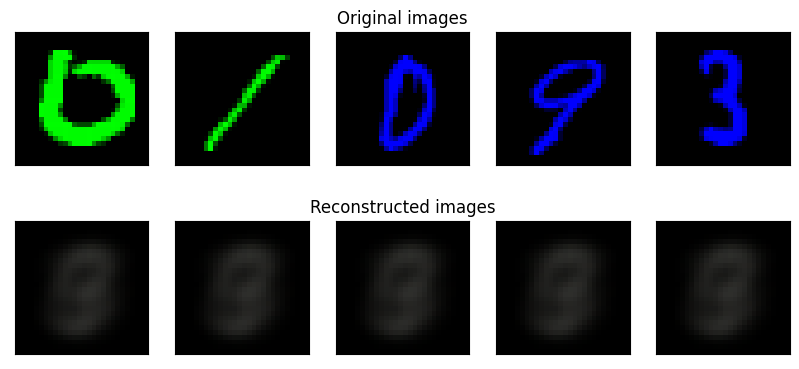

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031870
	 partial train loss (single batch): 0.034412
	 partial train loss (single batch): 0.034664
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031398
	 partial train loss (single batch): 0.033626


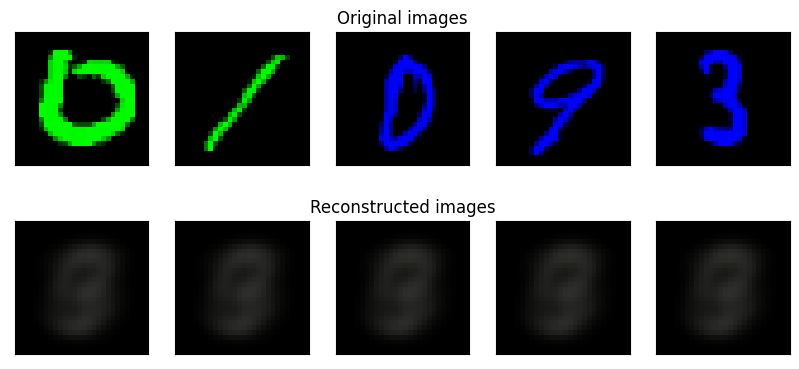


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.47s/it]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031870
	 partial train loss (single batch): 0.034412
	 partial train loss (single batch): 0.034664
	 partial train loss (single batch): 0.034251
	 partial train loss (single batch): 0.031397
	 partial train loss (single batch): 0.033626


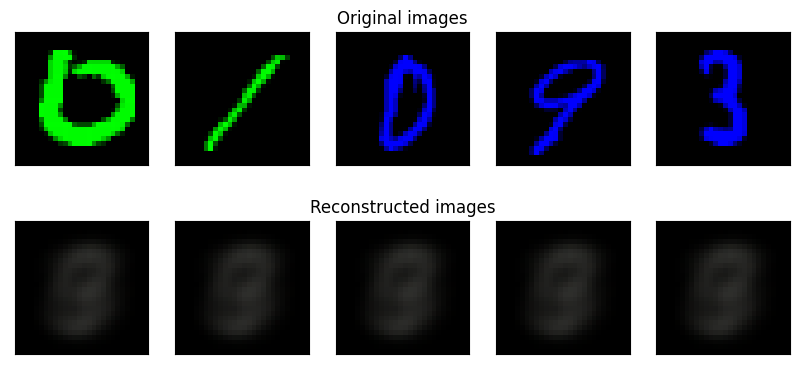


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.46s/it]

	 partial train loss (single batch): 0.033297
	 partial train loss (single batch): 0.031869
	 partial train loss (single batch): 0.034412
	 partial train loss (single batch): 0.034662
	 partial train loss (single batch): 0.034250
	 partial train loss (single batch): 0.031397
	 partial train loss (single batch): 0.033626


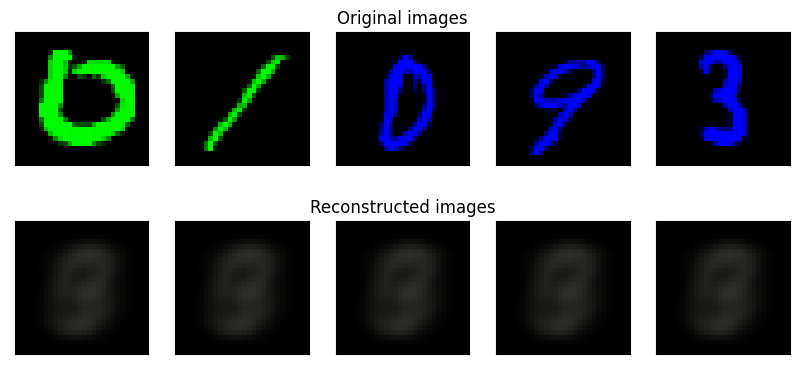


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.52s/it]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031866
	 partial train loss (single batch): 0.034411
	 partial train loss (single batch): 0.034662
	 partial train loss (single batch): 0.034250
	 partial train loss (single batch): 0.031396
	 partial train loss (single batch): 0.033626


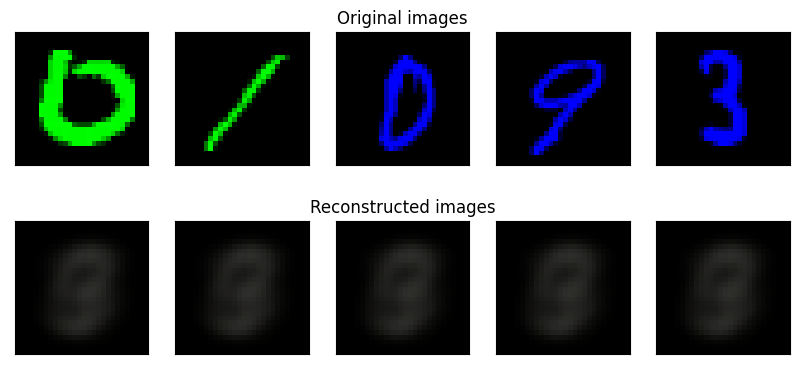


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.50s/it]

	 partial train loss (single batch): 0.033296
	 partial train loss (single batch): 0.031868
	 partial train loss (single batch): 0.034412
	 partial train loss (single batch): 0.034660
	 partial train loss (single batch): 0.034250
	 partial train loss (single batch): 0.031396
	 partial train loss (single batch): 0.033626


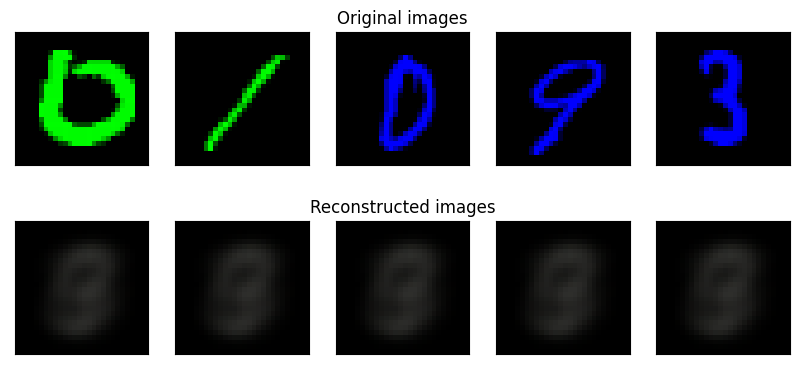


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.49s/it]


RLACE


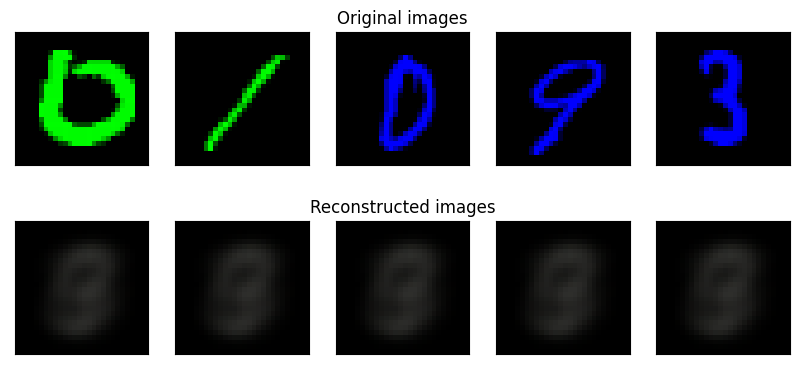

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.034481
	 partial train loss (single batch): 0.030141
	 partial train loss (single batch): 0.031317
	 partial train loss (single batch): 0.031656
	 partial train loss (single batch): 0.026498
	 partial train loss (single batch): 0.020498
	 partial train loss (single batch): 0.019642


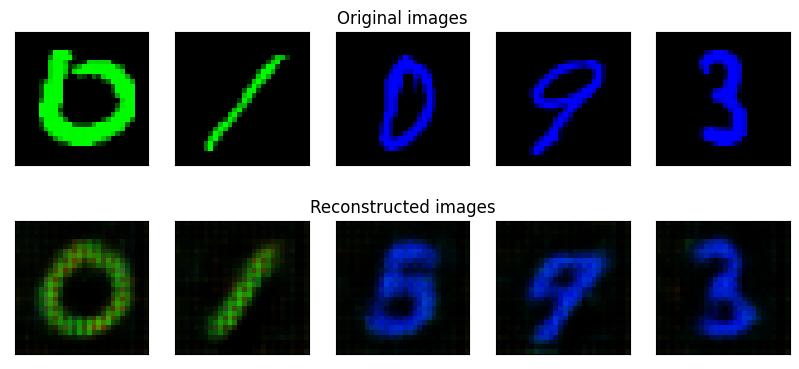


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.50s/it]

	 partial train loss (single batch): 0.015145
	 partial train loss (single batch): 0.014572
	 partial train loss (single batch): 0.013782
	 partial train loss (single batch): 0.014934
	 partial train loss (single batch): 0.011864
	 partial train loss (single batch): 0.012109
	 partial train loss (single batch): 0.012817


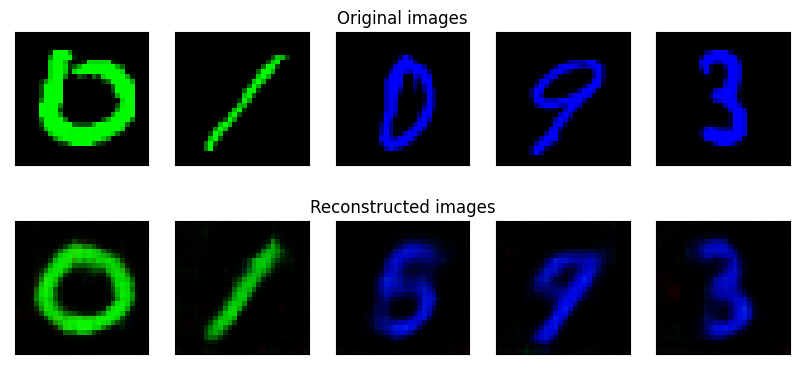


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.57s/it]

	 partial train loss (single batch): 0.013112
	 partial train loss (single batch): 0.012090
	 partial train loss (single batch): 0.012571
	 partial train loss (single batch): 0.013670
	 partial train loss (single batch): 0.010846
	 partial train loss (single batch): 0.011526
	 partial train loss (single batch): 0.011843


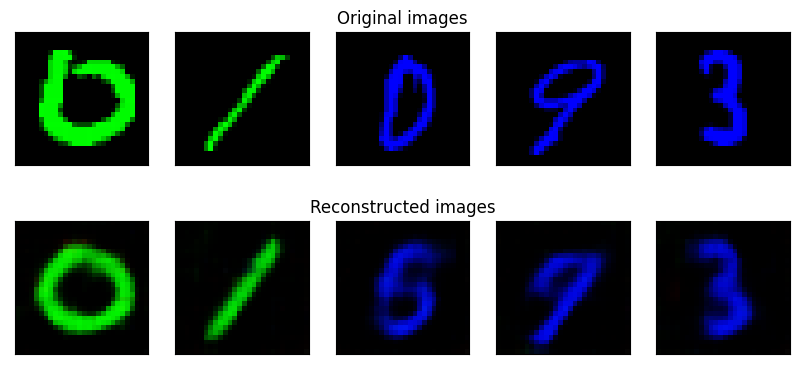


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.61s/it]

	 partial train loss (single batch): 0.012514
	 partial train loss (single batch): 0.011179
	 partial train loss (single batch): 0.012072
	 partial train loss (single batch): 0.013198
	 partial train loss (single batch): 0.010425
	 partial train loss (single batch): 0.010867
	 partial train loss (single batch): 0.011532


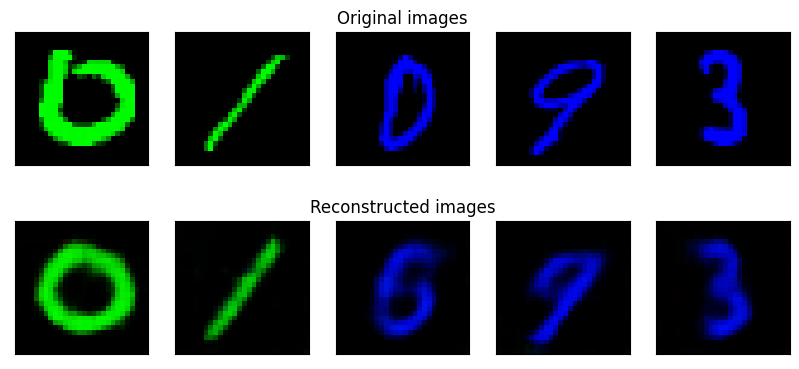


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:23<00:05,  5.93s/it]

	 partial train loss (single batch): 0.012061
	 partial train loss (single batch): 0.010914
	 partial train loss (single batch): 0.011667
	 partial train loss (single batch): 0.012976
	 partial train loss (single batch): 0.010320
	 partial train loss (single batch): 0.010591
	 partial train loss (single batch): 0.011211


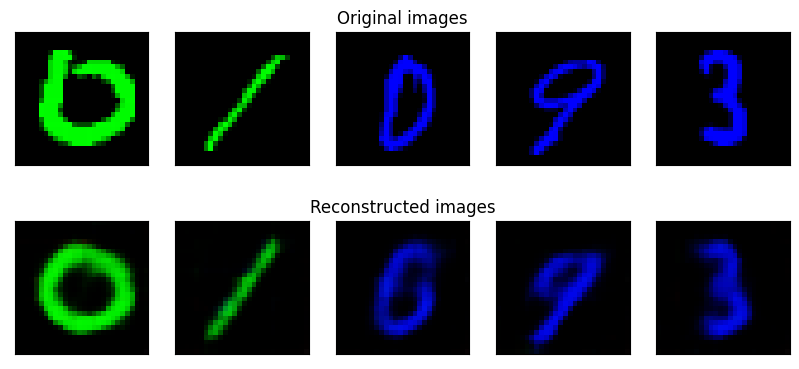


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:28<00:00,  5.76s/it]


RLACE


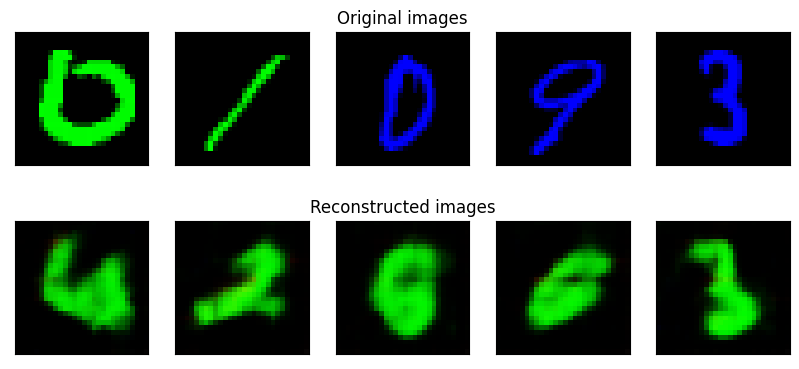

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.026229
	 partial train loss (single batch): 0.019597
	 partial train loss (single batch): 0.019934
	 partial train loss (single batch): 0.021233
	 partial train loss (single batch): 0.019040
	 partial train loss (single batch): 0.018987
	 partial train loss (single batch): 0.018702


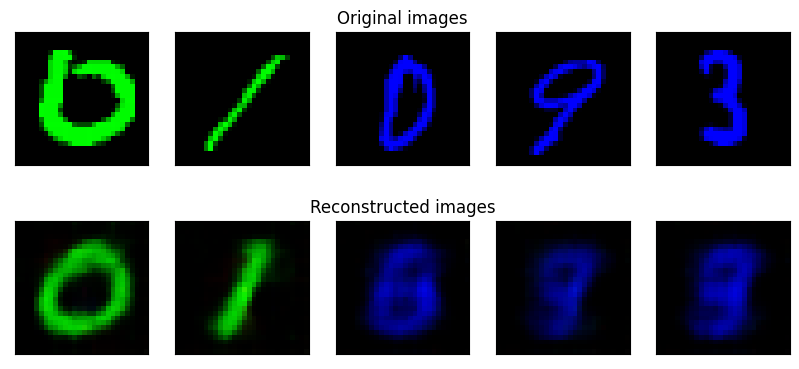


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.60s/it]

	 partial train loss (single batch): 0.018834
	 partial train loss (single batch): 0.017767
	 partial train loss (single batch): 0.018477
	 partial train loss (single batch): 0.020313
	 partial train loss (single batch): 0.017375
	 partial train loss (single batch): 0.017478
	 partial train loss (single batch): 0.017737


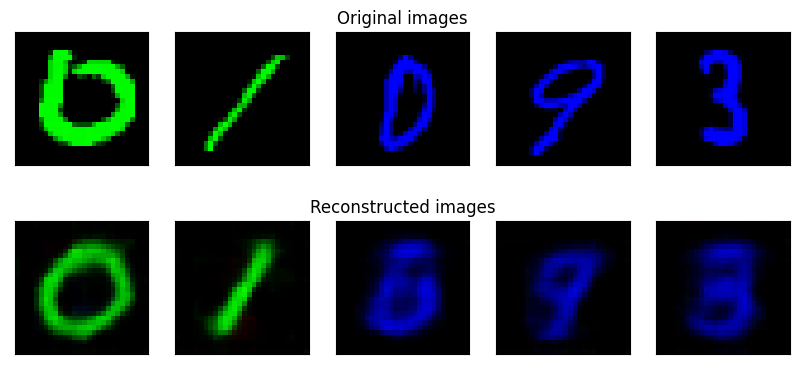


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.45s/it]

	 partial train loss (single batch): 0.017835
	 partial train loss (single batch): 0.017254
	 partial train loss (single batch): 0.017795
	 partial train loss (single batch): 0.019976
	 partial train loss (single batch): 0.016262
	 partial train loss (single batch): 0.016791
	 partial train loss (single batch): 0.016877


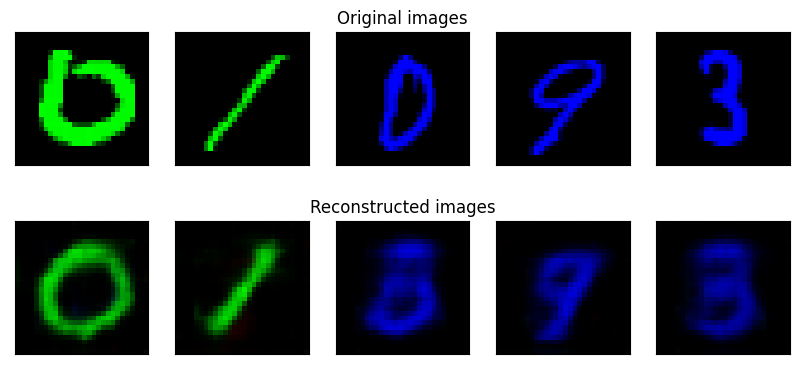


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.36s/it]

	 partial train loss (single batch): 0.017472
	 partial train loss (single batch): 0.016760
	 partial train loss (single batch): 0.017500
	 partial train loss (single batch): 0.018836
	 partial train loss (single batch): 0.015737
	 partial train loss (single batch): 0.016324
	 partial train loss (single batch): 0.016559


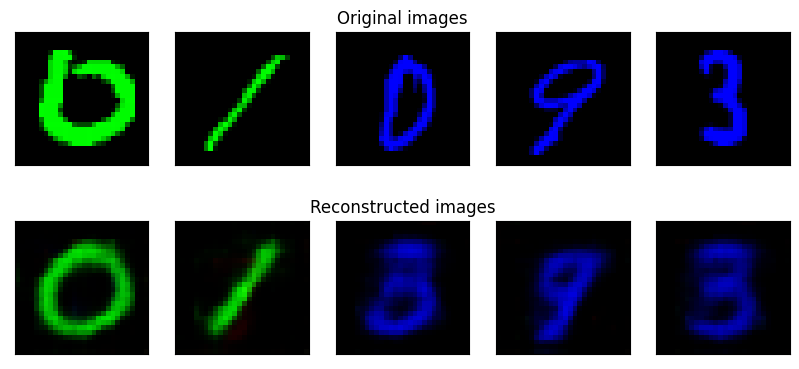


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.35s/it]

	 partial train loss (single batch): 0.017092
	 partial train loss (single batch): 0.016430
	 partial train loss (single batch): 0.017265
	 partial train loss (single batch): 0.018354
	 partial train loss (single batch): 0.015571
	 partial train loss (single batch): 0.015971
	 partial train loss (single batch): 0.016384


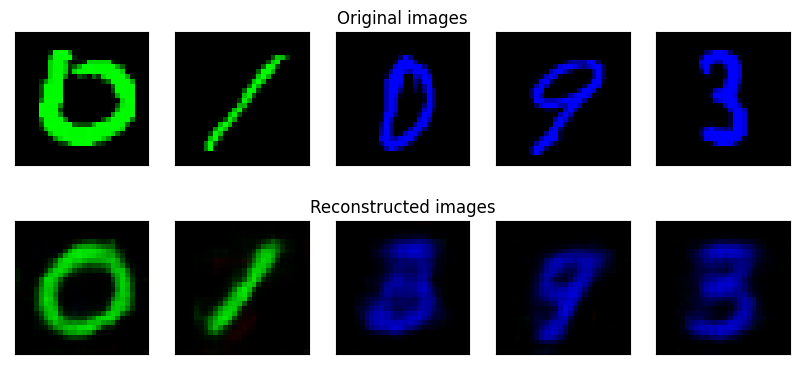


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:26<00:00,  5.36s/it]


RLACE


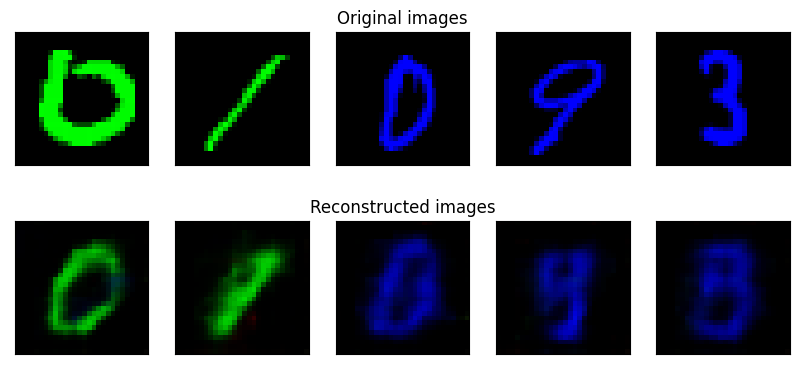

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.016650
	 partial train loss (single batch): 0.016191
	 partial train loss (single batch): 0.016774
	 partial train loss (single batch): 0.018045
	 partial train loss (single batch): 0.015184
	 partial train loss (single batch): 0.015591
	 partial train loss (single batch): 0.016275


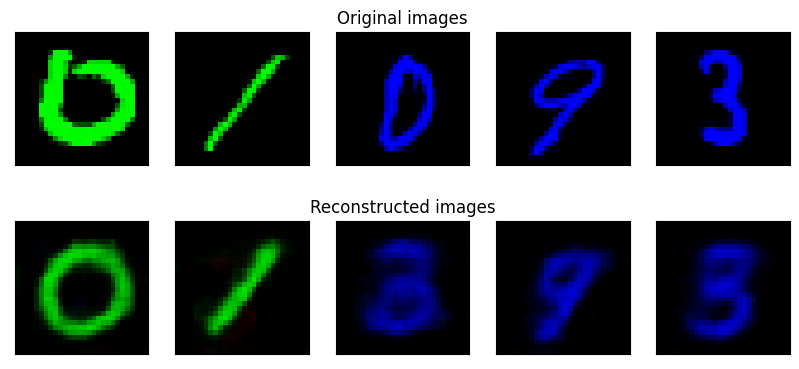


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:20,  5.23s/it]

	 partial train loss (single batch): 0.016626
	 partial train loss (single batch): 0.015859
	 partial train loss (single batch): 0.016469
	 partial train loss (single batch): 0.017611
	 partial train loss (single batch): 0.015048
	 partial train loss (single batch): 0.015492
	 partial train loss (single batch): 0.015846


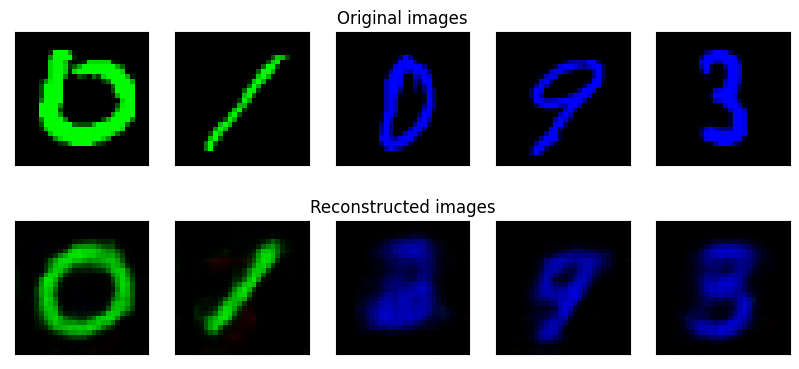


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:15,  5.25s/it]

	 partial train loss (single batch): 0.016458
	 partial train loss (single batch): 0.015983
	 partial train loss (single batch): 0.016100
	 partial train loss (single batch): 0.017505
	 partial train loss (single batch): 0.014711
	 partial train loss (single batch): 0.015462
	 partial train loss (single batch): 0.015754


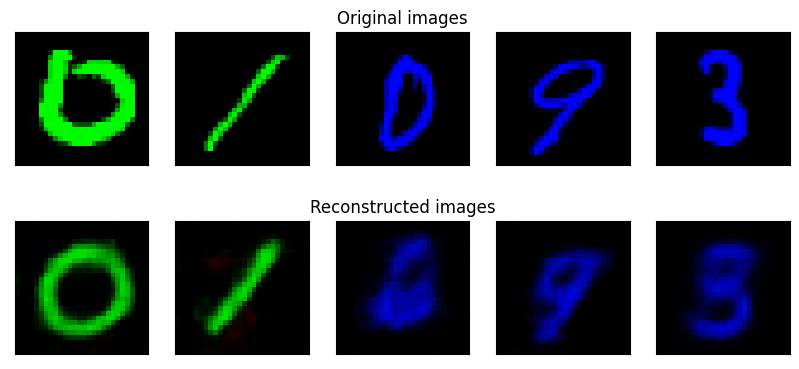


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:15<00:10,  5.24s/it]

	 partial train loss (single batch): 0.016247
	 partial train loss (single batch): 0.015828
	 partial train loss (single batch): 0.015991
	 partial train loss (single batch): 0.017281
	 partial train loss (single batch): 0.014383
	 partial train loss (single batch): 0.015356
	 partial train loss (single batch): 0.015828


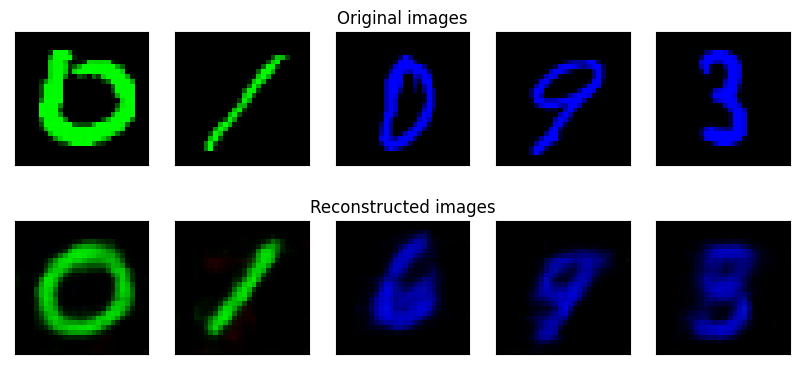


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.28s/it]

	 partial train loss (single batch): 0.016056
	 partial train loss (single batch): 0.015617
	 partial train loss (single batch): 0.015877
	 partial train loss (single batch): 0.017317
	 partial train loss (single batch): 0.014311
	 partial train loss (single batch): 0.015420
	 partial train loss (single batch): 0.015616


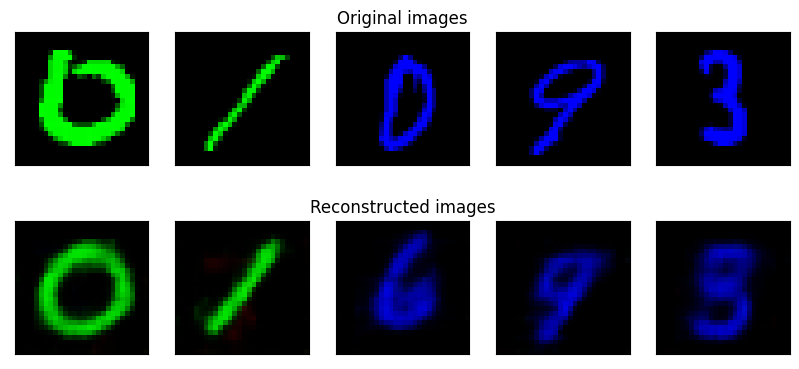


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:26<00:00,  5.28s/it]


RLACE


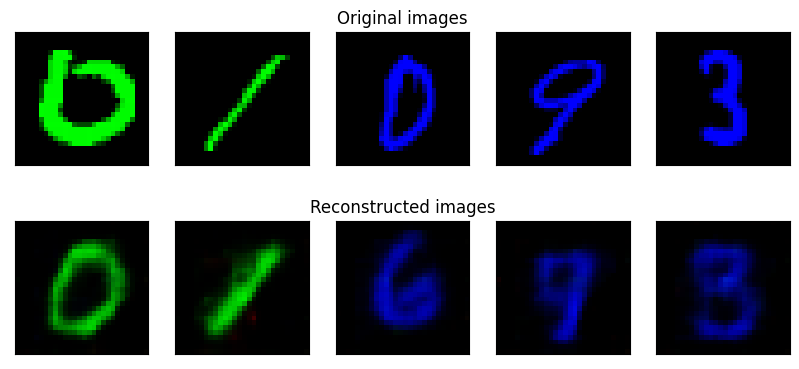

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.015897
	 partial train loss (single batch): 0.015747
	 partial train loss (single batch): 0.016098
	 partial train loss (single batch): 0.017366
	 partial train loss (single batch): 0.014118
	 partial train loss (single batch): 0.015218
	 partial train loss (single batch): 0.015803


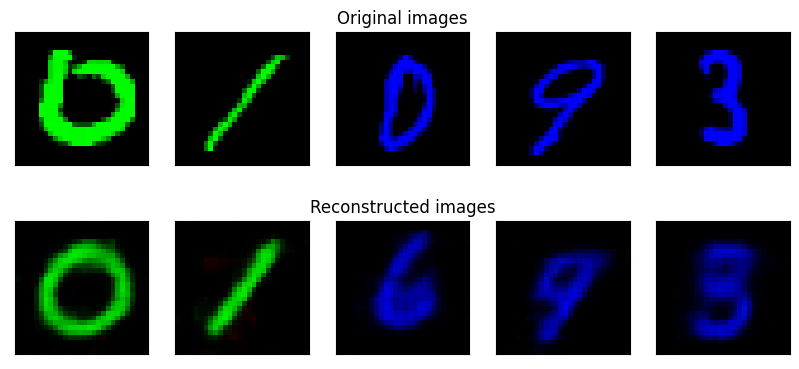


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:20,  5.25s/it]

	 partial train loss (single batch): 0.015682
	 partial train loss (single batch): 0.015355
	 partial train loss (single batch): 0.015885
	 partial train loss (single batch): 0.017048
	 partial train loss (single batch): 0.014277
	 partial train loss (single batch): 0.015105
	 partial train loss (single batch): 0.015670


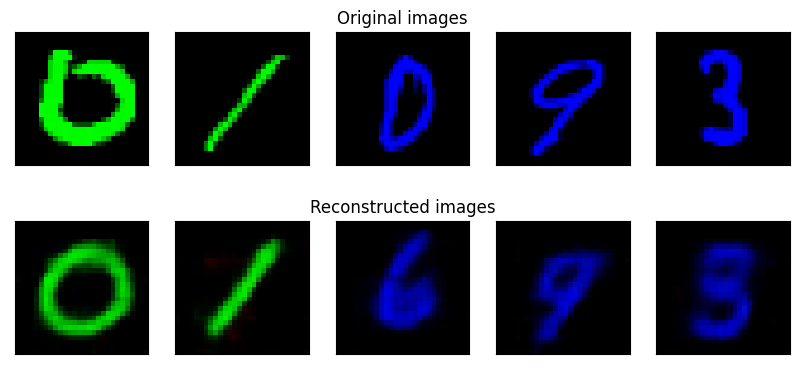


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:15,  5.25s/it]

	 partial train loss (single batch): 0.015623
	 partial train loss (single batch): 0.015140
	 partial train loss (single batch): 0.015983
	 partial train loss (single batch): 0.016804
	 partial train loss (single batch): 0.014250
	 partial train loss (single batch): 0.014962
	 partial train loss (single batch): 0.015490


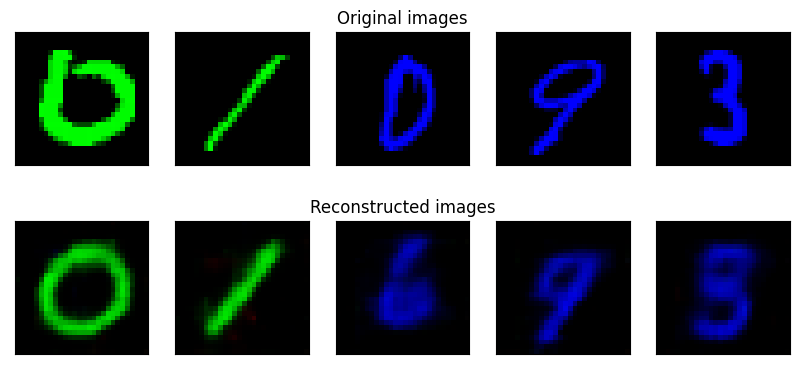


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:15<00:10,  5.31s/it]

	 partial train loss (single batch): 0.015444
	 partial train loss (single batch): 0.015420
	 partial train loss (single batch): 0.015580
	 partial train loss (single batch): 0.017119
	 partial train loss (single batch): 0.013888
	 partial train loss (single batch): 0.014989
	 partial train loss (single batch): 0.015341


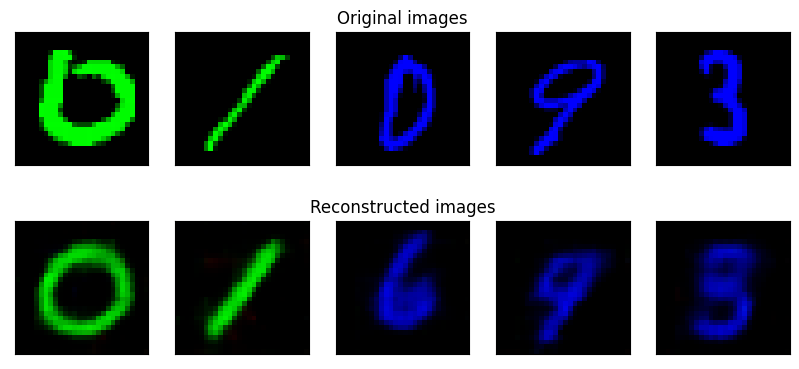


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.29s/it]

	 partial train loss (single batch): 0.015641
	 partial train loss (single batch): 0.015498
	 partial train loss (single batch): 0.015686
	 partial train loss (single batch): 0.016765
	 partial train loss (single batch): 0.013855
	 partial train loss (single batch): 0.014914
	 partial train loss (single batch): 0.015230


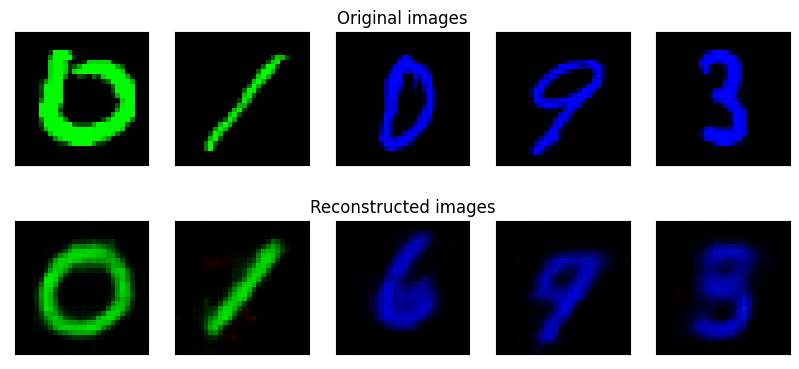


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:26<00:00,  5.30s/it]


RLACE


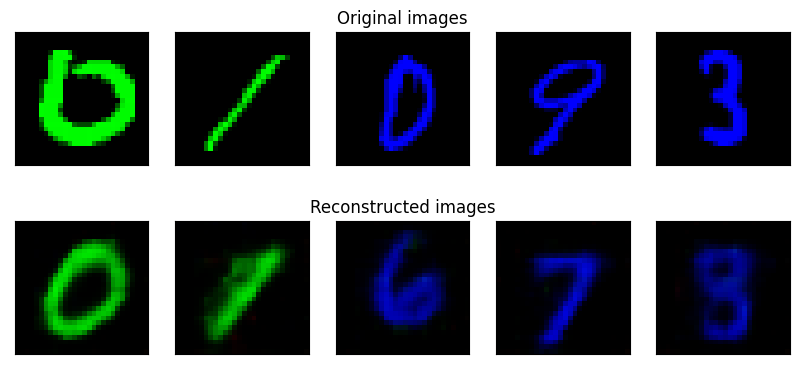

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.015651
	 partial train loss (single batch): 0.015426
	 partial train loss (single batch): 0.015599
	 partial train loss (single batch): 0.017220
	 partial train loss (single batch): 0.013786
	 partial train loss (single batch): 0.014922
	 partial train loss (single batch): 0.015095


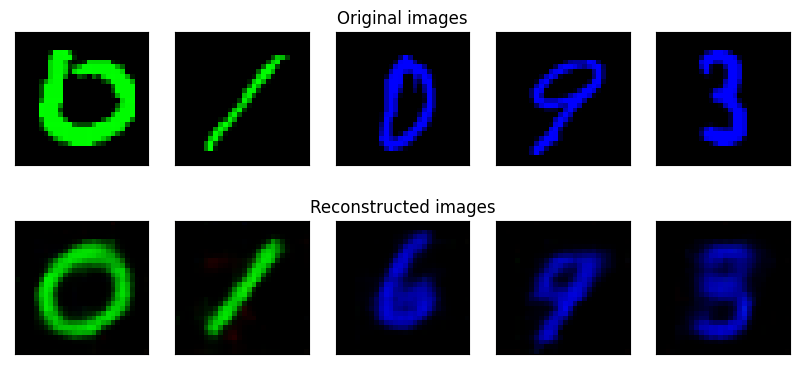


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.48s/it]

	 partial train loss (single batch): 0.015414
	 partial train loss (single batch): 0.015029
	 partial train loss (single batch): 0.015363
	 partial train loss (single batch): 0.016725
	 partial train loss (single batch): 0.013621
	 partial train loss (single batch): 0.014688
	 partial train loss (single batch): 0.015214


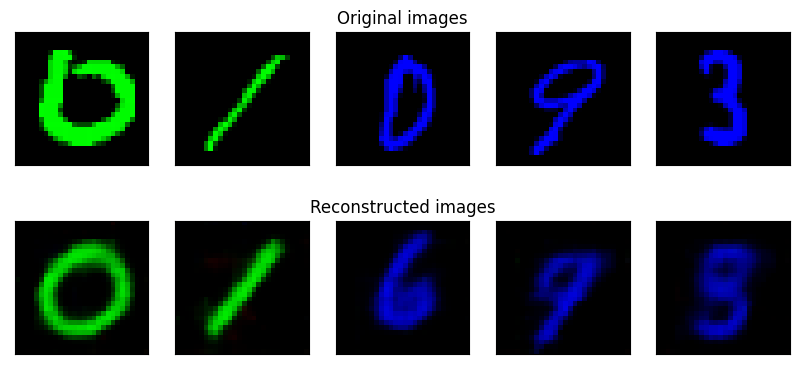


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.48s/it]

	 partial train loss (single batch): 0.015226
	 partial train loss (single batch): 0.015129
	 partial train loss (single batch): 0.015140
	 partial train loss (single batch): 0.016952
	 partial train loss (single batch): 0.013832
	 partial train loss (single batch): 0.014618
	 partial train loss (single batch): 0.015005


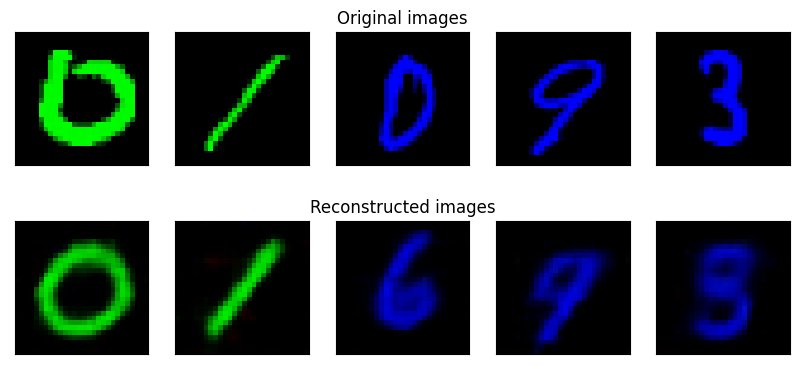


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.54s/it]

	 partial train loss (single batch): 0.015222
	 partial train loss (single batch): 0.015409
	 partial train loss (single batch): 0.015261
	 partial train loss (single batch): 0.016671
	 partial train loss (single batch): 0.013505
	 partial train loss (single batch): 0.014635
	 partial train loss (single batch): 0.014958


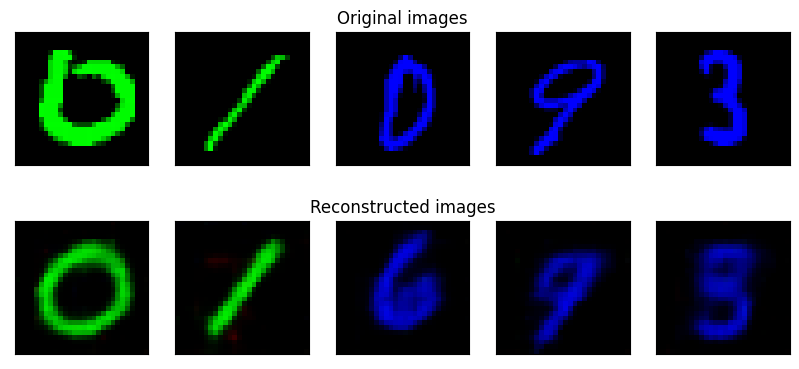


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.52s/it]

	 partial train loss (single batch): 0.015013
	 partial train loss (single batch): 0.015114
	 partial train loss (single batch): 0.015523
	 partial train loss (single batch): 0.016838
	 partial train loss (single batch): 0.013658
	 partial train loss (single batch): 0.014611
	 partial train loss (single batch): 0.015133


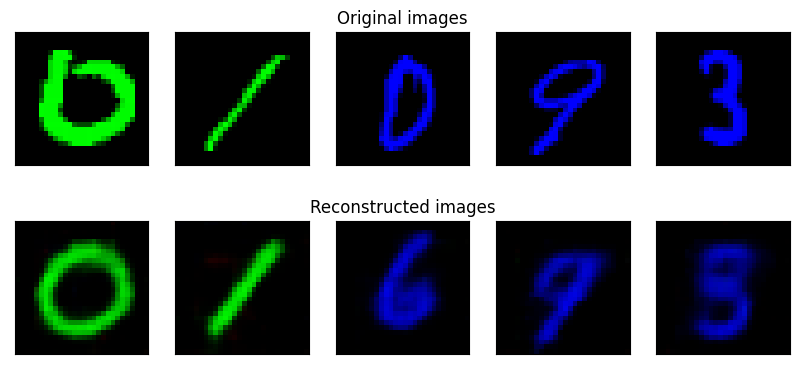


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.51s/it]


RLACE


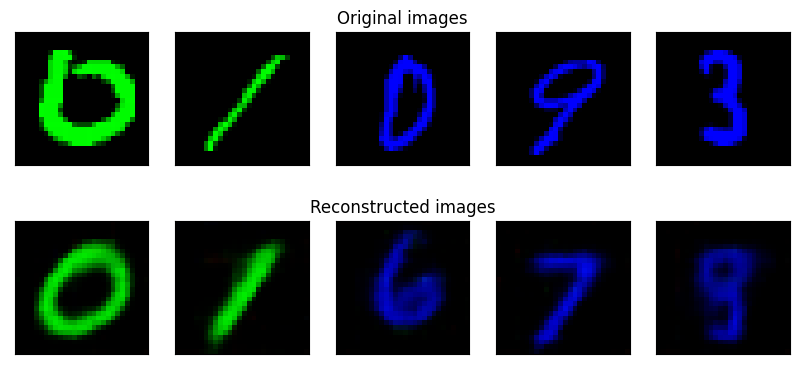

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.015252
	 partial train loss (single batch): 0.014782
	 partial train loss (single batch): 0.015223
	 partial train loss (single batch): 0.016771
	 partial train loss (single batch): 0.013765
	 partial train loss (single batch): 0.014789
	 partial train loss (single batch): 0.015036


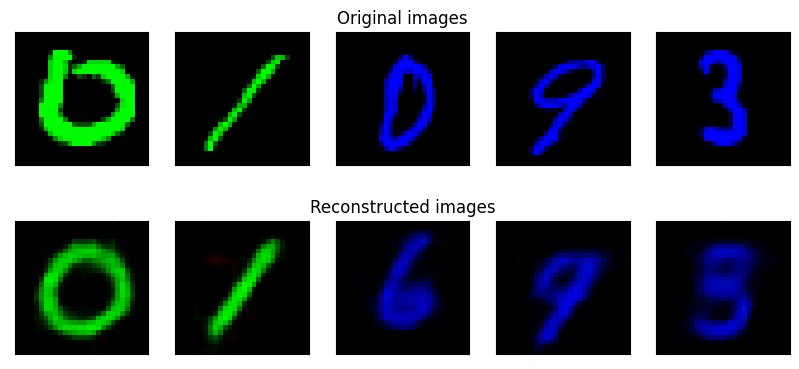


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.47s/it]

	 partial train loss (single batch): 0.015102
	 partial train loss (single batch): 0.014732
	 partial train loss (single batch): 0.015060
	 partial train loss (single batch): 0.016582
	 partial train loss (single batch): 0.013398
	 partial train loss (single batch): 0.014848
	 partial train loss (single batch): 0.015076


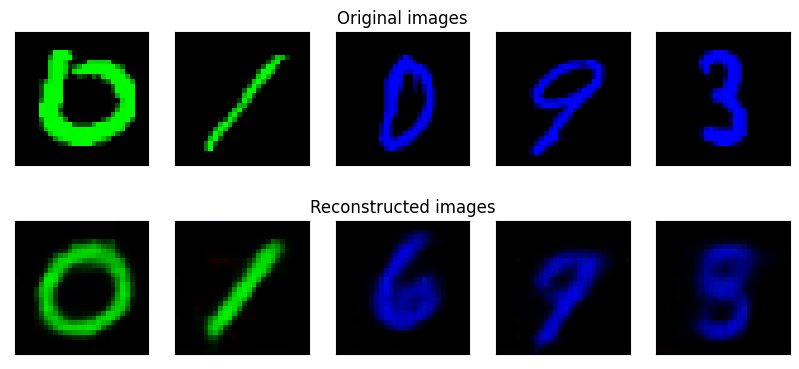


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.47s/it]

	 partial train loss (single batch): 0.015122
	 partial train loss (single batch): 0.014891
	 partial train loss (single batch): 0.015209
	 partial train loss (single batch): 0.016645
	 partial train loss (single batch): 0.013342
	 partial train loss (single batch): 0.014482
	 partial train loss (single batch): 0.015094


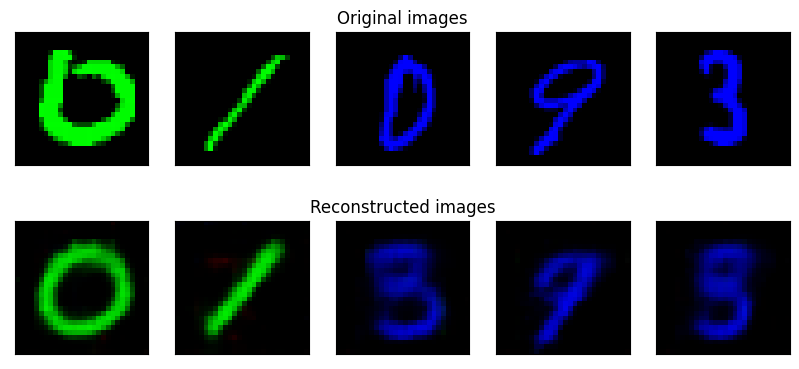


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.53s/it]

	 partial train loss (single batch): 0.015191
	 partial train loss (single batch): 0.015102
	 partial train loss (single batch): 0.015383
	 partial train loss (single batch): 0.016662
	 partial train loss (single batch): 0.013177
	 partial train loss (single batch): 0.014709
	 partial train loss (single batch): 0.014913


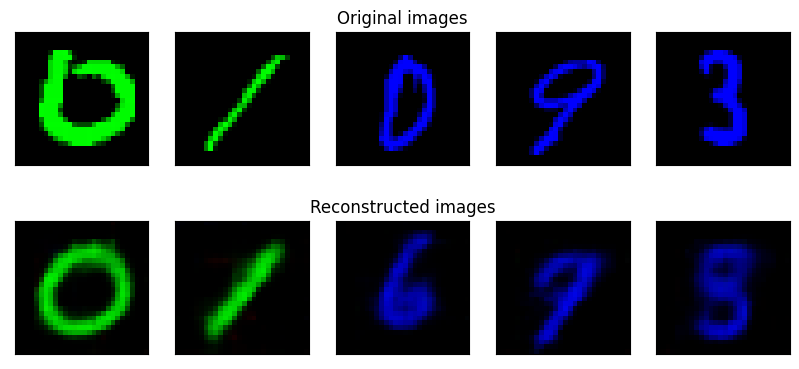


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.51s/it]

	 partial train loss (single batch): 0.015451
	 partial train loss (single batch): 0.015196
	 partial train loss (single batch): 0.015076
	 partial train loss (single batch): 0.016760
	 partial train loss (single batch): 0.013058
	 partial train loss (single batch): 0.014426
	 partial train loss (single batch): 0.015132


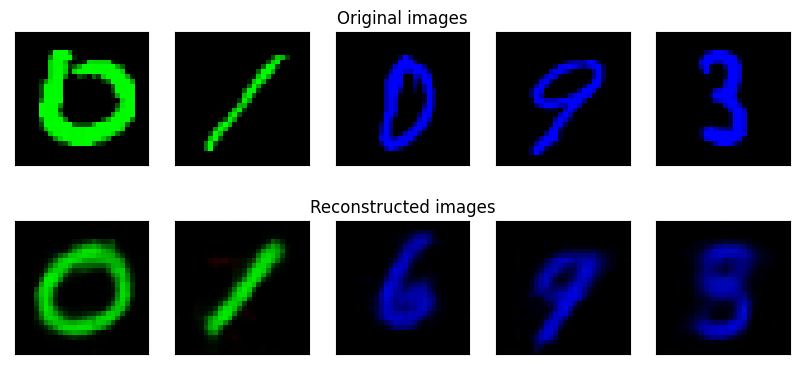


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.50s/it]


RLACE


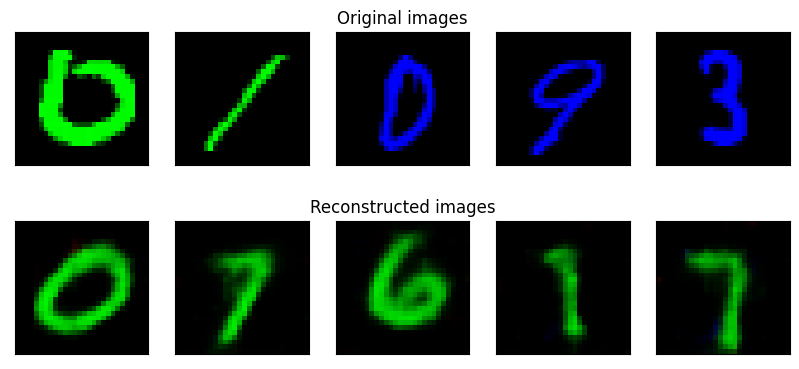

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.015397
	 partial train loss (single batch): 0.014863
	 partial train loss (single batch): 0.015418
	 partial train loss (single batch): 0.016471
	 partial train loss (single batch): 0.013073
	 partial train loss (single batch): 0.014583
	 partial train loss (single batch): 0.015010


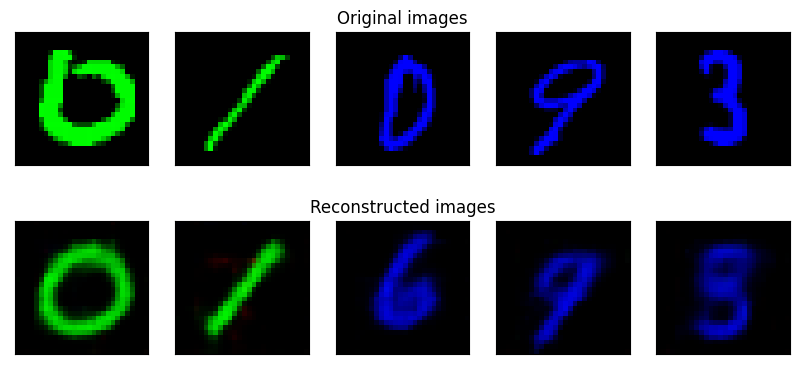


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.59s/it]

	 partial train loss (single batch): 0.014941
	 partial train loss (single batch): 0.014882
	 partial train loss (single batch): 0.014926
	 partial train loss (single batch): 0.016424
	 partial train loss (single batch): 0.013266
	 partial train loss (single batch): 0.014480
	 partial train loss (single batch): 0.014822


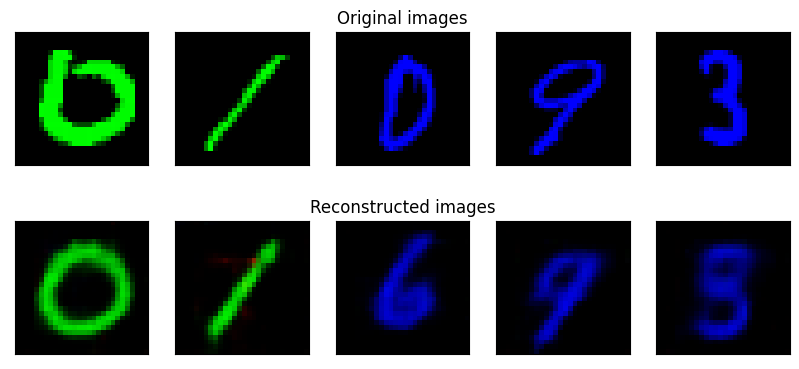


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.61s/it]

	 partial train loss (single batch): 0.014935
	 partial train loss (single batch): 0.014463
	 partial train loss (single batch): 0.015257
	 partial train loss (single batch): 0.016951
	 partial train loss (single batch): 0.013103
	 partial train loss (single batch): 0.014488
	 partial train loss (single batch): 0.014788


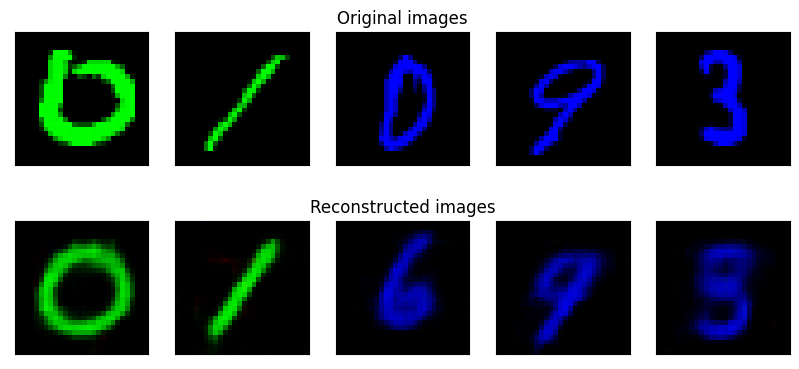


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.58s/it]

	 partial train loss (single batch): 0.014821
	 partial train loss (single batch): 0.014533
	 partial train loss (single batch): 0.014758
	 partial train loss (single batch): 0.016311
	 partial train loss (single batch): 0.013167
	 partial train loss (single batch): 0.014485
	 partial train loss (single batch): 0.014809


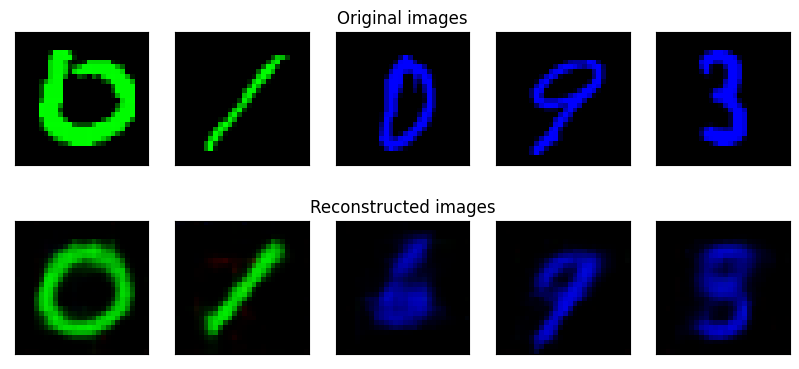


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.56s/it]

	 partial train loss (single batch): 0.014777
	 partial train loss (single batch): 0.014636
	 partial train loss (single batch): 0.015256
	 partial train loss (single batch): 0.016449
	 partial train loss (single batch): 0.013165
	 partial train loss (single batch): 0.014253
	 partial train loss (single batch): 0.014985


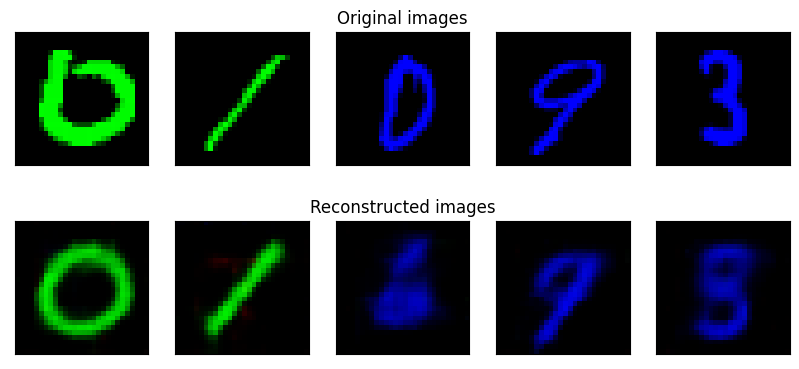


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:28<00:00,  5.62s/it]


RLACE


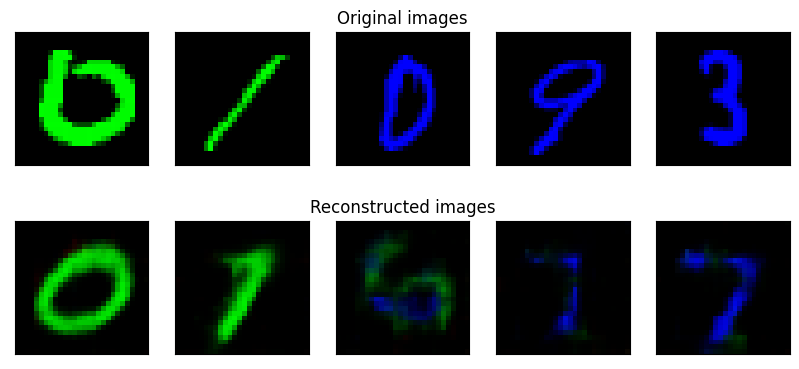

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.015065
	 partial train loss (single batch): 0.014950
	 partial train loss (single batch): 0.014974
	 partial train loss (single batch): 0.016335
	 partial train loss (single batch): 0.012950
	 partial train loss (single batch): 0.014406
	 partial train loss (single batch): 0.014604


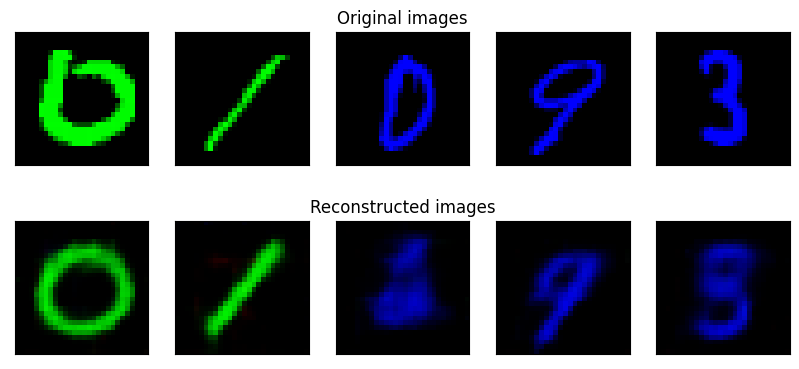


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.62s/it]

	 partial train loss (single batch): 0.014540
	 partial train loss (single batch): 0.014906
	 partial train loss (single batch): 0.014736
	 partial train loss (single batch): 0.016298
	 partial train loss (single batch): 0.013096
	 partial train loss (single batch): 0.014242
	 partial train loss (single batch): 0.014849


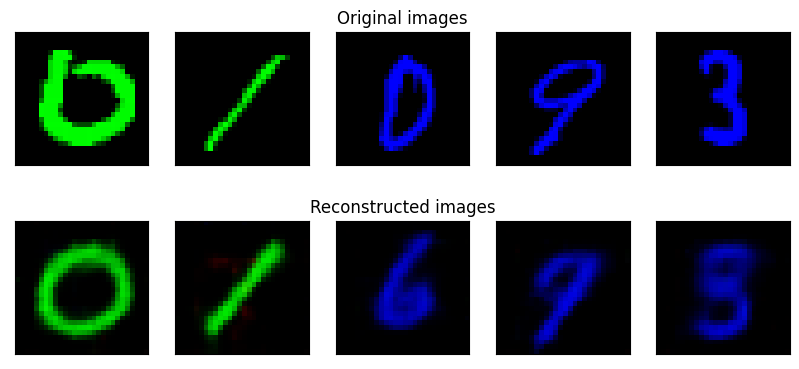


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.56s/it]

	 partial train loss (single batch): 0.014850
	 partial train loss (single batch): 0.014989
	 partial train loss (single batch): 0.014860
	 partial train loss (single batch): 0.016190
	 partial train loss (single batch): 0.012875
	 partial train loss (single batch): 0.014348
	 partial train loss (single batch): 0.014722


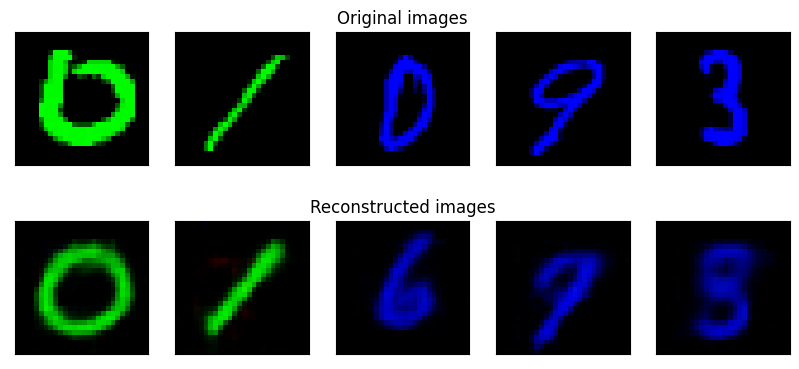


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.52s/it]

	 partial train loss (single batch): 0.014954
	 partial train loss (single batch): 0.014448
	 partial train loss (single batch): 0.014915
	 partial train loss (single batch): 0.016381
	 partial train loss (single batch): 0.013227
	 partial train loss (single batch): 0.014303
	 partial train loss (single batch): 0.014768


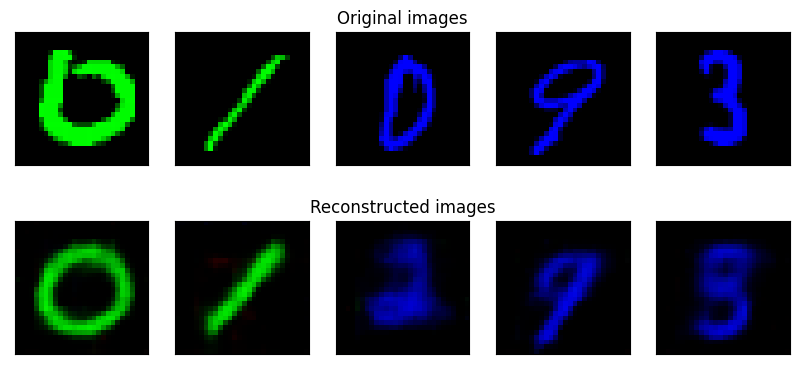


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.54s/it]

	 partial train loss (single batch): 0.014643
	 partial train loss (single batch): 0.014470
	 partial train loss (single batch): 0.014995
	 partial train loss (single batch): 0.016149
	 partial train loss (single batch): 0.013045
	 partial train loss (single batch): 0.014126
	 partial train loss (single batch): 0.014810


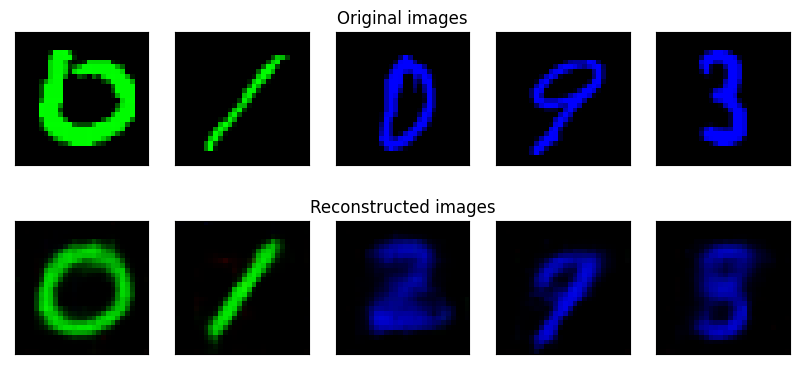


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.54s/it]


RLACE


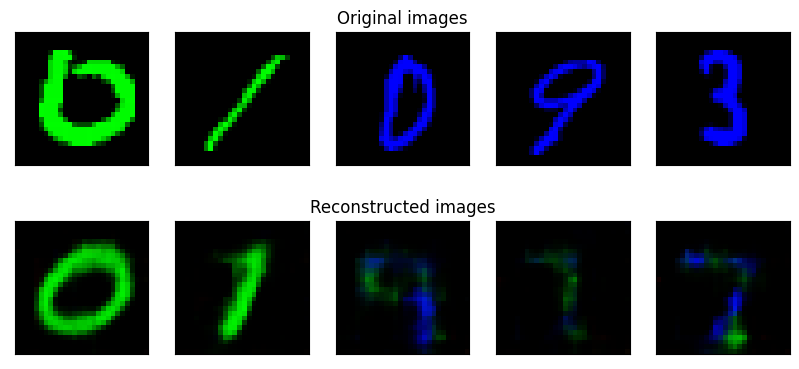

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.014852
	 partial train loss (single batch): 0.014480
	 partial train loss (single batch): 0.015091
	 partial train loss (single batch): 0.016250
	 partial train loss (single batch): 0.012867
	 partial train loss (single batch): 0.014244
	 partial train loss (single batch): 0.014539


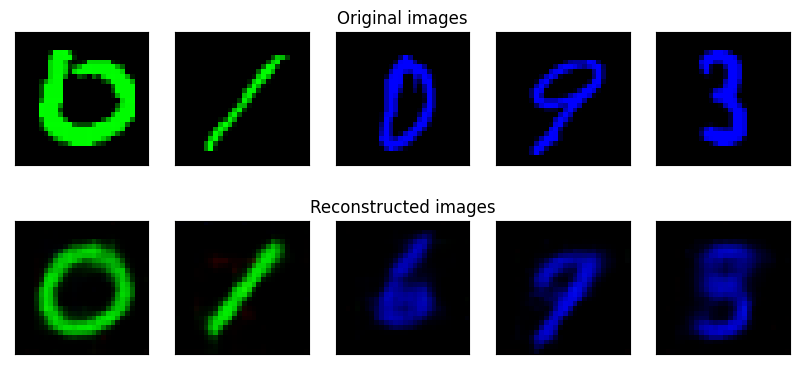


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.48s/it]

	 partial train loss (single batch): 0.014729
	 partial train loss (single batch): 0.014251
	 partial train loss (single batch): 0.014927
	 partial train loss (single batch): 0.016328
	 partial train loss (single batch): 0.013442
	 partial train loss (single batch): 0.014163
	 partial train loss (single batch): 0.014868


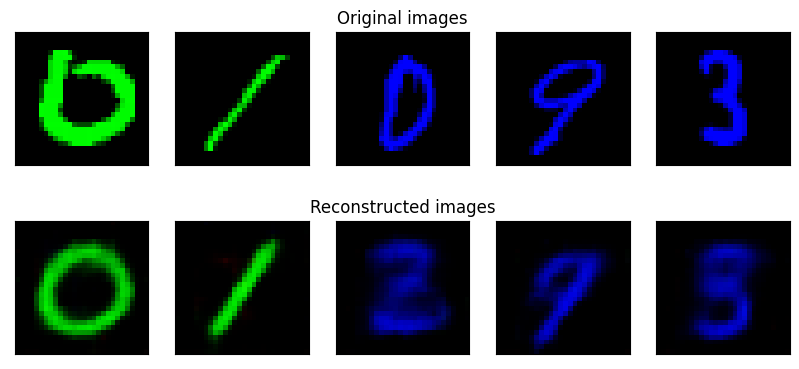


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.47s/it]

	 partial train loss (single batch): 0.014618
	 partial train loss (single batch): 0.014385
	 partial train loss (single batch): 0.014738
	 partial train loss (single batch): 0.016361
	 partial train loss (single batch): 0.012801
	 partial train loss (single batch): 0.014057
	 partial train loss (single batch): 0.014737


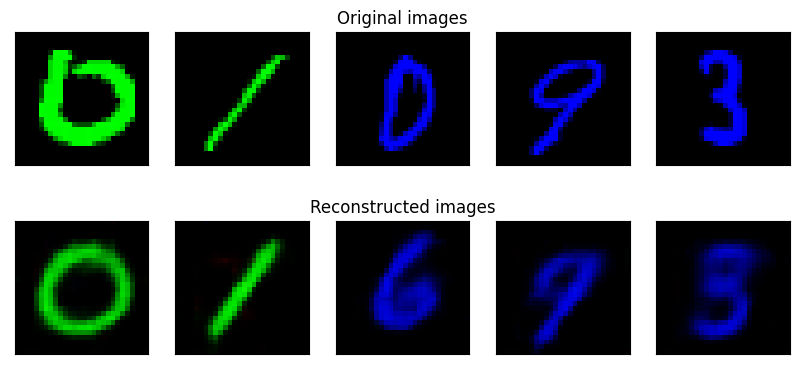


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.47s/it]

	 partial train loss (single batch): 0.014688
	 partial train loss (single batch): 0.014631
	 partial train loss (single batch): 0.014747
	 partial train loss (single batch): 0.016619
	 partial train loss (single batch): 0.012708
	 partial train loss (single batch): 0.013969
	 partial train loss (single batch): 0.014606


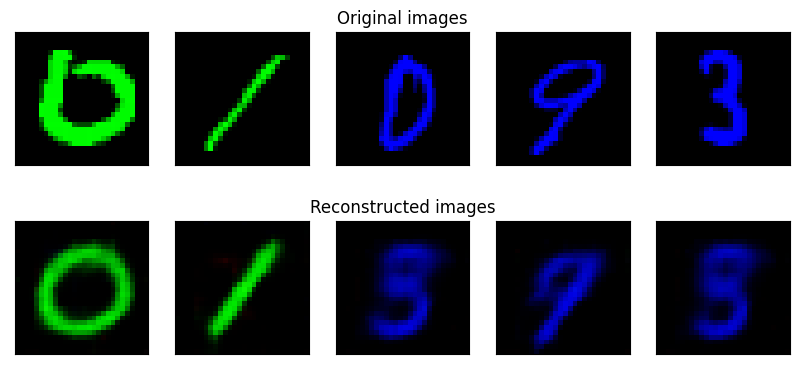


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.51s/it]

	 partial train loss (single batch): 0.014494
	 partial train loss (single batch): 0.014508
	 partial train loss (single batch): 0.014955
	 partial train loss (single batch): 0.016196
	 partial train loss (single batch): 0.012805
	 partial train loss (single batch): 0.014010
	 partial train loss (single batch): 0.014410


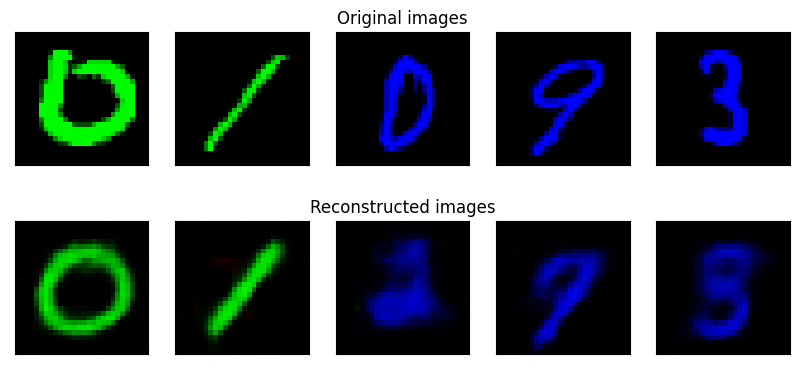


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.49s/it]


RLACE


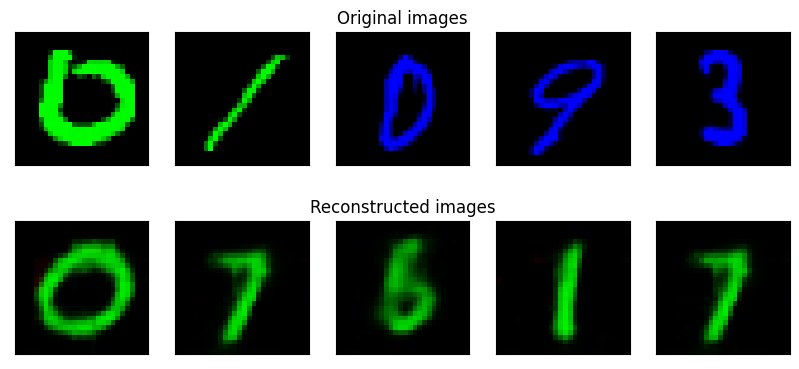

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.019434
	 partial train loss (single batch): 0.016411
	 partial train loss (single batch): 0.015746
	 partial train loss (single batch): 0.016929
	 partial train loss (single batch): 0.013440
	 partial train loss (single batch): 0.014349
	 partial train loss (single batch): 0.014636


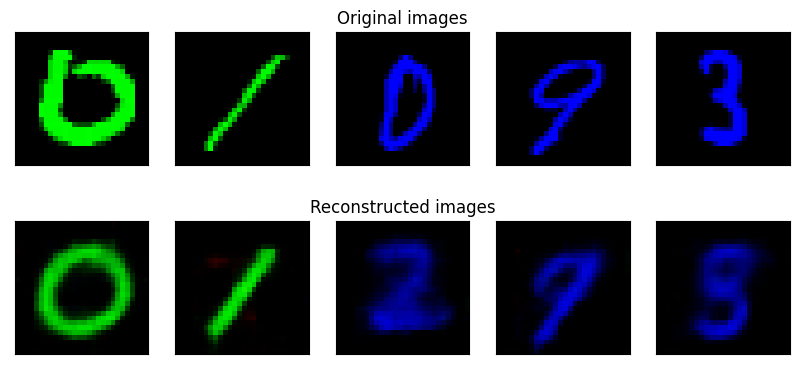


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.48s/it]

	 partial train loss (single batch): 0.014880
	 partial train loss (single batch): 0.014739
	 partial train loss (single batch): 0.014969
	 partial train loss (single batch): 0.016654
	 partial train loss (single batch): 0.013097
	 partial train loss (single batch): 0.014214
	 partial train loss (single batch): 0.014461


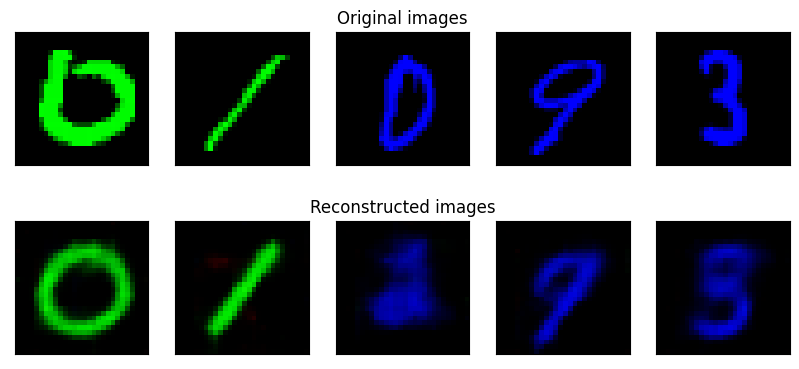


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.47s/it]

	 partial train loss (single batch): 0.014702
	 partial train loss (single batch): 0.014588
	 partial train loss (single batch): 0.015159
	 partial train loss (single batch): 0.016327
	 partial train loss (single batch): 0.012959
	 partial train loss (single batch): 0.014166
	 partial train loss (single batch): 0.014667


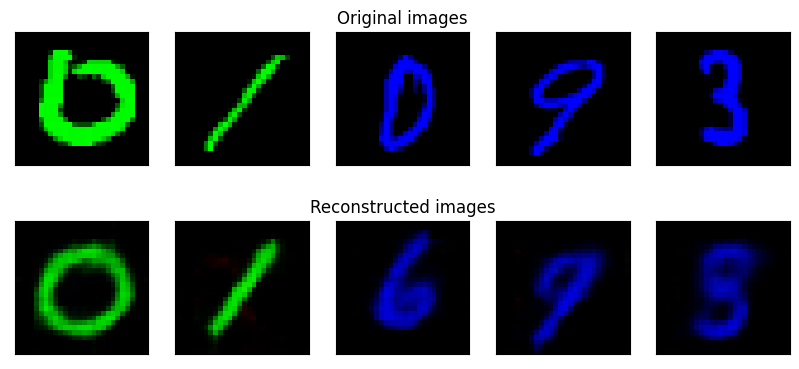


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.53s/it]

	 partial train loss (single batch): 0.015043
	 partial train loss (single batch): 0.014484
	 partial train loss (single batch): 0.015033
	 partial train loss (single batch): 0.016138
	 partial train loss (single batch): 0.012729
	 partial train loss (single batch): 0.014252
	 partial train loss (single batch): 0.014576


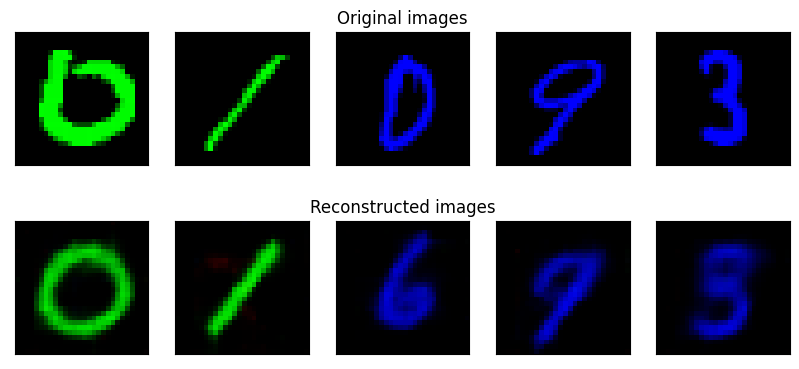


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.53s/it]

	 partial train loss (single batch): 0.014770
	 partial train loss (single batch): 0.014876
	 partial train loss (single batch): 0.014524
	 partial train loss (single batch): 0.016438
	 partial train loss (single batch): 0.012847
	 partial train loss (single batch): 0.014000
	 partial train loss (single batch): 0.014580


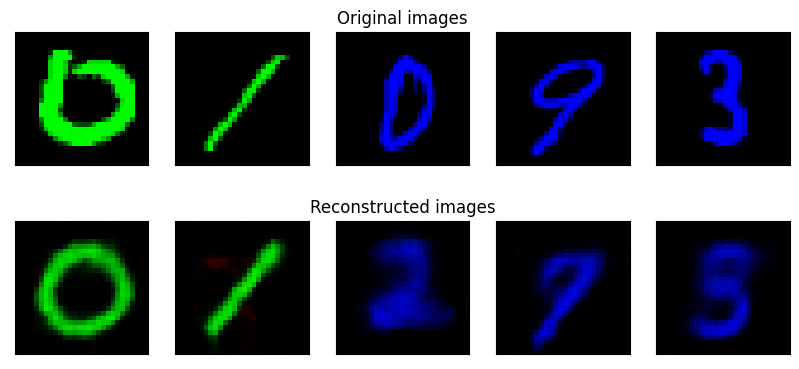


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.52s/it]


RLACE


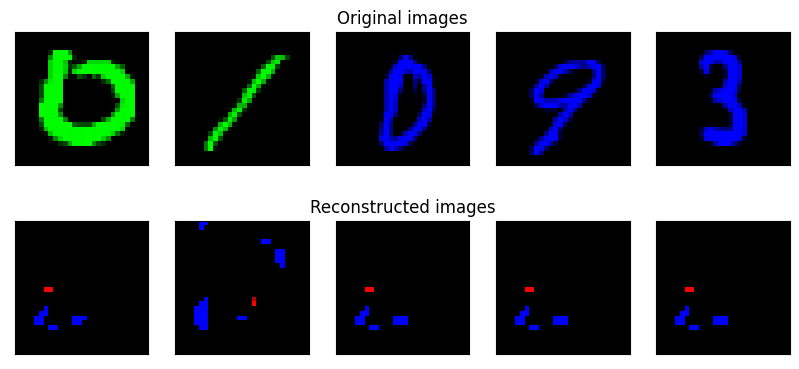

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033561
	 partial train loss (single batch): 0.029370
	 partial train loss (single batch): 0.030505
	 partial train loss (single batch): 0.030871
	 partial train loss (single batch): 0.024112
	 partial train loss (single batch): 0.019188
	 partial train loss (single batch): 0.018840


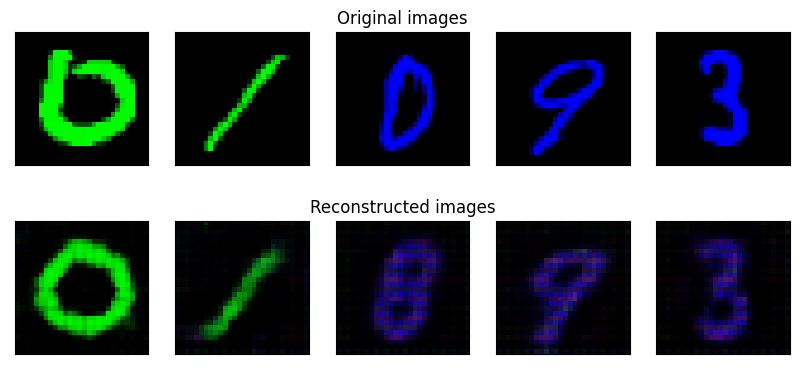


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.50s/it]

	 partial train loss (single batch): 0.011874
	 partial train loss (single batch): 0.010540
	 partial train loss (single batch): 0.011086
	 partial train loss (single batch): 0.012295
	 partial train loss (single batch): 0.008900
	 partial train loss (single batch): 0.009202
	 partial train loss (single batch): 0.010819


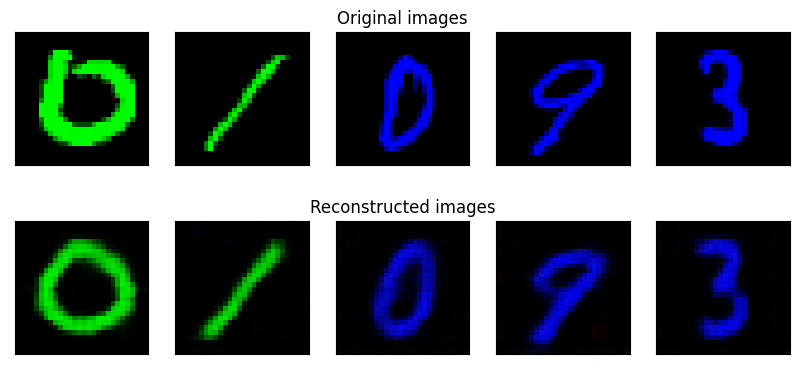


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.50s/it]

	 partial train loss (single batch): 0.009807
	 partial train loss (single batch): 0.009177
	 partial train loss (single batch): 0.010079
	 partial train loss (single batch): 0.010917
	 partial train loss (single batch): 0.008221
	 partial train loss (single batch): 0.008645
	 partial train loss (single batch): 0.010000


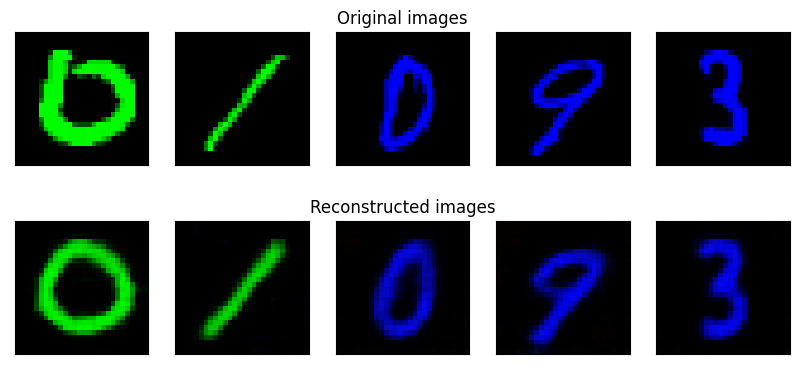


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.62s/it]

	 partial train loss (single batch): 0.009352
	 partial train loss (single batch): 0.008634
	 partial train loss (single batch): 0.009633
	 partial train loss (single batch): 0.010359
	 partial train loss (single batch): 0.007980
	 partial train loss (single batch): 0.008233
	 partial train loss (single batch): 0.009652


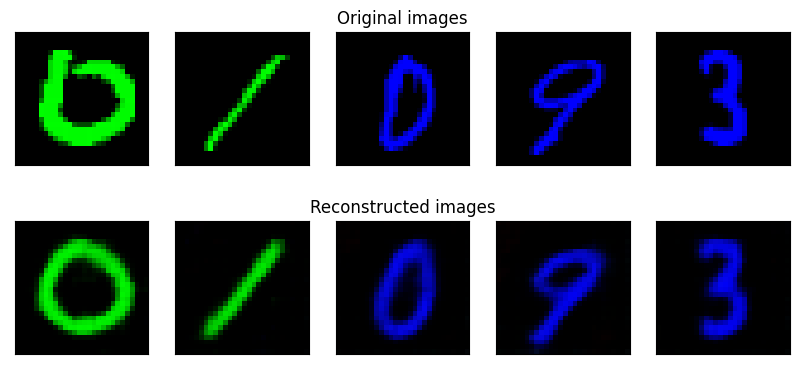


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.58s/it]

	 partial train loss (single batch): 0.009066
	 partial train loss (single batch): 0.008231
	 partial train loss (single batch): 0.009272
	 partial train loss (single batch): 0.010194
	 partial train loss (single batch): 0.007894
	 partial train loss (single batch): 0.007979
	 partial train loss (single batch): 0.009306


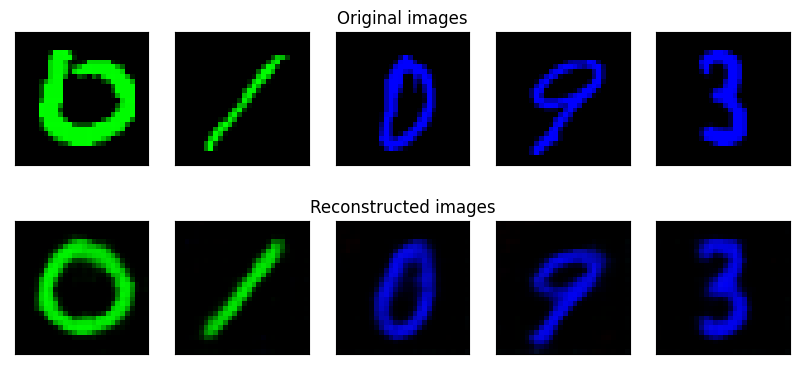


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.56s/it]


RLACE


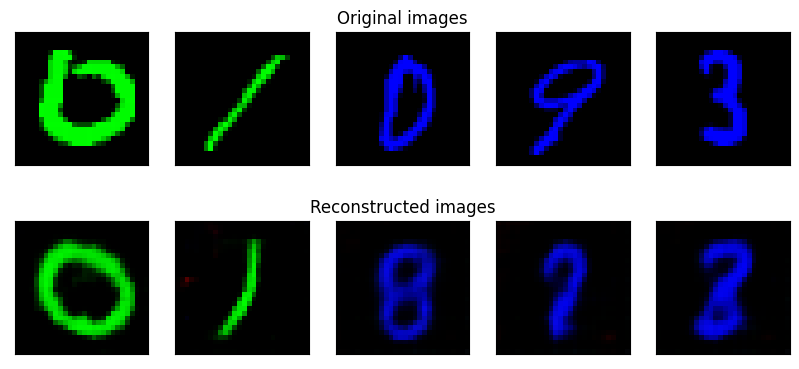

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.013873
	 partial train loss (single batch): 0.013271
	 partial train loss (single batch): 0.013131
	 partial train loss (single batch): 0.013802
	 partial train loss (single batch): 0.011595
	 partial train loss (single batch): 0.011290
	 partial train loss (single batch): 0.012777


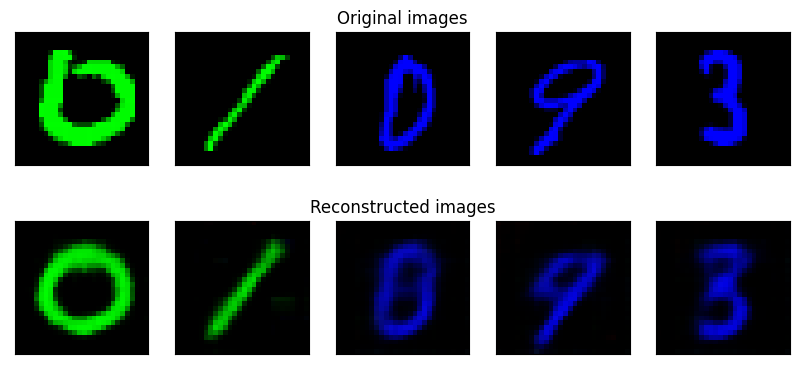


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.48s/it]

	 partial train loss (single batch): 0.012530
	 partial train loss (single batch): 0.011955
	 partial train loss (single batch): 0.011736
	 partial train loss (single batch): 0.013347
	 partial train loss (single batch): 0.010603
	 partial train loss (single batch): 0.010407
	 partial train loss (single batch): 0.012139


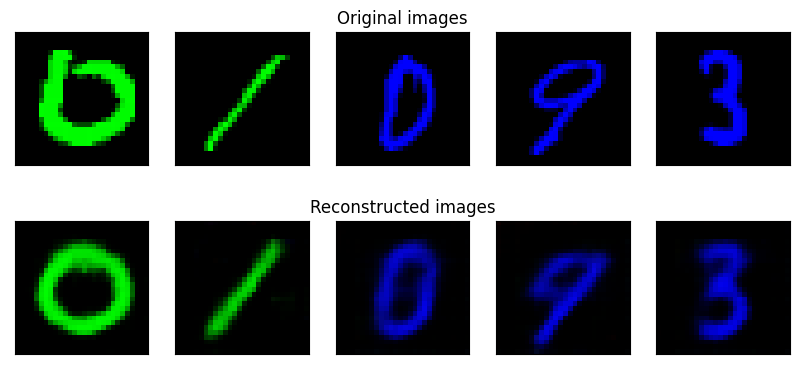


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.46s/it]

	 partial train loss (single batch): 0.012103
	 partial train loss (single batch): 0.011349
	 partial train loss (single batch): 0.011326
	 partial train loss (single batch): 0.012920
	 partial train loss (single batch): 0.009997
	 partial train loss (single batch): 0.010167
	 partial train loss (single batch): 0.011711


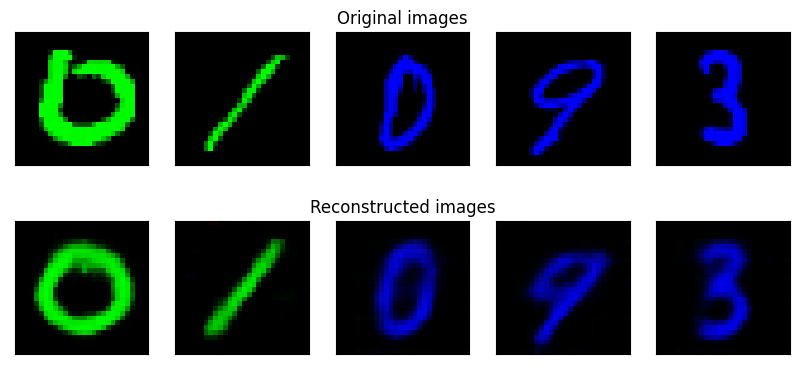


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.53s/it]

	 partial train loss (single batch): 0.012201
	 partial train loss (single batch): 0.010971
	 partial train loss (single batch): 0.011136
	 partial train loss (single batch): 0.012568
	 partial train loss (single batch): 0.009752
	 partial train loss (single batch): 0.010085
	 partial train loss (single batch): 0.011405


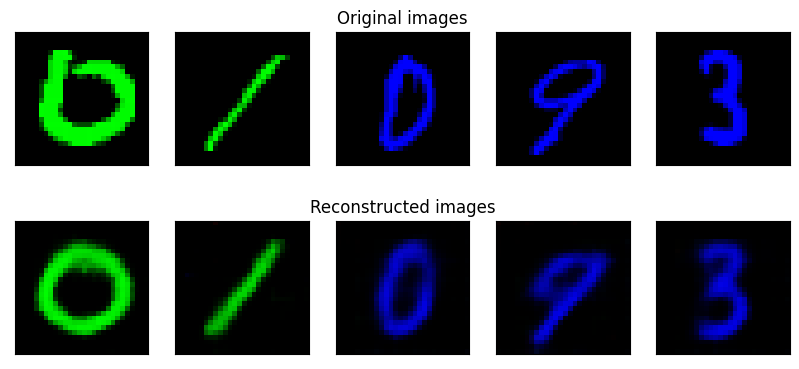


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.51s/it]

	 partial train loss (single batch): 0.012021
	 partial train loss (single batch): 0.010837
	 partial train loss (single batch): 0.011161
	 partial train loss (single batch): 0.012490
	 partial train loss (single batch): 0.009711
	 partial train loss (single batch): 0.009894
	 partial train loss (single batch): 0.011108


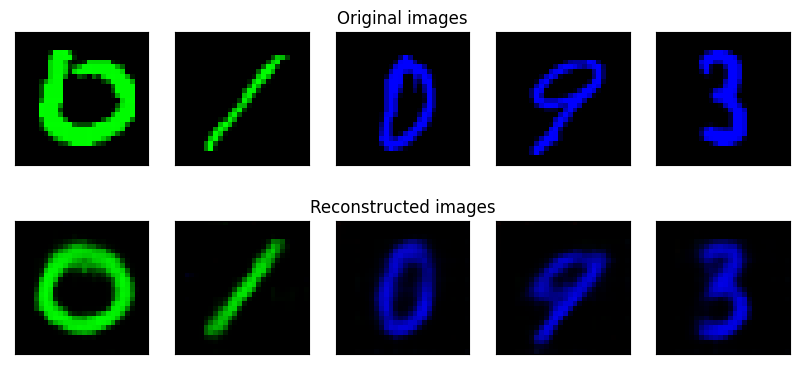


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.50s/it]


RLACE


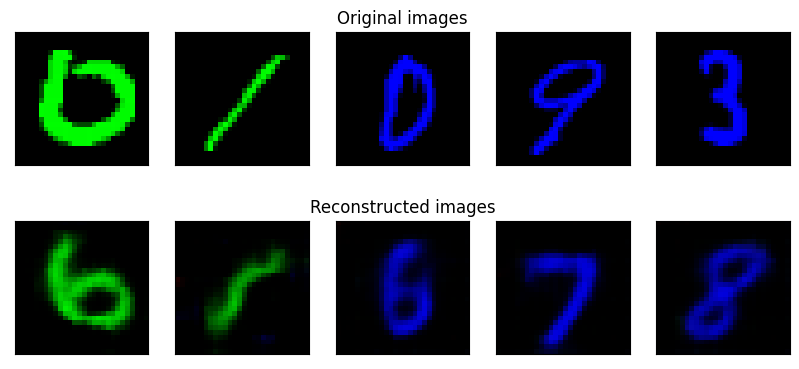

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.013624
	 partial train loss (single batch): 0.012050
	 partial train loss (single batch): 0.012453
	 partial train loss (single batch): 0.013554
	 partial train loss (single batch): 0.010244
	 partial train loss (single batch): 0.010969
	 partial train loss (single batch): 0.012051


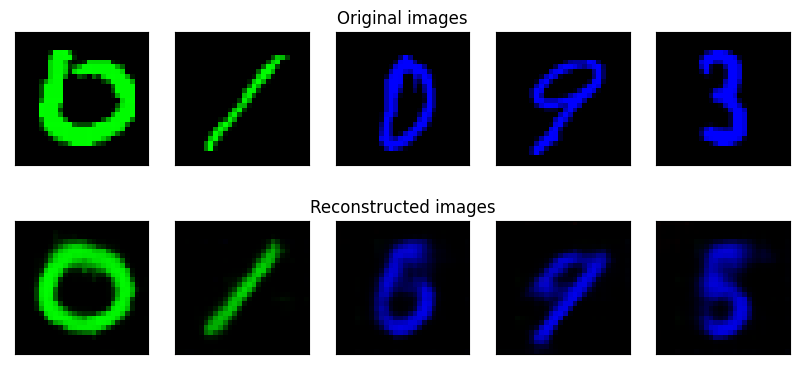


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.58s/it]

	 partial train loss (single batch): 0.012335
	 partial train loss (single batch): 0.011045
	 partial train loss (single batch): 0.011606
	 partial train loss (single batch): 0.012737
	 partial train loss (single batch): 0.009809
	 partial train loss (single batch): 0.010666
	 partial train loss (single batch): 0.011570


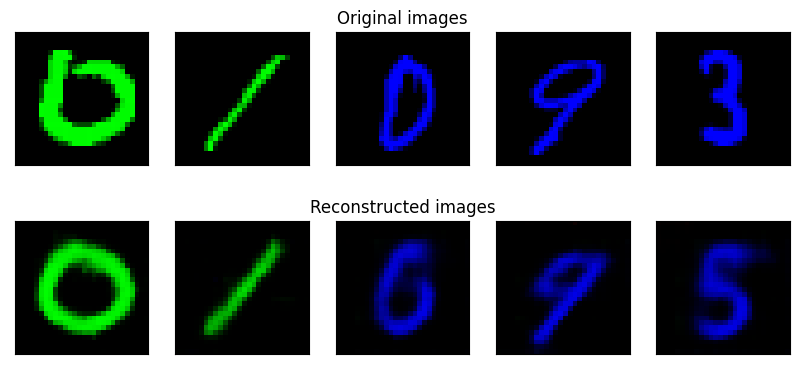


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.59s/it]

	 partial train loss (single batch): 0.011860
	 partial train loss (single batch): 0.010618
	 partial train loss (single batch): 0.011228
	 partial train loss (single batch): 0.012554
	 partial train loss (single batch): 0.009623
	 partial train loss (single batch): 0.010432
	 partial train loss (single batch): 0.011297


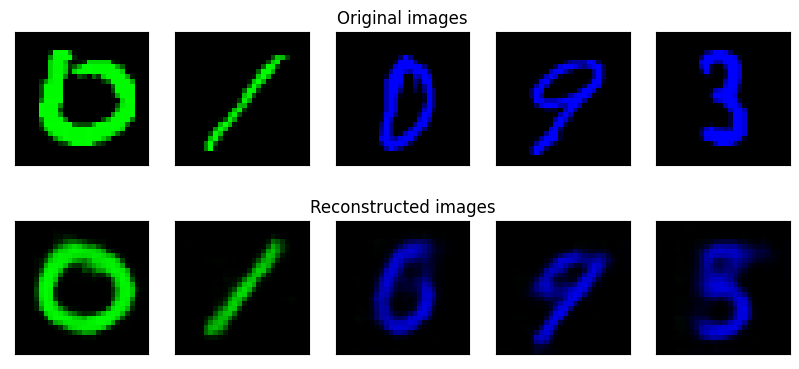


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.54s/it]

	 partial train loss (single batch): 0.011756
	 partial train loss (single batch): 0.010256
	 partial train loss (single batch): 0.011055
	 partial train loss (single batch): 0.012568
	 partial train loss (single batch): 0.009605
	 partial train loss (single batch): 0.010073
	 partial train loss (single batch): 0.011234


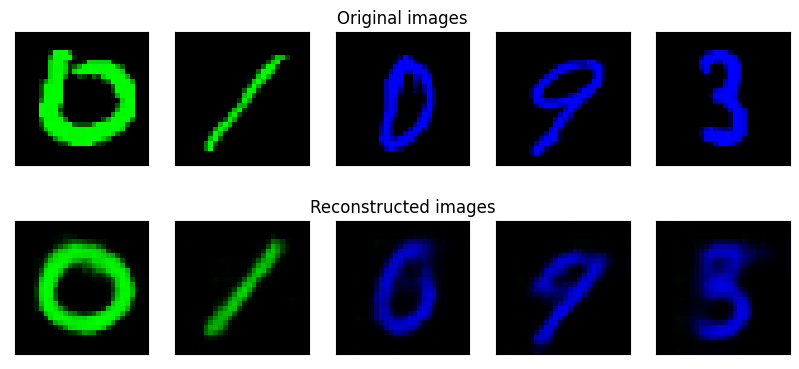


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.51s/it]

	 partial train loss (single batch): 0.011489
	 partial train loss (single batch): 0.010111
	 partial train loss (single batch): 0.010925
	 partial train loss (single batch): 0.012140
	 partial train loss (single batch): 0.009391
	 partial train loss (single batch): 0.009939
	 partial train loss (single batch): 0.011159


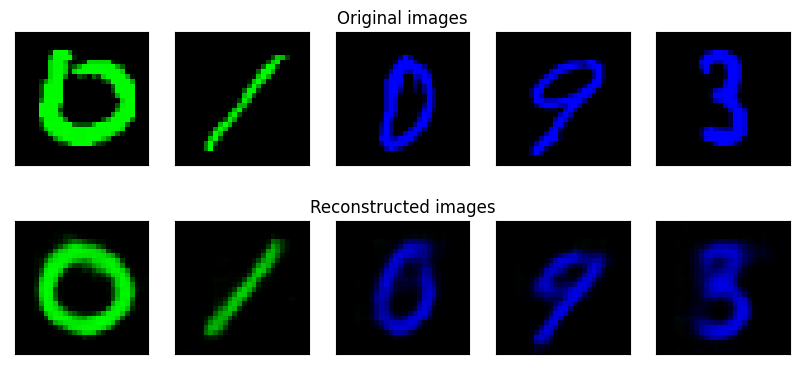


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.55s/it]


RLACE


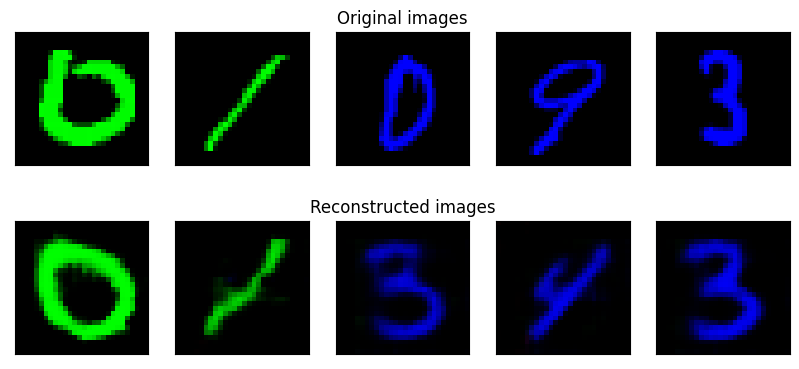

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.012443
	 partial train loss (single batch): 0.011425
	 partial train loss (single batch): 0.011137
	 partial train loss (single batch): 0.012266
	 partial train loss (single batch): 0.009741
	 partial train loss (single batch): 0.010079
	 partial train loss (single batch): 0.011936


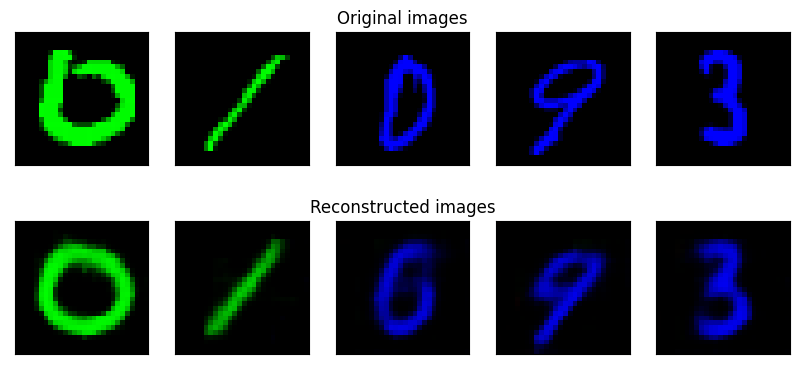


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.61s/it]

	 partial train loss (single batch): 0.011870
	 partial train loss (single batch): 0.010638
	 partial train loss (single batch): 0.010733
	 partial train loss (single batch): 0.011906
	 partial train loss (single batch): 0.009599
	 partial train loss (single batch): 0.009966
	 partial train loss (single batch): 0.011590


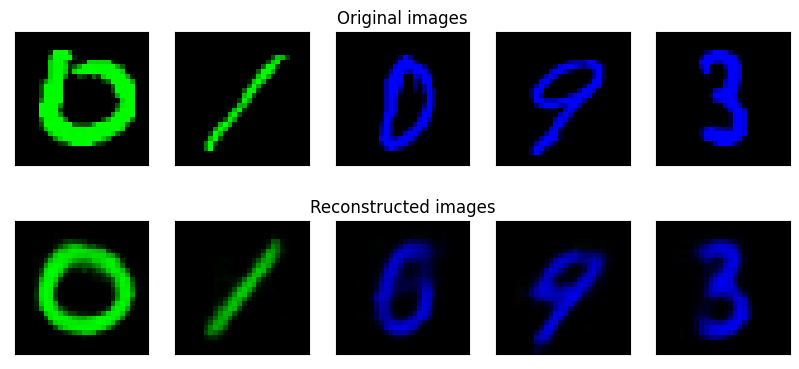


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.55s/it]

	 partial train loss (single batch): 0.011759
	 partial train loss (single batch): 0.010518
	 partial train loss (single batch): 0.010598
	 partial train loss (single batch): 0.011837
	 partial train loss (single batch): 0.009557
	 partial train loss (single batch): 0.009937
	 partial train loss (single batch): 0.011271


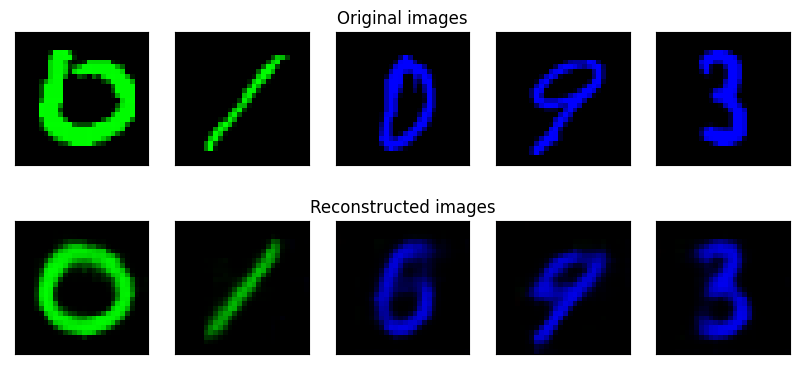


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.52s/it]

	 partial train loss (single batch): 0.011421
	 partial train loss (single batch): 0.010478
	 partial train loss (single batch): 0.010544
	 partial train loss (single batch): 0.011745
	 partial train loss (single batch): 0.009480
	 partial train loss (single batch): 0.009812
	 partial train loss (single batch): 0.011099


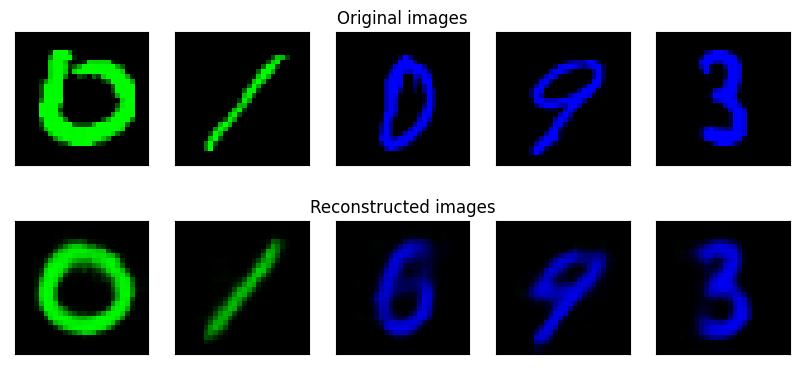


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.57s/it]

	 partial train loss (single batch): 0.011360
	 partial train loss (single batch): 0.010558
	 partial train loss (single batch): 0.010416
	 partial train loss (single batch): 0.011747
	 partial train loss (single batch): 0.009301
	 partial train loss (single batch): 0.009759
	 partial train loss (single batch): 0.011100


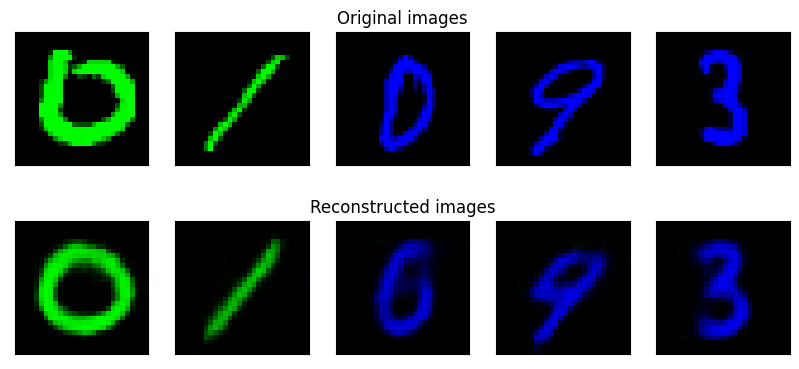


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.56s/it]


RLACE


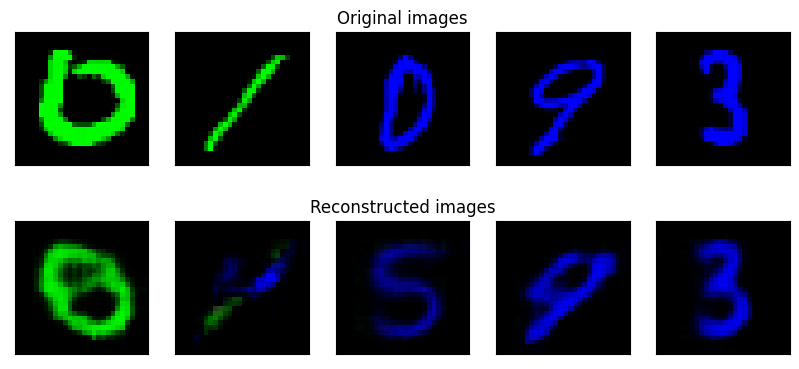

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.011604
	 partial train loss (single batch): 0.010498
	 partial train loss (single batch): 0.010422
	 partial train loss (single batch): 0.011740
	 partial train loss (single batch): 0.009407
	 partial train loss (single batch): 0.009775
	 partial train loss (single batch): 0.011114


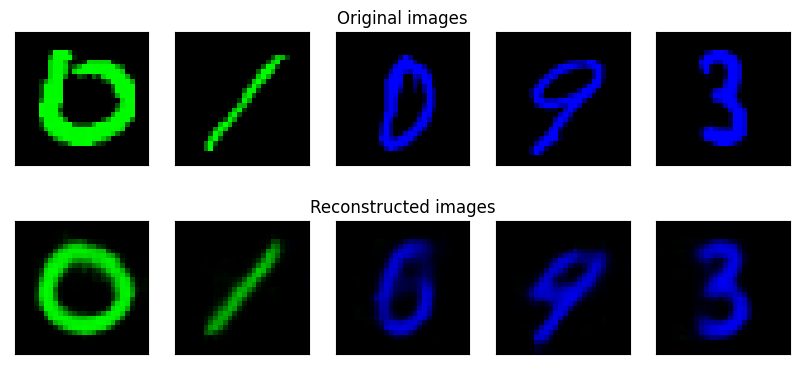


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.49s/it]

	 partial train loss (single batch): 0.011424
	 partial train loss (single batch): 0.010549
	 partial train loss (single batch): 0.010363
	 partial train loss (single batch): 0.011637
	 partial train loss (single batch): 0.009293
	 partial train loss (single batch): 0.009828
	 partial train loss (single batch): 0.010983


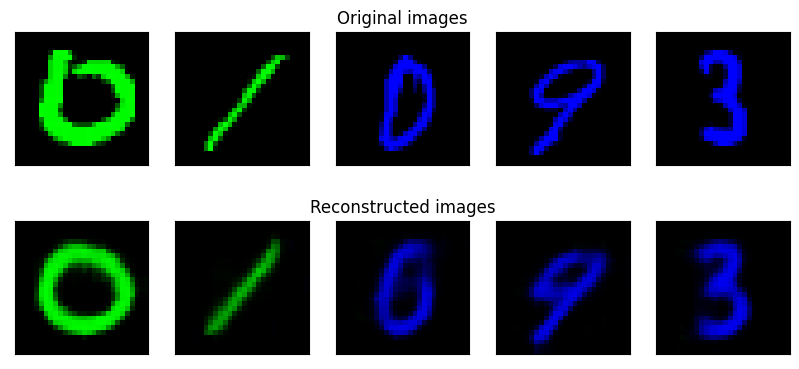


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.41s/it]

	 partial train loss (single batch): 0.011315
	 partial train loss (single batch): 0.010532
	 partial train loss (single batch): 0.010480
	 partial train loss (single batch): 0.011599
	 partial train loss (single batch): 0.009440
	 partial train loss (single batch): 0.009796


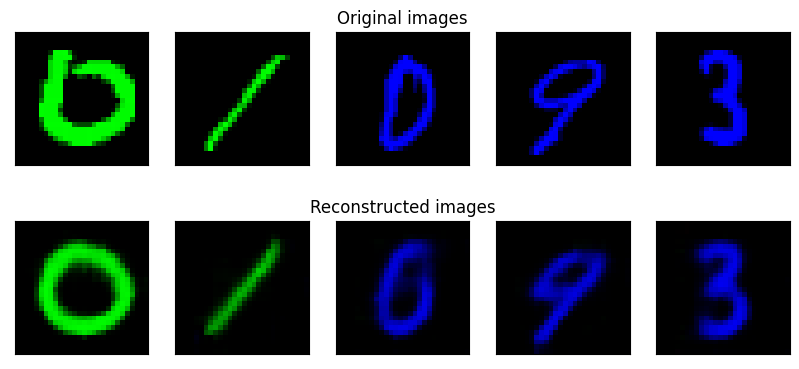


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.31s/it]

	 partial train loss (single batch): 0.011262
	 partial train loss (single batch): 0.010579
	 partial train loss (single batch): 0.010148
	 partial train loss (single batch): 0.011562
	 partial train loss (single batch): 0.009360
	 partial train loss (single batch): 0.009572
	 partial train loss (single batch): 0.010849


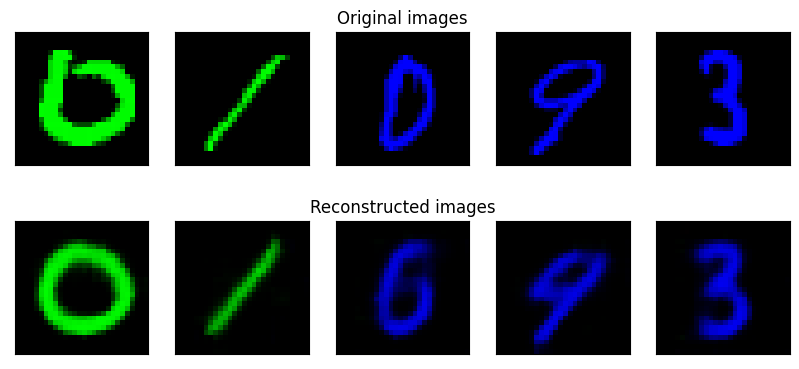


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.33s/it]

	 partial train loss (single batch): 0.011133
	 partial train loss (single batch): 0.010456
	 partial train loss (single batch): 0.010191
	 partial train loss (single batch): 0.011687
	 partial train loss (single batch): 0.009311
	 partial train loss (single batch): 0.009584
	 partial train loss (single batch): 0.010844


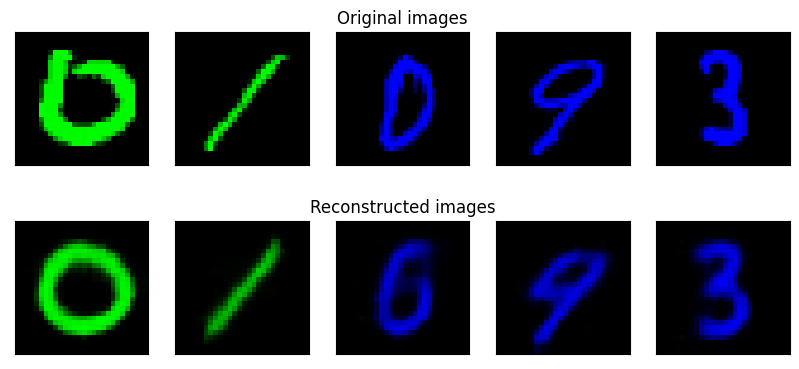


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:26<00:00,  5.34s/it]


RLACE


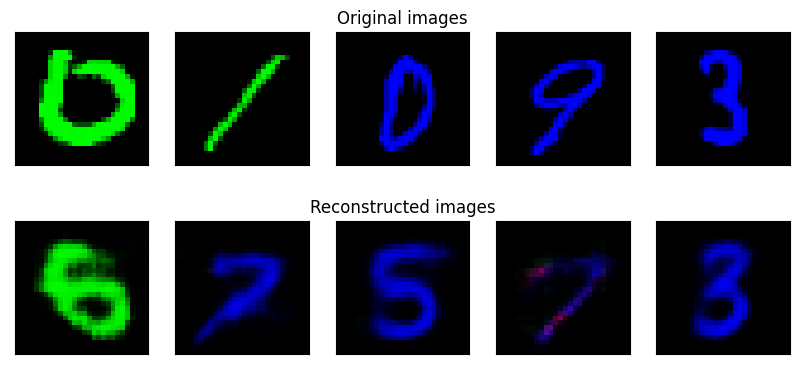

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.011601
	 partial train loss (single batch): 0.010558
	 partial train loss (single batch): 0.010237
	 partial train loss (single batch): 0.011631
	 partial train loss (single batch): 0.009480
	 partial train loss (single batch): 0.009600
	 partial train loss (single batch): 0.010836


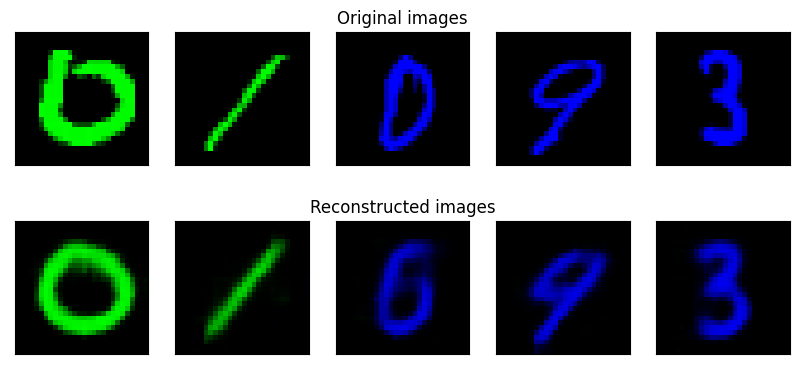


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.35s/it]

	 partial train loss (single batch): 0.011247
	 partial train loss (single batch): 0.010464
	 partial train loss (single batch): 0.010180
	 partial train loss (single batch): 0.011645
	 partial train loss (single batch): 0.009331
	 partial train loss (single batch): 0.009679
	 partial train loss (single batch): 0.010784


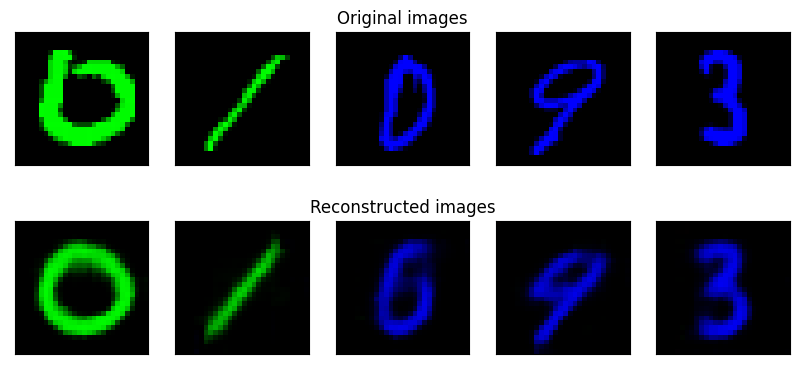


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:15,  5.28s/it]

	 partial train loss (single batch): 0.011124
	 partial train loss (single batch): 0.010335
	 partial train loss (single batch): 0.010129
	 partial train loss (single batch): 0.011609
	 partial train loss (single batch): 0.009186
	 partial train loss (single batch): 0.009695
	 partial train loss (single batch): 0.010591


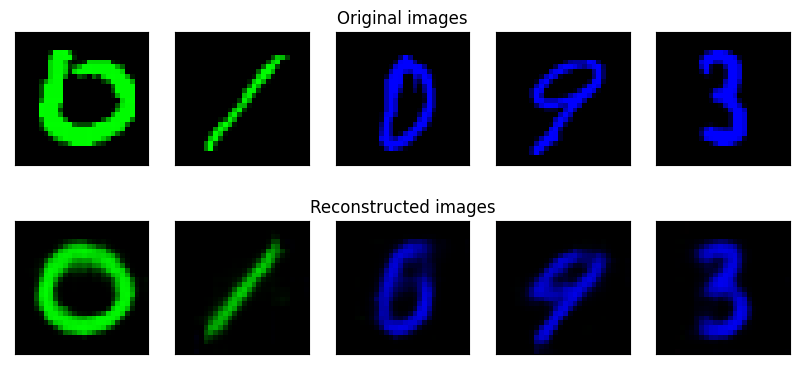


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.40s/it]

	 partial train loss (single batch): 0.011088
	 partial train loss (single batch): 0.010166
	 partial train loss (single batch): 0.010057
	 partial train loss (single batch): 0.011617
	 partial train loss (single batch): 0.009191
	 partial train loss (single batch): 0.009676
	 partial train loss (single batch): 0.010676


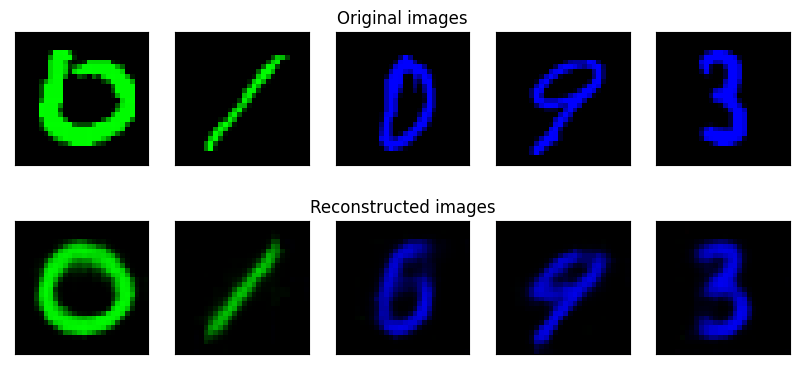


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.44s/it]

	 partial train loss (single batch): 0.010945
	 partial train loss (single batch): 0.010355
	 partial train loss (single batch): 0.009990
	 partial train loss (single batch): 0.011558
	 partial train loss (single batch): 0.009233
	 partial train loss (single batch): 0.009608
	 partial train loss (single batch): 0.010525


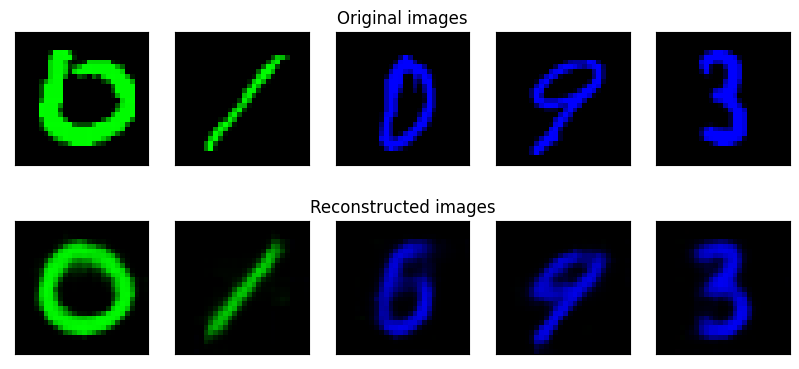


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.42s/it]


RLACE


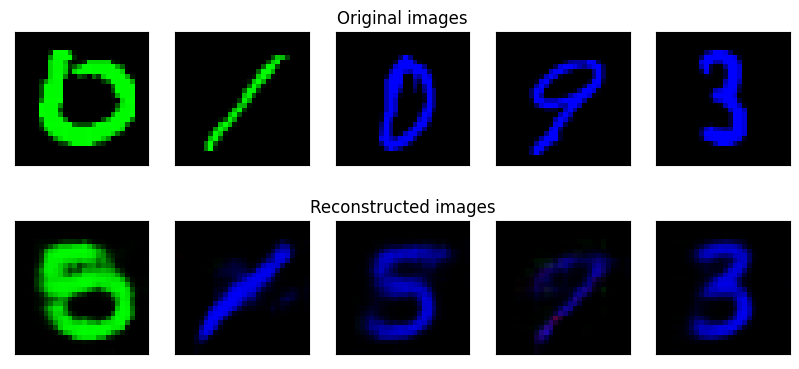

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.011197
	 partial train loss (single batch): 0.010350
	 partial train loss (single batch): 0.010040
	 partial train loss (single batch): 0.011416
	 partial train loss (single batch): 0.009235
	 partial train loss (single batch): 0.009607
	 partial train loss (single batch): 0.010506


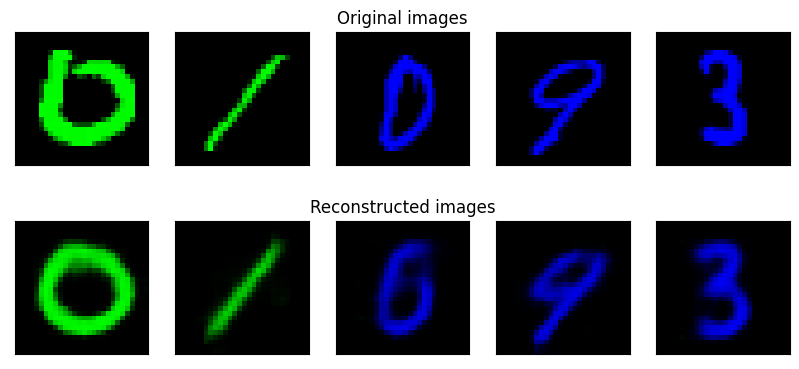


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:23,  5.90s/it]

	 partial train loss (single batch): 0.011086
	 partial train loss (single batch): 0.010297
	 partial train loss (single batch): 0.010053
	 partial train loss (single batch): 0.011505
	 partial train loss (single batch): 0.009338
	 partial train loss (single batch): 0.009561
	 partial train loss (single batch): 0.010497


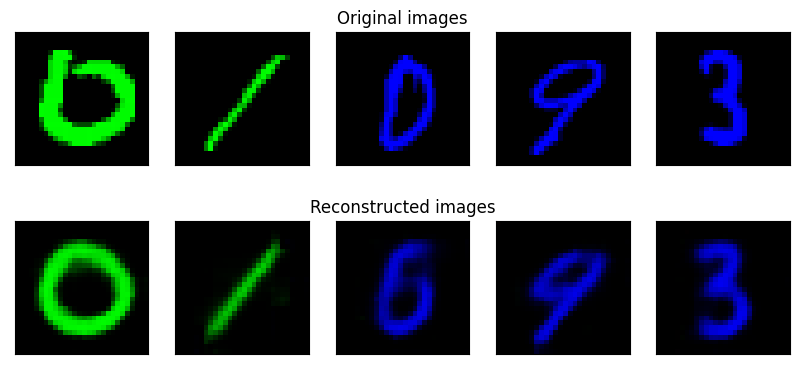


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.64s/it]

	 partial train loss (single batch): 0.011021
	 partial train loss (single batch): 0.010174
	 partial train loss (single batch): 0.010095
	 partial train loss (single batch): 0.011494
	 partial train loss (single batch): 0.009126
	 partial train loss (single batch): 0.009588
	 partial train loss (single batch): 0.010505


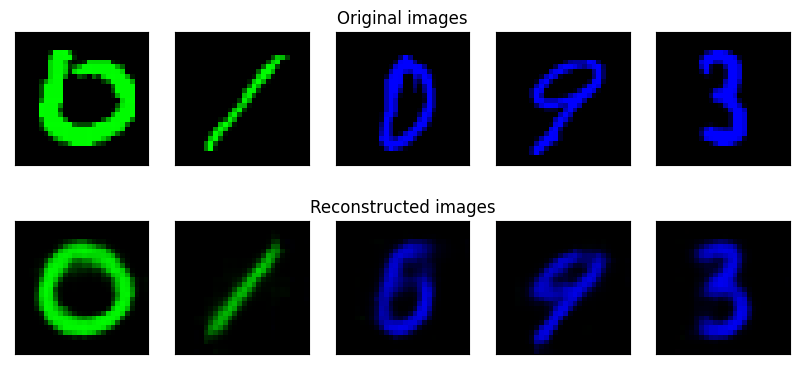


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.62s/it]

	 partial train loss (single batch): 0.010989
	 partial train loss (single batch): 0.010147
	 partial train loss (single batch): 0.010143
	 partial train loss (single batch): 0.011540
	 partial train loss (single batch): 0.009247
	 partial train loss (single batch): 0.009552
	 partial train loss (single batch): 0.010366


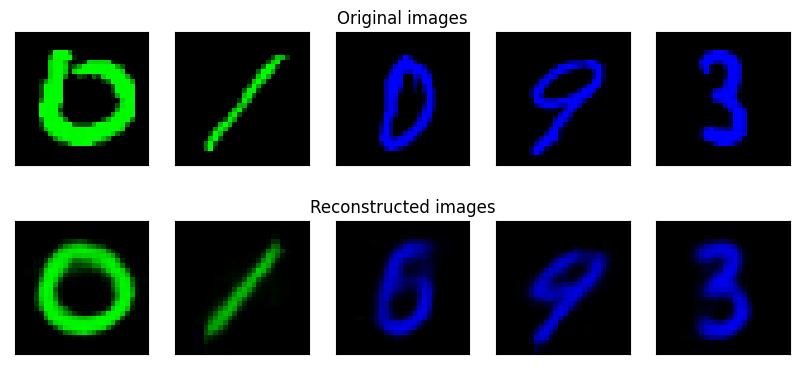


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.56s/it]

	 partial train loss (single batch): 0.010950
	 partial train loss (single batch): 0.010221
	 partial train loss (single batch): 0.009991
	 partial train loss (single batch): 0.011453
	 partial train loss (single batch): 0.009072
	 partial train loss (single batch): 0.009556
	 partial train loss (single batch): 0.010266


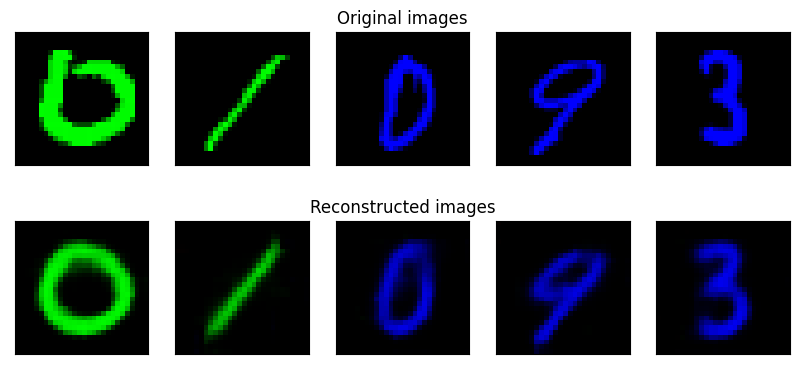


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.58s/it]


RLACE


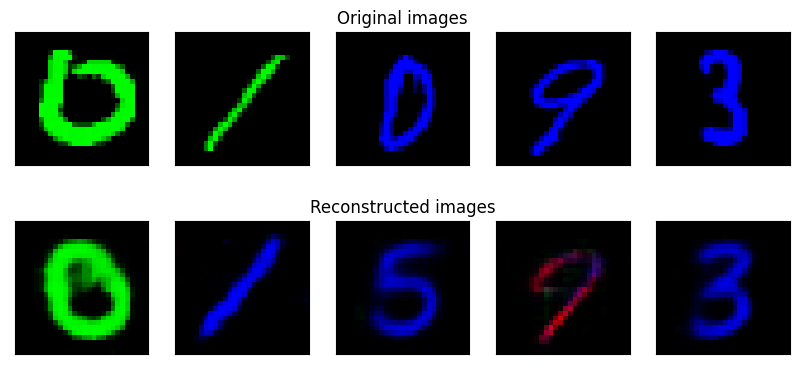

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.011165
	 partial train loss (single batch): 0.010137
	 partial train loss (single batch): 0.010044
	 partial train loss (single batch): 0.011473
	 partial train loss (single batch): 0.009066
	 partial train loss (single batch): 0.009503
	 partial train loss (single batch): 0.010245


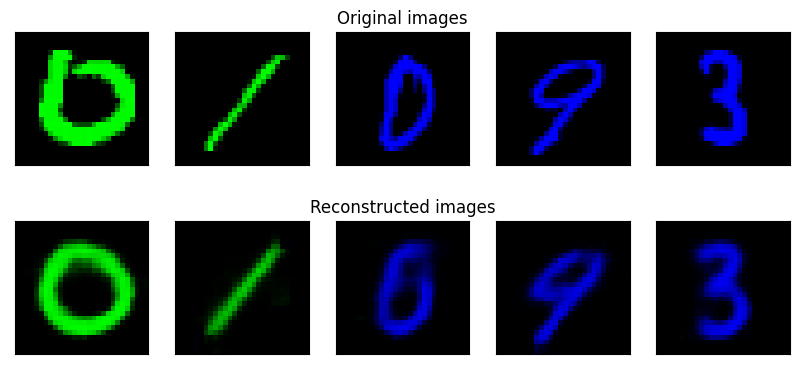


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.52s/it]

	 partial train loss (single batch): 0.010880
	 partial train loss (single batch): 0.010194
	 partial train loss (single batch): 0.010018
	 partial train loss (single batch): 0.011450
	 partial train loss (single batch): 0.008924
	 partial train loss (single batch): 0.009564
	 partial train loss (single batch): 0.010096


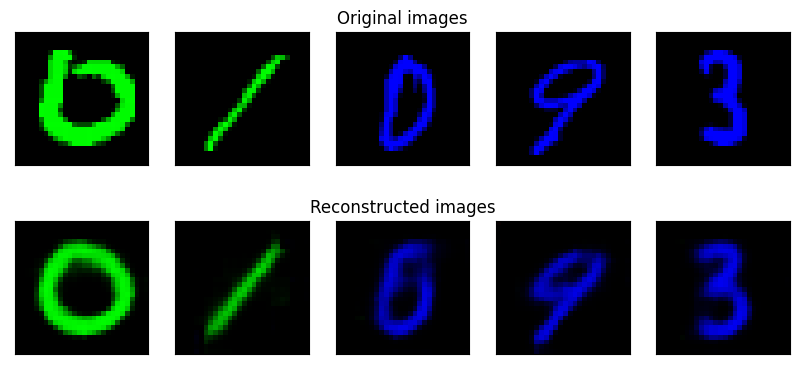


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.52s/it]

	 partial train loss (single batch): 0.010761
	 partial train loss (single batch): 0.010168
	 partial train loss (single batch): 0.009950
	 partial train loss (single batch): 0.011380
	 partial train loss (single batch): 0.009060
	 partial train loss (single batch): 0.009545
	 partial train loss (single batch): 0.010240


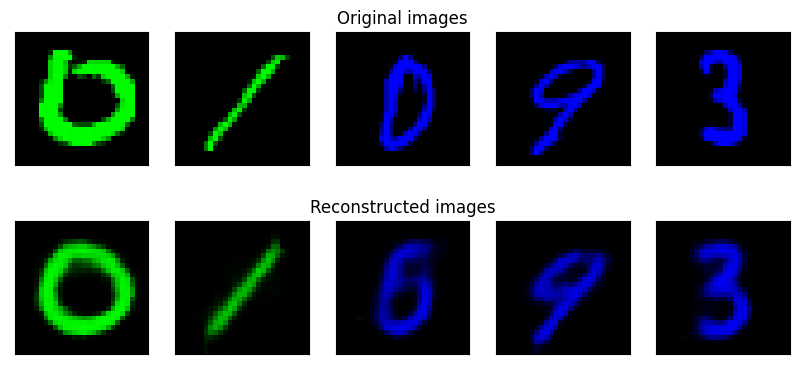


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.58s/it]

	 partial train loss (single batch): 0.010617
	 partial train loss (single batch): 0.010101
	 partial train loss (single batch): 0.009959
	 partial train loss (single batch): 0.011437
	 partial train loss (single batch): 0.009051
	 partial train loss (single batch): 0.009562
	 partial train loss (single batch): 0.010325


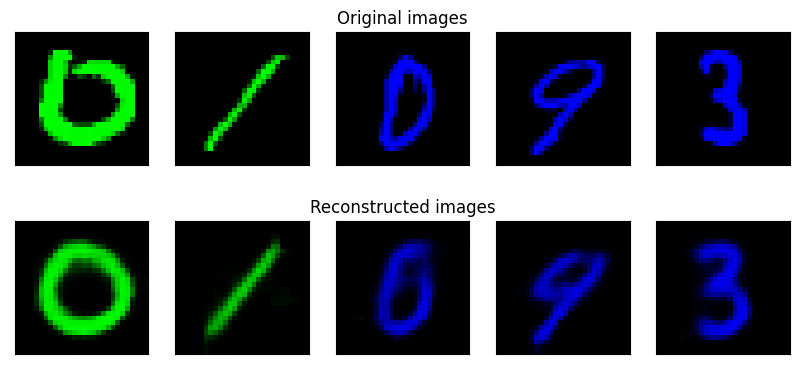


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.55s/it]

	 partial train loss (single batch): 0.010725
	 partial train loss (single batch): 0.010152
	 partial train loss (single batch): 0.009922
	 partial train loss (single batch): 0.011404
	 partial train loss (single batch): 0.008928
	 partial train loss (single batch): 0.009526
	 partial train loss (single batch): 0.010188


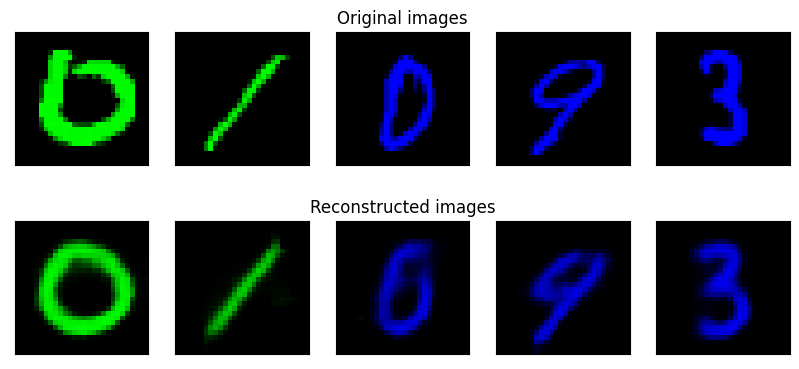


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.54s/it]


RLACE


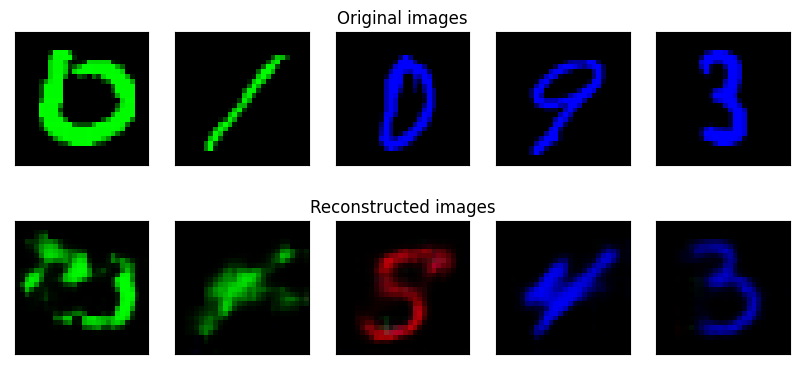

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.011178
	 partial train loss (single batch): 0.010161
	 partial train loss (single batch): 0.009961
	 partial train loss (single batch): 0.011381
	 partial train loss (single batch): 0.009073
	 partial train loss (single batch): 0.009465
	 partial train loss (single batch): 0.010228


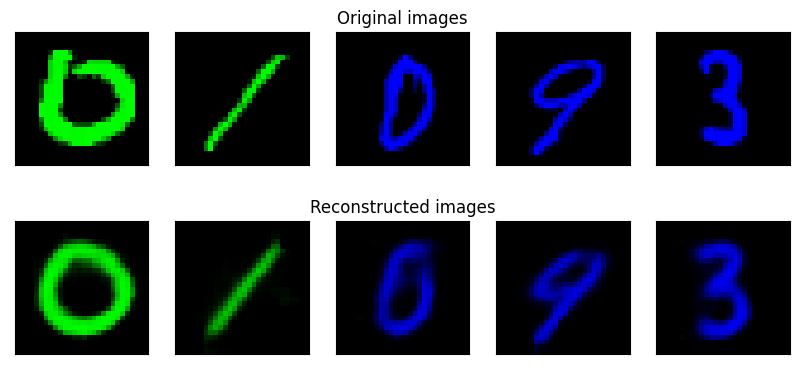


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.53s/it]

	 partial train loss (single batch): 0.010640
	 partial train loss (single batch): 0.010049
	 partial train loss (single batch): 0.009885
	 partial train loss (single batch): 0.011497
	 partial train loss (single batch): 0.009024
	 partial train loss (single batch): 0.009478
	 partial train loss (single batch): 0.010240


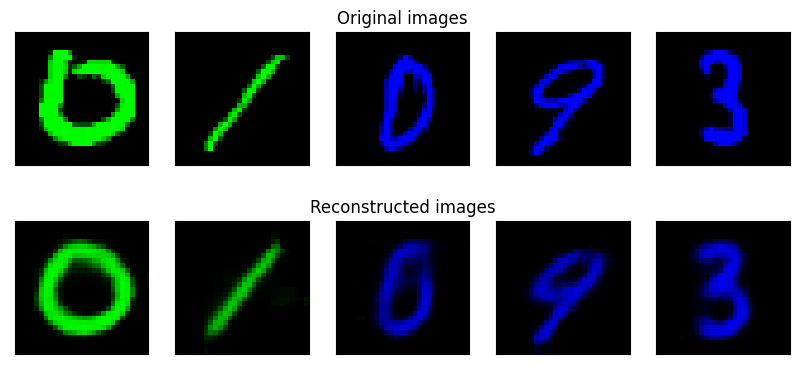


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.60s/it]

	 partial train loss (single batch): 0.010589
	 partial train loss (single batch): 0.010090
	 partial train loss (single batch): 0.009786
	 partial train loss (single batch): 0.011363
	 partial train loss (single batch): 0.008914
	 partial train loss (single batch): 0.009493
	 partial train loss (single batch): 0.010125


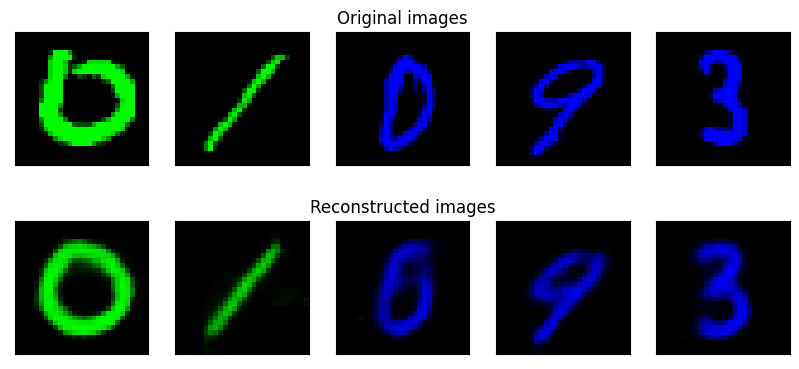


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.57s/it]

	 partial train loss (single batch): 0.010568
	 partial train loss (single batch): 0.010026
	 partial train loss (single batch): 0.009762
	 partial train loss (single batch): 0.011395
	 partial train loss (single batch): 0.009128
	 partial train loss (single batch): 0.009476
	 partial train loss (single batch): 0.010091


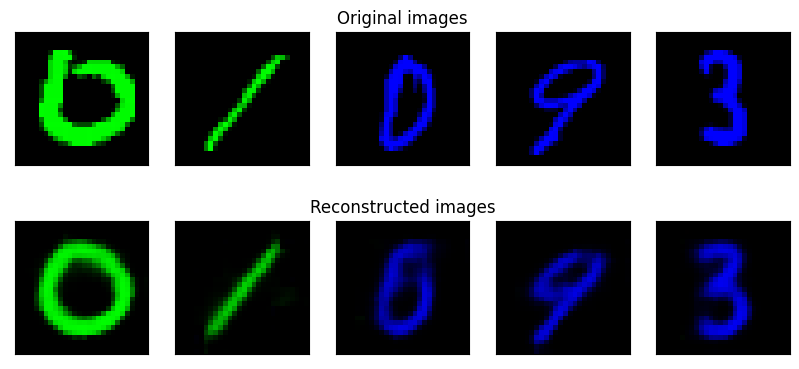


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.54s/it]

	 partial train loss (single batch): 0.010535
	 partial train loss (single batch): 0.009934
	 partial train loss (single batch): 0.009701
	 partial train loss (single batch): 0.011384
	 partial train loss (single batch): 0.009069
	 partial train loss (single batch): 0.009459
	 partial train loss (single batch): 0.009869


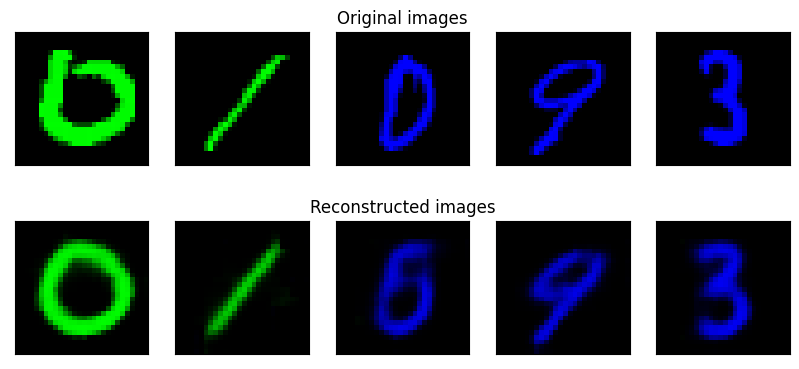


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.57s/it]


RLACE


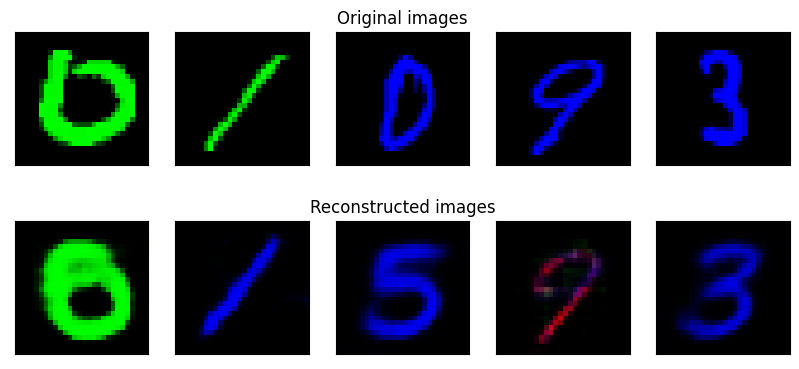

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.010849
	 partial train loss (single batch): 0.010111
	 partial train loss (single batch): 0.009831
	 partial train loss (single batch): 0.011259
	 partial train loss (single batch): 0.009050
	 partial train loss (single batch): 0.009428
	 partial train loss (single batch): 0.009998


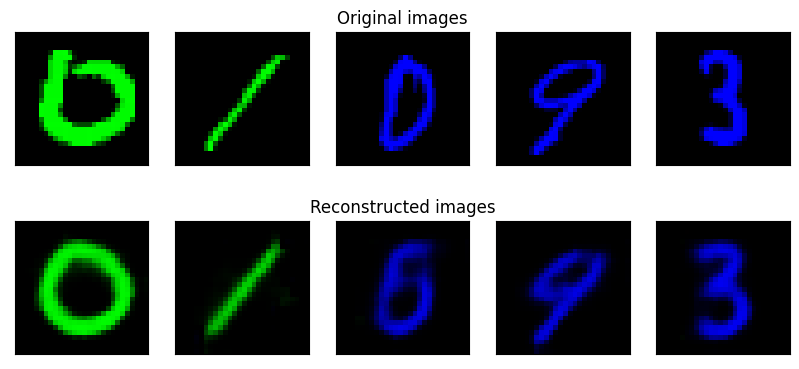


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.65s/it]

	 partial train loss (single batch): 0.010545
	 partial train loss (single batch): 0.010048
	 partial train loss (single batch): 0.009676
	 partial train loss (single batch): 0.011392
	 partial train loss (single batch): 0.008960
	 partial train loss (single batch): 0.009455
	 partial train loss (single batch): 0.010016


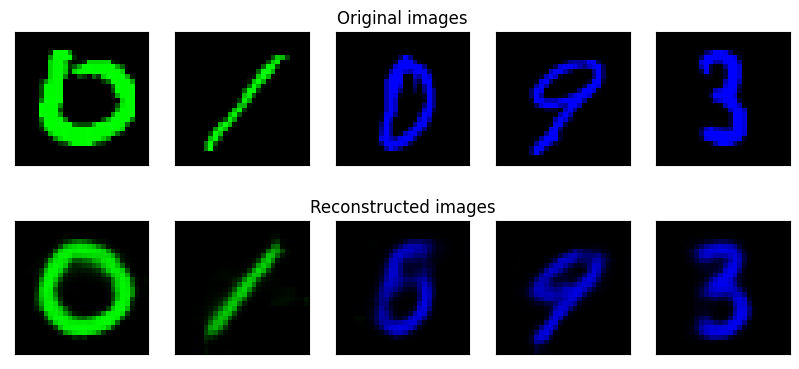


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.58s/it]

	 partial train loss (single batch): 0.010609
	 partial train loss (single batch): 0.010058
	 partial train loss (single batch): 0.009677
	 partial train loss (single batch): 0.011367
	 partial train loss (single batch): 0.009063
	 partial train loss (single batch): 0.009476
	 partial train loss (single batch): 0.010031


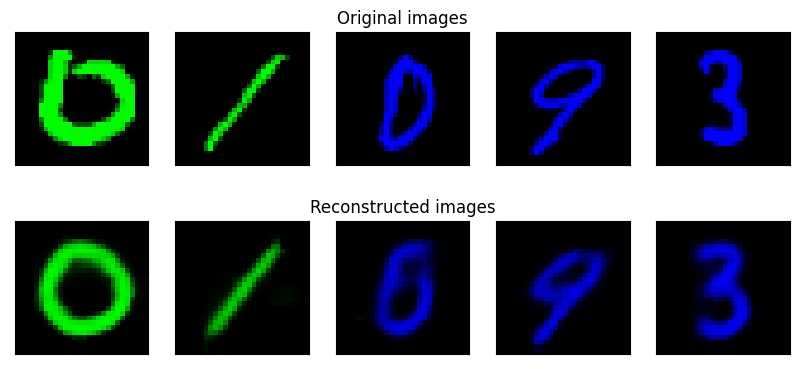


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.54s/it]

	 partial train loss (single batch): 0.010450
	 partial train loss (single batch): 0.009977
	 partial train loss (single batch): 0.009736
	 partial train loss (single batch): 0.011351
	 partial train loss (single batch): 0.009044
	 partial train loss (single batch): 0.009414
	 partial train loss (single batch): 0.009932


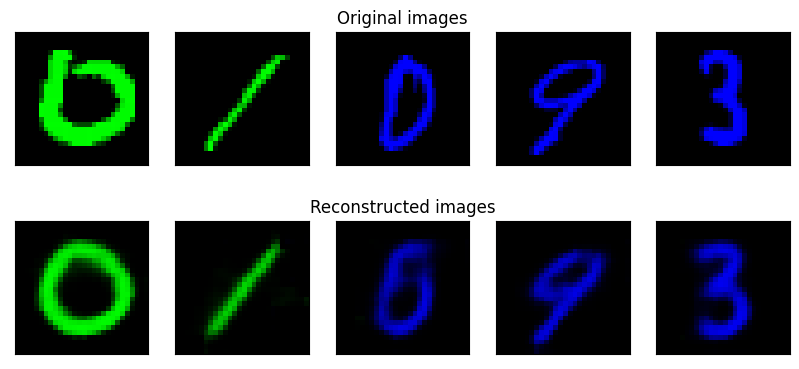


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.56s/it]

	 partial train loss (single batch): 0.010536
	 partial train loss (single batch): 0.009884
	 partial train loss (single batch): 0.009638
	 partial train loss (single batch): 0.011375
	 partial train loss (single batch): 0.009215
	 partial train loss (single batch): 0.009447
	 partial train loss (single batch): 0.009971


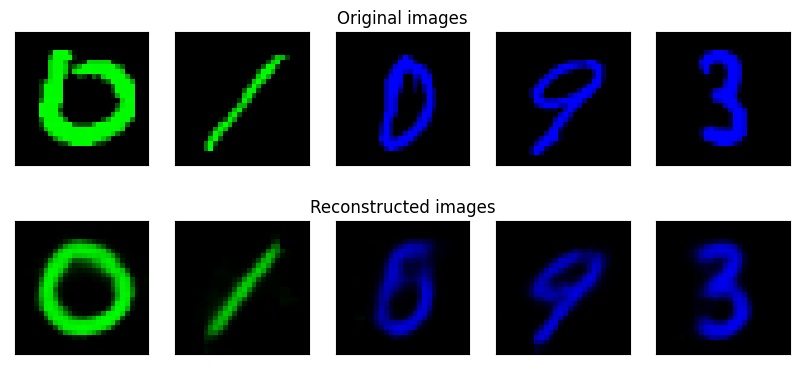


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.55s/it]


RLACE


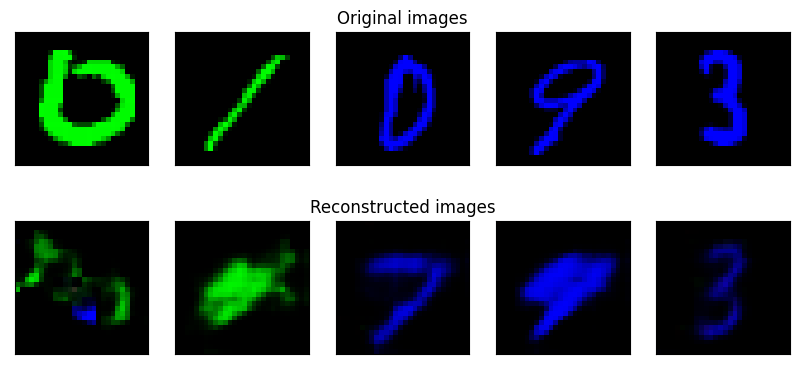

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.033349
	 partial train loss (single batch): 0.028894
	 partial train loss (single batch): 0.029932
	 partial train loss (single batch): 0.028494
	 partial train loss (single batch): 0.021056
	 partial train loss (single batch): 0.020034
	 partial train loss (single batch): 0.020036


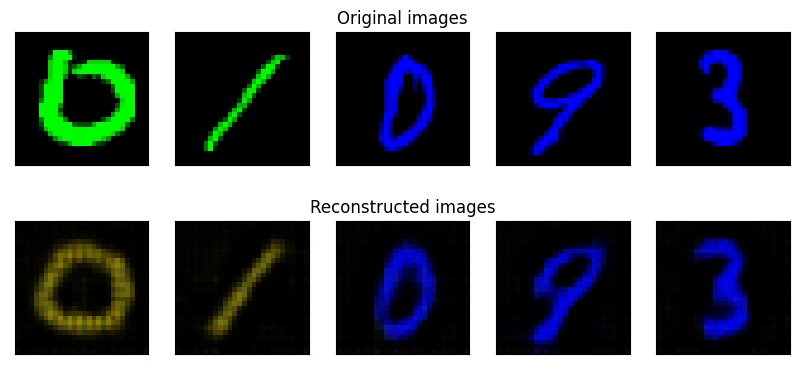


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.48s/it]

	 partial train loss (single batch): 0.015742
	 partial train loss (single batch): 0.010814
	 partial train loss (single batch): 0.009731
	 partial train loss (single batch): 0.009679
	 partial train loss (single batch): 0.006934
	 partial train loss (single batch): 0.007394
	 partial train loss (single batch): 0.007662


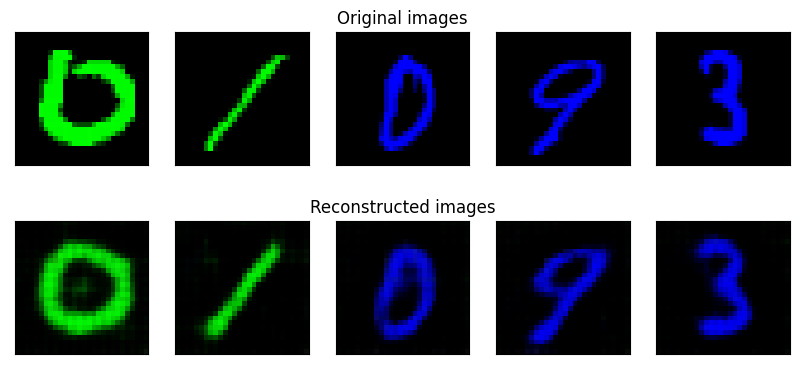


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.47s/it]

	 partial train loss (single batch): 0.007762
	 partial train loss (single batch): 0.006671
	 partial train loss (single batch): 0.007150
	 partial train loss (single batch): 0.007950
	 partial train loss (single batch): 0.005786
	 partial train loss (single batch): 0.006568
	 partial train loss (single batch): 0.006568


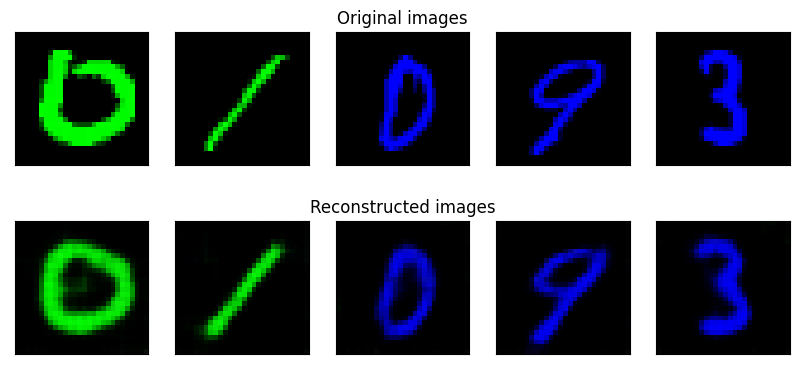


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.47s/it]

	 partial train loss (single batch): 0.007186
	 partial train loss (single batch): 0.006003
	 partial train loss (single batch): 0.006456
	 partial train loss (single batch): 0.007238
	 partial train loss (single batch): 0.005432
	 partial train loss (single batch): 0.006157
	 partial train loss (single batch): 0.006160


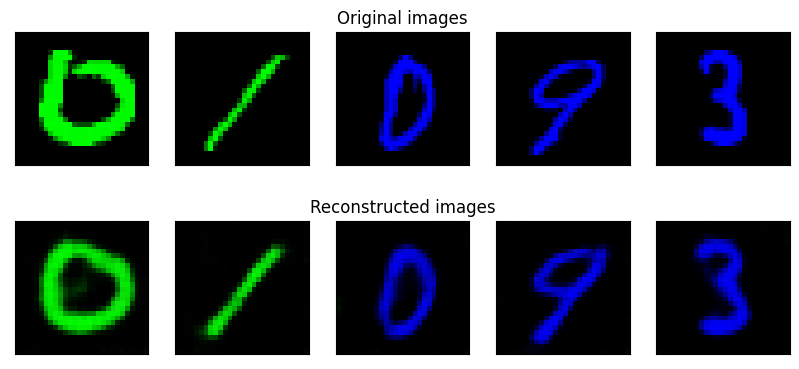


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.54s/it]

	 partial train loss (single batch): 0.006825
	 partial train loss (single batch): 0.005716
	 partial train loss (single batch): 0.006168
	 partial train loss (single batch): 0.006936
	 partial train loss (single batch): 0.005198
	 partial train loss (single batch): 0.005918
	 partial train loss (single batch): 0.005798


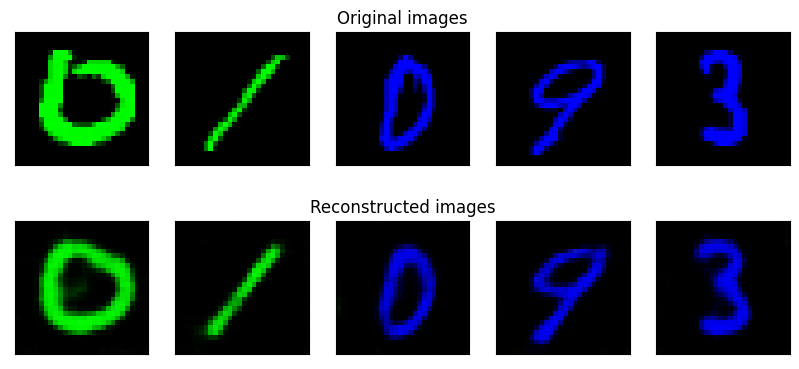


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.52s/it]


RLACE


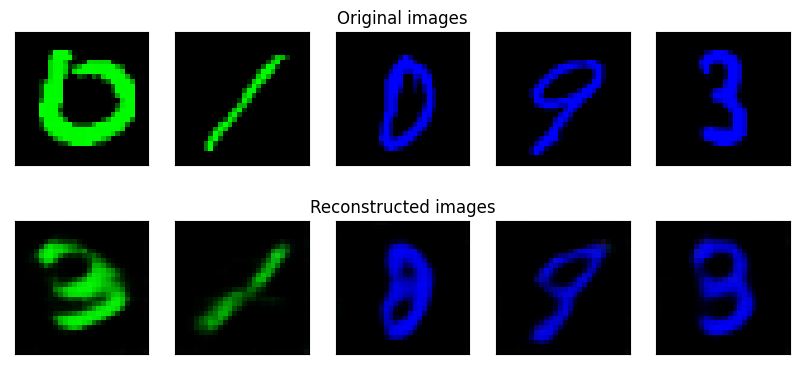

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.009025
	 partial train loss (single batch): 0.007945
	 partial train loss (single batch): 0.008373
	 partial train loss (single batch): 0.008807
	 partial train loss (single batch): 0.007070
	 partial train loss (single batch): 0.007181
	 partial train loss (single batch): 0.007726


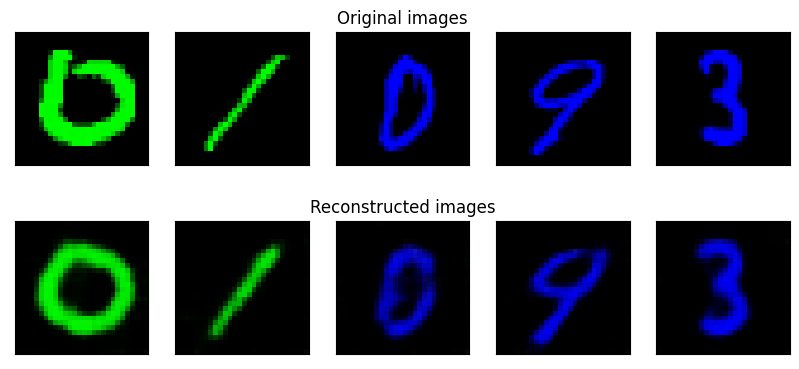


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.45s/it]

	 partial train loss (single batch): 0.007861
	 partial train loss (single batch): 0.006982
	 partial train loss (single batch): 0.007753
	 partial train loss (single batch): 0.008150
	 partial train loss (single batch): 0.006492
	 partial train loss (single batch): 0.006989
	 partial train loss (single batch): 0.007326


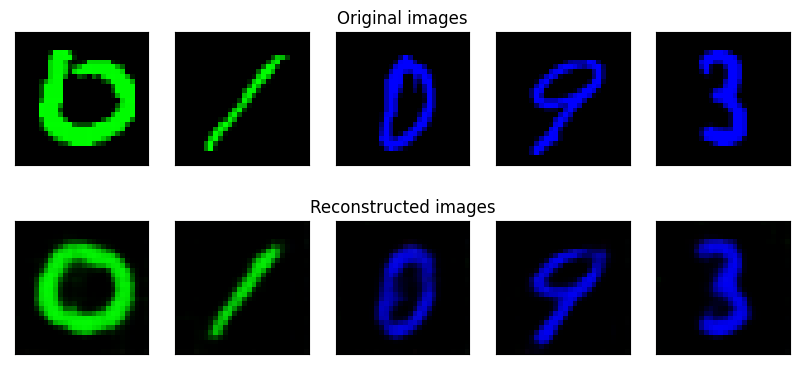


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.44s/it]

	 partial train loss (single batch): 0.007574
	 partial train loss (single batch): 0.006637
	 partial train loss (single batch): 0.007427
	 partial train loss (single batch): 0.007919
	 partial train loss (single batch): 0.006169
	 partial train loss (single batch): 0.006910
	 partial train loss (single batch): 0.006995


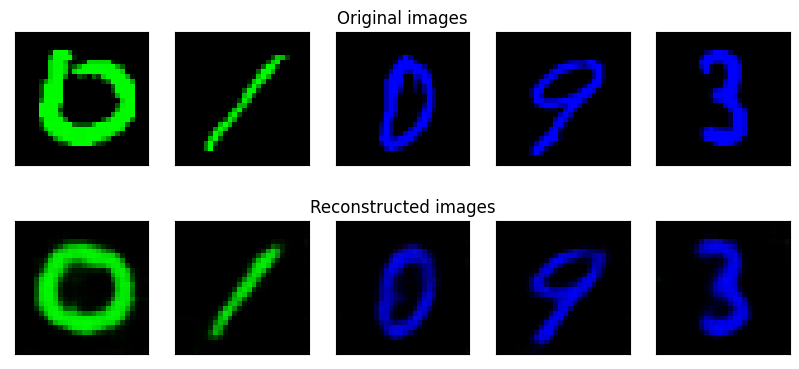


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.51s/it]

	 partial train loss (single batch): 0.007398
	 partial train loss (single batch): 0.006338
	 partial train loss (single batch): 0.007201
	 partial train loss (single batch): 0.007763
	 partial train loss (single batch): 0.006052
	 partial train loss (single batch): 0.006796
	 partial train loss (single batch): 0.006782


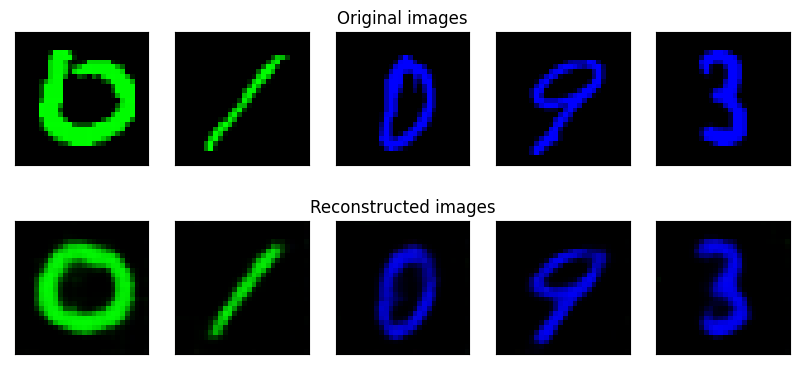


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.50s/it]

	 partial train loss (single batch): 0.007227
	 partial train loss (single batch): 0.006239
	 partial train loss (single batch): 0.007036
	 partial train loss (single batch): 0.007629
	 partial train loss (single batch): 0.005944
	 partial train loss (single batch): 0.006678
	 partial train loss (single batch): 0.006714


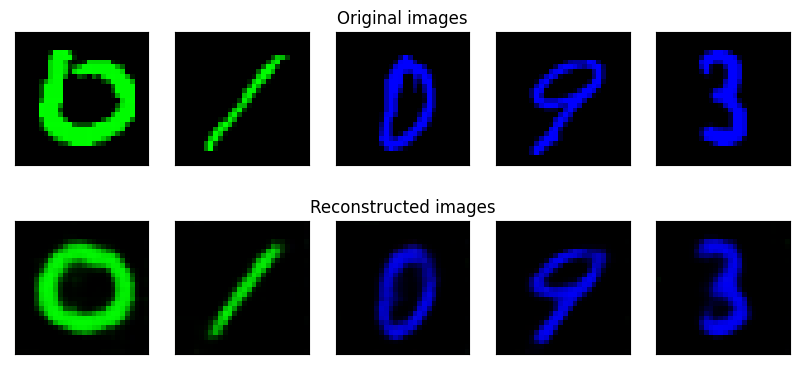


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.49s/it]


RLACE


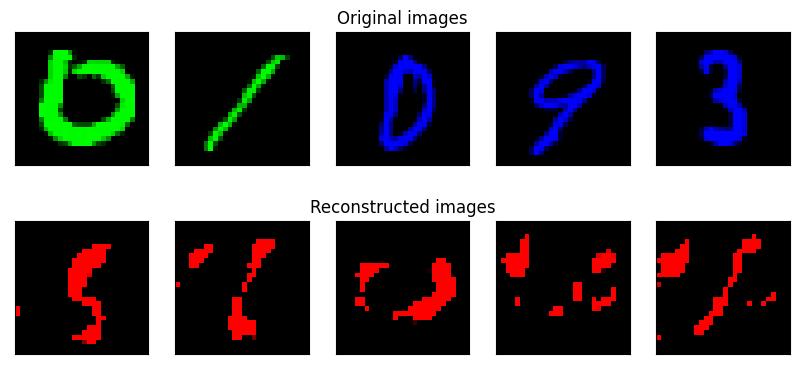

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.020961
	 partial train loss (single batch): 0.019096
	 partial train loss (single batch): 0.019443
	 partial train loss (single batch): 0.020667
	 partial train loss (single batch): 0.018817
	 partial train loss (single batch): 0.018526
	 partial train loss (single batch): 0.018966


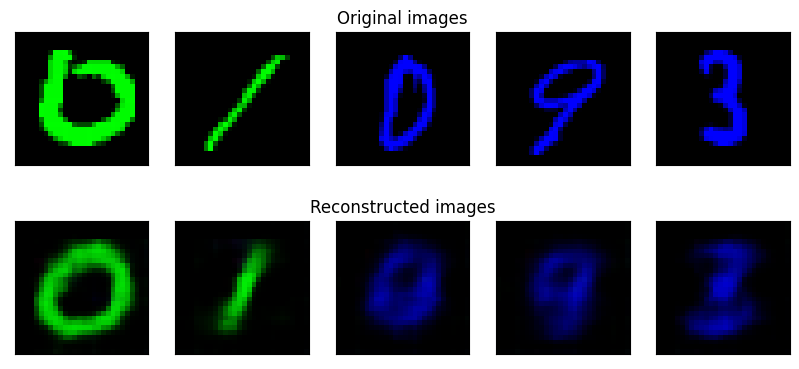


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.49s/it]

	 partial train loss (single batch): 0.017596
	 partial train loss (single batch): 0.016733
	 partial train loss (single batch): 0.017781
	 partial train loss (single batch): 0.018449
	 partial train loss (single batch): 0.015711
	 partial train loss (single batch): 0.016110
	 partial train loss (single batch): 0.016998


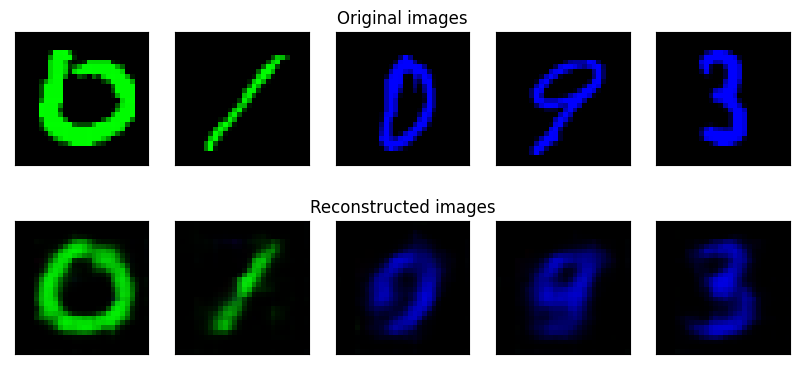


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.48s/it]

	 partial train loss (single batch): 0.015040
	 partial train loss (single batch): 0.014575
	 partial train loss (single batch): 0.014725
	 partial train loss (single batch): 0.015317
	 partial train loss (single batch): 0.012720
	 partial train loss (single batch): 0.013035
	 partial train loss (single batch): 0.014019


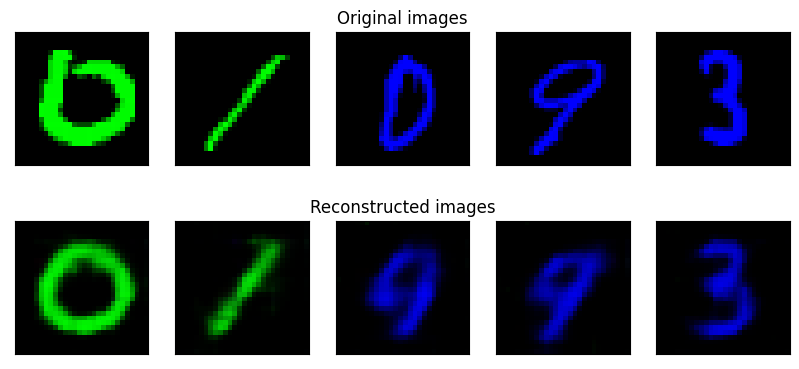


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.55s/it]

	 partial train loss (single batch): 0.013414
	 partial train loss (single batch): 0.012607
	 partial train loss (single batch): 0.013300
	 partial train loss (single batch): 0.013793
	 partial train loss (single batch): 0.011688
	 partial train loss (single batch): 0.012078
	 partial train loss (single batch): 0.013047


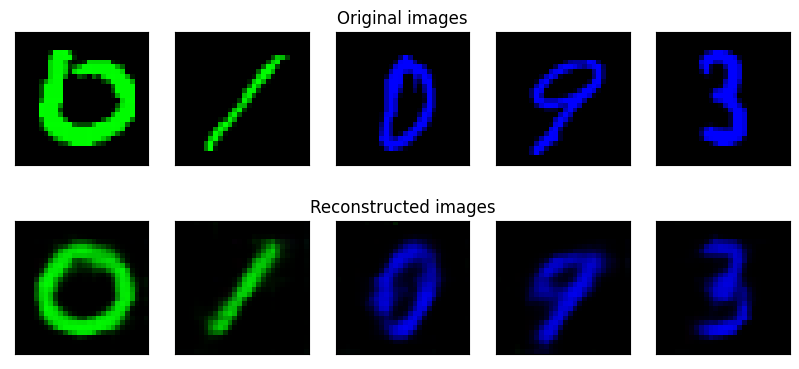


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.53s/it]

	 partial train loss (single batch): 0.012616
	 partial train loss (single batch): 0.012021
	 partial train loss (single batch): 0.012628
	 partial train loss (single batch): 0.013164
	 partial train loss (single batch): 0.011137
	 partial train loss (single batch): 0.011376
	 partial train loss (single batch): 0.012435


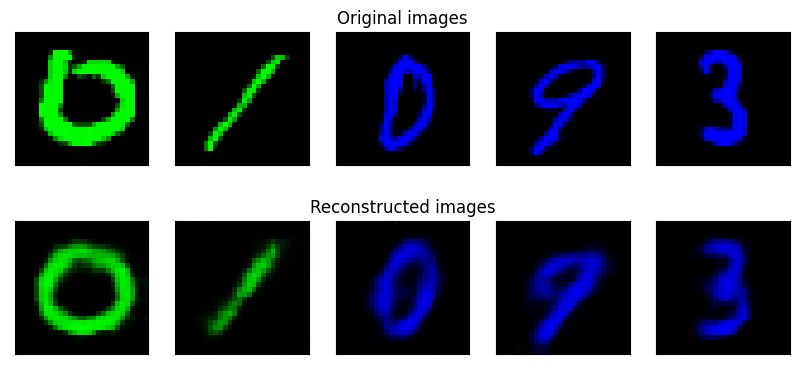


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.52s/it]


RLACE


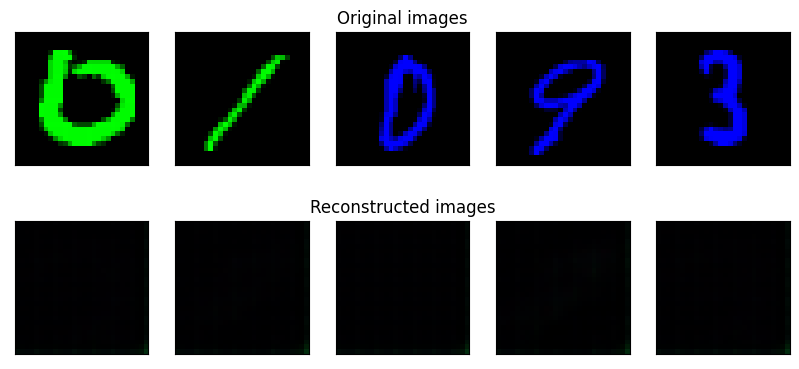

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.014079
	 partial train loss (single batch): 0.011751
	 partial train loss (single batch): 0.011751
	 partial train loss (single batch): 0.012220
	 partial train loss (single batch): 0.010500
	 partial train loss (single batch): 0.010044
	 partial train loss (single batch): 0.010687


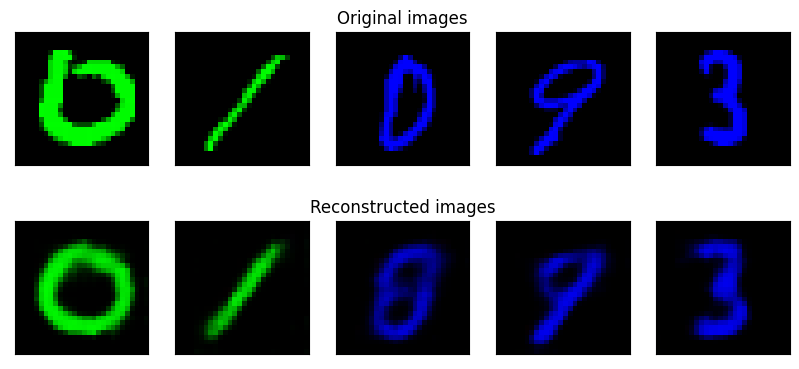


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.28s/it]

	 partial train loss (single batch): 0.010232
	 partial train loss (single batch): 0.009150
	 partial train loss (single batch): 0.009632
	 partial train loss (single batch): 0.010018
	 partial train loss (single batch): 0.007852
	 partial train loss (single batch): 0.008164
	 partial train loss (single batch): 0.008622


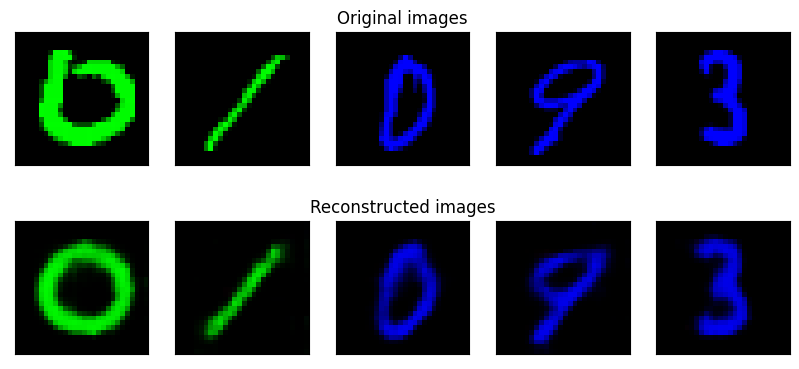


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:15,  5.25s/it]

	 partial train loss (single batch): 0.008853
	 partial train loss (single batch): 0.007954
	 partial train loss (single batch): 0.008622
	 partial train loss (single batch): 0.009304
	 partial train loss (single batch): 0.007189
	 partial train loss (single batch): 0.007576
	 partial train loss (single batch): 0.007893


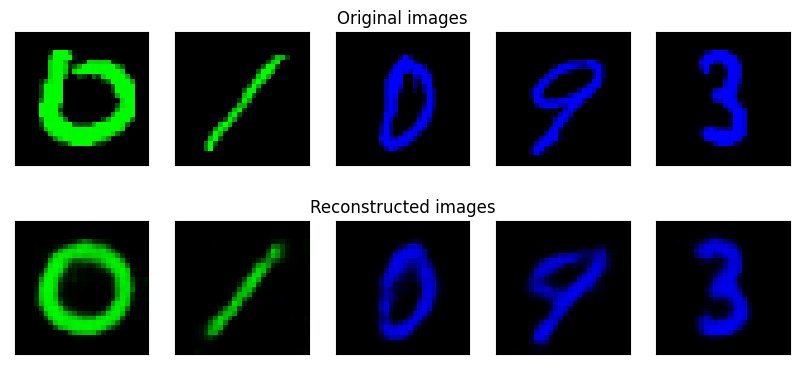


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:15<00:10,  5.30s/it]

	 partial train loss (single batch): 0.008092
	 partial train loss (single batch): 0.007096
	 partial train loss (single batch): 0.007792
	 partial train loss (single batch): 0.008622
	 partial train loss (single batch): 0.006670
	 partial train loss (single batch): 0.007048
	 partial train loss (single batch): 0.007342


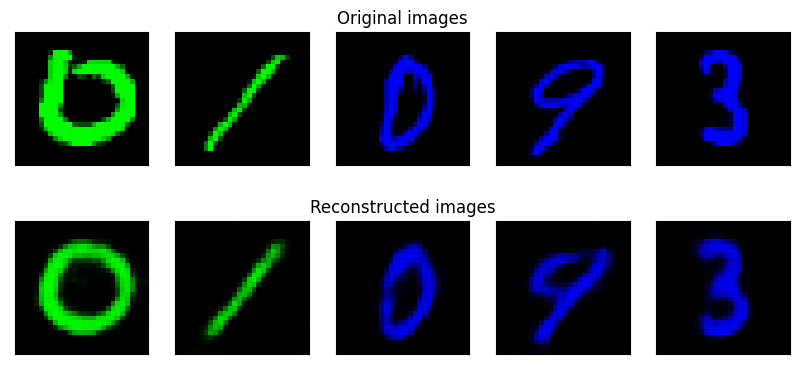


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.28s/it]

	 partial train loss (single batch): 0.007678
	 partial train loss (single batch): 0.006596
	 partial train loss (single batch): 0.007389
	 partial train loss (single batch): 0.008224
	 partial train loss (single batch): 0.006435
	 partial train loss (single batch): 0.006820
	 partial train loss (single batch): 0.007077


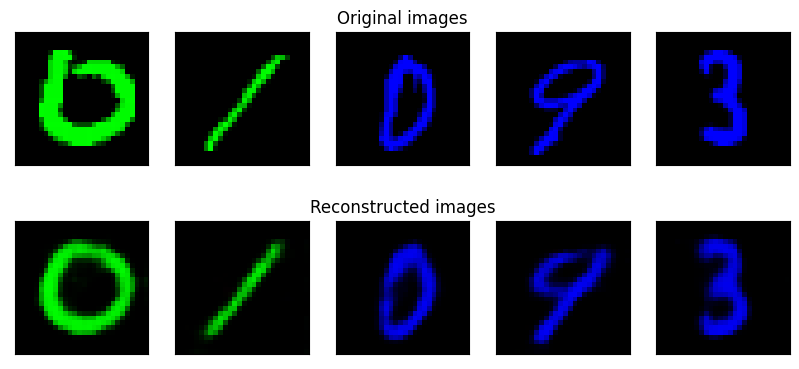


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:26<00:00,  5.32s/it]


RLACE


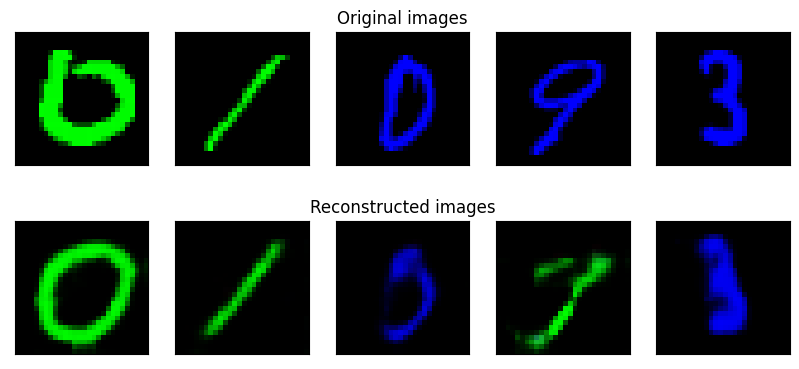

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.008564
	 partial train loss (single batch): 0.006961
	 partial train loss (single batch): 0.007511
	 partial train loss (single batch): 0.007978
	 partial train loss (single batch): 0.006334
	 partial train loss (single batch): 0.006796
	 partial train loss (single batch): 0.006901


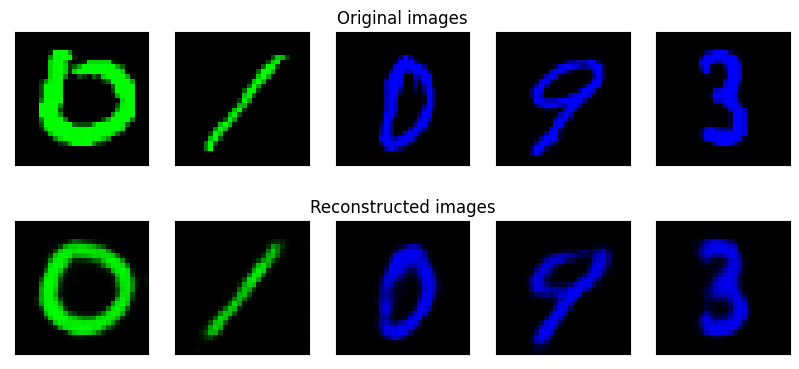


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.46s/it]

	 partial train loss (single batch): 0.007309
	 partial train loss (single batch): 0.006321
	 partial train loss (single batch): 0.007016
	 partial train loss (single batch): 0.007570
	 partial train loss (single batch): 0.006180
	 partial train loss (single batch): 0.006606
	 partial train loss (single batch): 0.006714


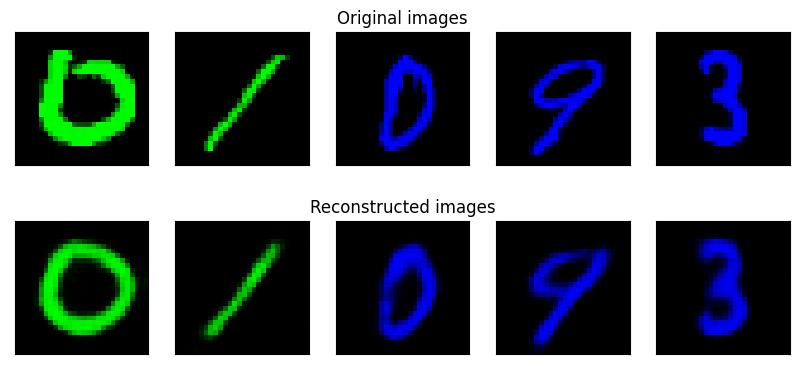


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.54s/it]

	 partial train loss (single batch): 0.007170
	 partial train loss (single batch): 0.006144
	 partial train loss (single batch): 0.006862
	 partial train loss (single batch): 0.007316
	 partial train loss (single batch): 0.006079
	 partial train loss (single batch): 0.006440
	 partial train loss (single batch): 0.006609


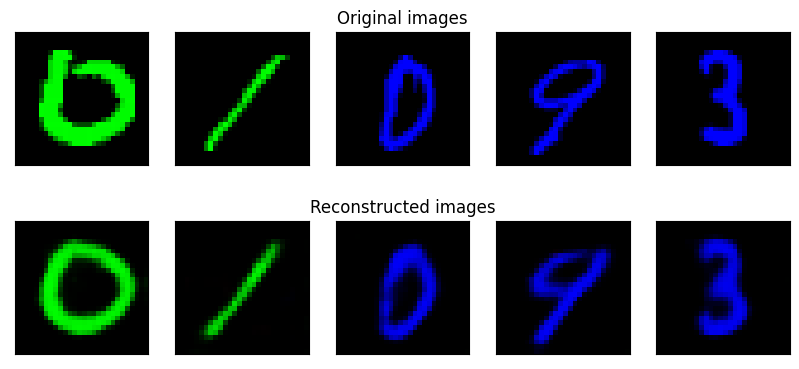


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.50s/it]

	 partial train loss (single batch): 0.007056
	 partial train loss (single batch): 0.006043
	 partial train loss (single batch): 0.006745
	 partial train loss (single batch): 0.007173
	 partial train loss (single batch): 0.006017
	 partial train loss (single batch): 0.006320
	 partial train loss (single batch): 0.006549


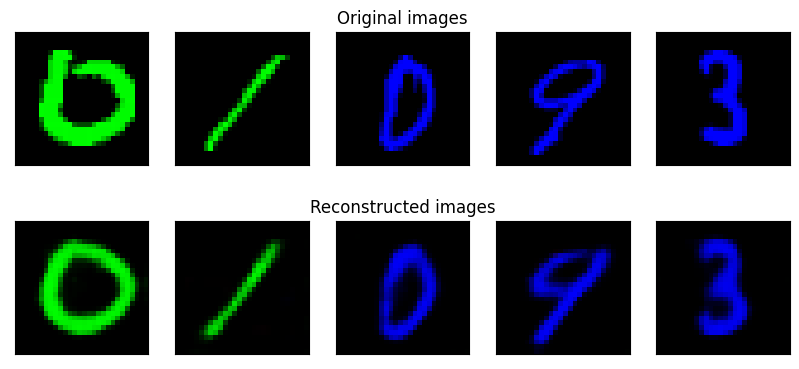


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.48s/it]

	 partial train loss (single batch): 0.006959
	 partial train loss (single batch): 0.005929
	 partial train loss (single batch): 0.006678
	 partial train loss (single batch): 0.007067
	 partial train loss (single batch): 0.005932
	 partial train loss (single batch): 0.006222
	 partial train loss (single batch): 0.006482


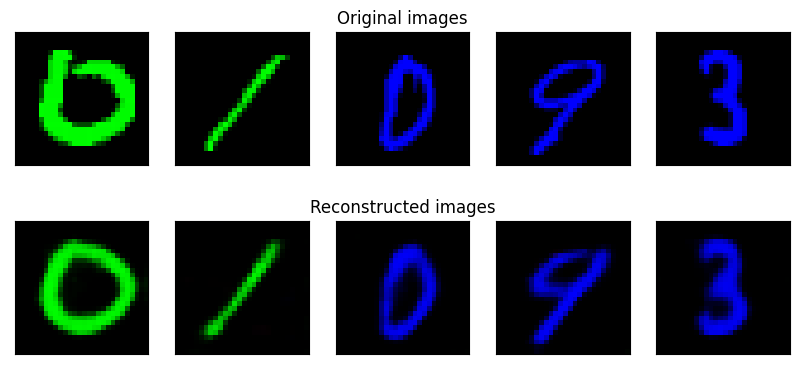


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.52s/it]


RLACE


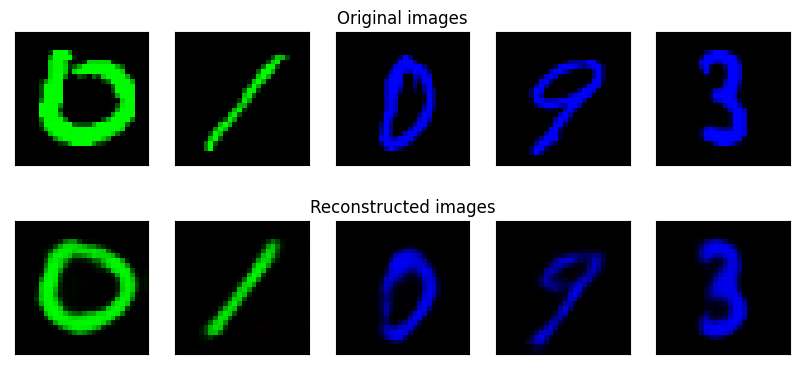

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.006856
	 partial train loss (single batch): 0.005867
	 partial train loss (single batch): 0.006619
	 partial train loss (single batch): 0.007021
	 partial train loss (single batch): 0.005866
	 partial train loss (single batch): 0.006160
	 partial train loss (single batch): 0.006443


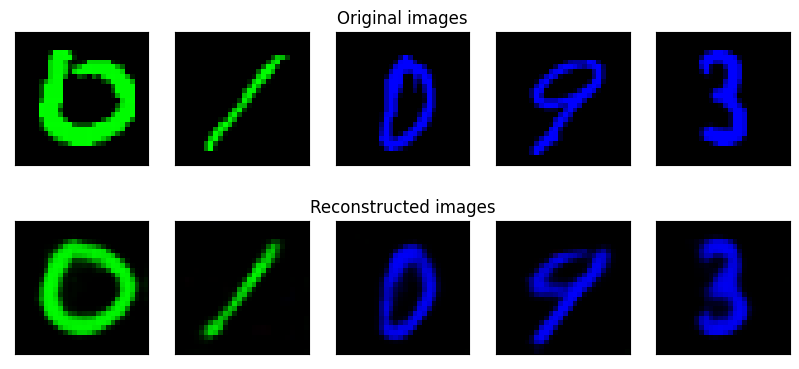


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.61s/it]

	 partial train loss (single batch): 0.006797
	 partial train loss (single batch): 0.005808
	 partial train loss (single batch): 0.006562
	 partial train loss (single batch): 0.006975
	 partial train loss (single batch): 0.005871
	 partial train loss (single batch): 0.006077
	 partial train loss (single batch): 0.006362


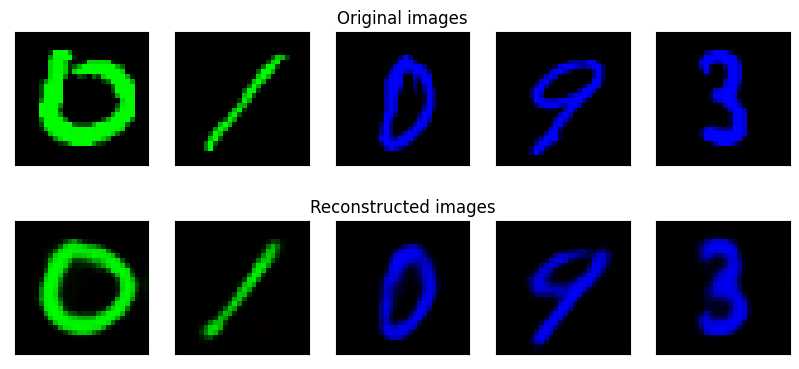


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.55s/it]

	 partial train loss (single batch): 0.006756
	 partial train loss (single batch): 0.005784
	 partial train loss (single batch): 0.006485
	 partial train loss (single batch): 0.006934
	 partial train loss (single batch): 0.005867
	 partial train loss (single batch): 0.006039
	 partial train loss (single batch): 0.006293


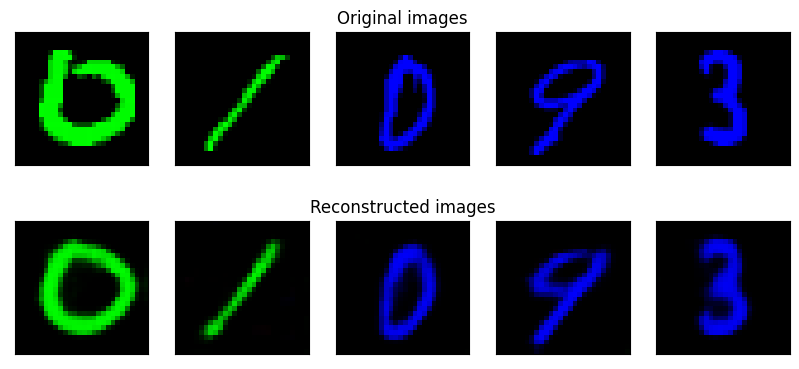


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.53s/it]

	 partial train loss (single batch): 0.006696
	 partial train loss (single batch): 0.005757
	 partial train loss (single batch): 0.006453
	 partial train loss (single batch): 0.006846
	 partial train loss (single batch): 0.005849
	 partial train loss (single batch): 0.005982
	 partial train loss (single batch): 0.006266


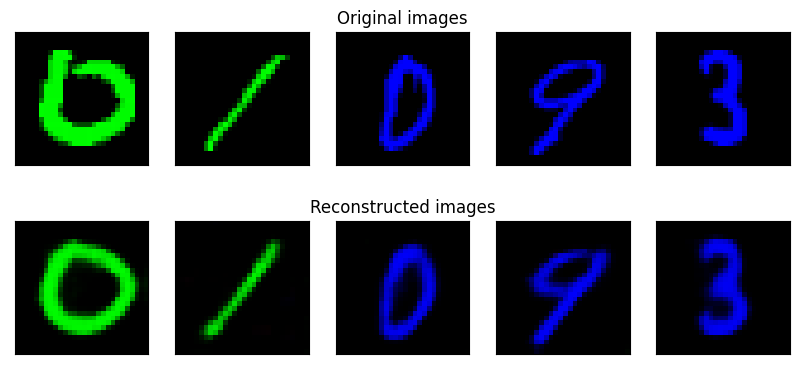


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.68s/it]

	 partial train loss (single batch): 0.006640
	 partial train loss (single batch): 0.005728
	 partial train loss (single batch): 0.006412
	 partial train loss (single batch): 0.006812
	 partial train loss (single batch): 0.005840
	 partial train loss (single batch): 0.005928
	 partial train loss (single batch): 0.006225


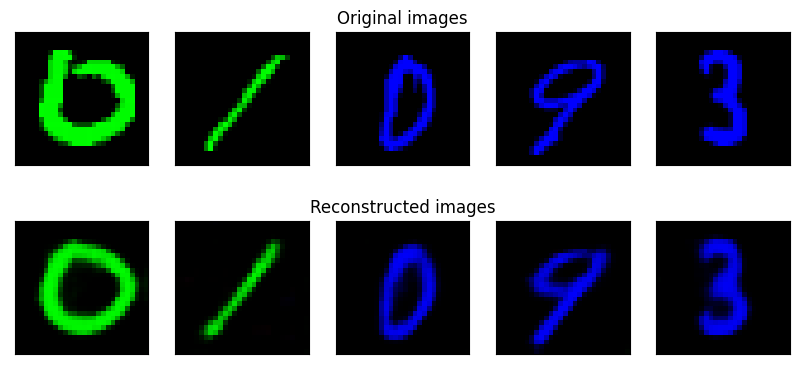


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:28<00:00,  5.61s/it]


RLACE


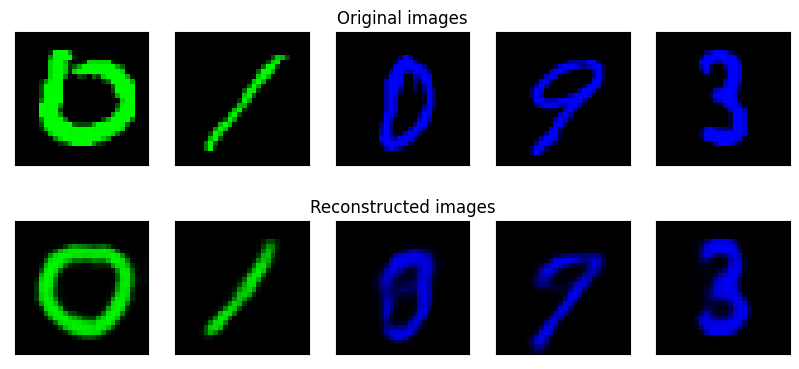

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.006696
	 partial train loss (single batch): 0.005802
	 partial train loss (single batch): 0.006386
	 partial train loss (single batch): 0.006800
	 partial train loss (single batch): 0.005821
	 partial train loss (single batch): 0.005906
	 partial train loss (single batch): 0.006222


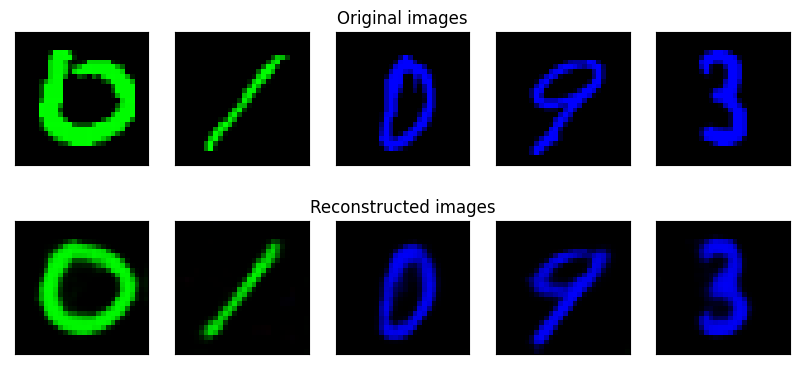


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.46s/it]

	 partial train loss (single batch): 0.006581
	 partial train loss (single batch): 0.005710
	 partial train loss (single batch): 0.006265
	 partial train loss (single batch): 0.006766
	 partial train loss (single batch): 0.005787
	 partial train loss (single batch): 0.005868
	 partial train loss (single batch): 0.006195


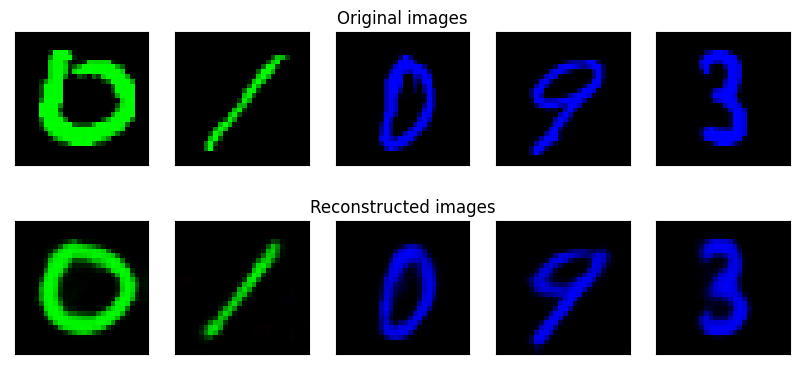


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.47s/it]

	 partial train loss (single batch): 0.006571
	 partial train loss (single batch): 0.005662
	 partial train loss (single batch): 0.006207
	 partial train loss (single batch): 0.006731
	 partial train loss (single batch): 0.005779
	 partial train loss (single batch): 0.005834
	 partial train loss (single batch): 0.006174


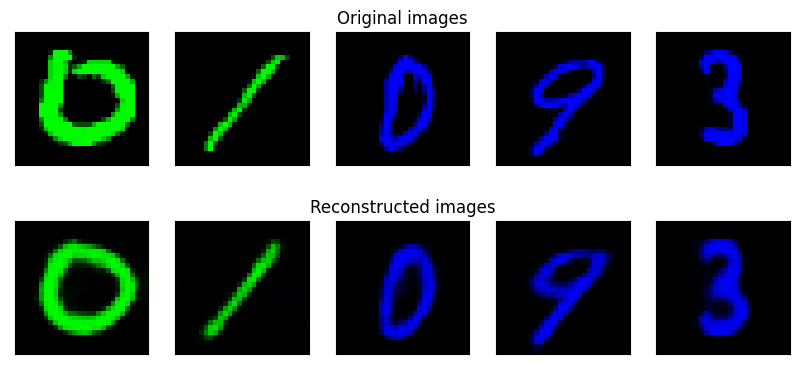


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.46s/it]

	 partial train loss (single batch): 0.006558
	 partial train loss (single batch): 0.005658
	 partial train loss (single batch): 0.006152
	 partial train loss (single batch): 0.006718
	 partial train loss (single batch): 0.005797
	 partial train loss (single batch): 0.005816
	 partial train loss (single batch): 0.006159


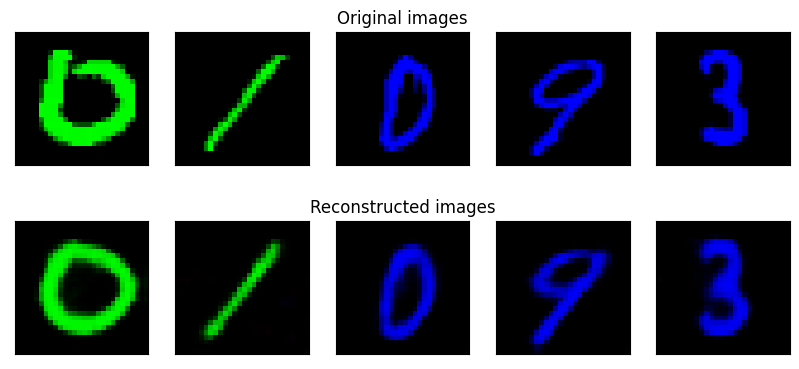


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.51s/it]

	 partial train loss (single batch): 0.006513
	 partial train loss (single batch): 0.005645
	 partial train loss (single batch): 0.006107
	 partial train loss (single batch): 0.006702
	 partial train loss (single batch): 0.005795
	 partial train loss (single batch): 0.005772
	 partial train loss (single batch): 0.006129


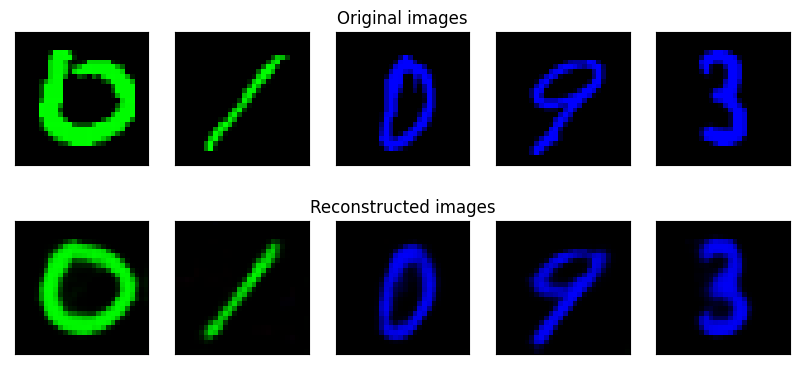


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.49s/it]


RLACE


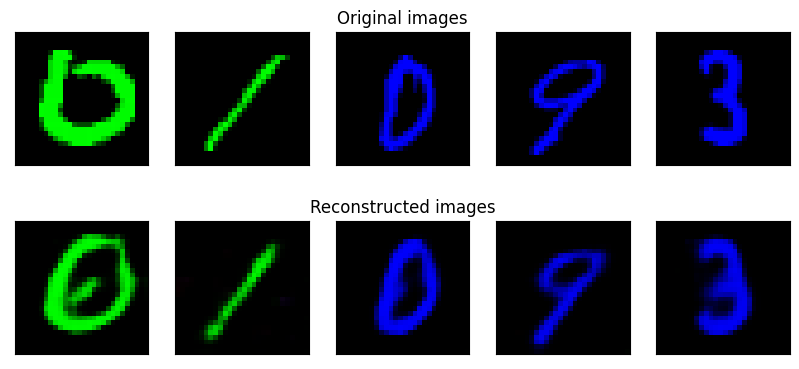

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.007574
	 partial train loss (single batch): 0.006093
	 partial train loss (single batch): 0.006385
	 partial train loss (single batch): 0.006781
	 partial train loss (single batch): 0.005793
	 partial train loss (single batch): 0.005767
	 partial train loss (single batch): 0.006145


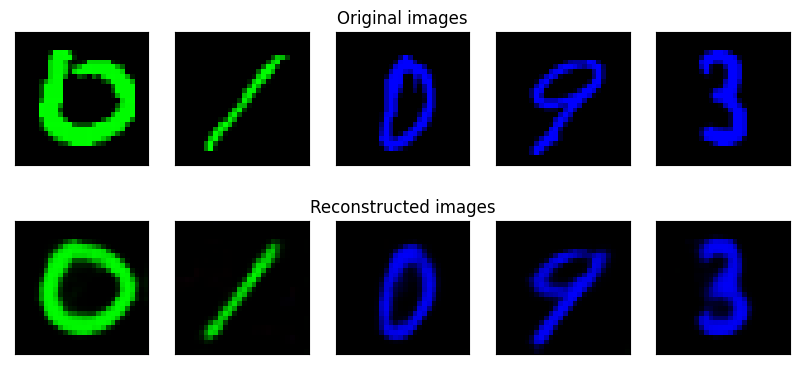


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.56s/it]

	 partial train loss (single batch): 0.006532
	 partial train loss (single batch): 0.005642
	 partial train loss (single batch): 0.006035
	 partial train loss (single batch): 0.006660
	 partial train loss (single batch): 0.005741
	 partial train loss (single batch): 0.005709
	 partial train loss (single batch): 0.006078


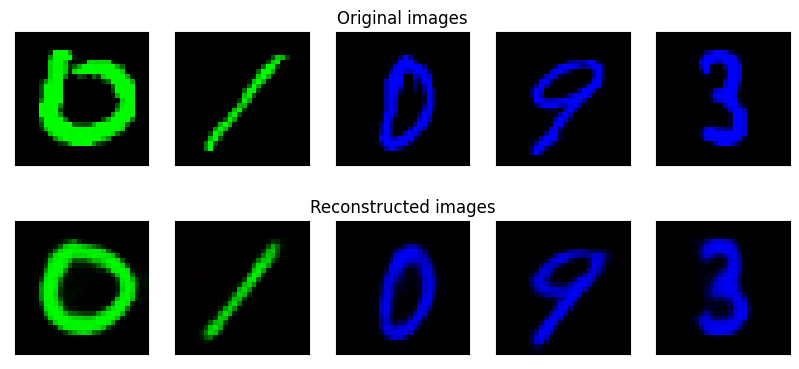


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:11<00:16,  5.51s/it]

	 partial train loss (single batch): 0.006458
	 partial train loss (single batch): 0.005584
	 partial train loss (single batch): 0.006002
	 partial train loss (single batch): 0.006679
	 partial train loss (single batch): 0.005773
	 partial train loss (single batch): 0.005671
	 partial train loss (single batch): 0.006065


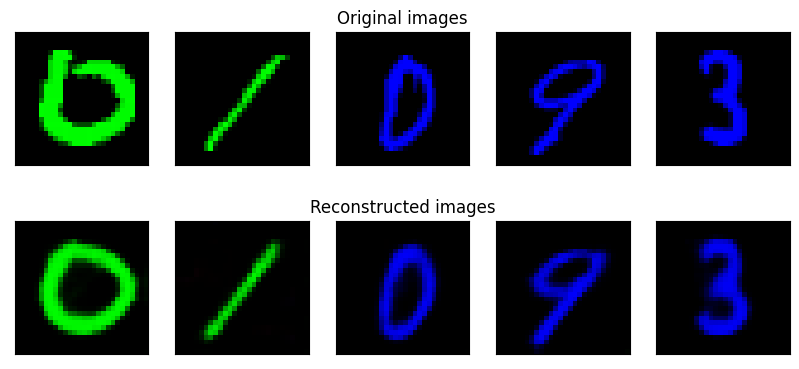


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.54s/it]

	 partial train loss (single batch): 0.006414
	 partial train loss (single batch): 0.005558
	 partial train loss (single batch): 0.005976
	 partial train loss (single batch): 0.006657
	 partial train loss (single batch): 0.005746
	 partial train loss (single batch): 0.005675
	 partial train loss (single batch): 0.006059


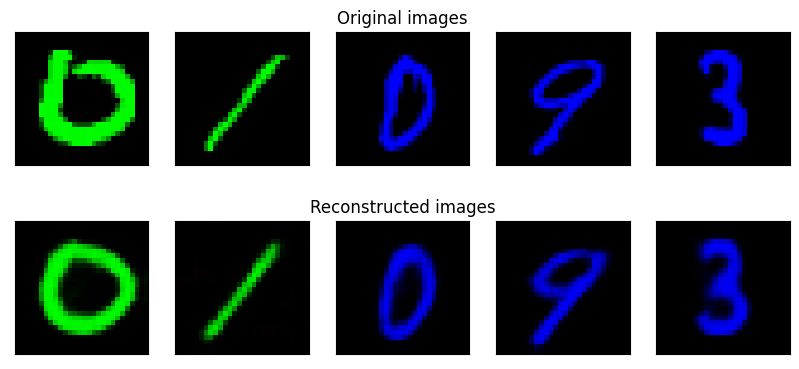


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.52s/it]

	 partial train loss (single batch): 0.006381
	 partial train loss (single batch): 0.005528
	 partial train loss (single batch): 0.005923
	 partial train loss (single batch): 0.006642
	 partial train loss (single batch): 0.005731
	 partial train loss (single batch): 0.005643
	 partial train loss (single batch): 0.006032


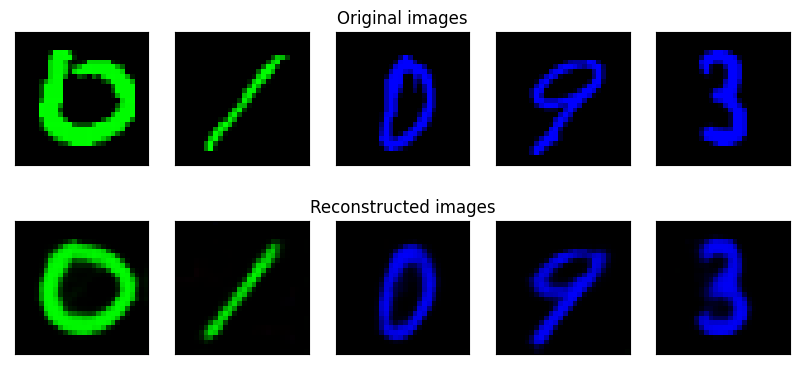


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.51s/it]


RLACE


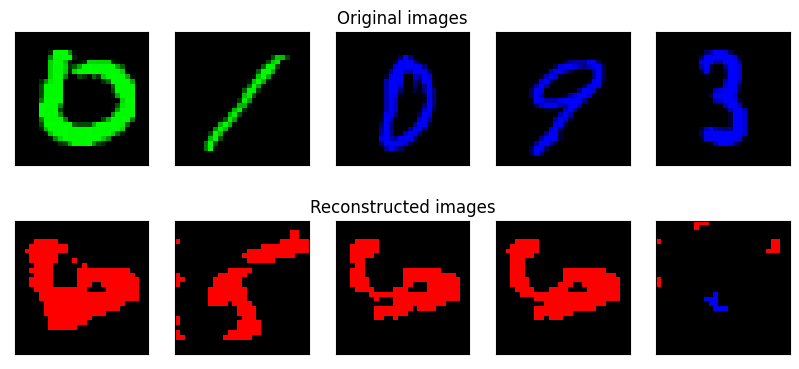

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.037602
	 partial train loss (single batch): 0.035881
	 partial train loss (single batch): 0.038398
	 partial train loss (single batch): 0.038953
	 partial train loss (single batch): 0.038188
	 partial train loss (single batch): 0.035344
	 partial train loss (single batch): 0.037917


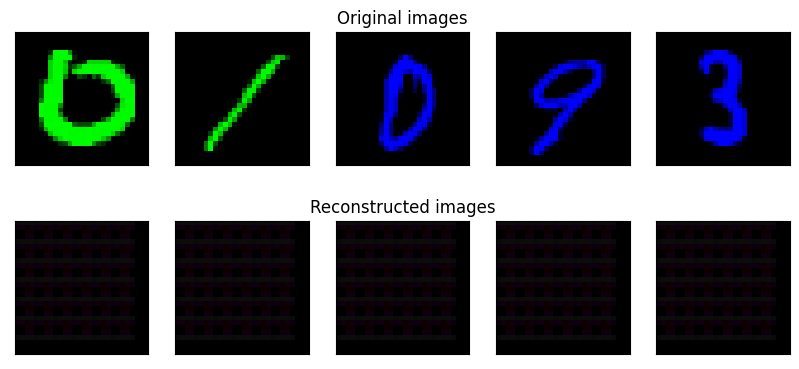


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:21,  5.48s/it]

	 partial train loss (single batch): 0.037183
	 partial train loss (single batch): 0.035491
	 partial train loss (single batch): 0.038272
	 partial train loss (single batch): 0.038851
	 partial train loss (single batch): 0.038086
	 partial train loss (single batch): 0.035309
	 partial train loss (single batch): 0.037840


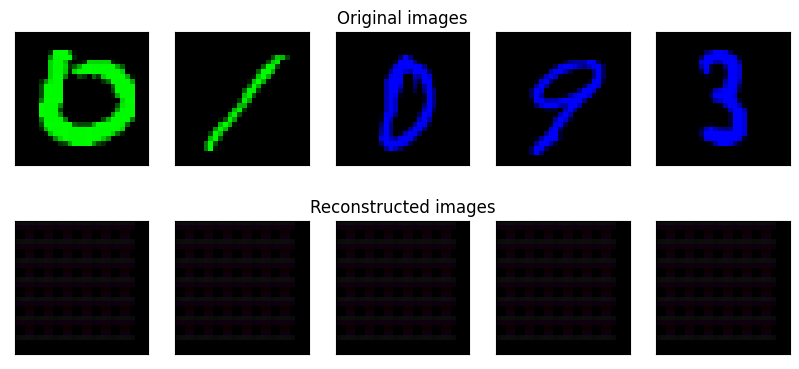


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.47s/it]

	 partial train loss (single batch): 0.037110
	 partial train loss (single batch): 0.035479
	 partial train loss (single batch): 0.038271
	 partial train loss (single batch): 0.038840
	 partial train loss (single batch): 0.038094
	 partial train loss (single batch): 0.035309
	 partial train loss (single batch): 0.037752


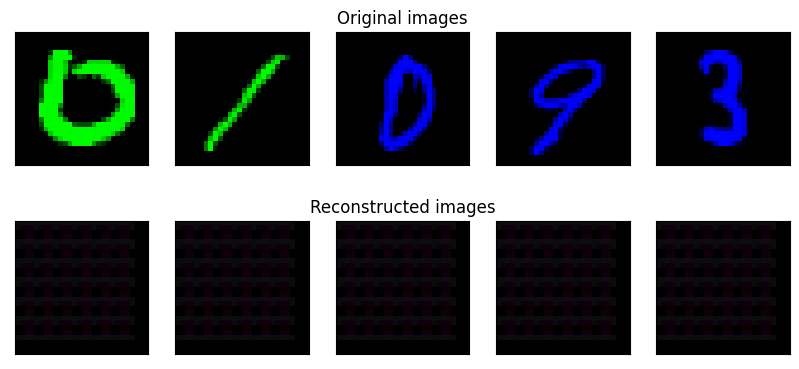


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:11,  5.53s/it]

	 partial train loss (single batch): 0.037064
	 partial train loss (single batch): 0.035454
	 partial train loss (single batch): 0.038215
	 partial train loss (single batch): 0.038758
	 partial train loss (single batch): 0.038043
	 partial train loss (single batch): 0.035251
	 partial train loss (single batch): 0.037751


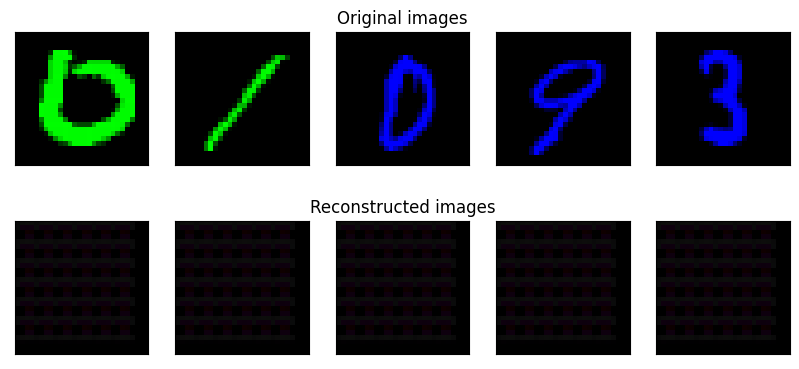


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:22<00:05,  5.51s/it]

	 partial train loss (single batch): 0.037060
	 partial train loss (single batch): 0.035452
	 partial train loss (single batch): 0.038216
	 partial train loss (single batch): 0.038754
	 partial train loss (single batch): 0.038047
	 partial train loss (single batch): 0.035250
	 partial train loss (single batch): 0.037750


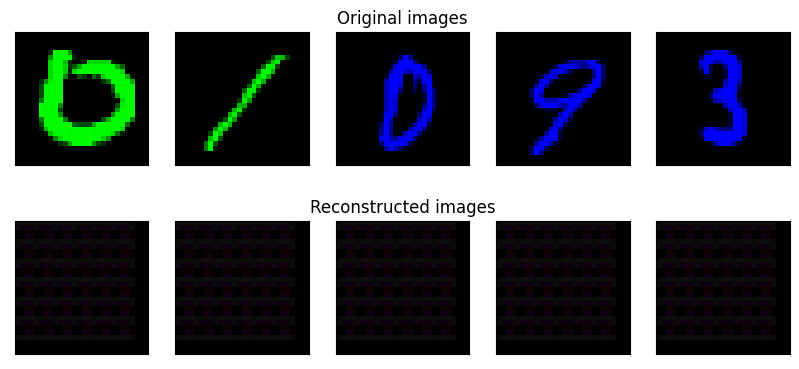


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:27<00:00,  5.50s/it]


RLACE


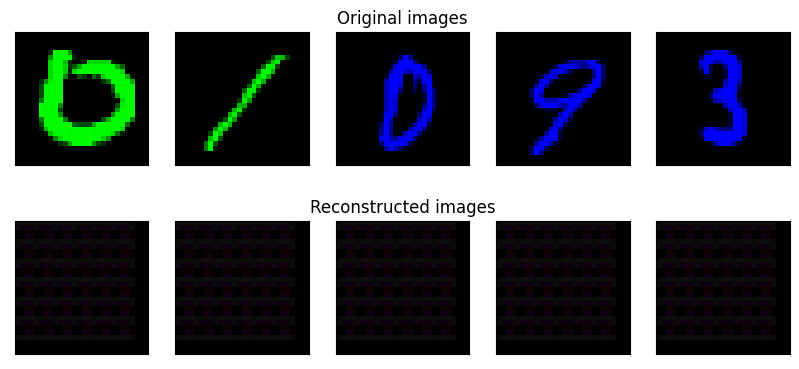

  0%|                                                                                                           | 0/5 [00:00<?, ?it/s]

	 partial train loss (single batch): 0.007566
	 partial train loss (single batch): 0.006039
	 partial train loss (single batch): 0.006390
	 partial train loss (single batch): 0.006913
	 partial train loss (single batch): 0.005690
	 partial train loss (single batch): 0.005853
	 partial train loss (single batch): 0.006109


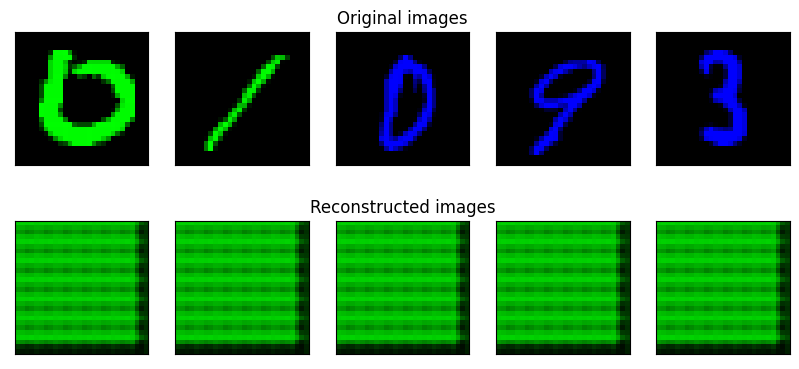


 20%|███████████████████▊                                                                               | 1/5 [00:05<00:22,  5.52s/it]

	 partial train loss (single batch): 0.006431
	 partial train loss (single batch): 0.005629
	 partial train loss (single batch): 0.006079
	 partial train loss (single batch): 0.006644
	 partial train loss (single batch): 0.005658
	 partial train loss (single batch): 0.005685
	 partial train loss (single batch): 0.006049


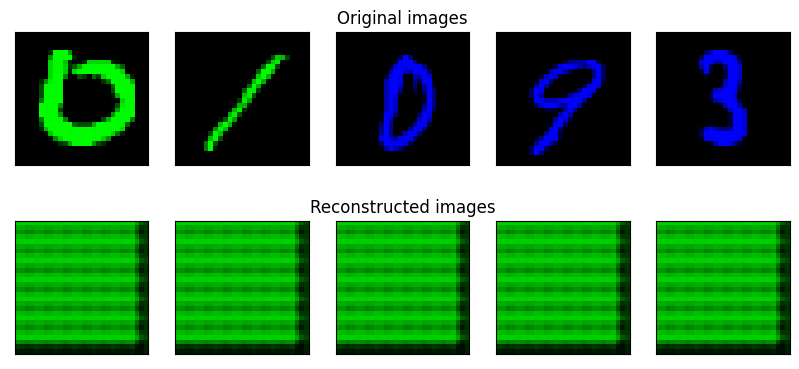


 40%|███████████████████████████████████████▌                                                           | 2/5 [00:10<00:16,  5.39s/it]

	 partial train loss (single batch): 0.006334
	 partial train loss (single batch): 0.005551
	 partial train loss (single batch): 0.006026
	 partial train loss (single batch): 0.006625
	 partial train loss (single batch): 0.005706
	 partial train loss (single batch): 0.005643
	 partial train loss (single batch): 0.006025


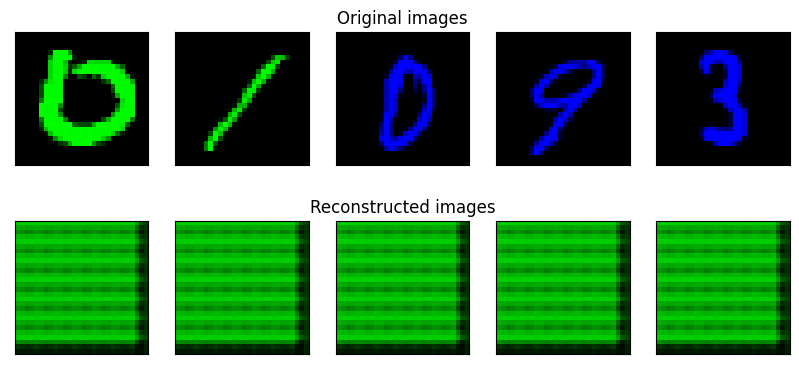


 60%|███████████████████████████████████████████████████████████▍                                       | 3/5 [00:16<00:10,  5.43s/it]

	 partial train loss (single batch): 0.006272
	 partial train loss (single batch): 0.005521
	 partial train loss (single batch): 0.005933
	 partial train loss (single batch): 0.006564
	 partial train loss (single batch): 0.005685
	 partial train loss (single batch): 0.005606
	 partial train loss (single batch): 0.005996


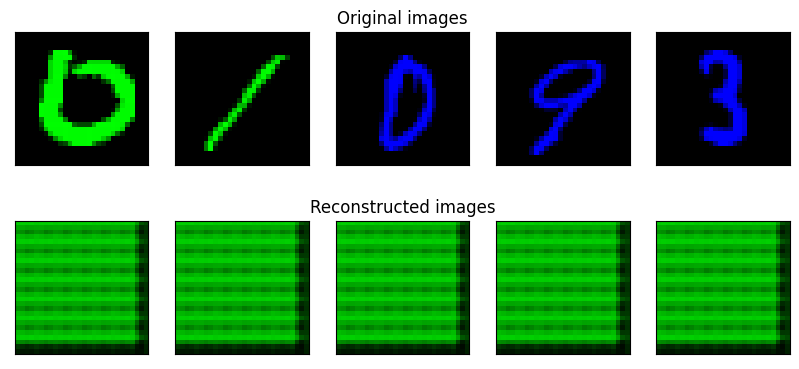


 80%|███████████████████████████████████████████████████████████████████████████████▏                   | 4/5 [00:21<00:05,  5.38s/it]

	 partial train loss (single batch): 0.006246
	 partial train loss (single batch): 0.005484
	 partial train loss (single batch): 0.005889
	 partial train loss (single batch): 0.006546
	 partial train loss (single batch): 0.005659
	 partial train loss (single batch): 0.005577
	 partial train loss (single batch): 0.005963


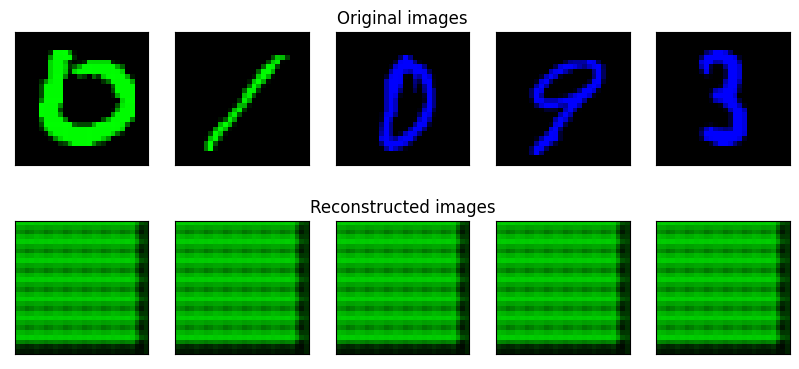


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:26<00:00,  5.37s/it]


RLACE


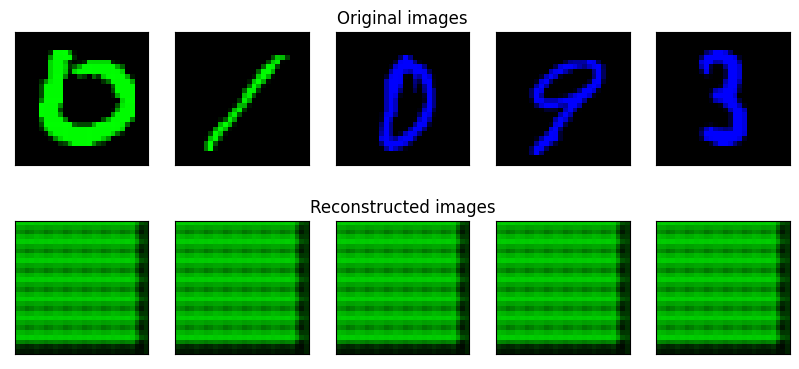

Training Epochs: 100%|█████████████████████████████████████| 10/10 [00:41<00:00,  4.10s/it, loss=0.048, val_acc=0.995, val_loss=0.043]


In [119]:
num_epochs = 10
for dim in [2, 4, 6, 10]:
    autoencoder = RLACE_AE(device=device, d=dim)
    output = autoencoder.solve_adv_game(dim, train_loader,  o_epochs=num_epochs, a_epochs=5)
    outputs[dim] = output
    
    lc_num = LogisticClassifier(dim, 10, lr=0.0001)
    losses_num, val_losses_num, val_acc_num = lc_num.fit(train_loader, valid_loader, output['encoder'], label='number', epochs=20)

    lc_col = LogisticClassifier(dim, 3, lr=0.001)
    losses_col, val_losses_col, val_acc_col =lc_col.fit(train_loader, valid_loader, output['encoder'], label='color', epochs=10)

    #encoder_with_projection_d = lambda batch: encoder_with_projection(batch, dim=dim)
    encoder_proj1_d = lambda batch: encoder_proj1(batch, dim=dim)
    encoder_proj2_d = lambda batch: encoder_proj2(batch, dim=dim)


    lc_num_proj1 = LogisticClassifier(int(dim/2), 10, lr=0.001)
    losses_num_proj1, val_losses_num_proj1, val_acc_num_proj1 = lc_num_proj1.fit(train_loader, valid_loader, encoder_proj1_d, label='number', epochs=20)

    lc_col_proj1 = LogisticClassifier(int(dim/2), 3, lr=0.001)
    losses_col_proj1, val_losses_col_proj1, val_acc_col_proj1 =  lc_col_proj1.fit(train_loader, valid_loader, encoder_proj1_d, label='color', epochs=10)


    lc_num_proj2 = LogisticClassifier(int(dim/2), 10, lr=0.001)
    losses_num_proj2, val_losses_num_proj2, val_acc_num_proj2 = lc_num_proj2.fit(train_loader, valid_loader, encoder_proj2_d, label='number', epochs=20)

    lc_col_proj2 = LogisticClassifier(int(dim/2), 3, lr=0.001)
    losses_col_proj2, val_losses_col_proj2, val_acc_col_proj2 =  lc_col_proj2.fit(train_loader, valid_loader, encoder_proj2_d, label='color', epochs=10)

    val_acc[dim] = {'baseline_num': val_acc_num, 'baseline_col': val_acc_col, 'num_proj_col': val_acc_num_proj1, 
                   'col_proj_col': val_acc_col_proj1, 'num_proj_num': val_acc_num_proj2, 
                    'col_proj_num': val_acc_col_proj2, }

In [122]:
val_acc

{6: {'baseline_num': 0.8871343085106383,
  'baseline_col': 0.9243683510638298,
  'num_proj_col': 0.4152260638297872,
  'col_proj_col': 0.38707890092058383,
  'num_proj_num': 0.32275044347377535,
  'col_proj_num': 0.9395500890752102},
 2: {'baseline_num': 0.5587322699262741,
  'baseline_col': 0.331781914893617,
  'num_proj_col': 0.11707668450284511,
  'col_proj_col': 0.31510416687803067,
  'num_proj_num': 0.11707668450284511,
  'col_proj_num': 0.31510416687803067},
 4: {'baseline_num': 0.5066489361702128,
  'baseline_col': 1.0,
  'num_proj_col': 0.4277482273730826,
  'col_proj_col': 0.31200132978723405,
  'num_proj_num': 0.10139627659574468,
  'col_proj_num': 0.6591312060964868},
 10: {'baseline_num': 0.8882978723404256,
  'baseline_col': 0.9767287234042553,
  'num_proj_col': 0.7423537234042553,
  'col_proj_col': 0.48210328024752597,
  'num_proj_num': 0.3890735817716477,
  'col_proj_num': 0.995345744680851}}

In [39]:
state_dict = torch.load('outputs/rlace-autoencoders/output_dict-d=6-epochs=4.pt')

In [41]:
state_dict['P1']

tensor([[0.0180, 0.1154, 0.0658],
        [0.1154, 0.7412, 0.4225],
        [0.0658, 0.4225, 0.2408]], device='cuda:0')

In [42]:
state_dict['P2']

tensor([[ 0.5308, -0.3329,  0.3716],
        [-0.3329,  0.2089, -0.2331],
        [ 0.3716, -0.2331,  0.2603]], device='cuda:0')

In [43]:
state_dict['encoder']

Encoder(
  (encoder_cnn): Sequential(
    (0): Conv2d(3, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(8, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): ReLU(inplace=True)
    (5): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2))
    (6): ReLU(inplace=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (encoder_lin): Sequential(
    (0): Linear(in_features=288, out_features=128, bias=True)
    (1): ReLU(inplace=True)
    (2): Linear(in_features=128, out_features=6, bias=True)
  )
)

In [44]:
state_dict['decoder']

Decoder(
  (decoder_lin): Sequential(
    (0): Linear(in_features=6, out_features=128, bias=True)
    (1): ReLU(inplace=True)
    (2): Linear(in_features=128, out_features=288, bias=True)
    (3): ReLU(inplace=True)
  )
  (unflatten): Unflatten(dim=1, unflattened_size=(32, 3, 3))
  (decoder_conv): Sequential(
    (0): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(16, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (4): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(8, 3, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
  )
)

In [45]:
encoded_samples = []
for sample in tqdm(test_dataset):
    img = torch.tensor(sample[0]).unsqueeze(0).to(device)
    label_number = sample[1]['number']
    label_color = sample[1]['color']
    # Encode image
    state_dict['encoder'].eval()
    with torch.no_grad():
        encoded_img  = state_dict['encoder'](img)
    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['color_label'] = label_color
    encoded_sample['number_label'] = label_number
    encoded_samples.append(encoded_sample)

100%|██████████████████████████████████████████████████████████████████████████████████████| 6000/6000 [00:03<00:00, 1980.38it/s]


In [46]:
encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples['distinct_label'] = encoded_samples.apply(lambda x: int(x['color_label'] * 10 + x['number_label']), axis=1)

In [47]:
encoded_samples

,Enc. Variable 0,Enc. Variable 1,Enc. Variable 2,Enc. Variable 3,Enc. Variable 4,Enc. Variable 5,color_label,number_label,distinct_label
0,6.720141,-10.876718,-43.537003,45.777592,-26.995384,19.859261,0,0,0
1,-35.095783,4.226917,11.331921,-33.857067,-3.625699,-43.660366,1,1,11
2,-0.230679,-16.092201,-29.420662,44.673828,-28.822716,-16.876610,1,0,10
3,-15.559532,-12.338595,17.598083,-21.256529,7.829135,-63.628990,1,9,19
4,-0.695759,-1.769810,-2.120769,7.548128,-1.842876,-2.478954,0,3,3
...,...,...,...,...,...,...,...,...,...
5995,-23.375984,-4.293925,-58.323364,48.167736,-17.508228,-5.191082,1,6,16
5996,-10.774882,13.980579,-3.173990,-9.821445,2.200159,8.601417,2,2,22
5997,7.698987,1.019030,10.305720,-25.736996,14.991483,-3.803152,2,4,24
5998,11.214001,-15.428912,10.838016,-8.654639,13.245163,-24.871622,0,9,9


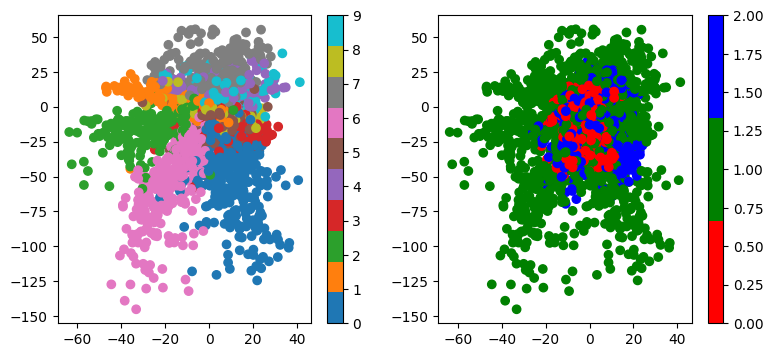

In [71]:
from matplotlib import colors

plt.figure(figsize=(9, 4))

plt.subplot(1, 2, 1)
plt.scatter(encoded_samples['Enc. Variable 0'], encoded_samples['Enc. Variable 2'], c=encoded_samples.number_label, cmap='tab10')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.scatter(encoded_samples['Enc. Variable 0'], encoded_samples['Enc. Variable 2'], c=encoded_samples.color_label, cmap=colors.ListedColormap(['red', 'green', 'blue']))
plt.colorbar()
plt.show()

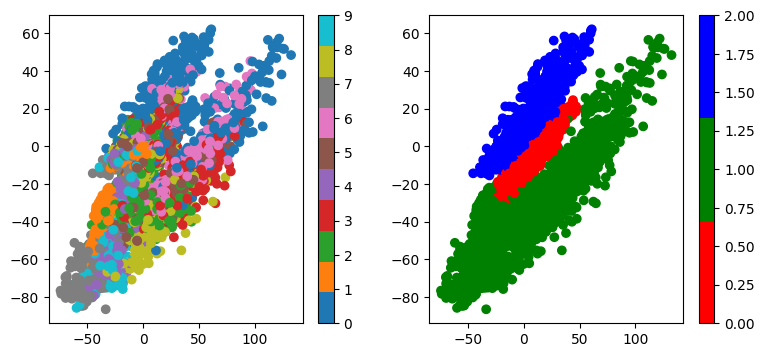

In [68]:
plt.figure(figsize=(9, 4))

plt.subplot(1, 2, 1)
plt.scatter(encoded_samples['Enc. Variable 3'], encoded_samples['Enc. Variable 5'], c=encoded_samples.number_label, cmap='tab10')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.scatter(encoded_samples['Enc. Variable 3'], encoded_samples['Enc. Variable 5'], c=encoded_samples.color_label, cmap=colors.ListedColormap(['red', 'green', 'blue']))
plt.colorbar()
plt.title('')
plt.show()

In [60]:
pca = PCA(n_components=2)
components = pca.fit_transform(encoded_samples.drop(['Enc. Variable 0', 'Enc. Variable 1', 'Enc. Variable 2', 'number_label', 'color_label', 'distinct_label'],axis=1))
total_var = pca.explained_variance_ratio_.sum() * 100
print(total_var)

96.09274864196777


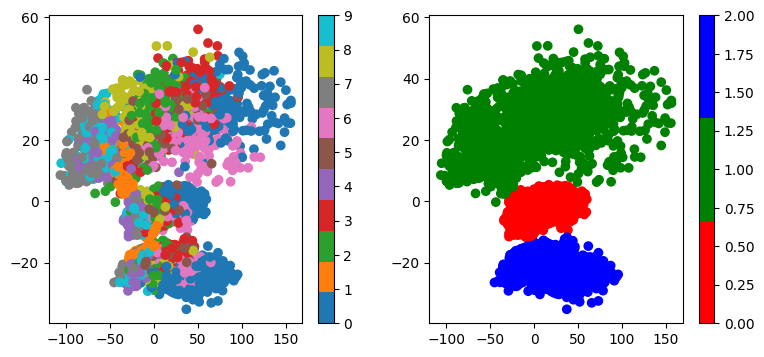

In [61]:
plt.figure(figsize=(9, 4))

plt.subplot(1, 2, 1)
plt.scatter(components[:,0], components[:,1], c=encoded_samples.number_label, cmap='tab10')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.scatter(components[:,0], components[:,1], c=encoded_samples.color_label, cmap=colors.ListedColormap(['red', 'green', 'blue',]))
plt.colorbar()
plt.show()



In [62]:
pca = PCA(n_components=2)
components = pca.fit_transform(encoded_samples.drop(['Enc. Variable 3', 'Enc. Variable 4', 'Enc. Variable 5', 'number_label', 'color_label', 'distinct_label'],axis=1))
total_var = pca.explained_variance_ratio_.sum() * 100
print(total_var)

91.52600765228271


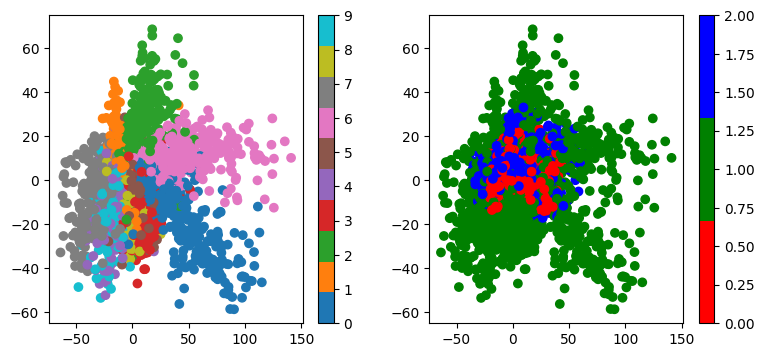

In [63]:
plt.figure(figsize=(9, 4))

plt.subplot(1, 2, 1)
plt.scatter(components[:,0], components[:,1], c=encoded_samples.number_label, cmap='tab10')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.scatter(components[:,0], components[:,1], c=encoded_samples.color_label, cmap=colors.ListedColormap(['red', 'green', 'blue']))
plt.colorbar()
plt.show()

In [120]:
torch.save(output, f'outputs/rlace-autoencoders/output_dict-epochs={num_epochs}.pt')

In [121]:
torch.save(val_acc, f'outputs/rlace-autoencoders/val_accuracies-epochs={num_epochs}.pt')

In [ ]:
# torch.save(output['encoder'].state_dict(), 'outputs/rlace/rlace_encoder.pt')
# torch.save(output['decoder'].state_dict(), 'outputs/rlace/rlace_decoder.pt')
# torch.save(output['P1'], 'outputs/rlace/rlace_p1.pt')
# torch.save(output['P2'], 'outputs/rlace/rlace_p2.pt')
# torch.save(output['clf1'], 'outputs/rlace/clf1_color.pt')
# torch.save(output['clf2'], 'outputs/rlace/clf2_number.pt')